In [91]:
import xml.etree.ElementTree
import os,glob,sys
import pandas as pd
from sklearn.decomposition import PCA
import pylab as plt
import seaborn as sns
import numpy as np

%load_ext autoreload
%autoreload 2

sys.path.append("..")
from mzmine import pick_peaks, align, match_aligned_to_original, load_aligned_peaks
import ms2_matching

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
MZMINE_COMMAND = '/Users/anamaria/Documents/git/MZmine-2.40.1/startMZmine_MacOSX.command'

In [3]:
MNET_PATH = '/Users/anamaria/Documents/git/molnet/code/'

## Peak detection using MZmine

At the moment, this part is performed directly in MZmine.

In [ ]:
#for patients
# Directory holding mzml files of interest
input_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/Positive/Control'
# grab the list -- in this case all the T10 mzML files
file_list = glob.glob(os.path.join(input_dir,'**.mzXML'))

# # Directory to store all output
output_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/mzmine'

In [ ]:
from mzmine import pick_peaks
pick_peaks(file_list,output_dir=output_dir, xml_template = '/Users/anamaria/Desktop/mzmine/peak_picking_to_mztab_csv.xml', mzmine_command=MZMINE_COMMAND)

## Alignment

In [6]:
allfiles = '/Users/anamaria/Desktop/mzmine/221119/samples_alignment/'
xml_template ='/Users/anamaria/Documents/git/pymzmine/batch_files/align_from_mztab.xml'

align(allfiles, xml_template = xml_template, mzmine_command = MZMINE_COMMAND, rt_window = 0.5)


If files already aligned.

In [4]:
all_df = pd.read_csv('/Users/anamaria/Desktop/mzmine/221119/samples_alignment/pp_aligned.csv', index_col=0)
feature_description = all_df.iloc[:,:2]
all_samples = all_df.iloc[:,2:-1]
all_samples.columns = [x.split(" ")[0] for x in list(all_samples.columns)]

In [5]:
condition = []
dataset = []
for name in np.array(all_samples.columns):
    value = name.split('.')[0].split('_')[0][0]
    value2 = name.split('.')[0].split('_')[0][0]
    
    if (value == 'C' and len(name.split('.')[0].split('_')) == 2 and name.split('.')[0].split('_')[1] == '2'):
        condition.append('control')
        dataset.append('VL')
    elif  (value == 'C'):   
        condition.append('control')
        dataset.append('Zika')
    elif (value == 'Z'):
        condition.append('infected')
        dataset.append('Zika')
    elif (value[0] == 'V'):
        condition.append('infected')
        dataset.append('VL')
        
    elif (value == 'K' and int(name.split('.')[0].split('_')[1])%3 == 1 ):
        condition.append('control')
        dataset.append('Malaria')
    else:
        condition.append('infected')
        dataset.append('Malaria')
        

In [6]:
sample_description = pd.DataFrame(data=[list(all_samples.columns),condition,dataset] )
sample_description = sample_description.transpose()
sample_description.columns = ['Sample Name', 'Condition', 'Dataset']
sample_description["ConditionDataset"] = sample_description["Condition"]+sample_description["Dataset"]

In [7]:
all_samples_log = np.log2(all_samples+1)

In [8]:
len(all_samples_log)

37234

In [8]:
#DENSITY PLOTS
def plot_density(all_samples):
    # List of five airlines to plot
    datasets = ['Zika', 'Malaria', 'VL']
    colors = ['r','b','g']
    # Iterate through the five airlines
    for dataset, color in zip(datasets, colors):
        # Subset to the airline

        subset = all_samples.transpose()[np.array(sample_description['Dataset'] == dataset)].transpose()
        colordataset= color
        # Draw the density plot
        for col in list(subset.columns):
            sns.distplot(subset[col] ,hist = False, kde = True, color = colordataset,
                     kde_kws = {'linewidth': 3, "alpha":0.2})
   
    # Plot formatting
    plt.xlabel('Intensity')
    plt.legend(all_samples.columns)
    

In [20]:
sample_description["ConditionDataset"] 

0        infectedZika
1        infectedZika
2        infectedZika
3           controlVL
4         controlZika
5      controlMalaria
6           controlVL
7          infectedVL
8     infectedMalaria
9     infectedMalaria
10    infectedMalaria
11          controlVL
12    infectedMalaria
13    infectedMalaria
14          controlVL
15         infectedVL
16         infectedVL
17          controlVL
18          controlVL
19     controlMalaria
20    infectedMalaria
21          controlVL
22         infectedVL
23         infectedVL
24         infectedVL
25       infectedZika
26        controlZika
27          controlVL
28          controlVL
29    infectedMalaria
           ...       
46    infectedMalaria
47       infectedZika
48       infectedZika
49         infectedVL
50         infectedVL
51        controlZika
52        controlZika
53       infectedZika
54       infectedZika
55         infectedVL
56         infectedVL
57    infectedMalaria
58    infectedMalaria
59    infectedMalaria
60    infe

In [23]:
all_samples_condition = all_samples_log
all_samples_condition.columns = list(sample_description["ConditionDataset"])

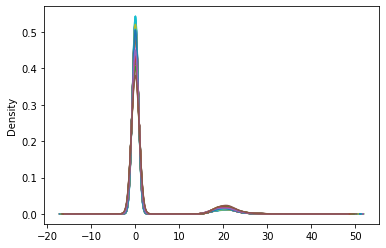

In [27]:
all_samples_condition.plot.density(legend = False)

In [9]:
# rearranging the dataframe
Zik = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'Zika')].transpose()
zik_con = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="control")].transpose()
zik_inf = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="infected")].transpose()
Mal = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'Malaria')].transpose()
mal_con = Mal.transpose()[np.array(sample_description[sample_description["Dataset"] == "Malaria"]['Condition'] =="control")].transpose()
mal_inf = Mal.transpose()[np.array(sample_description[sample_description["Dataset"] == "Malaria"]['Condition'] =="infected")].transpose()
vl = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'VL')].transpose()
vl_con = vl.transpose()[np.array(sample_description[sample_description["Dataset"] == "VL"]['Condition'] =="control")].transpose()
vl_inf = vl.transpose()[np.array(sample_description[sample_description["Dataset"] == "VL"]['Condition'] =="infected")].transpose()

In [10]:
pdList = [vl_inf,vl_con,zik_inf, zik_con, mal_inf,mal_con]  
all_samples_log_rearanged = pd.concat(pdList, axis = 1)

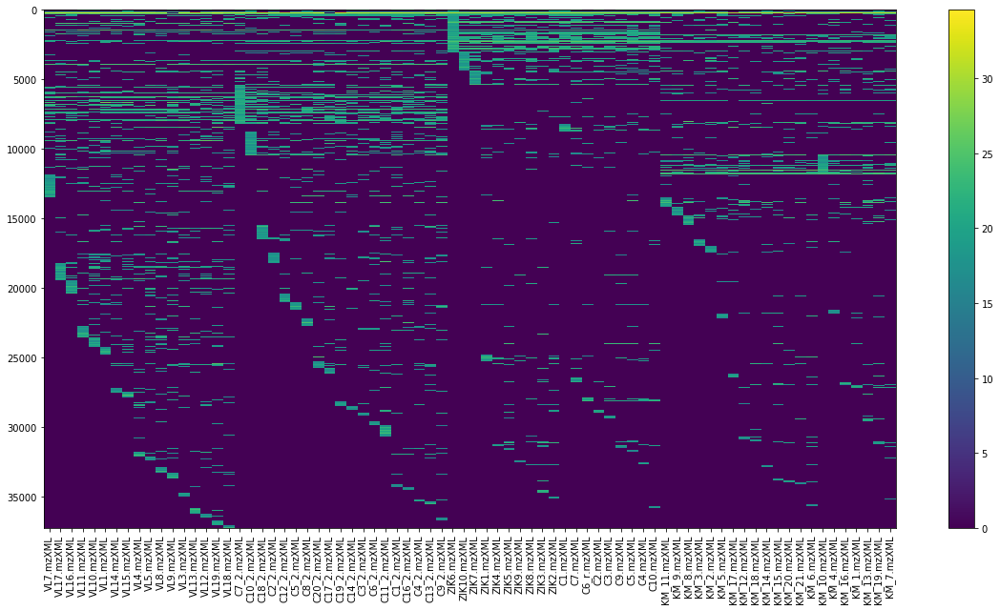

In [11]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_rearanged,aspect='auto')
plt.xticks(list(range(0,len(all_samples_log_rearanged.columns))), all_samples_log_rearanged.columns, rotation = 90)
plt.colorbar()
plt.show()


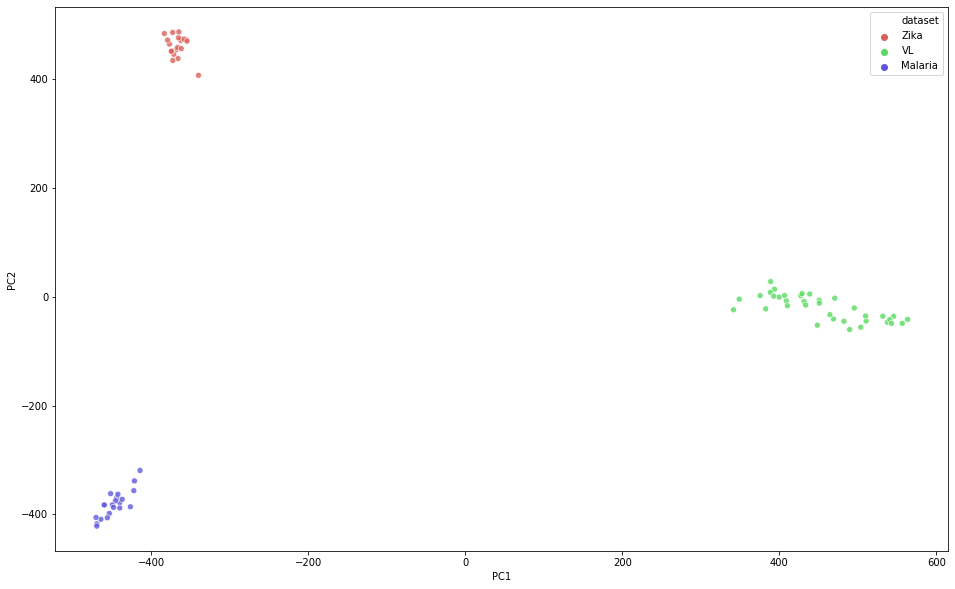

In [12]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="dataset",
    palette=sns.color_palette("hls", 3),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

Filter data, so that 50% of the peaks are not 0s.

In [13]:
def get_ids_for_50_percent(dataframe):
    idlist = []
    for rowid,row in dataframe.iterrows():
        total_zero = 0
        for i in range(len(row)):
            if row[i] == 0.0:
                total_zero += 1
        percentage = total_zero*100/len(row)
        if percentage <= 50:
            idlist.append(rowid)
    return np.array(idlist)

In [14]:
idzik = get_ids_for_50_percent(all_samples_log_rearanged[Zik.columns])
idmal = get_ids_for_50_percent(all_samples_log_rearanged[Mal.columns])
idvl = get_ids_for_50_percent(all_samples_log_rearanged[vl.columns])
inters = set(idzik) & set(idmal) & set(idvl)


In [15]:
len(inters)
all_samples_log_filtered_50 = all_samples_log.loc[inters]

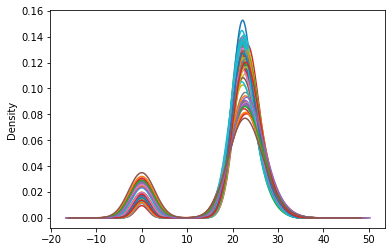

In [16]:
all_samples_log_filtered_50.plot.density(legend=False)

In [15]:
all_samples_log_filtered_na = all_samples_log_filtered_50
all_samples_log_filtered_na.replace(0, np.nan, inplace = True)

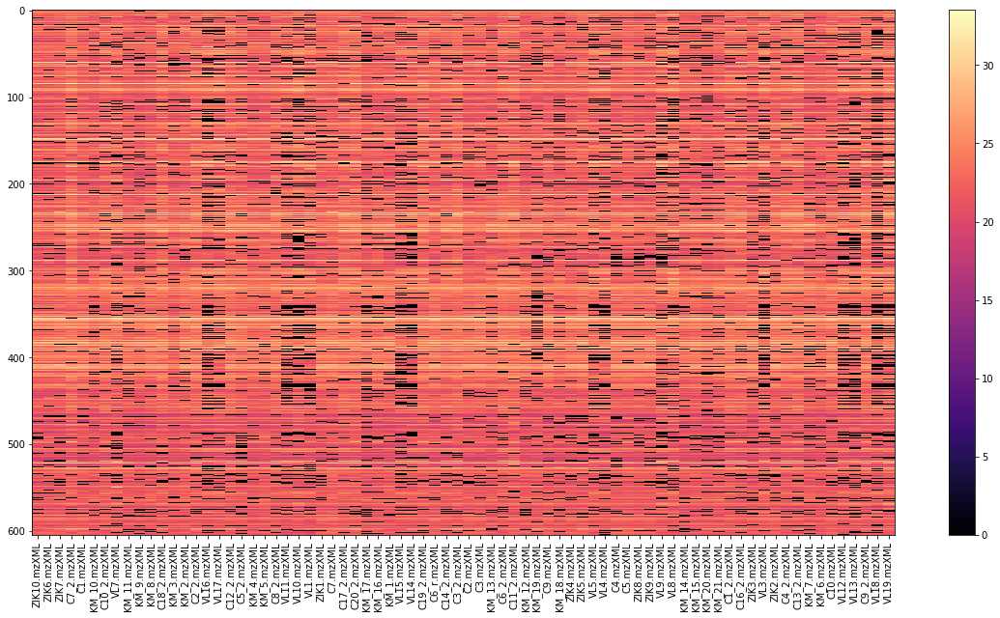

In [16]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_filtered_50,aspect='auto',cmap='magma')
plt.xticks(list(range(0,len(all_samples_log_filtered_50.columns))), all_samples_log_filtered_50.columns, rotation = 90)
plt.colorbar()
plt.show()


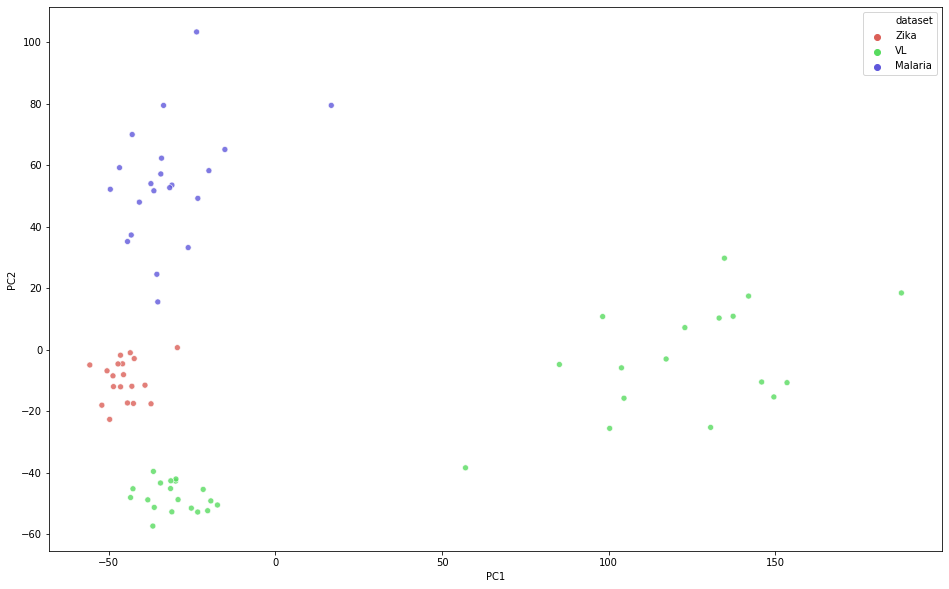

In [17]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log_filtered_50.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="dataset",
    palette=sns.color_palette("hls", 3),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

In [180]:
#imputing missing values with KNN
from fancyimpute import KNN    
# X is the complete data matrix
# X_incomplete has the same values as X except a subset have been replace with NaN


# X is the complete data matrix
# X_incomplete has the same values as X except a subset have been replace with NaN
# Use 3 nearest rows which have a feature to fill in each row's missing features
zik_con_filt = all_samples_log_filtered_50[zik_con.columns]
zik_con_filt.replace(0, np.nan, inplace = True)

zik_con_filled_knn = KNN(k=3).fit_transform(zik_con_filt)    

Using TensorFlow backend.


NameError: name 'X_incomplete' is not defined

In [199]:
def impute_knn(zik_con):
    zik_con_filt = all_samples_log_filtered_50[zik_con.columns]
    zik_con_filt.replace(0, np.nan, inplace = True)
    zik_con_filled_knn = KNN(k=3).fit_transform(zik_con_filt)
    df = pd.DataFrame(zik_con_filled_knn, columns=zik_con_filt.columns, index = zik_con_filt.index)
    return df


In [205]:
zik_con_filled = impute_knn(zik_con)
zik_inf_filled = impute_knn(zik_inf)
vl_con_filled = impute_knn(vl_con)
vl_inf_filled = impute_knn(vl_inf)
mal_con_filled = impute_knn(mal_con)
mal_inf_filled = impute_knn(mal_inf)


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.066
Imputing row 101/605 with 0 missing, elapsed time: 0.067
Imputing row 201/605 with 4 missing, elapsed time: 0.069
Imputing row 301/605 with 2 missing, elapsed time: 0.071
Imputing row 401/605 with 0 missing, elapsed time: 0.072
Imputing row 501/605 with 0 missing, elapsed time: 0.073
Imputing row 601/605 with 0 missing, elapsed time: 0.075


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.101
Imputing row 101/605 with 0 missing, elapsed time: 0.103
Imputing row 201/605 with 5 missing, elapsed time: 0.108
Imputing row 301/605 with 3 missing, elapsed time: 0.111
Imputing row 401/605 with 0 missing, elapsed time: 0.113
Imputing row 501/605 with 0 missing, elapsed time: 0.117
Imputing row 601/605 with 0 missing, elapsed time: 0.121


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.117
Imputing row 101/605 with 0 missing, elapsed time: 0.125
Imputing row 201/605 with 2 missing, elapsed time: 0.128
Imputing row 301/605 with 0 missing, elapsed time: 0.131
Imputing row 401/605 with 0 missing, elapsed time: 0.133
Imputing row 501/605 with 0 missing, elapsed time: 0.134
Imputing row 601/605 with 0 missing, elapsed time: 0.139


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.107
Imputing row 101/605 with 0 missing, elapsed time: 0.112
Imputing row 201/605 with 16 missing, elapsed time: 0.125
Imputing row 301/605 with 0 missing, elapsed time: 0.140
Imputing row 401/605 with 9 missing, elapsed time: 0.161
Imputing row 501/605 with 0 missing, elapsed time: 0.178
Imputing row 601/605 with 0 missing, elapsed time: 0.220
[KNN] Warning: 34/10285 still missing after imputation, replacing with 0


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.067
Imputing row 101/605 with 0 missing, elapsed time: 0.070
Imputing row 201/605 with 2 missing, elapsed time: 0.072
Imputing row 301/605 with 1 missing, elapsed time: 0.074
Imputing row 401/605 with 1 missing, elapsed time: 0.076
Imputing row 501/605 with 0 missing, elapsed time: 0.078
Imputing row 601/605 with 0 missing, elapsed time: 0.080


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/605 with 0 missing, elapsed time: 0.117
Imputing row 101/605 with 0 missing, elapsed time: 0.121
Imputing row 201/605 with 3 missing, elapsed time: 0.130
Imputing row 301/605 with 4 missing, elapsed time: 0.133
Imputing row 401/605 with 0 missing, elapsed time: 0.138
Imputing row 501/605 with 0 missing, elapsed time: 0.149
Imputing row 601/605 with 1 missing, elapsed time: 0.201


In [207]:
pdList = [vl_inf_filled,vl_con_filled,zik_inf_filled, zik_con_filled, mal_inf_filled,mal_con_filled]  
all_samples_log_filled = pd.concat(pdList, axis = 1)

In [210]:
all_samples_log_filled = all_samples_log_filled[all_samples_log_filtered_50.columns]

## Limma analysis in R

In [33]:
all_samples_log_filtered.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/all_samples_log2.csv', header=True, index=True, sep=',', mode='w')
sample_description.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/sample_description.csv', header=True, index=None, sep=',', mode='w')

In [211]:
#limma with missing values
all_samples_log_filtered_na.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/all_samples_log2_na.csv', header=True, index=True, sep=',', mode='w')
#limma with 50% non-zero
all_samples_log_filtered_50.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/all_samples_log2_50.csv', header=True, index=True, sep=',', mode='w')
all_samples_log_filled.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/all_samples_log2_50_filled.csv', header=True, index=True, sep=',', mode='w')

In [21]:
toptable = pd.read_csv("/Users/anamaria/Desktop/mzmine/221119/limma_toptable.csv", sep=',')
toptable_na = pd.read_csv("/Users/anamaria/Desktop/mzmine/221119/limma_toptable_na.csv", sep=',')
toptable_50 = pd.read_csv("/Users/anamaria/Desktop/mzmine/221119/limma_toptable_50.csv", sep=',')
toptable_50_filled = pd.read_csv("/Users/anamaria/Desktop/mzmine/221119/limma_toptable_50_filled.csv", sep=',')

In [148]:
np.set_printoptions(threshold=sys.maxsize)
#print(np.array(toptable.index))
print(np.array(toptable_50.index))

[584   9 241 431 255 126 256 104 174 344 397 243 239 424 237 235 359  27
 125 396 160  64 117 221 602 111 379 526 521 224 199  51 238 179 398 469
 576 336 365 114 208 271 480 418 281  56 347 219 428 371  87 144  58 589
 435 246 252 331  10 453 247 143 253 217 172   8 100 411 564 590 223 188
 107  81 373 601 361 225 532  54 604  62 121 296 233 185 309 377 283 579
 264 370 522  18 329   2 425 451 505 477 422 325   5 476 351 343 231  24
 330 105  17 192 434 163 577 473 408 536 515  96  65 182 171 287 401  98
 478 540 509  55 168 461 527 350 426 484  92 127  99 193 200 442 568  66
 311  30 180 139 187 437 528 563 301 486 467 531  22 207 507 211 183 319
 307  89 362 446 240  47  37 134 487 481  33 120 391 569 276 342 332  57
 510 132 220 158 123 517 571 587  50 578 297 346 493 479 463 360 535 118
 582  42 492 559 334 450 190 129 155 135  79  25  75  60 558 315 170 438
 586  44 177 308 562 324 494 402 468 413 598  40  94 101  26 386 457 447
 363 300 140 570 257  70 316 419 416 305 375  45 15

In [48]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log.loc[toptable_50_filled.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])

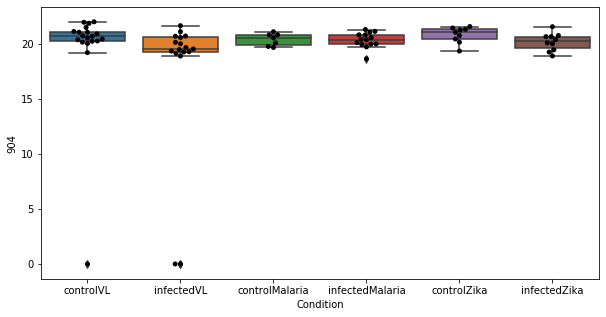

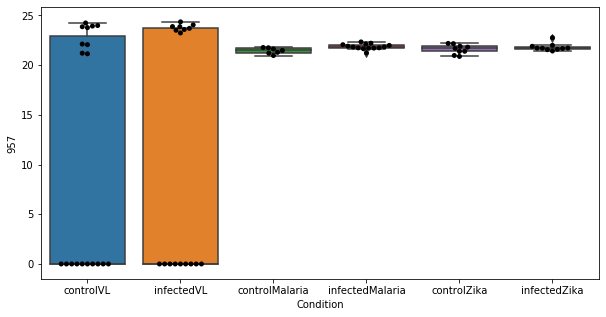

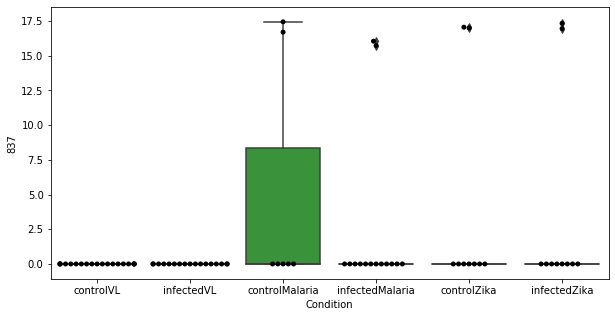

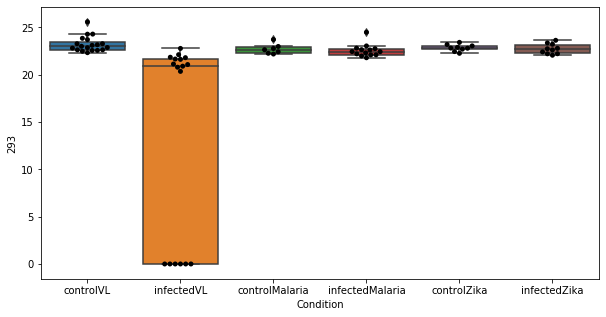

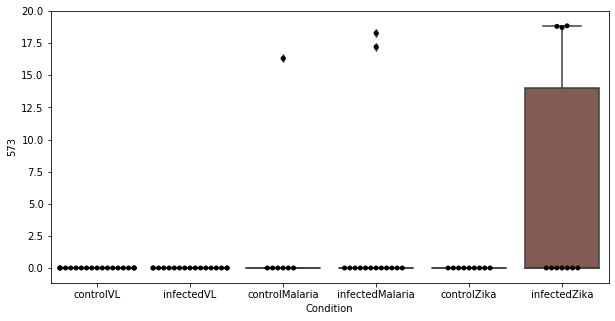

...

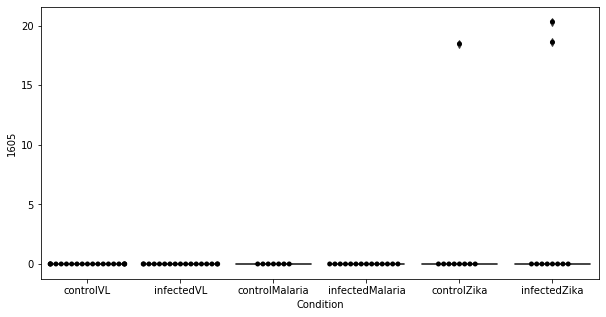

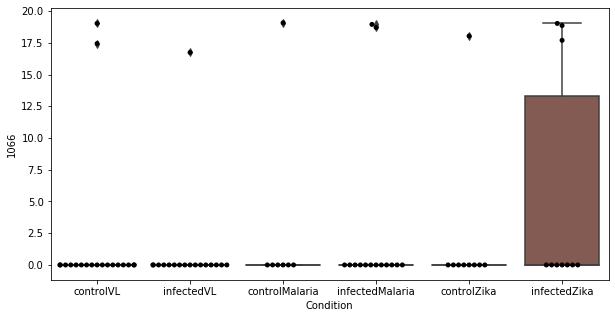

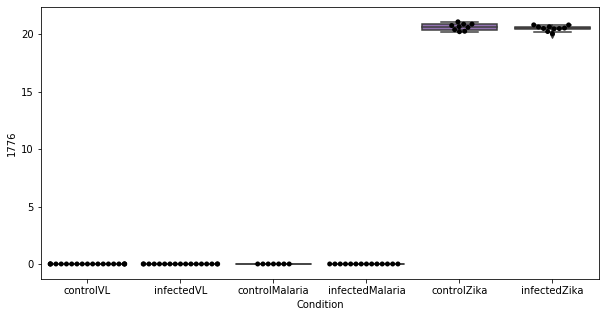

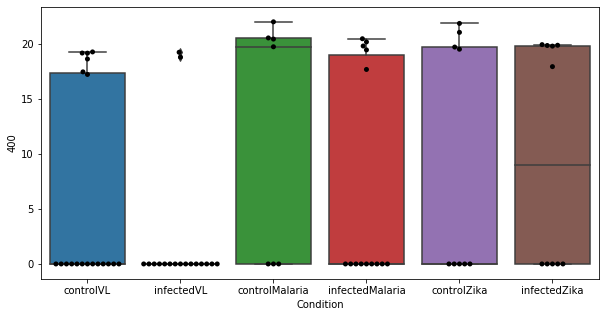

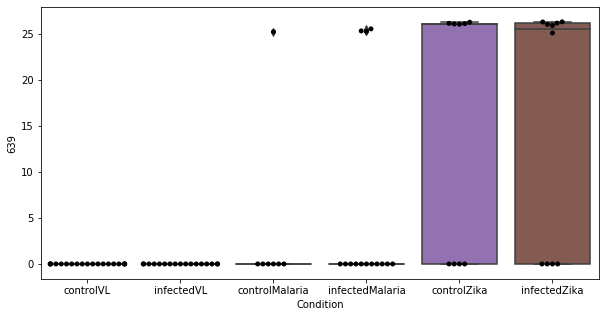

KeyboardInterrupt: 

In [153]:
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

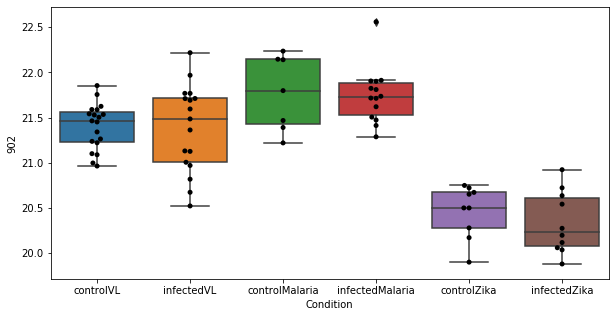

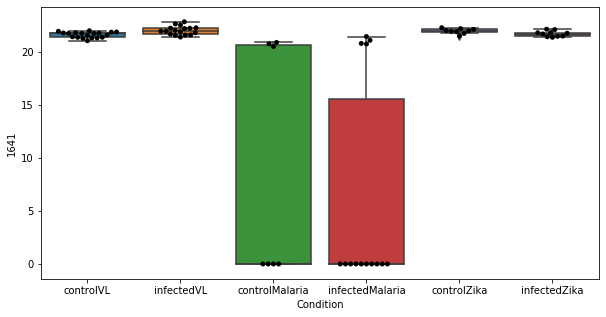

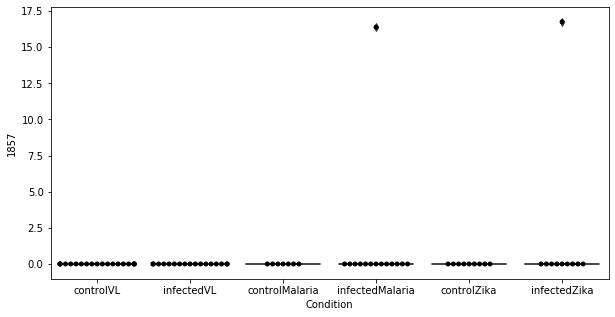

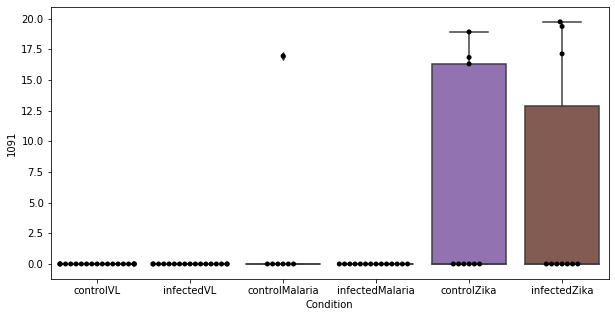

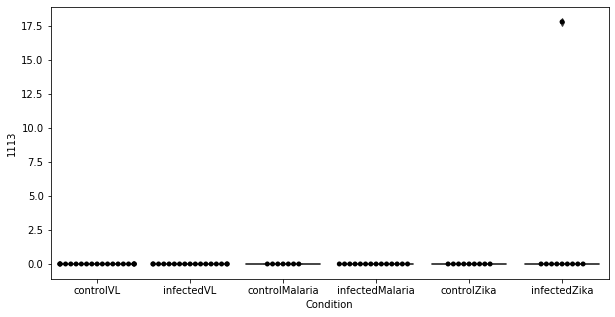

...

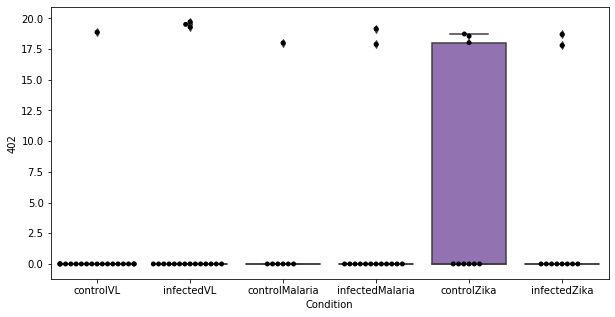

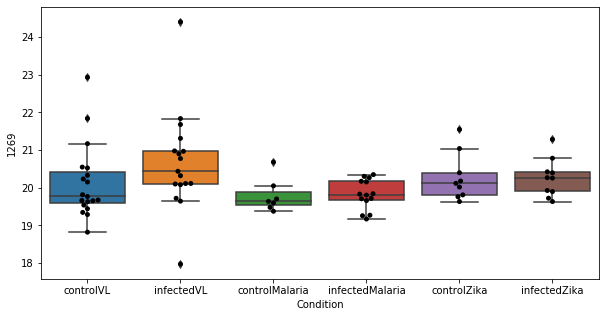

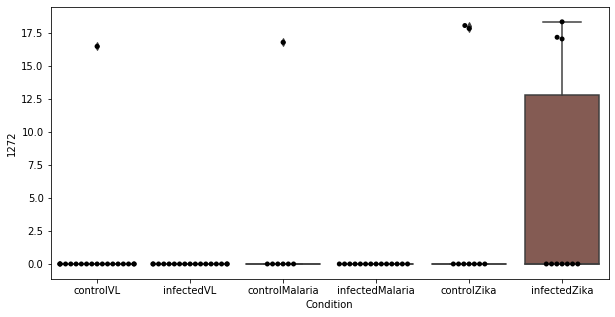

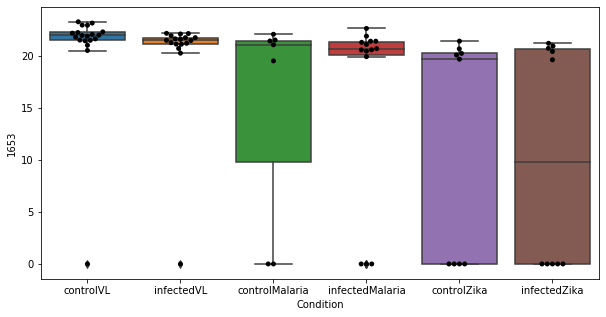

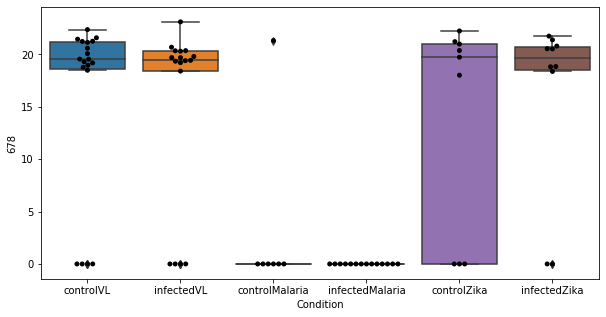

KeyboardInterrupt: 

In [35]:
#for 10% non-zero values 
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

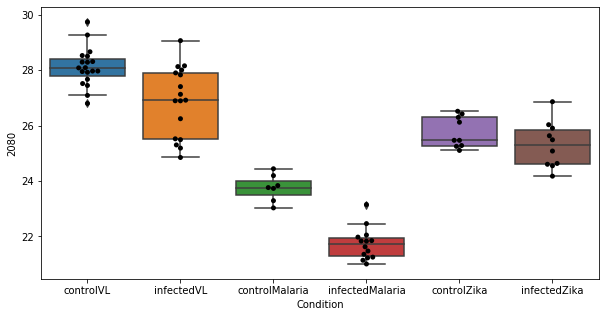

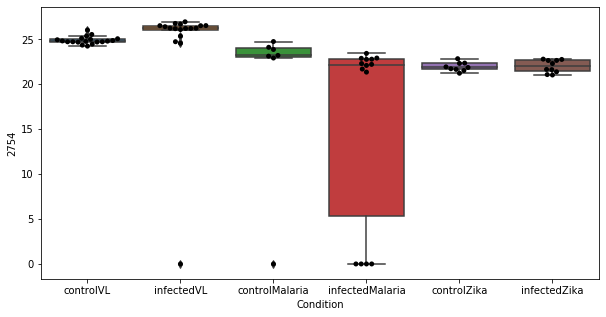

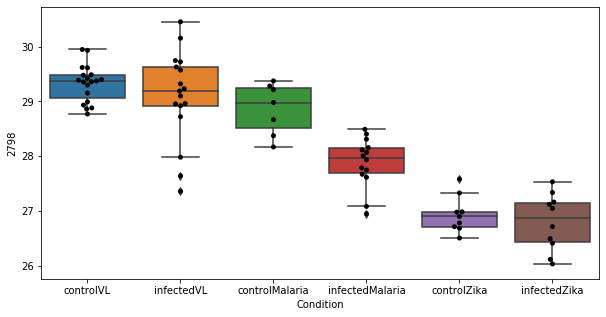

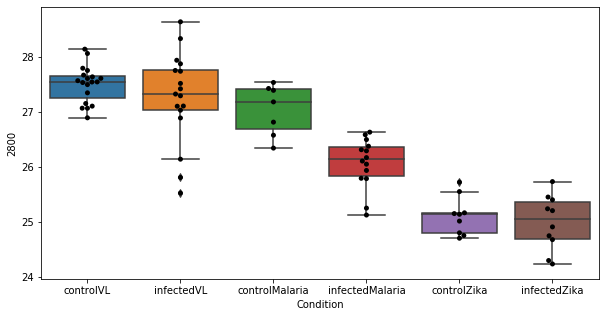

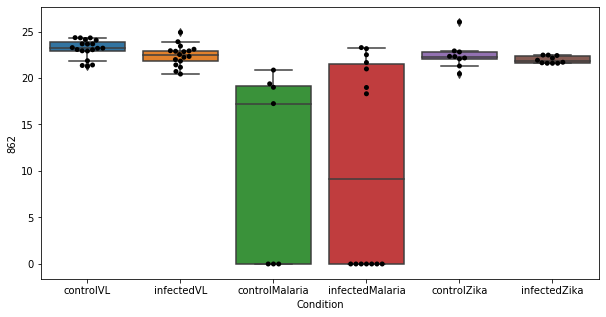

...

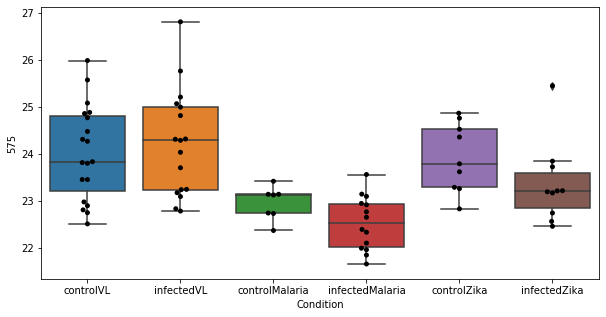

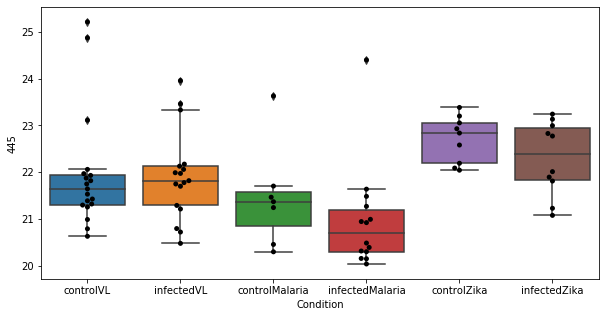

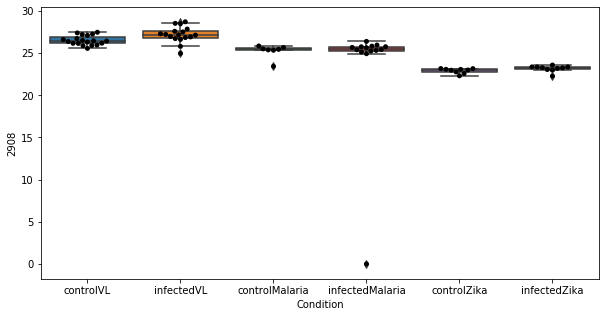

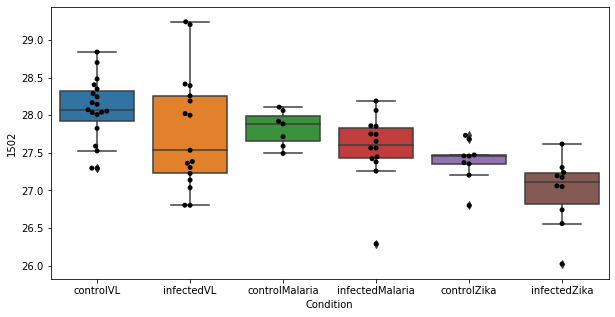

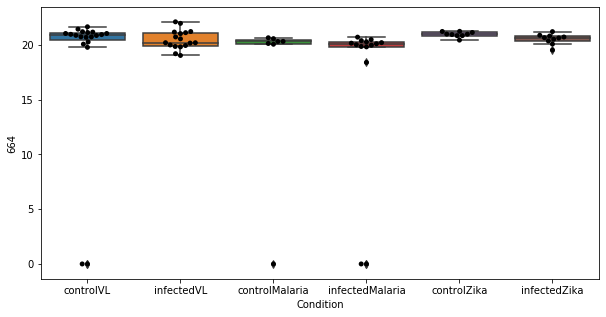

KeyboardInterrupt: 

In [214]:
#for 50% non-zero values
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [91]:
limma_topfeatures

,584,9,241,431,255,126,256,104,174,344,...,242,605,583,95,226,212,15,529,68,Condition
ZIK10.mzXML,20.561902,20.388158,26.844279,19.122619,24.106804,16.658967,22.869547,19.570646,23.660171,17.912564,...,22.662808,18.671188,23.681614,19.578446,18.973433,19.501633,19.358731,15.585411,20.565806,infectedZika
ZIK6.mzXML,21.887242,19.307789,26.941892,0.000000,24.576371,0.000000,22.908194,19.655611,23.076085,0.000000,...,21.910750,0.000000,24.481392,19.745973,18.647416,0.000000,0.000000,0.000000,0.000000,infectedZika
ZIK7.mzXML,21.374661,19.831240,27.304239,0.000000,23.899899,0.000000,23.219933,19.575473,23.435993,0.000000,...,19.564158,0.000000,23.643720,19.246465,18.446003,19.250143,0.000000,17.227712,0.000000,infectedZika
C7_2.mzXML,22.387390,21.404574,28.189089,0.000000,19.213314,0.000000,24.087428,0.000000,26.336947,0.000000,...,21.723311,18.312975,22.937727,18.827073,20.320984,0.000000,0.000000,0.000000,0.000000,controlVL
C1.mzXML,21.803592,20.198539,27.519133,0.000000,25.096383,0.000000,23.349565,19.020603,22.950323,0.000000,...,0.000000,0.000000,24.395283,19.729902,18.629225,0.000000,0.000000,0.000000,0.000000,controlZika
KM_10.mzXML,20.965082,0.000000,25.239077,0.000000,24.630074,0.000000,0.000000,0.000000,23.421905,0.000000,...,0.000000,0.000000,23.089732,19.897299,16.870521,20.077639,0.000000,0.000000,0.000000,controlMalaria
C10_2.mzXML,22.285970,20.934347,27.313138,0.000000,0.000000,0.000000,23.282154,20.653575,26.292951,0.000000,...,20.494109,0.000000,22.553331,20.357066,19.869752,0.000000,0.000000,0.000000,0.000000,controlVL
VL7.mzXML,23.647678,20.789353,28.366262,0.000000,0.000000,0.000000,24.301376,0.000000,26.089403,0.000000,...,0.000000,0.000000,0.000000,20.694990,0.000000,0.000000,0.000000,0.000000,0.000000,infectedVL
KM_11.mzXML,20.465807,0.000000,26.006961,0.000000,24.974797,0.000000,22.372627,0.000000,23.173568,0.000000,...,22.943666,0.000000,22.742501,0.000000,18.277986,20.123221,20.825051,0.000000,0.000000,infectedMalaria
KM_9.mzXML,20.081843,0.000000,24.318862,0.000000,24.537548,0.000000,0.000000,0.000000,22.209860,0.000000,...,0.000000,0.000000,23.811299,0.000000,0.000000,20.551939,21.252397,0.000000,0.000000,infectedMalaria


ModuleNotFoundError: No module named 'fancyimpute'

In [ ]:
limma_topfeatures

In [46]:
def plot_boxplots(limma_topfeatures, metab_id, ylim, y = False ):
    plt.figure(figsize=(10,5))
   
    ax = sns.boxplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    if y:
        plt.ylim(ylim)
    plt.show()

## Preparing file for mummichog

In [22]:
import scipy
data = feature_description.loc[toptable_50_filled.index]
#data['row retention time'] = np.zeros(len(data))
data['p-val'] = toptable_50_filled['P.Value']
#data['t-val'] = toptable['t']
data['adj.P.Val'] = toptable_50_filled['adj.P.Val']
data['custom_id'] = list(data.index)
data_without_rt = data.drop(['row retention time'], axis = 1)

In [216]:
data.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/topfeatures50_filled.txt', header=True, index=None, sep='\t', mode='w')
data_without_rt.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/topfeatures_without_rt.txt', header=True, index=None, sep='\t', mode='w')

In [217]:
os.system('mummichog -f'+'/Users/anamaria/Desktop/mzmine/221119/topfeatures50_filled.txt'+' -m positive -u 3 -o mm')

0

In [69]:
os.system('mummichog -f'+'/Users/anamaria/Desktop/mzmine/221119/topfeatures_without_rt.txt'+' -m positive -u 3 -o mm')

256

In [17]:
compounds = pd.read_csv('1575300703.96.mm/tables/ListOfEmpiricalCompounds.tsv', sep='\t')
featureoutput = pd.read_csv('1575300703.96.mm/tables/userInputData.txt', sep='\t')

In [70]:
compounds = pd.read_csv('1575038242.09.mm/tables/ListOfEmpiricalCompounds.tsv', sep='\t')
featureoutput = pd.read_csv('1575038242.09.mm/tables/userInputData.txt', sep='\t')

In [23]:
matching_ids = {}
for _,row in featureoutput.iterrows():
    key = row['massfeature_rows']
    value = row['CompoundID_from_user']
    matching_ids[key] = value

In [24]:
compounds_dict = {}
for _,row in compounds.iterrows():
    ids = row['massfeature_rows']
    ions = row['str_row_ion']
    compoundlist = row['compound_names']
    
    ids_list = ids.split(';')
    ions_list = ions.split(';')
    for i in range(len(ids_list)):
        compounds_dict[matching_ids[ids_list[i]]] = []
        compounds_dict[matching_ids[ids_list[i]]].append(ions_list[i].split('_')[1])
        compounds_dict[matching_ids[ids_list[i]]].append(compoundlist)
        

In [25]:
for row_id,row in data.iterrows():
    if row_id in list(compounds_dict.keys()):
        
        data.at[row_id,'compound_names'] = compounds_dict[row_id][-1]
    else:
         data.at[row_id,'compound_names'] = 'NaN'
    

In [26]:
#pd.set_option('display.max_rows', 1000)
pdata = data[data['p-val'] <= 1]

In [27]:
data.loc[1521]

row m/z                                                         213.098
row retention time                                              12.0963
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

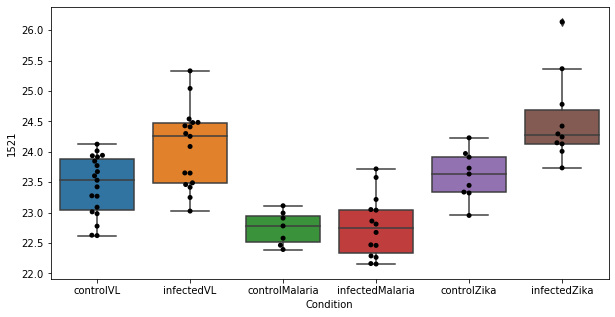

In [183]:
plot_boxplots(limma_topfeatures,1521, (15,30), False)

In [191]:
data.loc[1543]

row m/z                                                         210.096
row retention time                                              9.33432
p-val                                                        0.00406191
adj.P.Val                                                      0.327955
custom_id                                                          1543
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1543, dtype: object

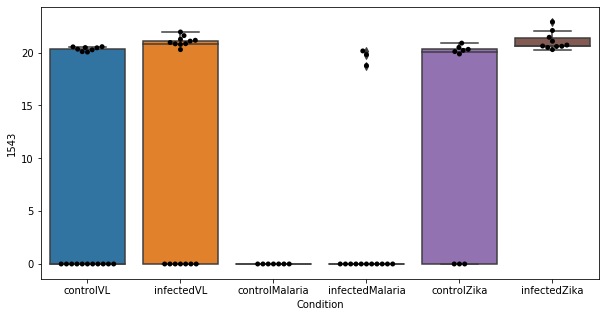

In [43]:
plot_boxplots(limma_topfeatures,1543, (15,30), False)

In [195]:
data.loc[575]

row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                         0.0407753
adj.P.Val                                                      0.743377
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object

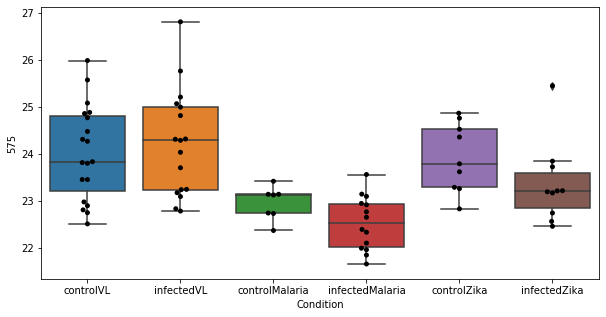

In [196]:
plot_boxplots(limma_topfeatures,575, (15,30), False)

In [198]:
data.loc[1661]

row m/z                           218.139
row retention time                8.41637
p-val                           0.0552375
adj.P.Val                        0.806068
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object

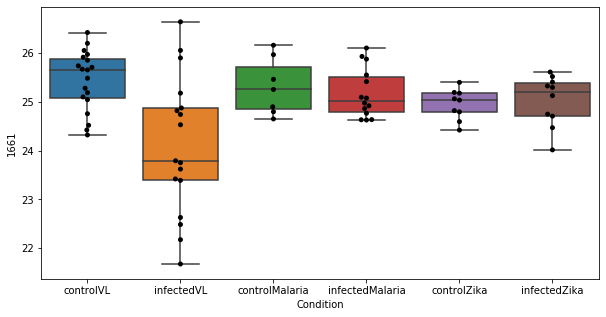

In [199]:
plot_boxplots(limma_topfeatures,1661, (15,30), False)

In [200]:
data.loc[239]

row m/z                                                          115.05
row retention time                                              10.3323
p-val                                                         0.0621256
adj.P.Val                                                      0.860949
custom_id                                                           239
compound_names        5,6-Dihydrouracil; 2,4(1H,3H)-Pyrimidinedione,...
Name: 239, dtype: object

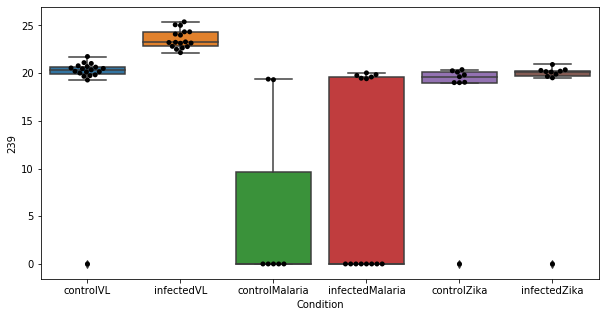

In [201]:
plot_boxplots(limma_topfeatures,239, (15,30), False)

In [59]:
data.loc[902]

row m/z                  160.116
row retention time       10.4075
p-val                 2.8358e-05
adj.P.Val             0.00877682
custom_id                    902
compound_names               NaN
Name: 902, dtype: object

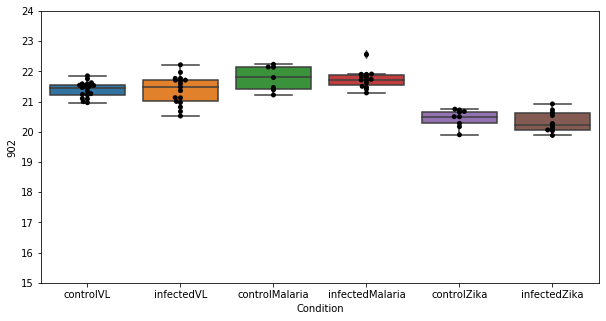

In [60]:
plot_boxplots(limma_topfeatures,902, (15,24), True)

In [108]:
data.loc[457]

row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.536622
adj.P.Val                                                      0.999947
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object

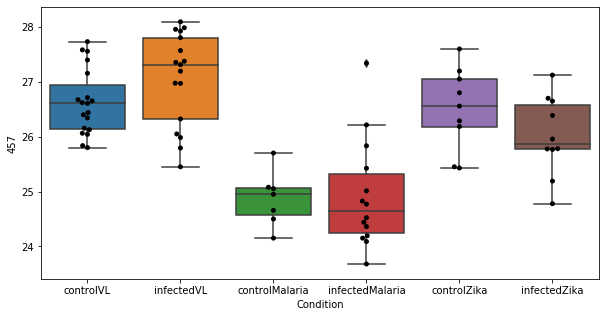

In [109]:
plot_boxplots(limma_topfeatures,457, (15,30), False)

In [135]:
for i in list(toptable_50.index):
    mz = data.loc[i]['row m/z']
    if mz > 100.0 and mz <230.0:
        print(mz)

142.0863576776841
115.0695485064858
130.15906863742404
116.0706210569902
102.06623077392578
116.07047700881958
106.049880680285
123.05527623494464
129.10223881648136
115.07537656511579
115.05025736490887
130.08630989693307
114.09845822477993
114.09138870239258
124.08698785716088
102.0661973953247
129.09101119695922
105.11036726485851
101.0763931274414
113.10729163033622
143.0816130802549
100.07568105061847
127.0866355895996
136.0757680620466
136.06183242797852
114.0550639629364
111.0553207397461
115.0502700805664
106.97155380249023
129.1022192913553
132.1421009751617
141.06590837047946
122.1041380564372
125.09614275322586
101.07160232543946
111.11685180664062
118.05242580837673
133.07975006103516
130.06519063313806
118.08624432538006
123.11681801932198
113.10733677790716
130.08640683081842
126.0219806871916
104.10698776245115
142.12273035551368
130.96070353190106
115.0866195678711
115.12298631668092
122.101953125
131.16241200764978
115.09473750465794
104.10696566944391
116.037513287862

In [260]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

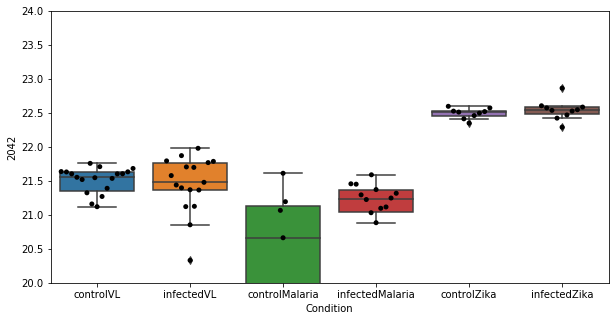

In [251]:
plot_boxplots(limma_topfeatures,2042, (20,24), True)

0 row m/z                    258.11
row retention time        11.3506
p-val                 9.07684e-07
adj.P.Val             0.000549149
custom_id                    2080
compound_names                NaN
Name: 2080, dtype: object


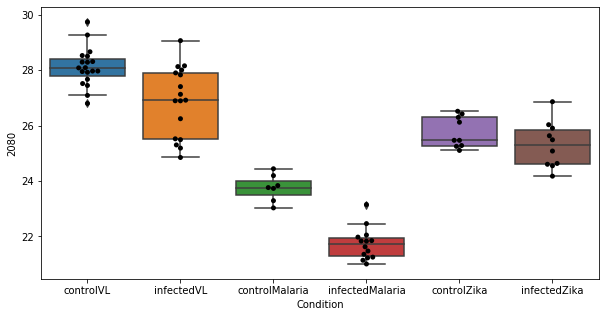

1 row m/z                   482.361
row retention time        3.86973
p-val                 2.52872e-05
adj.P.Val              0.00764939
custom_id                    2754
compound_names                NaN
Name: 2754, dtype: object


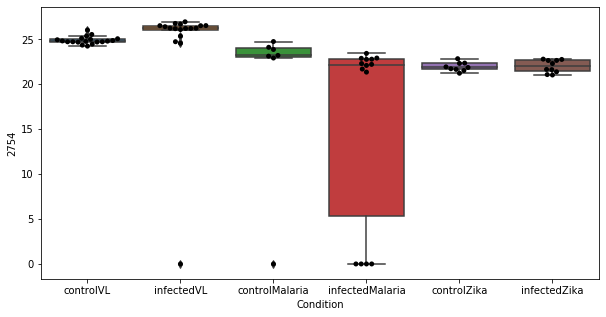

2 row m/z                                                         524.371
row retention time                                               3.7029
p-val                                                       0.000184762
adj.P.Val                                                     0.0235834
custom_id                                                          2798
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2798, dtype: object


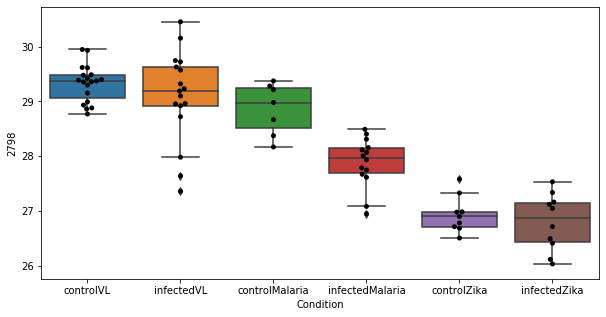

3 row m/z                   525.375
row retention time         3.7012
p-val                 0.000216906
adj.P.Val               0.0235834
custom_id                    2800
compound_names                NaN
Name: 2800, dtype: object


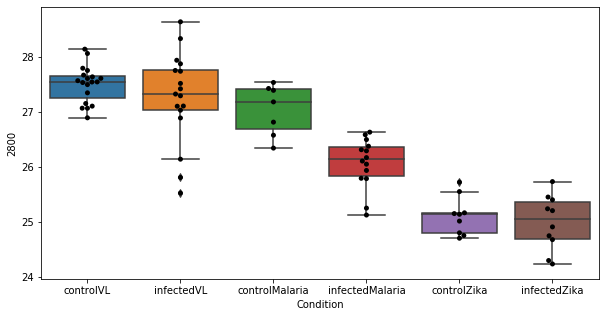

4 row m/z                   158.118
row retention time        8.65825
p-val                 0.000225119
adj.P.Val               0.0235834
custom_id                     862
compound_names                NaN
Name: 862, dtype: object


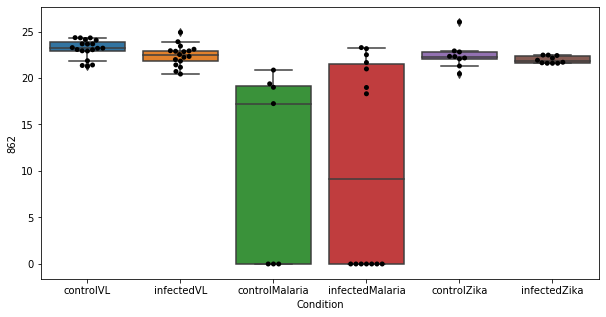

5 row m/z                   526.377
row retention time        3.70252
p-val                 0.000233885
adj.P.Val               0.0235834
custom_id                    2801
compound_names                NaN
Name: 2801, dtype: object


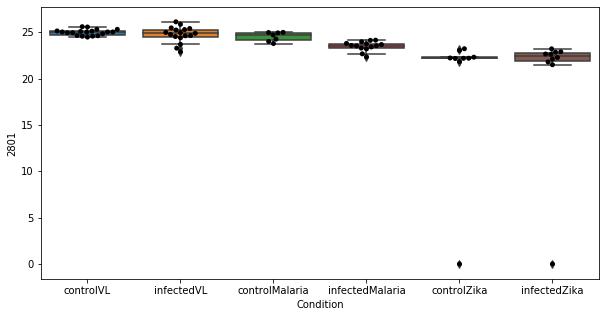

6 row m/z                                                         508.376
row retention time                                              3.77338
p-val                                                       0.000334879
adj.P.Val                                                     0.0289431
custom_id                                                          4264
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 4264, dtype: object


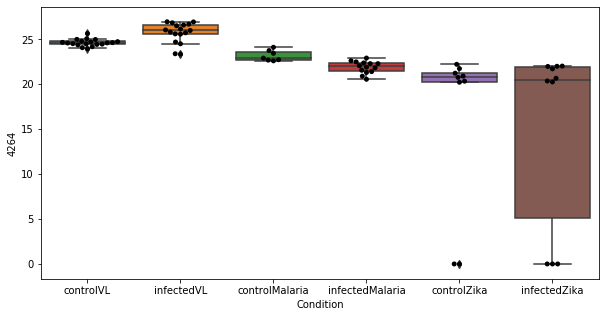

7 row m/z                  787.666
row retention time       3.99348
p-val                 0.00146278
adj.P.Val               0.110623
custom_id                   3027
compound_names               NaN
Name: 3027, dtype: object


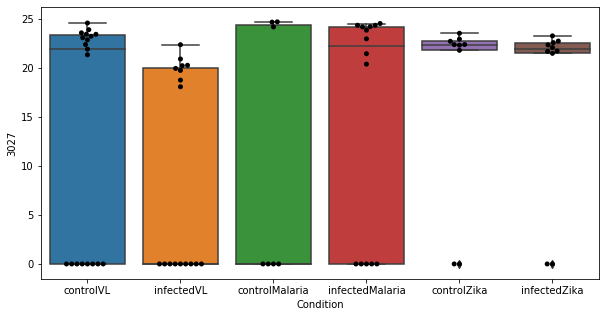

8 row m/z                  469.312
row retention time       3.97423
p-val                 0.00193935
adj.P.Val               0.130368
custom_id                   2743
compound_names               NaN
Name: 2743, dtype: object


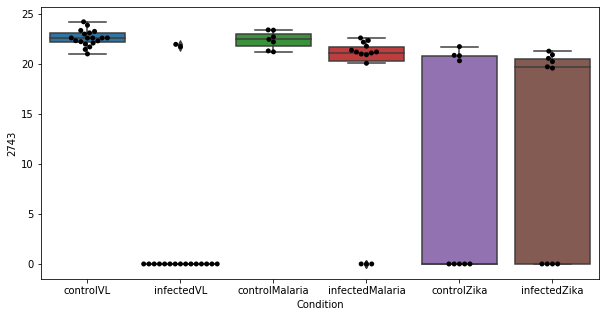

9 row m/z                  480.345
row retention time       3.77761
p-val                 0.00271502
adj.P.Val               0.164259
custom_id                   2751
compound_names               NaN
Name: 2751, dtype: object


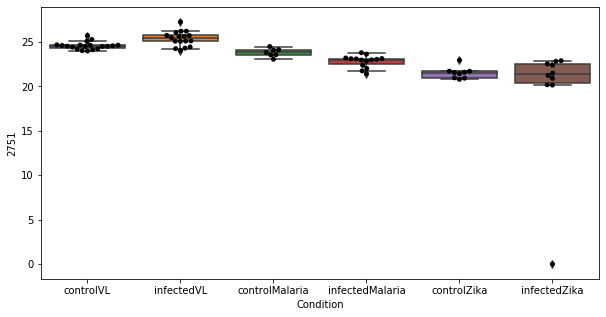

10 row m/z                                                         241.031
row retention time                                              12.5979
p-val                                                        0.00361738
adj.P.Val                                                      0.198956
custom_id                                                          1917
compound_names        L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-...
Name: 1917, dtype: object


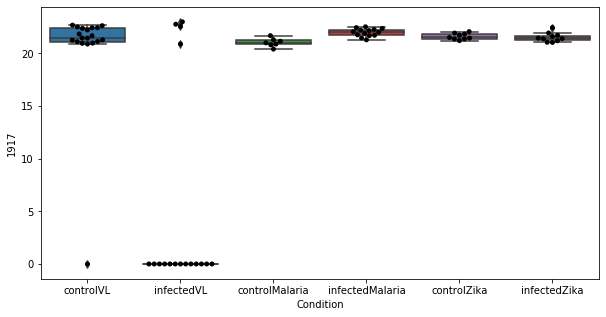

11 row m/z                  499.348
row retention time       3.82135
p-val                 0.00414578
adj.P.Val               0.205399
custom_id                   2773
compound_names               NaN
Name: 2773, dtype: object


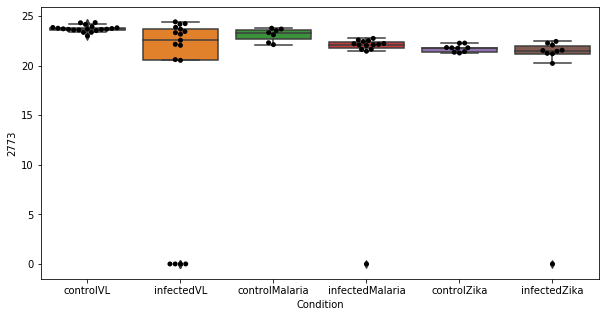

12 row m/z                  510.356
row retention time       3.75557
p-val                 0.00469477
adj.P.Val               0.205399
custom_id                   2779
compound_names               NaN
Name: 2779, dtype: object


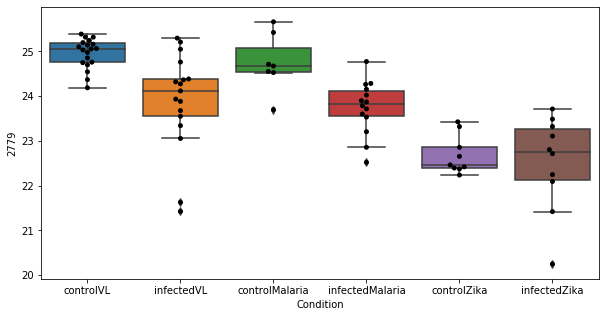

13 row m/z                  495.328
row retention time        3.8612
p-val                 0.00518985
adj.P.Val               0.205399
custom_id                   2766
compound_names               NaN
Name: 2766, dtype: object


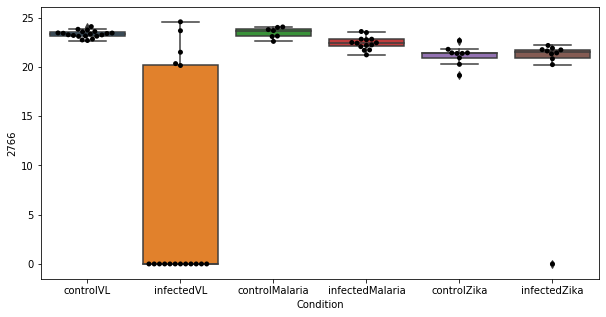

14 row m/z                  498.346
row retention time       3.81396
p-val                 0.00540066
adj.P.Val               0.205399
custom_id                   2771
compound_names               NaN
Name: 2771, dtype: object


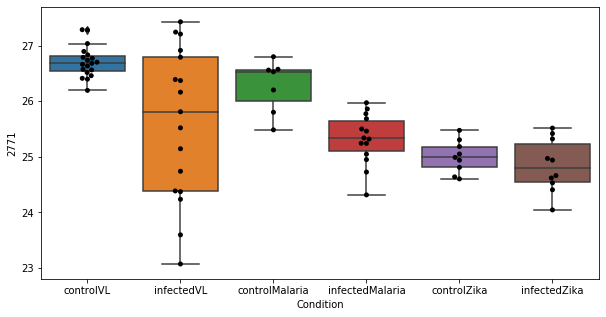

15 row m/z                  171.076
row retention time       9.23593
p-val                 0.00557835
adj.P.Val               0.205399
custom_id                   1045
compound_names               NaN
Name: 1045, dtype: object


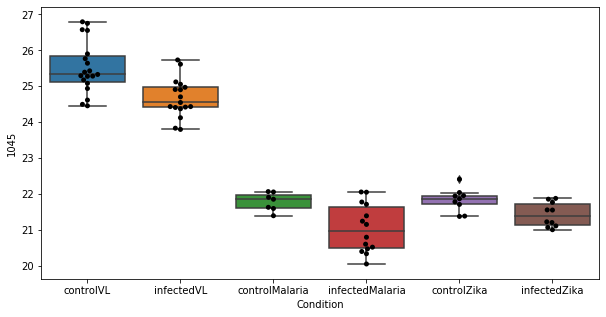

16 row m/z                  497.343
row retention time       3.82271
p-val                 0.00581514
adj.P.Val               0.205399
custom_id                   2769
compound_names               NaN
Name: 2769, dtype: object


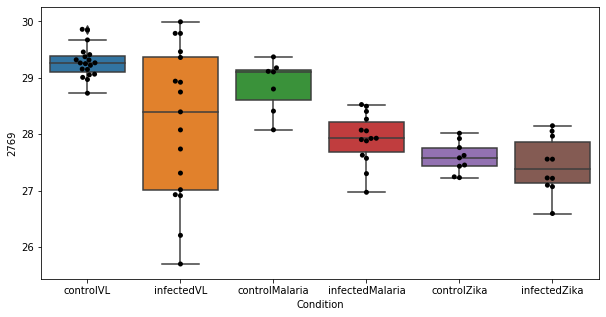

17 row m/z                                                          496.34
row retention time                                              3.81947
p-val                                                        0.00647208
adj.P.Val                                                      0.205399
custom_id                                                          2767
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2767, dtype: object


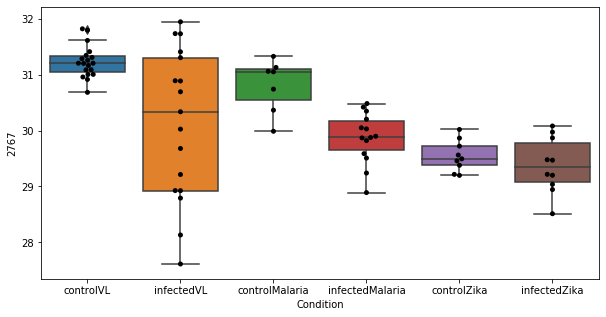

18 row m/z                                                         128.071
row retention time                                              9.77144
p-val                                                        0.00666647
adj.P.Val                                                      0.205399
custom_id                                                           383
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 383, dtype: object


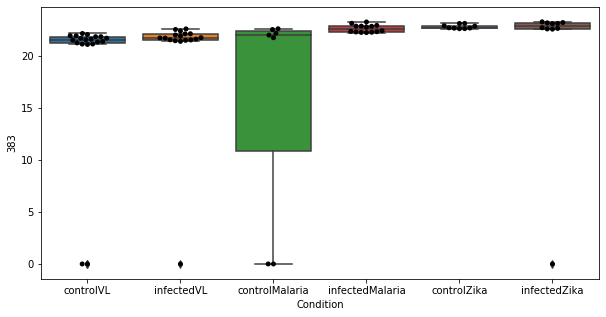

19 row m/z                                         151.112
row retention time                              3.98716
p-val                                        0.00754278
adj.P.Val                                      0.205399
custom_id                                           767
compound_names        Perillyl aldehyde; Perillaldehyde
Name: 767, dtype: object


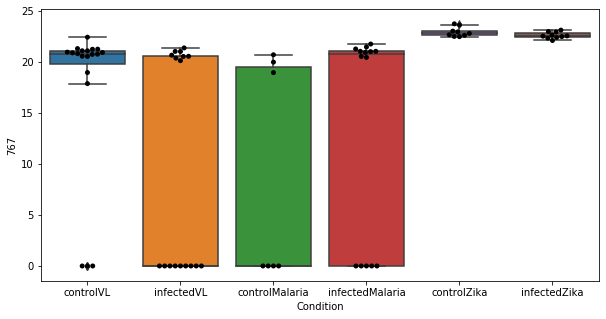

20 row m/z                                                          130.05
row retention time                                              9.23574
p-val                                                         0.0077333
adj.P.Val                                                      0.205399
custom_id                                                           411
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 411, dtype: object


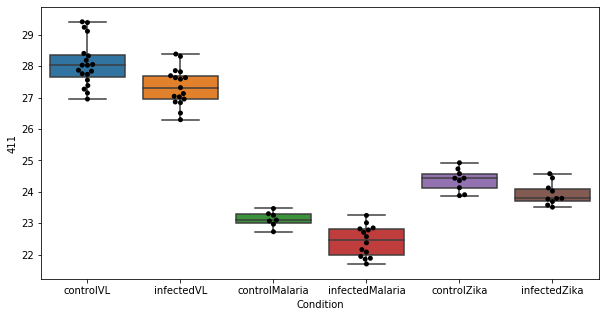

21 row m/z                  174.113
row retention time       9.82136
p-val                 0.00789959
adj.P.Val               0.205399
custom_id                   1089
compound_names               NaN
Name: 1089, dtype: object


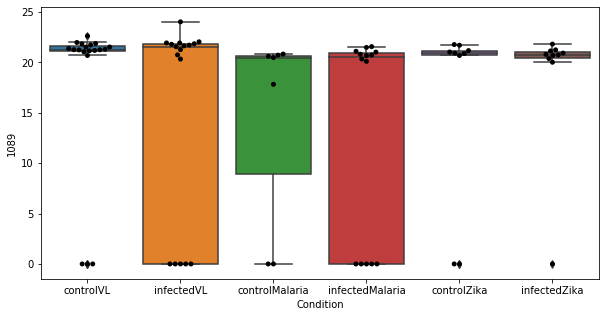

22 row m/z                                                          116.07
row retention time                                              8.61149
p-val                                                        0.00807123
adj.P.Val                                                      0.205399
custom_id                                                           256
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 256, dtype: object


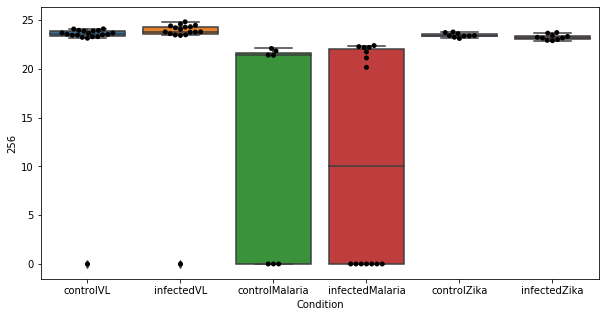

23 row m/z                            468.308
row retention time                 3.97058
p-val                           0.00814805
adj.P.Val                         0.205399
custom_id                             2741
compound_names        Timnodonyl carnitine
Name: 2741, dtype: object


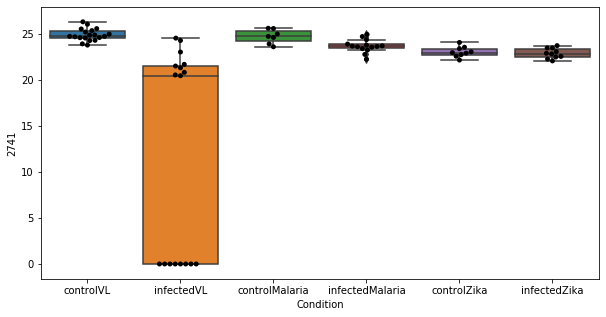

24 row m/z                                                          148.06
row retention time                                              9.59939
p-val                                                         0.0127764
adj.P.Val                                                      0.299096
custom_id                                                           710
compound_names        DL-Glutamate; DL-Glutaminic acid; 2-Aminogluta...
Name: 710, dtype: object


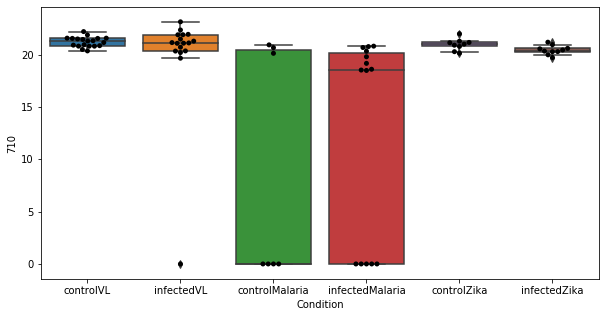

25 row m/z                 171.102
row retention time      4.37024
p-val                 0.0128537
adj.P.Val              0.299096
custom_id                  1049
compound_names              NaN
Name: 1049, dtype: object


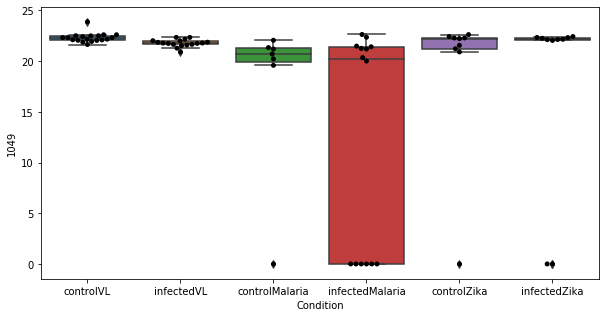

26 row m/z                            253.155
row retention time                 4.14302
p-val                            0.0142199
adj.P.Val                         0.318632
custom_id                             2042
compound_names        histidyl-prolinamide
Name: 2042, dtype: object


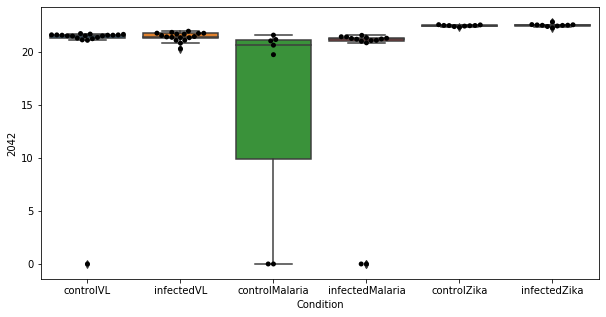

27 row m/z                482.324
row retention time     3.85737
p-val                 0.015164
adj.P.Val             0.327651
custom_id                 2752
compound_names             NaN
Name: 2752, dtype: object


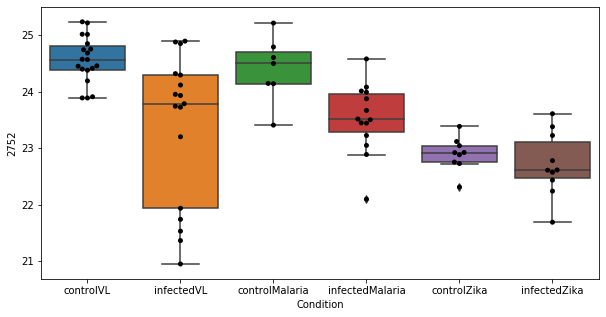

28 row m/z                  103.07
row retention time      9.63256
p-val                 0.0170748
adj.P.Val              0.356217
custom_id                   129
compound_names              NaN
Name: 129, dtype: object


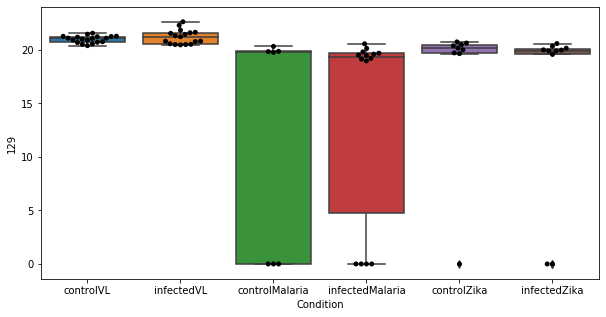

29 row m/z                 234.015
row retention time      9.79681
p-val                 0.0190455
adj.P.Val              0.384084
custom_id                  1836
compound_names              NaN
Name: 1836, dtype: object


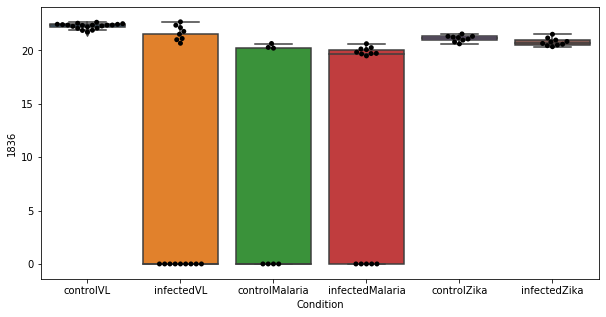

30 row m/z                                                          148.06
row retention time                                              11.7584
p-val                                                         0.0214812
adj.P.Val                                                      0.419229
custom_id                                                           709
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 709, dtype: object


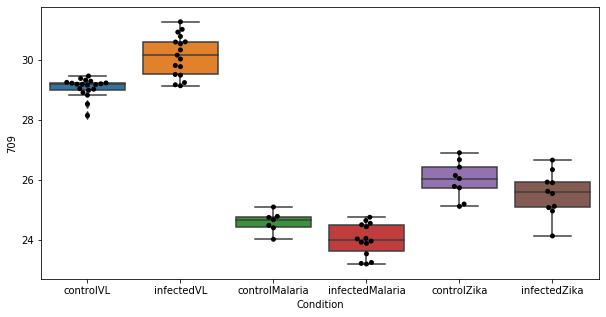

31 row m/z                          494.324
row retention time               3.86492
p-val                          0.0237557
adj.P.Val                       0.449132
custom_id                           2765
compound_names        cervonyl carnitine
Name: 2765, dtype: object


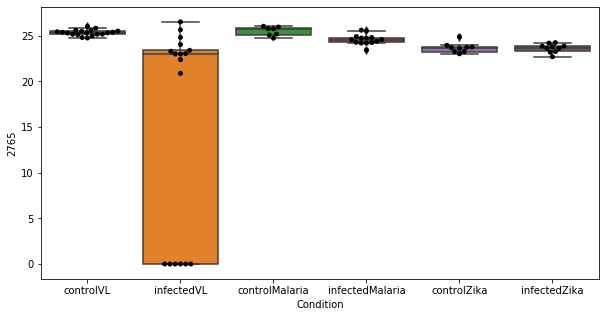

32 row m/z                                                         149.064
row retention time                                              11.7642
p-val                                                         0.0271968
adj.P.Val                                                      0.477806
custom_id                                                           730
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 730, dtype: object


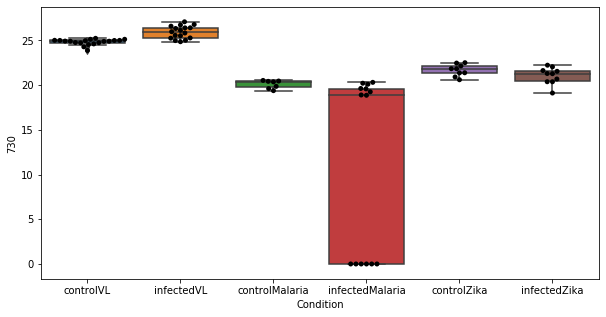

33 row m/z                                                        174.113
row retention time                                              4.3896
p-val                                                        0.0273622
adj.P.Val                                                     0.477806
custom_id                                                         1088
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1088, dtype: object


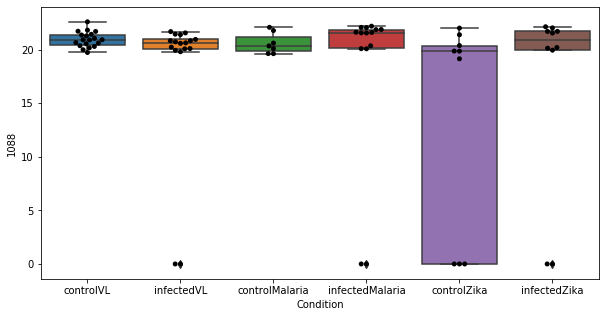

34 row m/z                  181.04
row retention time      9.67025
p-val                 0.0276417
adj.P.Val              0.477806
custom_id                  1172
compound_names              NaN
Name: 1172, dtype: object


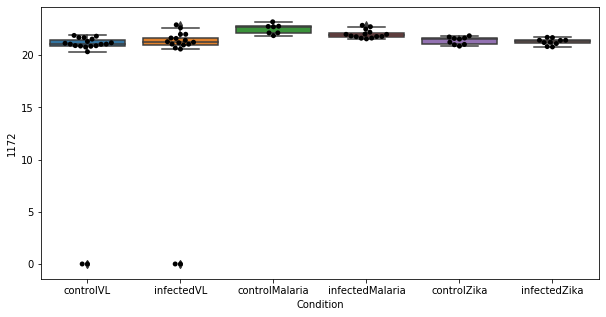

35 row m/z                                                         147.076
row retention time                                              6.87884
p-val                                                         0.0390834
adj.P.Val                                                      0.656819
custom_id                                                           690
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 690, dtype: object


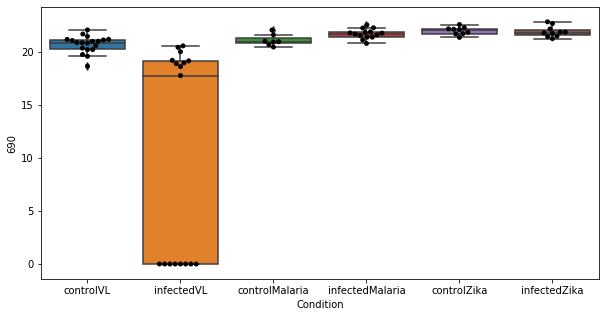

36 row m/z                 774.598
row retention time      3.19673
p-val                 0.0415036
adj.P.Val               0.67864
custom_id                  3000
compound_names              NaN
Name: 3000, dtype: object


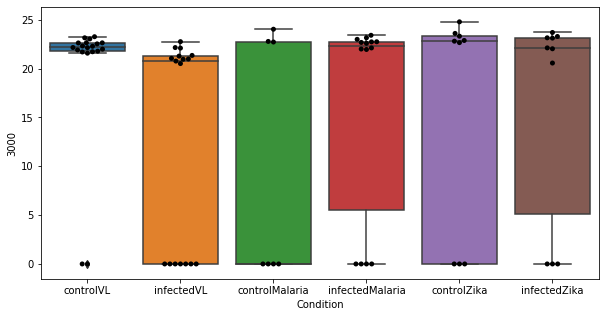

37 row m/z                 303.024
row retention time      10.4124
p-val                 0.0443632
adj.P.Val              0.691235
custom_id                  2395
compound_names              NaN
Name: 2395, dtype: object


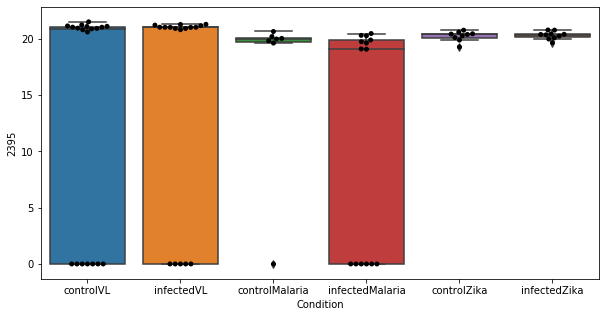

38 row m/z                 105.11
row retention time     16.7044
p-val                 0.044559
adj.P.Val             0.691235
custom_id                  159
compound_names             NaN
Name: 159, dtype: object


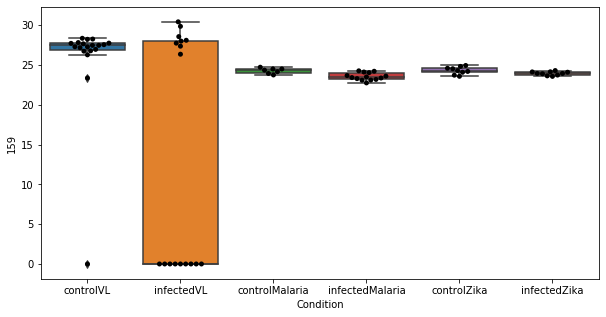

39 row m/z                                                         139.058
row retention time                                              9.88209
p-val                                                         0.0474282
adj.P.Val                                                      0.717352
custom_id                                                          4562
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 4562, dtype: object


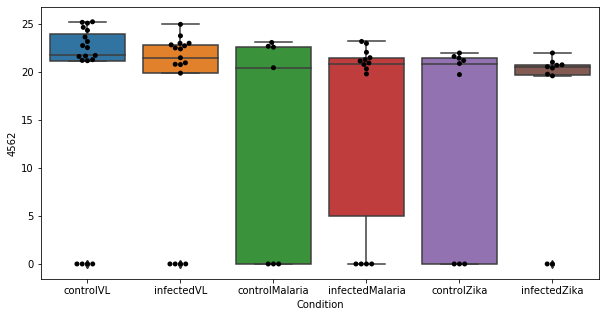

40 row m/z                 816.702
row retention time      3.30508
p-val                 0.0489516
adj.P.Val              0.722335
custom_id                  3093
compound_names              NaN
Name: 3093, dtype: object


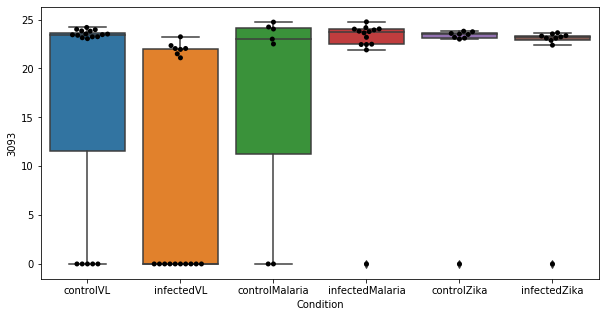

41 row m/z                                                         188.092
row retention time                                              6.71139
p-val                                                         0.0527749
adj.P.Val                                                       0.76021
custom_id                                                          1264
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1264, dtype: object


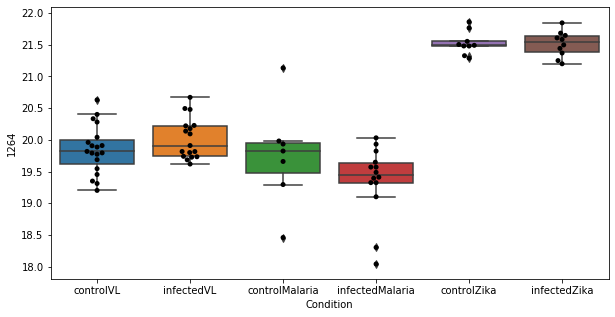

42 row m/z                 148.043
row retention time      6.71425
p-val                 0.0587151
adj.P.Val              0.826108
custom_id                   705
compound_names              NaN
Name: 705, dtype: object


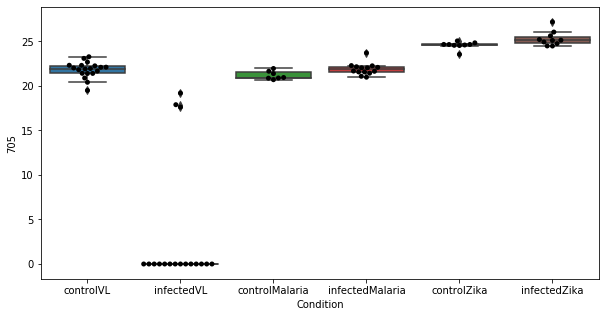

43 row m/z                 133.099
row retention time      9.28806
p-val                 0.0610063
adj.P.Val              0.829641
custom_id                   488
compound_names              NaN
Name: 488, dtype: object


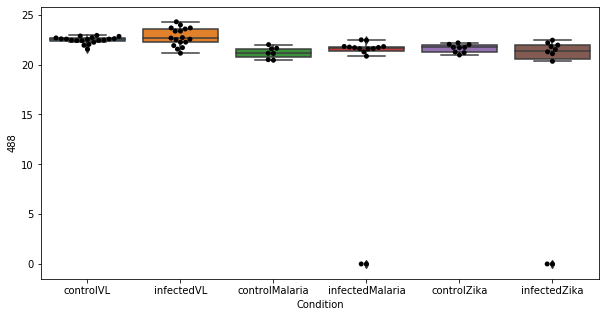

44 row m/z                 315.236
row retention time      4.37261
p-val                 0.0617088
adj.P.Val              0.829641
custom_id                  4139
compound_names              NaN
Name: 4139, dtype: object


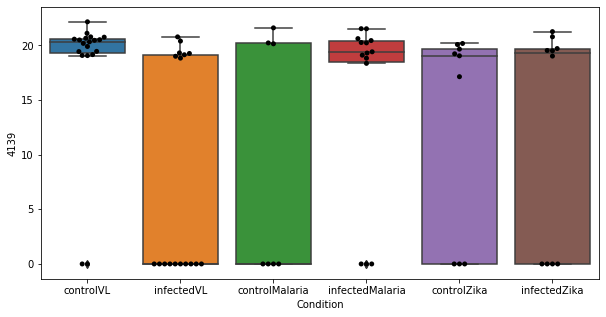

45 row m/z                 134.109
row retention time      9.30018
p-val                 0.0658805
adj.P.Val              0.866472
custom_id                   504
compound_names              NaN
Name: 504, dtype: object


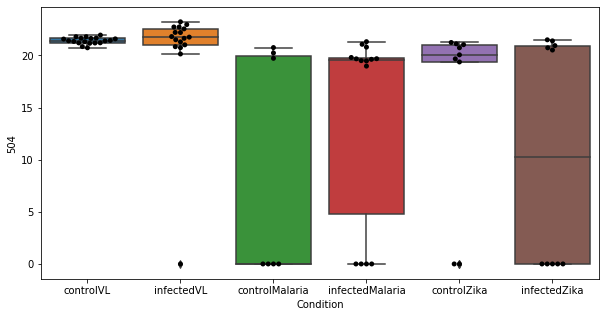

46 row m/z                                                         175.071
row retention time                                              9.92745
p-val                                                         0.0680899
adj.P.Val                                                      0.876476
custom_id                                                          1105
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 1105, dtype: object


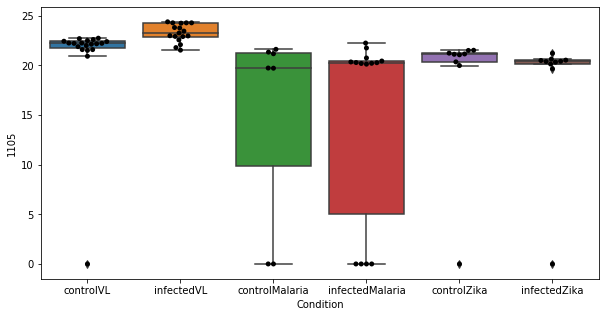

47 row m/z                 132.062
row retention time      9.28326
p-val                 0.0717451
adj.P.Val              0.897448
custom_id                   456
compound_names              NaN
Name: 456, dtype: object


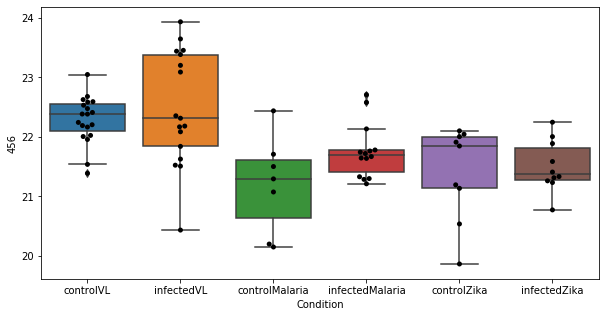

48 row m/z                 160.035
row retention time       10.568
p-val                 0.0726859
adj.P.Val              0.897448
custom_id                   896
compound_names              NaN
Name: 896, dtype: object


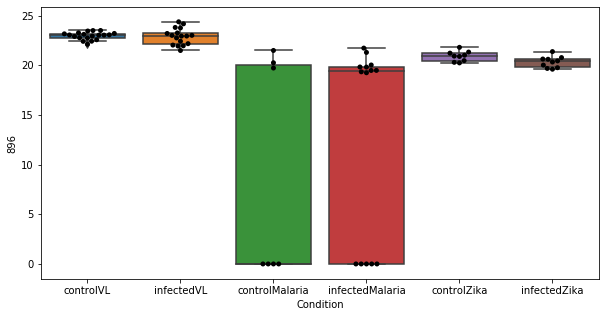

49 row m/z                 240.142
row retention time      6.70326
p-val                 0.0782452
adj.P.Val              0.946767
custom_id                  1911
compound_names              NaN
Name: 1911, dtype: object


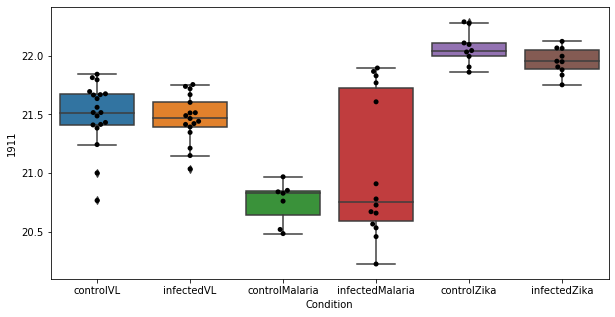

50 row m/z                518.322
row retention time     4.00668
p-val                 0.084109
adj.P.Val             0.982516
custom_id                 2785
compound_names             NaN
Name: 2785, dtype: object


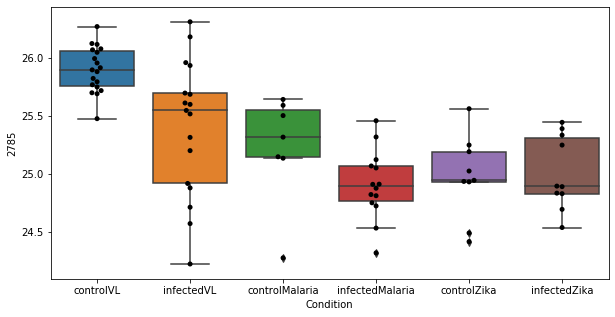

51 row m/z                                  112.051
row retention time                       9.76502
p-val                                  0.0844477
adj.P.Val                               0.982516
custom_id                                    209
compound_names        Cytosine (in DNA)$Cytosine
Name: 209, dtype: object


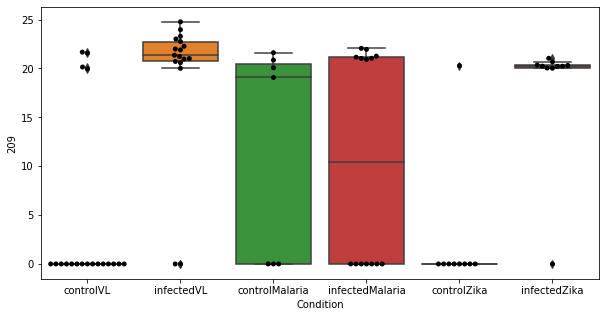

52 row m/z                  568.34
row retention time      3.67488
p-val                 0.0873664
adj.P.Val              0.990505
custom_id                  2832
compound_names              NaN
Name: 2832, dtype: object


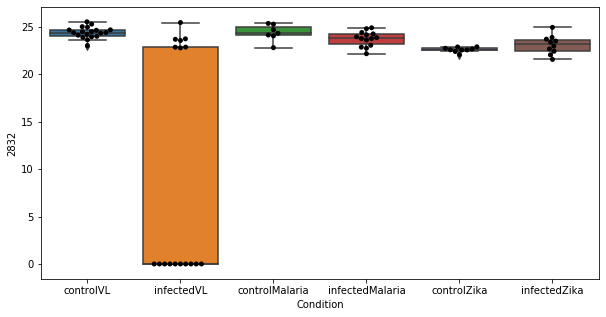

53 row m/z                 240.142
row retention time      4.38087
p-val                 0.0884087
adj.P.Val              0.990505
custom_id                  1912
compound_names              NaN
Name: 1912, dtype: object


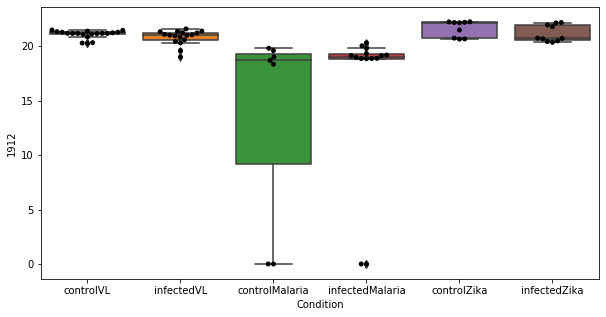

54 row m/z                 522.356
row retention time      3.73699
p-val                 0.0914825
adj.P.Val              0.993422
custom_id                  2794
compound_names              NaN
Name: 2794, dtype: object


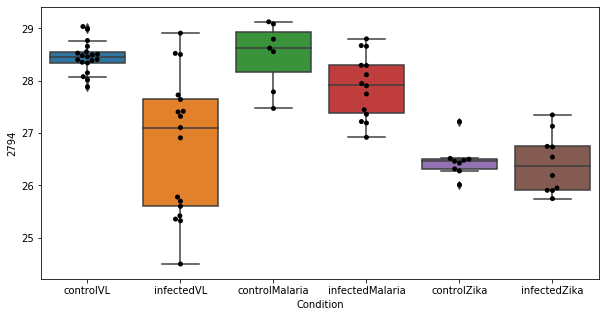

55 row m/z                  162.05
row retention time      10.4026
p-val                 0.0919531
adj.P.Val              0.993422
custom_id                   920
compound_names              NaN
Name: 920, dtype: object


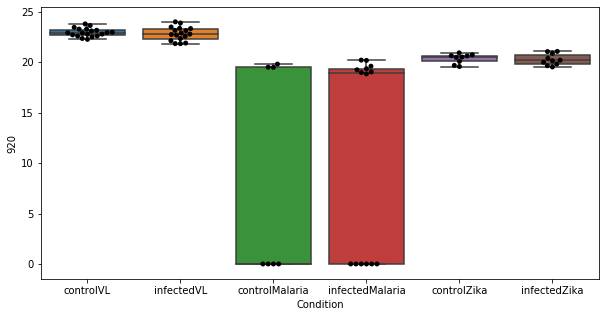

56 row m/z                 519.325
row retention time      3.99289
p-val                 0.0940943
adj.P.Val               0.99872
custom_id                  2787
compound_names              NaN
Name: 2787, dtype: object


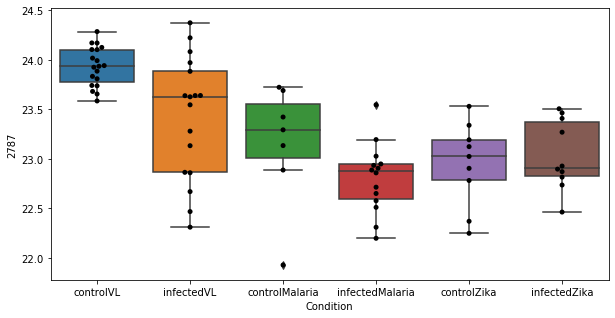

57 row m/z                               190.086
row retention time                    6.71757
p-val                               0.0974994
adj.P.Val                            0.999732
custom_id                                1291
compound_names        methyl indole-3-acetate
Name: 1291, dtype: object


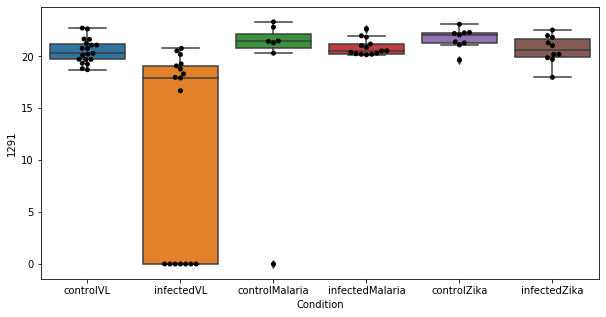

58 row m/z                 523.359
row retention time      3.73649
p-val                 0.0989123
adj.P.Val              0.999732
custom_id                  2796
compound_names              NaN
Name: 2796, dtype: object


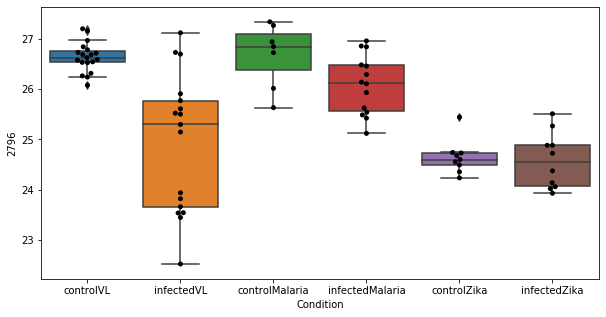

59 row m/z                                                         102.055
row retention time                                              9.79951
p-val                                                          0.099147
adj.P.Val                                                      0.999732
custom_id                                                           121
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 121, dtype: object


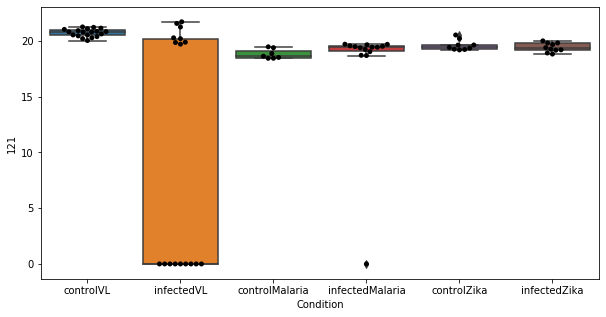

60 row m/z                                                        184.097
row retention time                                             4.41352
p-val                                                         0.103264
adj.P.Val                                                     0.999793
custom_id                                                         1206
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1206, dtype: object


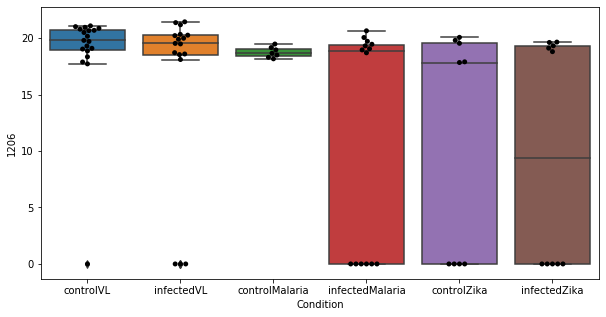

61 row m/z                136.048
row retention time     8.55757
p-val                 0.119736
adj.P.Val             0.999793
custom_id                  516
compound_names             NaN
Name: 516, dtype: object


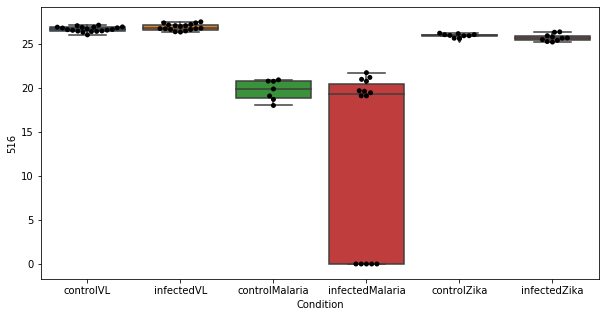

62 row m/z                815.697
row retention time     3.30551
p-val                 0.120947
adj.P.Val             0.999793
custom_id                 3091
compound_names             NaN
Name: 3091, dtype: object


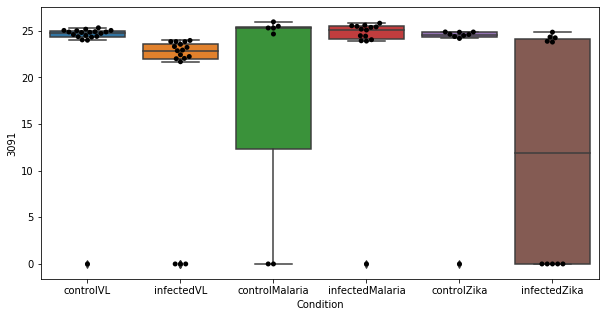

63 row m/z                132.142
row retention time      9.2814
p-val                 0.127186
adj.P.Val             0.999793
custom_id                  469
compound_names             NaN
Name: 469, dtype: object


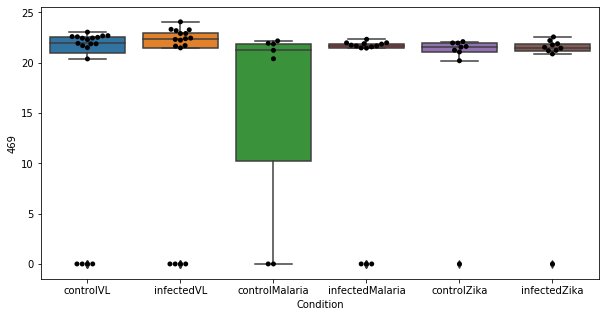

64 row m/z                547.358
row retention time     3.70293
p-val                 0.127451
adj.P.Val             0.999793
custom_id                 2818
compound_names             NaN
Name: 2818, dtype: object


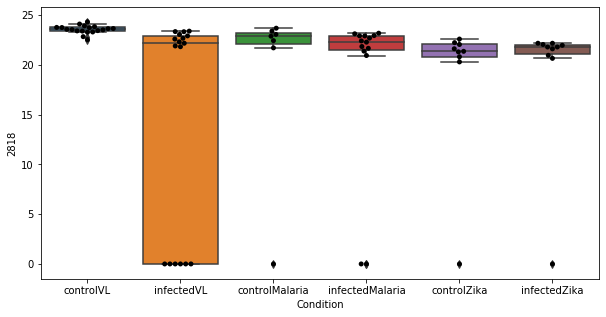

65 row m/z                                                         138.055
row retention time                                              6.72619
p-val                                                          0.140375
adj.P.Val                                                      0.999793
custom_id                                                           551
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 551, dtype: object


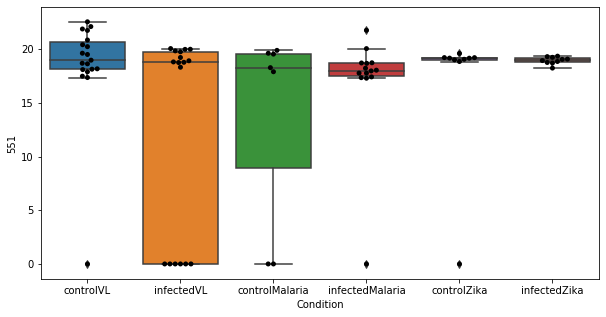

66 row m/z                141.091
row retention time     4.38297
p-val                  0.14757
adj.P.Val             0.999793
custom_id                  577
compound_names             NaN
Name: 577, dtype: object


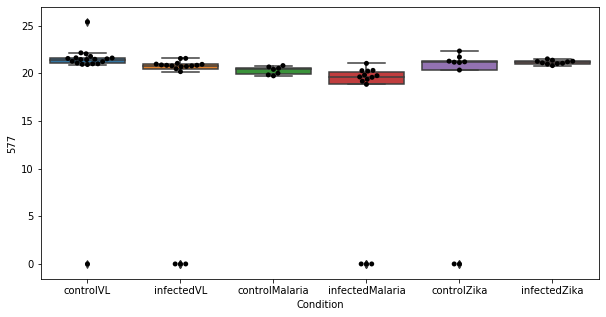

67 row m/z                                 159.028
row retention time                      9.03375
p-val                                  0.147835
adj.P.Val                              0.999793
custom_id                                   872
compound_names        Hypoxanthine; Purine-6-ol
Name: 872, dtype: object


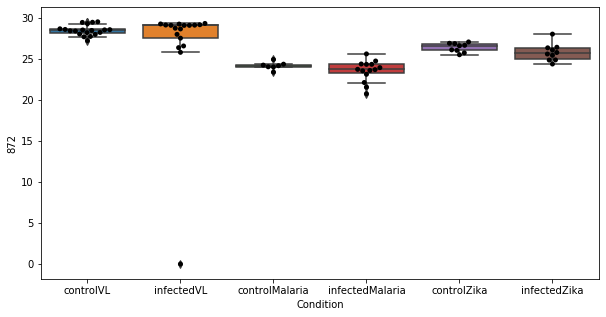

68 row m/z                                                          496.34
row retention time                                              6.67839
p-val                                                          0.149389
adj.P.Val                                                      0.999793
custom_id                                                          2768
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2768, dtype: object


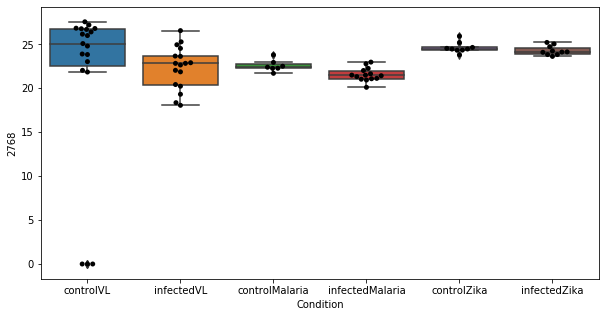

69 row m/z                                                         380.256
row retention time                                               6.7137
p-val                                                          0.150787
adj.P.Val                                                      0.999793
custom_id                                                          2627
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2627, dtype: object


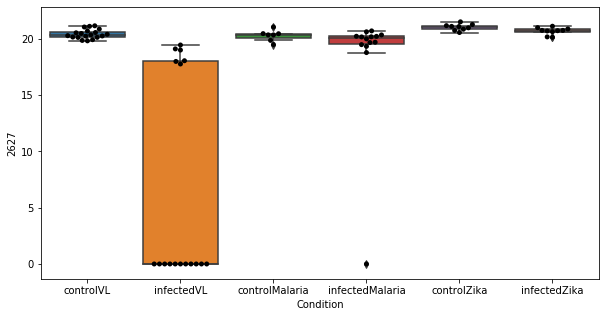

70 row m/z                545.343
row retention time     3.71694
p-val                 0.159861
adj.P.Val             0.999793
custom_id                 2816
compound_names             NaN
Name: 2816, dtype: object


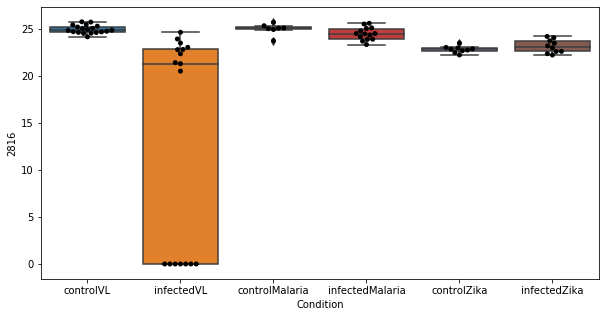

71 row m/z                                157.074
row retention time                     11.7755
p-val                                  0.16204
adj.P.Val                             0.999793
custom_id                                  840
compound_names        3-methylcrotonoylglycine
Name: 840, dtype: object


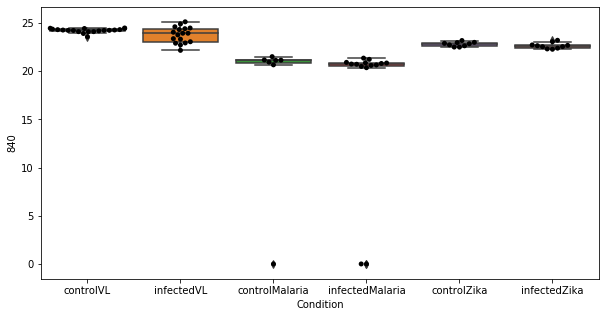

72 row m/z                185.129
row retention time     4.43511
p-val                 0.164857
adj.P.Val             0.999793
custom_id                 1228
compound_names             NaN
Name: 1228, dtype: object


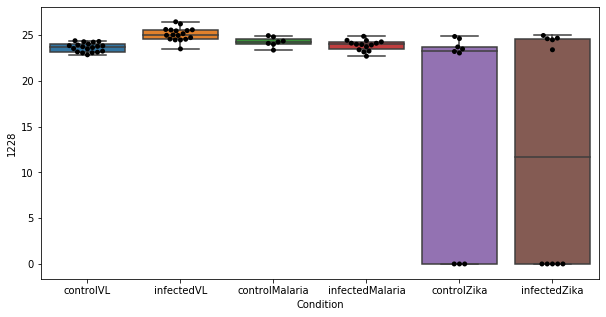

73 row m/z                497.343
row retention time     6.69023
p-val                 0.165314
adj.P.Val             0.999793
custom_id                 2770
compound_names             NaN
Name: 2770, dtype: object


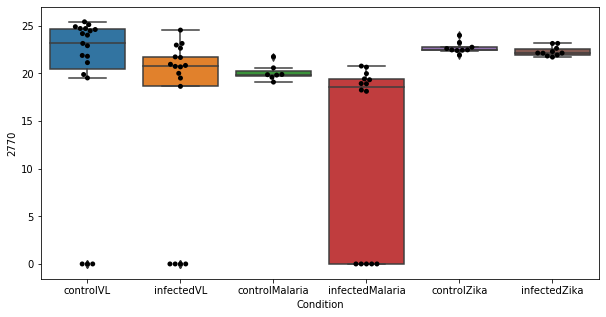

74 row m/z                797.624
row retention time     3.16025
p-val                 0.165793
adj.P.Val             0.999793
custom_id                 3047
compound_names             NaN
Name: 3047, dtype: object


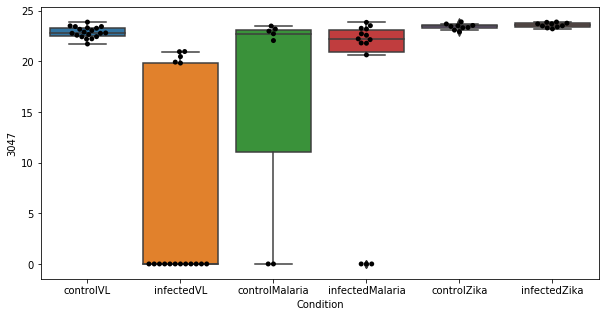

75 row m/z                155.093
row retention time     8.60588
p-val                 0.171762
adj.P.Val             0.999793
custom_id                  805
compound_names             NaN
Name: 805, dtype: object


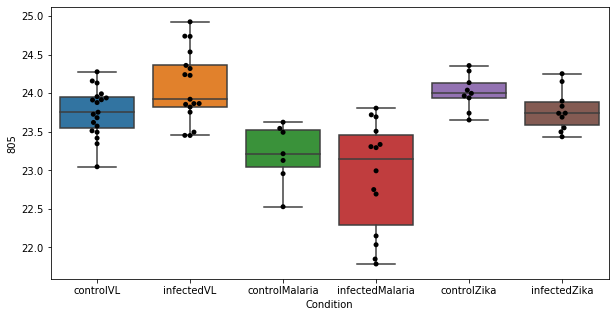

76 row m/z                176.038
row retention time     6.71438
p-val                 0.174743
adj.P.Val             0.999793
custom_id                 1116
compound_names             NaN
Name: 1116, dtype: object


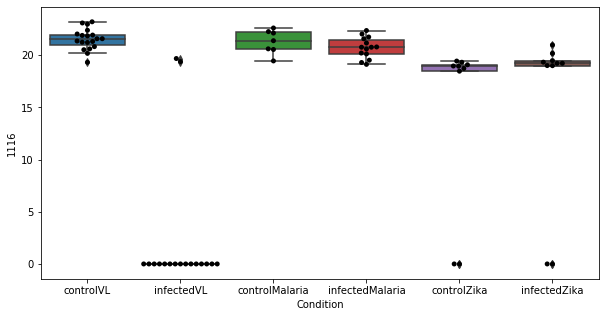

77 row m/z                159.157
row retention time     3.61379
p-val                 0.175496
adj.P.Val             0.999793
custom_id                  891
compound_names             NaN
Name: 891, dtype: object


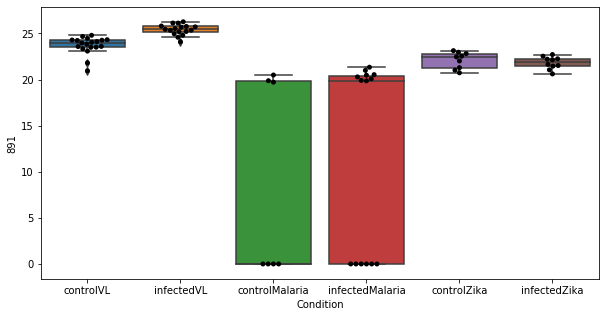

78 row m/z                                                           287.1
row retention time                                              6.72034
p-val                                                           0.17739
adj.P.Val                                                      0.999793
custom_id                                                          2299
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2299, dtype: object


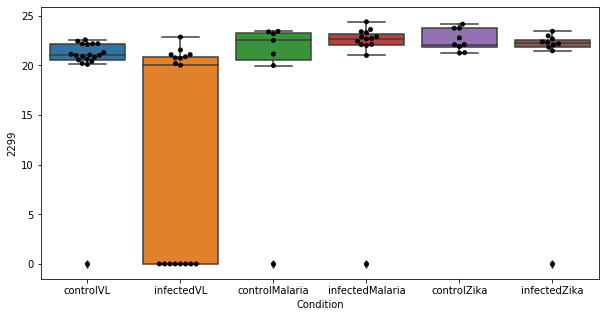

79 row m/z                 544.34
row retention time     3.71301
p-val                 0.180494
adj.P.Val             0.999793
custom_id                 2815
compound_names             NaN
Name: 2815, dtype: object


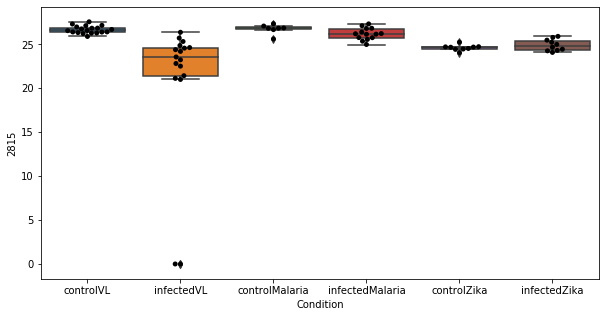

80 row m/z                                                157.097
row retention time                                      6.7351
p-val                                                 0.181982
adj.P.Val                                             0.999793
custom_id                                                  849
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 849, dtype: object


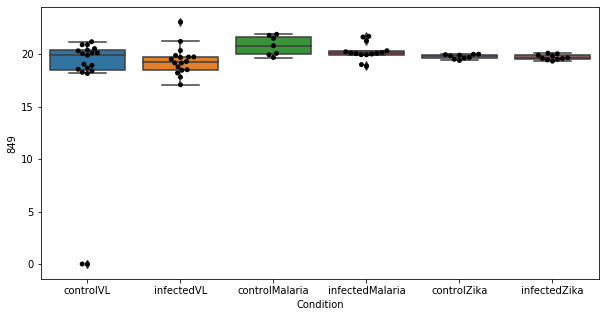

81 row m/z                788.671
row retention time     3.31523
p-val                 0.183613
adj.P.Val             0.999793
custom_id                 3031
compound_names             NaN
Name: 3031, dtype: object


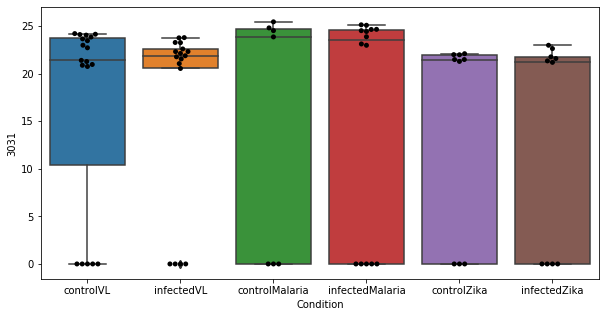

82 row m/z                                 175.002
row retention time                      9.03496
p-val                                  0.188451
adj.P.Val                              0.999793
custom_id                                  1100
compound_names        Hypoxanthine; Purine-6-ol
Name: 1100, dtype: object


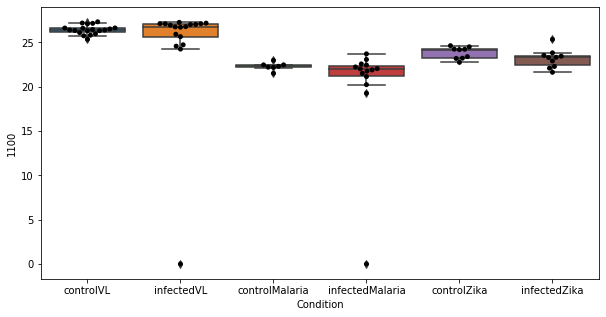

83 row m/z                203.139
row retention time     10.3352
p-val                 0.188712
adj.P.Val             0.999793
custom_id                 1465
compound_names             NaN
Name: 1465, dtype: object


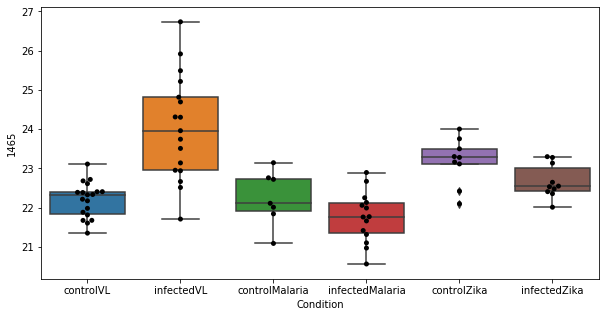

84 row m/z                200.054
row retention time     9.03912
p-val                 0.188829
adj.P.Val             0.999793
custom_id                 1417
compound_names             NaN
Name: 1417, dtype: object


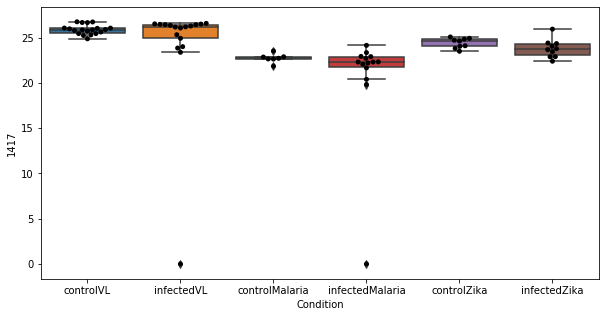

85 row m/z                610.504
row retention time     3.01402
p-val                 0.191067
adj.P.Val             0.999793
custom_id                 2866
compound_names             NaN
Name: 2866, dtype: object


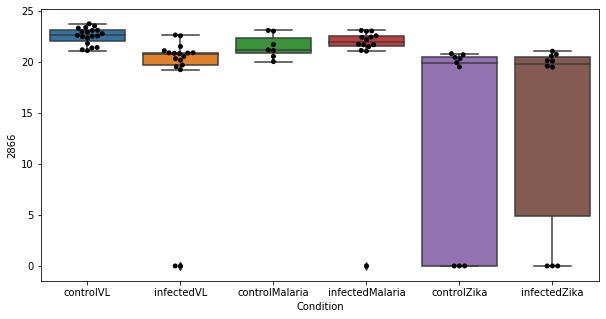

86 row m/z                              188.071
row retention time                    7.6959
p-val                               0.191605
adj.P.Val                           0.999793
custom_id                               1263
compound_names        5-Methoxyindoleacetate
Name: 1263, dtype: object


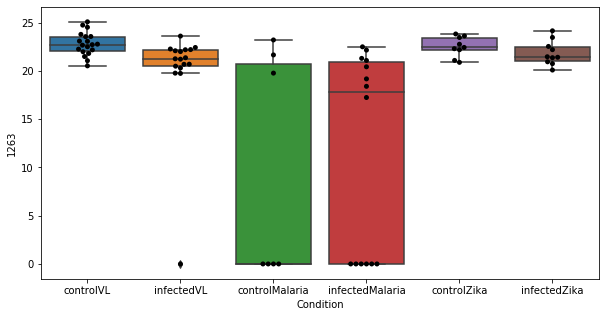

87 row m/z                171.076
row retention time     8.30023
p-val                 0.194064
adj.P.Val             0.999793
custom_id                 1046
compound_names             NaN
Name: 1046, dtype: object


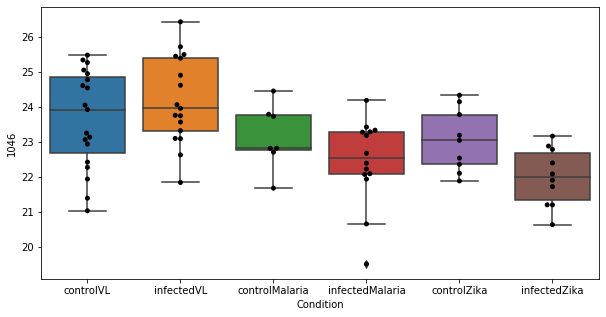

88 row m/z                                        246.124
row retention time                              9.9603
p-val                                         0.194961
adj.P.Val                                     0.999793
custom_id                                         1960
compound_names        gama-carboxyethyl-hydroxychroman
Name: 1960, dtype: object


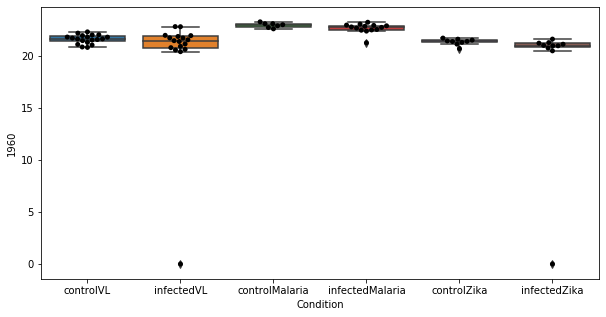

89 row m/z                837.618
row retention time     3.15077
p-val                 0.199822
adj.P.Val             0.999793
custom_id                 3119
compound_names             NaN
Name: 3119, dtype: object


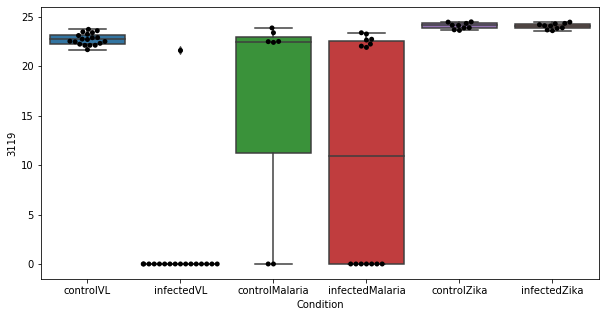

90 row m/z                195.088
row retention time     4.37565
p-val                 0.204854
adj.P.Val             0.999793
custom_id                 1362
compound_names             NaN
Name: 1362, dtype: object


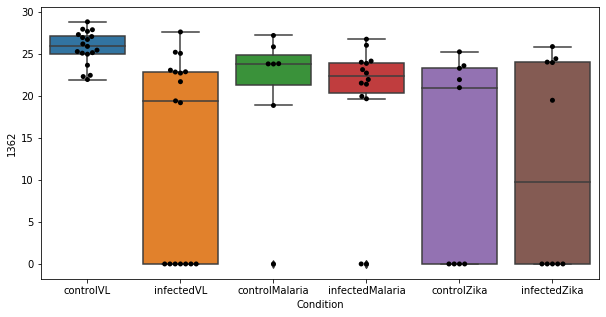

91 row m/z                792.589
row retention time     3.17424
p-val                  0.20734
adj.P.Val             0.999793
custom_id                 3038
compound_names             NaN
Name: 3038, dtype: object


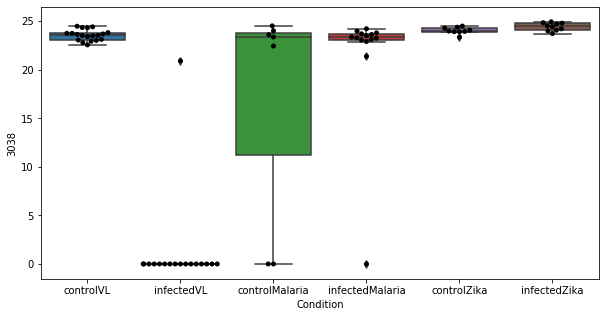

92 row m/z                199.108
row retention time     6.74436
p-val                 0.214626
adj.P.Val             0.999793
custom_id                 4868
compound_names             NaN
Name: 4868, dtype: object


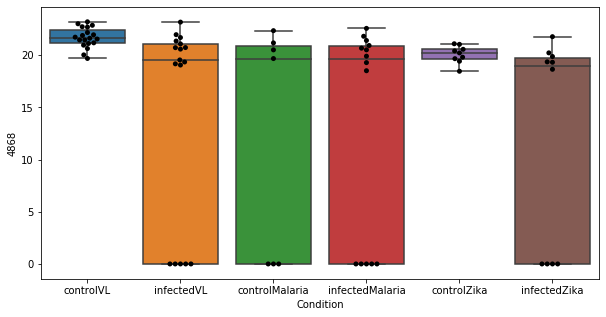

93 row m/z                                                         123.055
row retention time                                              6.71585
p-val                                                          0.214852
adj.P.Val                                                      0.999793
custom_id                                                           343
compound_names        Nicotinamide; Nicotinic acid amide; Niacinamid...
Name: 343, dtype: object


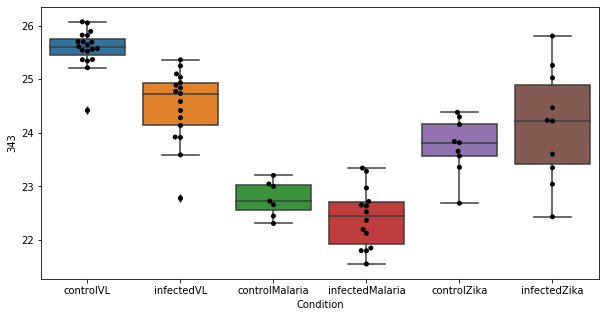

94 row m/z                230.096
row retention time      11.951
p-val                 0.216251
adj.P.Val             0.999793
custom_id                 1799
compound_names             NaN
Name: 1799, dtype: object


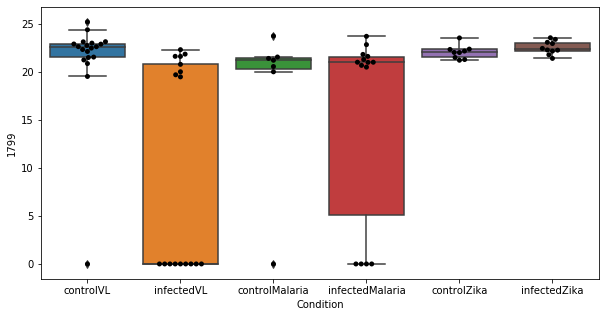

95 row m/z                202.043
row retention time     10.4068
p-val                 0.219339
adj.P.Val             0.999793
custom_id                 1442
compound_names             NaN
Name: 1442, dtype: object


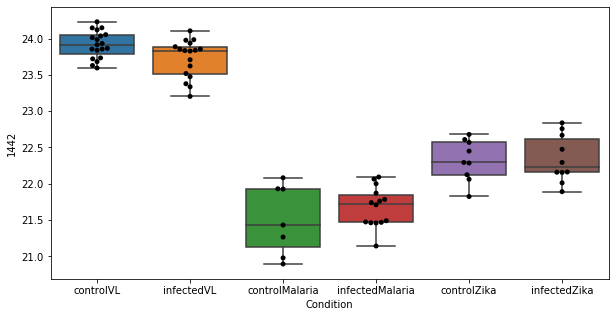

96 row m/z                142.123
row retention time     3.80346
p-val                 0.221752
adj.P.Val             0.999793
custom_id                  589
compound_names             NaN
Name: 589, dtype: object


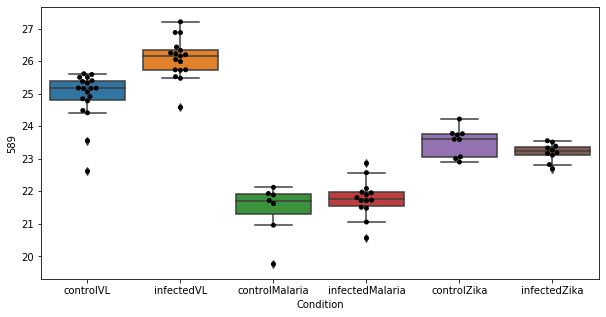

97 row m/z                                                   186.113
row retention time                                        6.71081
p-val                                                    0.224127
adj.P.Val                                                0.999793
custom_id                                                    1233
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1233, dtype: object


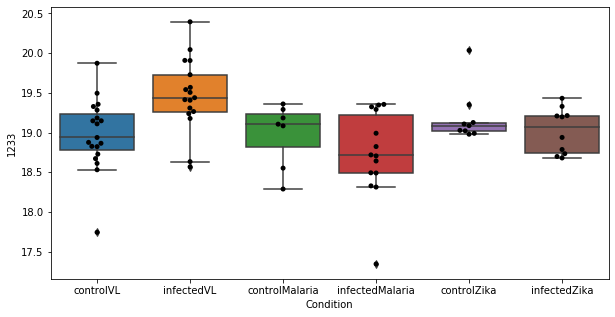

98 row m/z                188.128
row retention time     4.39418
p-val                 0.224502
adj.P.Val             0.999793
custom_id                 1268
compound_names             NaN
Name: 1268, dtype: object


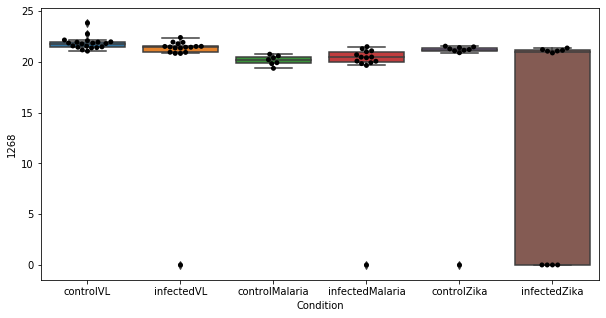

99 row m/z                                                          139.05
row retention time                                              7.04542
p-val                                                          0.225855
adj.P.Val                                                      0.999793
custom_id                                                           558
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 558, dtype: object


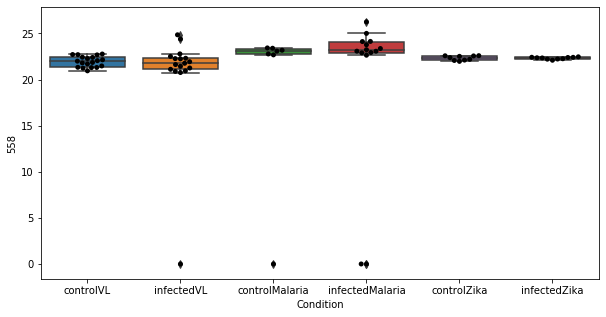

100 row m/z                302.233
row retention time     4.37099
p-val                  0.22726
adj.P.Val             0.999793
custom_id                 2391
compound_names             NaN
Name: 2391, dtype: object


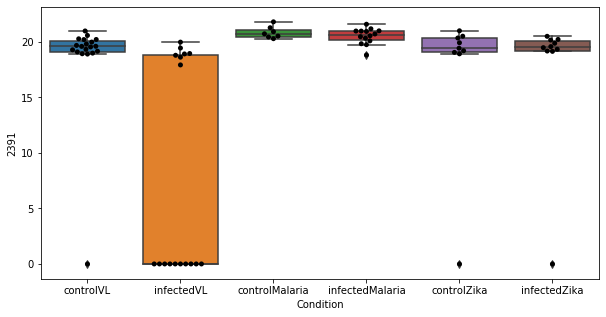

101 row m/z                120.091
row retention time     9.60833
p-val                 0.229433
adj.P.Val             0.999793
custom_id                  310
compound_names             NaN
Name: 310, dtype: object


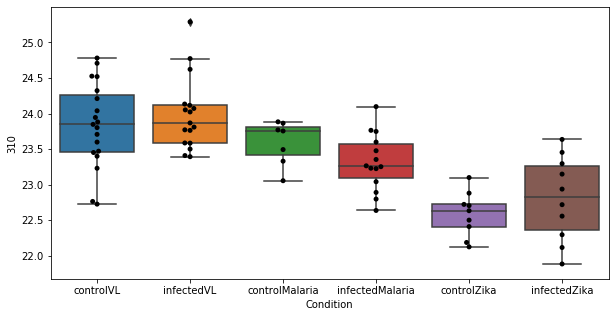

102 row m/z                176.074
row retention time     4.27691
p-val                 0.229485
adj.P.Val             0.999793
custom_id                 1119
compound_names             NaN
Name: 1119, dtype: object


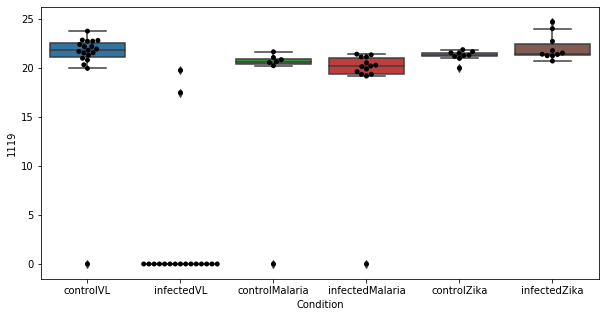

103 row m/z                                                         115.063
row retention time                                               8.6042
p-val                                                          0.229752
adj.P.Val                                                      0.999793
custom_id                                                           240
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 240, dtype: object


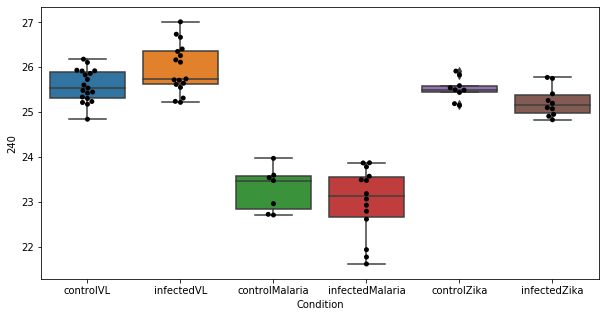

104 row m/z                                 138.049
row retention time                      9.04045
p-val                                  0.232476
adj.P.Val                              0.999793
custom_id                                   548
compound_names        Hypoxanthine; Purine-6-ol
Name: 548, dtype: object


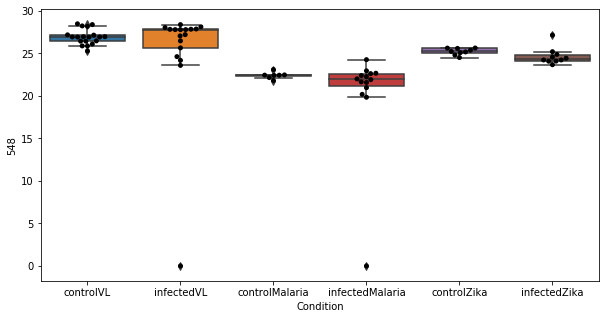

105 row m/z                343.295
row retention time     4.11481
p-val                 0.237352
adj.P.Val             0.999793
custom_id                 4179
compound_names             NaN
Name: 4179, dtype: object


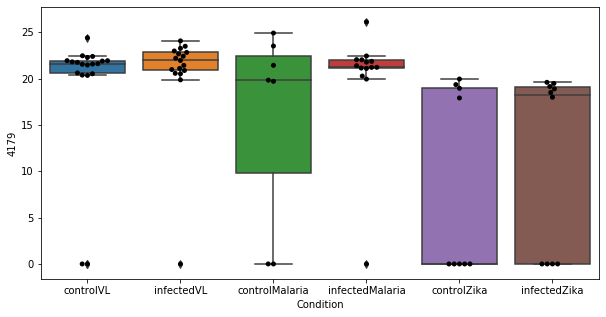

106 row m/z                835.603
row retention time     3.15813
p-val                   0.2395
adj.P.Val             0.999793
custom_id                 3117
compound_names             NaN
Name: 3117, dtype: object


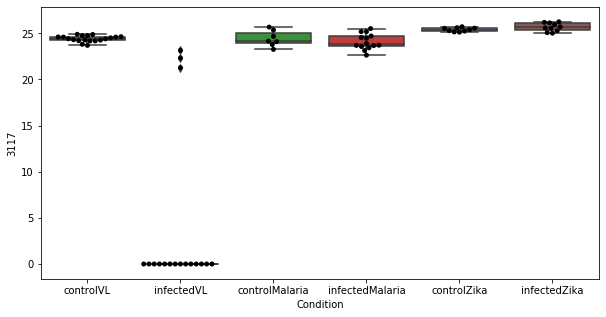

107 row m/z                120.093
row retention time     10.4045
p-val                 0.240337
adj.P.Val             0.999793
custom_id                  312
compound_names             NaN
Name: 312, dtype: object


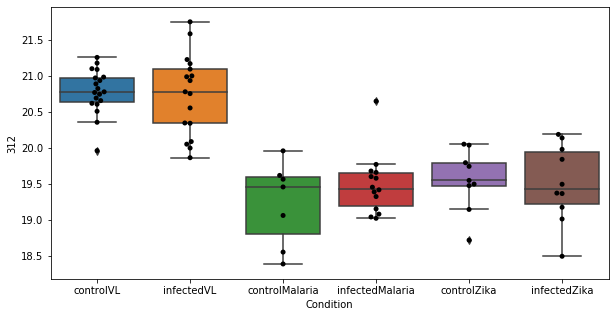

108 row m/z                                                         128.071
row retention time                                              6.71256
p-val                                                           0.24132
adj.P.Val                                                      0.999793
custom_id                                                          5798
compound_names        2,3,4,5-Tetrahydropyridine-2-carboxylate; delt...
Name: 5798, dtype: object


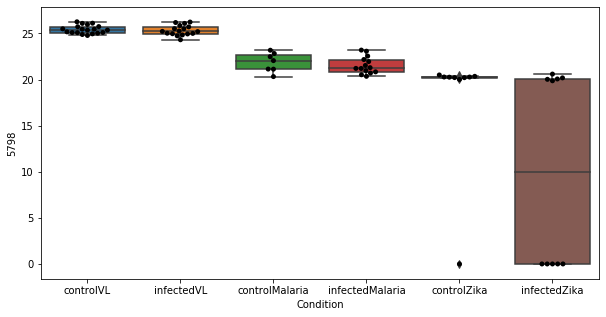

109 row m/z                178.072
row retention time     9.03938
p-val                 0.241591
adj.P.Val             0.999793
custom_id                 1142
compound_names             NaN
Name: 1142, dtype: object


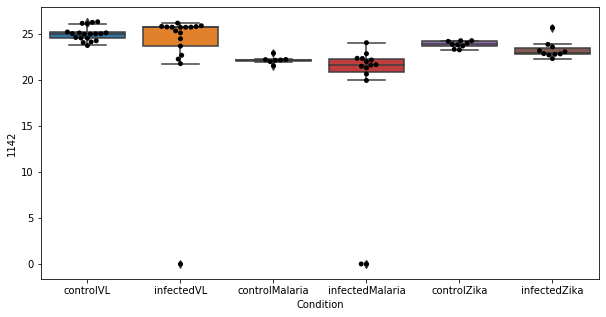

110 row m/z                193.095
row retention time     4.66242
p-val                  0.24185
adj.P.Val             0.999793
custom_id                 1325
compound_names             NaN
Name: 1325, dtype: object


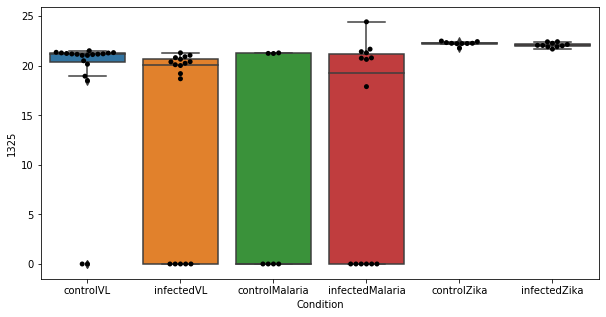

111 row m/z                                                         188.071
row retention time                                              9.95592
p-val                                                          0.242853
adj.P.Val                                                      0.999793
custom_id                                                          1262
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1262, dtype: object


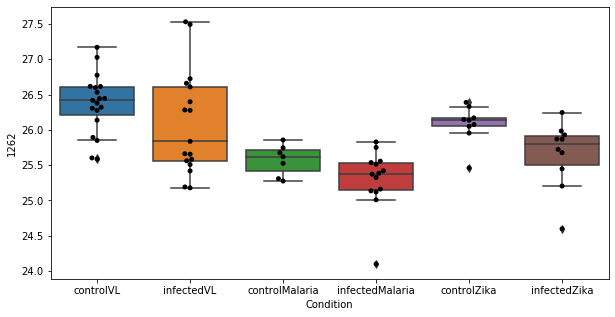

112 row m/z                592.493
row retention time     2.97532
p-val                 0.245424
adj.P.Val             0.999793
custom_id                 2852
compound_names             NaN
Name: 2852, dtype: object


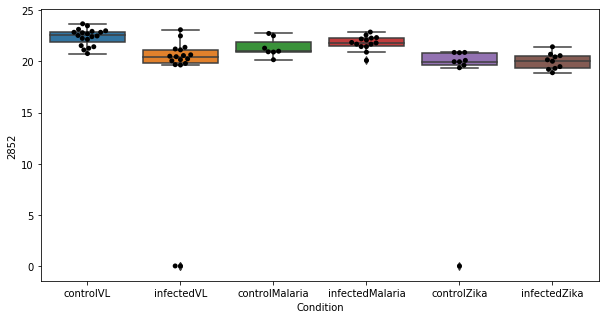

113 row m/z                199.181
row retention time       3.614
p-val                 0.246487
adj.P.Val             0.999793
custom_id                 1413
compound_names             NaN
Name: 1413, dtype: object


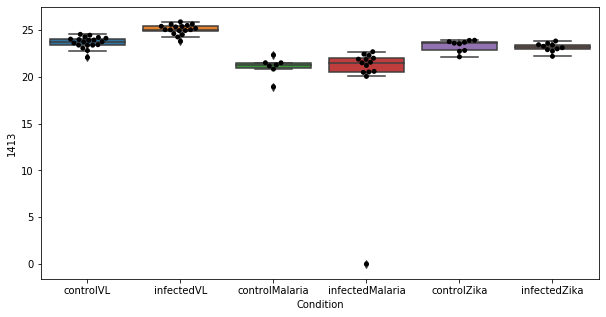

114 row m/z                                                         380.256
row retention time                                              4.24808
p-val                                                          0.250244
adj.P.Val                                                      0.999793
custom_id                                                          2626
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2626, dtype: object


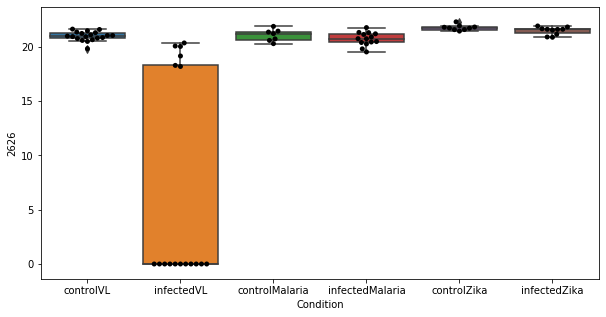

115 row m/z                127.087
row retention time      6.7179
p-val                 0.252363
adj.P.Val             0.999793
custom_id                  378
compound_names             NaN
Name: 378, dtype: object


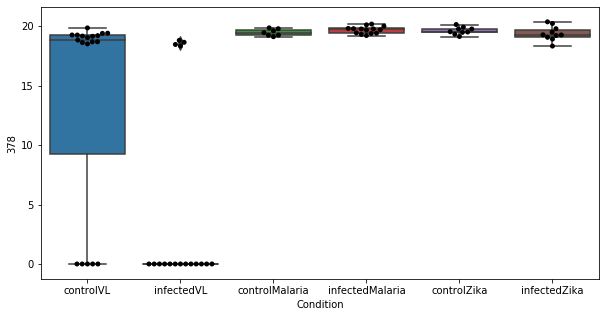

116 row m/z                189.074
row retention time     9.95318
p-val                 0.253875
adj.P.Val             0.999793
custom_id                 1276
compound_names             NaN
Name: 1276, dtype: object


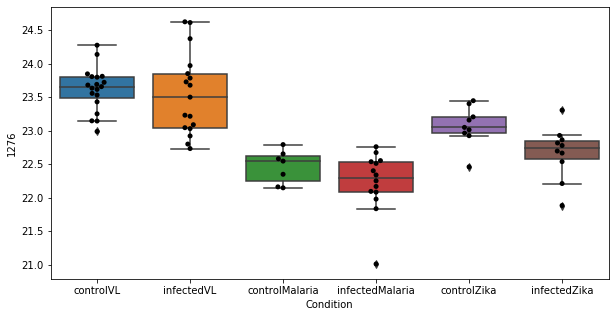

117 row m/z                                                          119.09
row retention time                                              9.60894
p-val                                                           0.25583
adj.P.Val                                                      0.999793
custom_id                                                           299
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 299, dtype: object


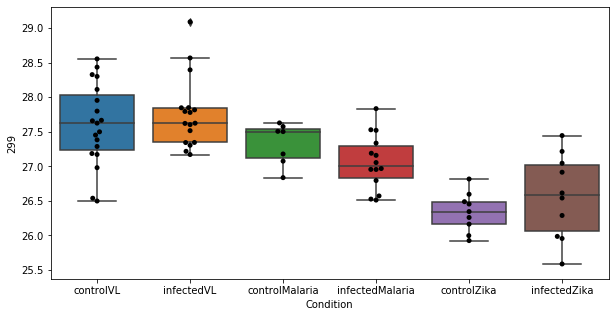

118 row m/z                                                         118.086
row retention time                                              9.60743
p-val                                                          0.258277
adj.P.Val                                                      0.999793
custom_id                                                           281
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 281, dtype: object


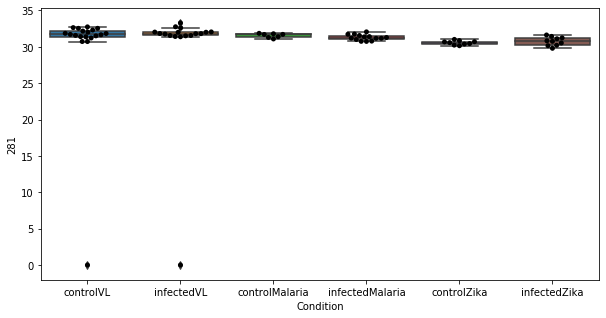

119 row m/z                120.093
row retention time       9.608
p-val                 0.259298
adj.P.Val             0.999793
custom_id                  313
compound_names             NaN
Name: 313, dtype: object


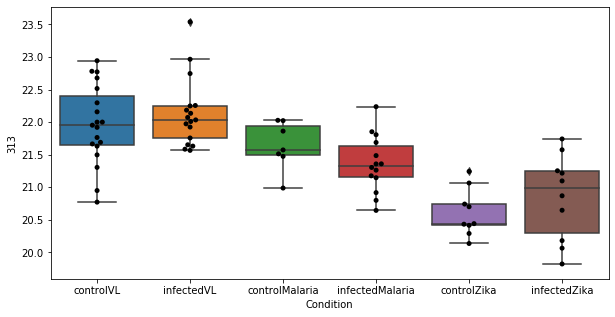

120 row m/z                664.457
row retention time     3.07828
p-val                 0.265202
adj.P.Val             0.999793
custom_id                 2898
compound_names             NaN
Name: 2898, dtype: object


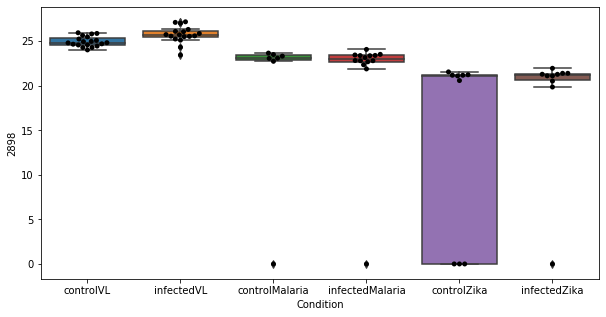

121 row m/z                 115.07
row retention time     8.60199
p-val                 0.265306
adj.P.Val             0.999793
custom_id                  241
compound_names             NaN
Name: 241, dtype: object


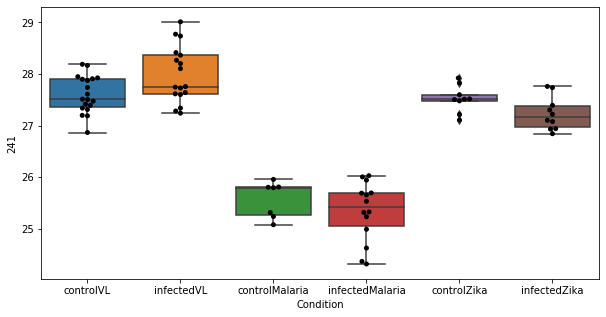

122 row m/z                134.081
row retention time      7.2337
p-val                 0.269499
adj.P.Val             0.999793
custom_id                  497
compound_names             NaN
Name: 497, dtype: object


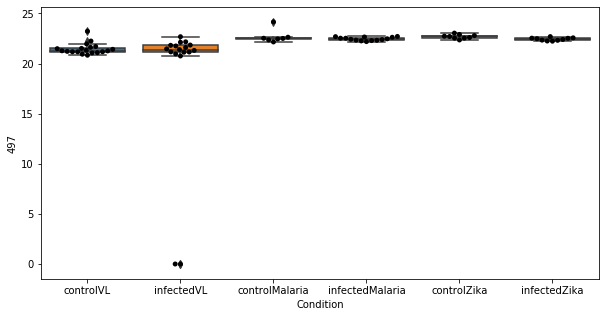

123 row m/z                                                         114.055
row retention time                                              6.71171
p-val                                                           0.26986
adj.P.Val                                                      0.999793
custom_id                                                          3282
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 3282, dtype: object


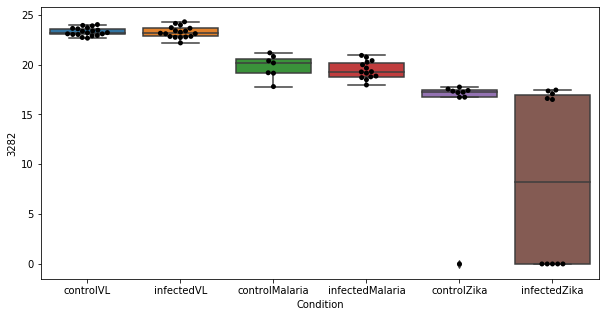

124 row m/z                 813.62
row retention time     3.16569
p-val                 0.271199
adj.P.Val             0.999793
custom_id                 3082
compound_names             NaN
Name: 3082, dtype: object


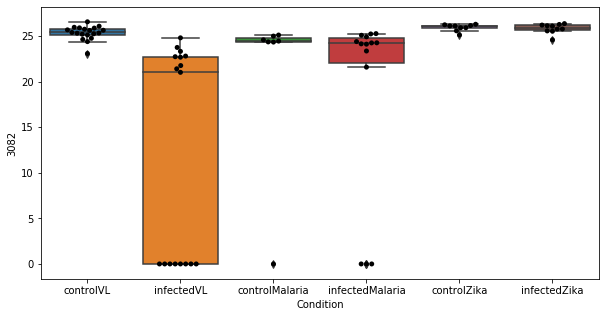

125 row m/z                214.091
row retention time     4.61405
p-val                 0.271958
adj.P.Val             0.999793
custom_id                 1596
compound_names             NaN
Name: 1596, dtype: object


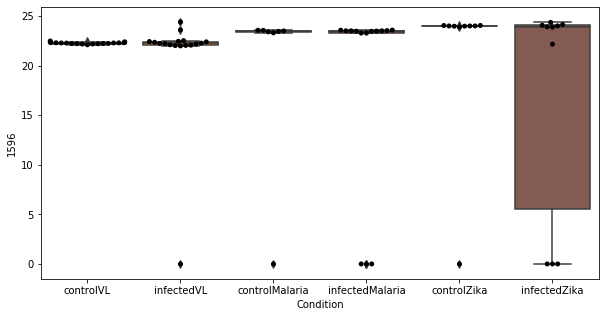

126 row m/z                746.604
row retention time     3.19127
p-val                 0.279516
adj.P.Val             0.999793
custom_id                 2959
compound_names             NaN
Name: 2959, dtype: object


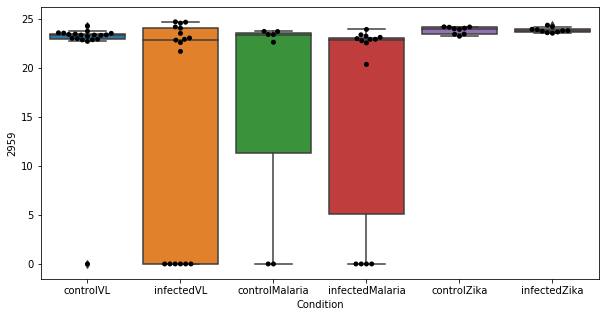

127 row m/z                 880.59
row retention time     3.00121
p-val                 0.282401
adj.P.Val             0.999793
custom_id                 3176
compound_names             NaN
Name: 3176, dtype: object


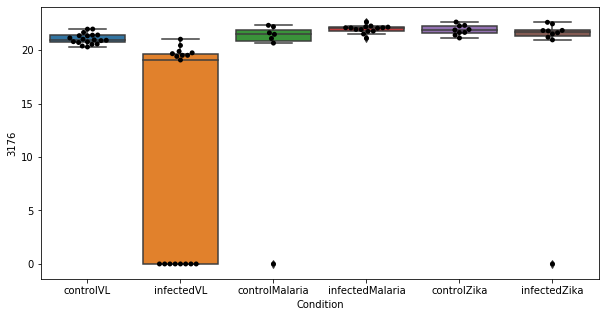

128 row m/z                                                         265.118
row retention time                                              4.43639
p-val                                                          0.283403
adj.P.Val                                                      0.999793
custom_id                                                          2141
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2141, dtype: object


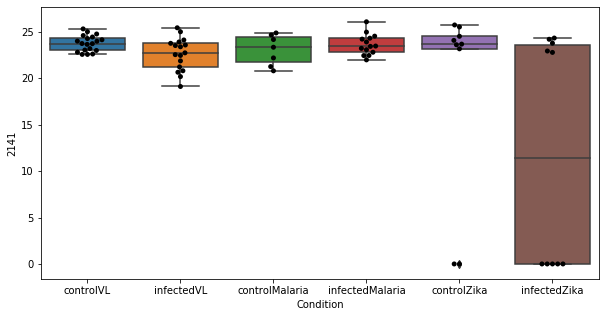

129 row m/z                           310.201
row retention time                 4.3724
p-val                            0.287009
adj.P.Val                        0.999793
custom_id                            2434
compound_names        L-Octanoylcarnitine
Name: 2434, dtype: object


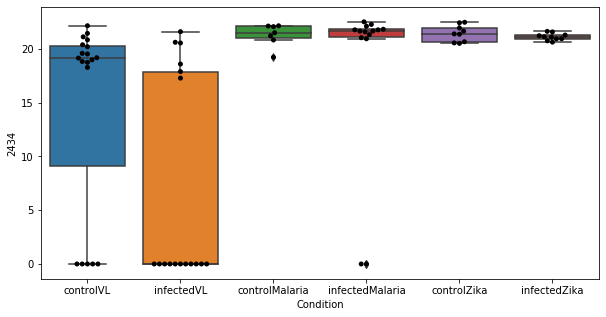

130 row m/z                                                237.052
row retention time                                     10.4106
p-val                                                 0.287772
adj.P.Val                                             0.999793
custom_id                                                 1883
compound_names        5-L-Glutamyl-taurine; 5-Glutamyl-taurine
Name: 1883, dtype: object


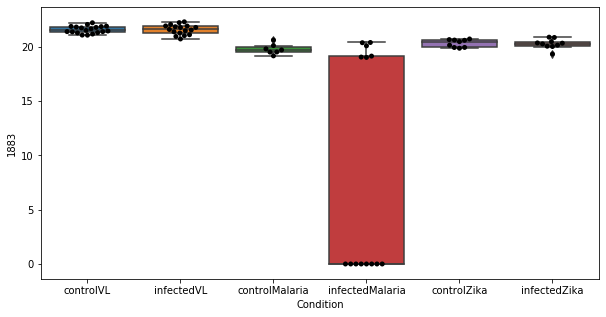

131 row m/z                730.593
row retention time     3.38229
p-val                  0.29046
adj.P.Val             0.999793
custom_id                 2934
compound_names             NaN
Name: 2934, dtype: object


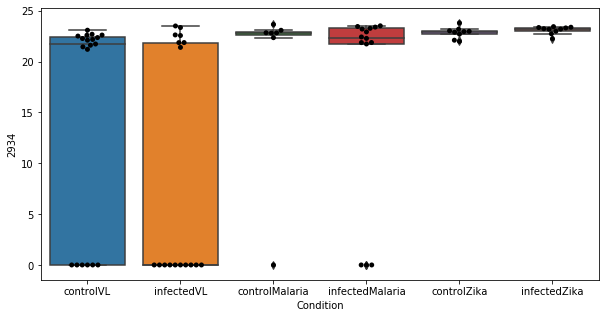

132 row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                          0.290978
adj.P.Val                                                      0.999793
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object


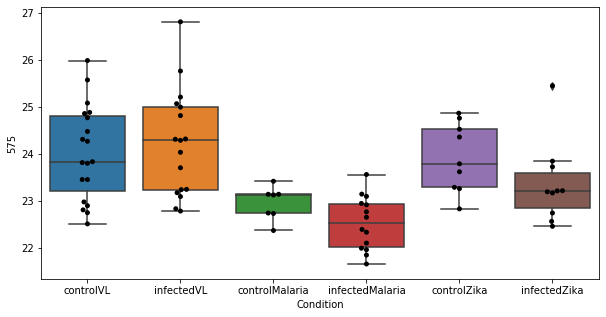

133 row m/z                                                          131.09
row retention time                                              10.3137
p-val                                                          0.291364
adj.P.Val                                                      0.999793
custom_id                                                           445
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 445, dtype: object


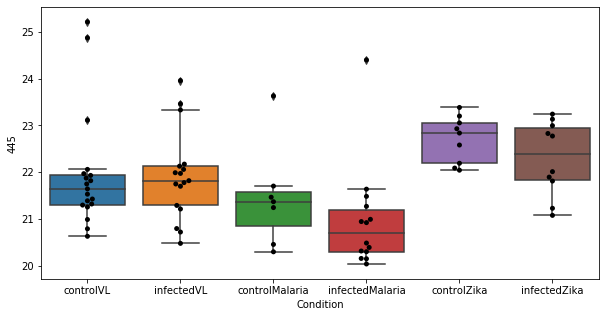

134 row m/z                681.483
row retention time     3.07408
p-val                 0.291501
adj.P.Val             0.999793
custom_id                 2908
compound_names             NaN
Name: 2908, dtype: object


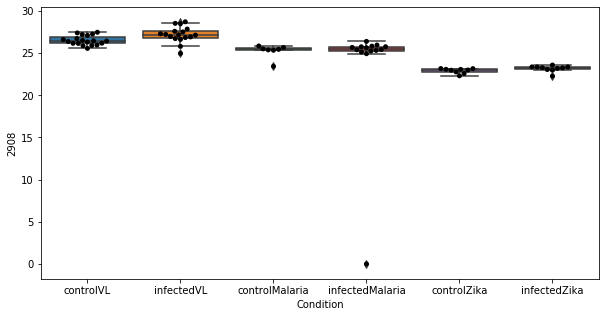

135 row m/z                                                         205.097
row retention time                                              9.95605
p-val                                                          0.292974
adj.P.Val                                                      0.999793
custom_id                                                          1502
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1502, dtype: object


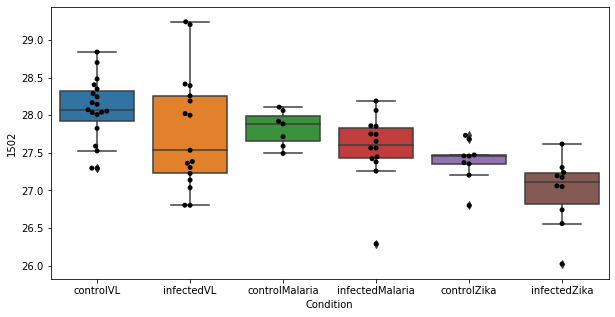

136 row m/z                 146.06
row retention time     9.95492
p-val                  0.29781
adj.P.Val             0.999793
custom_id                  664
compound_names             NaN
Name: 664, dtype: object


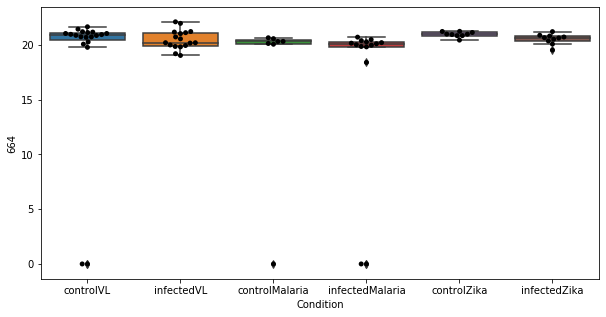

137 row m/z                                                         114.066
row retention time                                              8.59995
p-val                                                          0.301071
adj.P.Val                                                      0.999793
custom_id                                                           229
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 229, dtype: object


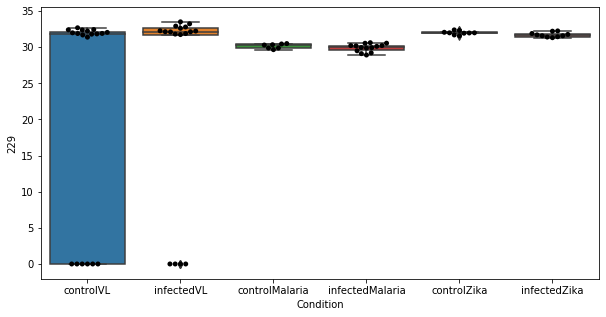

138 row m/z                247.092
row retention time     9.23847
p-val                 0.303336
adj.P.Val             0.999793
custom_id                 5039
compound_names             NaN
Name: 5039, dtype: object


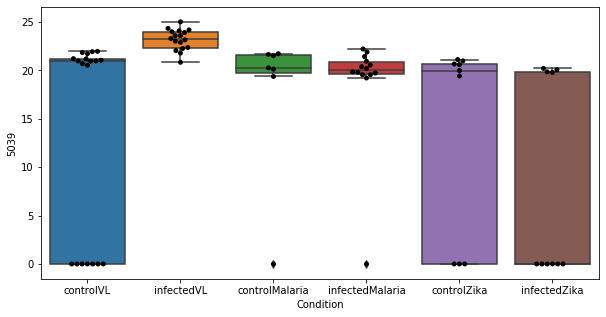

139 row m/z                161.092
row retention time     6.73059
p-val                 0.308222
adj.P.Val             0.999793
custom_id                  912
compound_names             NaN
Name: 912, dtype: object


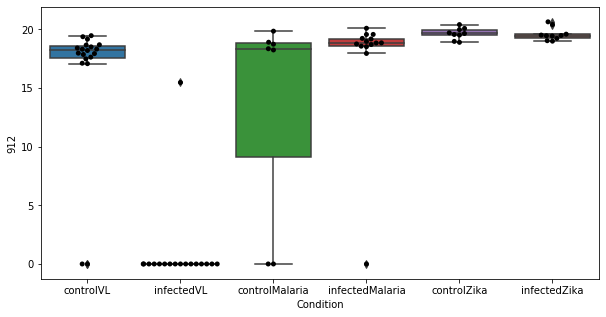

140 row m/z                                             190.05
row retention time                                 6.71104
p-val                                             0.311906
adj.P.Val                                         0.999793
custom_id                                             1289
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1289, dtype: object


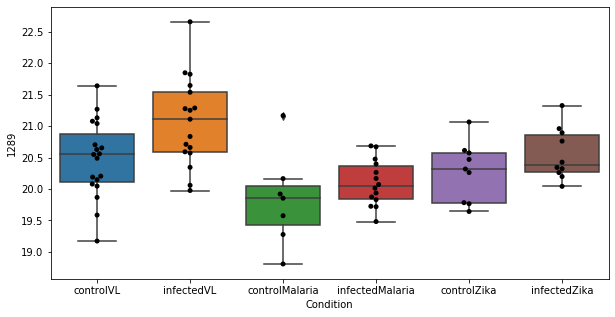

141 row m/z                                                         206.101
row retention time                                              9.95655
p-val                                                          0.313818
adj.P.Val                                                      0.999793
custom_id                                                          1506
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1506, dtype: object


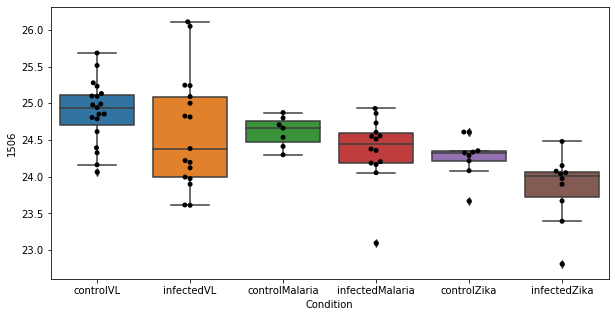

142 row m/z                334.295
row retention time     3.00561
p-val                 0.314533
adj.P.Val             0.999793
custom_id                 2517
compound_names             NaN
Name: 2517, dtype: object


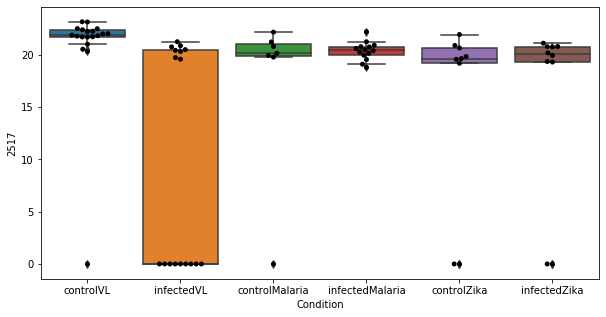

143 row m/z                                                         146.081
row retention time                                              8.32931
p-val                                                          0.317061
adj.P.Val                                                      0.999793
custom_id                                                           666
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 666, dtype: object


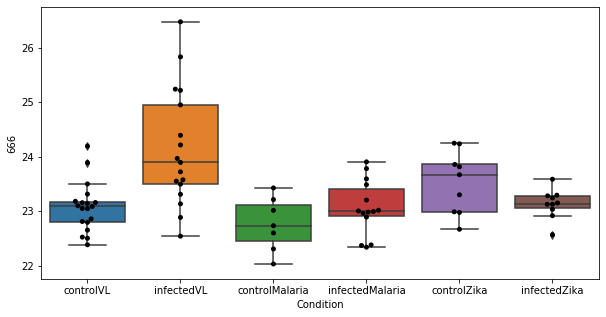

144 row m/z                                                         265.118
row retention time                                              6.71132
p-val                                                          0.318935
adj.P.Val                                                      0.999793
custom_id                                                          2140
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2140, dtype: object


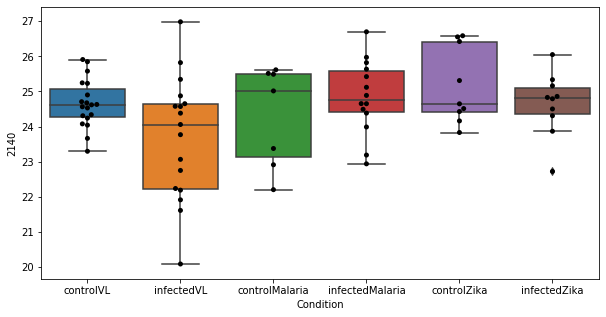

145 row m/z                155.107
row retention time     4.19565
p-val                 0.322003
adj.P.Val             0.999793
custom_id                  806
compound_names             NaN
Name: 806, dtype: object


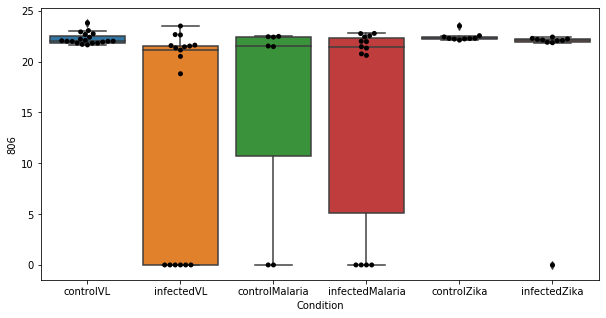

146 row m/z                                                424.342
row retention time                                     3.70254
p-val                                                 0.322718
adj.P.Val                                             0.999793
custom_id                                                 2693
compound_names        Linoleyl carnitine$Linoelaidyl carnitine
Name: 2693, dtype: object


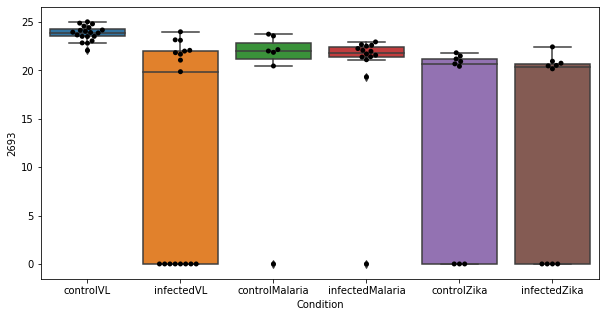

147 row m/z                139.018
row retention time     4.77225
p-val                  0.32391
adj.P.Val             0.999793
custom_id                 3389
compound_names             NaN
Name: 3389, dtype: object


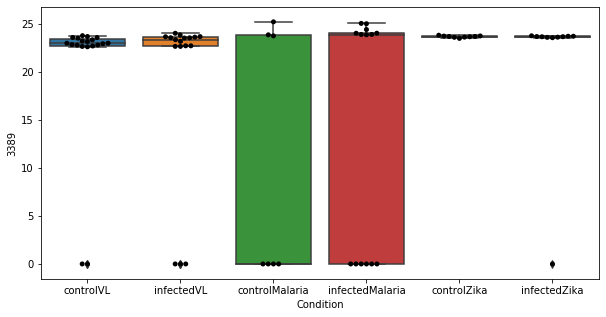

148 row m/z                119.083
row retention time     9.60849
p-val                 0.326919
adj.P.Val             0.999793
custom_id                  296
compound_names             NaN
Name: 296, dtype: object


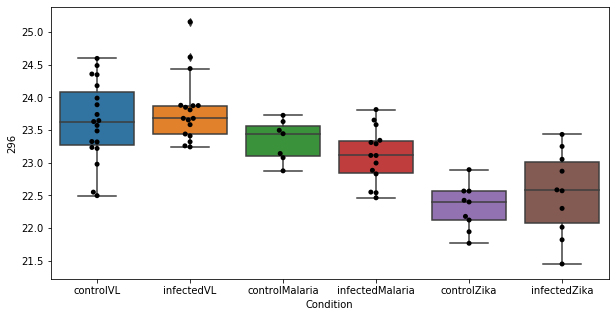

149 row m/z                                                          139.05
row retention time                                              9.67439
p-val                                                          0.327927
adj.P.Val                                                      0.999793
custom_id                                                           557
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 557, dtype: object


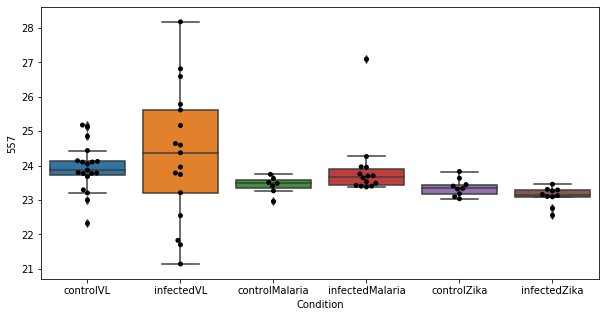

150 row m/z                                                         156.077
row retention time                                              11.7754
p-val                                                          0.332373
adj.P.Val                                                      0.999793
custom_id                                                           821
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 821, dtype: object


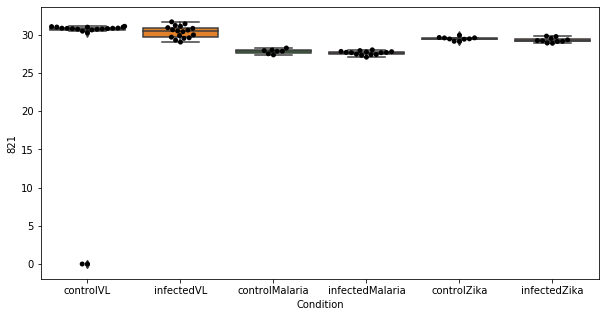

151 row m/z                                                          130.05
row retention time                                              6.71171
p-val                                                          0.333546
adj.P.Val                                                      0.999793
custom_id                                                           412
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 412, dtype: object


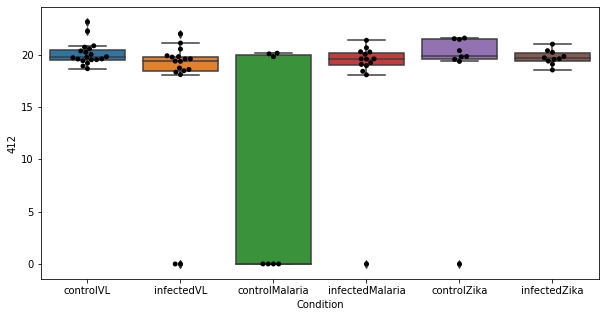

152 row m/z                239.164
row retention time     3.51225
p-val                 0.335704
adj.P.Val             0.999793
custom_id                 3915
compound_names             NaN
Name: 3915, dtype: object


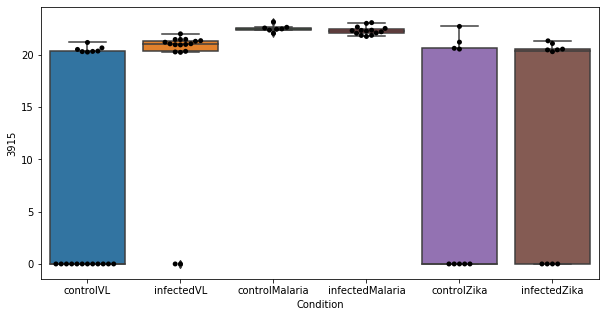

153 row m/z                                                           74.06
row retention time                                              11.6091
p-val                                                          0.340188
adj.P.Val                                                      0.999793
custom_id                                                            10
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 10, dtype: object


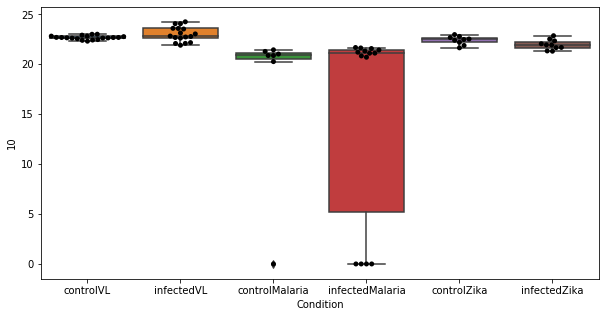

154 row m/z                280.235
row retention time     3.07719
p-val                 0.347068
adj.P.Val             0.999793
custom_id                 2250
compound_names             NaN
Name: 2250, dtype: object


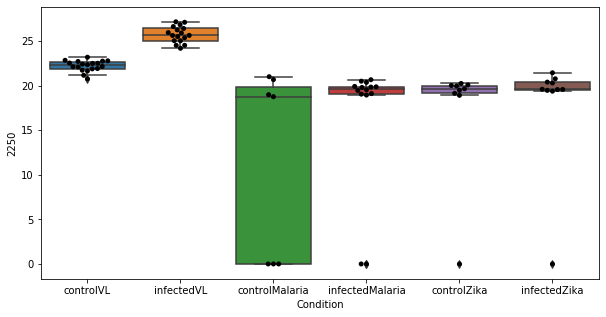

155 row m/z                 168.066
row retention time      6.71562
p-val                  0.348719
adj.P.Val              0.999793
custom_id                  3547
compound_names        Pyridoxal
Name: 3547, dtype: object


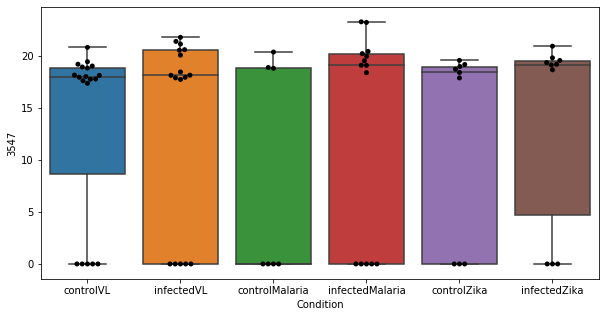

156 row m/z                                                         154.05
row retention time                                              6.7173
p-val                                                         0.354017
adj.P.Val                                                     0.999793
custom_id                                                          791
compound_names        3-Hydroxyanthranilate; 3-Hydroxyanthranilic acid
Name: 791, dtype: object


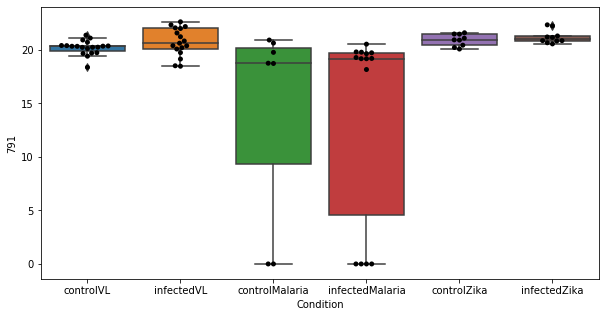

157 row m/z                772.584
row retention time     3.20902
p-val                 0.354484
adj.P.Val             0.999793
custom_id                 2995
compound_names             NaN
Name: 2995, dtype: object


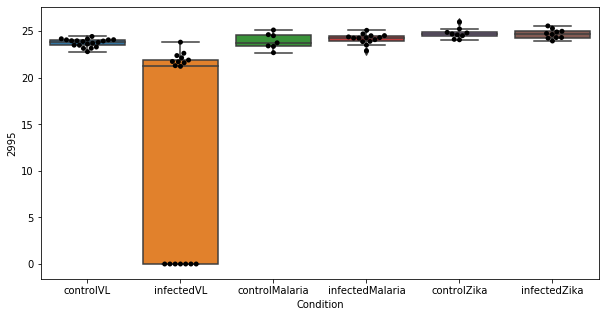

158 row m/z                454.293
row retention time     3.81597
p-val                 0.356678
adj.P.Val             0.999793
custom_id                 2723
compound_names             NaN
Name: 2723, dtype: object


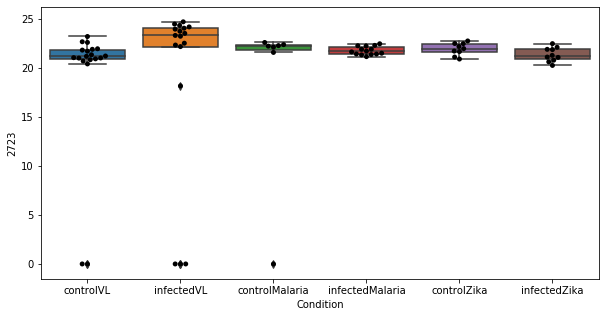

159 row m/z                229.155
row retention time     8.61265
p-val                  0.36144
adj.P.Val             0.999793
custom_id                 1790
compound_names             NaN
Name: 1790, dtype: object


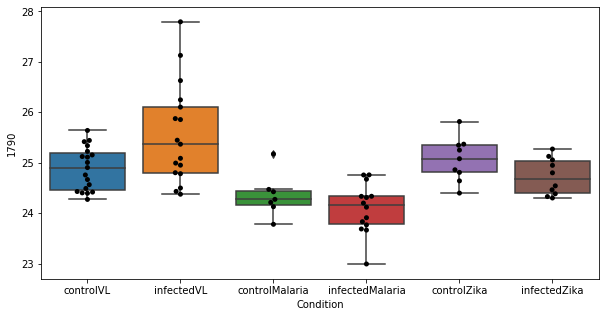

160 row m/z                      170.118
row retention time            4.3833
p-val                       0.364156
adj.P.Val                   0.999793
custom_id                       1033
compound_names        L-Metanephrine
Name: 1033, dtype: object


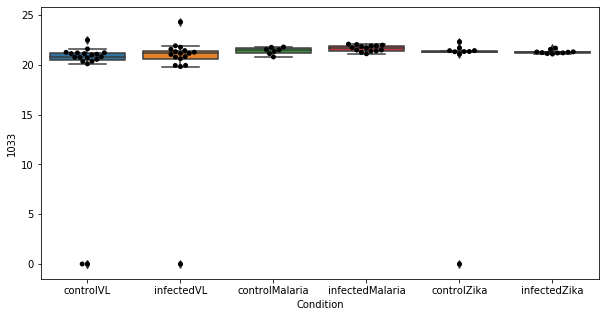

161 row m/z                158.081
row retention time      9.0109
p-val                  0.36606
adj.P.Val             0.999793
custom_id                  856
compound_names             NaN
Name: 856, dtype: object


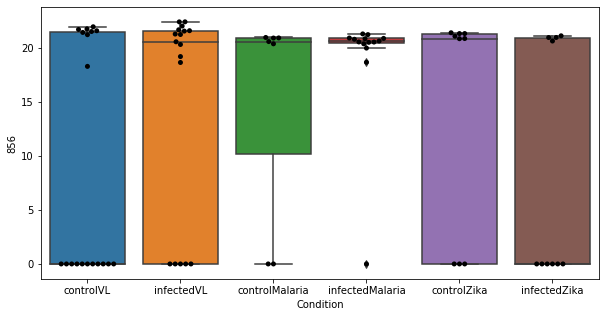

162 row m/z                232.118
row retention time     4.37089
p-val                 0.367944
adj.P.Val             0.999793
custom_id                 1822
compound_names             NaN
Name: 1822, dtype: object


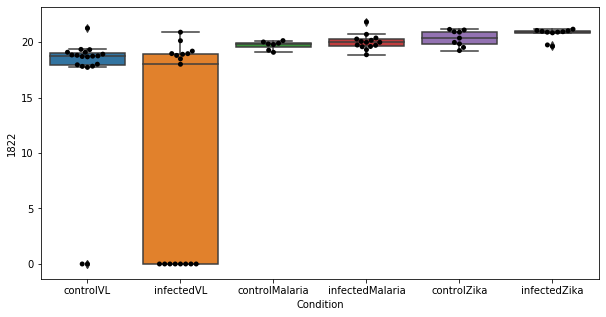

163 row m/z                             160.097
row retention time                  10.2328
p-val                              0.378932
adj.P.Val                          0.999793
custom_id                               898
compound_names        5-Acetamidopentanoate
Name: 898, dtype: object


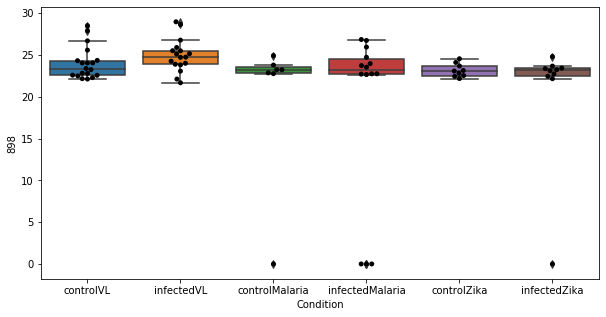

164 row m/z                143.082
row retention time     10.3312
p-val                 0.380166
adj.P.Val             0.999793
custom_id                  602
compound_names             NaN
Name: 602, dtype: object


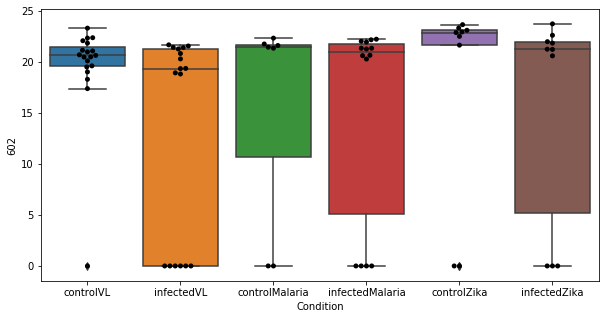

165 row m/z                                                         130.086
row retention time                                              10.3159
p-val                                                          0.380751
adj.P.Val                                                      0.999793
custom_id                                                           422
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 422, dtype: object


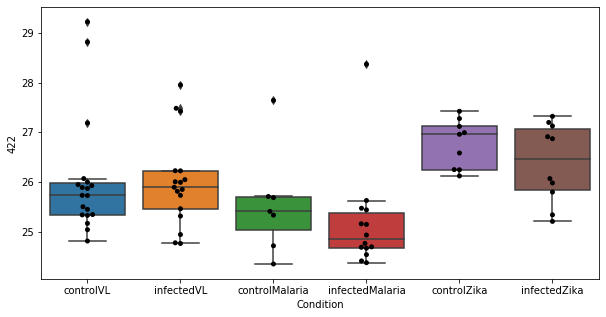

166 row m/z                239.139
row retention time     4.38046
p-val                 0.383329
adj.P.Val             0.999793
custom_id                 1898
compound_names             NaN
Name: 1898, dtype: object


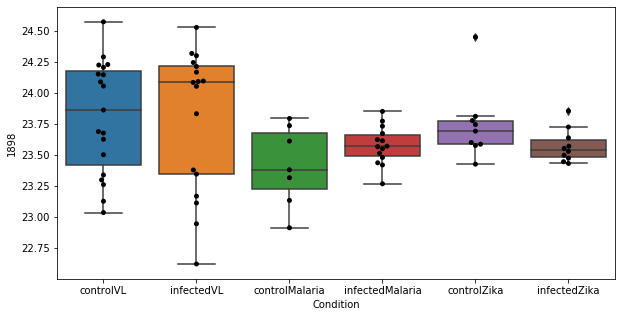

167 row m/z                            110.071
row retention time                 11.7798
p-val                             0.385312
adj.P.Val                         0.999793
custom_id                              194
compound_names        4-Guanidinobutanoate
Name: 194, dtype: object


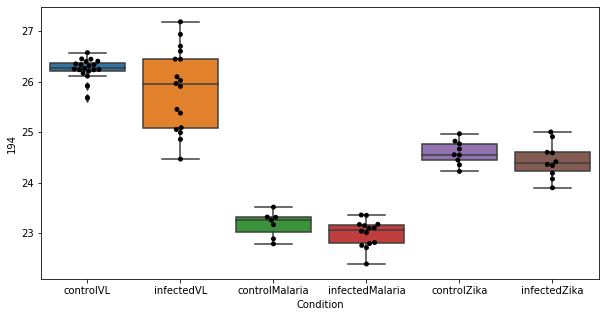

168 row m/z                                                         133.061
row retention time                                              10.3339
p-val                                                          0.385516
adj.P.Val                                                      0.999793
custom_id                                                           473
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 473, dtype: object


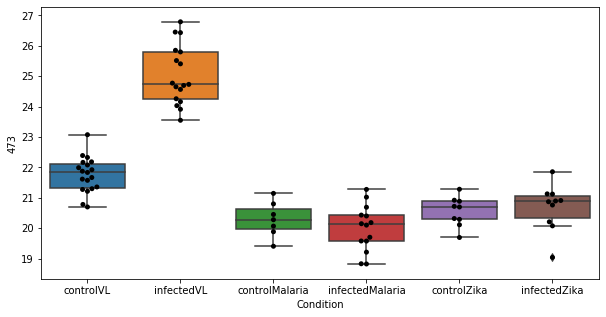

169 row m/z                216.058
row retention time     9.31753
p-val                 0.389546
adj.P.Val             0.999793
custom_id                 1626
compound_names             NaN
Name: 1626, dtype: object


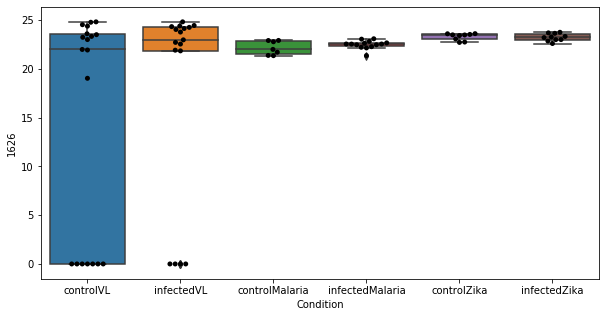

170 row m/z                161.092
row retention time     11.6037
p-val                 0.389778
adj.P.Val             0.999793
custom_id                  911
compound_names             NaN
Name: 911, dtype: object


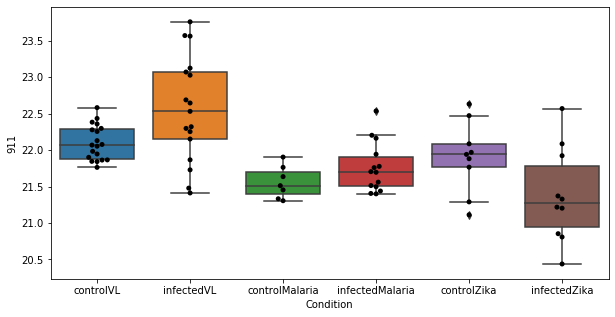

171 row m/z                153.091
row retention time       4.363
p-val                 0.392463
adj.P.Val             0.999793
custom_id                  787
compound_names             NaN
Name: 787, dtype: object


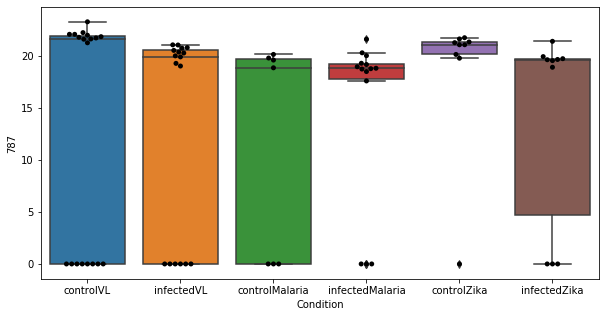

172 row m/z                 163.11
row retention time     10.7406
p-val                 0.394763
adj.P.Val             0.999793
custom_id                  931
compound_names             NaN
Name: 931, dtype: object


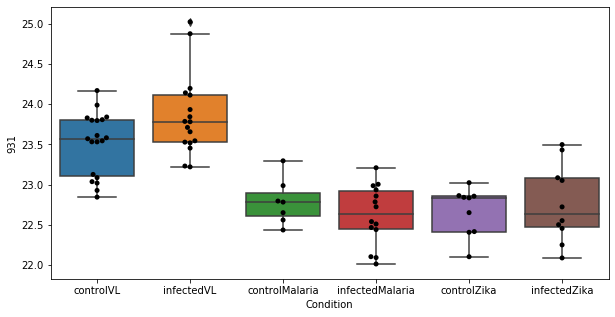

173 row m/z                204.951
row retention time     9.66439
p-val                 0.395499
adj.P.Val             0.999793
custom_id                 1495
compound_names             NaN
Name: 1495, dtype: object


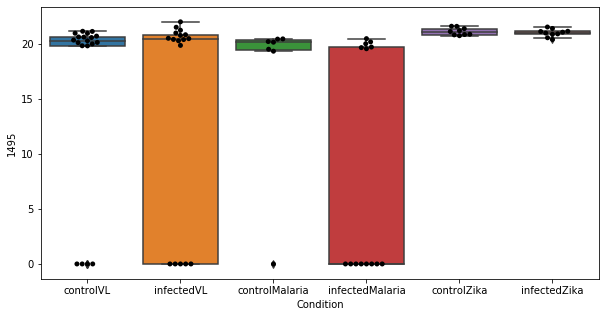

174 row m/z                                       328.248
row retention time                             4.3144
p-val                                        0.397911
adj.P.Val                                    0.999793
custom_id                                        2503
compound_names        2,6 dimethylheptanoyl carnitine
Name: 2503, dtype: object


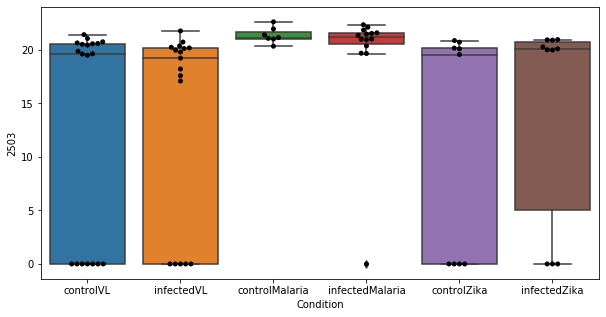

175 row m/z                814.626
row retention time      3.1529
p-val                 0.399115
adj.P.Val             0.999793
custom_id                 3086
compound_names             NaN
Name: 3086, dtype: object


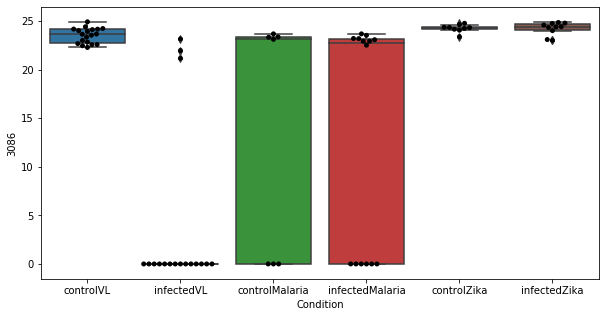

176 row m/z                789.618
row retention time     3.18516
p-val                 0.400087
adj.P.Val             0.999793
custom_id                 3033
compound_names             NaN
Name: 3033, dtype: object


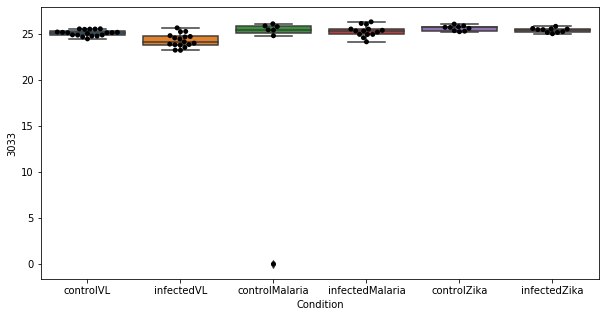

177 row m/z                202.144
row retention time     4.38168
p-val                 0.402387
adj.P.Val             0.999793
custom_id                 1449
compound_names             NaN
Name: 1449, dtype: object


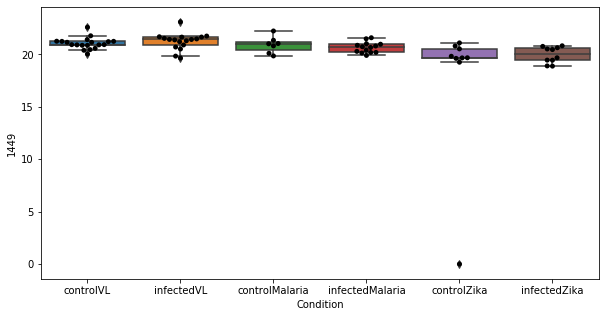

178 row m/z                613.523
row retention time     2.99142
p-val                 0.415355
adj.P.Val             0.999793
custom_id                 2871
compound_names             NaN
Name: 2871, dtype: object


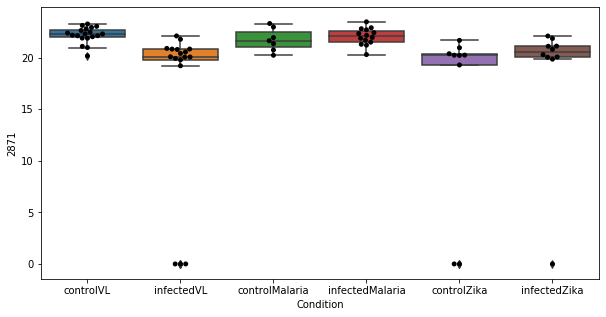

179 row m/z                223.097
row retention time     3.49122
p-val                 0.415367
adj.P.Val             0.999793
custom_id                 1715
compound_names             NaN
Name: 1715, dtype: object


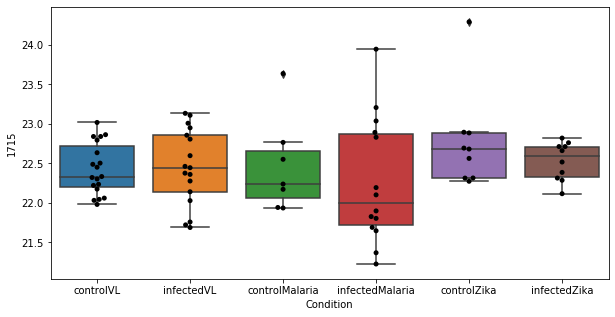

180 row m/z                                                         160.097
row retention time                                              6.71847
p-val                                                          0.417387
adj.P.Val                                                      0.999793
custom_id                                                           899
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 899, dtype: object


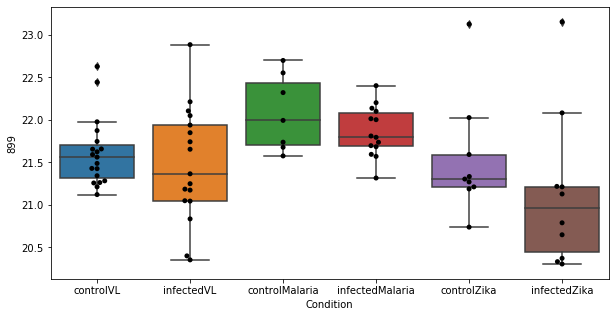

181 row m/z                                                         188.092
row retention time                                              4.43717
p-val                                                           0.41755
adj.P.Val                                                      0.999793
custom_id                                                          1265
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1265, dtype: object


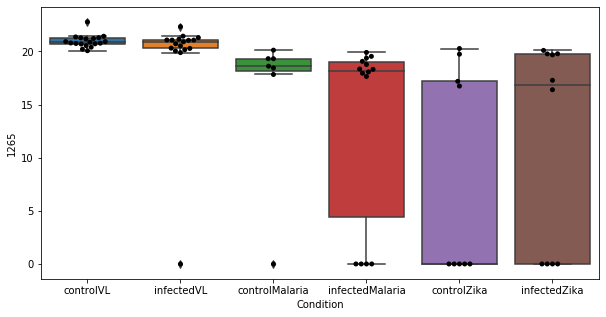

182 row m/z                                                        89.0597
row retention time                                             3.80364
p-val                                                         0.422065
adj.P.Val                                                     0.999793
custom_id                                                           75
compound_names        Butanoic acid; Butanoate; Butyrate; Butyric acid
Name: 75, dtype: object


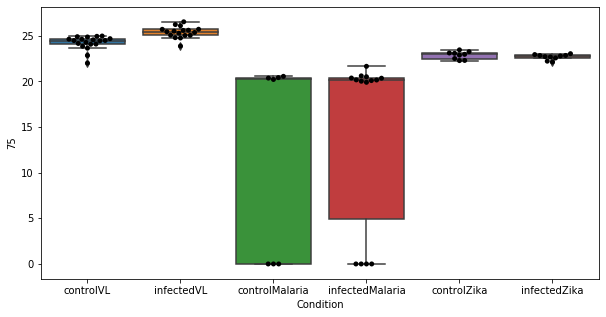

183 row m/z                773.588
row retention time     3.20318
p-val                 0.423486
adj.P.Val             0.999793
custom_id                 2997
compound_names             NaN
Name: 2997, dtype: object


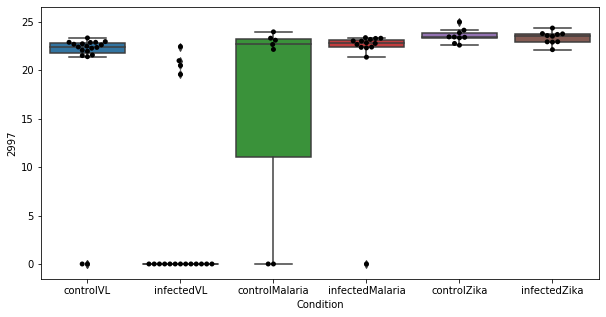

184 row m/z                142.948
row retention time     12.4757
p-val                 0.425582
adj.P.Val             0.999793
custom_id                  596
compound_names             NaN
Name: 596, dtype: object


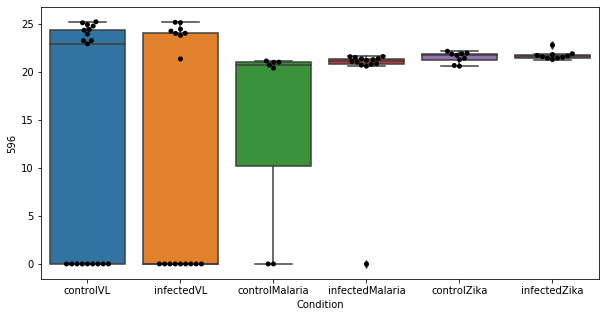

185 row m/z                512.335
row retention time     4.20079
p-val                 0.427049
adj.P.Val             0.999793
custom_id                 2782
compound_names             NaN
Name: 2782, dtype: object


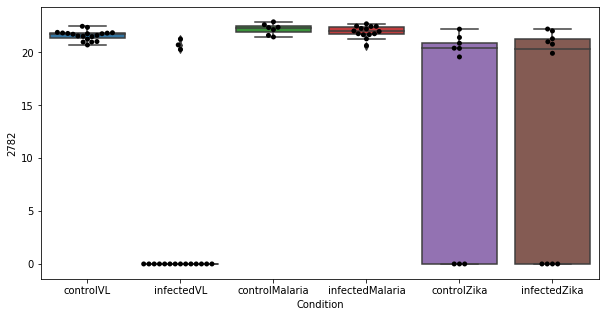

186 row m/z                811.604
row retention time     3.16645
p-val                  0.42989
adj.P.Val             0.999793
custom_id                 3075
compound_names             NaN
Name: 3075, dtype: object


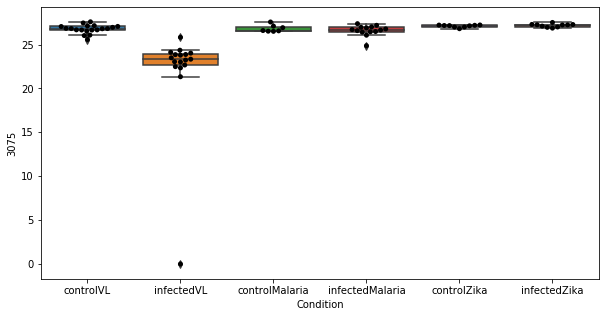

187 row m/z                239.139
row retention time     6.70223
p-val                 0.440437
adj.P.Val             0.999793
custom_id                 1897
compound_names             NaN
Name: 1897, dtype: object


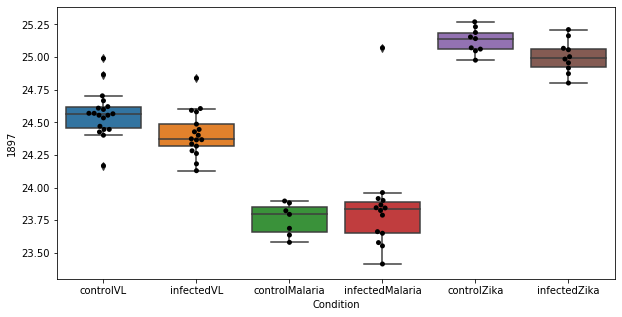

188 row m/z                124.087
row retention time     10.3561
p-val                 0.441283
adj.P.Val             0.999793
custom_id                  357
compound_names             NaN
Name: 357, dtype: object


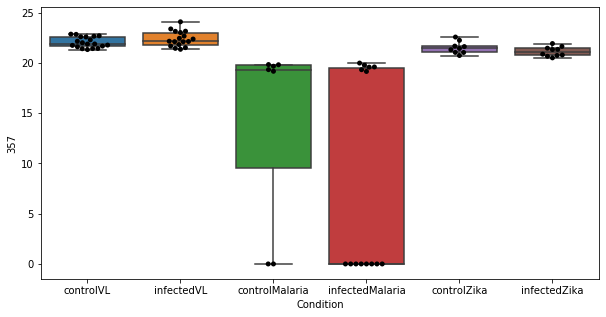

189 row m/z                87.0789
row retention time     11.7103
p-val                 0.446201
adj.P.Val             0.999793
custom_id                   65
compound_names             NaN
Name: 65, dtype: object


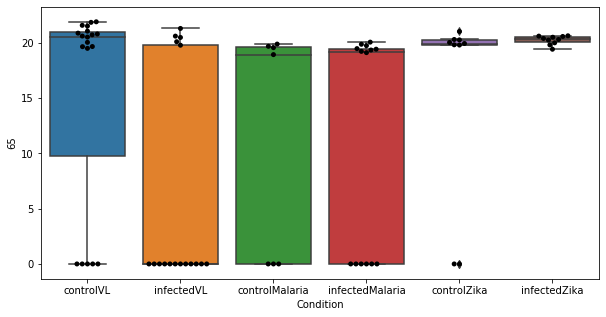

190 row m/z                 222.17
row retention time     3.48165
p-val                 0.446371
adj.P.Val             0.999793
custom_id                 1707
compound_names             NaN
Name: 1707, dtype: object


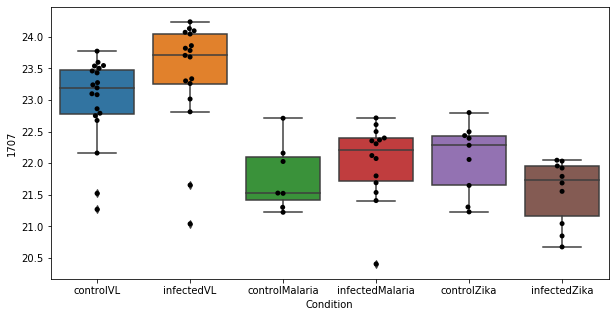

191 row m/z                                                         169.086
row retention time                                              6.70711
p-val                                                          0.456481
adj.P.Val                                                      0.999793
custom_id                                                          1012
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1012, dtype: object


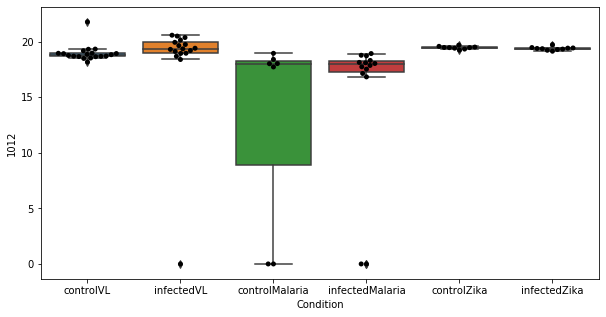

192 row m/z                615.539
row retention time     2.99217
p-val                 0.456767
adj.P.Val             0.999793
custom_id                 2874
compound_names             NaN
Name: 2874, dtype: object


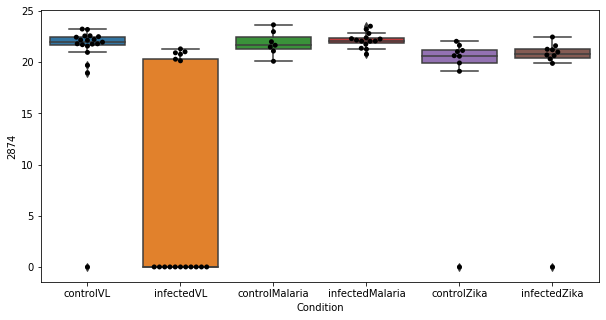

193 row m/z                595.493
row retention time     3.00049
p-val                 0.462647
adj.P.Val             0.999793
custom_id                 2855
compound_names             NaN
Name: 2855, dtype: object


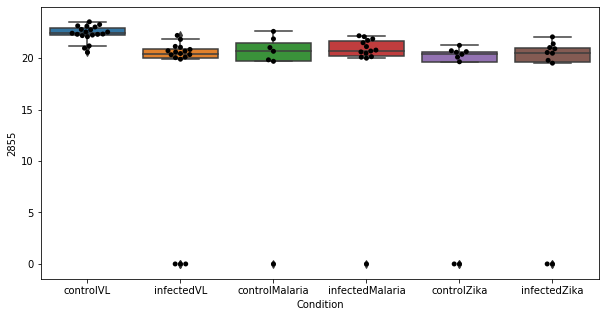

194 row m/z                                 137.046
row retention time                      9.04271
p-val                                  0.464114
adj.P.Val                              0.999793
custom_id                                   534
compound_names        Hypoxanthine; Purine-6-ol
Name: 534, dtype: object


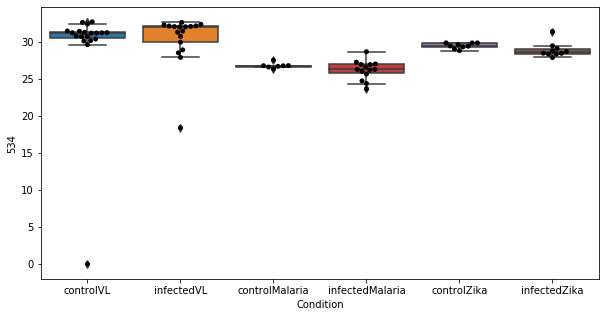

195 row m/z                228.123
row retention time     6.70606
p-val                 0.467864
adj.P.Val             0.999793
custom_id                 1769
compound_names             NaN
Name: 1769, dtype: object


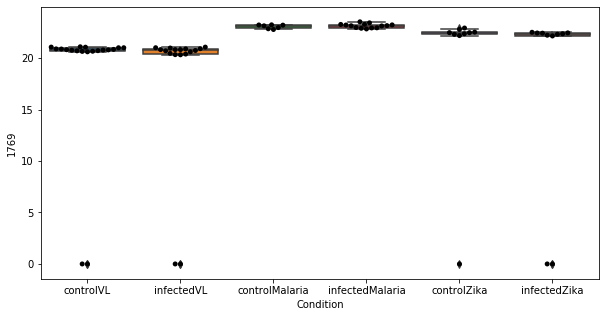

196 row m/z                232.118
row retention time     6.70933
p-val                 0.469006
adj.P.Val             0.999793
custom_id                 1821
compound_names             NaN
Name: 1821, dtype: object


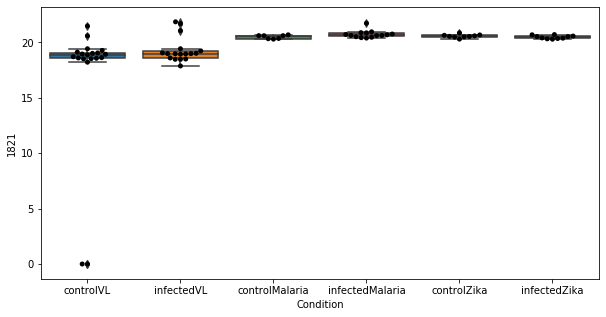

197 row m/z                785.651
row retention time     3.29657
p-val                 0.469296
adj.P.Val             0.999793
custom_id                 3017
compound_names             NaN
Name: 3017, dtype: object


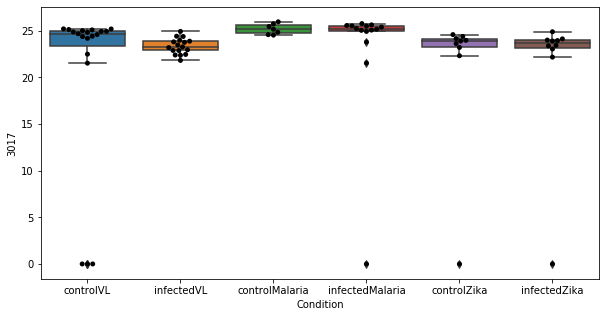

198 row m/z                                                   168.102
row retention time                                        6.71441
p-val                                                     0.47065
adj.P.Val                                                0.999793
custom_id                                                    4731
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 4731, dtype: object


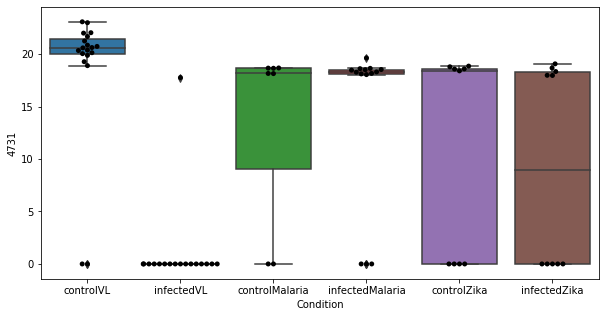

199 row m/z                                                         159.076
row retention time                                              12.4199
p-val                                                          0.471063
adj.P.Val                                                      0.999793
custom_id                                                           876
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 876, dtype: object


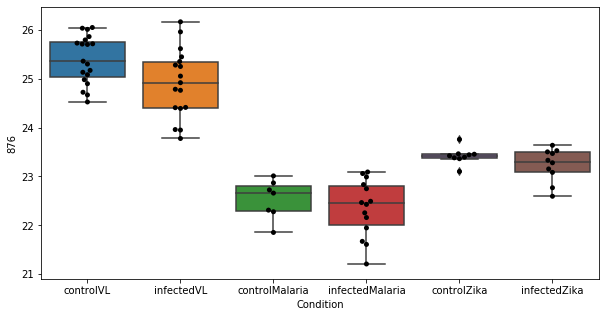

200 row m/z                                                         105.074
row retention time                                              10.2259
p-val                                                          0.484075
adj.P.Val                                                      0.999793
custom_id                                                           152
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 152, dtype: object


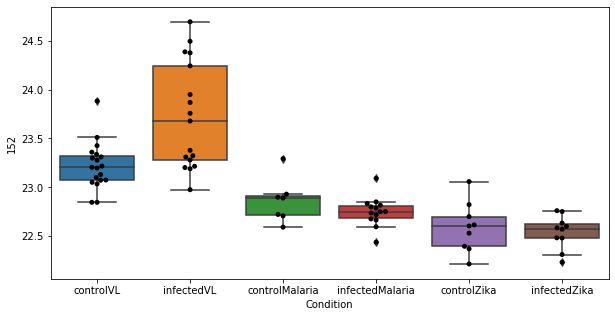

201 row m/z                                                         130.065
row retention time                                              6.72681
p-val                                                           0.48415
adj.P.Val                                                      0.999793
custom_id                                                           416
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 416, dtype: object


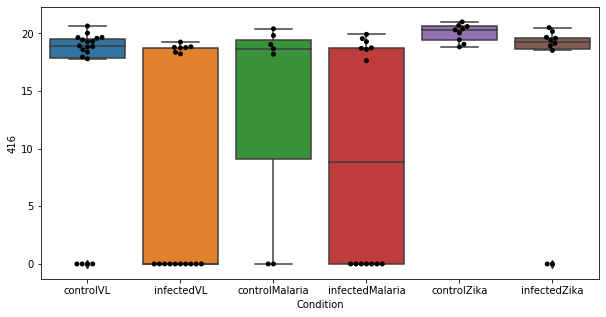

202 row m/z                134.106
row retention time     9.28237
p-val                 0.485758
adj.P.Val             0.999793
custom_id                  503
compound_names             NaN
Name: 503, dtype: object


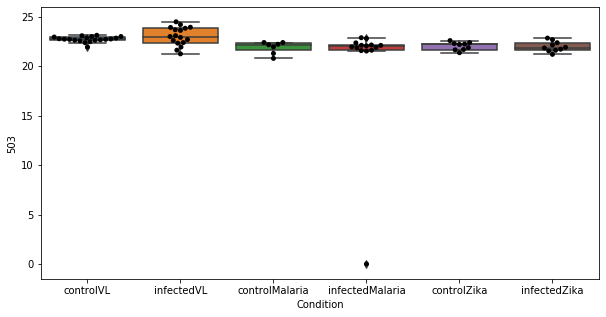

203 row m/z                733.557
row retention time      3.2348
p-val                 0.488577
adj.P.Val             0.999793
custom_id                 2944
compound_names             NaN
Name: 2944, dtype: object


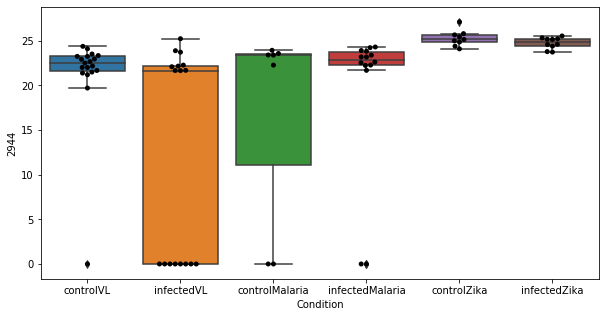

204 row m/z                  810.6
row retention time     3.17127
p-val                 0.490575
adj.P.Val             0.999793
custom_id                 3073
compound_names             NaN
Name: 3073, dtype: object


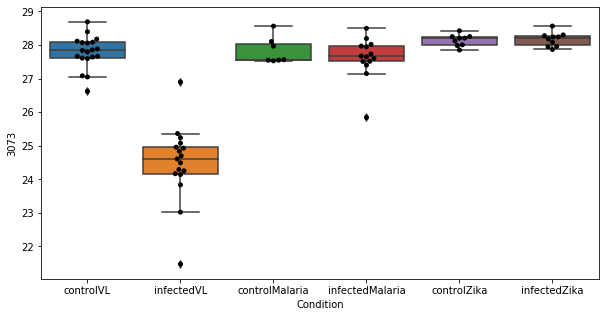

205 row m/z                832.584
row retention time     3.16211
p-val                 0.491544
adj.P.Val             0.999793
custom_id                 3114
compound_names             NaN
Name: 3114, dtype: object


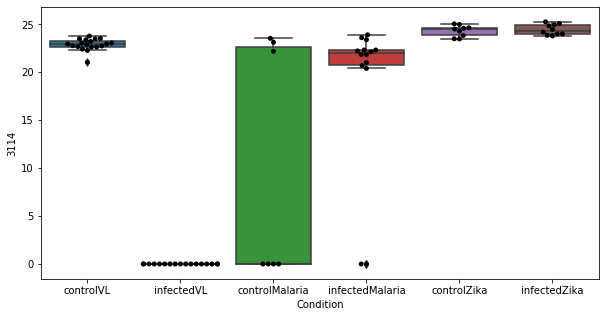

206 row m/z                                                         120.066
row retention time                                              9.57777
p-val                                                          0.493322
adj.P.Val                                                      0.999793
custom_id                                                           302
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 302, dtype: object


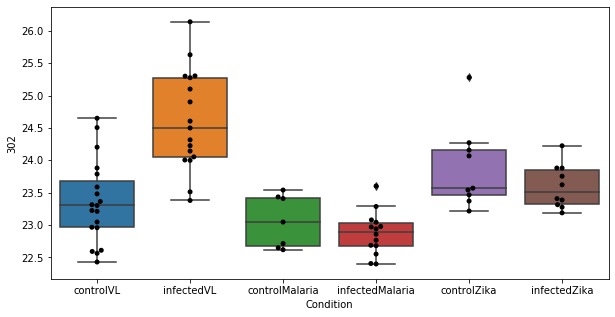

207 row m/z                                                         114.055
row retention time                                              8.43271
p-val                                                           0.49503
adj.P.Val                                                      0.999793
custom_id                                                           225
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 225, dtype: object


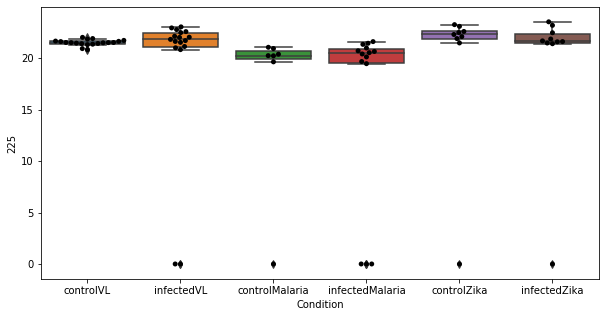

208 row m/z                                                         121.069
row retention time                                              11.6072
p-val                                                          0.495142
adj.P.Val                                                      0.999793
custom_id                                                           318
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 318, dtype: object


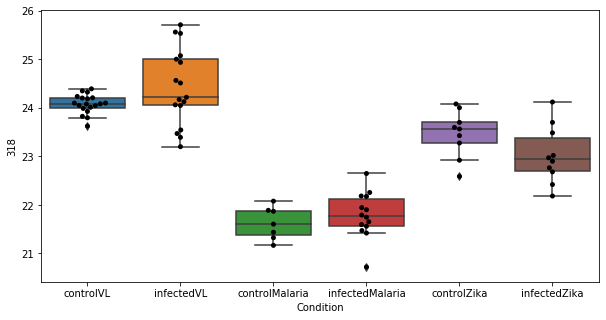

209 row m/z                  834.6
row retention time     3.15696
p-val                 0.496245
adj.P.Val             0.999793
custom_id                 3116
compound_names             NaN
Name: 3116, dtype: object


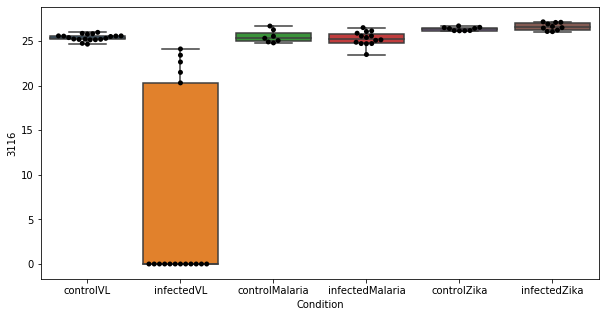

210 row m/z                905.594
row retention time     2.99894
p-val                 0.496526
adj.P.Val             0.999793
custom_id                 3200
compound_names             NaN
Name: 3200, dtype: object


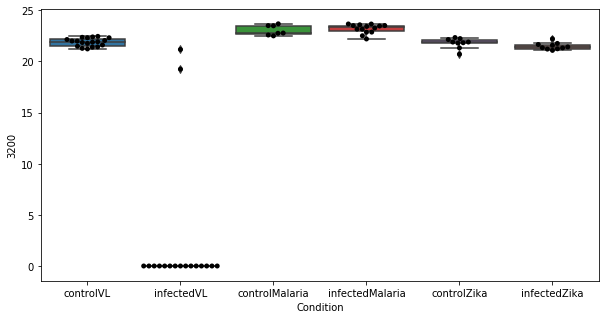

211 row m/z                288.225
row retention time     3.33908
p-val                 0.497084
adj.P.Val             0.999793
custom_id                 2310
compound_names             NaN
Name: 2310, dtype: object


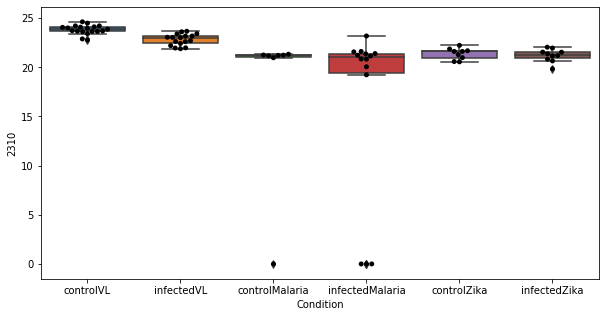

212 row m/z                676.547
row retention time     3.46451
p-val                 0.497455
adj.P.Val             0.999793
custom_id                 2905
compound_names             NaN
Name: 2905, dtype: object


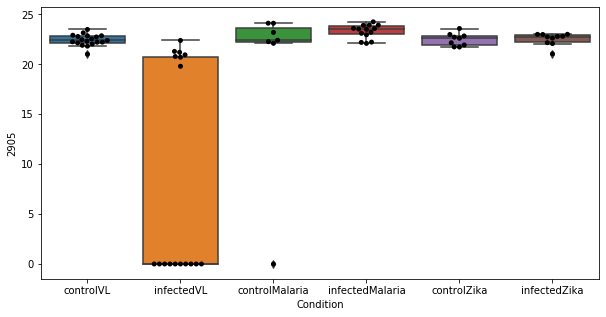

213 row m/z                214.253
row retention time     6.77671
p-val                 0.498285
adj.P.Val             0.999793
custom_id                 3803
compound_names             NaN
Name: 3803, dtype: object


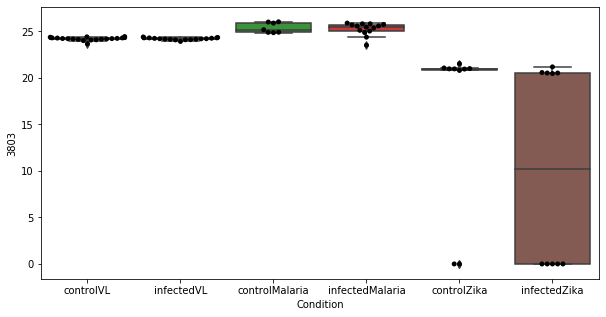

214 row m/z                289.053
row retention time     9.96725
p-val                 0.499107
adj.P.Val             0.999793
custom_id                 2319
compound_names             NaN
Name: 2319, dtype: object


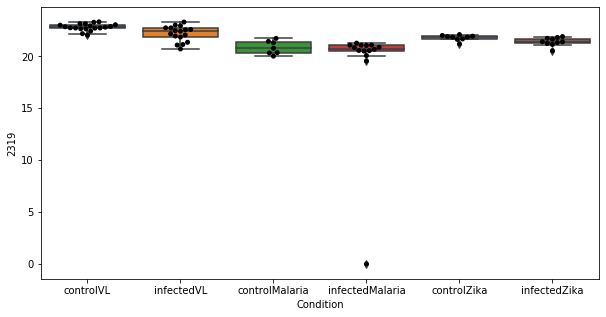

215 row m/z                                 139.05
row retention time                     9.04449
p-val                                 0.500101
adj.P.Val                             0.999793
custom_id                                 3392
compound_names        Urocanate; Urocanic acid
Name: 3392, dtype: object


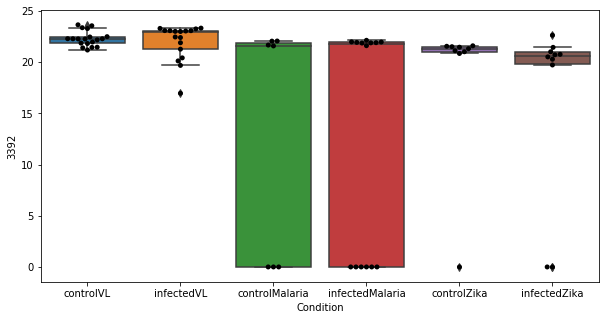

216 row m/z                807.572
row retention time     3.18235
p-val                 0.502438
adj.P.Val             0.999793
custom_id                 3065
compound_names             NaN
Name: 3065, dtype: object


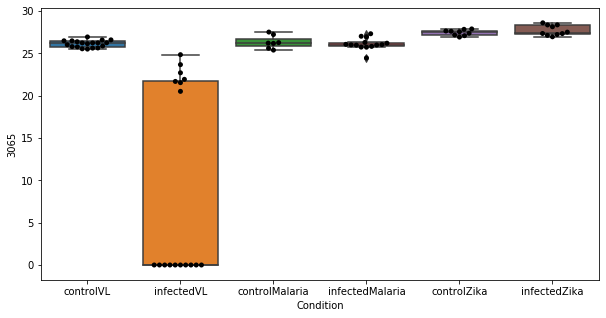

217 row m/z                191.085
row retention time     9.80185
p-val                 0.503305
adj.P.Val             0.999793
custom_id                 1299
compound_names             NaN
Name: 1299, dtype: object


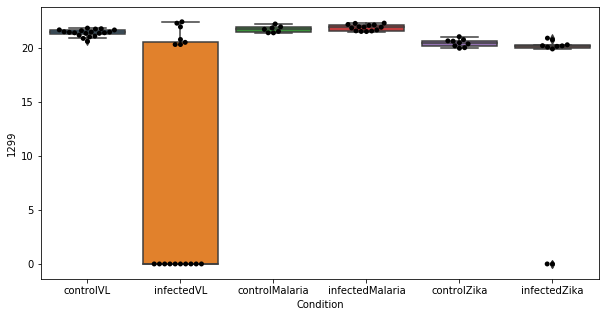

218 row m/z                143.107
row retention time     4.38606
p-val                 0.509237
adj.P.Val             0.999793
custom_id                  610
compound_names             NaN
Name: 610, dtype: object


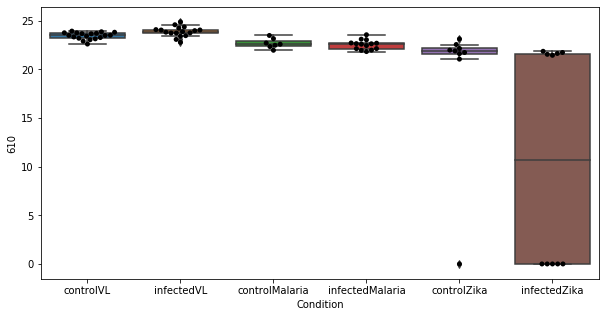

219 row m/z                163.116
row retention time     10.7419
p-val                 0.513173
adj.P.Val             0.999793
custom_id                  935
compound_names             NaN
Name: 935, dtype: object


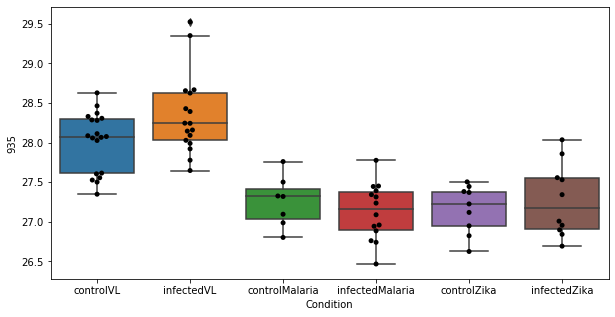

220 row m/z                      216.123
row retention time           6.72113
p-val                       0.515063
adj.P.Val                   0.999793
custom_id                       1633
compound_names        L-Metanephrine
Name: 1633, dtype: object


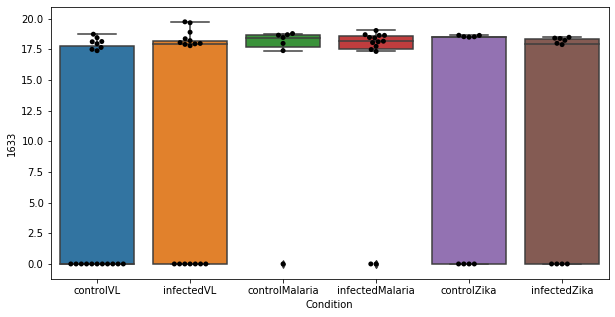

221 row m/z                                                          157.08
row retention time                                              11.7725
p-val                                                          0.519241
adj.P.Val                                                      0.999793
custom_id                                                           841
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 841, dtype: object


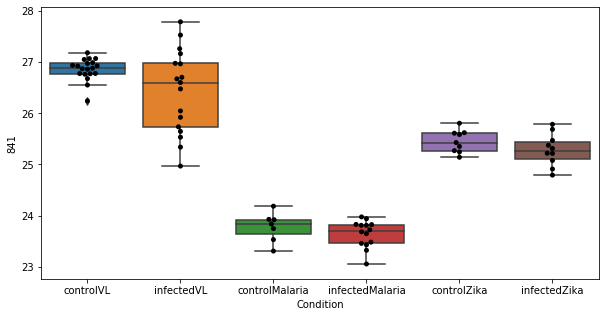

222 row m/z                575.467
row retention time     2.97972
p-val                 0.521695
adj.P.Val             0.999793
custom_id                 2836
compound_names             NaN
Name: 2836, dtype: object


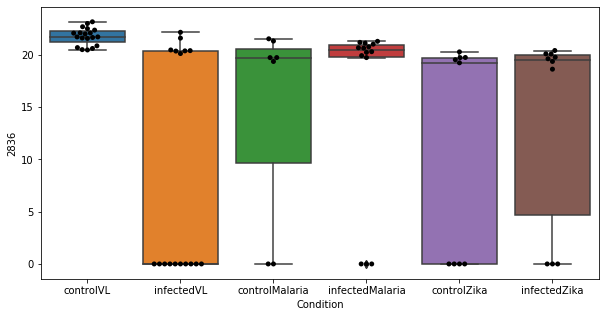

223 row m/z                76.0757
row retention time     9.35989
p-val                 0.524817
adj.P.Val             0.999793
custom_id                   19
compound_names             NaN
Name: 19, dtype: object


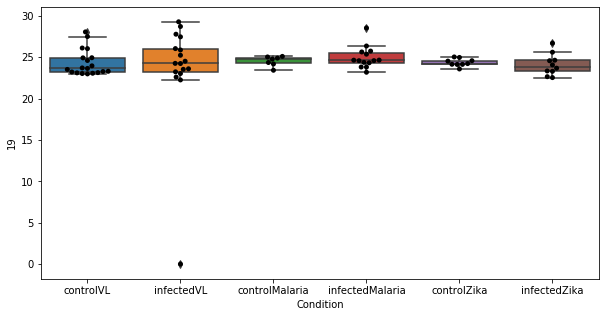

224 row m/z                229.155
row retention time     10.5569
p-val                 0.527825
adj.P.Val             0.999793
custom_id                 1791
compound_names             NaN
Name: 1791, dtype: object


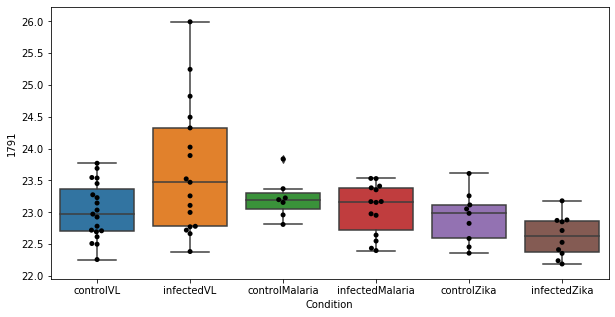

225 row m/z                247.144
row retention time     7.69256
p-val                 0.528263
adj.P.Val             0.999793
custom_id                 1973
compound_names             NaN
Name: 1973, dtype: object


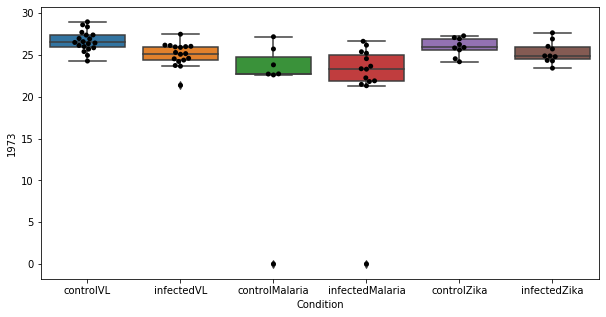

226 row m/z                                                         162.076
row retention time                                              9.36508
p-val                                                          0.529877
adj.P.Val                                                      0.999793
custom_id                                                           925
compound_names        D-Glucosamine; Chitosamine; 2-Amino-2-deoxy-D-...
Name: 925, dtype: object


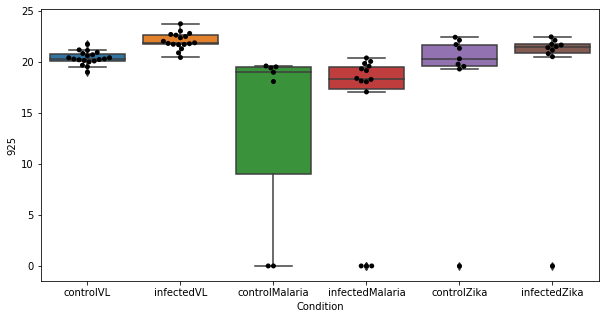

227 row m/z                                                         162.112
row retention time                                              10.7402
p-val                                                          0.529928
adj.P.Val                                                      0.999793
custom_id                                                           927
compound_names        L-Carnitine; L-gamma-Trimethyl-beta-hydroxybut...
Name: 927, dtype: object


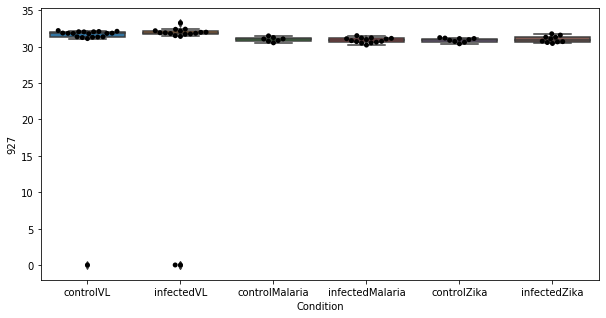

228 row m/z                244.191
row retention time     3.87308
p-val                  0.53371
adj.P.Val             0.999793
custom_id                 1944
compound_names             NaN
Name: 1944, dtype: object


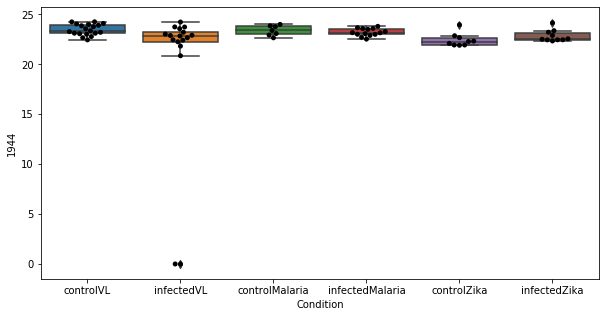

229 row m/z                 226.18
row retention time     3.89297
p-val                 0.539524
adj.P.Val             0.999793
custom_id                 1748
compound_names             NaN
Name: 1748, dtype: object


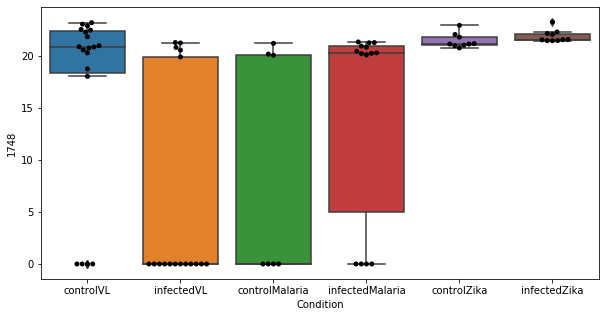

230 row m/z                132.054
row retention time     11.8975
p-val                 0.545874
adj.P.Val             0.999793
custom_id                  455
compound_names             NaN
Name: 455, dtype: object


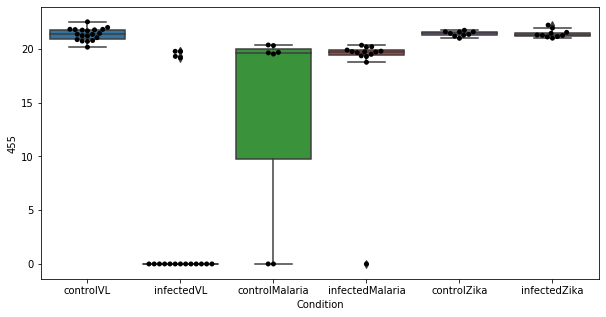

231 row m/z                174.132
row retention time      9.2893
p-val                 0.546504
adj.P.Val             0.999793
custom_id                 1096
compound_names             NaN
Name: 1096, dtype: object


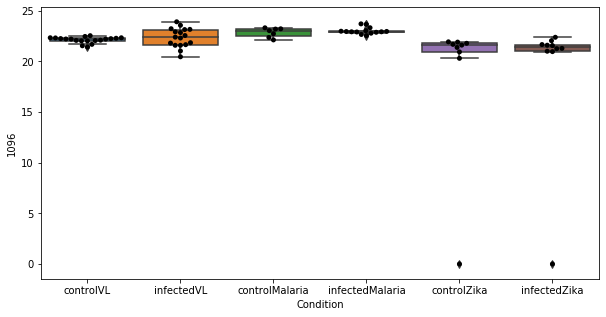

232 row m/z                             142.086
row retention time                  9.05916
p-val                              0.548533
adj.P.Val                          0.999793
custom_id                               584
compound_names        5-Acetamidopentanoate
Name: 584, dtype: object


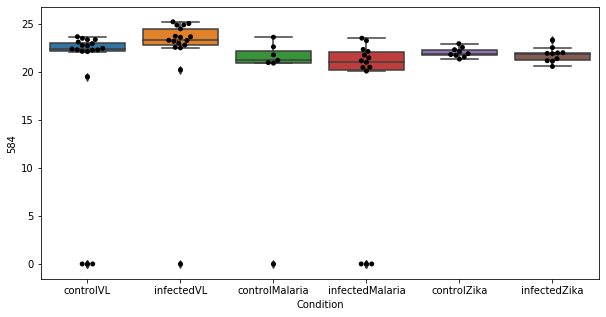

233 row m/z                812.614
row retention time     3.17385
p-val                 0.549159
adj.P.Val             0.999793
custom_id                 3079
compound_names             NaN
Name: 3079, dtype: object


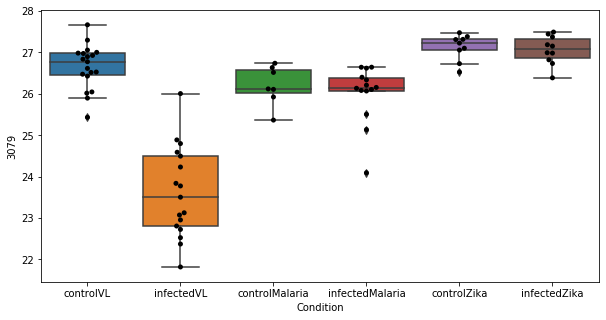

234 row m/z                183.113
row retention time     6.71641
p-val                 0.550576
adj.P.Val             0.999793
custom_id                 1197
compound_names             NaN
Name: 1197, dtype: object


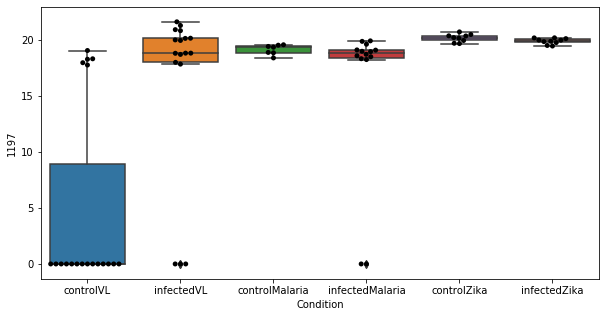

235 row m/z                            400.342
row retention time                 3.76884
p-val                             0.552457
adj.P.Val                         0.999793
custom_id                             2676
compound_names        L-Palmitoylcarnitine
Name: 2676, dtype: object


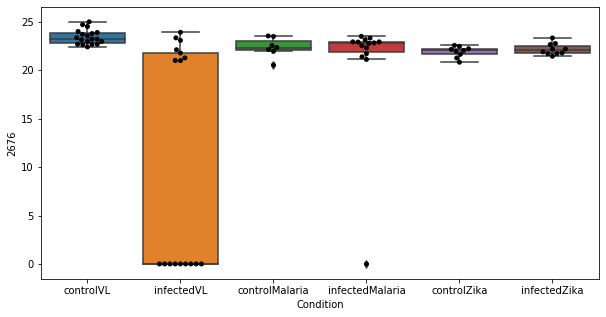

236 row m/z                164.119
row retention time     10.7393
p-val                 0.553988
adj.P.Val             0.999793
custom_id                  952
compound_names             NaN
Name: 952, dtype: object


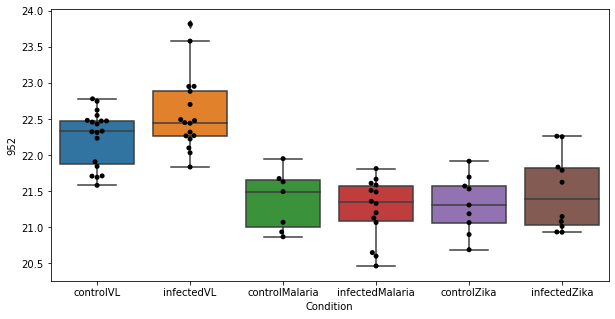

237 row m/z                158.081
row retention time     4.53391
p-val                 0.556928
adj.P.Val             0.999793
custom_id                  853
compound_names             NaN
Name: 853, dtype: object


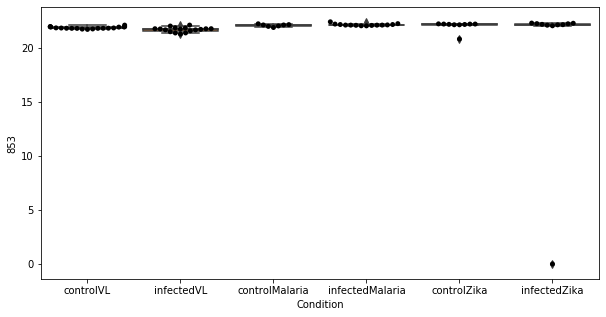

238 row m/z                770.603
row retention time     3.19827
p-val                 0.556976
adj.P.Val             0.999793
custom_id                 2992
compound_names             NaN
Name: 2992, dtype: object


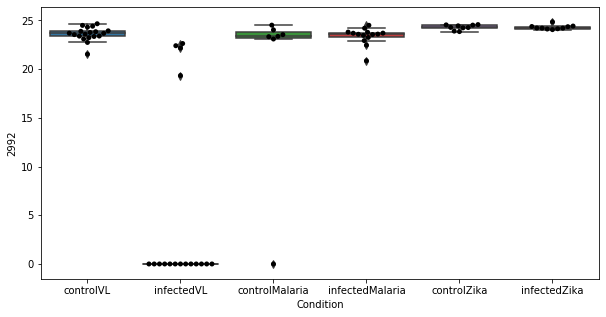

239 row m/z                                                         140.068
row retention time                                              9.59523
p-val                                                          0.557329
adj.P.Val                                                      0.999793
custom_id                                                           568
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 568, dtype: object


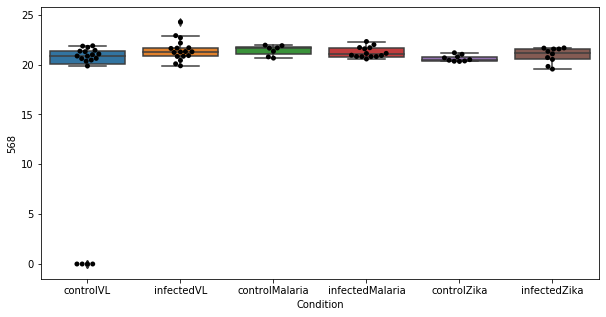

240 row m/z                806.569
row retention time     3.17983
p-val                 0.558478
adj.P.Val             0.999793
custom_id                 3063
compound_names             NaN
Name: 3063, dtype: object


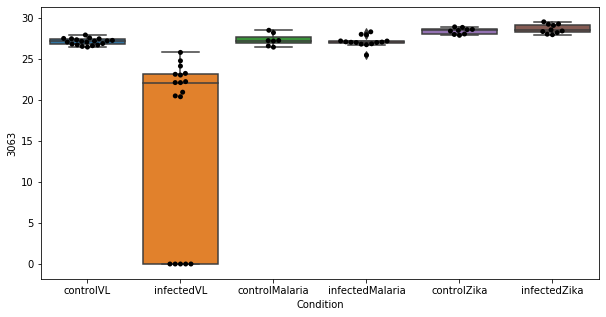

241 row m/z                                                        249.061
row retention time                                             9.95826
p-val                                                         0.559071
adj.P.Val                                                     0.999793
custom_id                                                         1987
compound_names        5-Acetylamino-6-formylamino-3-methyluracil; AFMU
Name: 1987, dtype: object


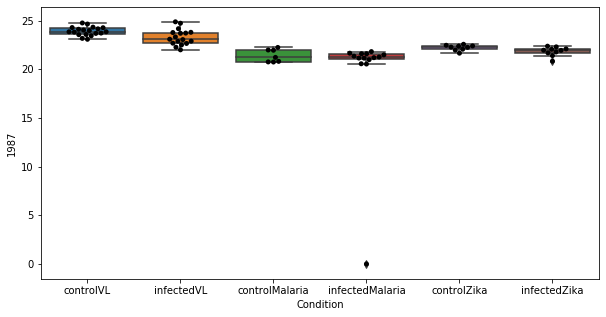

242 row m/z                329.174
row retention time     10.3999
p-val                 0.559448
adj.P.Val             0.999793
custom_id                 2506
compound_names             NaN
Name: 2506, dtype: object


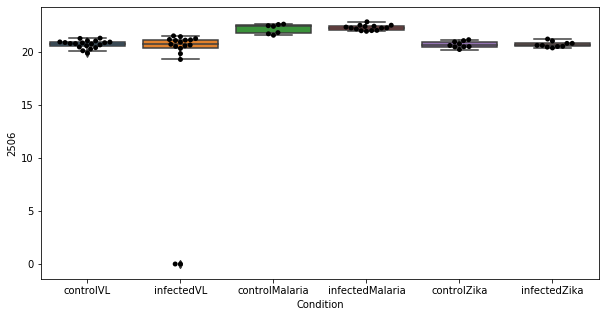

243 row m/z                790.622
row retention time     3.18252
p-val                 0.562162
adj.P.Val             0.999793
custom_id                 3036
compound_names             NaN
Name: 3036, dtype: object


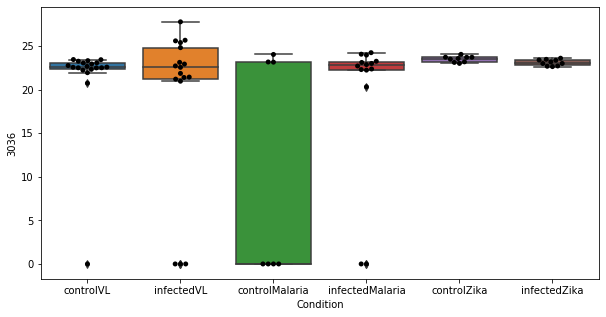

244 row m/z                            147.121
row retention time                 10.7328
p-val                             0.563068
adj.P.Val                         0.999793
custom_id                              698
compound_names        3-Dehydroxycarnitine
Name: 698, dtype: object


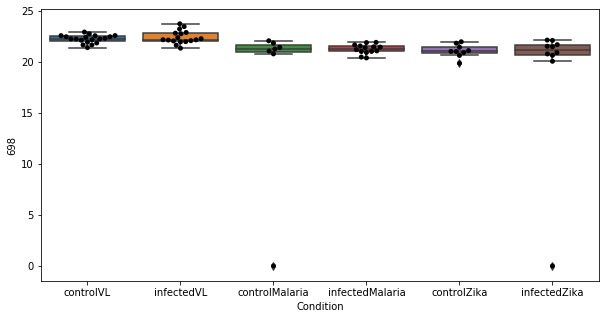

245 row m/z                154.072
row retention time     9.03698
p-val                 0.563375
adj.P.Val             0.999793
custom_id                  795
compound_names             NaN
Name: 795, dtype: object


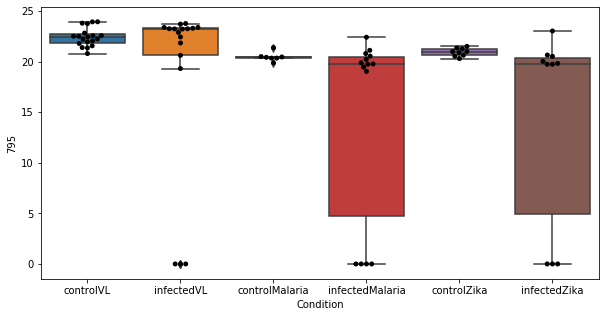

246 row m/z                                                          343.19
row retention time                                              9.29234
p-val                                                          0.565838
adj.P.Val                                                      0.999793
custom_id                                                          2544
compound_names        Cortisone; 17alpha,21-Dihydroxy-4-pregnene-3,1...
Name: 2544, dtype: object


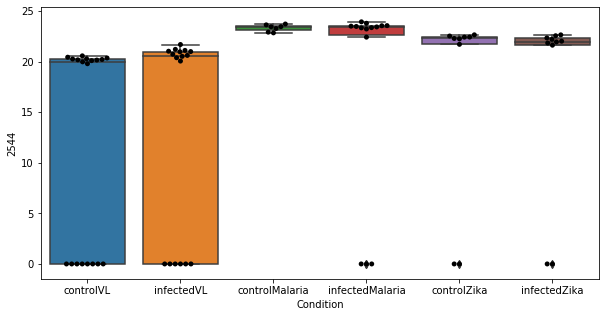

247 row m/z                735.572
row retention time     3.22431
p-val                 0.568637
adj.P.Val             0.999793
custom_id                 2946
compound_names             NaN
Name: 2946, dtype: object


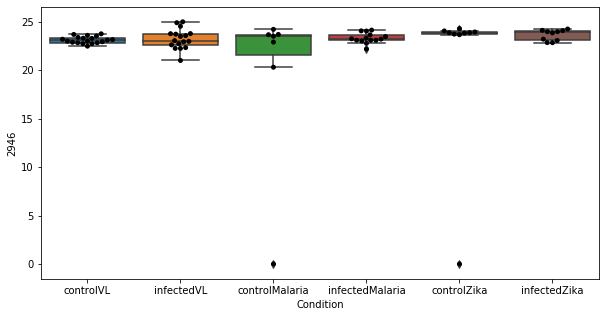

248 row m/z                164.116
row retention time     10.7397
p-val                 0.572741
adj.P.Val             0.999793
custom_id                  951
compound_names             NaN
Name: 951, dtype: object


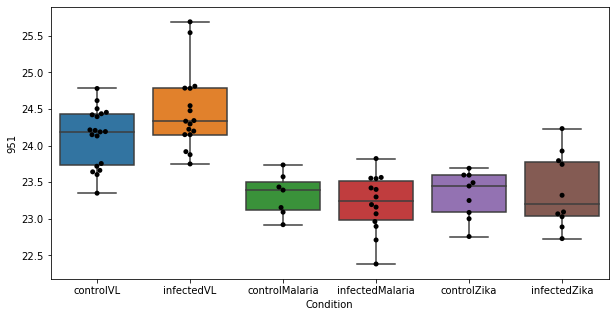

249 row m/z                 612.52
row retention time     2.99117
p-val                 0.573333
adj.P.Val             0.999793
custom_id                 2869
compound_names             NaN
Name: 2869, dtype: object


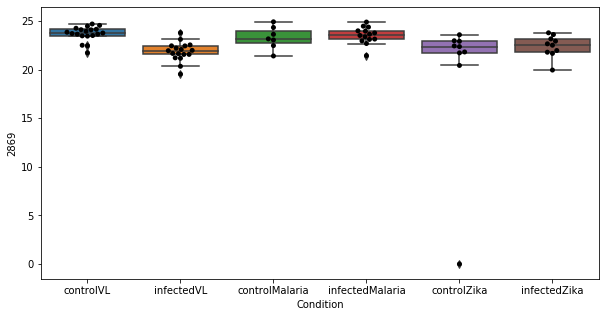

250 row m/z                                                         156.102
row retention time                                              4.37061
p-val                                                          0.573367
adj.P.Val                                                      0.999793
custom_id                                                          3479
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 3479, dtype: object


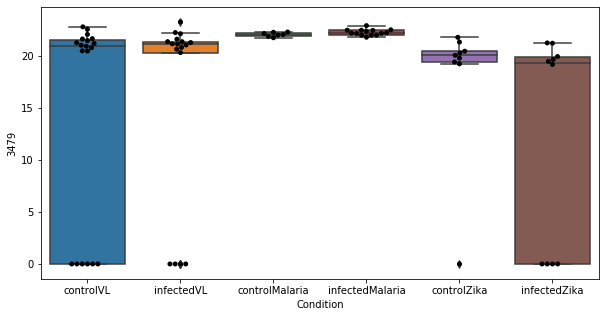

251 row m/z                211.133
row retention time     3.69812
p-val                 0.576311
adj.P.Val             0.999793
custom_id                 1563
compound_names             NaN
Name: 1563, dtype: object


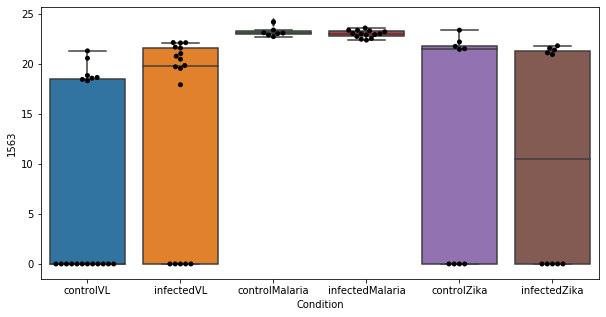

252 row m/z                173.117
row retention time     4.25529
p-val                 0.577178
adj.P.Val             0.999793
custom_id                 3578
compound_names             NaN
Name: 3578, dtype: object


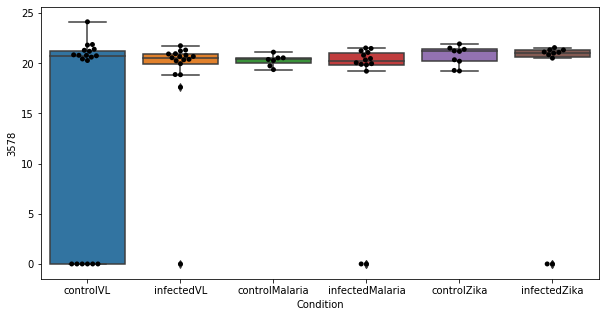

253 row m/z                                                         147.076
row retention time                                              10.1063
p-val                                                          0.577713
adj.P.Val                                                      0.999793
custom_id                                                           692
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 692, dtype: object


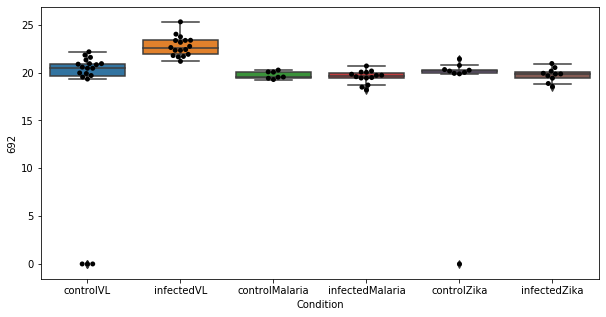

254 row m/z                786.657
row retention time     3.30119
p-val                 0.577727
adj.P.Val             0.999793
custom_id                 3023
compound_names             NaN
Name: 3023, dtype: object


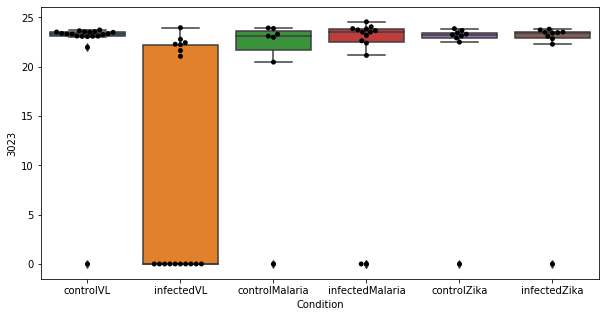

255 row m/z                                                         114.055
row retention time                                              9.62583
p-val                                                          0.580047
adj.P.Val                                                      0.999793
custom_id                                                           224
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 224, dtype: object


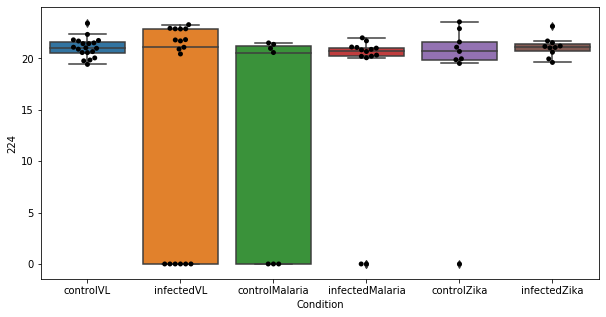

256 row m/z                150.113
row retention time     8.21405
p-val                 0.580438
adj.P.Val             0.999793
custom_id                  750
compound_names             NaN
Name: 750, dtype: object


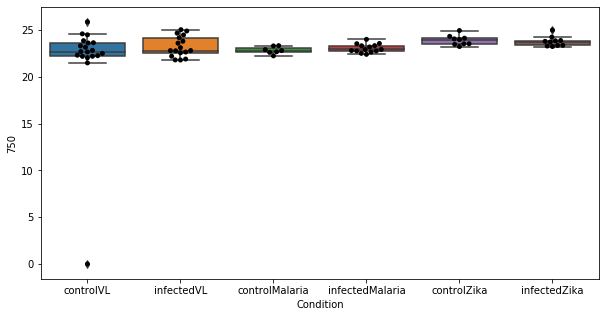

257 row m/z                756.553
row retention time     3.23797
p-val                 0.583193
adj.P.Val             0.999793
custom_id                 2967
compound_names             NaN
Name: 2967, dtype: object


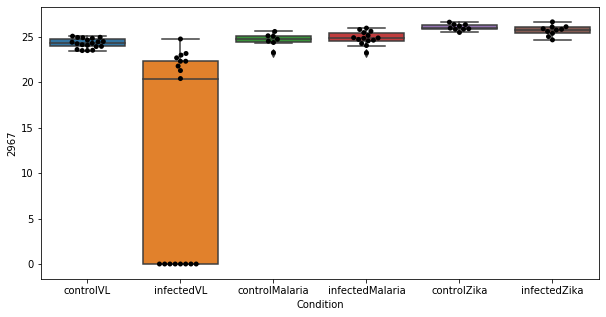

258 row m/z                782.569
row retention time     3.20424
p-val                 0.586946
adj.P.Val             0.999793
custom_id                 3009
compound_names             NaN
Name: 3009, dtype: object


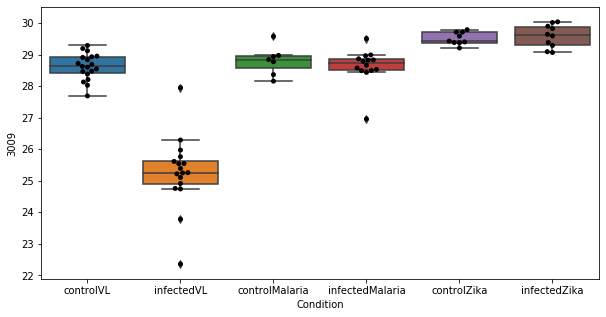

259 row m/z                809.588
row retention time     3.18517
p-val                 0.587036
adj.P.Val             0.999793
custom_id                 3070
compound_names             NaN
Name: 3070, dtype: object


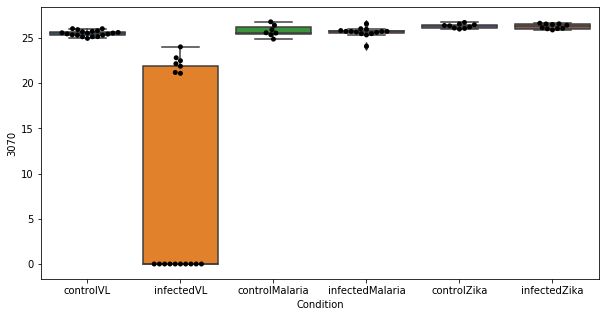

260 row m/z                182.139
row retention time     4.27109
p-val                 0.588605
adj.P.Val             0.999793
custom_id                 1185
compound_names             NaN
Name: 1185, dtype: object


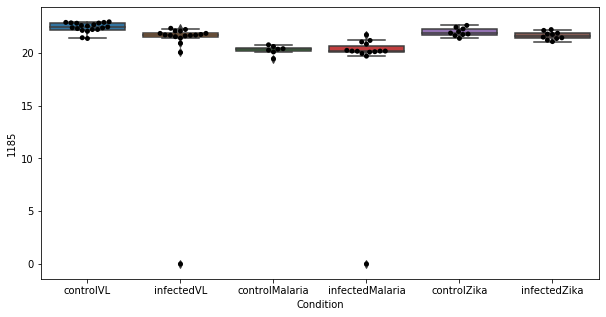

261 row m/z                546.355
row retention time     3.69144
p-val                 0.589183
adj.P.Val             0.999793
custom_id                 2817
compound_names             NaN
Name: 2817, dtype: object


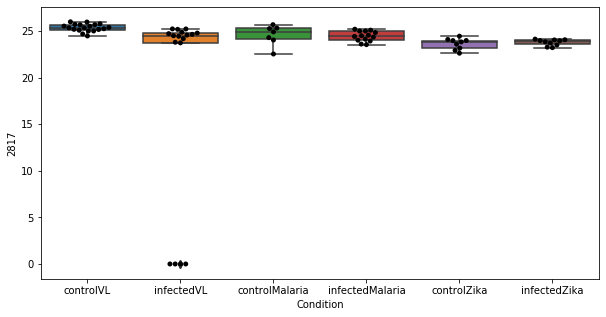

262 row m/z                119.016
row retention time     10.0976
p-val                 0.589368
adj.P.Val             0.999793
custom_id                  293
compound_names             NaN
Name: 293, dtype: object


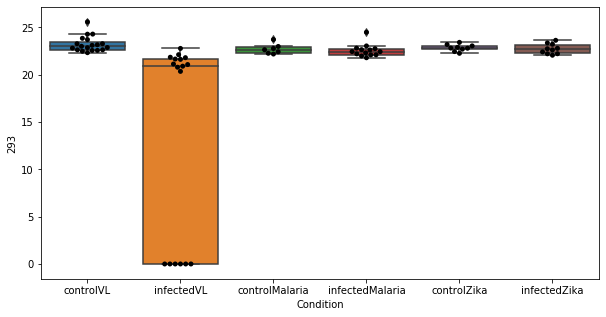

263 row m/z                 904.59
row retention time     2.99672
p-val                 0.590415
adj.P.Val             0.999793
custom_id                 3197
compound_names             NaN
Name: 3197, dtype: object


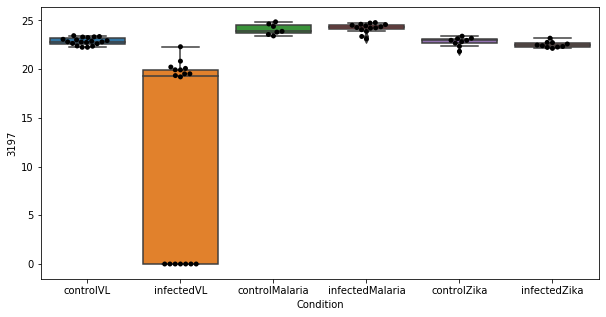

264 row m/z                200.027
row retention time     10.5774
p-val                 0.590514
adj.P.Val             0.999793
custom_id                 1416
compound_names             NaN
Name: 1416, dtype: object


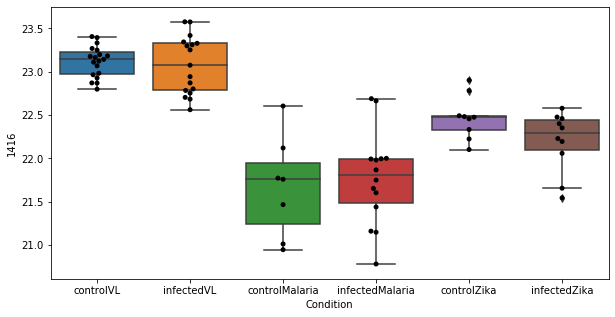

265 row m/z                316.248
row retention time     6.70854
p-val                 0.590764
adj.P.Val             0.999793
custom_id                 2465
compound_names             NaN
Name: 2465, dtype: object


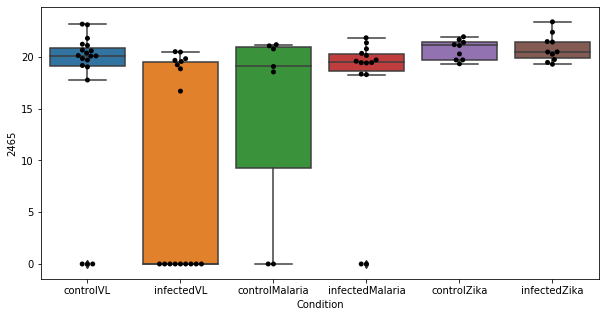

266 row m/z                                                         281.247
row retention time                                              3.01221
p-val                                                          0.591462
adj.P.Val                                                      0.999793
custom_id                                                          2259
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2259, dtype: object


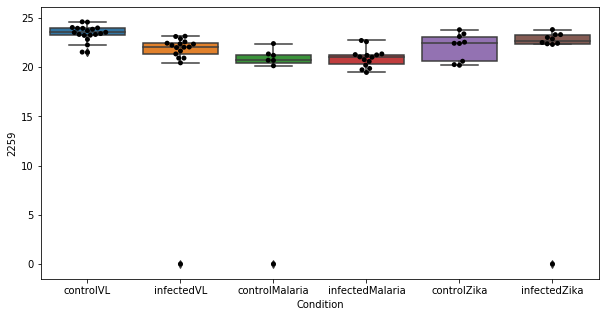

267 row m/z                781.556
row retention time     3.22257
p-val                 0.591482
adj.P.Val             0.999793
custom_id                 3007
compound_names             NaN
Name: 3007, dtype: object


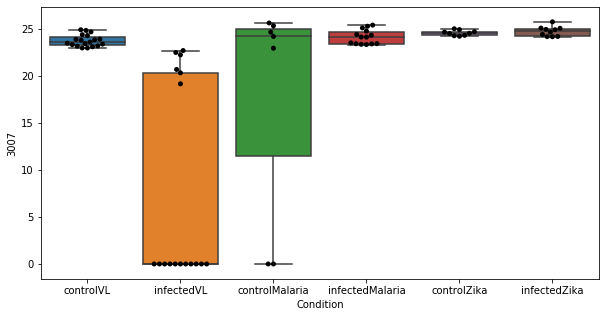

268 row m/z                239.128
row retention time     3.59802
p-val                 0.592008
adj.P.Val             0.999793
custom_id                 1894
compound_names             NaN
Name: 1894, dtype: object


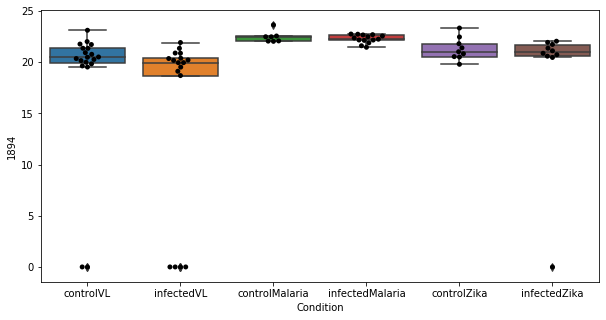

269 row m/z                                                         146.092
row retention time                                              11.9397
p-val                                                          0.593922
adj.P.Val                                                      0.999793
custom_id                                                           671
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 671, dtype: object


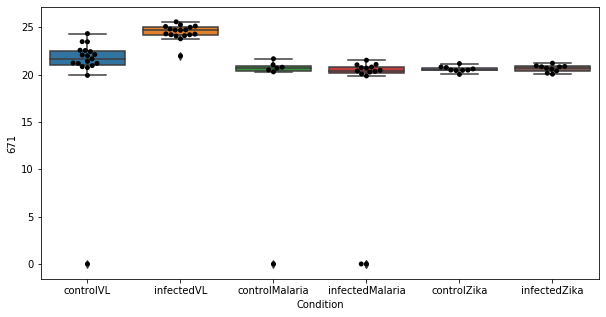

270 row m/z                156.138
row retention time     4.38882
p-val                  0.59543
adj.P.Val             0.999793
custom_id                  830
compound_names             NaN
Name: 830, dtype: object


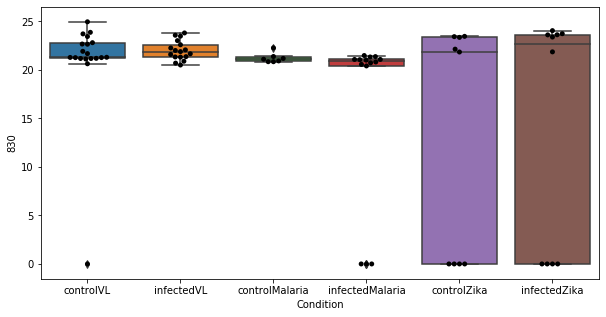

271 row m/z                332.331
row retention time     6.71606
p-val                 0.598004
adj.P.Val             0.999793
custom_id                 2515
compound_names             NaN
Name: 2515, dtype: object


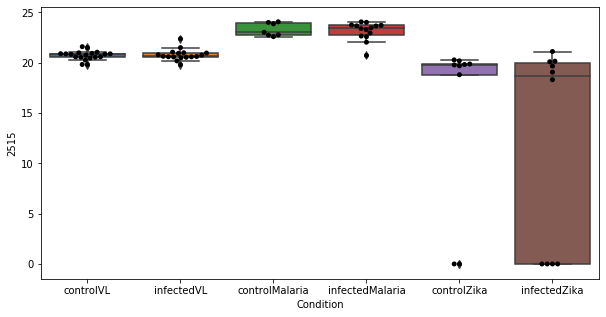

272 row m/z                185.117
row retention time     4.38696
p-val                 0.600151
adj.P.Val             0.999793
custom_id                 1224
compound_names             NaN
Name: 1224, dtype: object


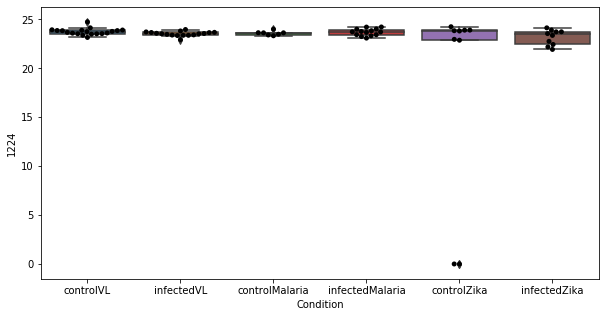

273 row m/z                246.133
row retention time     6.71118
p-val                 0.600461
adj.P.Val             0.999793
custom_id                 1961
compound_names             NaN
Name: 1961, dtype: object


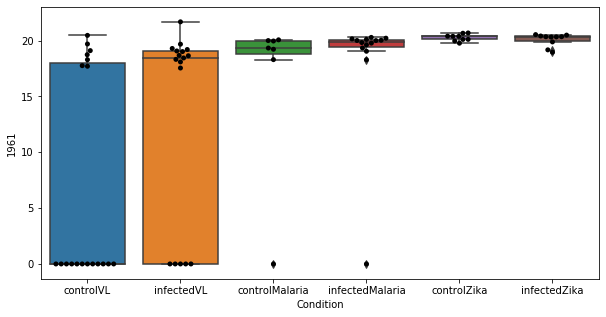

274 row m/z                242.284
row retention time     6.71102
p-val                 0.601169
adj.P.Val             0.999793
custom_id                 1921
compound_names             NaN
Name: 1921, dtype: object


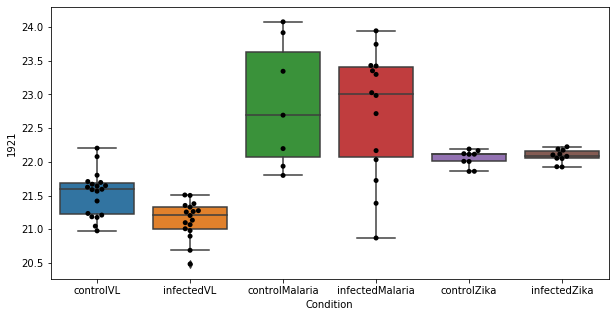

275 row m/z                                                         120.066
row retention time                                              11.6047
p-val                                                          0.603375
adj.P.Val                                                      0.999793
custom_id                                                           301
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 301, dtype: object


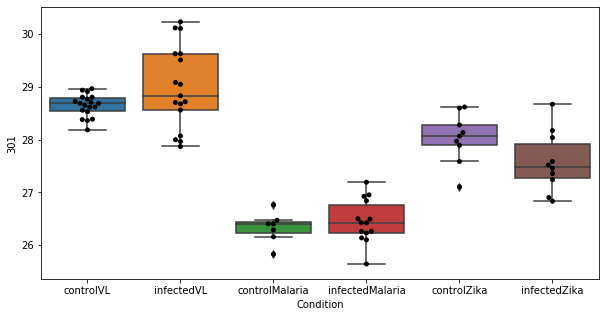

276 row m/z                                                       129.102
row retention time                                            10.1401
p-val                                                        0.603578
adj.P.Val                                                    0.999793
custom_id                                                         397
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 397, dtype: object


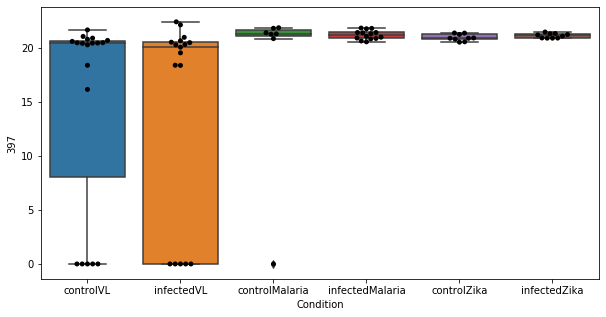

277 row m/z                                                         154.069
row retention time                                              6.76427
p-val                                                          0.604288
adj.P.Val                                                      0.999793
custom_id                                                           794
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 794, dtype: object


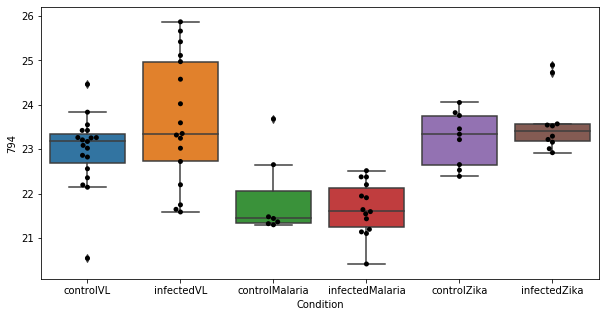

278 row m/z                836.614
row retention time     3.15613
p-val                 0.604317
adj.P.Val             0.999793
custom_id                 3118
compound_names             NaN
Name: 3118, dtype: object


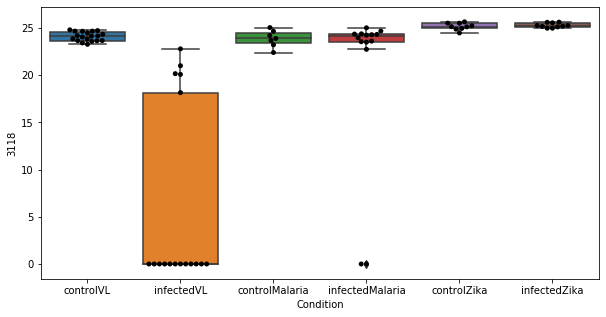

279 row m/z                272.185
row retention time     6.70999
p-val                 0.604751
adj.P.Val             0.999793
custom_id                 2186
compound_names             NaN
Name: 2186, dtype: object


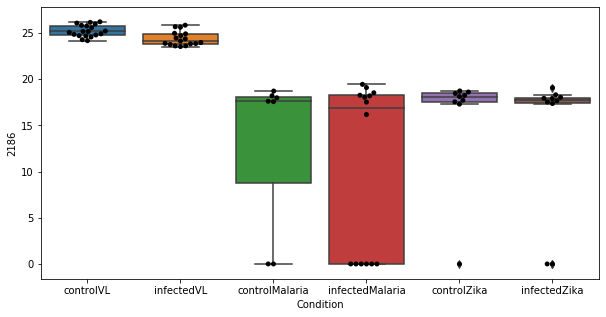

280 row m/z                114.034
row retention time     8.58987
p-val                 0.605021
adj.P.Val             0.999793
custom_id                  223
compound_names             NaN
Name: 223, dtype: object


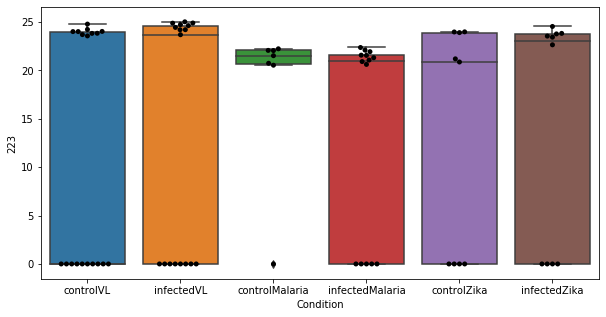

281 row m/z                      170.118
row retention time           6.71232
p-val                       0.606642
adj.P.Val                   0.999793
custom_id                       1034
compound_names        L-Metanephrine
Name: 1034, dtype: object


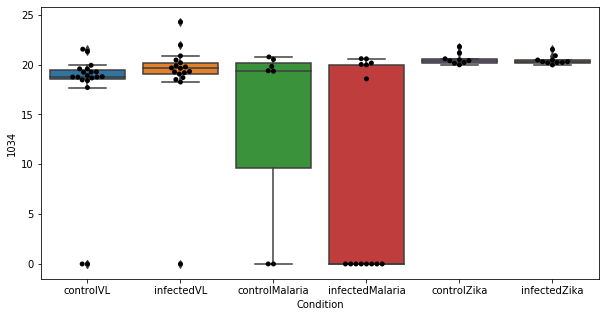

282 row m/z                158.118
row retention time     4.39119
p-val                 0.608341
adj.P.Val             0.999793
custom_id                  863
compound_names             NaN
Name: 863, dtype: object


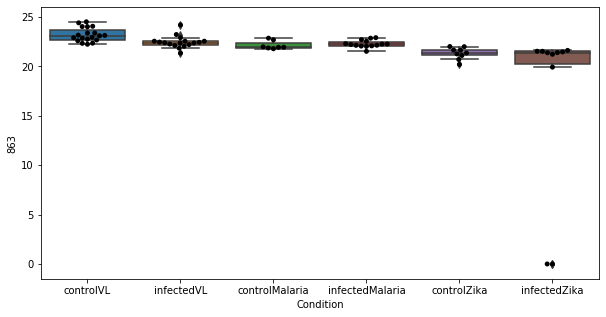

283 row m/z                                                         133.105
row retention time                                              9.28401
p-val                                                          0.609427
adj.P.Val                                                      0.999793
custom_id                                                           489
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 489, dtype: object


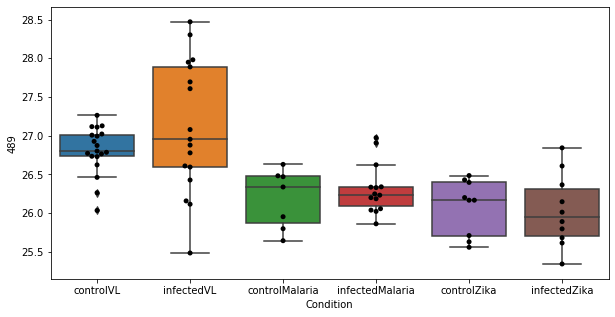

284 row m/z                125.096
row retention time     4.37678
p-val                 0.611708
adj.P.Val             0.999793
custom_id                  365
compound_names             NaN
Name: 365, dtype: object


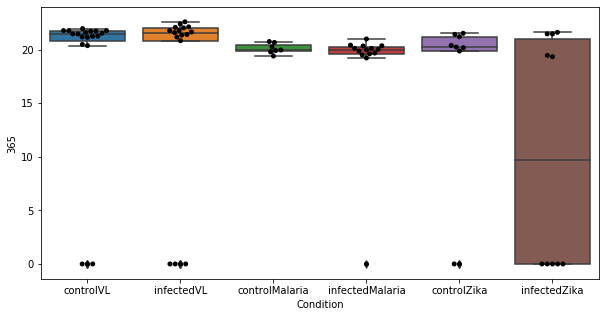

285 row m/z                                                         266.121
row retention time                                              6.71218
p-val                                                          0.612779
adj.P.Val                                                      0.999793
custom_id                                                          2144
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2144, dtype: object


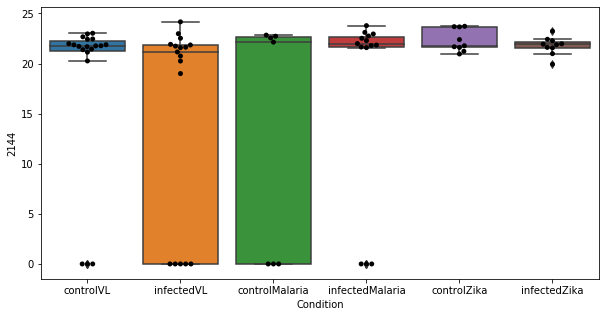

286 row m/z                                                         132.102
row retention time                                              9.28268
p-val                                                          0.615776
adj.P.Val                                                      0.999793
custom_id                                                           462
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 462, dtype: object


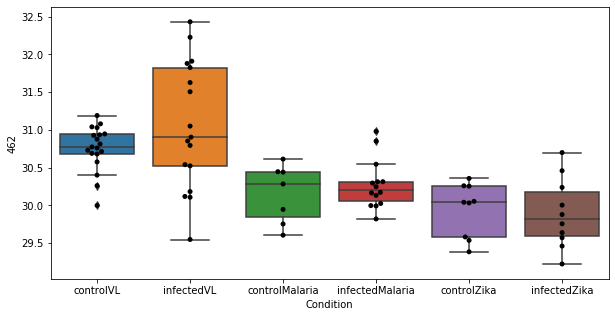

287 row m/z                                                         129.066
row retention time                                              11.7393
p-val                                                          0.616066
adj.P.Val                                                      0.999793
custom_id                                                           390
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 390, dtype: object


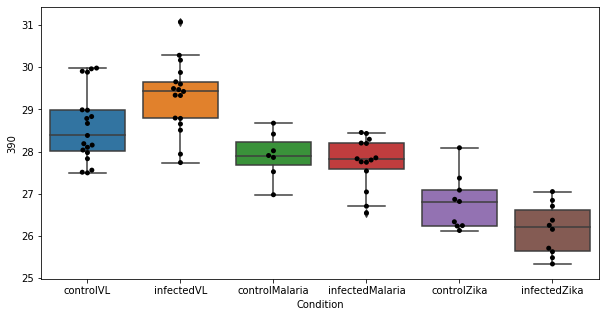

288 row m/z                                                        136.043
row retention time                                             10.0993
p-val                                                         0.617793
adj.P.Val                                                     0.999793
custom_id                                                          515
compound_names        L-Homocysteine; L-2-Amino-4-mercaptobutyric acid
Name: 515, dtype: object


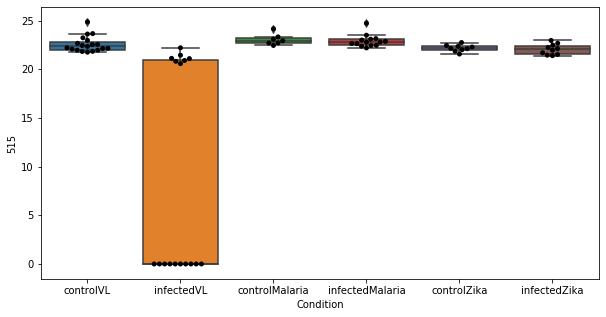

289 row m/z                742.574
row retention time     3.21016
p-val                 0.618038
adj.P.Val             0.999793
custom_id                 2951
compound_names             NaN
Name: 2951, dtype: object


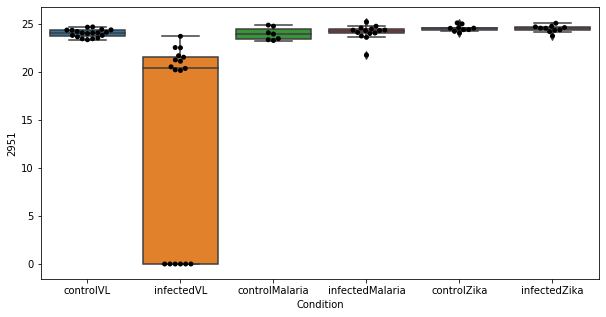

290 row m/z                758.569
row retention time     3.21358
p-val                 0.618484
adj.P.Val             0.999793
custom_id                 2970
compound_names             NaN
Name: 2970, dtype: object


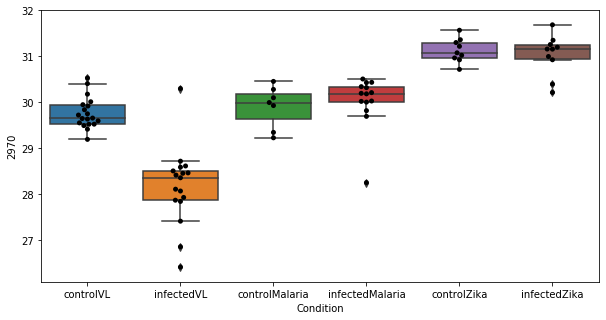

291 row m/z                191.164
row retention time     3.60632
p-val                 0.620303
adj.P.Val             0.999793
custom_id                 1311
compound_names             NaN
Name: 1311, dtype: object


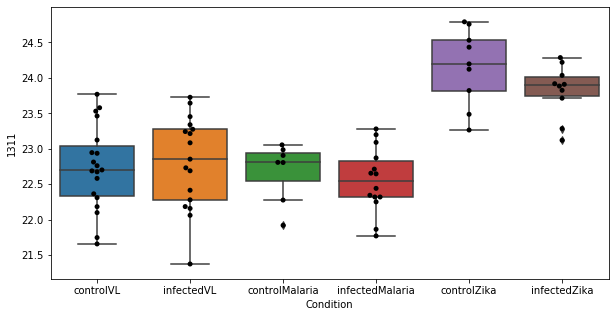

292 row m/z                627.535
row retention time     3.00661
p-val                 0.621582
adj.P.Val             0.999793
custom_id                 2879
compound_names             NaN
Name: 2879, dtype: object


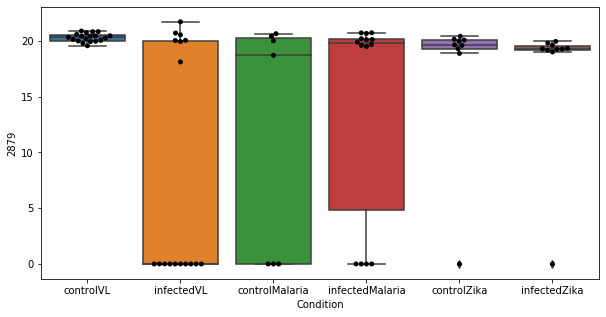

293 row m/z                734.569
row retention time     3.22582
p-val                 0.621834
adj.P.Val             0.999793
custom_id                 2945
compound_names             NaN
Name: 2945, dtype: object


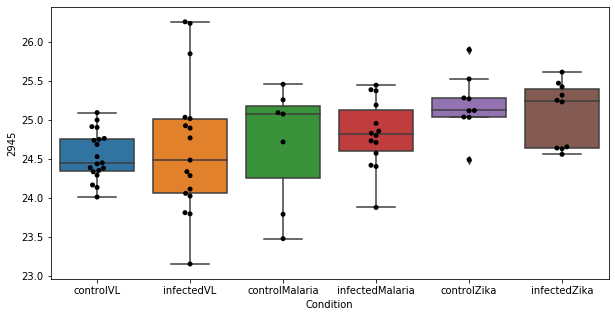

294 row m/z                594.509
row retention time     2.97821
p-val                  0.62575
adj.P.Val             0.999793
custom_id                 2854
compound_names             NaN
Name: 2854, dtype: object


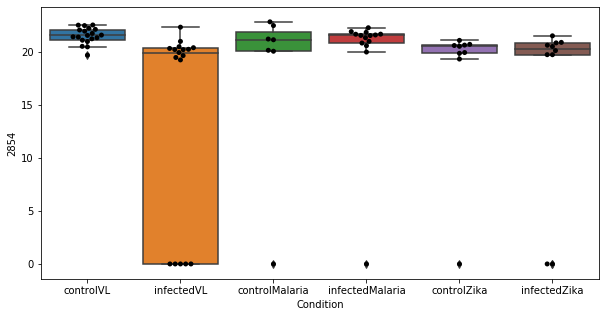

295 row m/z                           219.142
row retention time                8.41412
p-val                            0.627989
adj.P.Val                        0.999793
custom_id                            1686
compound_names        propionyl-carnitine
Name: 1686, dtype: object


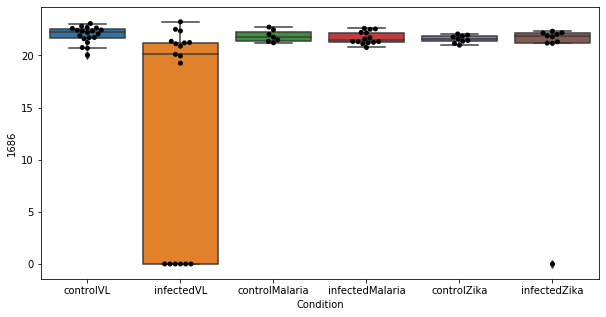

296 row m/z                 729.59
row retention time     3.38676
p-val                 0.628334
adj.P.Val             0.999793
custom_id                 2930
compound_names             NaN
Name: 2930, dtype: object


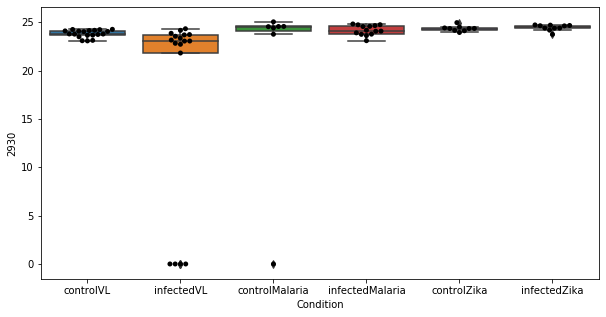

297 row m/z                218.211
row retention time     6.69938
p-val                 0.628683
adj.P.Val             0.999793
custom_id                 1669
compound_names             NaN
Name: 1669, dtype: object


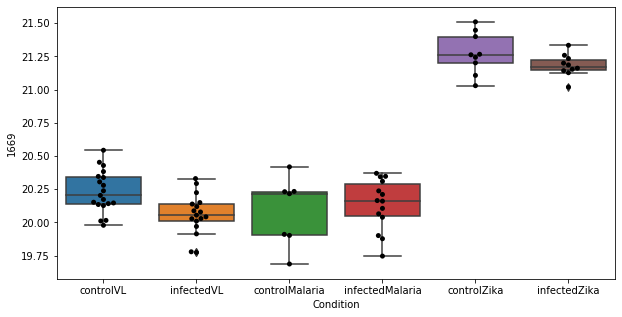

298 row m/z                                                         104.053
row retention time                                              9.80155
p-val                                                          0.630244
adj.P.Val                                                      0.999793
custom_id                                                           137
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 137, dtype: object


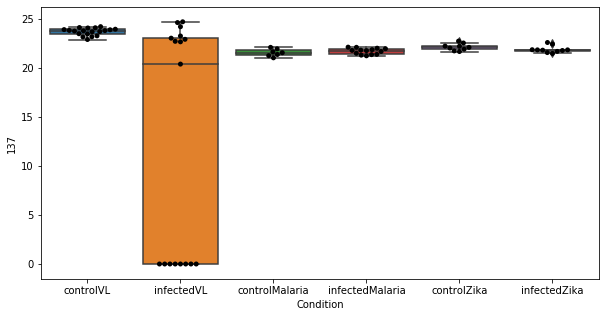

299 row m/z                 216.16
row retention time      4.3132
p-val                 0.630535
adj.P.Val             0.999793
custom_id                 1638
compound_names             NaN
Name: 1638, dtype: object


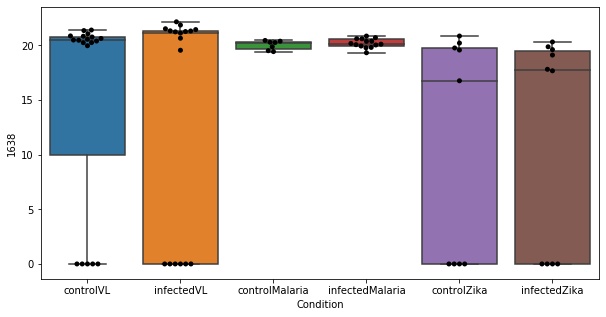

300 row m/z                181.163
row retention time     3.80665
p-val                 0.631906
adj.P.Val             0.999793
custom_id                 1177
compound_names             NaN
Name: 1177, dtype: object


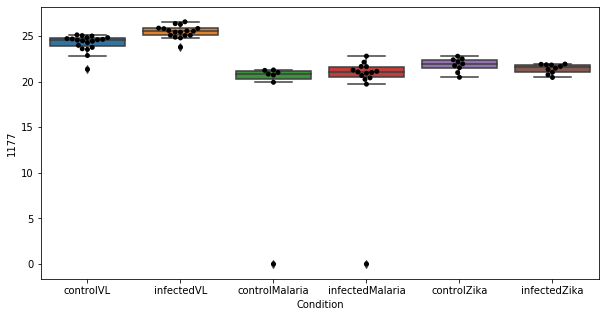

301 row m/z                743.577
row retention time     3.20198
p-val                 0.633272
adj.P.Val             0.999793
custom_id                 2952
compound_names             NaN
Name: 2952, dtype: object


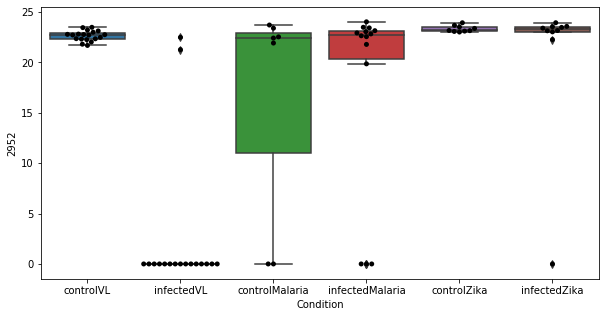

302 row m/z                808.583
row retention time     3.16917
p-val                 0.633403
adj.P.Val             0.999793
custom_id                 3068
compound_names             NaN
Name: 3068, dtype: object


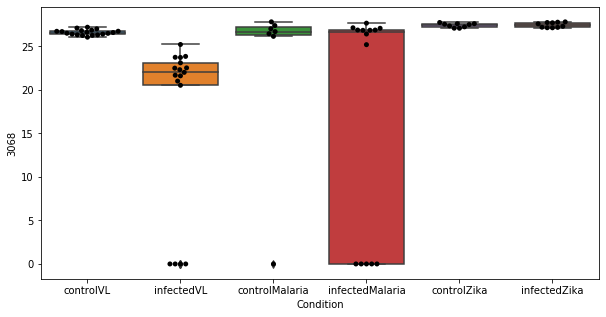

303 row m/z                521.343
row retention time     3.78543
p-val                 0.636431
adj.P.Val             0.999793
custom_id                 2791
compound_names             NaN
Name: 2791, dtype: object


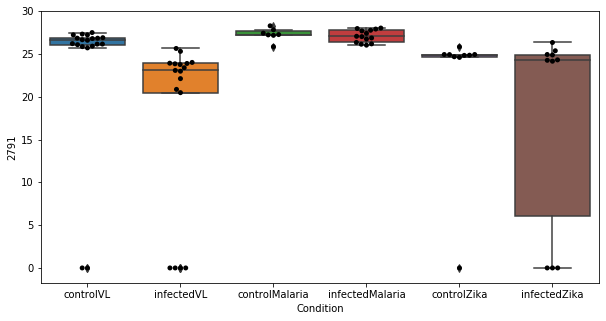

304 row m/z                558.473
row retention time     3.04166
p-val                 0.636667
adj.P.Val             0.999793
custom_id                 2826
compound_names             NaN
Name: 2826, dtype: object


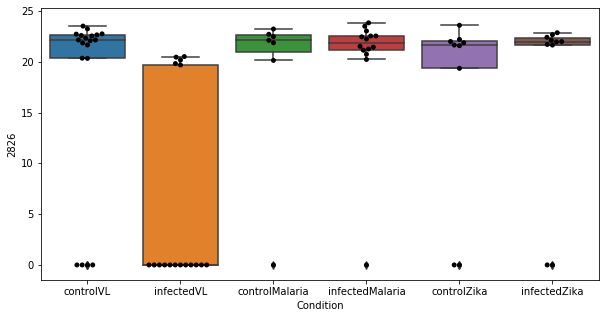

305 row m/z                783.572
row retention time     3.20447
p-val                 0.644611
adj.P.Val             0.999793
custom_id                 3010
compound_names             NaN
Name: 3010, dtype: object


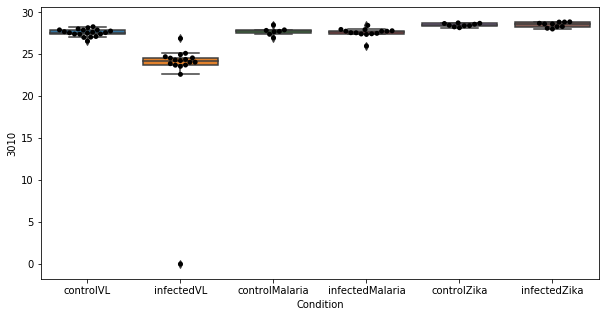

306 row m/z                                                         130.086
row retention time                                              6.71466
p-val                                                          0.645824
adj.P.Val                                                      0.999793
custom_id                                                           424
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 424, dtype: object


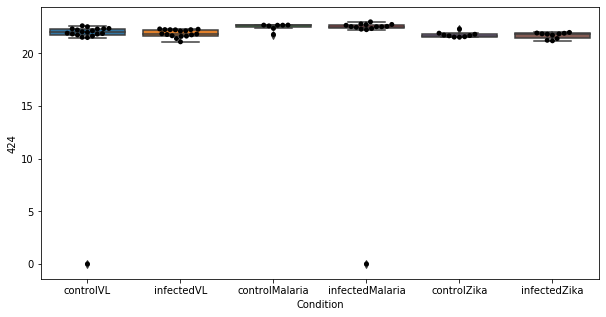

307 row m/z                469.389
row retention time     3.15979
p-val                 0.646817
adj.P.Val             0.999793
custom_id                 2744
compound_names             NaN
Name: 2744, dtype: object


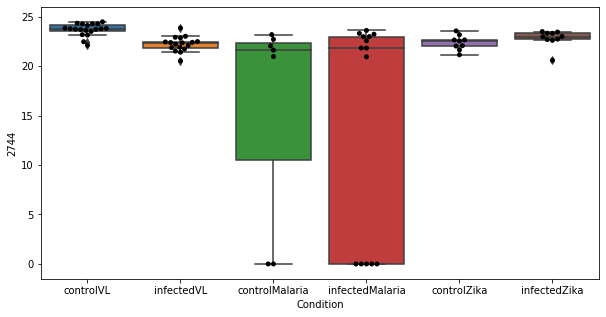

308 row m/z                                                         183.102
row retention time                                              6.70204
p-val                                                          0.649783
adj.P.Val                                                      0.999793
custom_id                                                          1192
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1192, dtype: object


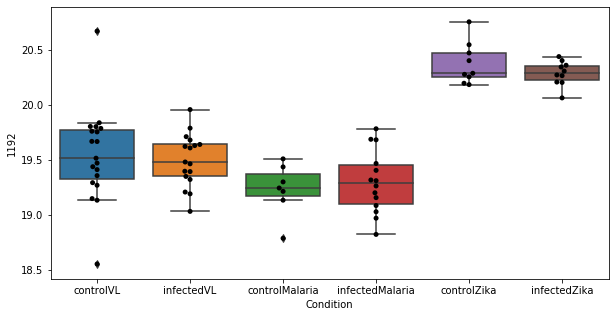

309 row m/z                796.619
row retention time     3.17773
p-val                 0.652228
adj.P.Val             0.999793
custom_id                 3045
compound_names             NaN
Name: 3045, dtype: object


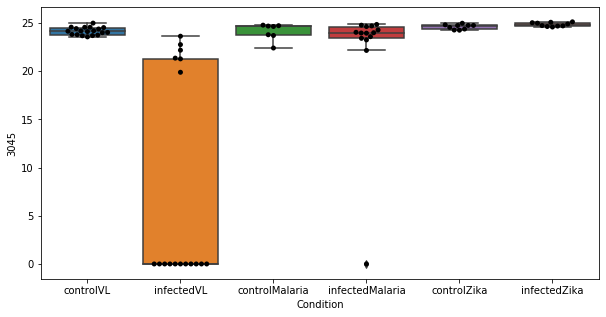

310 row m/z                 520.34
row retention time      3.7647
p-val                  0.65255
adj.P.Val             0.999793
custom_id                 2789
compound_names             NaN
Name: 2789, dtype: object


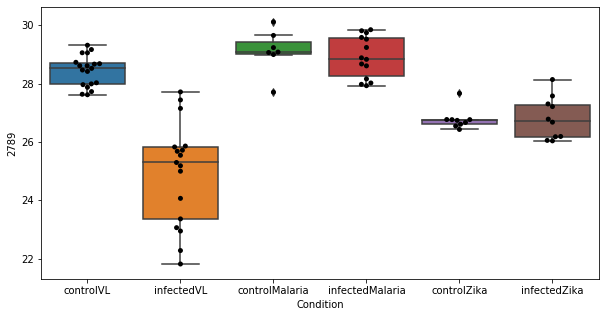

311 row m/z                194.092
row retention time     6.79009
p-val                 0.652552
adj.P.Val             0.999793
custom_id                 1351
compound_names             NaN
Name: 1351, dtype: object


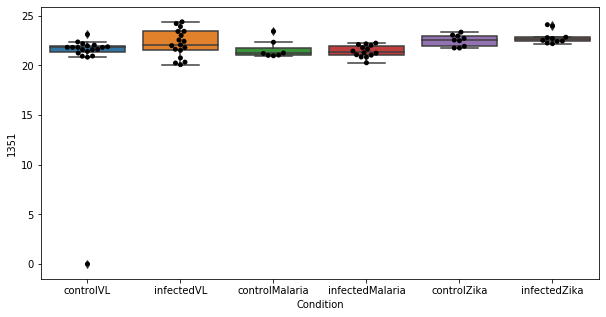

312 row m/z                766.574
row retention time     3.19285
p-val                 0.653705
adj.P.Val             0.999793
custom_id                 2983
compound_names             NaN
Name: 2983, dtype: object


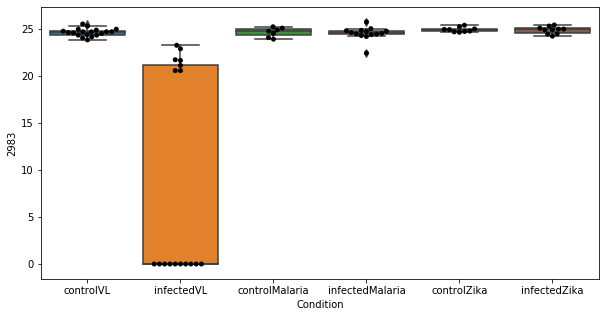

313 row m/z                102.066
row retention time     9.64807
p-val                 0.653936
adj.P.Val             0.999793
custom_id                  123
compound_names             NaN
Name: 123, dtype: object


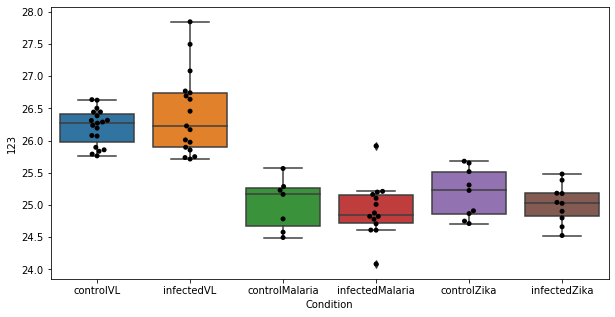

314 row m/z                                                         130.069
row retention time                                               11.738
p-val                                                          0.654603
adj.P.Val                                                      0.999793
custom_id                                                           420
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 420, dtype: object


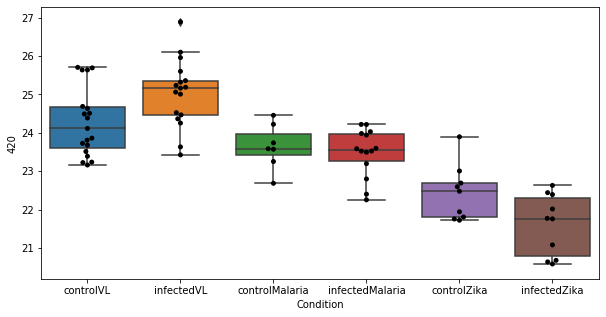

315 row m/z                788.612
row retention time     3.18832
p-val                 0.655123
adj.P.Val             0.999793
custom_id                 3028
compound_names             NaN
Name: 3028, dtype: object


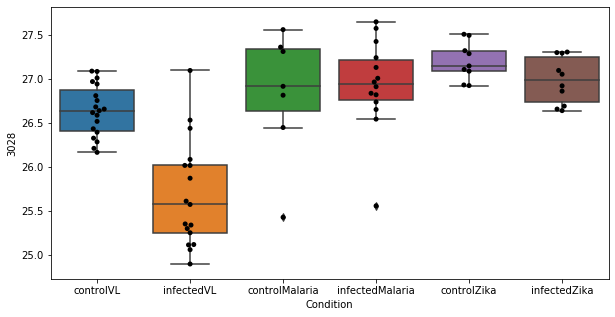

316 row m/z                                                         183.085
row retention time                                              10.8254
p-val                                                          0.657181
adj.P.Val                                                      0.999793
custom_id                                                          1190
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1190, dtype: object


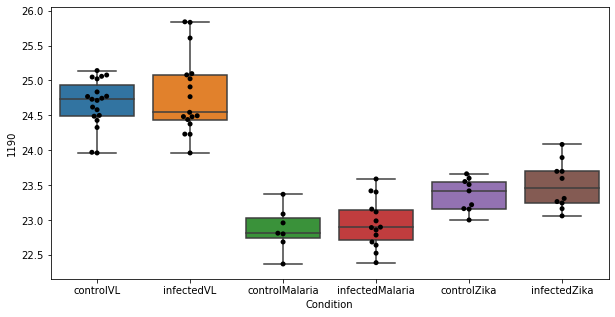

317 row m/z                144.102
row retention time     10.3128
p-val                 0.658673
adj.P.Val             0.999793
custom_id                  635
compound_names             NaN
Name: 635, dtype: object


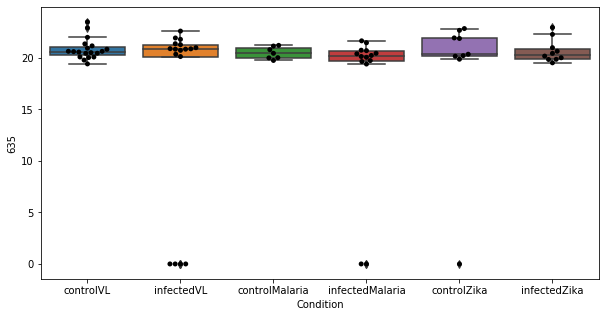

318 row m/z                                                         101.071
row retention time                                              11.9351
p-val                                                           0.66052
adj.P.Val                                                      0.999793
custom_id                                                           113
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 113, dtype: object


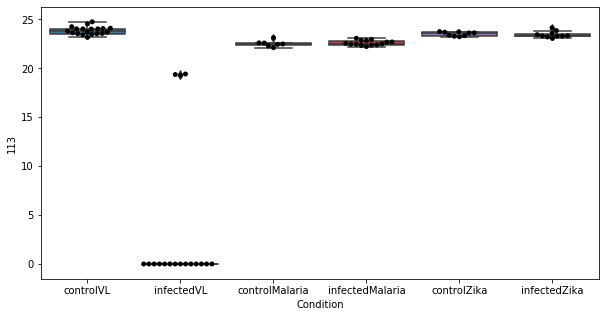

319 row m/z                542.323
row retention time     3.78322
p-val                 0.663391
adj.P.Val             0.999793
custom_id                 2814
compound_names             NaN
Name: 2814, dtype: object


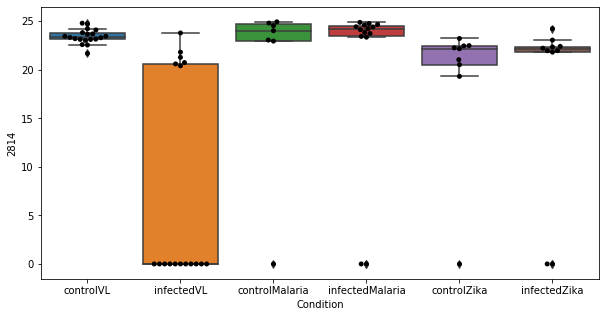

320 row m/z                 118.12
row retention time     10.4025
p-val                 0.663608
adj.P.Val             0.999793
custom_id                  286
compound_names             NaN
Name: 286, dtype: object


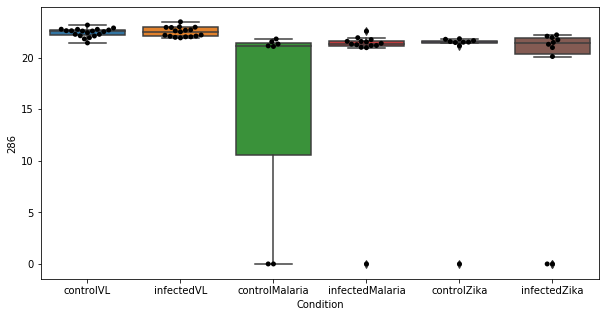

321 row m/z                                                          106.05
row retention time                                              12.4685
p-val                                                          0.664511
adj.P.Val                                                      0.999793
custom_id                                                           174
compound_names        L-Serine; L-2-Amino-3-hydroxypropionic acid; L...
Name: 174, dtype: object


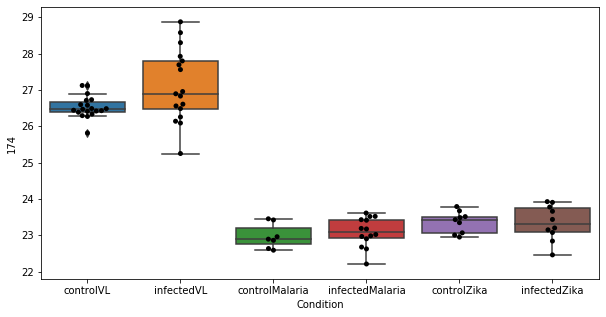

322 row m/z                759.572
row retention time     3.21587
p-val                 0.671665
adj.P.Val             0.999793
custom_id                 2971
compound_names             NaN
Name: 2971, dtype: object


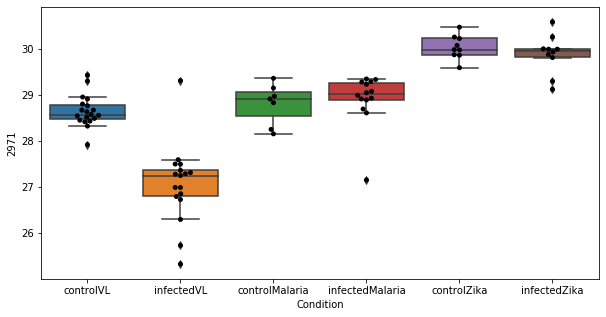

323 row m/z                      198.113
row retention time           4.38443
p-val                       0.673141
adj.P.Val                   0.999793
custom_id                       1396
compound_names        L-Metanephrine
Name: 1396, dtype: object


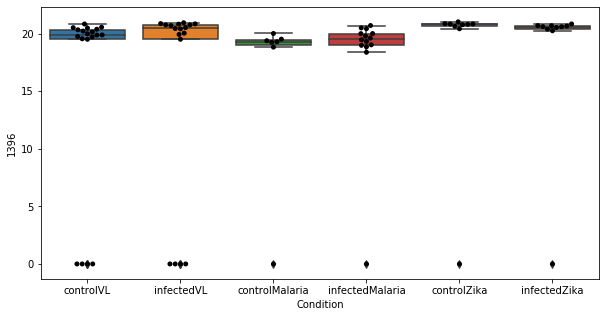

324 row m/z                213.123
row retention time      6.7136
p-val                 0.673277
adj.P.Val             0.999793
custom_id                 1592
compound_names             NaN
Name: 1592, dtype: object


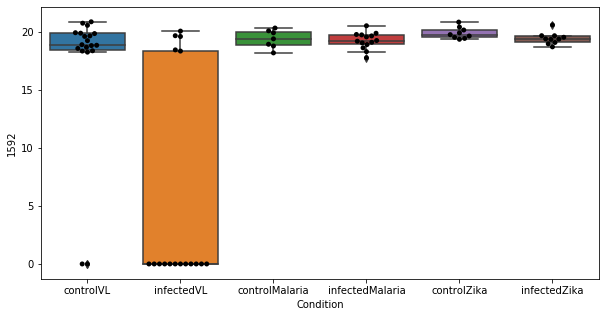

325 row m/z                168.123
row retention time     6.69643
p-val                 0.674176
adj.P.Val             0.999793
custom_id                 1005
compound_names             NaN
Name: 1005, dtype: object


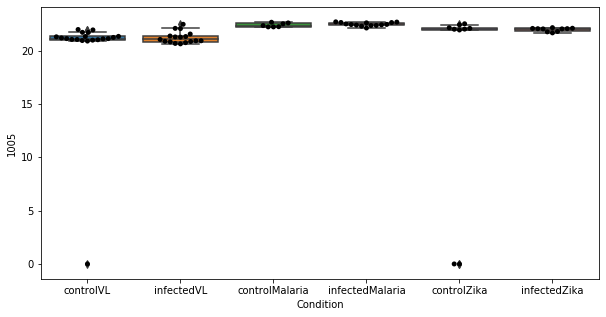

326 row m/z                                                         175.108
row retention time                                              10.8436
p-val                                                          0.675576
adj.P.Val                                                      0.999793
custom_id                                                          1108
compound_names        (+)-trans-Carveol; (4S,6R)-trans-Carveol$Peril...
Name: 1108, dtype: object


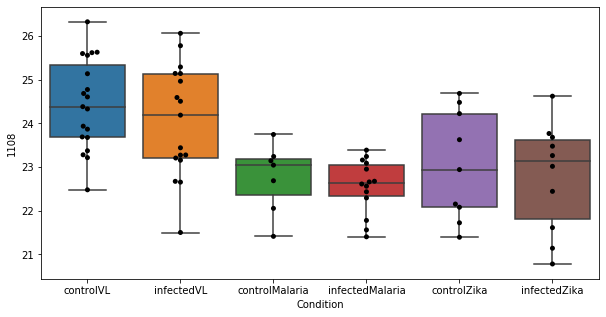

327 row m/z                272.185
row retention time     3.48876
p-val                 0.675943
adj.P.Val             0.999793
custom_id                 2185
compound_names             NaN
Name: 2185, dtype: object


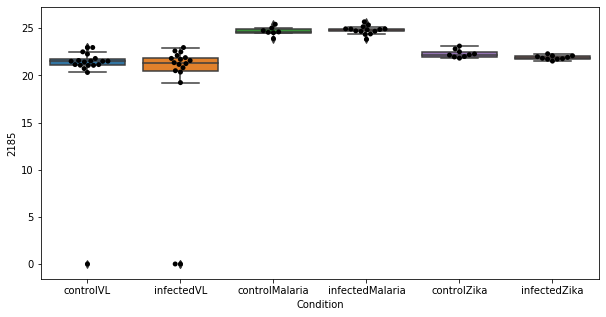

328 row m/z                243.948
row retention time     10.0775
p-val                 0.675991
adj.P.Val             0.999793
custom_id                 5027
compound_names             NaN
Name: 5027, dtype: object


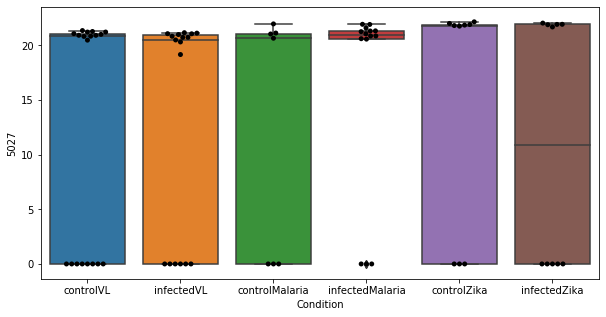

329 row m/z                                                        174.113
row retention time                                             6.71072
p-val                                                         0.676689
adj.P.Val                                                     0.999793
custom_id                                                         1090
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1090, dtype: object


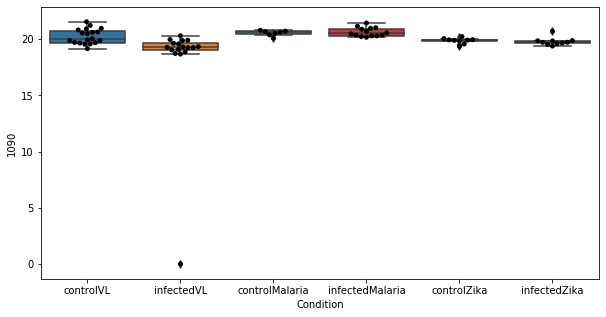

330 row m/z                173.129
row retention time     9.28048
p-val                 0.677529
adj.P.Val             0.999793
custom_id                 1080
compound_names             NaN
Name: 1080, dtype: object


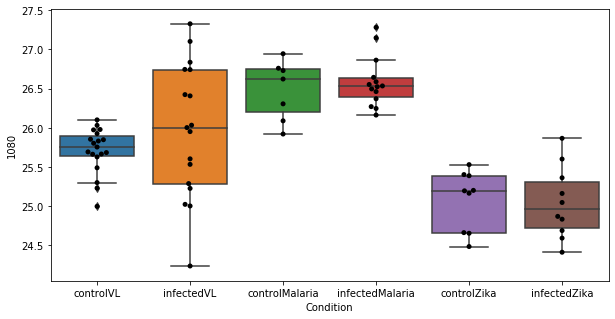

331 row m/z                689.559
row retention time      3.4459
p-val                  0.67864
adj.P.Val             0.999793
custom_id                 2910
compound_names             NaN
Name: 2910, dtype: object


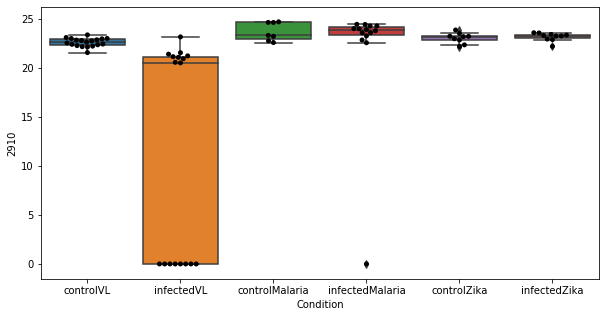

332 row m/z                619.491
row retention time     2.92792
p-val                 0.678722
adj.P.Val             0.999793
custom_id                 2876
compound_names             NaN
Name: 2876, dtype: object


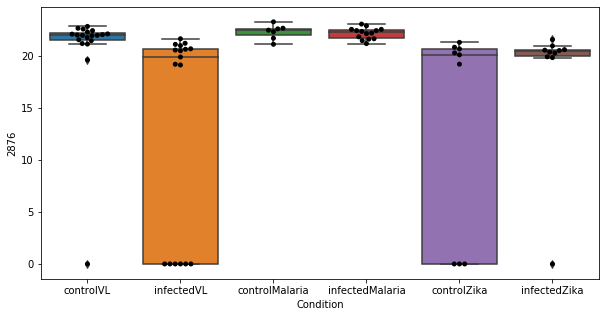

333 row m/z                                                         138.055
row retention time                                              9.88574
p-val                                                          0.681921
adj.P.Val                                                      0.999793
custom_id                                                           550
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 550, dtype: object


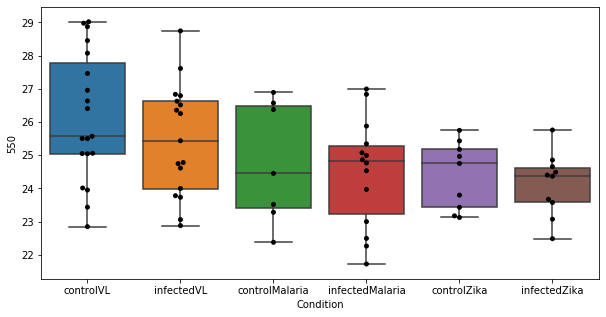

334 row m/z                217.107
row retention time     3.71855
p-val                 0.683018
adj.P.Val             0.999793
custom_id                 1648
compound_names             NaN
Name: 1648, dtype: object


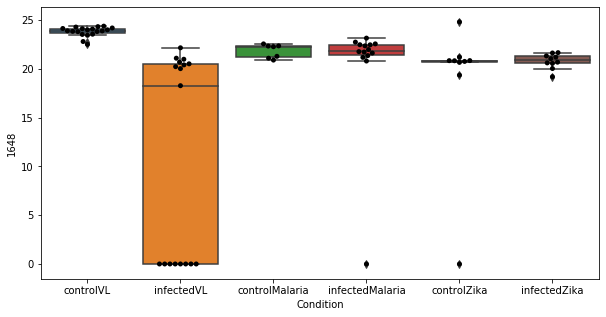

335 row m/z                261.121
row retention time     6.69969
p-val                 0.683835
adj.P.Val             0.999793
custom_id                 2108
compound_names             NaN
Name: 2108, dtype: object


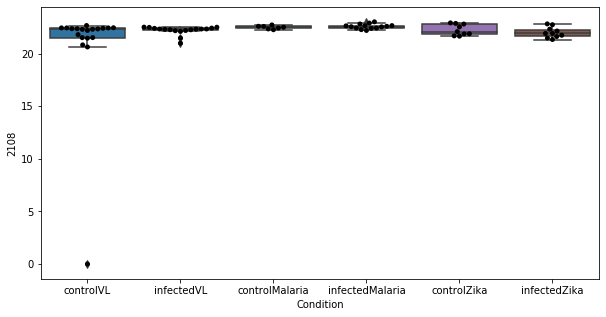

336 row m/z                148.097
row retention time     3.80394
p-val                 0.684369
adj.P.Val             0.999793
custom_id                  717
compound_names             NaN
Name: 717, dtype: object


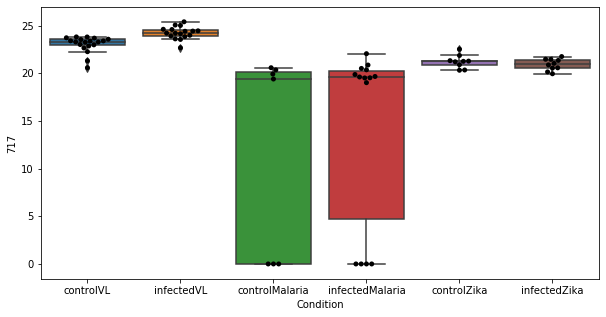

337 row m/z                794.605
row retention time     3.17332
p-val                 0.685348
adj.P.Val             0.999793
custom_id                 3040
compound_names             NaN
Name: 3040, dtype: object


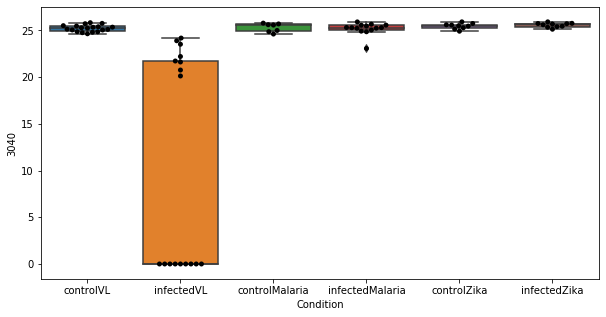

338 row m/z                                                         146.081
row retention time                                               10.355
p-val                                                          0.685444
adj.P.Val                                                      0.999793
custom_id                                                           668
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 668, dtype: object


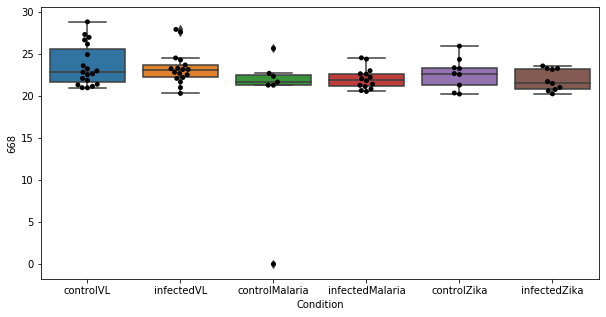

339 row m/z                                                         153.066
row retention time                                              6.75942
p-val                                                          0.687437
adj.P.Val                                                      0.999793
custom_id                                                           784
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 784, dtype: object


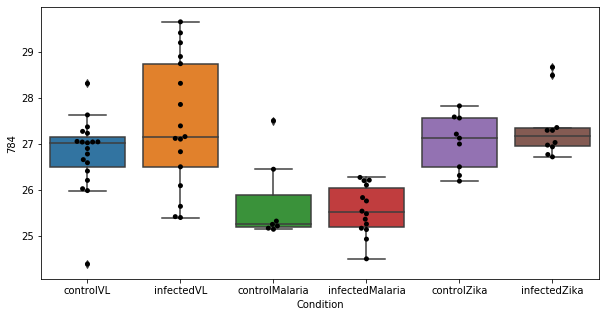

340 row m/z                                                         177.106
row retention time                                              12.4234
p-val                                                           0.68899
adj.P.Val                                                      0.999793
custom_id                                                          1134
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1134, dtype: object


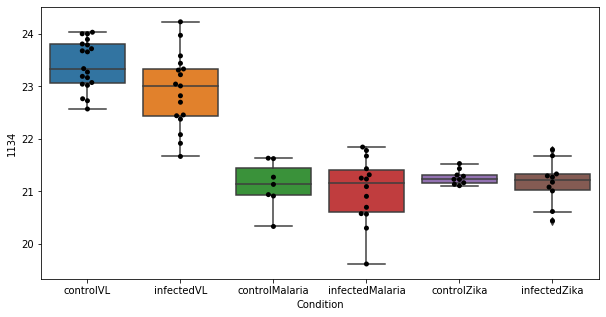

341 row m/z                                                         176.103
row retention time                                              12.4235
p-val                                                          0.690026
adj.P.Val                                                      0.999793
custom_id                                                          1122
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1122, dtype: object


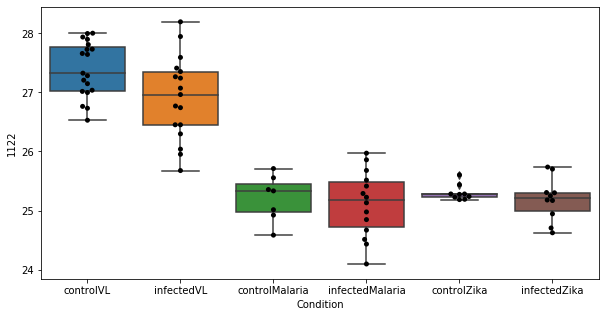

342 row m/z                                                         799.668
row retention time                                              3.29227
p-val                                                          0.691231
adj.P.Val                                                      0.999793
custom_id                                                          3052
compound_names        O-(4-Hydroxy-3,5-diidophenyl)-3,5-diiodo-L-tyr...
Name: 3052, dtype: object


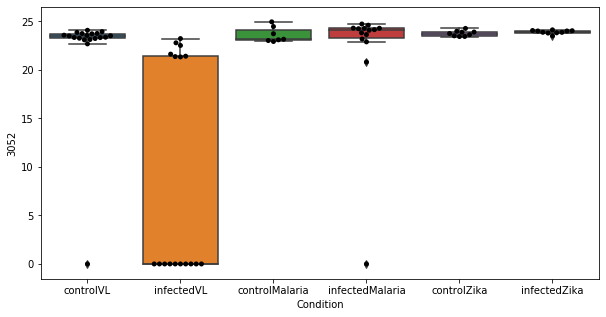

343 row m/z                                                         148.097
row retention time                                              6.83271
p-val                                                          0.691242
adj.P.Val                                                      0.999793
custom_id                                                           715
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 715, dtype: object


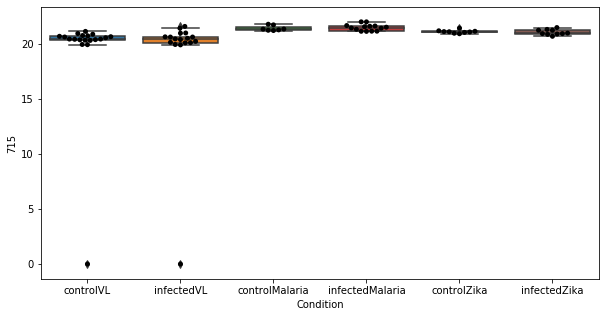

344 row m/z                                                         104.071
row retention time                                              10.2204
p-val                                                          0.692697
adj.P.Val                                                      0.999793
custom_id                                                           138
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 138, dtype: object


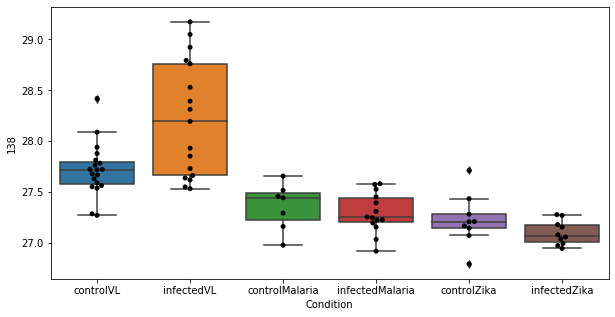

345 row m/z                                                         157.061
row retention time                                              9.81764
p-val                                                          0.696669
adj.P.Val                                                      0.999793
custom_id                                                           839
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 839, dtype: object


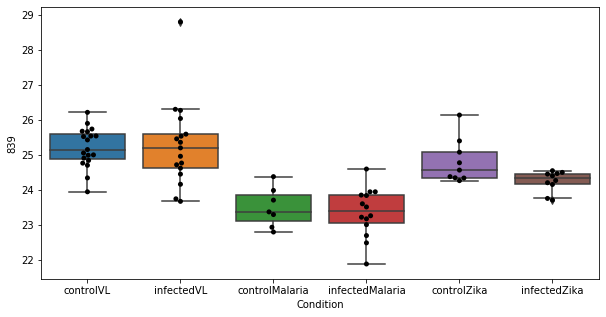

346 row m/z                                                          113.06
row retention time                                              3.46487
p-val                                                          0.696971
adj.P.Val                                                      0.999793
custom_id                                                           217
compound_names        Adipate semialdehyde; Hexan-1-one-6-carboxylat...
Name: 217, dtype: object


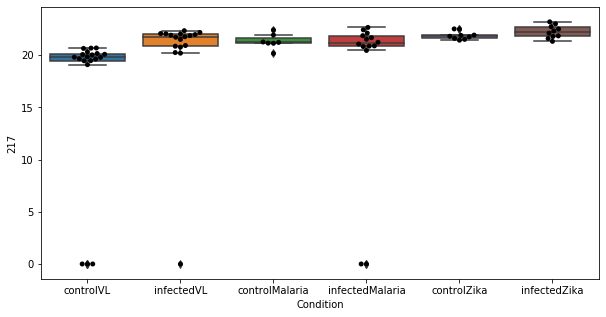

347 row m/z                                                         129.066
row retention time                                              10.9378
p-val                                                          0.697157
adj.P.Val                                                      0.999793
custom_id                                                          4517
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 4517, dtype: object


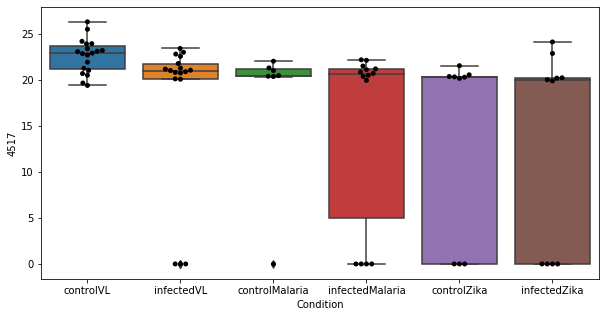

348 row m/z                170.062
row retention time     11.9025
p-val                 0.697651
adj.P.Val             0.999793
custom_id                 1029
compound_names             NaN
Name: 1029, dtype: object


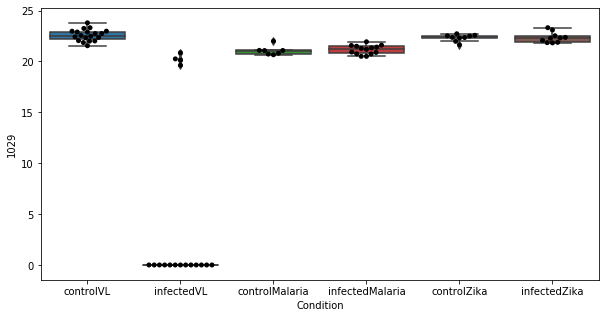

349 row m/z                                                         152.054
row retention time                                              9.80049
p-val                                                          0.701518
adj.P.Val                                                      0.999793
custom_id                                                           772
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 772, dtype: object


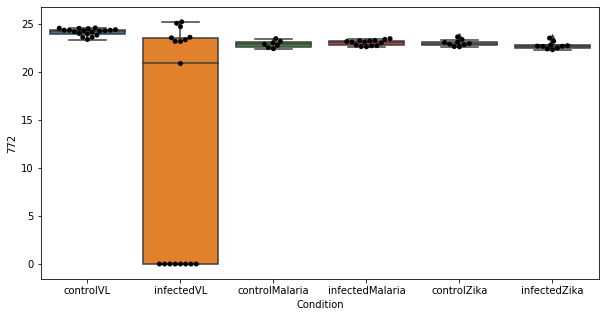

350 row m/z                176.066
row retention time     9.28789
p-val                 0.703608
adj.P.Val             0.999793
custom_id                 1117
compound_names             NaN
Name: 1117, dtype: object


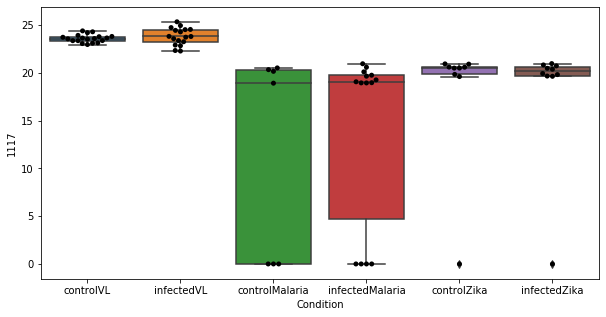

351 row m/z                                                         154.059
row retention time                                              11.7134
p-val                                                          0.704888
adj.P.Val                                                      0.999793
custom_id                                                           792
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 792, dtype: object


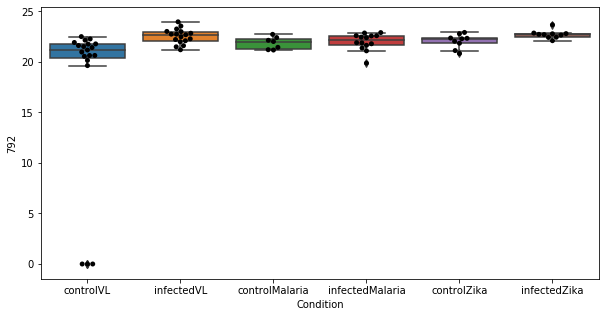

352 row m/z                            107.07
row retention time                3.80811
p-val                            0.705454
adj.P.Val                        0.999793
custom_id                             182
compound_names        1-Methylpyrrolinium
Name: 182, dtype: object


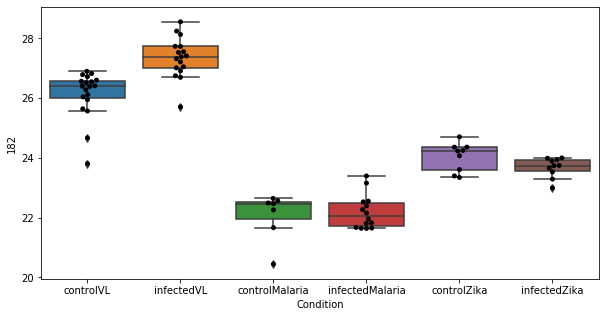

353 row m/z                                 151.062
row retention time                      9.79946
p-val                                  0.706765
adj.P.Val                              0.999793
custom_id                                   760
compound_names        aminochrome o-semiquinone
Name: 760, dtype: object


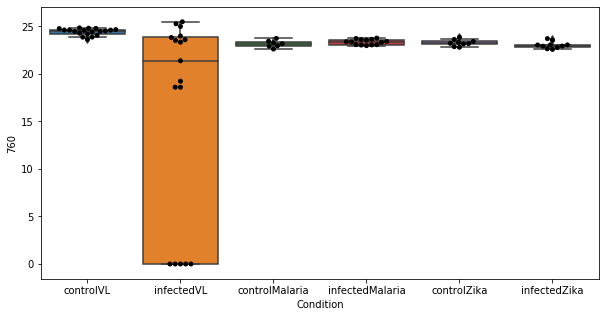

354 row m/z                194.147
row retention time      4.1319
p-val                 0.706808
adj.P.Val             0.999793
custom_id                 1355
compound_names             NaN
Name: 1355, dtype: object


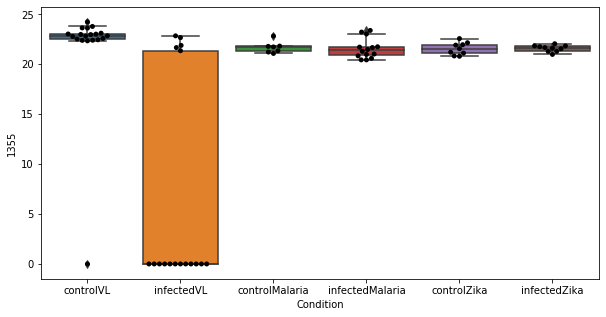

355 row m/z                                                         184.097
row retention time                                              6.71111
p-val                                                          0.709295
adj.P.Val                                                      0.999793
custom_id                                                          1205
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 1205, dtype: object


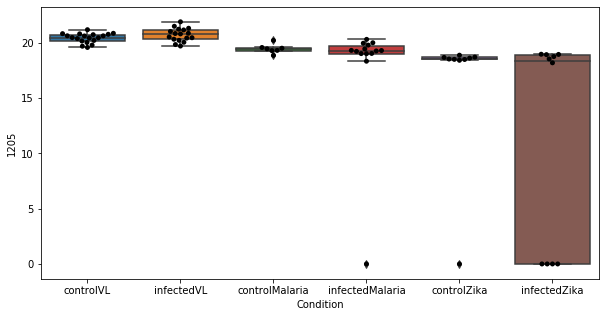

356 row m/z                117.091
row retention time     4.12309
p-val                 0.709673
adj.P.Val             0.999793
custom_id                  267
compound_names             NaN
Name: 267, dtype: object


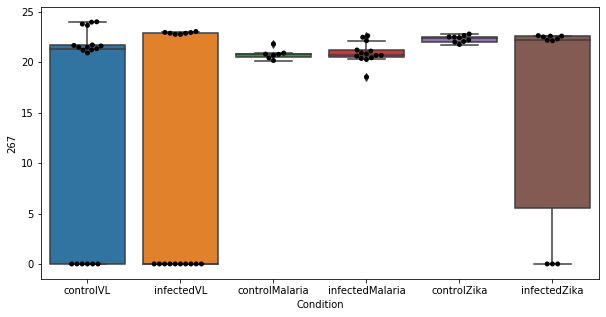

357 row m/z                140.011
row retention time     3.36234
p-val                 0.709714
adj.P.Val             0.999793
custom_id                  563
compound_names             NaN
Name: 563, dtype: object


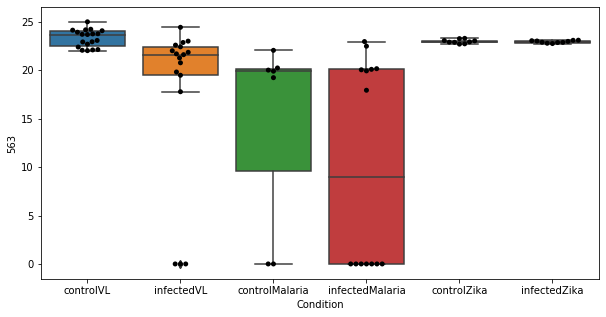

358 row m/z                205.144
row retention time     3.48202
p-val                 0.714379
adj.P.Val             0.999793
custom_id                 1504
compound_names             NaN
Name: 1504, dtype: object


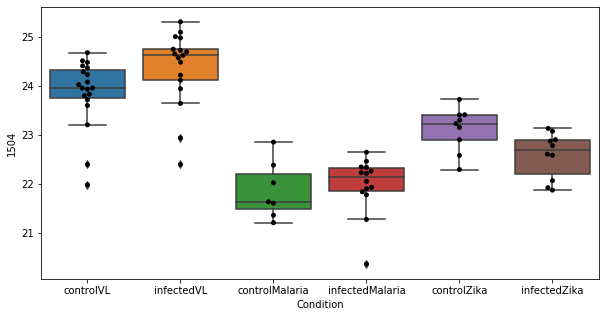

359 row m/z                236.113
row retention time     3.48747
p-val                  0.71476
adj.P.Val             0.999793
custom_id                 1875
compound_names             NaN
Name: 1875, dtype: object


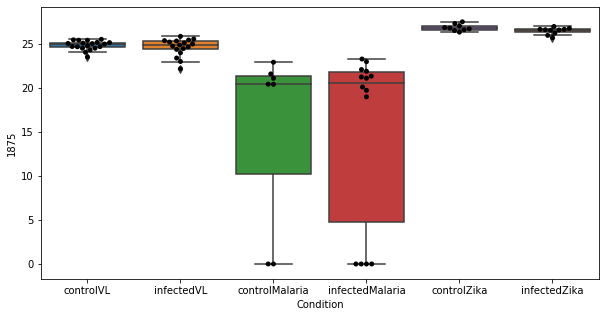

360 row m/z                           218.139
row retention time                8.41637
p-val                            0.716462
adj.P.Val                        0.999793
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object


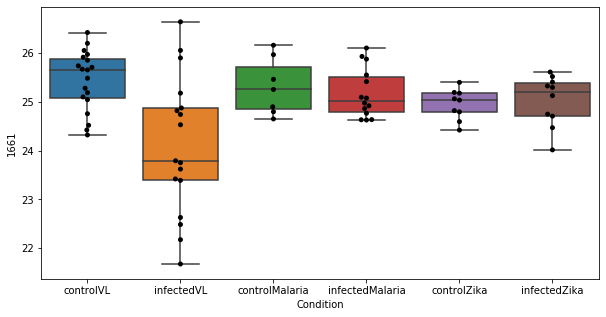

361 row m/z                                                         104.107
row retention time                                              6.57923
p-val                                                          0.718026
adj.P.Val                                                      0.999793
custom_id                                                           143
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 143, dtype: object


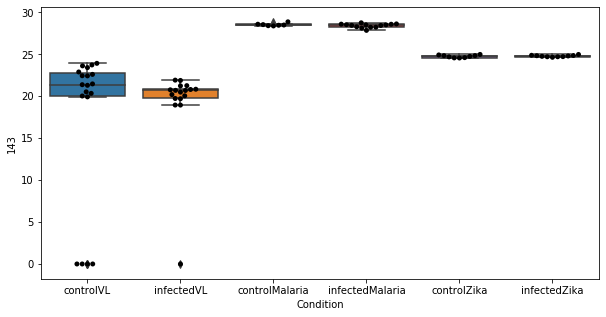

362 row m/z                106.086
row retention time     9.50445
p-val                 0.718125
adj.P.Val             0.999793
custom_id                  175
compound_names             NaN
Name: 175, dtype: object


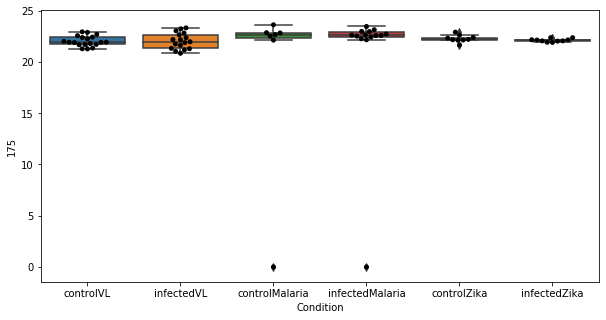

363 row m/z                                                         297.242
row retention time                                              3.21416
p-val                                                          0.718979
adj.P.Val                                                      0.999793
custom_id                                                          2360
compound_names        13(S)-HODE; (13S)-Hydroxyoctadecadienoic acid;...
Name: 2360, dtype: object


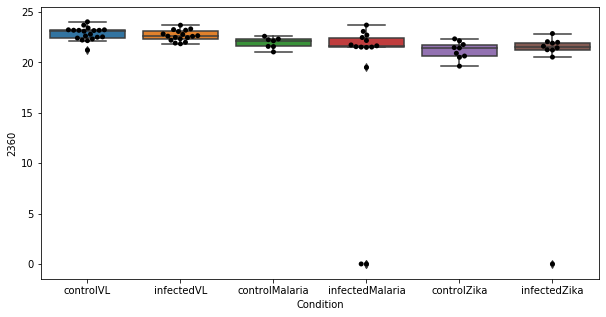

364 row m/z                 301.99
row retention time     10.4033
p-val                 0.719456
adj.P.Val             0.999793
custom_id                 2381
compound_names             NaN
Name: 2381, dtype: object


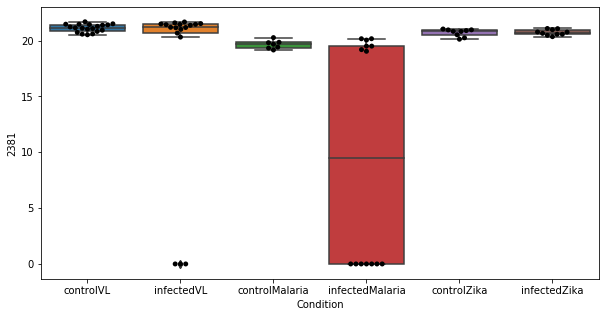

365 row m/z                744.553
row retention time       3.195
p-val                 0.722029
adj.P.Val             0.999793
custom_id                 2954
compound_names             NaN
Name: 2954, dtype: object


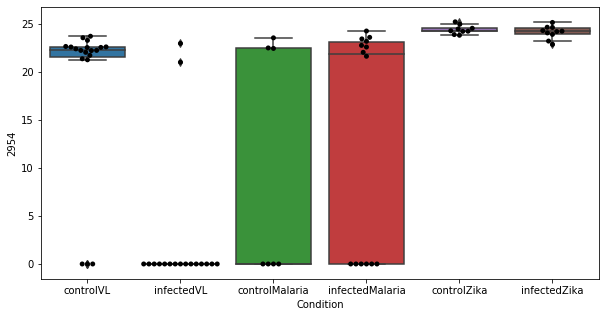

366 row m/z                787.604
row retention time     3.18287
p-val                 0.725478
adj.P.Val             0.999793
custom_id                 3024
compound_names             NaN
Name: 3024, dtype: object


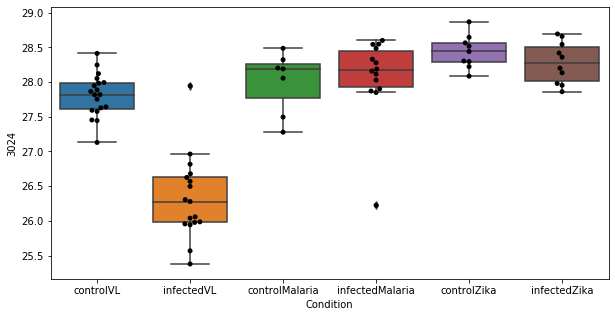

367 row m/z                                                         182.081
row retention time                                              10.8253
p-val                                                           0.72703
adj.P.Val                                                      0.999793
custom_id                                                          1179
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1179, dtype: object


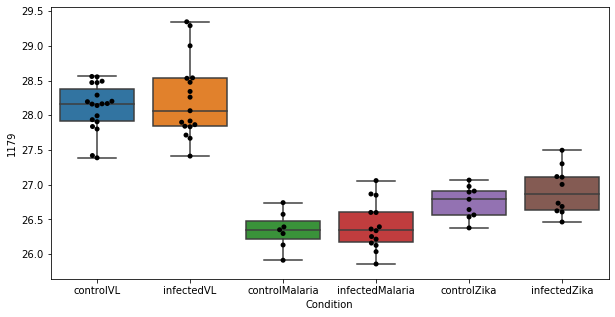

368 row m/z                757.621
row retention time     3.37542
p-val                 0.727416
adj.P.Val             0.999793
custom_id                 2969
compound_names             NaN
Name: 2969, dtype: object


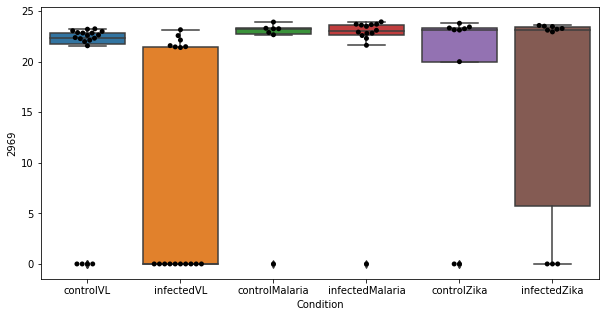

369 row m/z                703.574
row retention time     3.41257
p-val                  0.72748
adj.P.Val             0.999793
custom_id                 2918
compound_names             NaN
Name: 2918, dtype: object


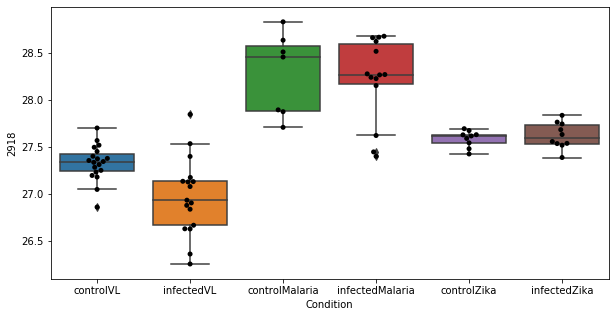

370 row m/z                 202.18
row retention time     6.86563
p-val                 0.728232
adj.P.Val             0.999793
custom_id                 1452
compound_names             NaN
Name: 1452, dtype: object


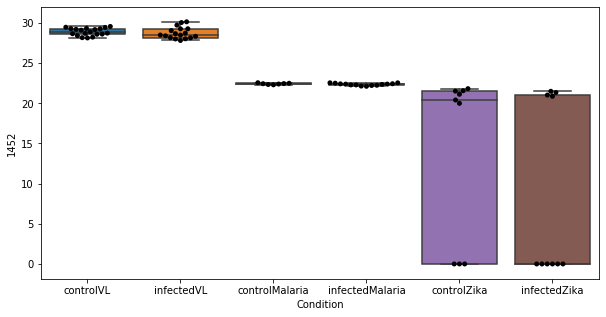

371 row m/z                                                         165.055
row retention time                                              10.8288
p-val                                                          0.732831
adj.P.Val                                                      0.999793
custom_id                                                           960
compound_names        3-Methoxy-4-hydroxyphenylglycolaldehyde$Homova...
Name: 960, dtype: object


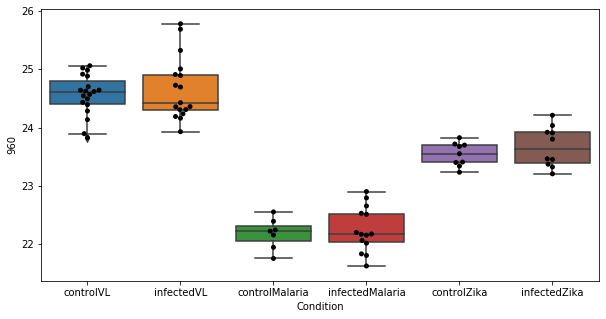

372 row m/z                344.228
row retention time      4.1966
p-val                  0.73546
adj.P.Val             0.999793
custom_id                 2548
compound_names             NaN
Name: 2548, dtype: object


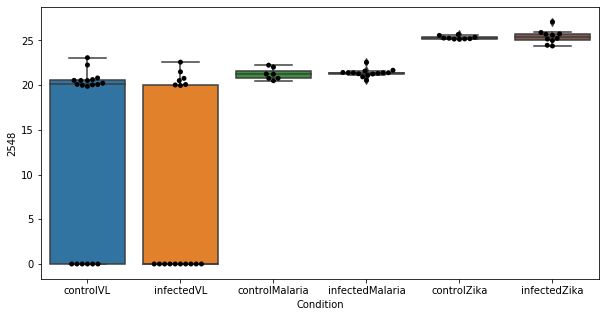

373 row m/z                257.113
row retention time     8.04659
p-val                 0.736438
adj.P.Val             0.999793
custom_id                 2068
compound_names             NaN
Name: 2068, dtype: object


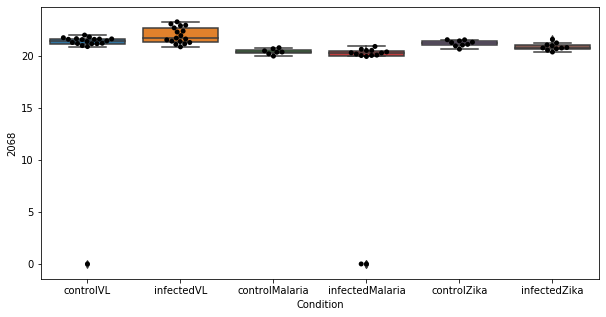

374 row m/z                148.097
row retention time     10.9468
p-val                  0.73831
adj.P.Val             0.999793
custom_id                  719
compound_names             NaN
Name: 719, dtype: object


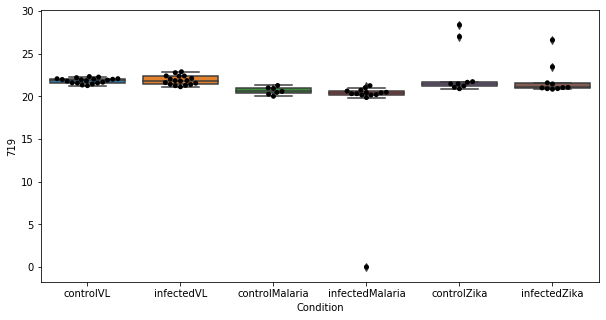

375 row m/z                                                         118.061
row retention time                                              12.5314
p-val                                                          0.738928
adj.P.Val                                                      0.999793
custom_id                                                           273
compound_names        Guanidinoacetate$Guanidinoacetate; Guanidinoac...
Name: 273, dtype: object


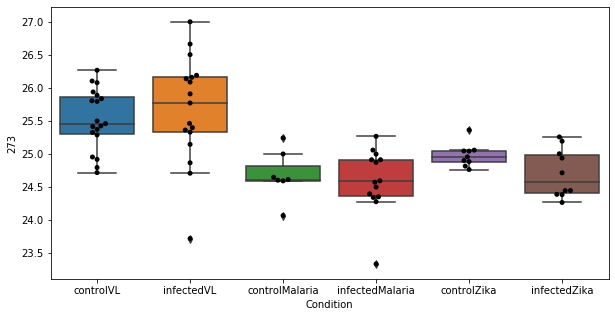

376 row m/z                745.593
row retention time     3.19691
p-val                 0.741292
adj.P.Val             0.999793
custom_id                 2957
compound_names             NaN
Name: 2957, dtype: object


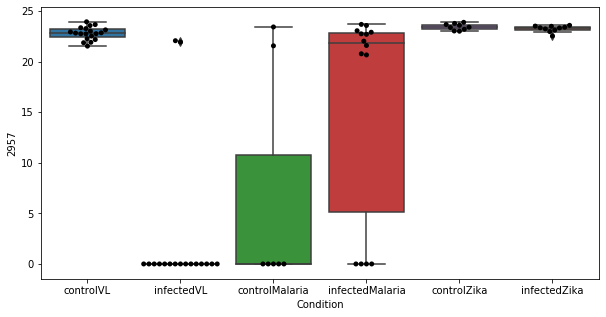

377 row m/z                256.175
row retention time     4.38253
p-val                 0.741826
adj.P.Val             0.999793
custom_id                 2057
compound_names             NaN
Name: 2057, dtype: object


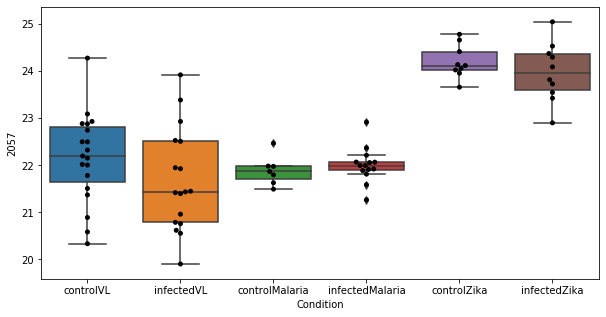

378 row m/z                                138.043
row retention time                      9.0432
p-val                                 0.742482
adj.P.Val                             0.999793
custom_id                                  547
compound_names        Urocanate; Urocanic acid
Name: 547, dtype: object


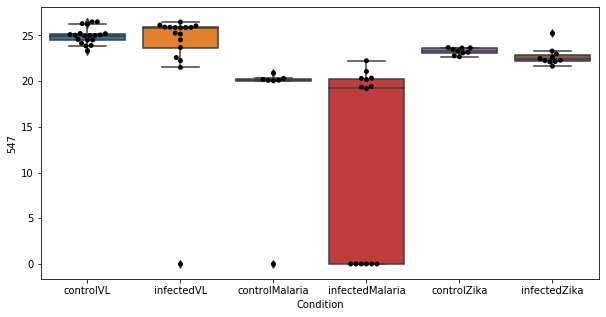

379 row m/z                236.073
row retention time     11.8556
p-val                 0.744731
adj.P.Val             0.999793
custom_id                 1869
compound_names             NaN
Name: 1869, dtype: object


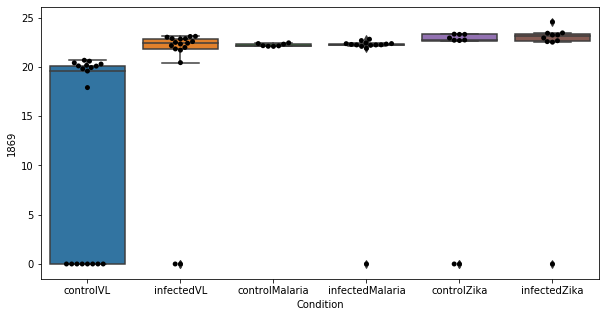

380 row m/z                105.074
row retention time       11.15
p-val                 0.747322
adj.P.Val             0.999793
custom_id                  154
compound_names             NaN
Name: 154, dtype: object


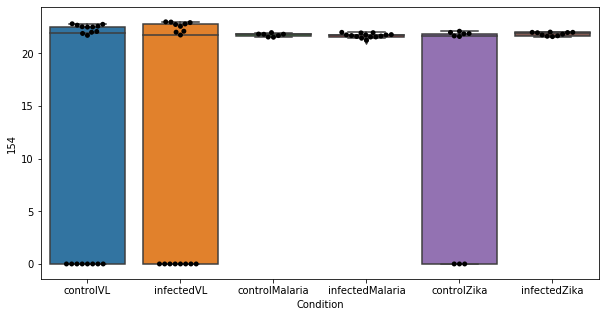

381 row m/z                702.562
row retention time     3.43509
p-val                 0.747425
adj.P.Val             0.999793
custom_id                 2917
compound_names             NaN
Name: 2917, dtype: object


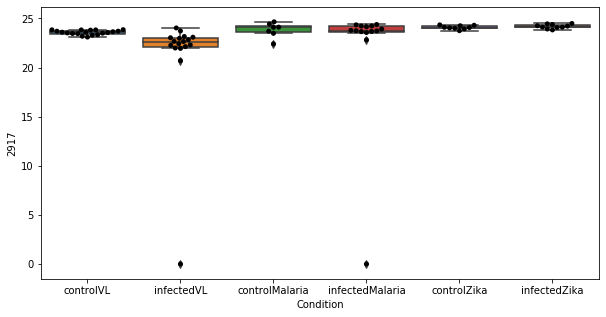

382 row m/z                221.154
row retention time      3.4093
p-val                 0.749075
adj.P.Val             0.999793
custom_id                 1702
compound_names             NaN
Name: 1702, dtype: object


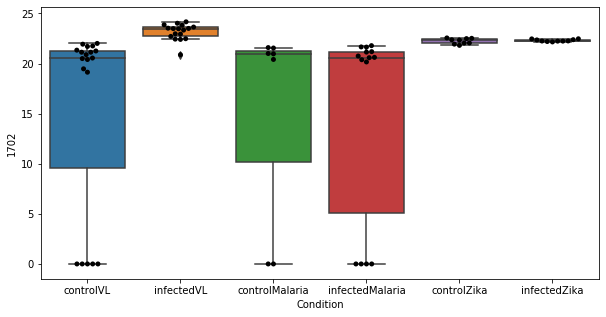

383 row m/z                  149.1
row retention time     10.1924
p-val                 0.751876
adj.P.Val             0.999793
custom_id                 4631
compound_names             NaN
Name: 4631, dtype: object


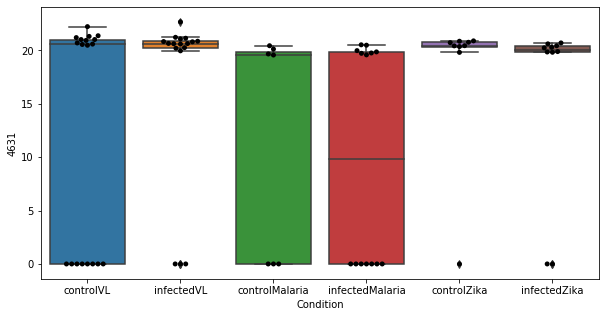

384 row m/z                732.554
row retention time     3.24734
p-val                 0.754368
adj.P.Val             0.999793
custom_id                 2938
compound_names             NaN
Name: 2938, dtype: object


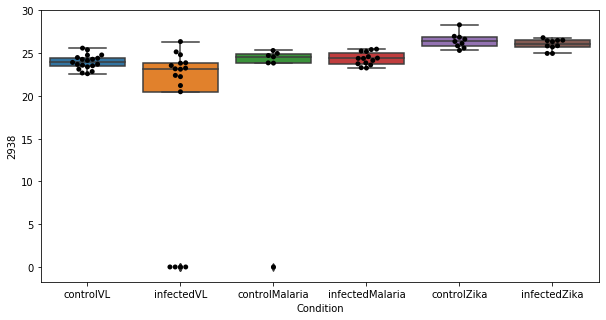

385 row m/z                304.248
row retention time     3.33835
p-val                 0.755043
adj.P.Val             0.999793
custom_id                 2398
compound_names             NaN
Name: 2398, dtype: object


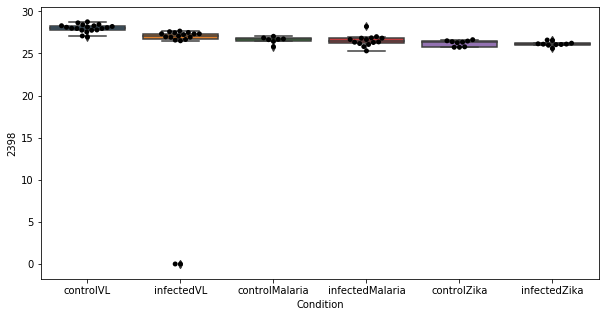

386 row m/z                198.087
row retention time     9.10321
p-val                 0.756876
adj.P.Val             0.999793
custom_id                 1394
compound_names             NaN
Name: 1394, dtype: object


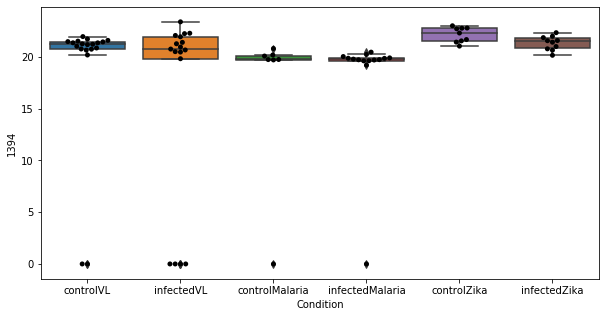

387 row m/z                172.097
row retention time     6.71038
p-val                 0.757968
adj.P.Val             0.999793
custom_id                 1062
compound_names             NaN
Name: 1062, dtype: object


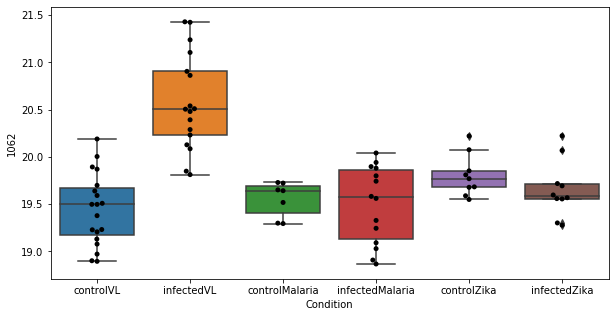

388 row m/z                761.588
row retention time     3.20233
p-val                 0.758087
adj.P.Val             0.999793
custom_id                 2976
compound_names             NaN
Name: 2976, dtype: object


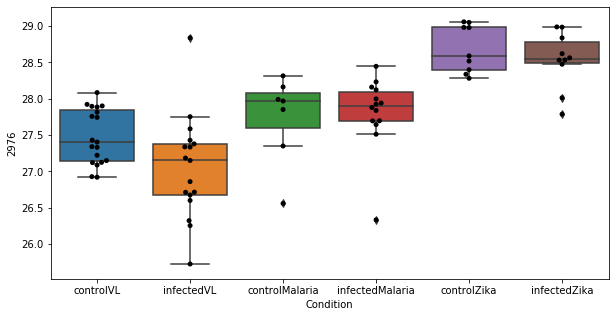

389 row m/z                228.123
row retention time     4.38993
p-val                 0.759708
adj.P.Val             0.999793
custom_id                 1770
compound_names             NaN
Name: 1770, dtype: object


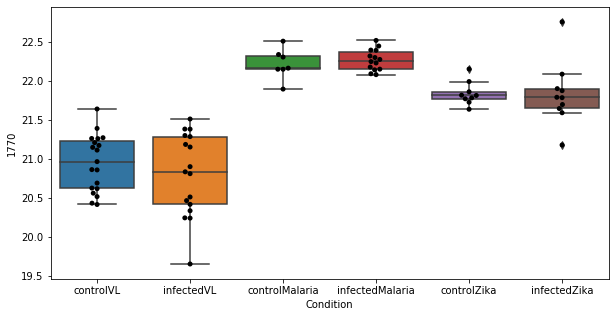

390 row m/z                204.123
row retention time     4.37371
p-val                 0.760585
adj.P.Val             0.999793
custom_id                 1486
compound_names             NaN
Name: 1486, dtype: object


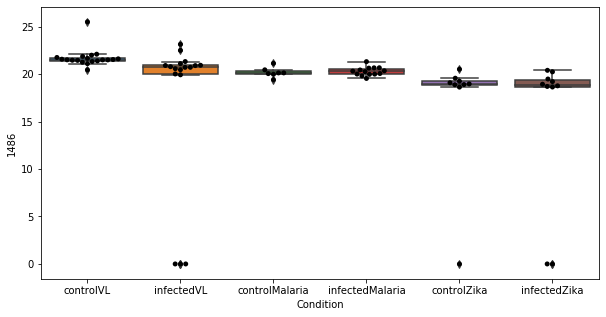

391 row m/z                                                         170.092
row retention time                                              10.5479
p-val                                                          0.761024
adj.P.Val                                                      0.999793
custom_id                                                         10774
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 10774, dtype: object


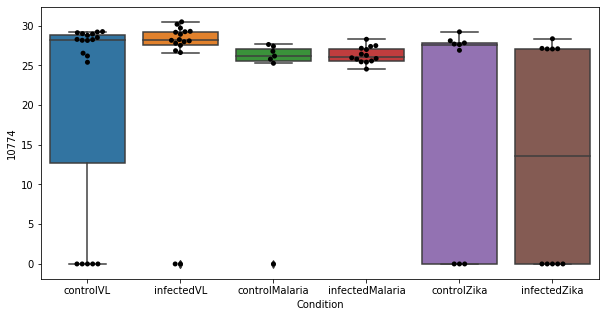

392 row m/z                                                         118.086
row retention time                                              10.4061
p-val                                                          0.761988
adj.P.Val                                                      0.999793
custom_id                                                           280
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 280, dtype: object


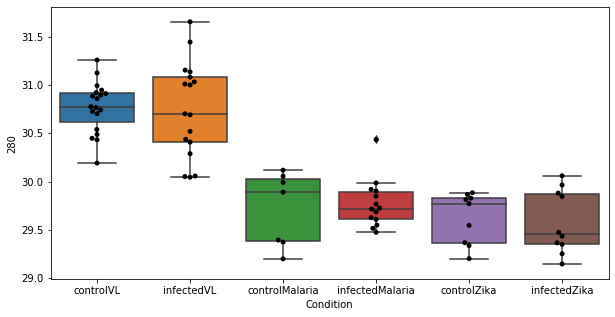

393 row m/z                316.248
row retention time     4.31512
p-val                 0.762581
adj.P.Val             0.999793
custom_id                 2464
compound_names             NaN
Name: 2464, dtype: object


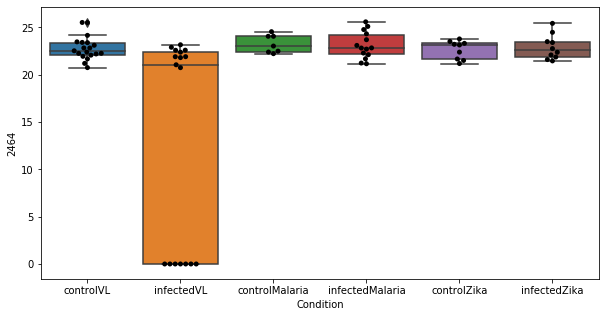

394 row m/z                199.097
row retention time     4.36912
p-val                 0.765043
adj.P.Val             0.999793
custom_id                 1409
compound_names             NaN
Name: 1409, dtype: object


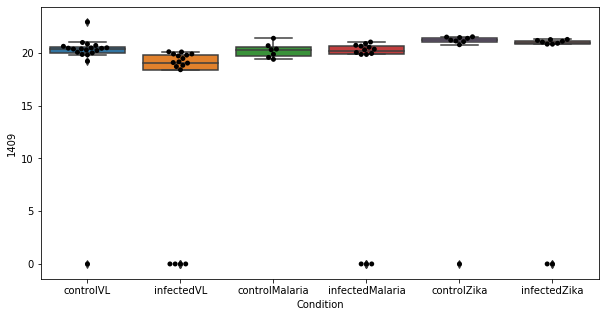

395 row m/z                177.055
row retention time     3.47783
p-val                 0.765241
adj.P.Val             0.999793
custom_id                 1125
compound_names             NaN
Name: 1125, dtype: object


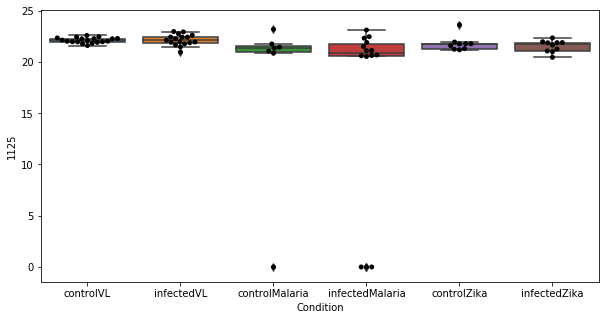

396 row m/z                780.553
row retention time     3.22229
p-val                 0.766755
adj.P.Val             0.999793
custom_id                 3004
compound_names             NaN
Name: 3004, dtype: object


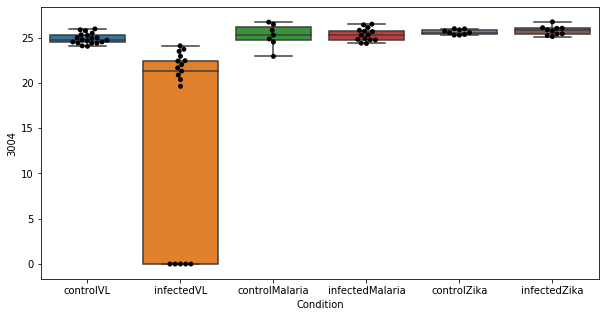

397 row m/z                                                         151.062
row retention time                                              7.64547
p-val                                                          0.767704
adj.P.Val                                                      0.999793
custom_id                                                           761
compound_names        L-Xylulose; L-threo-Pentulose; L-Lyxulose$D-Xy...
Name: 761, dtype: object


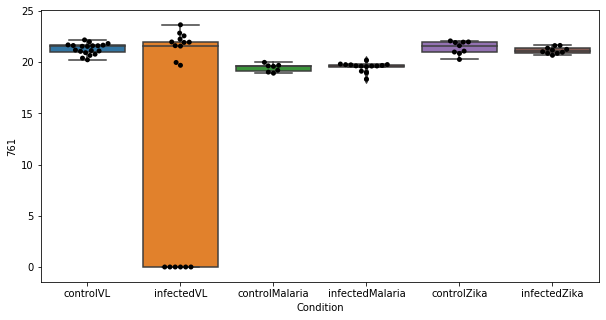

398 row m/z                300.201
row retention time     4.30861
p-val                 0.768704
adj.P.Val             0.999793
custom_id                 2369
compound_names             NaN
Name: 2369, dtype: object


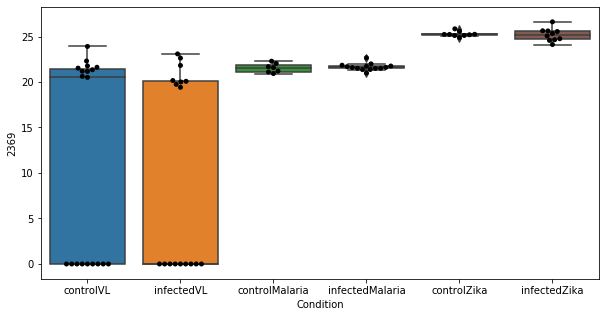

399 row m/z                 172.08
row retention time     11.8965
p-val                 0.769324
adj.P.Val             0.999793
custom_id                 1060
compound_names             NaN
Name: 1060, dtype: object


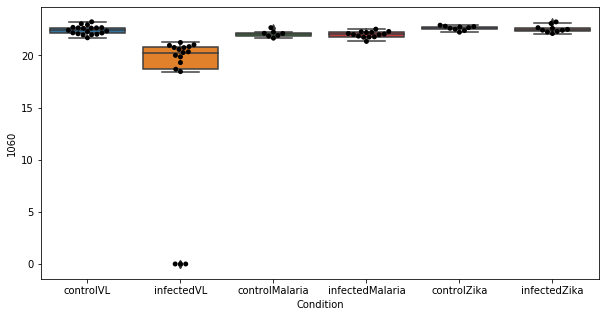

400 row m/z                           288.217
row retention time                6.71058
p-val                             0.76973
adj.P.Val                        0.999793
custom_id                            2309
compound_names        L-Octanoylcarnitine
Name: 2309, dtype: object


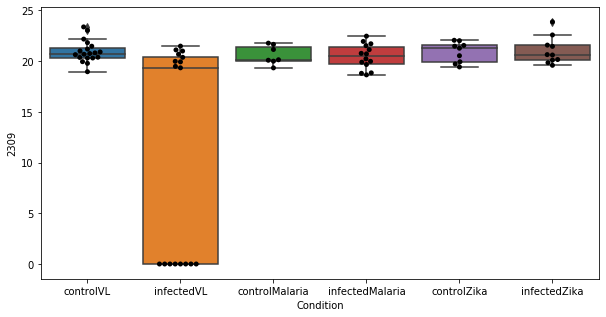

401 row m/z                232.154
row retention time     7.60698
p-val                 0.770165
adj.P.Val             0.999793
custom_id                 1825
compound_names             NaN
Name: 1825, dtype: object


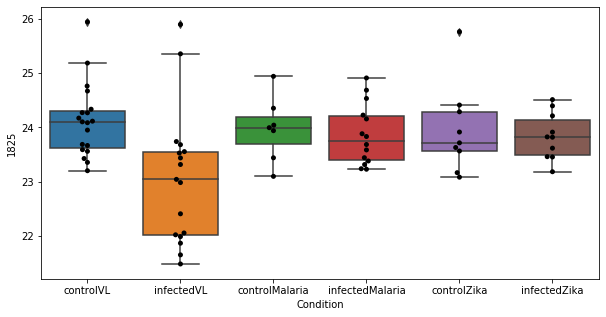

402 row m/z                200.173
row retention time     3.36251
p-val                 0.770207
adj.P.Val             0.999793
custom_id                 1424
compound_names             NaN
Name: 1424, dtype: object


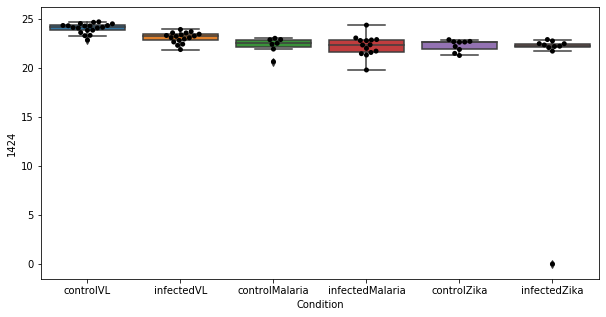

403 row m/z                268.175
row retention time     3.38427
p-val                 0.770877
adj.P.Val             0.999793
custom_id                 2156
compound_names             NaN
Name: 2156, dtype: object


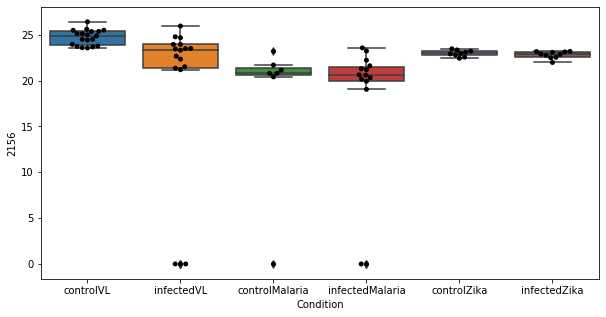

404 row m/z                                                         133.061
row retention time                                              12.1002
p-val                                                          0.772427
adj.P.Val                                                      0.999793
custom_id                                                           472
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 472, dtype: object


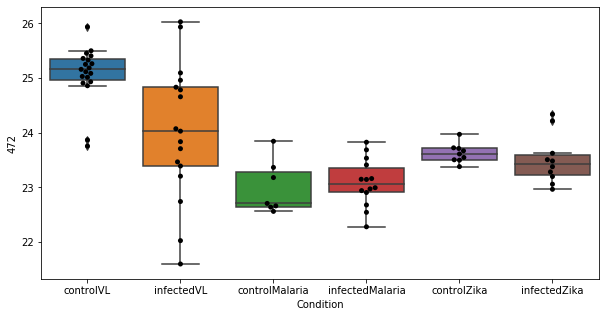

405 row m/z                212.095
row retention time     4.63104
p-val                 0.772598
adj.P.Val             0.999793
custom_id                 3780
compound_names             NaN
Name: 3780, dtype: object


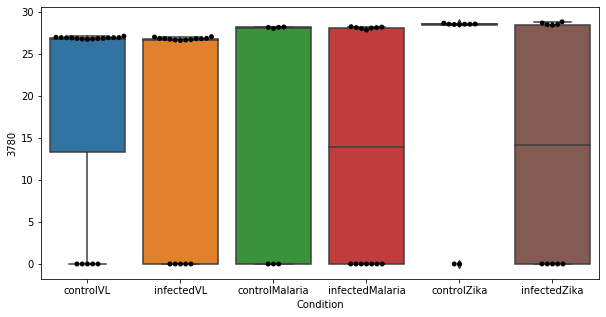

406 row m/z                144.102
row retention time     10.8185
p-val                 0.772603
adj.P.Val             0.999793
custom_id                  633
compound_names             NaN
Name: 633, dtype: object


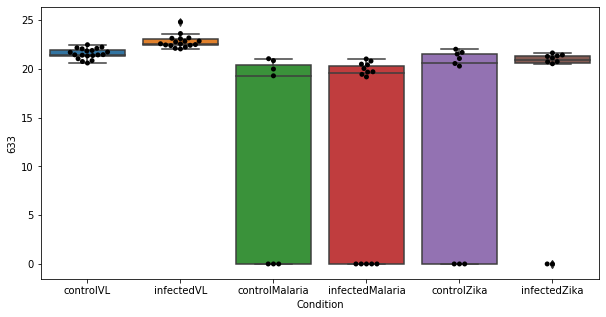

407 row m/z                  786.6
row retention time     3.18718
p-val                 0.773352
adj.P.Val             0.999793
custom_id                 3020
compound_names             NaN
Name: 3020, dtype: object


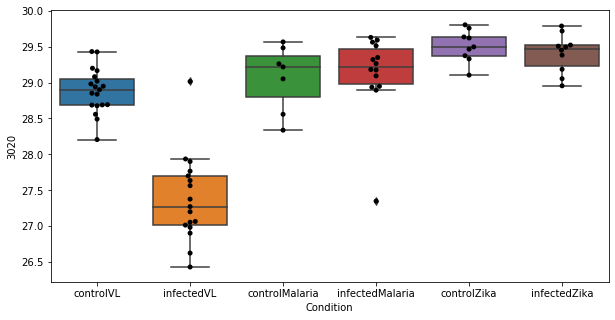

408 row m/z                                                129.102
row retention time                                     10.8821
p-val                                                  0.77393
adj.P.Val                                             0.999793
custom_id                                                 3342
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 3342, dtype: object


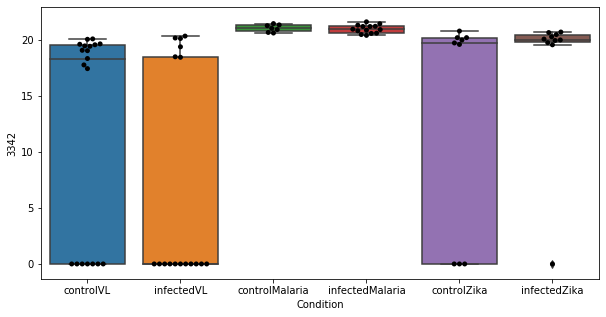

409 row m/z                248.149
row retention time     9.47753
p-val                 0.774109
adj.P.Val             0.999793
custom_id                 1985
compound_names             NaN
Name: 1985, dtype: object


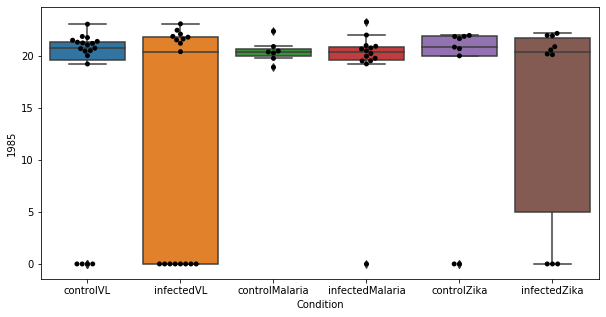

410 row m/z                267.172
row retention time     3.36788
p-val                 0.778126
adj.P.Val             0.999793
custom_id                 2151
compound_names             NaN
Name: 2151, dtype: object


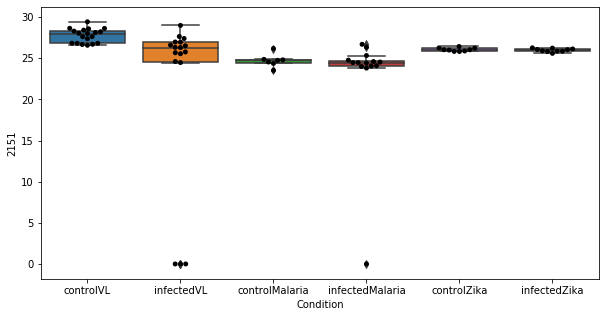

411 row m/z                199.169
row retention time     3.35541
p-val                 0.778446
adj.P.Val             0.999793
custom_id                 1412
compound_names             NaN
Name: 1412, dtype: object


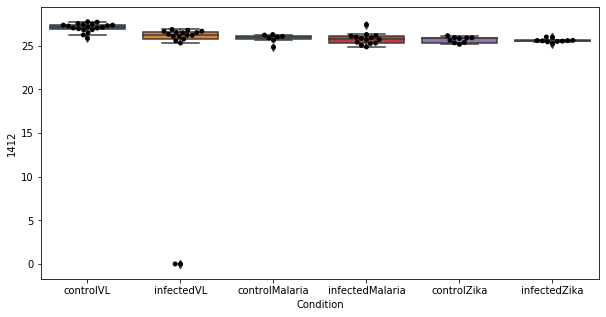

412 row m/z                                                         133.032
row retention time                                              9.80164
p-val                                                          0.781622
adj.P.Val                                                      0.999793
custom_id                                                           471
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 471, dtype: object


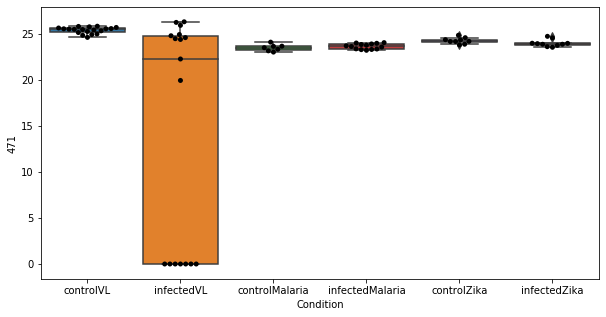

413 row m/z                127.073
row retention time     9.99674
p-val                 0.781626
adj.P.Val             0.999793
custom_id                  374
compound_names             NaN
Name: 374, dtype: object


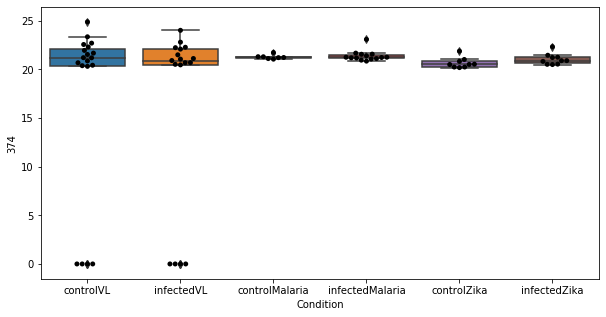

414 row m/z                614.535
row retention time      2.9848
p-val                 0.781828
adj.P.Val             0.999793
custom_id                 2873
compound_names             NaN
Name: 2873, dtype: object


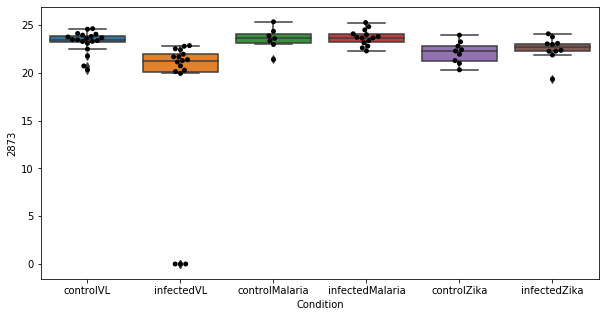

415 row m/z                682.486
row retention time     3.07538
p-val                 0.782055
adj.P.Val             0.999793
custom_id                 2909
compound_names             NaN
Name: 2909, dtype: object


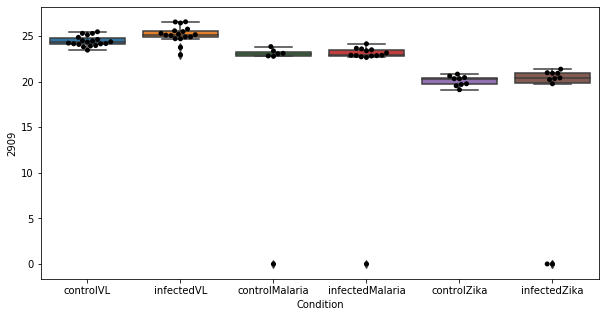

416 row m/z                            146.118
row retention time                 10.7265
p-val                             0.783786
adj.P.Val                         0.999793
custom_id                              674
compound_names        3-Dehydroxycarnitine
Name: 674, dtype: object


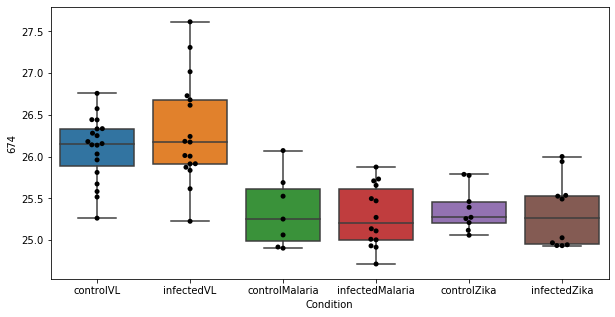

417 row m/z                                            180.066
row retention time                                 6.71078
p-val                                             0.784833
adj.P.Val                                         0.999793
custom_id                                             1159
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1159, dtype: object


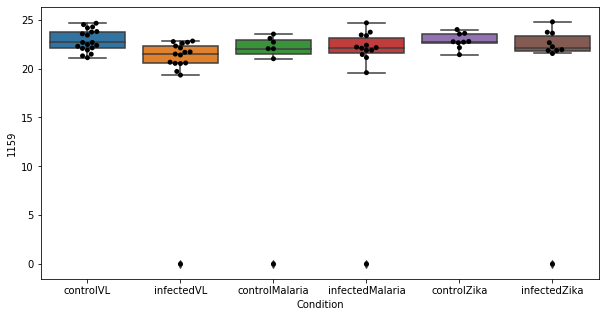

418 row m/z                284.331
row retention time     6.89412
p-val                 0.786986
adj.P.Val             0.999793
custom_id                 2280
compound_names             NaN
Name: 2280, dtype: object


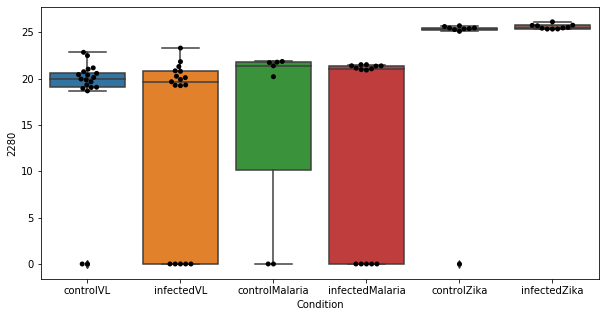

419 row m/z                114.098
row retention time     8.60432
p-val                 0.787618
adj.P.Val             0.999793
custom_id                  237
compound_names             NaN
Name: 237, dtype: object


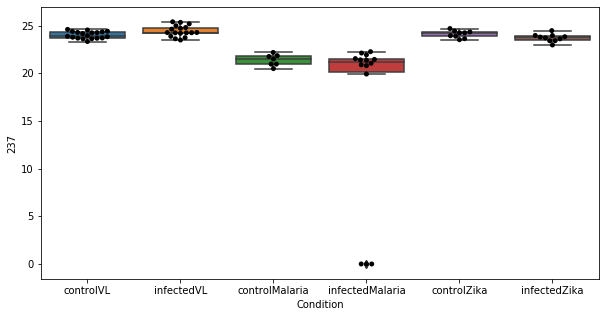

420 row m/z                236.073
row retention time     4.66101
p-val                 0.788082
adj.P.Val             0.999793
custom_id                 1871
compound_names             NaN
Name: 1871, dtype: object


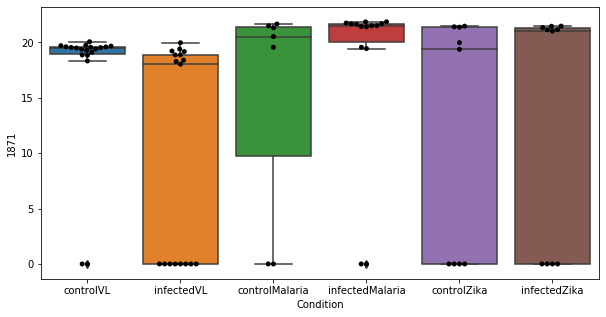

421 row m/z                249.185
row retention time     3.42338
p-val                 0.788806
adj.P.Val             0.999793
custom_id                 1989
compound_names             NaN
Name: 1989, dtype: object


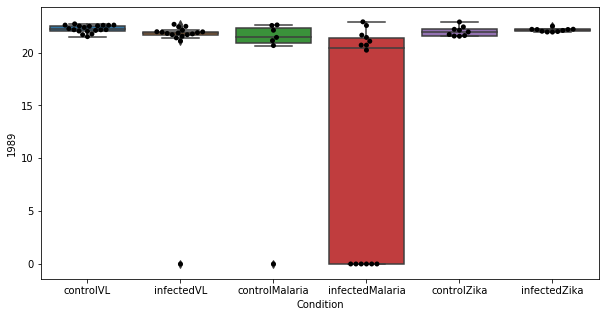

422 row m/z                279.159
row retention time      3.3597
p-val                 0.790346
adj.P.Val             0.999793
custom_id                 2230
compound_names             NaN
Name: 2230, dtype: object


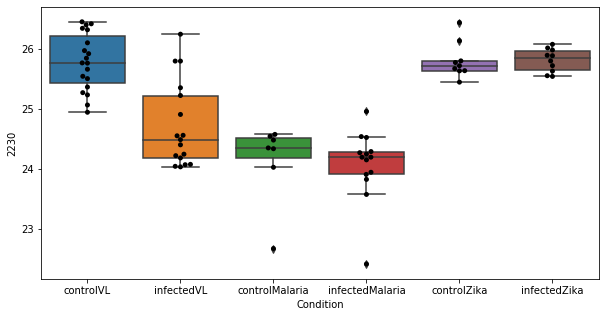

423 row m/z                157.086
row retention time     4.39371
p-val                 0.791497
adj.P.Val             0.999793
custom_id                  847
compound_names             NaN
Name: 847, dtype: object


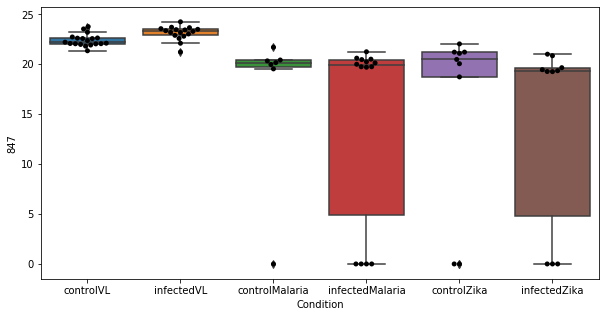

424 row m/z                760.584
row retention time     3.20659
p-val                 0.792419
adj.P.Val             0.999793
custom_id                 2975
compound_names             NaN
Name: 2975, dtype: object


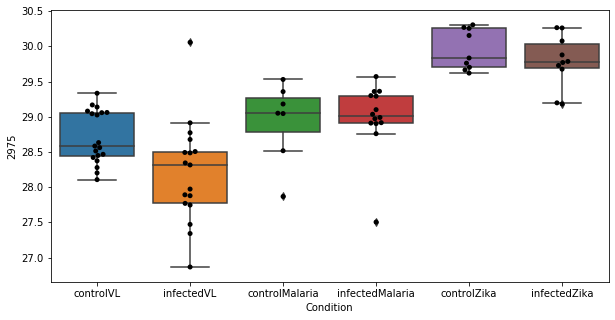

425 row m/z                234.134
row retention time     3.72693
p-val                 0.793241
adj.P.Val             0.999793
custom_id                 6920
compound_names             NaN
Name: 6920, dtype: object


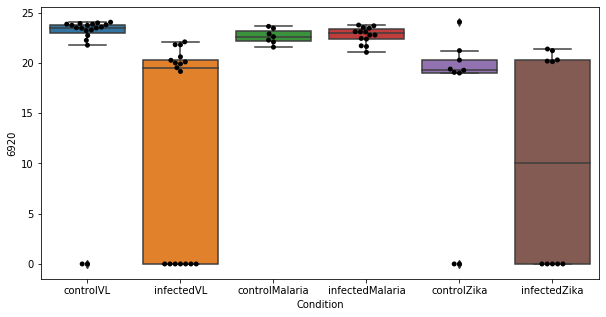

426 row m/z                134.081
row retention time     11.7055
p-val                 0.793853
adj.P.Val             0.999793
custom_id                  496
compound_names             NaN
Name: 496, dtype: object


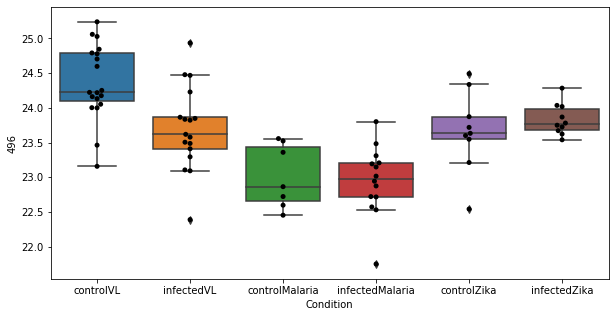

427 row m/z                                                         223.108
row retention time                                              10.8224
p-val                                                           0.79552
adj.P.Val                                                      0.999793
custom_id                                                          1720
compound_names        quinonoid dihydrobiopterin$O2'-4a-cyclic-tetra...
Name: 1720, dtype: object


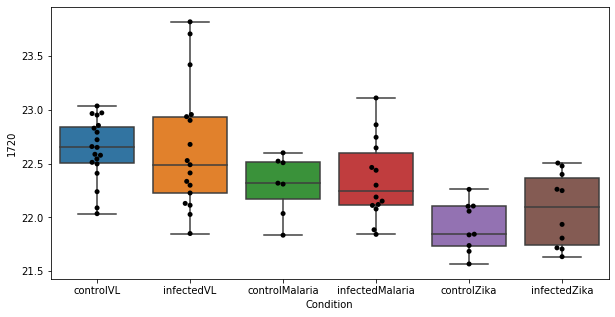

428 row m/z                119.083
row retention time     10.4069
p-val                 0.796709
adj.P.Val             0.999793
custom_id                  297
compound_names             NaN
Name: 297, dtype: object


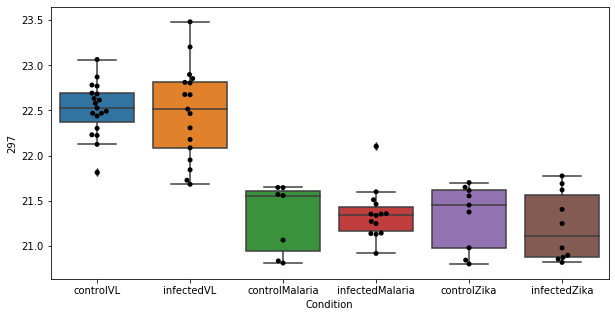

429 row m/z                              167.09
row retention time                  8.85715
p-val                               0.79676
adj.P.Val                          0.999793
custom_id                               995
compound_names        4-Guanidinobutanamide
Name: 995, dtype: object


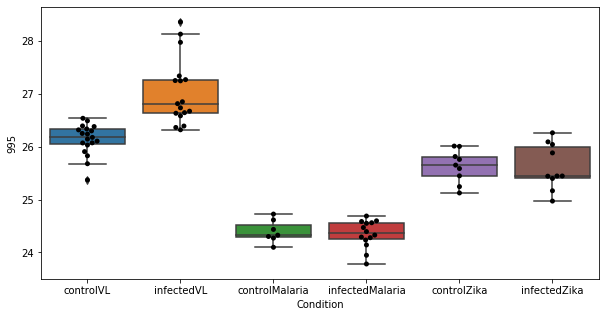

430 row m/z                                                         203.052
row retention time                                               12.051
p-val                                                          0.796885
adj.P.Val                                                      0.999793
custom_id                                                          1464
compound_names        D-Tagatose; lyxo-Hexulose$1,7-Dimethylxanthine...
Name: 1464, dtype: object


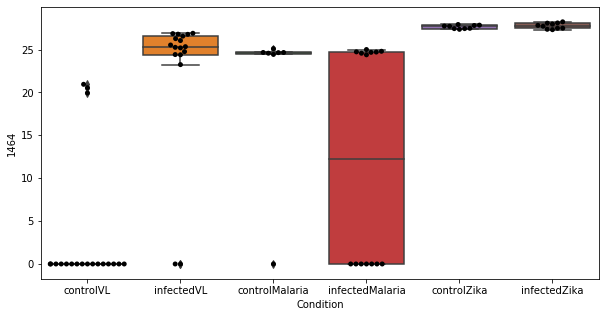

431 row m/z                228.123
row retention time     8.59395
p-val                 0.796894
adj.P.Val             0.999793
custom_id                 1771
compound_names             NaN
Name: 1771, dtype: object


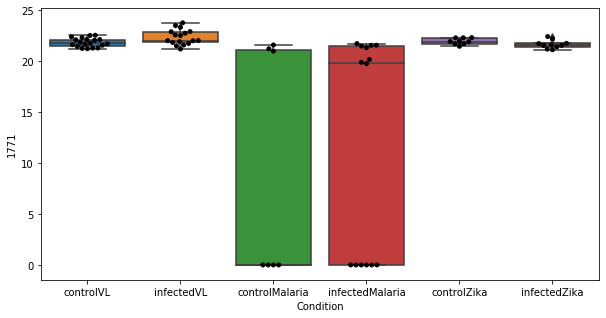

432 row m/z                                                         136.076
row retention time                                              10.8269
p-val                                                          0.797788
adj.P.Val                                                      0.999793
custom_id                                                           523
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 523, dtype: object


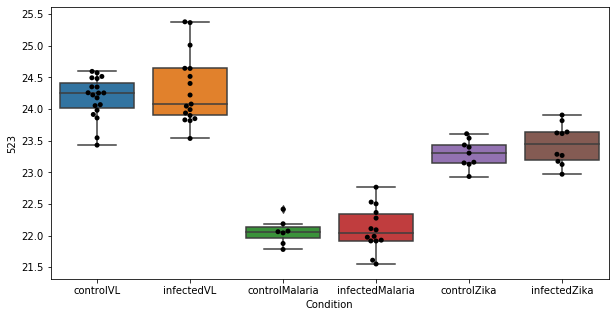

433 row m/z                814.687
row retention time     3.26715
p-val                  0.79816
adj.P.Val             0.999793
custom_id                 3087
compound_names             NaN
Name: 3087, dtype: object


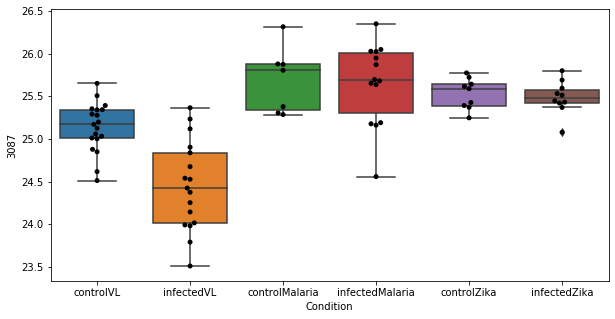

434 row m/z                                                         218.139
row retention time                                              6.70695
p-val                                                          0.798382
adj.P.Val                                                      0.999793
custom_id                                                          1664
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1664, dtype: object


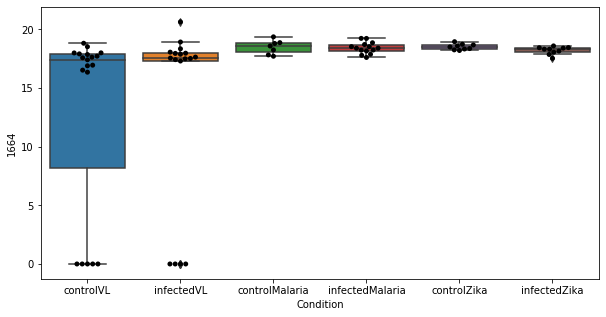

435 row m/z                317.269
row retention time     2.99278
p-val                 0.801556
adj.P.Val             0.999793
custom_id                 2470
compound_names             NaN
Name: 2470, dtype: object


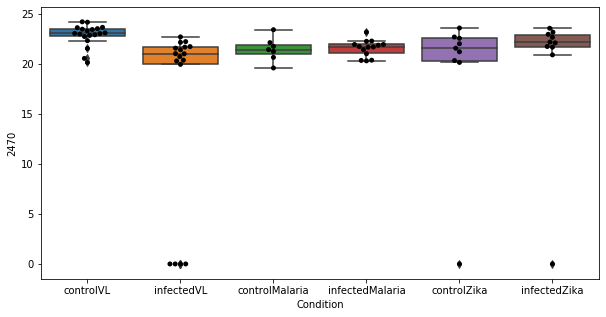

436 row m/z                704.578
row retention time     3.41484
p-val                 0.801943
adj.P.Val             0.999793
custom_id                 2919
compound_names             NaN
Name: 2919, dtype: object


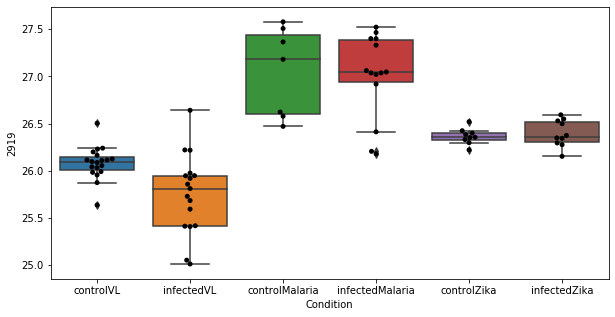

437 row m/z                 680.48
row retention time     3.07307
p-val                  0.80465
adj.P.Val             0.999793
custom_id                 2907
compound_names             NaN
Name: 2907, dtype: object


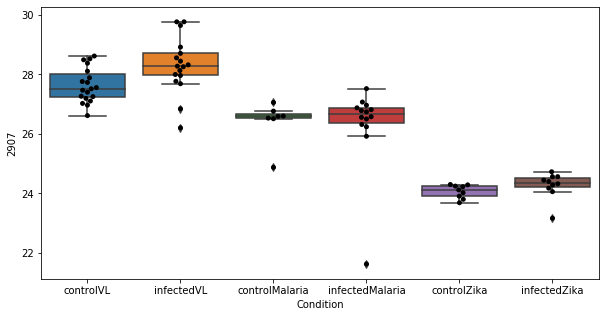

438 row m/z                                                          90.055
row retention time                                               11.795
p-val                                                          0.806409
adj.P.Val                                                      0.999793
custom_id                                                            84
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 84, dtype: object


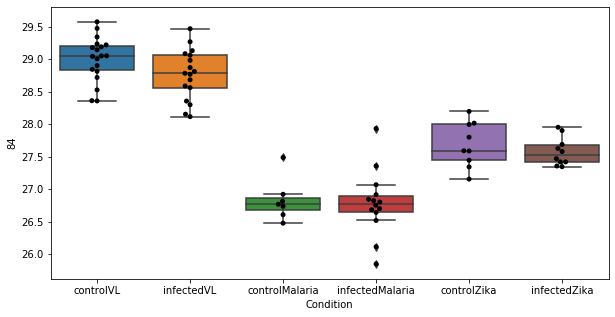

439 row m/z                795.609
row retention time     3.17042
p-val                 0.807266
adj.P.Val             0.999793
custom_id                 3043
compound_names             NaN
Name: 3043, dtype: object


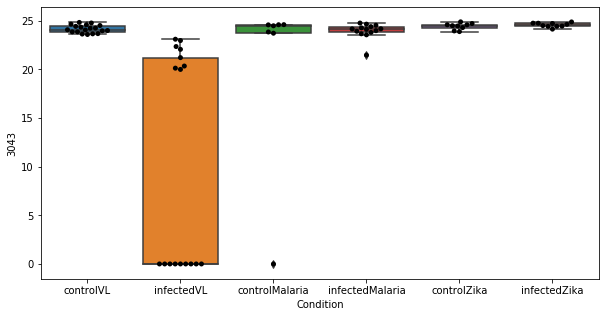

440 row m/z                         213.099
row retention time              4.63072
p-val                          0.808836
adj.P.Val                      0.999793
custom_id                          3790
compound_names        N-Methylserotonin
Name: 3790, dtype: object


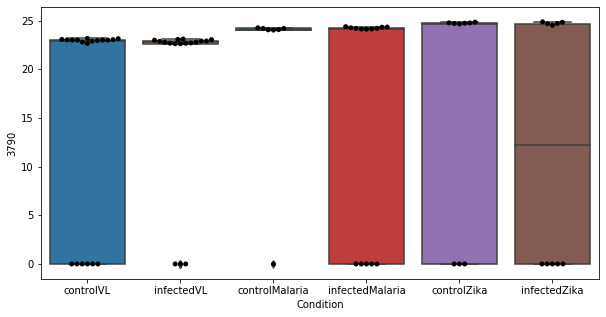

441 row m/z                120.091
row retention time     10.4043
p-val                 0.809133
adj.P.Val             0.999793
custom_id                  311
compound_names             NaN
Name: 311, dtype: object


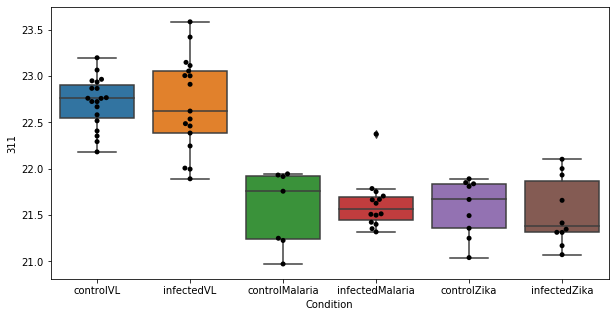

442 row m/z                                                         150.058
row retention time                                              9.80156
p-val                                                          0.812051
adj.P.Val                                                      0.999793
custom_id                                                           746
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 746, dtype: object


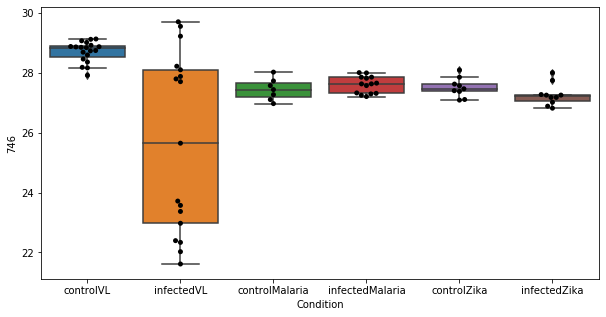

443 row m/z                                                        220.118
row retention time                                             7.99789
p-val                                                         0.816775
adj.P.Val                                                     0.999793
custom_id                                                         1692
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1692, dtype: object


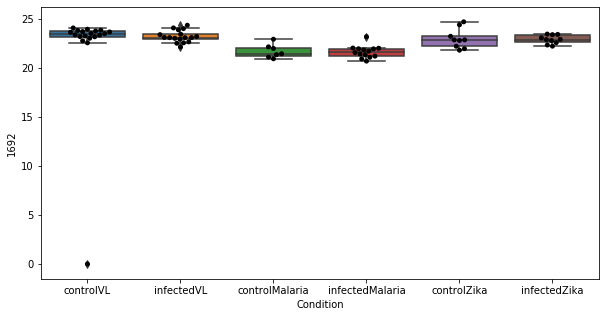

444 row m/z                                                         266.122
row retention time                                              4.45712
p-val                                                          0.817564
adj.P.Val                                                      0.999793
custom_id                                                          2145
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2145, dtype: object


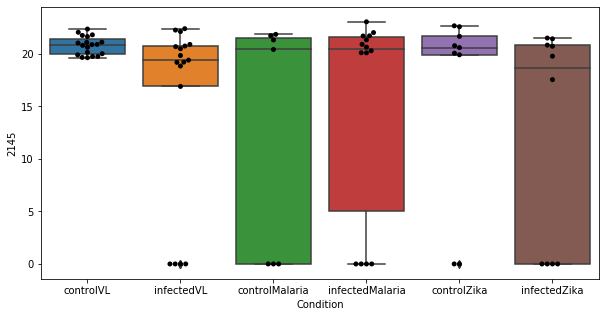

445 row m/z                111.117
row retention time     3.35659
p-val                 0.817946
adj.P.Val             0.999793
custom_id                  205
compound_names             NaN
Name: 205, dtype: object


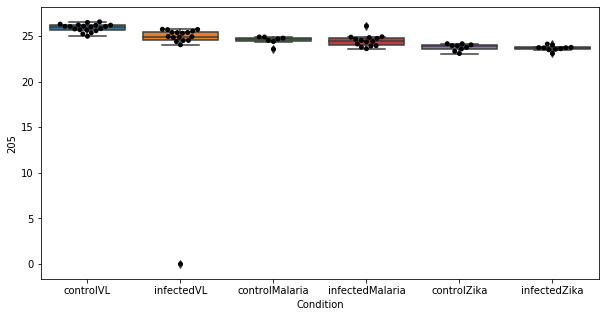

446 row m/z                                                         169.058
row retention time                                               11.897
p-val                                                          0.819258
adj.P.Val                                                      0.999793
custom_id                                                          1008
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 1008, dtype: object


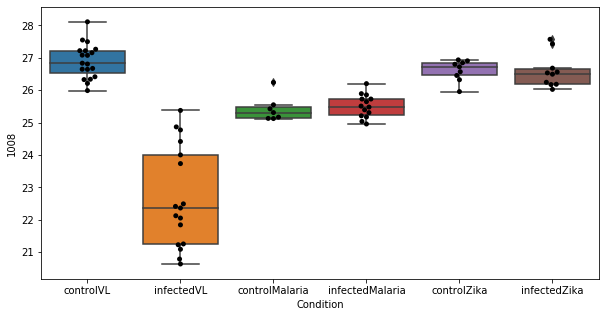

447 row m/z                                                         299.258
row retention time                                              3.05173
p-val                                                          0.819631
adj.P.Val                                                      0.999793
custom_id                                                          2366
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2366, dtype: object


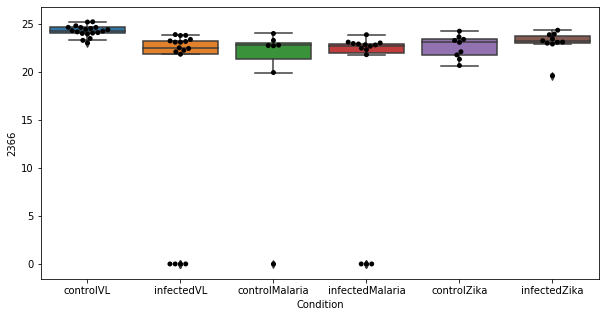

448 row m/z                338.342
row retention time     3.33679
p-val                 0.819838
adj.P.Val             0.999793
custom_id                 2522
compound_names             NaN
Name: 2522, dtype: object


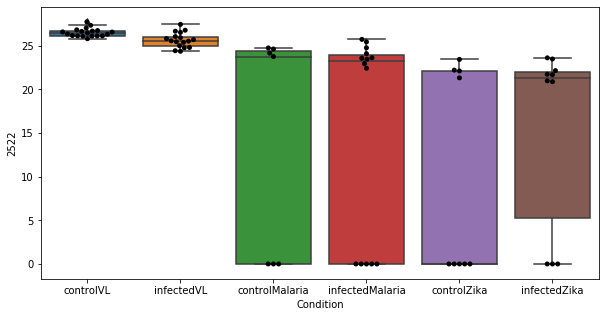

449 row m/z                757.557
row retention time     3.22221
p-val                 0.821626
adj.P.Val             0.999793
custom_id                 2968
compound_names             NaN
Name: 2968, dtype: object


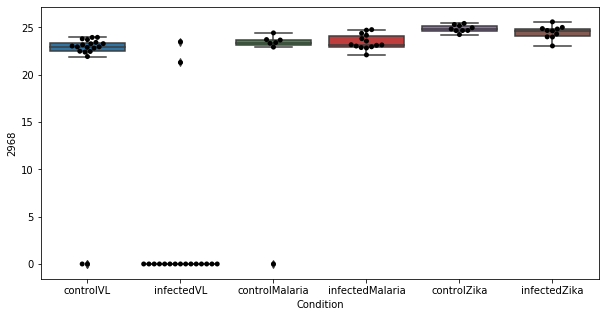

450 row m/z                326.378
row retention time     6.70674
p-val                 0.822109
adj.P.Val             0.999793
custom_id                 2492
compound_names             NaN
Name: 2492, dtype: object


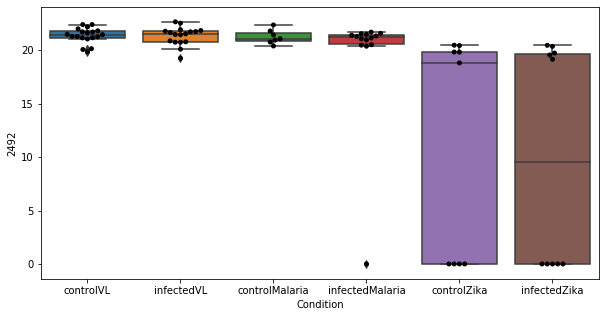

451 row m/z                283.103
row retention time     7.63894
p-val                  0.82467
adj.P.Val             0.999793
custom_id                 2265
compound_names             NaN
Name: 2265, dtype: object


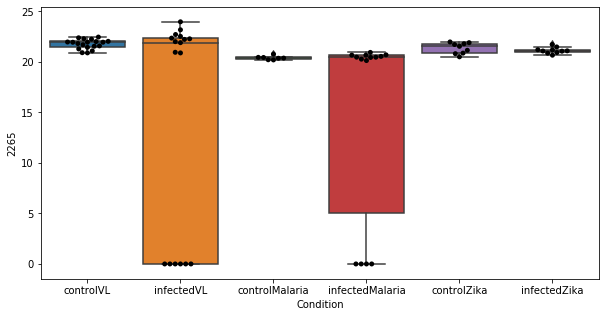

452 row m/z                                                         166.086
row retention time                                              8.85579
p-val                                                          0.825655
adj.P.Val                                                      0.999793
custom_id                                                           982
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 982, dtype: object


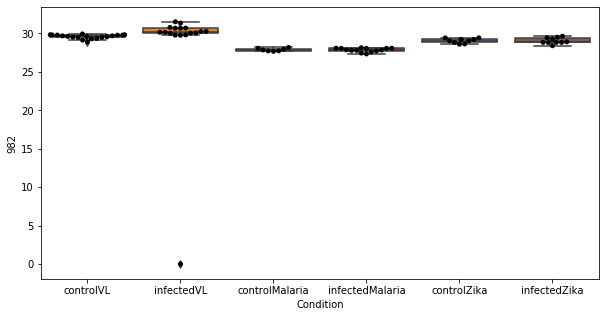

453 row m/z                705.582
row retention time     3.41385
p-val                 0.826095
adj.P.Val             0.999793
custom_id                 2920
compound_names             NaN
Name: 2920, dtype: object


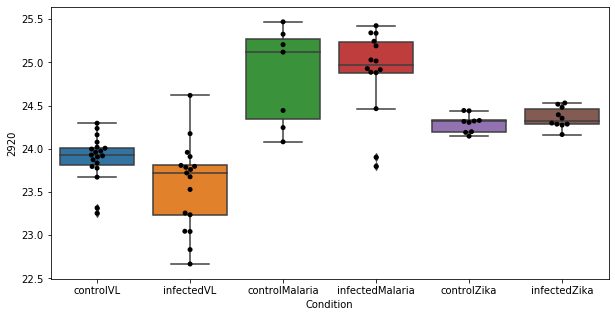

454 row m/z                           201.112
row retention time                6.70075
p-val                            0.827628
adj.P.Val                        0.999793
custom_id                            1435
compound_names        propionyl-carnitine
Name: 1435, dtype: object


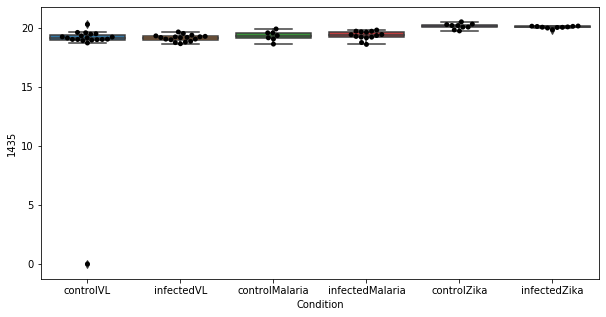

455 row m/z                159.113
row retention time      10.407
p-val                  0.82824
adj.P.Val             0.999793
custom_id                  883
compound_names             NaN
Name: 883, dtype: object


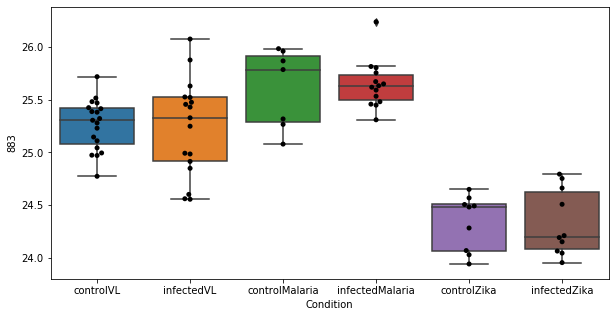

456 row m/z                                                         131.053
row retention time                                              11.8873
p-val                                                          0.830649
adj.P.Val                                                      0.999793
custom_id                                                           441
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 441, dtype: object


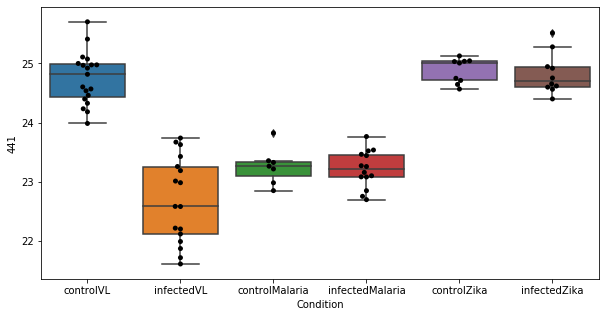

457 row m/z                   70.0651
row retention time         10.578
p-val                    0.831362
adj.P.Val                0.999793
custom_id                       1
compound_names        1-pyrroline
Name: 1, dtype: object


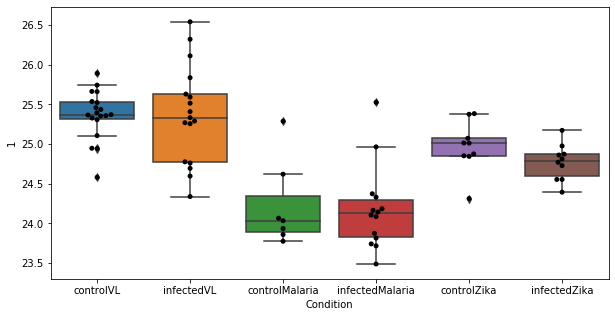

458 row m/z                762.591
row retention time     3.20571
p-val                 0.836458
adj.P.Val             0.999793
custom_id                 2977
compound_names             NaN
Name: 2977, dtype: object


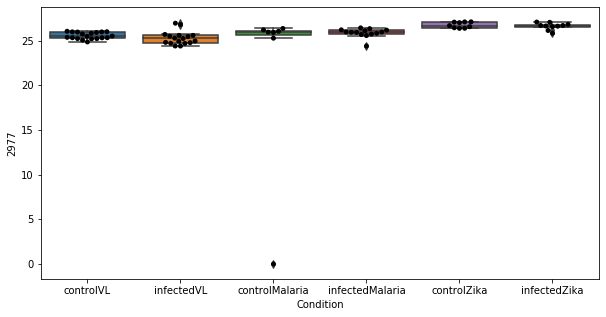

459 row m/z                206.127
row retention time      9.2812
p-val                 0.837563
adj.P.Val             0.999793
custom_id                 1507
compound_names             NaN
Name: 1507, dtype: object


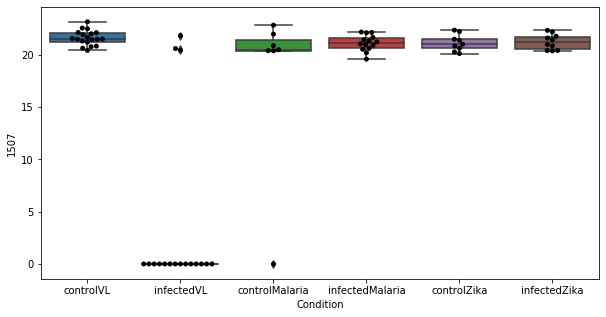

460 row m/z                                                         426.358
row retention time                                              3.68185
p-val                                                          0.841668
adj.P.Val                                                      0.999793
custom_id                                                          2699
compound_names        Elaidic carnitine$Vaccenyl carnitine$octadecen...
Name: 2699, dtype: object


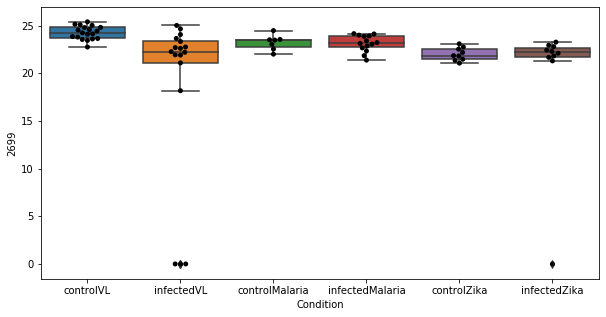

461 row m/z                132.077
row retention time     11.7119
p-val                 0.842331
adj.P.Val             0.999793
custom_id                  461
compound_names             NaN
Name: 461, dtype: object


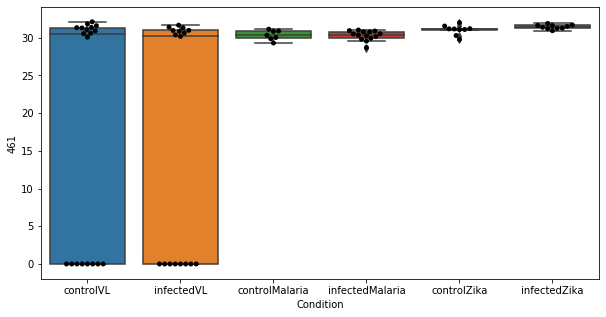

462 row m/z                                                         72.0808
row retention time                                              10.4047
p-val                                                          0.842537
adj.P.Val                                                      0.999793
custom_id                                                             6
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 6, dtype: object


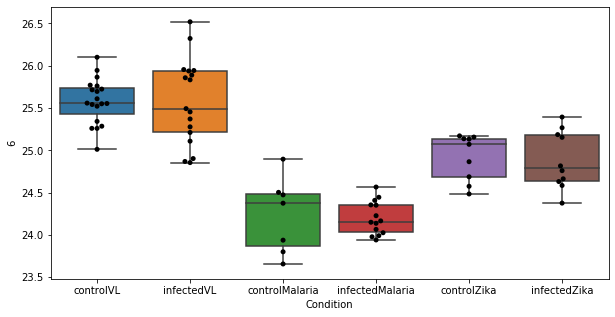

463 row m/z                231.134
row retention time     10.5776
p-val                 0.843553
adj.P.Val             0.999793
custom_id                 1813
compound_names             NaN
Name: 1813, dtype: object


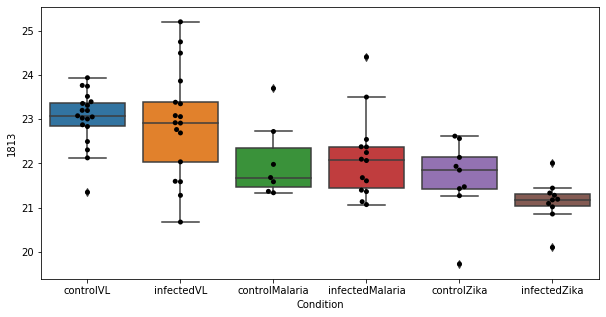

464 row m/z                                                          139.05
row retention time                                              8.15384
p-val                                                            0.8468
adj.P.Val                                                      0.999793
custom_id                                                          3390
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 3390, dtype: object


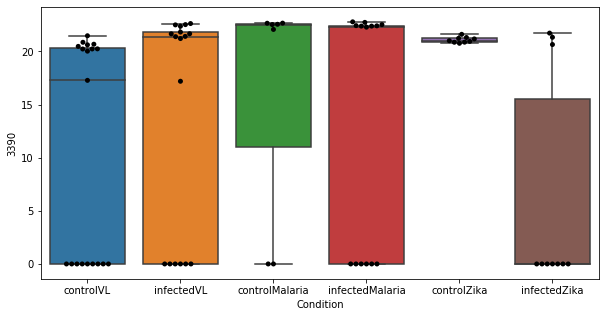

465 row m/z                239.149
row retention time     4.38228
p-val                 0.849404
adj.P.Val             0.999793
custom_id                 1902
compound_names             NaN
Name: 1902, dtype: object


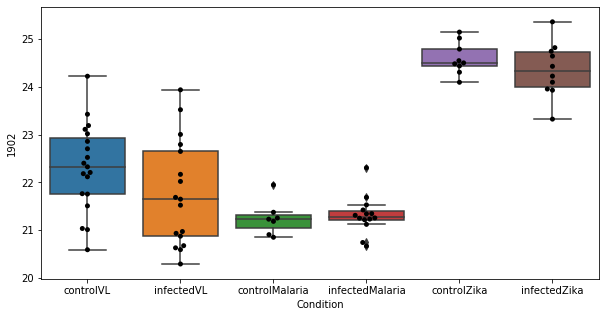

466 row m/z                           201.112
row retention time                4.34518
p-val                            0.849504
adj.P.Val                        0.999793
custom_id                            1434
compound_names        propionyl-carnitine
Name: 1434, dtype: object


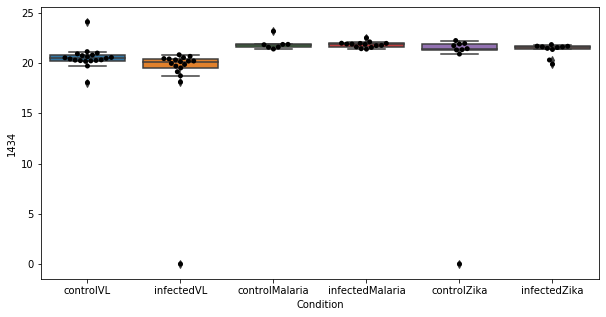

467 row m/z                                                         102.055
row retention time                                              11.6019
p-val                                                          0.850475
adj.P.Val                                                      0.999793
custom_id                                                           119
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 119, dtype: object


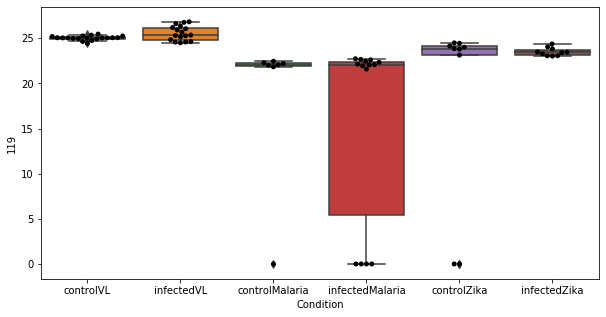

468 row m/z                204.123
row retention time     6.71267
p-val                 0.850993
adj.P.Val             0.999793
custom_id                 1481
compound_names             NaN
Name: 1481, dtype: object


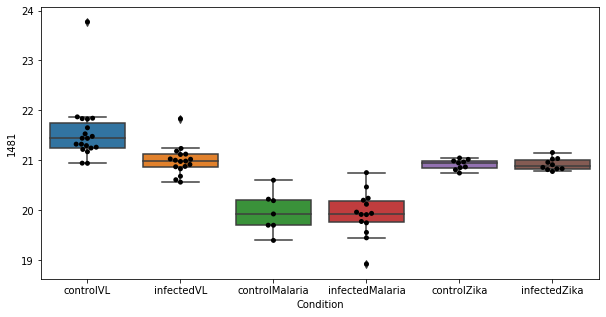

469 row m/z                158.101
row retention time     10.5739
p-val                  0.85437
adj.P.Val             0.999793
custom_id                  861
compound_names             NaN
Name: 861, dtype: object


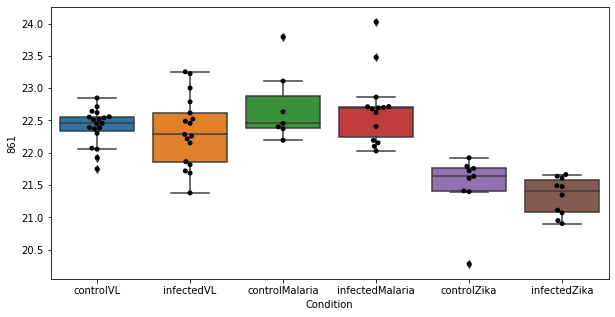

470 row m/z                202.144
row retention time     6.71119
p-val                 0.857805
adj.P.Val             0.999793
custom_id                 1450
compound_names             NaN
Name: 1450, dtype: object


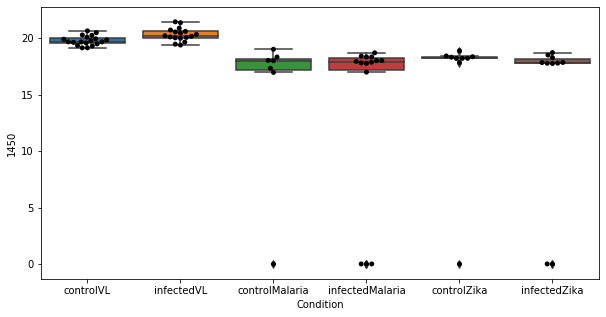

471 row m/z                151.058
row retention time     9.80728
p-val                 0.859961
adj.P.Val             0.999793
custom_id                  758
compound_names             NaN
Name: 758, dtype: object


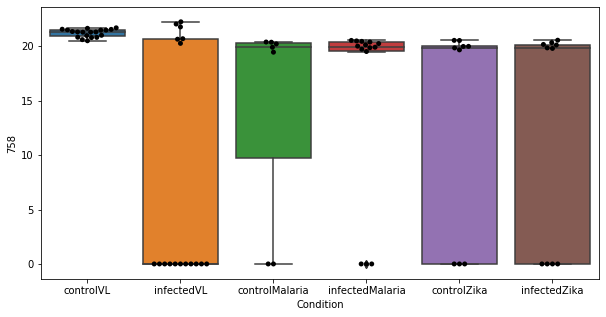

472 row m/z                                                         152.071
row retention time                                              6.71277
p-val                                                           0.86071
adj.P.Val                                                      0.999793
custom_id                                                           774
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 774, dtype: object


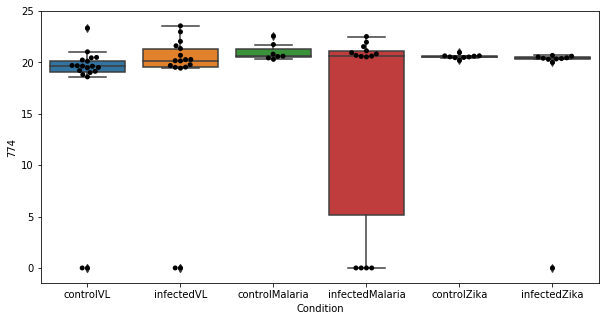

473 row m/z                179.128
row retention time     4.37518
p-val                 0.861806
adj.P.Val             0.999793
custom_id                 1154
compound_names             NaN
Name: 1154, dtype: object


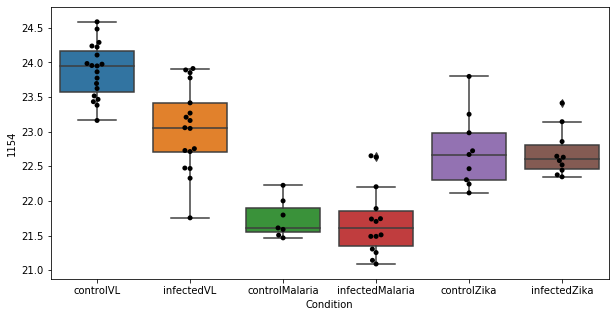

474 row m/z                160.116
row retention time     10.4075
p-val                 0.862166
adj.P.Val             0.999793
custom_id                  902
compound_names             NaN
Name: 902, dtype: object


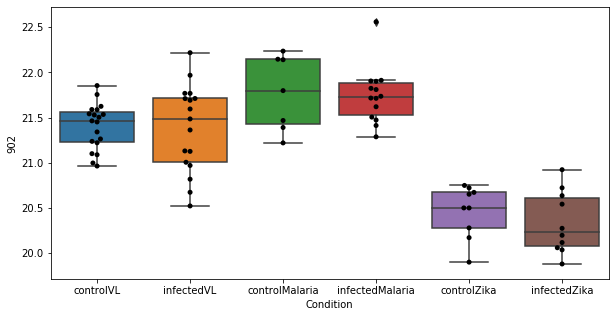

475 row m/z                768.589
row retention time      3.1957
p-val                 0.863307
adj.P.Val             0.999793
custom_id                 2988
compound_names             NaN
Name: 2988, dtype: object


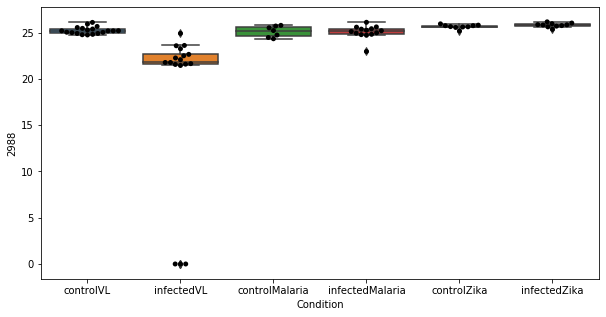

476 row m/z                                                         200.128
row retention time                                              6.73196
p-val                                                          0.863332
adj.P.Val                                                      0.999793
custom_id                                                          1420
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1420, dtype: object


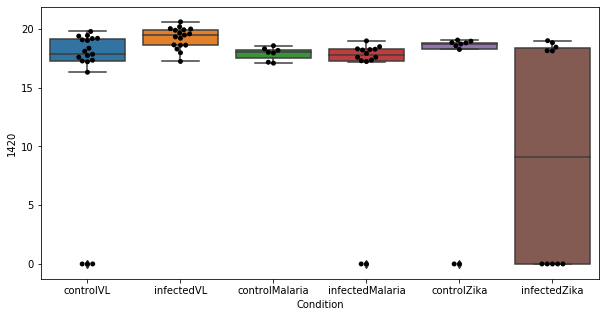

477 row m/z                                                         84.0443
row retention time                                              11.8824
p-val                                                          0.870547
adj.P.Val                                                      0.999793
custom_id                                                            44
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 44, dtype: object


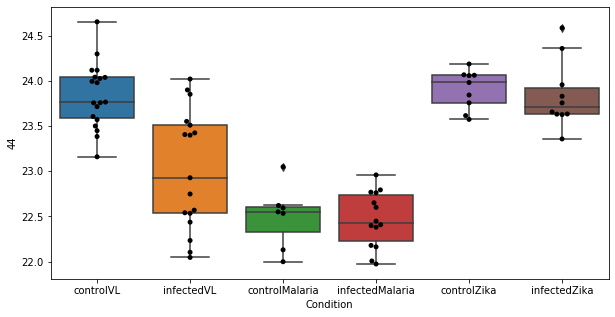

478 row m/z                151.097
row retention time      6.6976
p-val                 0.870851
adj.P.Val             0.999793
custom_id                  765
compound_names             NaN
Name: 765, dtype: object


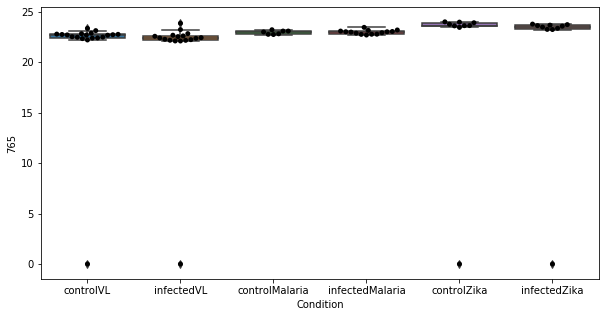

479 row m/z                160.133
row retention time     7.38486
p-val                  0.87153
adj.P.Val             0.999793
custom_id                  904
compound_names             NaN
Name: 904, dtype: object


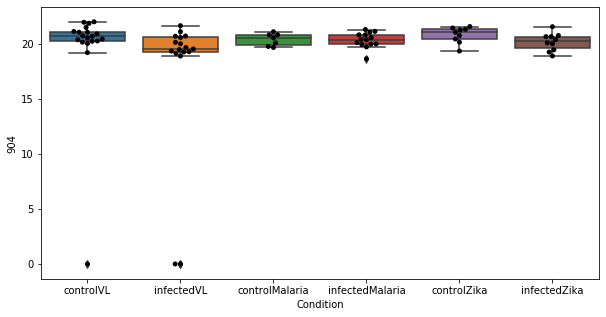

480 row m/z                287.222
row retention time     3.33673
p-val                  0.87161
adj.P.Val             0.999793
custom_id                 2304
compound_names             NaN
Name: 2304, dtype: object


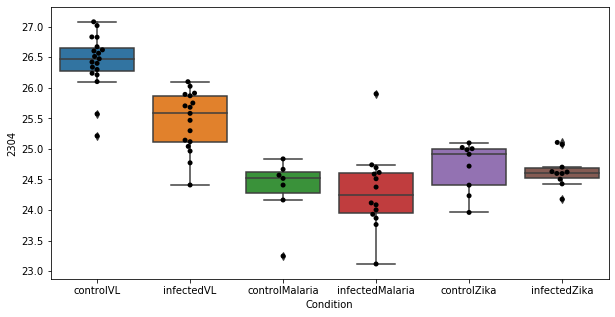

481 row m/z                                                          131.09
row retention time                                              9.51152
p-val                                                          0.872264
adj.P.Val                                                      0.999793
custom_id                                                           444
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 444, dtype: object


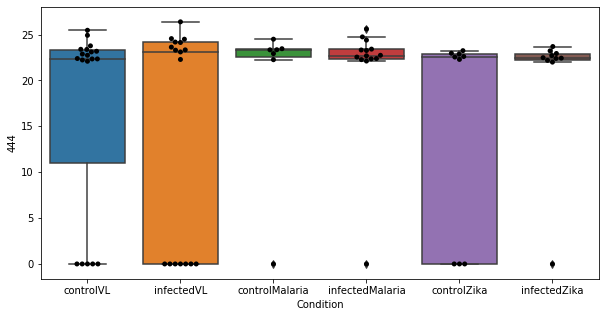

482 row m/z                                                         86.0964
row retention time                                              9.24833
p-val                                                          0.873211
adj.P.Val                                                      0.999793
custom_id                                                            60
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 60, dtype: object


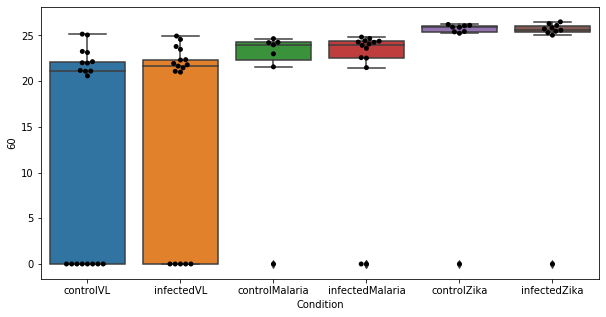

483 row m/z                                                         156.102
row retention time                                              6.71109
p-val                                                          0.873366
adj.P.Val                                                      0.999793
custom_id                                                           827
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 827, dtype: object


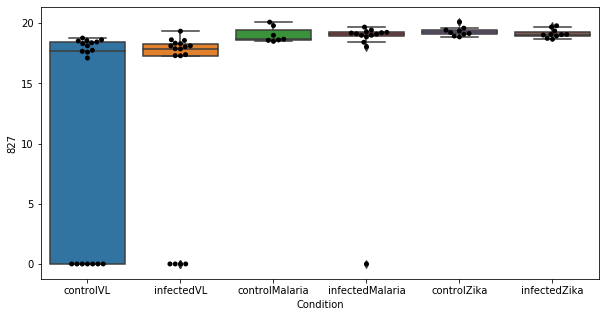

484 row m/z                                                         130.086
row retention time                                              9.51388
p-val                                                          0.873923
adj.P.Val                                                      0.999793
custom_id                                                           421
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 421, dtype: object


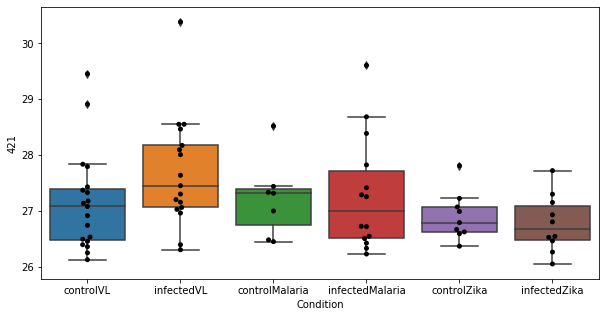

485 row m/z                166.053
row retention time     10.8401
p-val                 0.875237
adj.P.Val             0.999793
custom_id                  976
compound_names             NaN
Name: 976, dtype: object


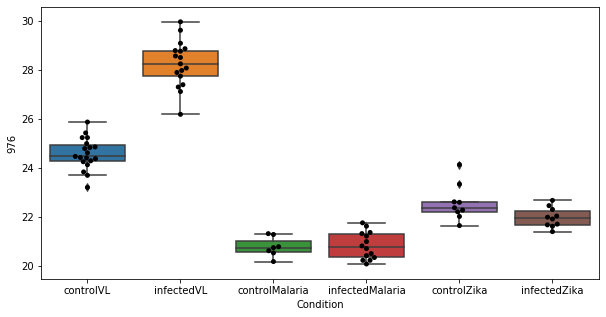

486 row m/z                187.096
row retention time     4.38444
p-val                 0.875631
adj.P.Val             0.999793
custom_id                 1251
compound_names             NaN
Name: 1251, dtype: object


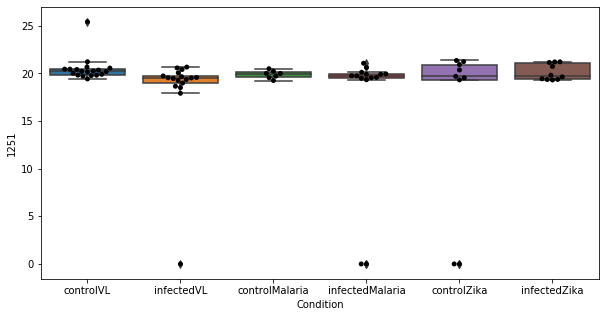

487 row m/z                                                         180.066
row retention time                                              4.60253
p-val                                                          0.877417
adj.P.Val                                                      0.999793
custom_id                                                          4782
compound_names        3,4-Dihydroxy-L-phenylalanine; L-Dopa; 3-Hydro...
Name: 4782, dtype: object


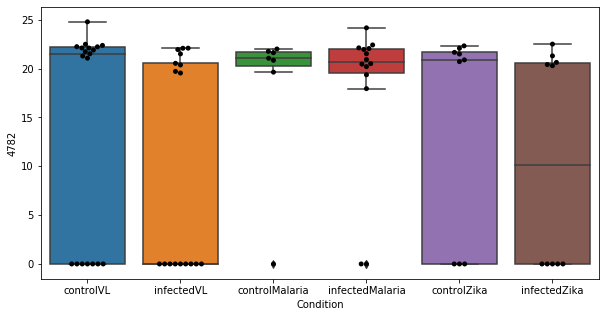

488 row m/z                171.076
row retention time     11.8928
p-val                 0.877676
adj.P.Val             0.999793
custom_id                 1044
compound_names             NaN
Name: 1044, dtype: object


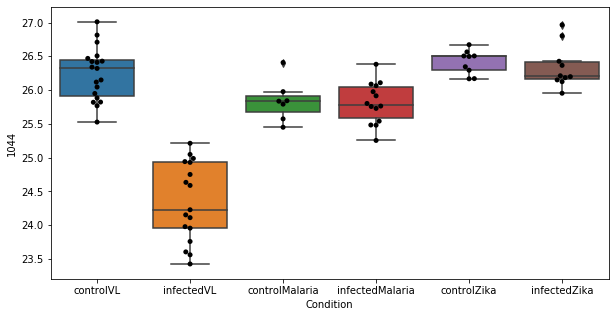

489 row m/z                118.052
row retention time     10.4173
p-val                 0.878176
adj.P.Val             0.999793
custom_id                  271
compound_names             NaN
Name: 271, dtype: object


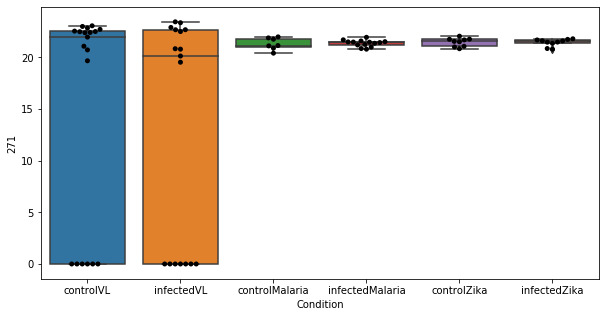

490 row m/z                196.154
row retention time      4.3551
p-val                 0.879965
adj.P.Val             0.999793
custom_id                 1383
compound_names             NaN
Name: 1383, dtype: object


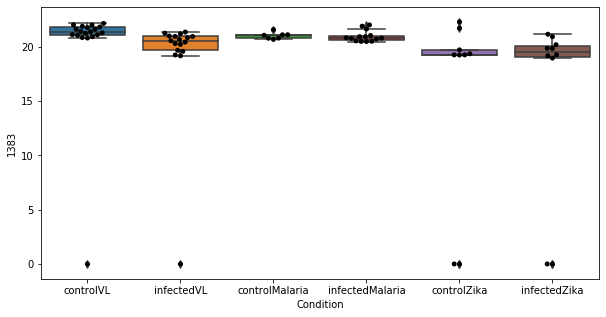

491 row m/z                784.584
row retention time     3.19568
p-val                 0.880195
adj.P.Val             0.999793
custom_id                 3012
compound_names             NaN
Name: 3012, dtype: object


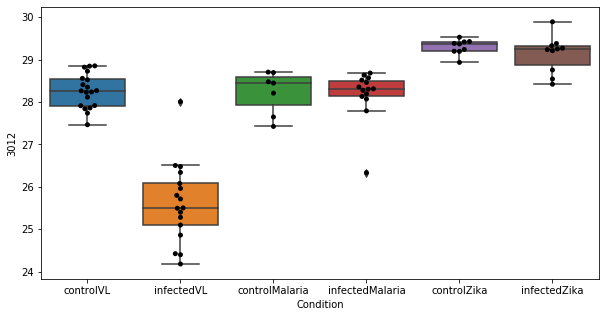

492 row m/z                                                          118.05
row retention time                                              9.11566
p-val                                                          0.880998
adj.P.Val                                                      0.999793
custom_id                                                           269
compound_names        2-Amino-3-oxobutanoate; 2-Amino-acetoacetate$L...
Name: 269, dtype: object


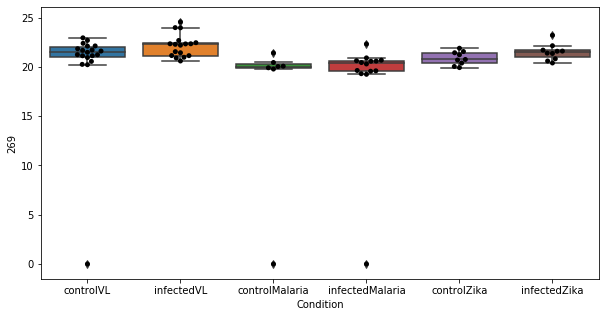

493 row m/z                186.113
row retention time     4.38939
p-val                 0.881636
adj.P.Val             0.999793
custom_id                 1232
compound_names             NaN
Name: 1232, dtype: object


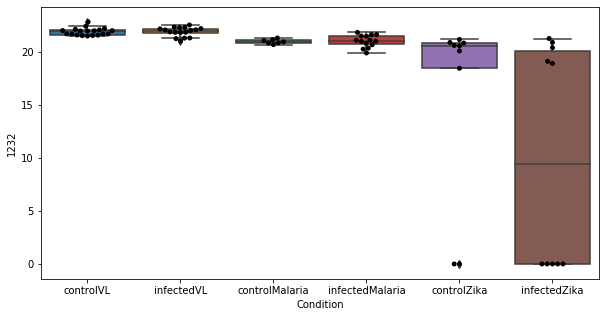

494 row m/z                 191.04
row retention time     11.9114
p-val                 0.881909
adj.P.Val             0.999793
custom_id                 1297
compound_names             NaN
Name: 1297, dtype: object


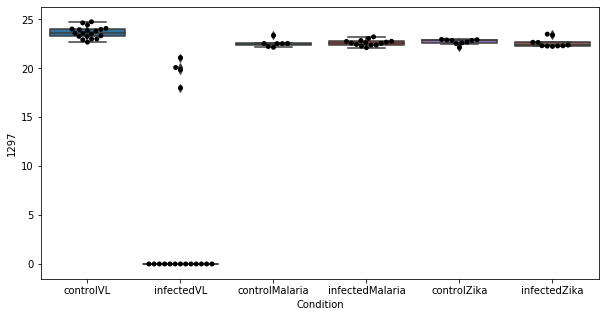

495 row m/z                                                         202.107
row retention time                                              6.71214
p-val                                                          0.882074
adj.P.Val                                                      0.999793
custom_id                                                          1443
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1443, dtype: object


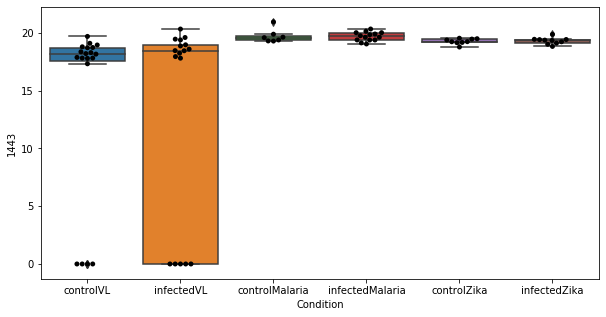

496 row m/z                                                        202.107
row retention time                                             4.37692
p-val                                                         0.883154
adj.P.Val                                                     0.999793
custom_id                                                         1447
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1447, dtype: object


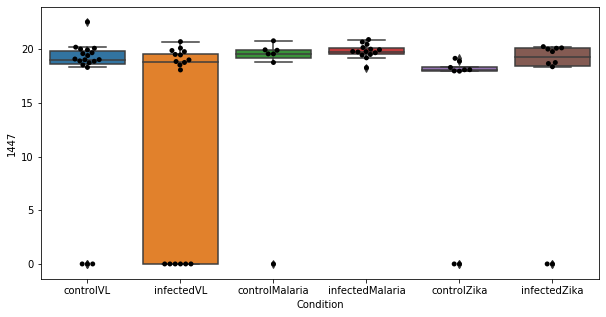

497 row m/z                260.185
row retention time     6.71453
p-val                 0.883772
adj.P.Val             0.999793
custom_id                 2101
compound_names             NaN
Name: 2101, dtype: object


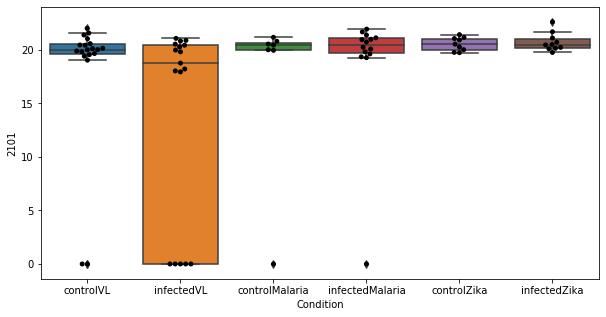

498 row m/z                                                         150.058
row retention time                                              6.72035
p-val                                                          0.884664
adj.P.Val                                                      0.999793
custom_id                                                           747
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 747, dtype: object


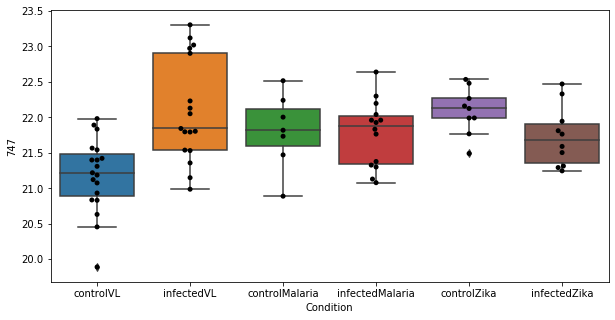

499 row m/z                118.075
row retention time     10.5768
p-val                 0.886639
adj.P.Val             0.999793
custom_id                  278
compound_names             NaN
Name: 278, dtype: object


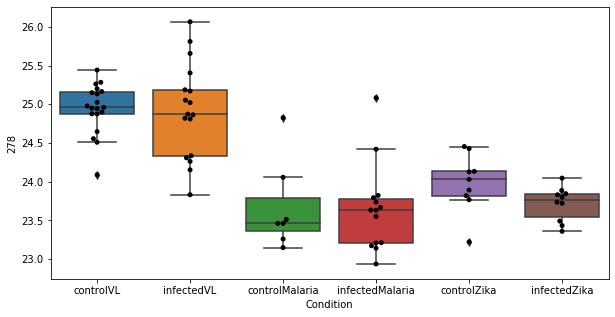

500 row m/z                145.097
row retention time     11.1439
p-val                 0.888677
adj.P.Val             0.999793
custom_id                  645
compound_names             NaN
Name: 645, dtype: object


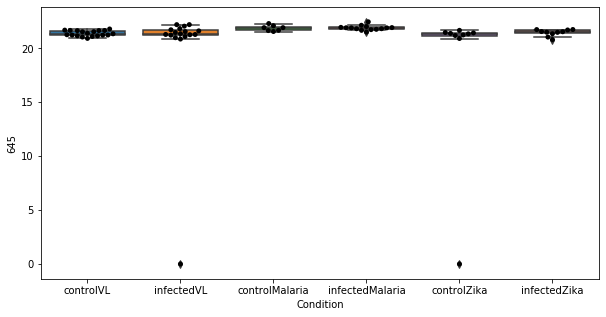

501 row m/z                314.232
row retention time     6.71001
p-val                 0.888896
adj.P.Val             0.999793
custom_id                 2452
compound_names             NaN
Name: 2452, dtype: object


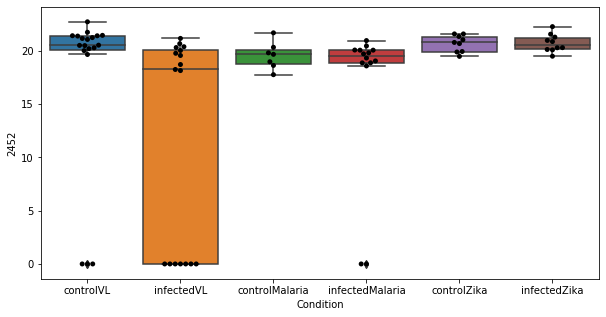

502 row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.889901
adj.P.Val                                                      0.999793
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object


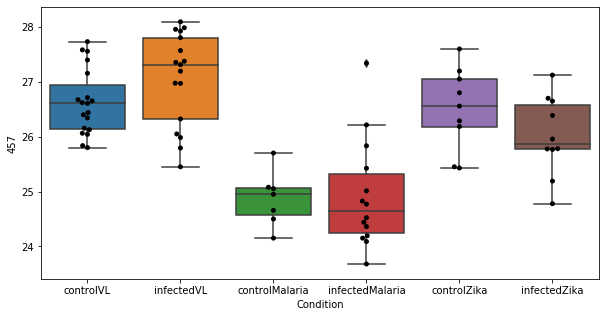

503 row m/z                180.159
row retention time     3.79938
p-val                 0.890864
adj.P.Val             0.999793
custom_id                 1165
compound_names             NaN
Name: 1165, dtype: object


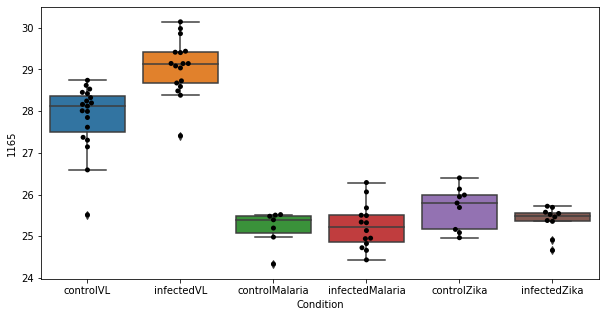

504 row m/z                148.097
row retention time     9.10577
p-val                 0.890917
adj.P.Val             0.999793
custom_id                  716
compound_names             NaN
Name: 716, dtype: object


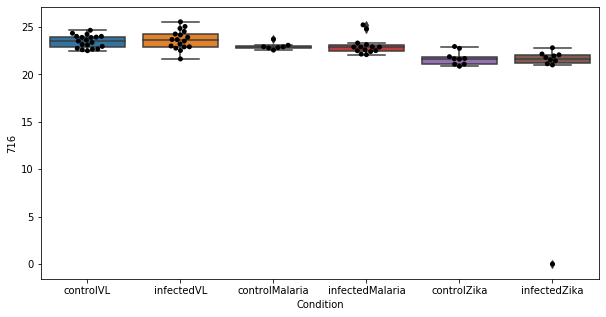

505 row m/z                133.074
row retention time     11.6911
p-val                   0.8924
adj.P.Val             0.999793
custom_id                  476
compound_names             NaN
Name: 476, dtype: object


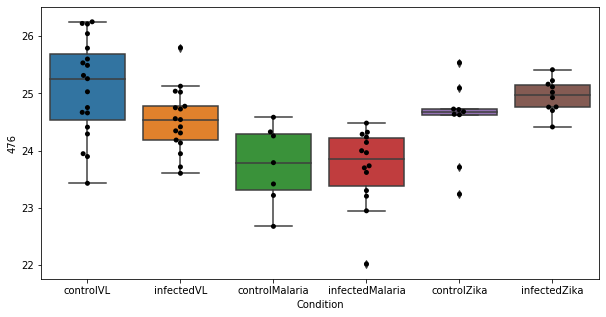

506 row m/z                275.103
row retention time     4.73098
p-val                 0.892781
adj.P.Val             0.999793
custom_id                 2207
compound_names             NaN
Name: 2207, dtype: object


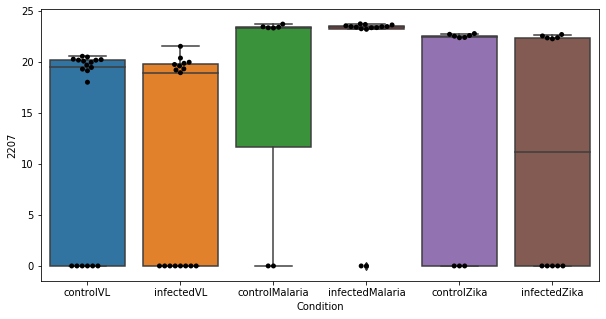

507 row m/z                 246.17
row retention time     6.86309
p-val                 0.894201
adj.P.Val             0.999793
custom_id                 1963
compound_names             NaN
Name: 1963, dtype: object


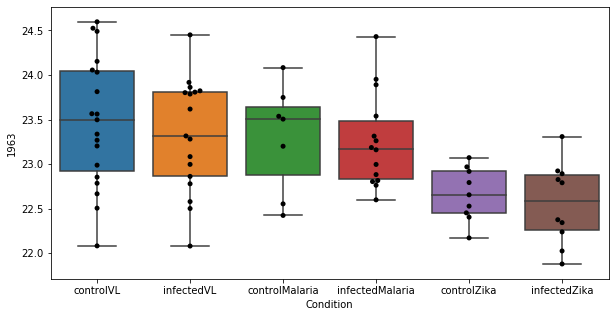

508 row m/z                149.117
row retention time     4.01666
p-val                 0.894446
adj.P.Val             0.999793
custom_id                  733
compound_names             NaN
Name: 733, dtype: object


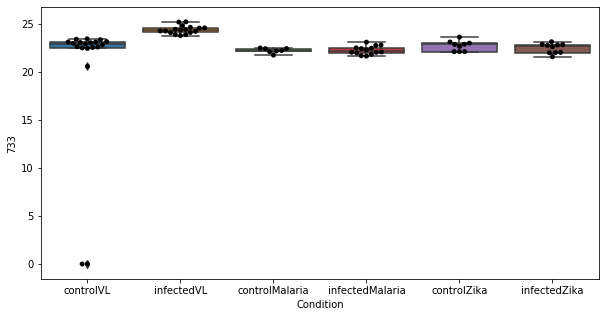

509 row m/z                                                          119.09
row retention time                                              10.4076
p-val                                                          0.894466
adj.P.Val                                                      0.999793
custom_id                                                           298
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 298, dtype: object


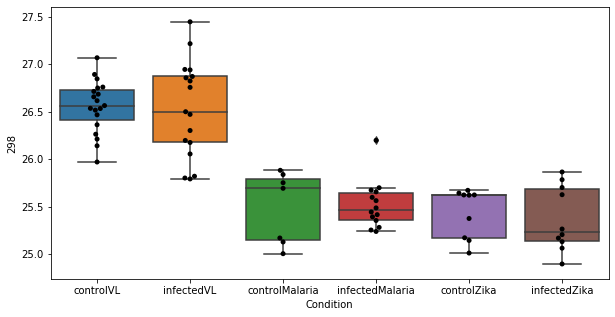

510 row m/z                342.264
row retention time     4.15032
p-val                 0.895293
adj.P.Val             0.999793
custom_id                 2542
compound_names             NaN
Name: 2542, dtype: object


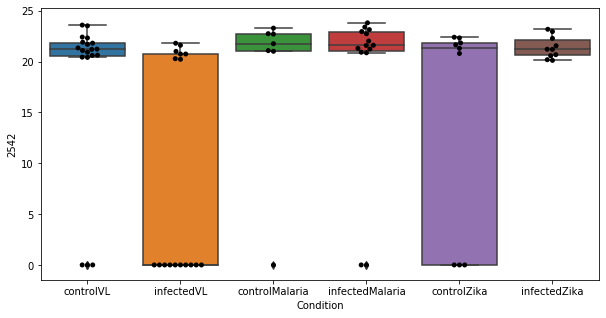

511 row m/z                 217.13
row retention time     11.6414
p-val                 0.896142
adj.P.Val             0.999793
custom_id                 1652
compound_names             NaN
Name: 1652, dtype: object


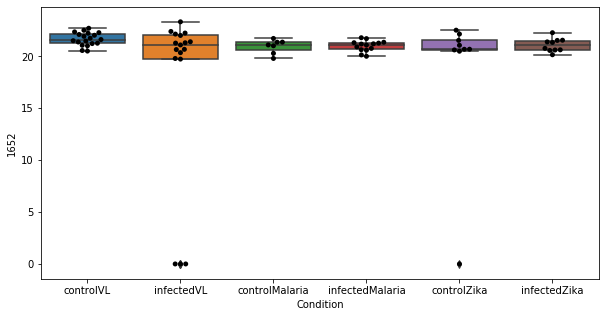

512 row m/z                                                         148.097
row retention time                                              10.1861
p-val                                                          0.897284
adj.P.Val                                                      0.999793
custom_id                                                           714
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 714, dtype: object


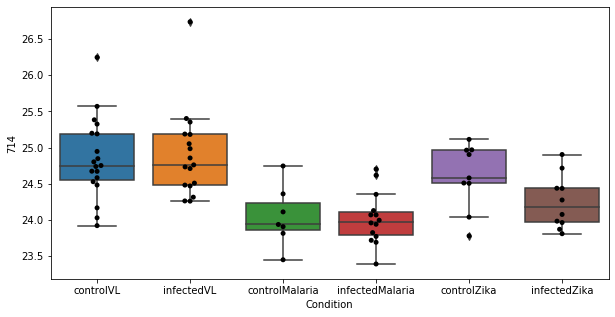

513 row m/z                186.113
row retention time     9.39741
p-val                 0.897622
adj.P.Val             0.999793
custom_id                 1234
compound_names             NaN
Name: 1234, dtype: object


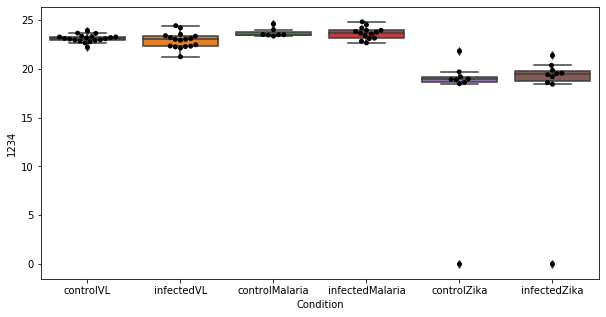

514 row m/z                 268.14
row retention time     9.21841
p-val                  0.89981
adj.P.Val             0.999793
custom_id                 2155
compound_names             NaN
Name: 2155, dtype: object


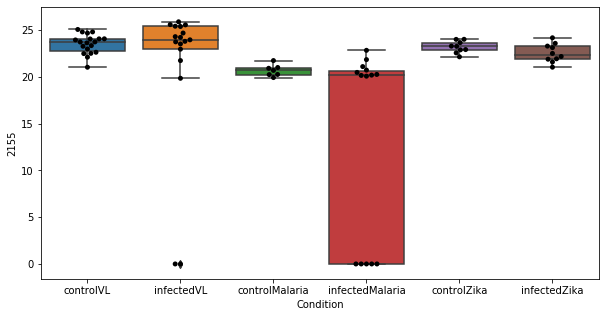

515 row m/z                314.232
row retention time     4.36989
p-val                 0.900925
adj.P.Val             0.999793
custom_id                 2451
compound_names             NaN
Name: 2451, dtype: object


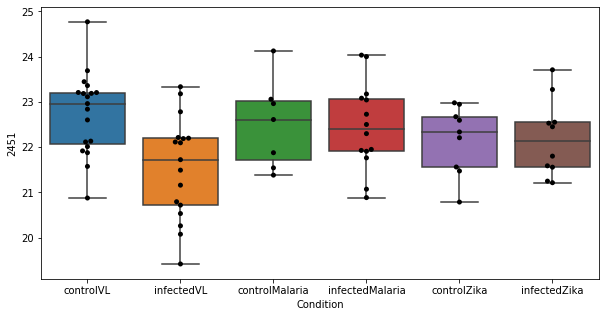

516 row m/z                                                          133.08
row retention time                                              11.6908
p-val                                                          0.903054
adj.P.Val                                                      0.999793
custom_id                                                           477
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 477, dtype: object


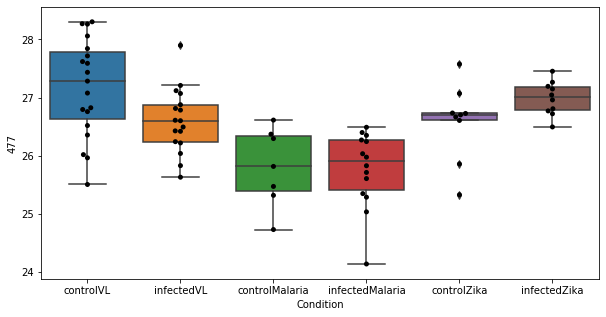

517 row m/z                131.082
row retention time     11.7969
p-val                 0.903847
adj.P.Val             0.999793
custom_id                  442
compound_names             NaN
Name: 442, dtype: object


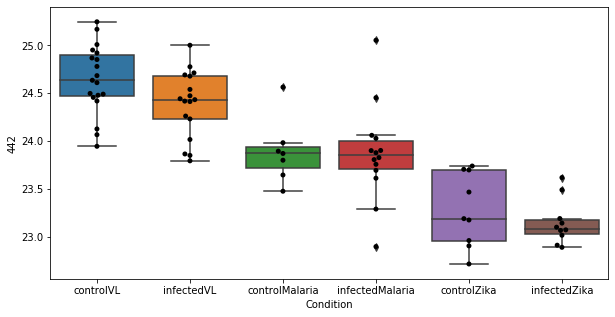

518 row m/z                164.136
row retention time     3.80014
p-val                 0.904306
adj.P.Val             0.999793
custom_id                  953
compound_names             NaN
Name: 953, dtype: object


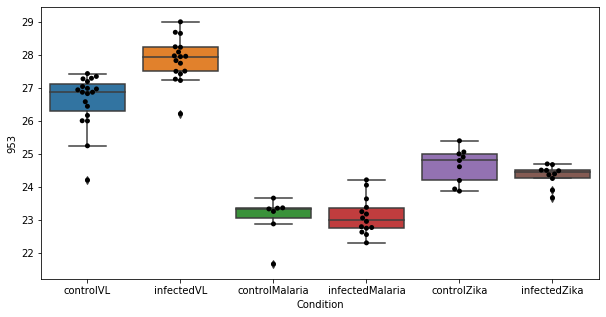

519 row m/z                                                         115.087
row retention time                                              9.18132
p-val                                                          0.905854
adj.P.Val                                                      0.999793
custom_id                                                           245
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 245, dtype: object


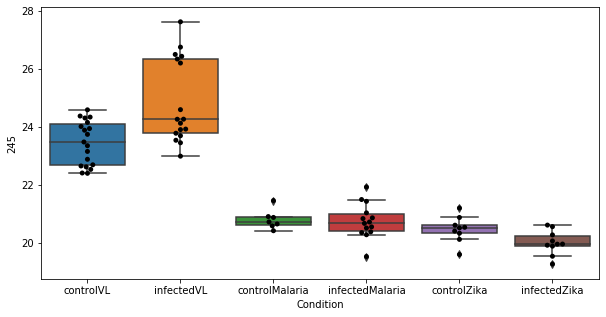

520 row m/z                327.158
row retention time     10.5766
p-val                 0.909018
adj.P.Val             0.999793
custom_id                 2495
compound_names             NaN
Name: 2495, dtype: object


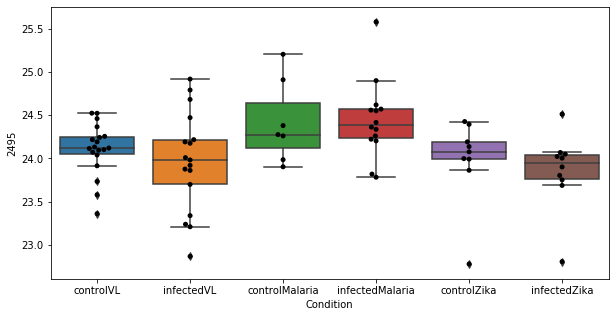

521 row m/z                195.123
row retention time     4.40422
p-val                 0.909306
adj.P.Val             0.999793
custom_id                 1372
compound_names             NaN
Name: 1372, dtype: object


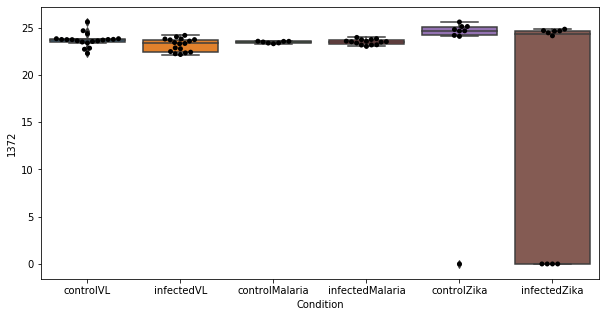

522 row m/z                305.252
row retention time     3.34847
p-val                 0.910408
adj.P.Val             0.999793
custom_id                 2402
compound_names             NaN
Name: 2402, dtype: object


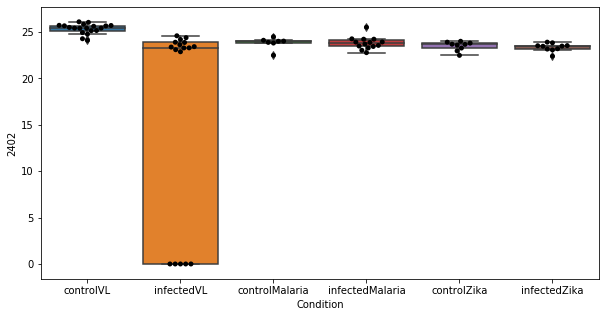

523 row m/z                117.074
row retention time     10.5785
p-val                 0.910499
adj.P.Val             0.999793
custom_id                  264
compound_names             NaN
Name: 264, dtype: object


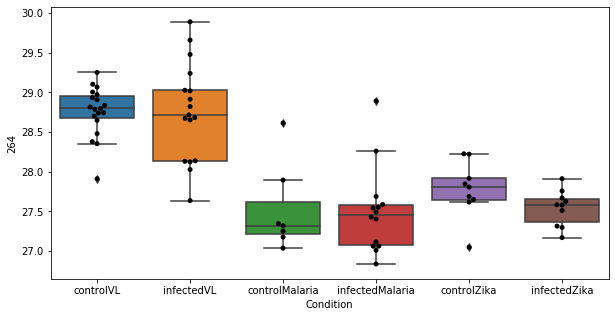

524 row m/z                183.078
row retention time     3.60118
p-val                  0.91054
adj.P.Val             0.999793
custom_id                 1187
compound_names             NaN
Name: 1187, dtype: object


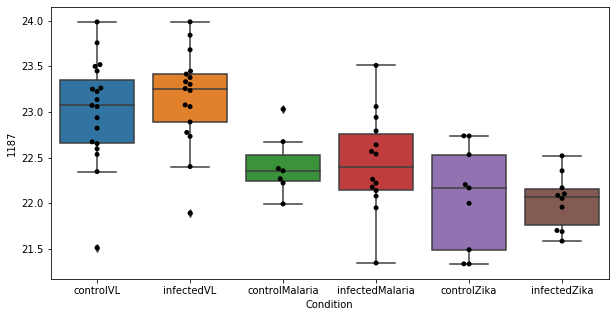

525 row m/z                663.453
row retention time     3.07059
p-val                 0.912567
adj.P.Val             0.999793
custom_id                 2896
compound_names             NaN
Name: 2896, dtype: object


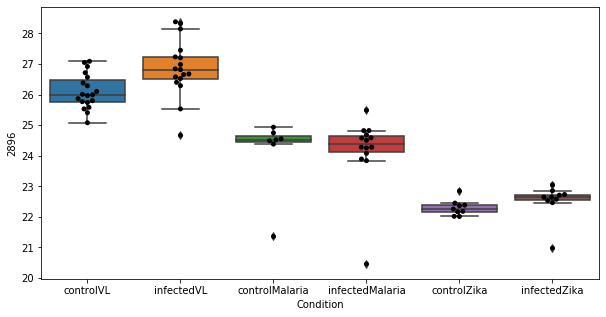

526 row m/z                251.185
row retention time     3.75476
p-val                 0.913179
adj.P.Val             0.999793
custom_id                 2017
compound_names             NaN
Name: 2017, dtype: object


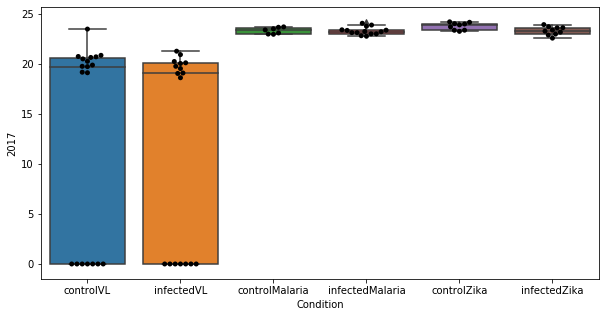

527 row m/z                286.201
row retention time     4.39654
p-val                 0.914499
adj.P.Val             0.999793
custom_id                 2296
compound_names             NaN
Name: 2296, dtype: object


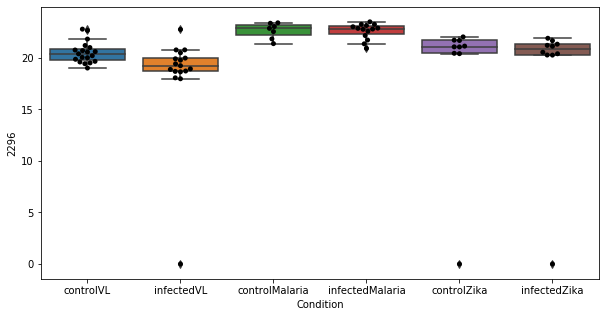

528 row m/z                                                         284.197
row retention time                                              6.69722
p-val                                                          0.914633
adj.P.Val                                                      0.999793
custom_id                                                          2275
compound_names        3(S),8(S)-dihydroxy-6E,10Z-hexadecadienoate$3(...
Name: 2275, dtype: object


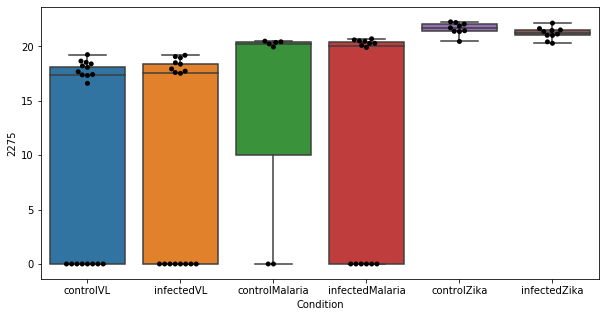

529 row m/z                                 328.162
row retention time                      10.5872
p-val                                  0.915038
adj.P.Val                              0.999793
custom_id                                  2501
compound_names        5'-carboxy-gama-chromanol
Name: 2501, dtype: object


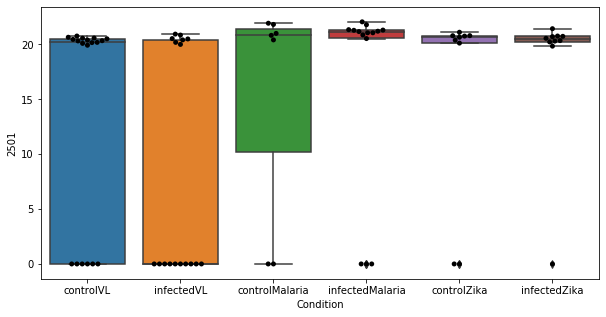

530 row m/z                675.543
row retention time     3.46379
p-val                  0.91546
adj.P.Val             0.999793
custom_id                 2904
compound_names             NaN
Name: 2904, dtype: object


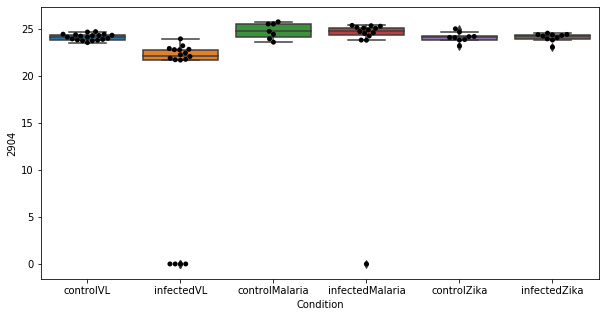

531 row m/z                731.606
row retention time     3.37124
p-val                 0.916212
adj.P.Val             0.999793
custom_id                 2936
compound_names             NaN
Name: 2936, dtype: object


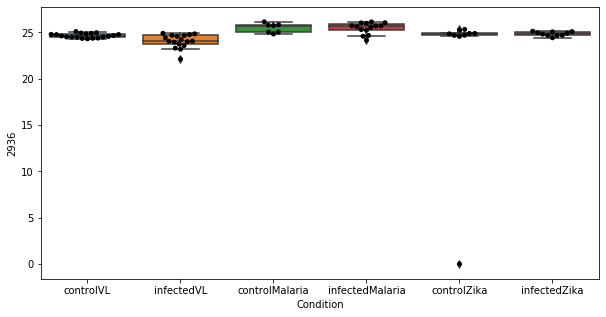

532 row m/z                      198.113
row retention time           6.71449
p-val                       0.918649
adj.P.Val                   0.999793
custom_id                       1397
compound_names        L-Metanephrine
Name: 1397, dtype: object


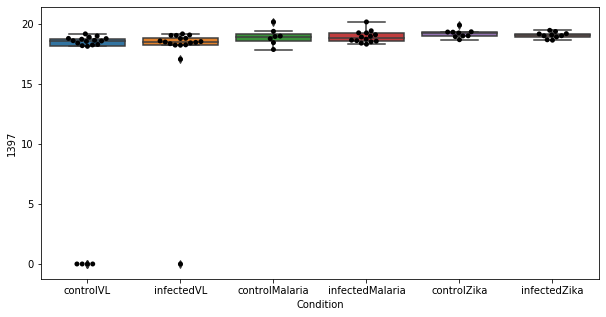

533 row m/z                                                         181.072
row retention time                                              6.70373
p-val                                                          0.918813
adj.P.Val                                                      0.999793
custom_id                                                          1174
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1174, dtype: object


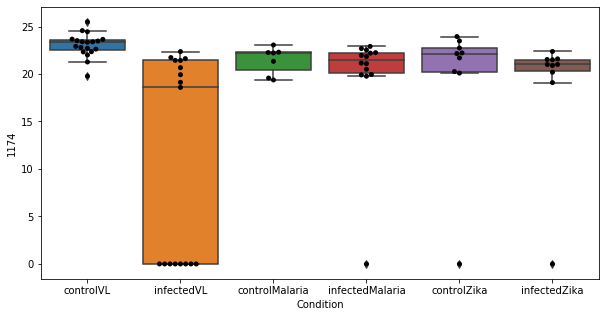

534 row m/z                                                         133.069
row retention time                                              11.5737
p-val                                                           0.92127
adj.P.Val                                                      0.999793
custom_id                                                           475
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 475, dtype: object


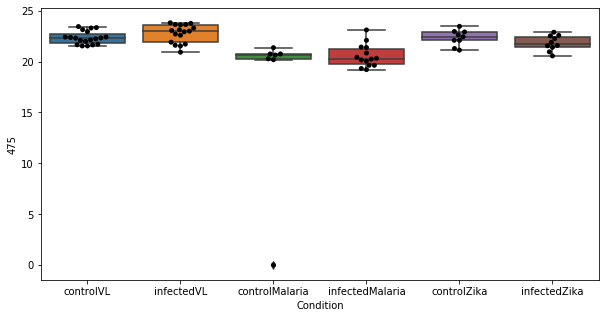

535 row m/z                597.509
row retention time     3.00226
p-val                 0.924278
adj.P.Val             0.999793
custom_id                 2857
compound_names             NaN
Name: 2857, dtype: object


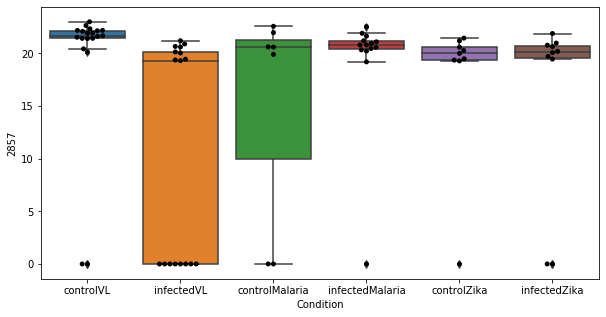

536 row m/z                          189.123
row retention time               10.4352
p-val                           0.925348
adj.P.Val                       0.999793
custom_id                           1281
compound_names        N6-Acetyl-L-lysine
Name: 1281, dtype: object


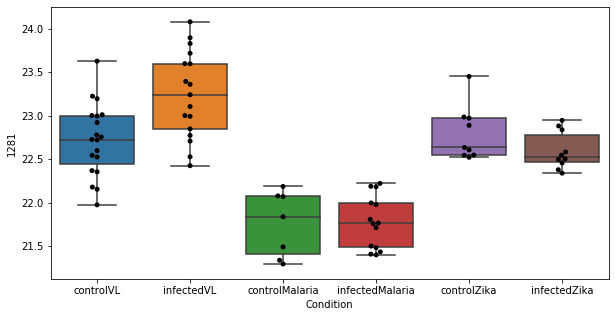

537 row m/z                           288.217
row retention time                4.38402
p-val                            0.925818
adj.P.Val                        0.999793
custom_id                            2308
compound_names        L-Octanoylcarnitine
Name: 2308, dtype: object


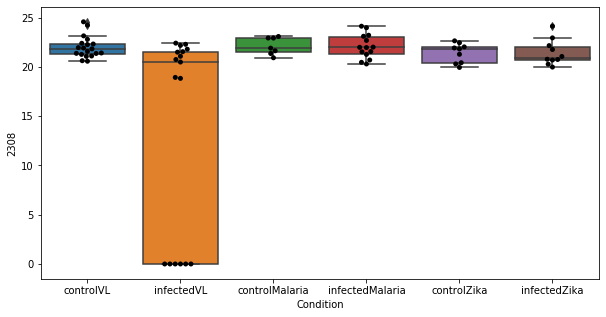

538 row m/z                                                         132.066
row retention time                                              8.34178
p-val                                                          0.925882
adj.P.Val                                                      0.999793
custom_id                                                           458
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 458, dtype: object


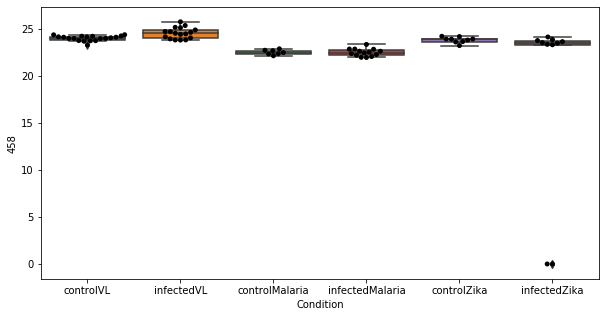

539 row m/z                163.133
row retention time     3.79947
p-val                 0.926674
adj.P.Val             0.999793
custom_id                  938
compound_names             NaN
Name: 938, dtype: object


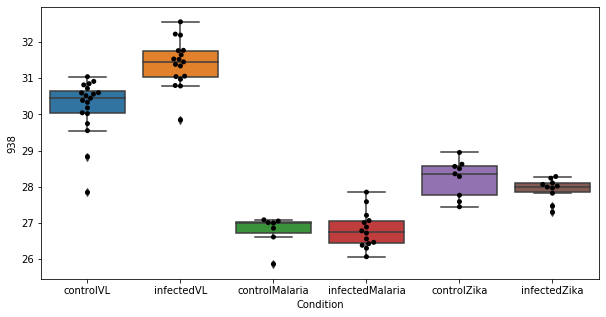

540 row m/z                164.029
row retention time        11.6
p-val                 0.928701
adj.P.Val             0.999793
custom_id                  945
compound_names             NaN
Name: 945, dtype: object


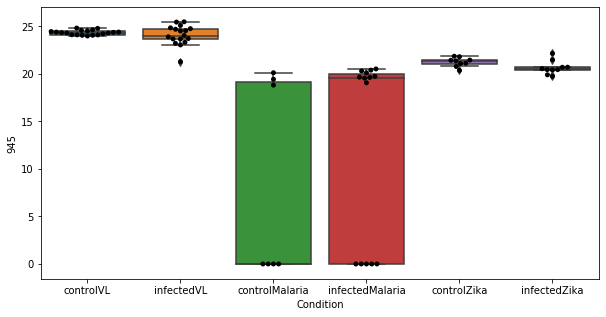

541 row m/z                275.103
row retention time     11.8913
p-val                 0.929171
adj.P.Val             0.999793
custom_id                 2205
compound_names             NaN
Name: 2205, dtype: object


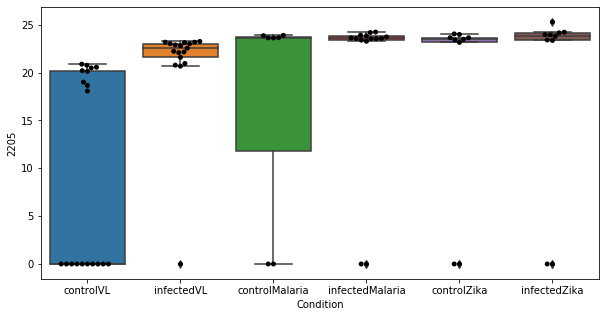

542 row m/z                                                         144.102
row retention time                                              6.70776
p-val                                                          0.929258
adj.P.Val                                                      0.999793
custom_id                                                           634
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 634, dtype: object


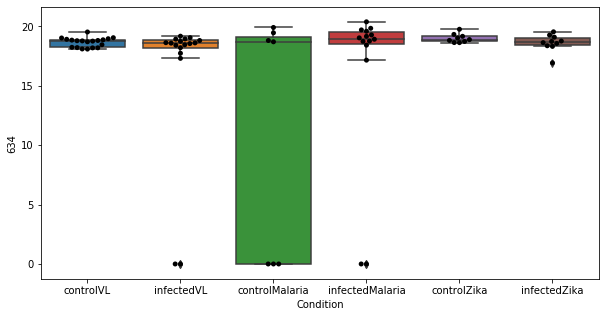

543 row m/z                                                         126.022
row retention time                                              12.2095
p-val                                                          0.929996
adj.P.Val                                                      0.999793
custom_id                                                           371
compound_names        Taurine; 2-Aminoethanesulfonic acid; Aminoethy...
Name: 371, dtype: object


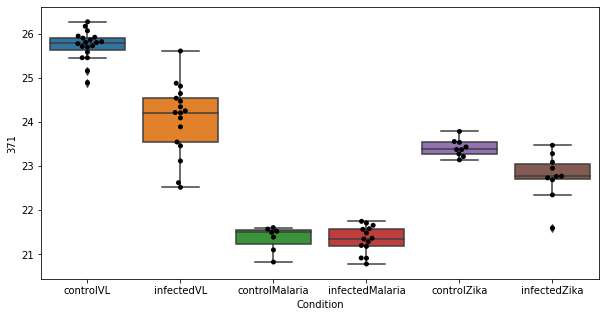

544 row m/z                                      76.0393
row retention time                           12.3886
p-val                                       0.932687
adj.P.Val                                   0.999793
custom_id                                         17
compound_names        Glycine; Aminoacetic acid; Gly
Name: 17, dtype: object


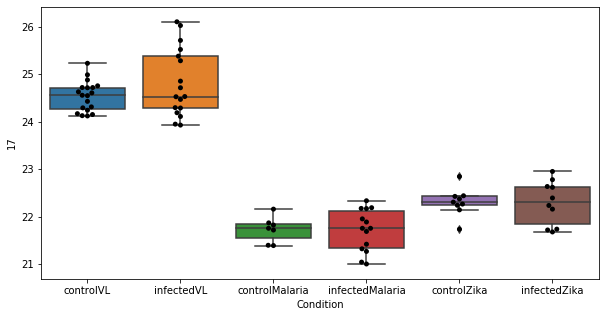

545 row m/z                160.133
row retention time     10.6993
p-val                 0.933814
adj.P.Val             0.999793
custom_id                  903
compound_names             NaN
Name: 903, dtype: object


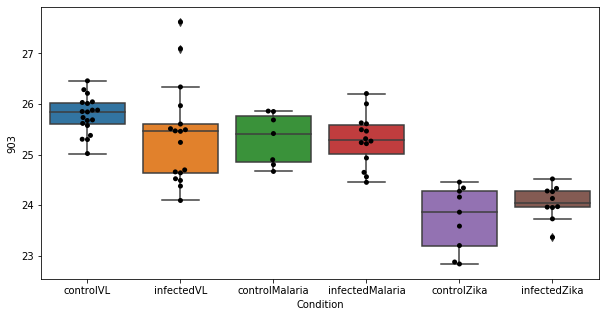

546 row m/z                117.068
row retention time     10.5804
p-val                 0.934244
adj.P.Val             0.999793
custom_id                  263
compound_names             NaN
Name: 263, dtype: object


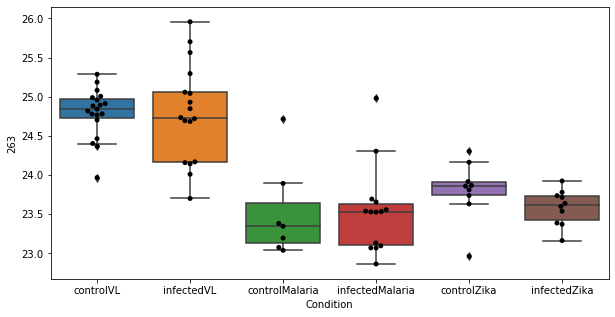

547 row m/z                785.588
row retention time     3.20243
p-val                 0.934572
adj.P.Val             0.999793
custom_id                 3013
compound_names             NaN
Name: 3013, dtype: object


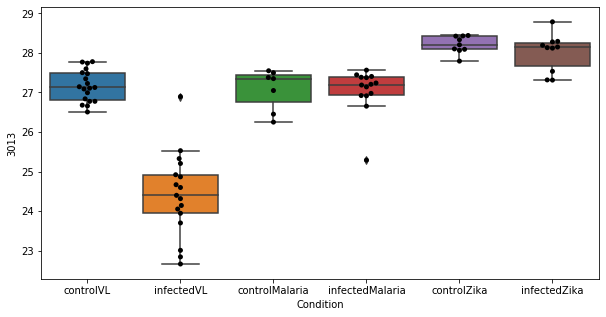

548 row m/z                188.128
row retention time     6.71156
p-val                 0.935817
adj.P.Val             0.999793
custom_id                 1269
compound_names             NaN
Name: 1269, dtype: object


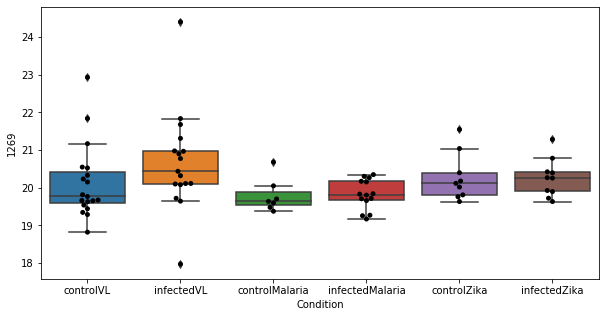

549 row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object


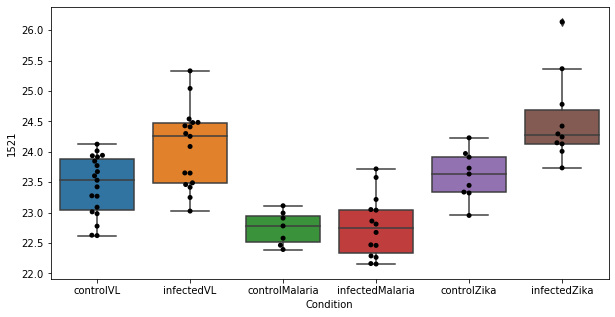

550 row m/z                701.559
row retention time     3.42053
p-val                 0.936575
adj.P.Val             0.999793
custom_id                 2916
compound_names             NaN
Name: 2916, dtype: object


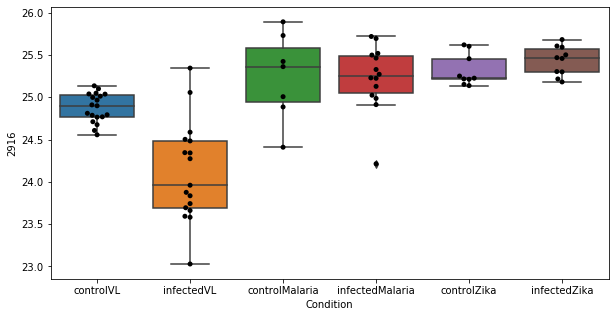

551 row m/z                158.154
row retention time     3.61479
p-val                 0.937181
adj.P.Val             0.999793
custom_id                  868
compound_names             NaN
Name: 868, dtype: object


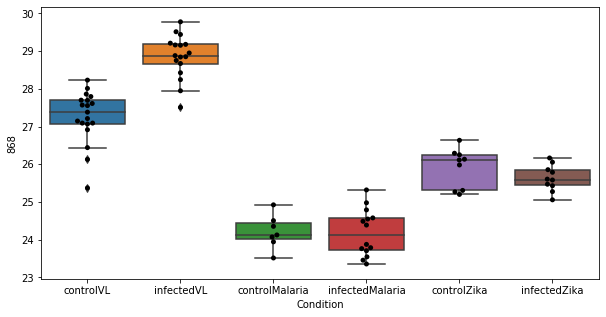

552 row m/z                                                         166.086
row retention time                                              6.71471
p-val                                                          0.938878
adj.P.Val                                                      0.999793
custom_id                                                           984
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 984, dtype: object


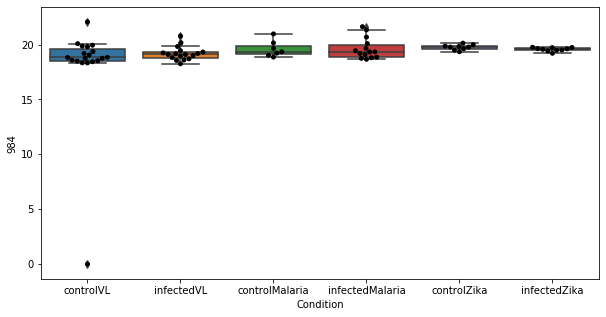

553 row m/z                207.113
row retention time     8.85047
p-val                 0.939069
adj.P.Val             0.999793
custom_id                 1508
compound_names             NaN
Name: 1508, dtype: object


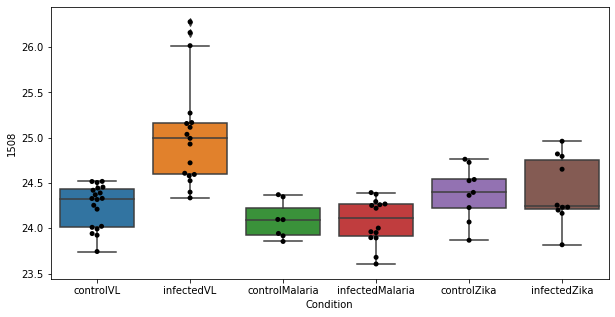

554 row m/z                 217.18
row retention time     3.49689
p-val                 0.939111
adj.P.Val             0.999793
custom_id                 1653
compound_names             NaN
Name: 1653, dtype: object


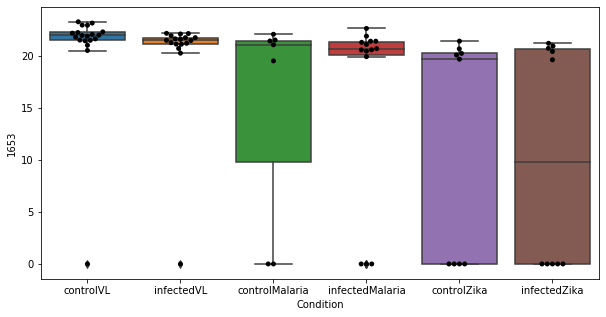

555 row m/z                212.149
row retention time     4.40798
p-val                 0.939479
adj.P.Val             0.999793
custom_id                 1575
compound_names             NaN
Name: 1575, dtype: object


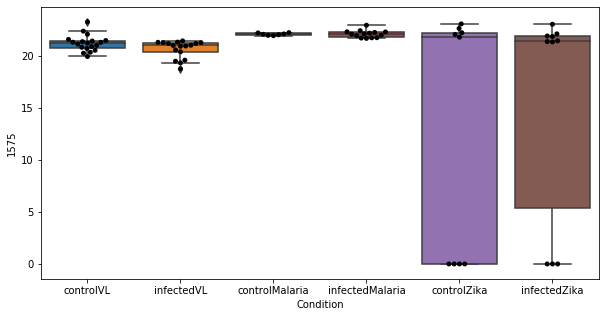

556 row m/z                                                         91.0583
row retention time                                               11.794
p-val                                                          0.939794
adj.P.Val                                                      0.999793
custom_id                                                            88
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 88, dtype: object


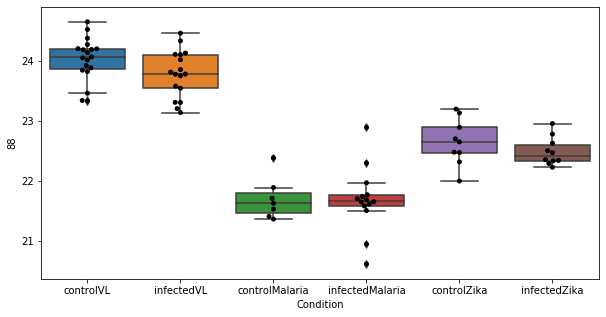

557 row m/z                225.149
row retention time     3.59688
p-val                 0.941103
adj.P.Val             0.999793
custom_id                 1734
compound_names             NaN
Name: 1734, dtype: object


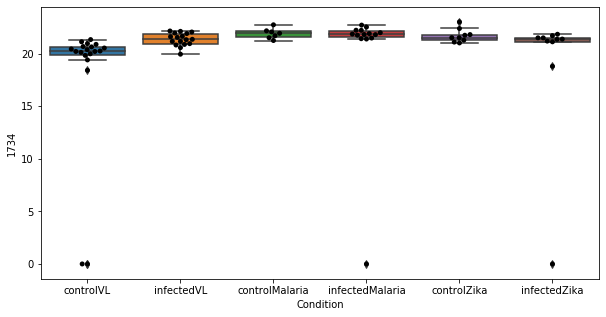

558 row m/z                262.144
row retention time     6.68582
p-val                 0.943313
adj.P.Val             0.999793
custom_id                 2117
compound_names             NaN
Name: 2117, dtype: object


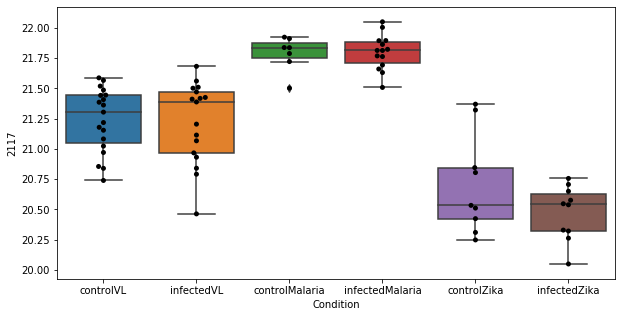

559 row m/z                                                         187.097
row retention time                                              6.70945
p-val                                                          0.945186
adj.P.Val                                                      0.999793
custom_id                                                          1252
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1252, dtype: object


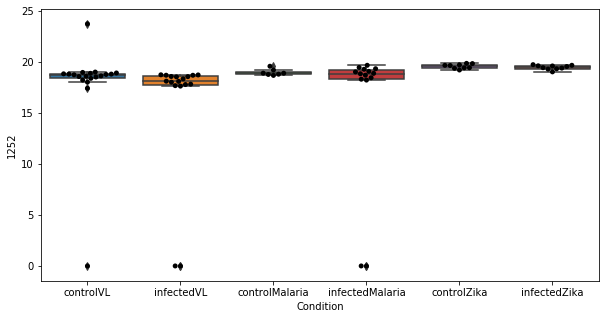

560 row m/z                                              213
row retention time                               10.8052
p-val                                           0.945347
adj.P.Val                                       0.999793
custom_id                                           1583
compound_names        Oxalosuccinate; Oxalosuccinic acid
Name: 1583, dtype: object


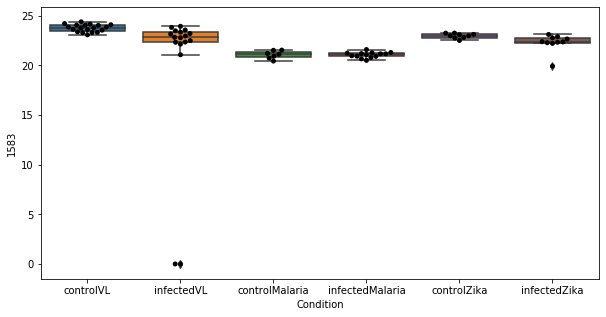

561 row m/z                129.127
row retention time     3.49848
p-val                 0.946198
adj.P.Val             0.999793
custom_id                  401
compound_names             NaN
Name: 401, dtype: object


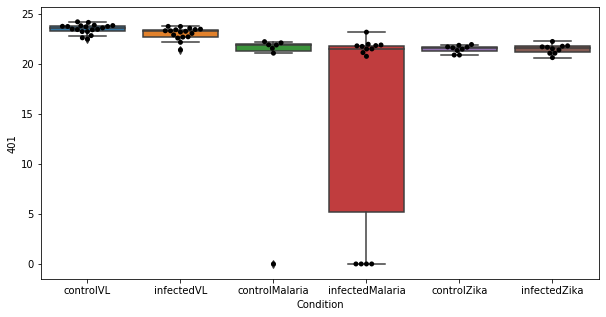

562 row m/z                                                157.097
row retention time                                     10.5789
p-val                                                  0.94756
adj.P.Val                                             0.999793
custom_id                                                  848
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 848, dtype: object


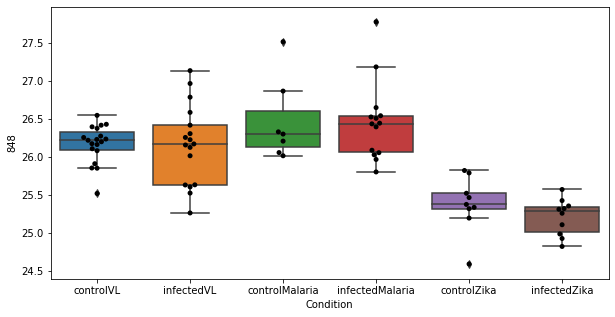

563 row m/z                                                         171.096
row retention time                                              10.5261
p-val                                                          0.948921
adj.P.Val                                                      0.999793
custom_id                                                          1048
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 1048, dtype: object


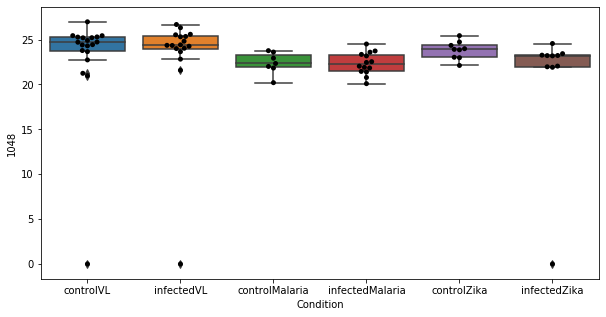

564 row m/z                145.105
row retention time      9.1985
p-val                  0.95241
adj.P.Val             0.999793
custom_id                  650
compound_names             NaN
Name: 650, dtype: object


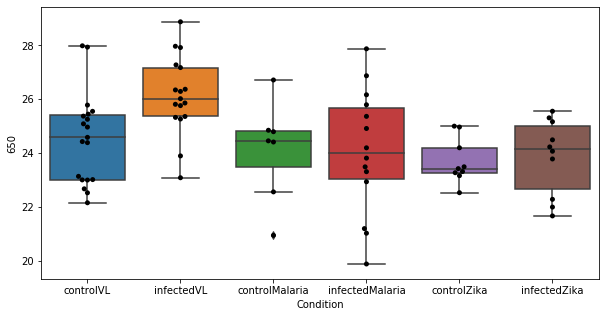

565 row m/z                                                         198.085
row retention time                                              12.4151
p-val                                                          0.952694
adj.P.Val                                                      0.999793
custom_id                                                          1393
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1393, dtype: object


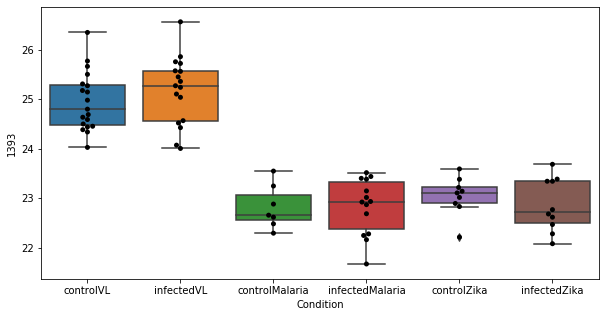

566 row m/z                763.595
row retention time     3.20319
p-val                 0.953824
adj.P.Val             0.999793
custom_id                 2979
compound_names             NaN
Name: 2979, dtype: object


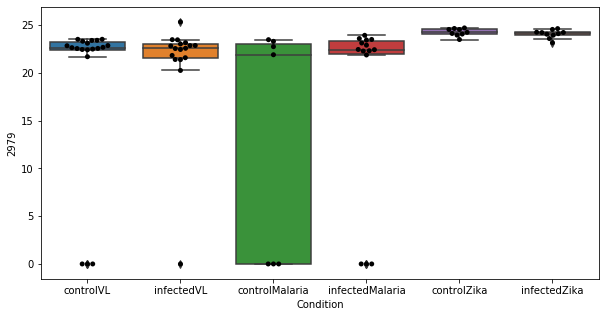

567 row m/z                                                   174.087
row retention time                                         11.518
p-val                                                    0.954064
adj.P.Val                                                0.999793
custom_id                                                    1087
compound_names        N-Methyltyramine$N-Methylphenylethanolamine
Name: 1087, dtype: object


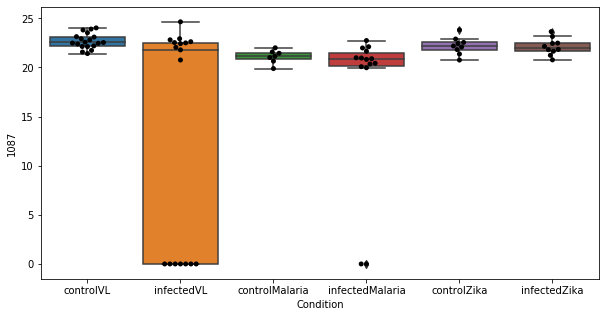

568 row m/z                165.112
row retention time     4.26748
p-val                 0.959929
adj.P.Val             0.999793
custom_id                  963
compound_names             NaN
Name: 963, dtype: object


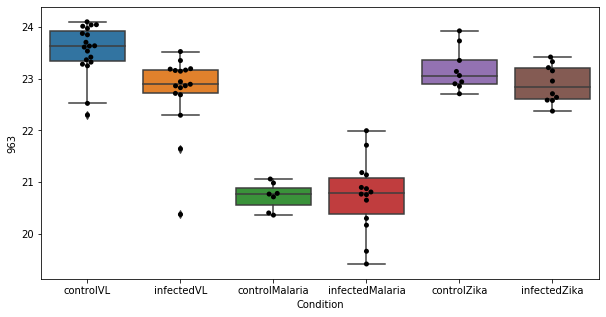

569 row m/z                                                   273.186
row retention time                                        3.45163
p-val                                                    0.960163
adj.P.Val                                                0.999793
custom_id                                                    2187
compound_names        Estradiol-17beta; beta-Estradiol; Estradiol
Name: 2187, dtype: object


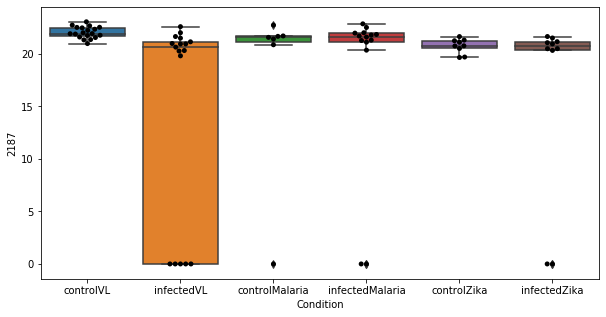

570 row m/z                                                         149.081
row retention time                                              11.9079
p-val                                                          0.961923
adj.P.Val                                                      0.999793
custom_id                                                           731
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 731, dtype: object


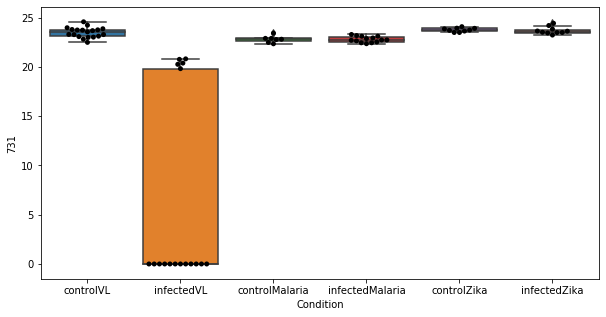

571 row m/z                236.073
row retention time     10.8693
p-val                 0.962319
adj.P.Val             0.999793
custom_id                 5002
compound_names             NaN
Name: 5002, dtype: object


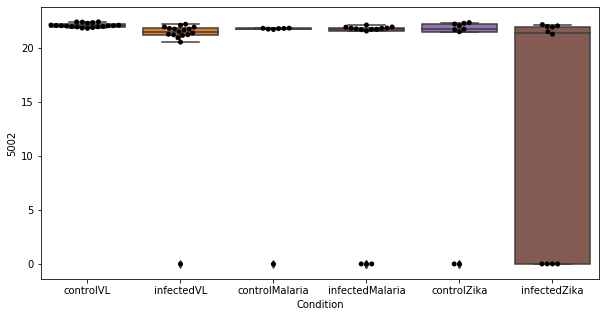

572 row m/z                                                         256.165
row retention time                                              6.70207
p-val                                                          0.963237
adj.P.Val                                                      0.999793
custom_id                                                          2053
compound_names        3-oxo-6(R)-hydroxy-tetradec-8-cis-enoate$3-oxo...
Name: 2053, dtype: object


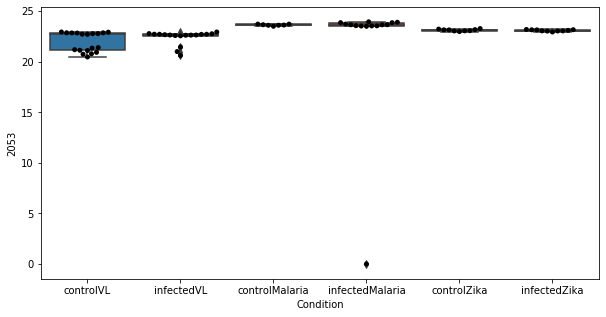

573 row m/z                           218.138
row retention time                 4.2172
p-val                             0.96384
adj.P.Val                        0.999793
custom_id                            1662
compound_names        propionyl-carnitine
Name: 1662, dtype: object


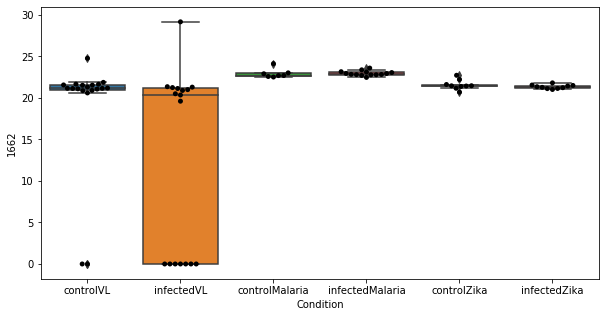

574 row m/z                                                          148.08
row retention time                                              11.9036
p-val                                                          0.967016
adj.P.Val                                                      0.999793
custom_id                                                           713
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 713, dtype: object


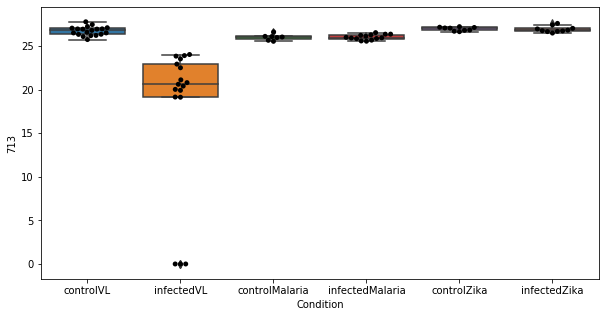

575 row m/z                                                         132.102
row retention time                                              6.70334
p-val                                                          0.967488
adj.P.Val                                                      0.999793
custom_id                                                           463
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 463, dtype: object


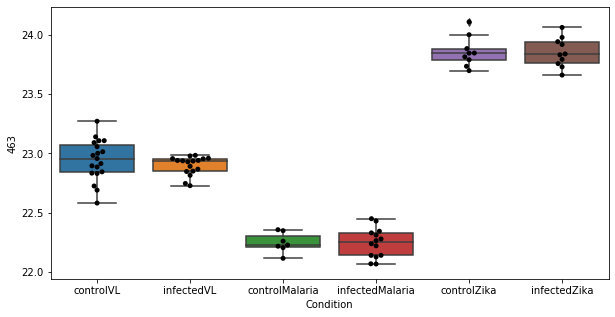

576 row m/z                204.123
row retention time     9.29506
p-val                 0.967848
adj.P.Val             0.999793
custom_id                 1480
compound_names             NaN
Name: 1480, dtype: object


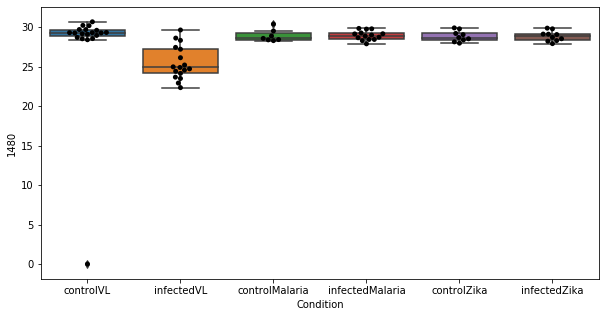

577 row m/z                246.243
row retention time     6.66364
p-val                 0.970096
adj.P.Val             0.999793
custom_id                 1969
compound_names             NaN
Name: 1969, dtype: object


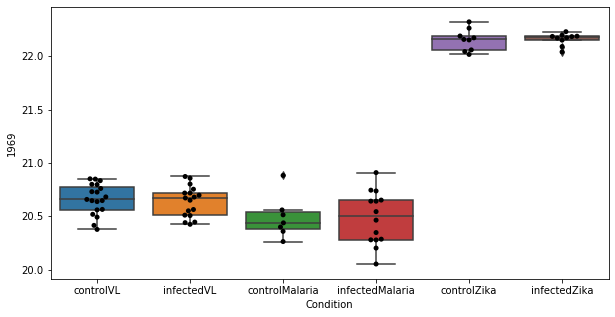

578 row m/z                                                          127.05
row retention time                                              10.0612
p-val                                                          0.970497
adj.P.Val                                                      0.999793
custom_id                                                           372
compound_names        Thymine; 5-Methyluracil$Imidazole-4-acetate; I...
Name: 372, dtype: object


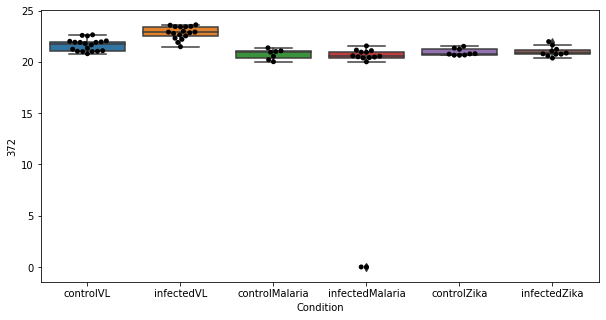

579 row m/z                219.019
row retention time     10.5758
p-val                 0.971113
adj.P.Val             0.999793
custom_id                 1680
compound_names             NaN
Name: 1680, dtype: object


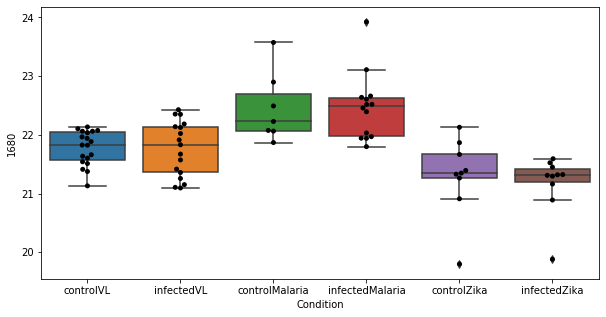

580 row m/z                                                          130.05
row retention time                                              11.8903
p-val                                                          0.971117
adj.P.Val                                                      0.999793
custom_id                                                           410
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 410, dtype: object


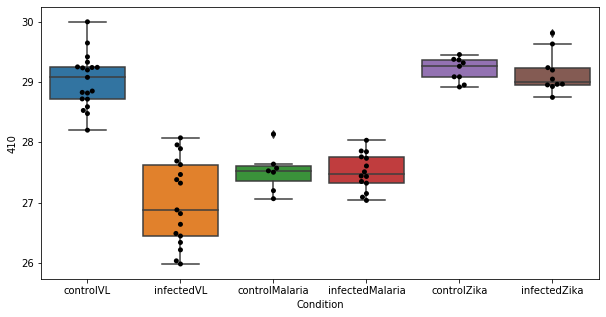

581 row m/z                230.158
row retention time      10.551
p-val                 0.971943
adj.P.Val             0.999793
custom_id                 3874
compound_names             NaN
Name: 3874, dtype: object


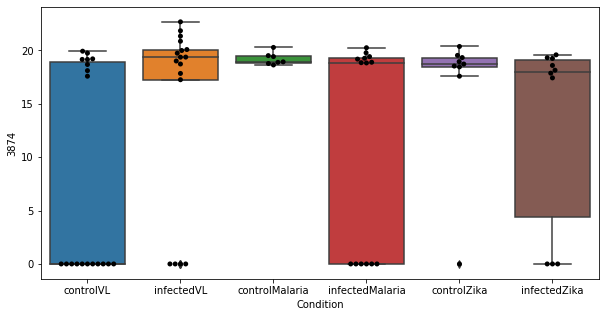

582 row m/z                769.593
row retention time      3.1881
p-val                 0.972295
adj.P.Val             0.999793
custom_id                 2989
compound_names             NaN
Name: 2989, dtype: object


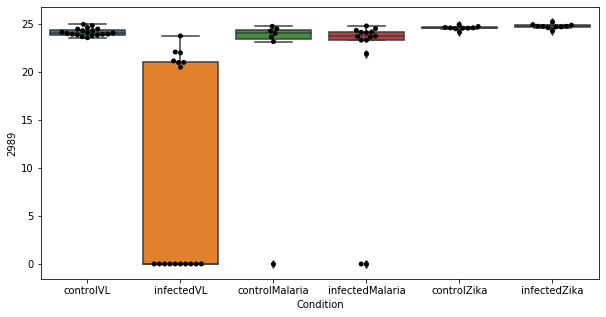

583 row m/z                254.026
row retention time     10.7961
p-val                  0.97278
adj.P.Val             0.999793
custom_id                 2044
compound_names             NaN
Name: 2044, dtype: object


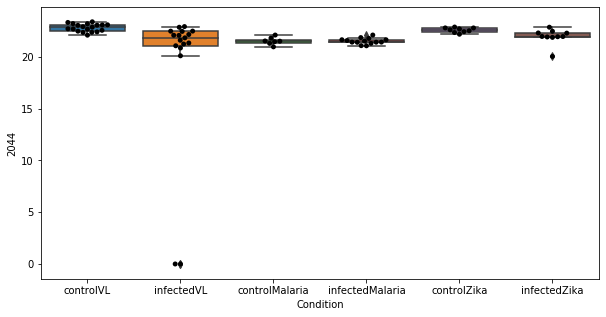

584 row m/z                                                         147.076
row retention time                                              11.9052
p-val                                                          0.974901
adj.P.Val                                                      0.999793
custom_id                                                           689
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 689, dtype: object


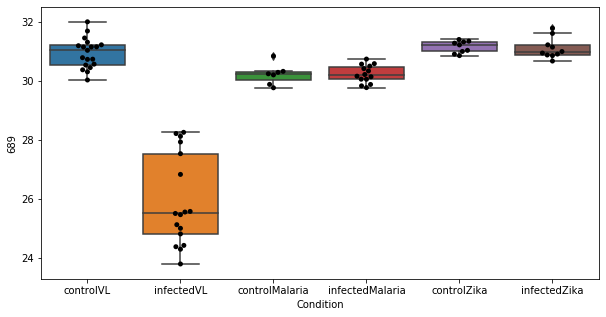

585 row m/z                144.102
row retention time     9.19626
p-val                 0.975215
adj.P.Val             0.999793
custom_id                  631
compound_names             NaN
Name: 631, dtype: object


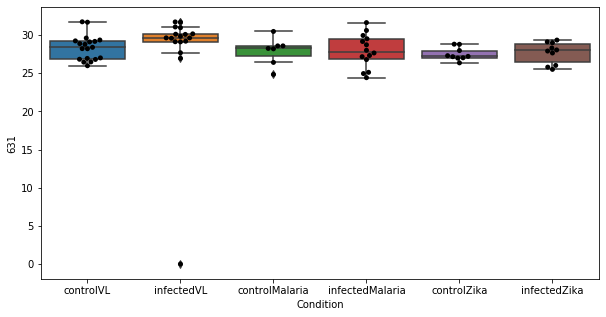

586 row m/z                 264.18
row retention time      3.4916
p-val                 0.976238
adj.P.Val             0.999793
custom_id                 2136
compound_names             NaN
Name: 2136, dtype: object


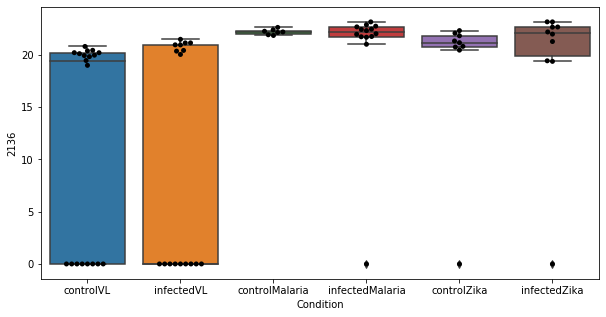

587 row m/z                744.589
row retention time     3.20892
p-val                 0.978092
adj.P.Val             0.999793
custom_id                 2955
compound_names             NaN
Name: 2955, dtype: object


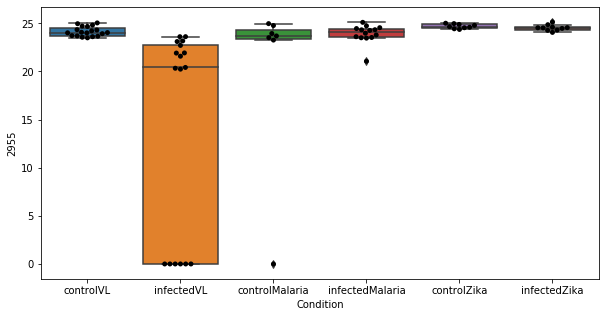

588 row m/z                213.022
row retention time     11.9045
p-val                 0.978099
adj.P.Val             0.999793
custom_id                 1584
compound_names             NaN
Name: 1584, dtype: object


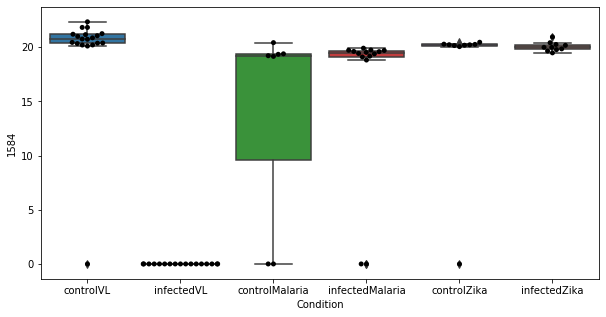

589 row m/z                209.154
row retention time     3.60987
p-val                 0.979855
adj.P.Val             0.999793
custom_id                 1531
compound_names             NaN
Name: 1531, dtype: object


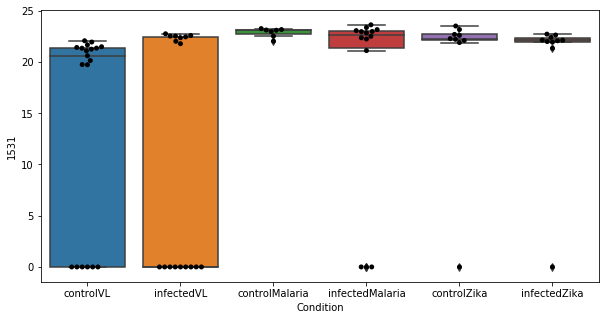

590 row m/z                767.577
row retention time     3.19097
p-val                 0.983457
adj.P.Val             0.999793
custom_id                 2985
compound_names             NaN
Name: 2985, dtype: object


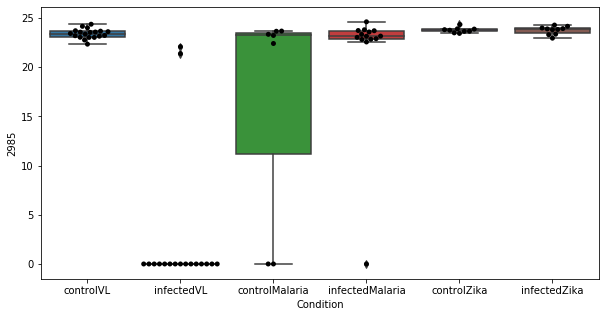

591 row m/z                                                         148.073
row retention time                                              11.9154
p-val                                                          0.985053
adj.P.Val                                                      0.999793
custom_id                                                           712
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 712, dtype: object


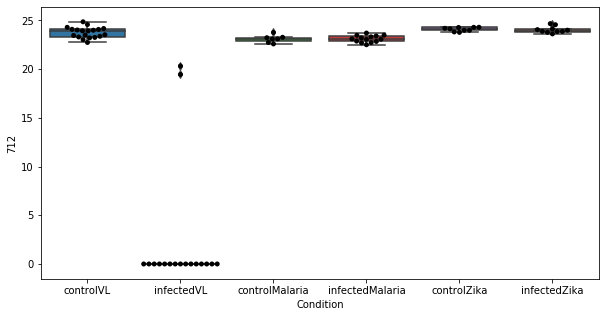

592 row m/z                                                          235.08
row retention time                                              11.8551
p-val                                                          0.986255
adj.P.Val                                                      0.999793
custom_id                                                          1854
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1854, dtype: object


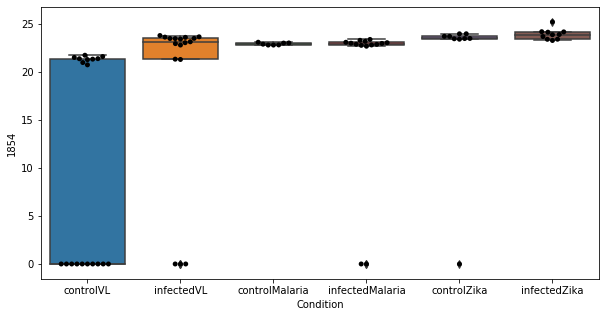

593 row m/z                 344.28
row retention time     4.10462
p-val                 0.986814
adj.P.Val             0.999793
custom_id                 2550
compound_names             NaN
Name: 2550, dtype: object


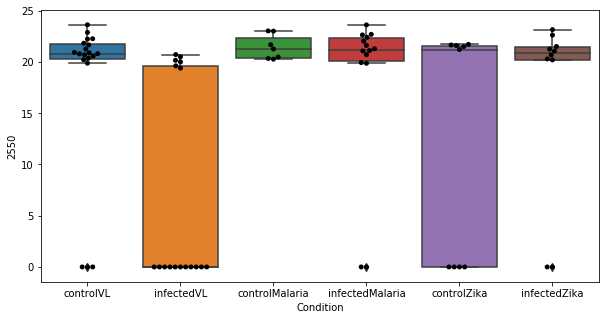

594 row m/z                235.119
row retention time      6.7165
p-val                 0.987362
adj.P.Val             0.999793
custom_id                 1858
compound_names             NaN
Name: 1858, dtype: object


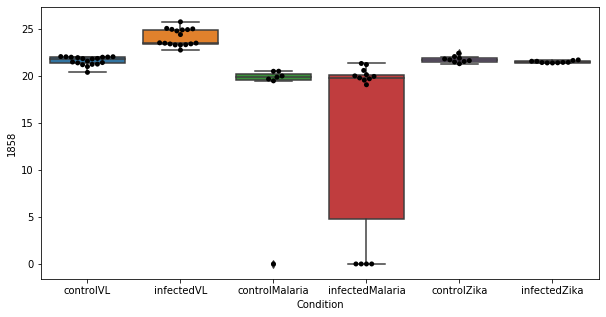

595 row m/z                118.077
row retention time      10.578
p-val                 0.988685
adj.P.Val             0.999793
custom_id                  279
compound_names             NaN
Name: 279, dtype: object


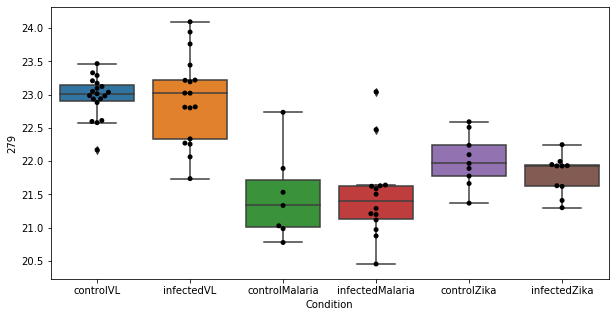

596 row m/z                                                         151.048
row retention time                                              11.8722
p-val                                                          0.988694
adj.P.Val                                                      0.999793
custom_id                                                           757
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 757, dtype: object


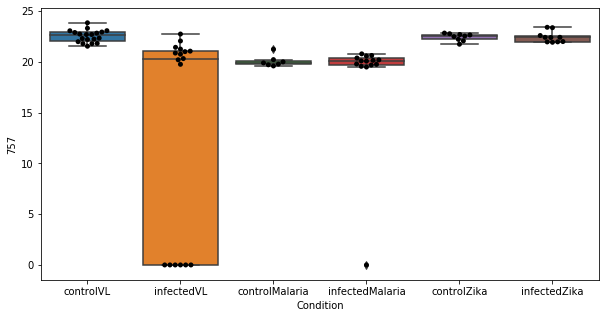

597 row m/z                304.212
row retention time     6.72258
p-val                 0.993405
adj.P.Val             0.999793
custom_id                 2396
compound_names             NaN
Name: 2396, dtype: object


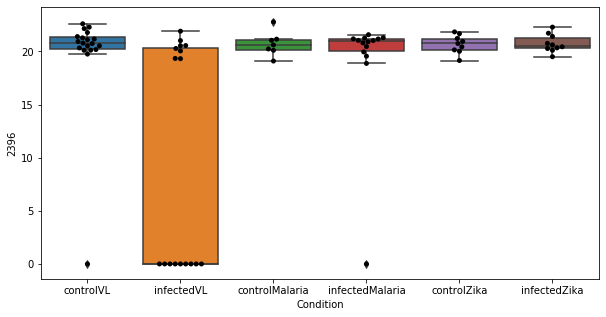

598 row m/z                205.126
row retention time      9.2928
p-val                 0.994335
adj.P.Val             0.999793
custom_id                 1503
compound_names             NaN
Name: 1503, dtype: object


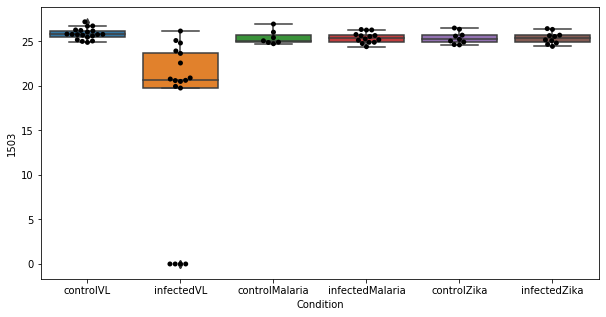

599 row m/z                114.066
row retention time     11.6879
p-val                 0.994362
adj.P.Val             0.999793
custom_id                  230
compound_names             NaN
Name: 230, dtype: object


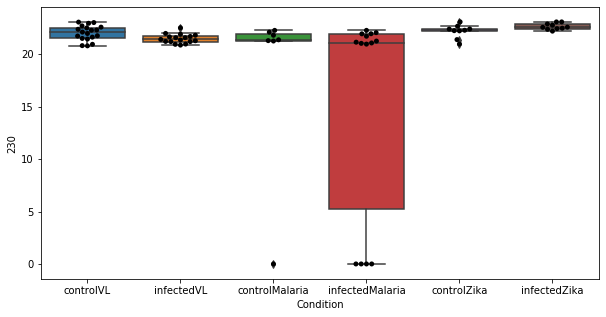

600 row m/z                248.147
row retention time     7.69265
p-val                  0.99583
adj.P.Val             0.999793
custom_id                 1984
compound_names             NaN
Name: 1984, dtype: object


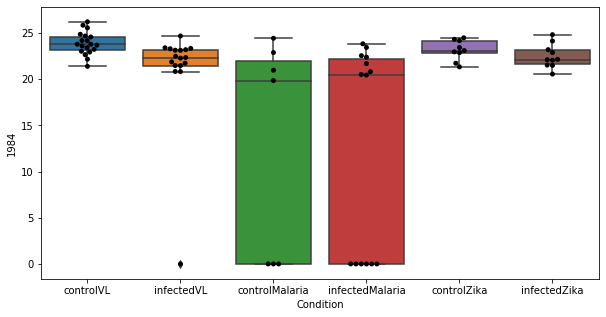

601 row m/z                                                         120.081
row retention time                                               8.8545
p-val                                                          0.996745
adj.P.Val                                                      0.999793
custom_id                                                           305
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 305, dtype: object


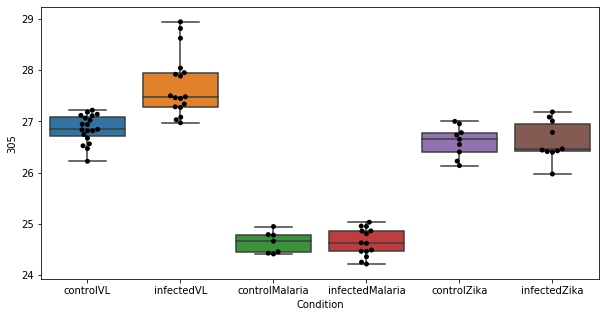

602 row m/z                                                         176.071
row retention time                                              8.29619
p-val                                                            0.9974
adj.P.Val                                                      0.999793
custom_id                                                          1118
compound_names        4-Hydroxy-5-phenyltetrahydro-1,3-oxazin-2-one$...
Name: 1118, dtype: object


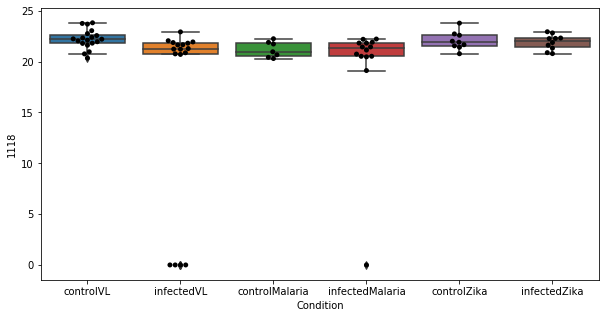

603 row m/z                801.683
row retention time     3.29424
p-val                 0.999607
adj.P.Val             0.999793
custom_id                 3056
compound_names             NaN
Name: 3056, dtype: object


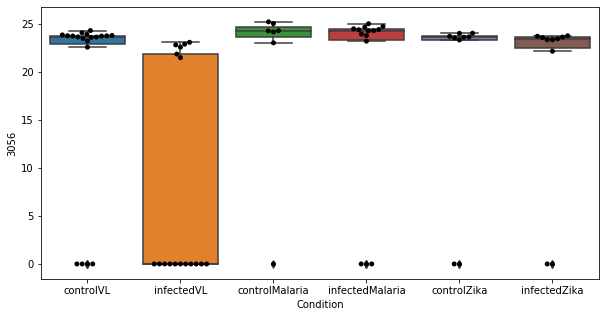

604 row m/z                286.201
row retention time     6.71285
p-val                 0.999793
adj.P.Val             0.999793
custom_id                 2295
compound_names             NaN
Name: 2295, dtype: object


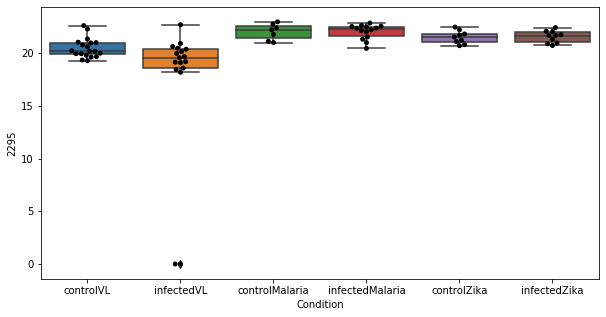

KeyError: 'Condition'

In [263]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

0 row m/z                    258.11
row retention time        11.3506
p-val                 9.07684e-07
adj.P.Val             0.000549149
custom_id                    2080
compound_names                NaN
Name: 2080, dtype: object


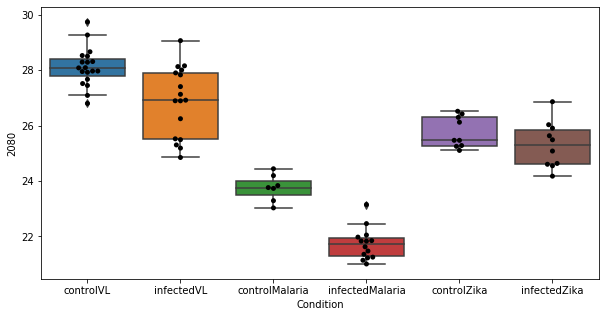

1 row m/z                   482.361
row retention time        3.86973
p-val                 2.52872e-05
adj.P.Val              0.00764939
custom_id                    2754
compound_names                NaN
Name: 2754, dtype: object


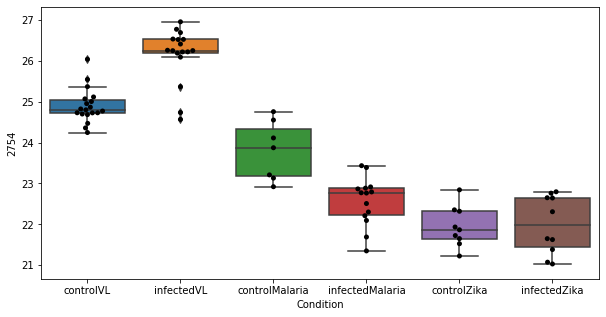

2 row m/z                                                         524.371
row retention time                                               3.7029
p-val                                                       0.000184762
adj.P.Val                                                     0.0235834
custom_id                                                          2798
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2798, dtype: object


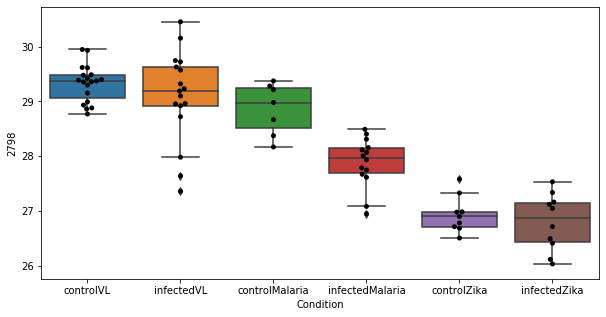

3 row m/z                   525.375
row retention time         3.7012
p-val                 0.000216906
adj.P.Val               0.0235834
custom_id                    2800
compound_names                NaN
Name: 2800, dtype: object


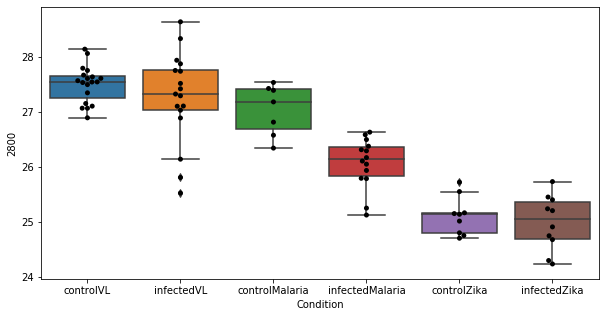

4 row m/z                   158.118
row retention time        8.65825
p-val                 0.000225119
adj.P.Val               0.0235834
custom_id                     862
compound_names                NaN
Name: 862, dtype: object


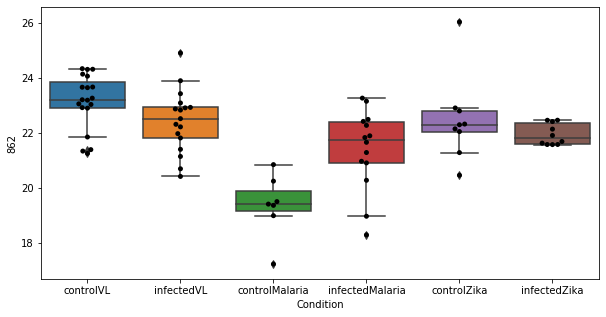

5 row m/z                   526.377
row retention time        3.70252
p-val                 0.000233885
adj.P.Val               0.0235834
custom_id                    2801
compound_names                NaN
Name: 2801, dtype: object


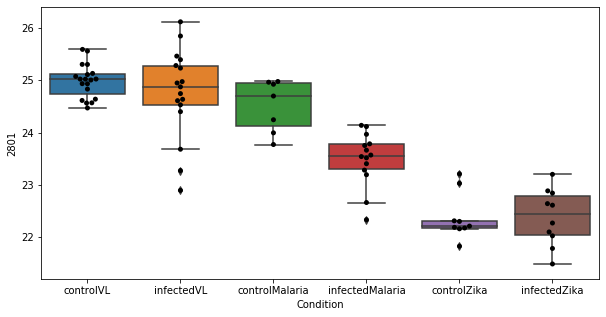

6 row m/z                                                         508.376
row retention time                                              3.77338
p-val                                                       0.000334879
adj.P.Val                                                     0.0289431
custom_id                                                          4264
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 4264, dtype: object


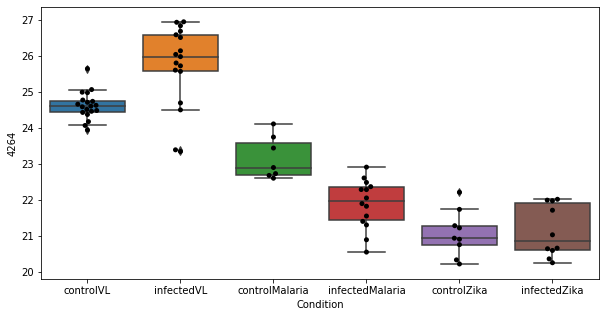

7 row m/z                  787.666
row retention time       3.99348
p-val                 0.00146278
adj.P.Val               0.110623
custom_id                   3027
compound_names               NaN
Name: 3027, dtype: object


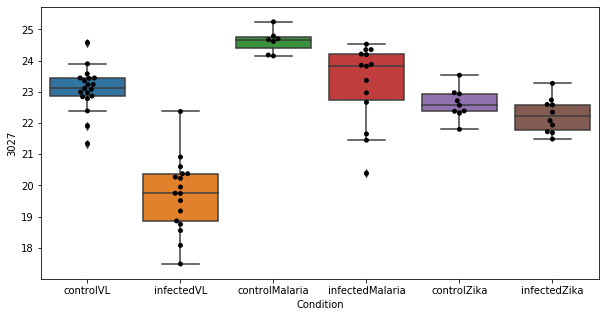

8 row m/z                  469.312
row retention time       3.97423
p-val                 0.00193935
adj.P.Val               0.130368
custom_id                   2743
compound_names               NaN
Name: 2743, dtype: object


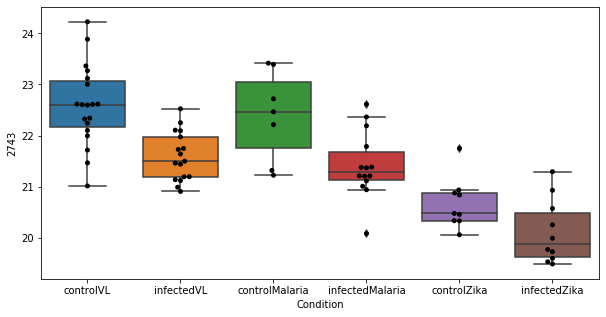

9 row m/z                  480.345
row retention time       3.77761
p-val                 0.00271502
adj.P.Val               0.164259
custom_id                   2751
compound_names               NaN
Name: 2751, dtype: object


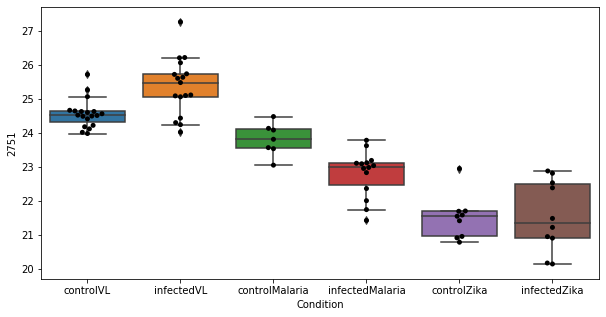

10 row m/z                                                         241.031
row retention time                                              12.5979
p-val                                                        0.00361738
adj.P.Val                                                      0.198956
custom_id                                                          1917
compound_names        L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-...
Name: 1917, dtype: object


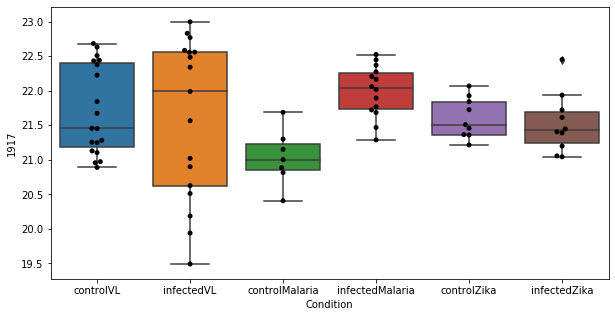

11 row m/z                  499.348
row retention time       3.82135
p-val                 0.00414578
adj.P.Val               0.205399
custom_id                   2773
compound_names               NaN
Name: 2773, dtype: object


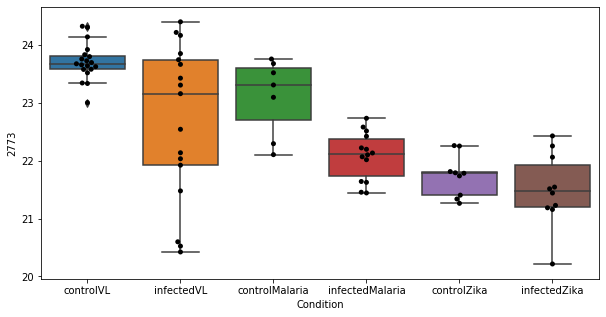

12 row m/z                  510.356
row retention time       3.75557
p-val                 0.00469477
adj.P.Val               0.205399
custom_id                   2779
compound_names               NaN
Name: 2779, dtype: object


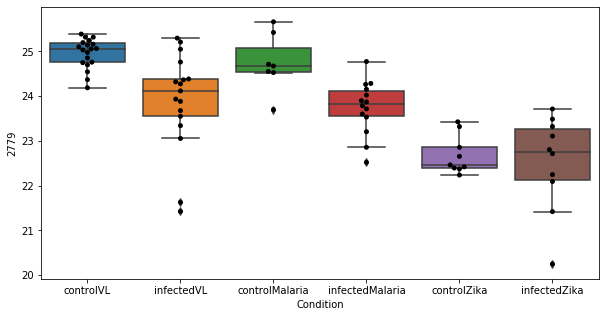

13 row m/z                  495.328
row retention time        3.8612
p-val                 0.00518985
adj.P.Val               0.205399
custom_id                   2766
compound_names               NaN
Name: 2766, dtype: object


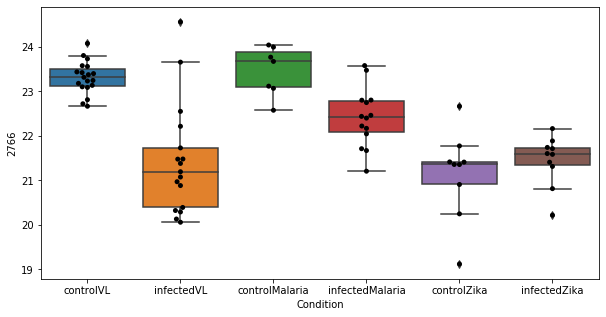

14 row m/z                  498.346
row retention time       3.81396
p-val                 0.00540066
adj.P.Val               0.205399
custom_id                   2771
compound_names               NaN
Name: 2771, dtype: object


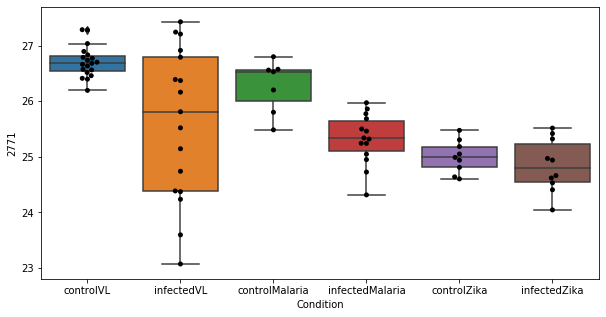

15 row m/z                  171.076
row retention time       9.23593
p-val                 0.00557835
adj.P.Val               0.205399
custom_id                   1045
compound_names               NaN
Name: 1045, dtype: object


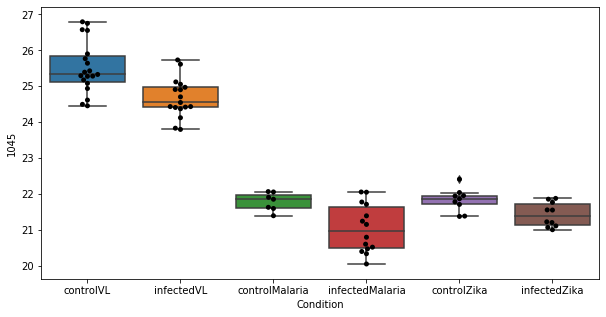

16 row m/z                  497.343
row retention time       3.82271
p-val                 0.00581514
adj.P.Val               0.205399
custom_id                   2769
compound_names               NaN
Name: 2769, dtype: object


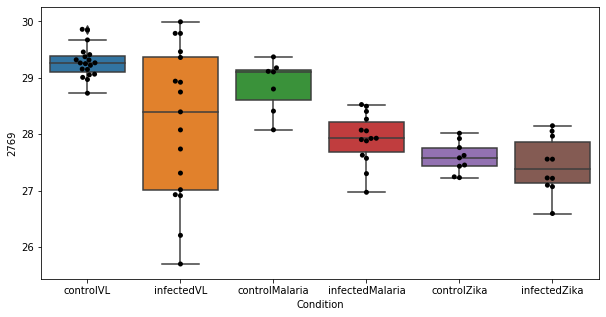

17 row m/z                                                          496.34
row retention time                                              3.81947
p-val                                                        0.00647208
adj.P.Val                                                      0.205399
custom_id                                                          2767
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2767, dtype: object


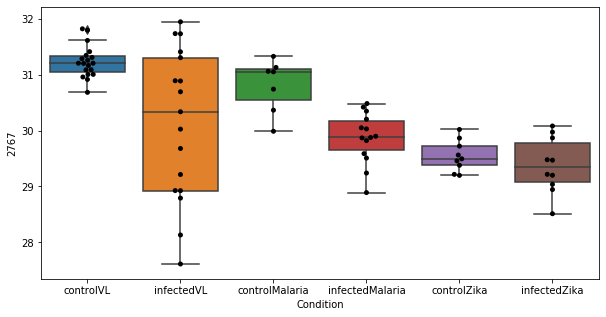

18 row m/z                                                         128.071
row retention time                                              9.77144
p-val                                                        0.00666647
adj.P.Val                                                      0.205399
custom_id                                                           383
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 383, dtype: object


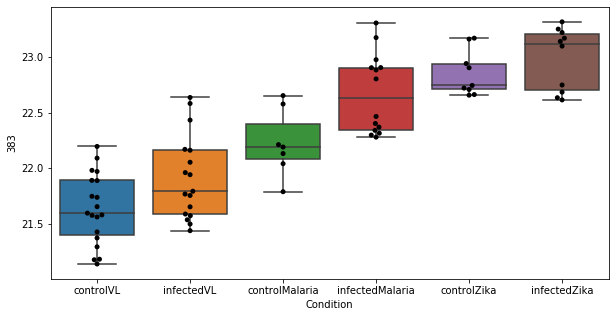

19 row m/z                                         151.112
row retention time                              3.98716
p-val                                        0.00754278
adj.P.Val                                      0.205399
custom_id                                           767
compound_names        Perillyl aldehyde; Perillaldehyde
Name: 767, dtype: object


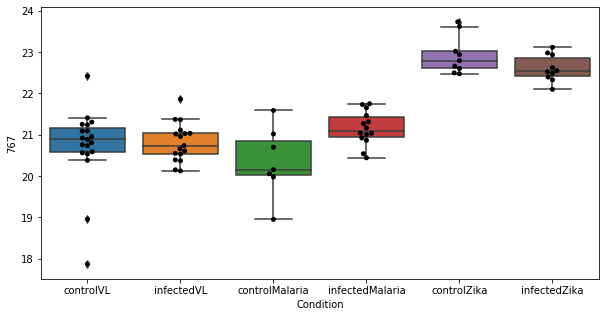

20 row m/z                                                          130.05
row retention time                                              9.23574
p-val                                                         0.0077333
adj.P.Val                                                      0.205399
custom_id                                                           411
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 411, dtype: object


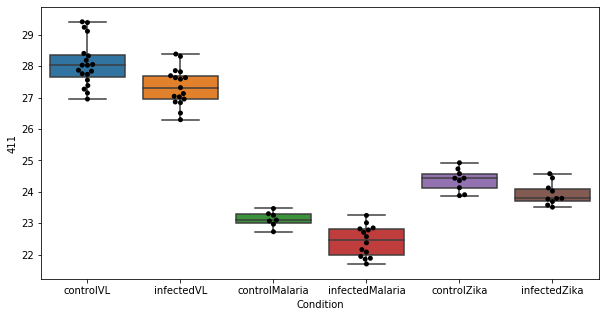

21 row m/z                  174.113
row retention time       9.82136
p-val                 0.00789959
adj.P.Val               0.205399
custom_id                   1089
compound_names               NaN
Name: 1089, dtype: object


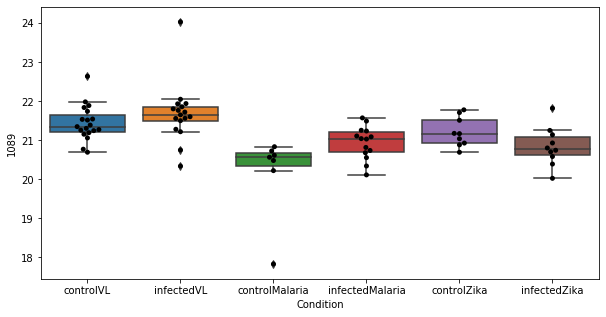

22 row m/z                                                          116.07
row retention time                                              8.61149
p-val                                                        0.00807123
adj.P.Val                                                      0.205399
custom_id                                                           256
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 256, dtype: object


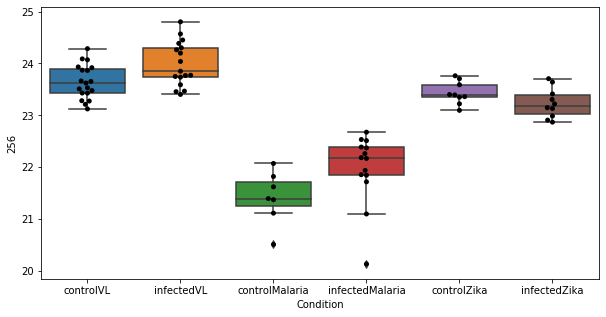

23 row m/z                            468.308
row retention time                 3.97058
p-val                           0.00814805
adj.P.Val                         0.205399
custom_id                             2741
compound_names        Timnodonyl carnitine
Name: 2741, dtype: object


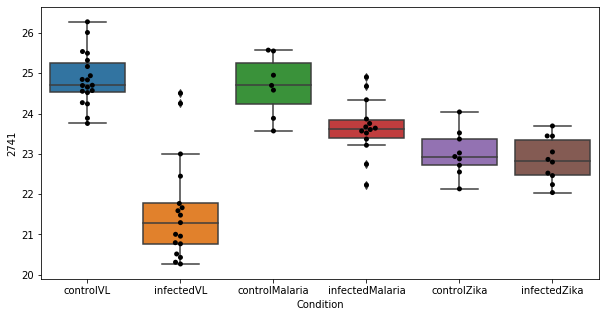

24 row m/z                                                          148.06
row retention time                                              9.59939
p-val                                                         0.0127764
adj.P.Val                                                      0.299096
custom_id                                                           710
compound_names        DL-Glutamate; DL-Glutaminic acid; 2-Aminogluta...
Name: 710, dtype: object


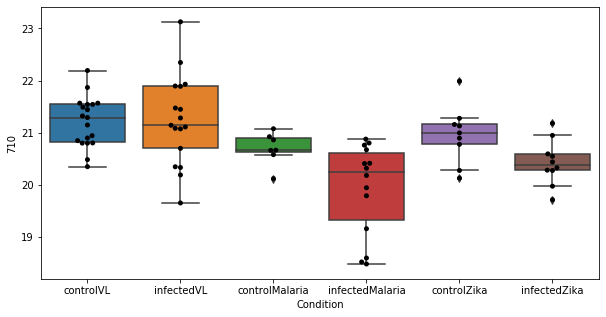

25 row m/z                 171.102
row retention time      4.37024
p-val                 0.0128537
adj.P.Val              0.299096
custom_id                  1049
compound_names              NaN
Name: 1049, dtype: object


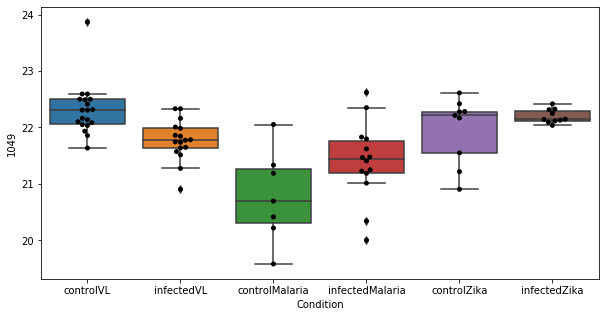

26 row m/z                            253.155
row retention time                 4.14302
p-val                            0.0142199
adj.P.Val                         0.318632
custom_id                             2042
compound_names        histidyl-prolinamide
Name: 2042, dtype: object


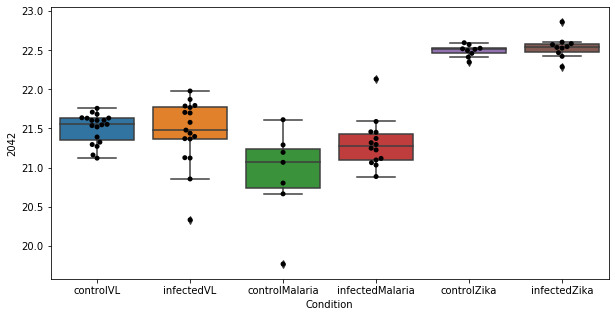

27 row m/z                482.324
row retention time     3.85737
p-val                 0.015164
adj.P.Val             0.327651
custom_id                 2752
compound_names             NaN
Name: 2752, dtype: object


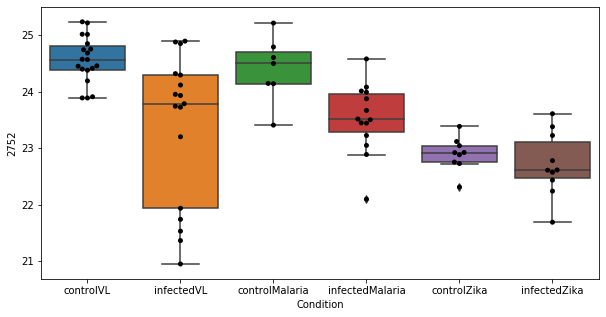

28 row m/z                  103.07
row retention time      9.63256
p-val                 0.0170748
adj.P.Val              0.356217
custom_id                   129
compound_names              NaN
Name: 129, dtype: object


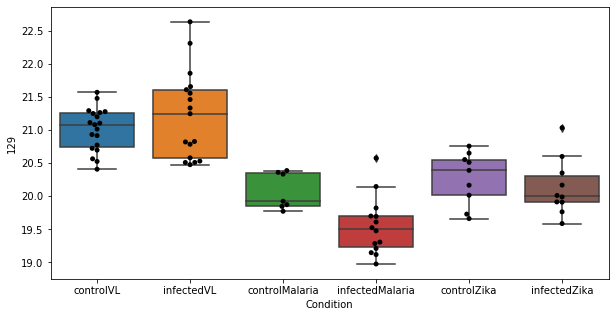

29 row m/z                 234.015
row retention time      9.79681
p-val                 0.0190455
adj.P.Val              0.384084
custom_id                  1836
compound_names              NaN
Name: 1836, dtype: object


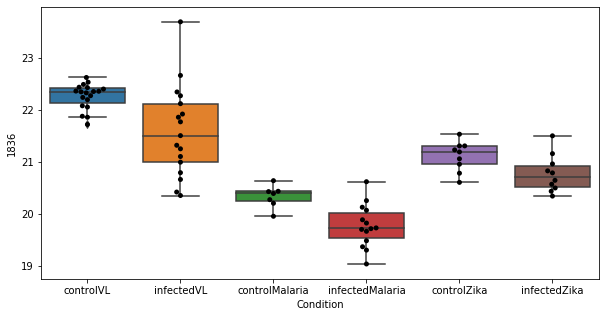

30 row m/z                                                          148.06
row retention time                                              11.7584
p-val                                                         0.0214812
adj.P.Val                                                      0.419229
custom_id                                                           709
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 709, dtype: object


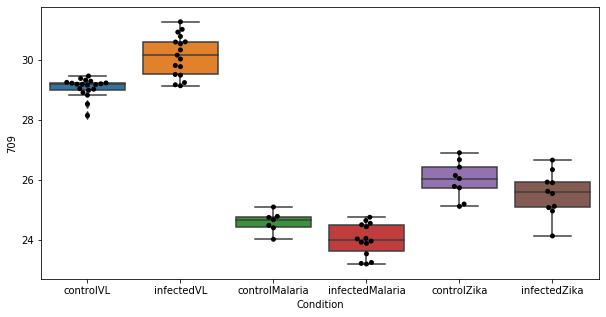

31 row m/z                          494.324
row retention time               3.86492
p-val                          0.0237557
adj.P.Val                       0.449132
custom_id                           2765
compound_names        cervonyl carnitine
Name: 2765, dtype: object


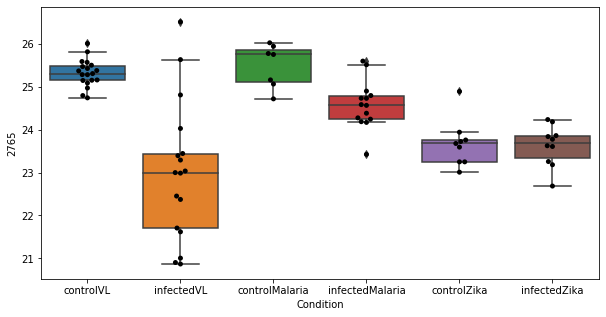

32 row m/z                                                         149.064
row retention time                                              11.7642
p-val                                                         0.0271968
adj.P.Val                                                      0.477806
custom_id                                                           730
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 730, dtype: object


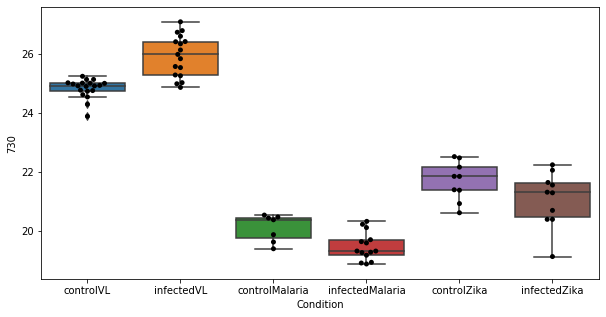

33 row m/z                                                        174.113
row retention time                                              4.3896
p-val                                                        0.0273622
adj.P.Val                                                     0.477806
custom_id                                                         1088
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1088, dtype: object


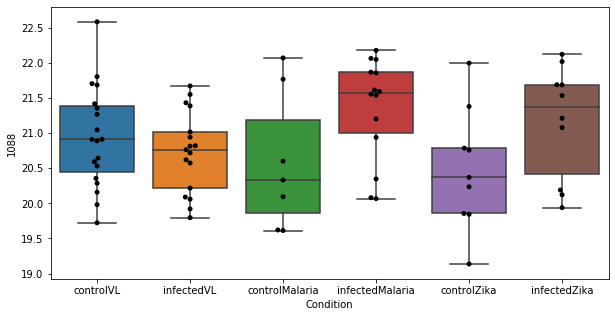

34 row m/z                  181.04
row retention time      9.67025
p-val                 0.0276417
adj.P.Val              0.477806
custom_id                  1172
compound_names              NaN
Name: 1172, dtype: object


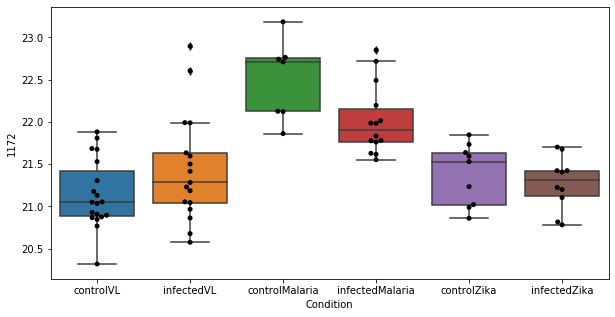

35 row m/z                                                         147.076
row retention time                                              6.87884
p-val                                                         0.0390834
adj.P.Val                                                      0.656819
custom_id                                                           690
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 690, dtype: object


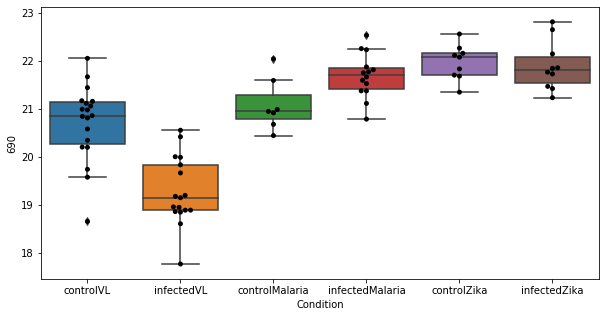

36 row m/z                 774.598
row retention time      3.19673
p-val                 0.0415036
adj.P.Val               0.67864
custom_id                  3000
compound_names              NaN
Name: 3000, dtype: object


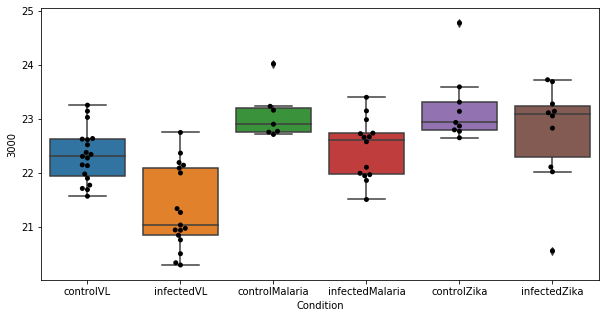

37 row m/z                 303.024
row retention time      10.4124
p-val                 0.0443632
adj.P.Val              0.691235
custom_id                  2395
compound_names              NaN
Name: 2395, dtype: object


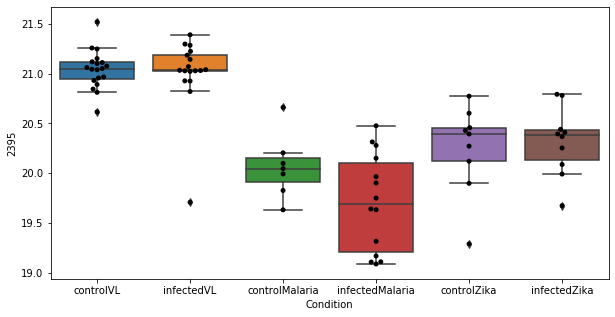

38 row m/z                 105.11
row retention time     16.7044
p-val                 0.044559
adj.P.Val             0.691235
custom_id                  159
compound_names             NaN
Name: 159, dtype: object


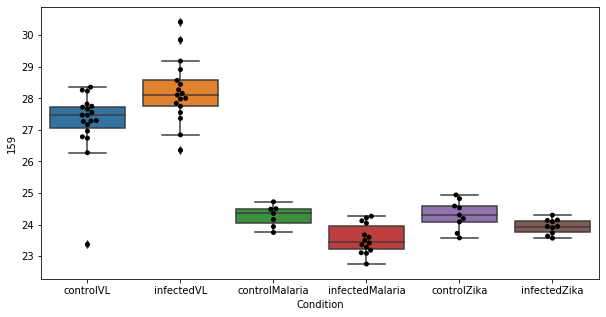

39 row m/z                                                         139.058
row retention time                                              9.88209
p-val                                                         0.0474282
adj.P.Val                                                      0.717352
custom_id                                                          4562
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 4562, dtype: object


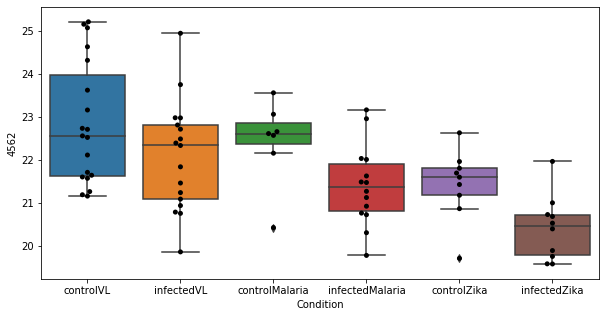

40 row m/z                 816.702
row retention time      3.30508
p-val                 0.0489516
adj.P.Val              0.722335
custom_id                  3093
compound_names              NaN
Name: 3093, dtype: object


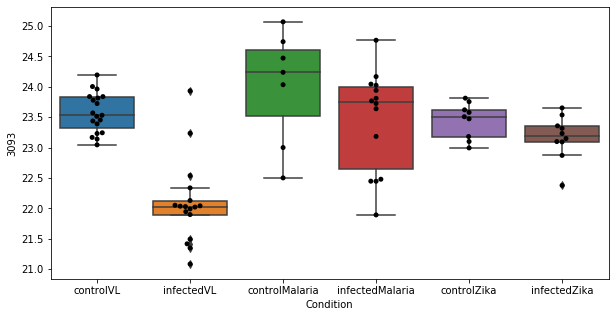

41 row m/z                                                         188.092
row retention time                                              6.71139
p-val                                                         0.0527749
adj.P.Val                                                       0.76021
custom_id                                                          1264
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1264, dtype: object


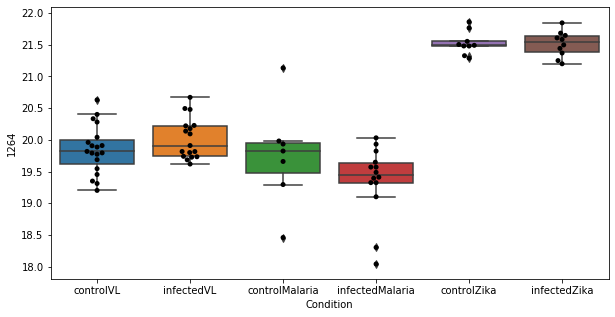

42 row m/z                 148.043
row retention time      6.71425
p-val                 0.0587151
adj.P.Val              0.826108
custom_id                   705
compound_names              NaN
Name: 705, dtype: object


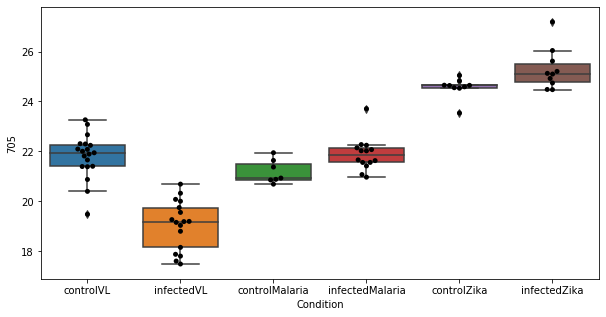

43 row m/z                 133.099
row retention time      9.28806
p-val                 0.0610063
adj.P.Val              0.829641
custom_id                   488
compound_names              NaN
Name: 488, dtype: object


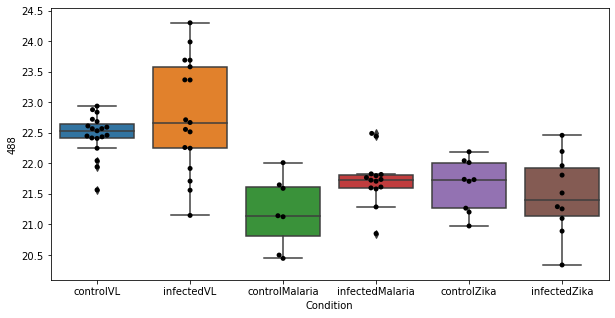

44 row m/z                 315.236
row retention time      4.37261
p-val                 0.0617088
adj.P.Val              0.829641
custom_id                  4139
compound_names              NaN
Name: 4139, dtype: object


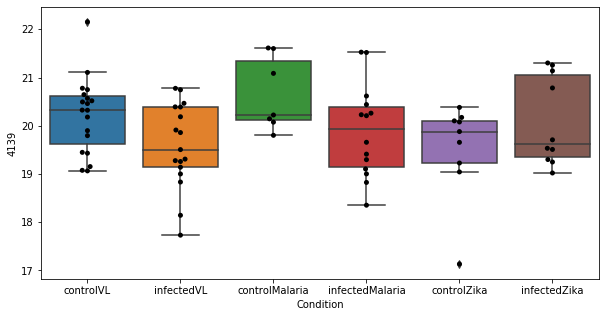

45 row m/z                 134.109
row retention time      9.30018
p-val                 0.0658805
adj.P.Val              0.866472
custom_id                   504
compound_names              NaN
Name: 504, dtype: object


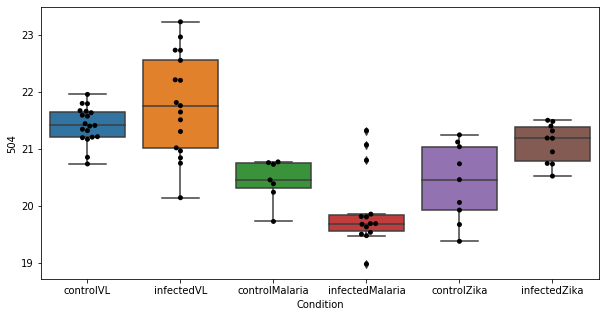

46 row m/z                                                         175.071
row retention time                                              9.92745
p-val                                                         0.0680899
adj.P.Val                                                      0.876476
custom_id                                                          1105
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 1105, dtype: object


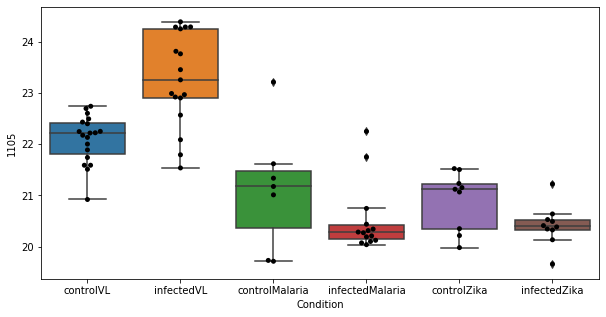

47 row m/z                 132.062
row retention time      9.28326
p-val                 0.0717451
adj.P.Val              0.897448
custom_id                   456
compound_names              NaN
Name: 456, dtype: object


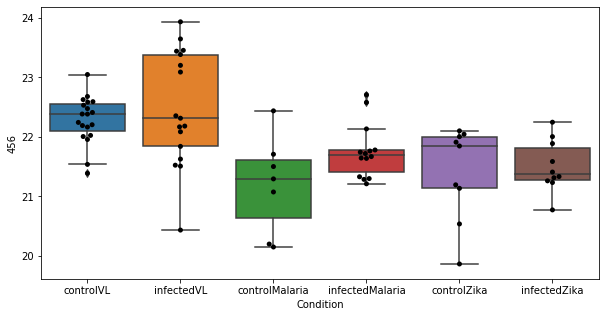

48 row m/z                 160.035
row retention time       10.568
p-val                 0.0726859
adj.P.Val              0.897448
custom_id                   896
compound_names              NaN
Name: 896, dtype: object


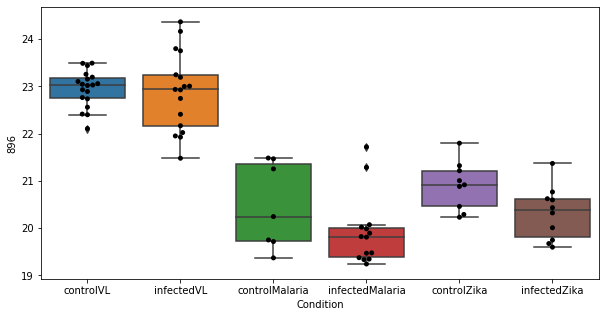

49 row m/z                 240.142
row retention time      6.70326
p-val                 0.0782452
adj.P.Val              0.946767
custom_id                  1911
compound_names              NaN
Name: 1911, dtype: object


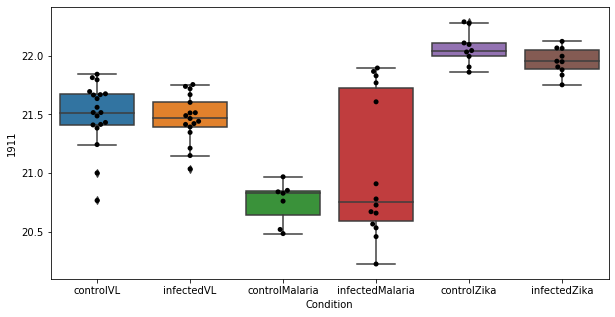

50 row m/z                518.322
row retention time     4.00668
p-val                 0.084109
adj.P.Val             0.982516
custom_id                 2785
compound_names             NaN
Name: 2785, dtype: object


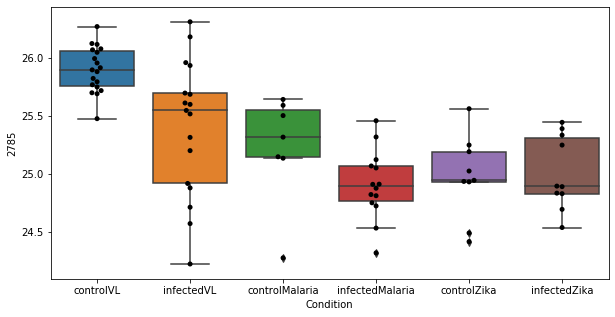

51 row m/z                                  112.051
row retention time                       9.76502
p-val                                  0.0844477
adj.P.Val                               0.982516
custom_id                                    209
compound_names        Cytosine (in DNA)$Cytosine
Name: 209, dtype: object


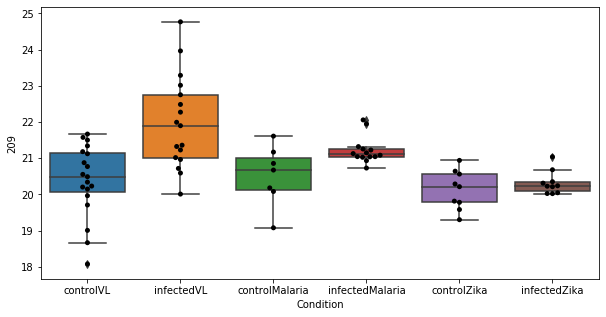

52 row m/z                  568.34
row retention time      3.67488
p-val                 0.0873664
adj.P.Val              0.990505
custom_id                  2832
compound_names              NaN
Name: 2832, dtype: object


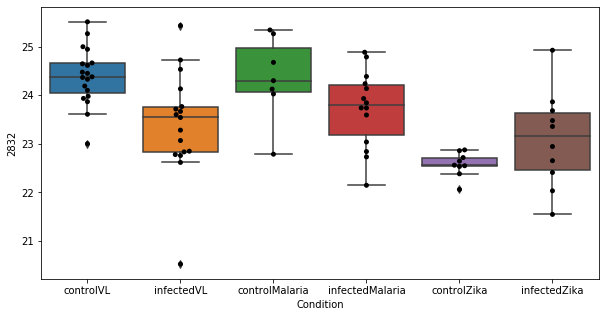

53 row m/z                 240.142
row retention time      4.38087
p-val                 0.0884087
adj.P.Val              0.990505
custom_id                  1912
compound_names              NaN
Name: 1912, dtype: object


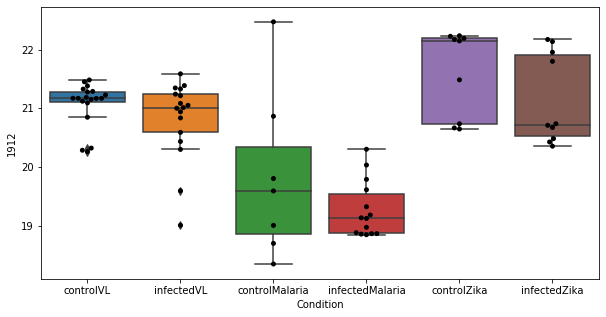

54 row m/z                 522.356
row retention time      3.73699
p-val                 0.0914825
adj.P.Val              0.993422
custom_id                  2794
compound_names              NaN
Name: 2794, dtype: object


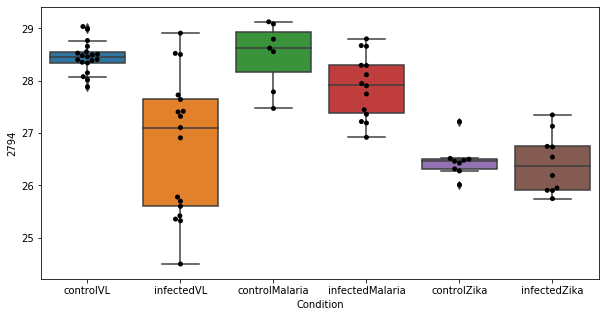

55 row m/z                  162.05
row retention time      10.4026
p-val                 0.0919531
adj.P.Val              0.993422
custom_id                   920
compound_names              NaN
Name: 920, dtype: object


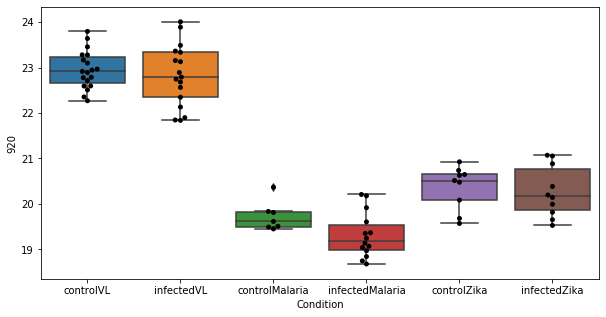

56 row m/z                 519.325
row retention time      3.99289
p-val                 0.0940943
adj.P.Val               0.99872
custom_id                  2787
compound_names              NaN
Name: 2787, dtype: object


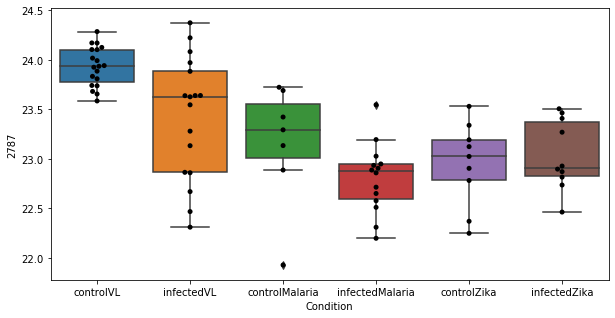

57 row m/z                               190.086
row retention time                    6.71757
p-val                               0.0974994
adj.P.Val                            0.999732
custom_id                                1291
compound_names        methyl indole-3-acetate
Name: 1291, dtype: object


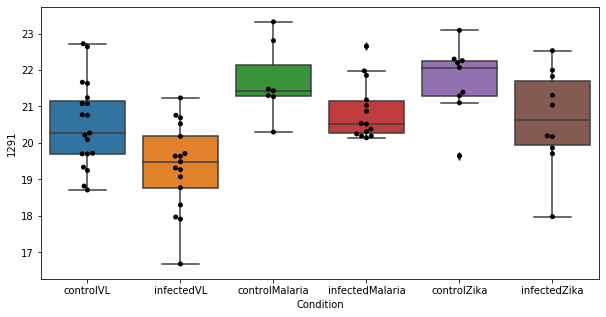

58 row m/z                 523.359
row retention time      3.73649
p-val                 0.0989123
adj.P.Val              0.999732
custom_id                  2796
compound_names              NaN
Name: 2796, dtype: object


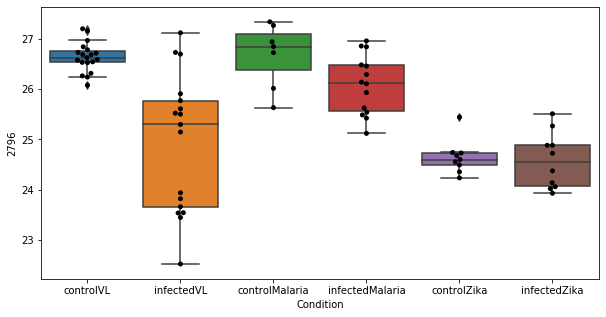

59 row m/z                                                         102.055
row retention time                                              9.79951
p-val                                                          0.099147
adj.P.Val                                                      0.999732
custom_id                                                           121
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 121, dtype: object


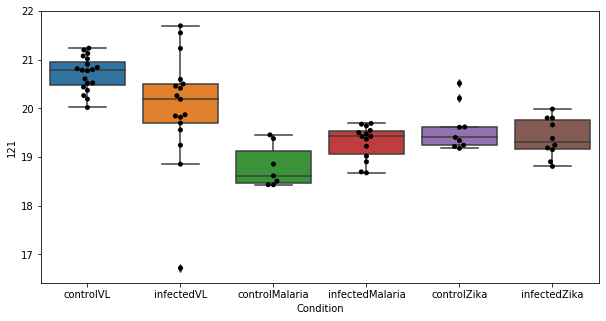

60 row m/z                                                        184.097
row retention time                                             4.41352
p-val                                                         0.103264
adj.P.Val                                                     0.999793
custom_id                                                         1206
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1206, dtype: object


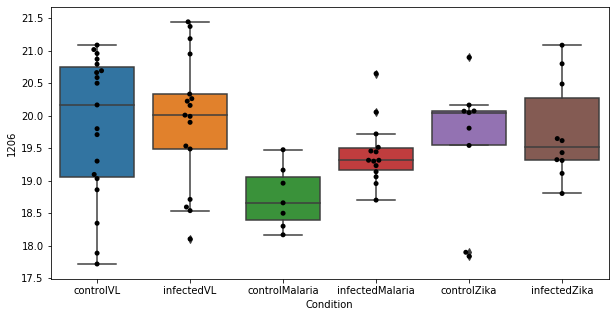

61 row m/z                136.048
row retention time     8.55757
p-val                 0.119736
adj.P.Val             0.999793
custom_id                  516
compound_names             NaN
Name: 516, dtype: object


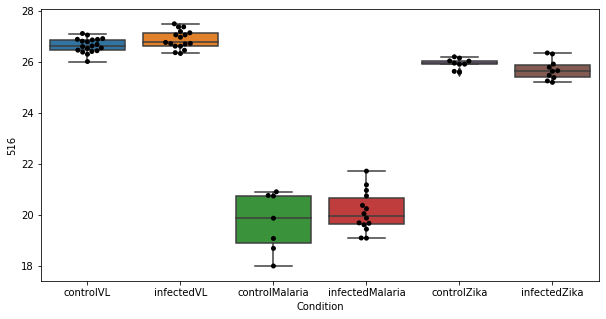

62 row m/z                815.697
row retention time     3.30551
p-val                 0.120947
adj.P.Val             0.999793
custom_id                 3091
compound_names             NaN
Name: 3091, dtype: object


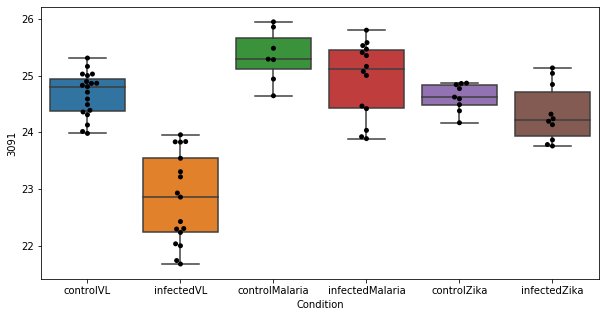

63 row m/z                132.142
row retention time      9.2814
p-val                 0.127186
adj.P.Val             0.999793
custom_id                  469
compound_names             NaN
Name: 469, dtype: object


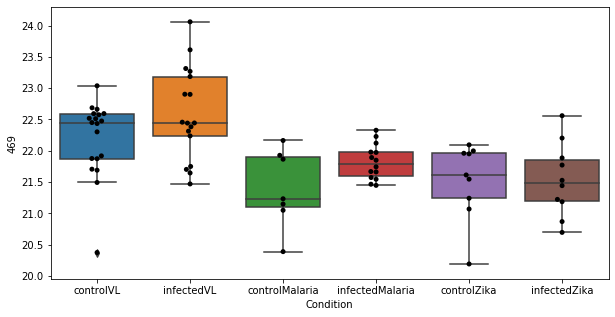

64 row m/z                547.358
row retention time     3.70293
p-val                 0.127451
adj.P.Val             0.999793
custom_id                 2818
compound_names             NaN
Name: 2818, dtype: object


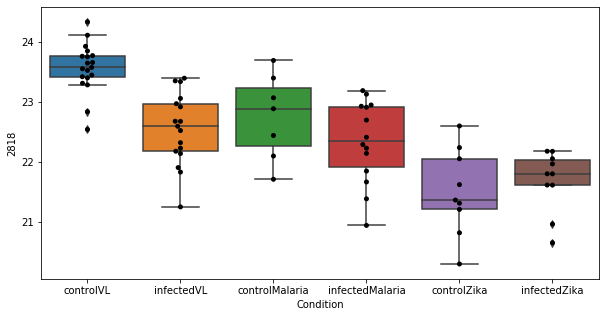

65 row m/z                                                         138.055
row retention time                                              6.72619
p-val                                                          0.140375
adj.P.Val                                                      0.999793
custom_id                                                           551
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 551, dtype: object


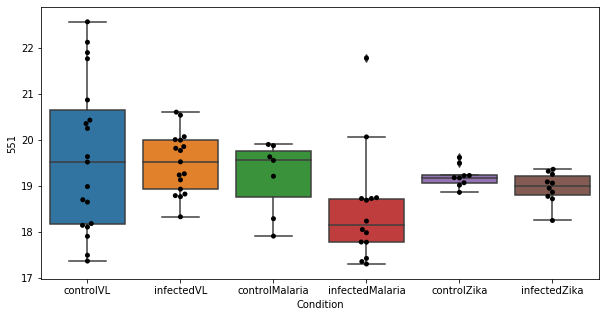

66 row m/z                141.091
row retention time     4.38297
p-val                  0.14757
adj.P.Val             0.999793
custom_id                  577
compound_names             NaN
Name: 577, dtype: object


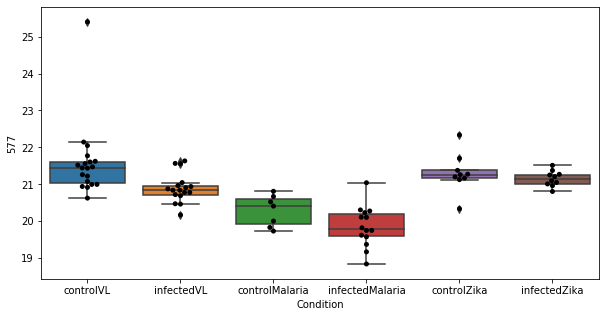

67 row m/z                                 159.028
row retention time                      9.03375
p-val                                  0.147835
adj.P.Val                              0.999793
custom_id                                   872
compound_names        Hypoxanthine; Purine-6-ol
Name: 872, dtype: object


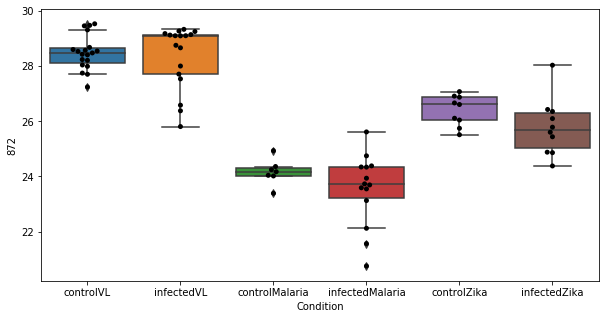

68 row m/z                                                          496.34
row retention time                                              6.67839
p-val                                                          0.149389
adj.P.Val                                                      0.999793
custom_id                                                          2768
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2768, dtype: object


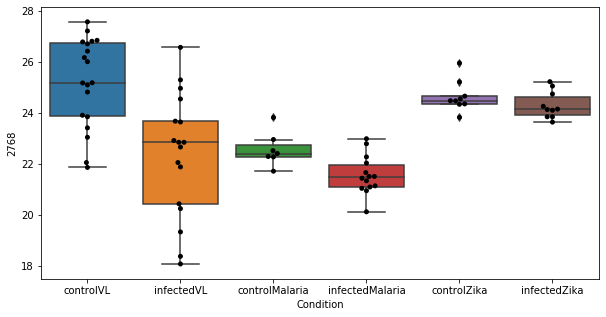

69 row m/z                                                         380.256
row retention time                                               6.7137
p-val                                                          0.150787
adj.P.Val                                                      0.999793
custom_id                                                          2627
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2627, dtype: object


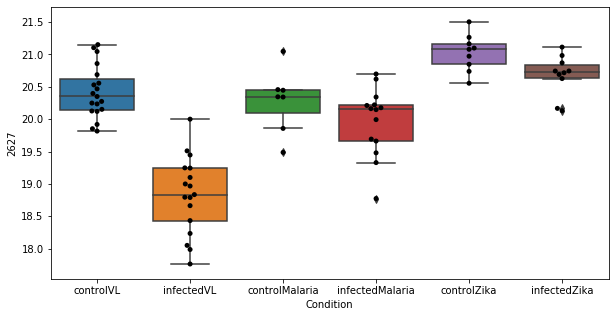

70 row m/z                545.343
row retention time     3.71694
p-val                 0.159861
adj.P.Val             0.999793
custom_id                 2816
compound_names             NaN
Name: 2816, dtype: object


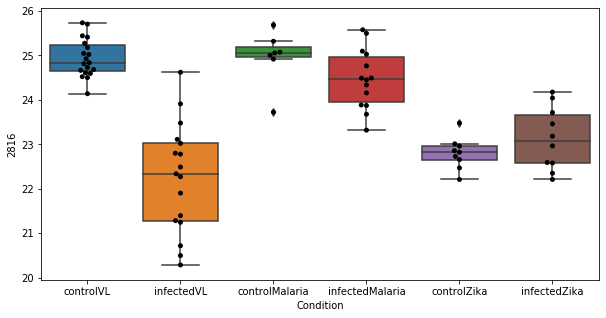

71 row m/z                                157.074
row retention time                     11.7755
p-val                                  0.16204
adj.P.Val                             0.999793
custom_id                                  840
compound_names        3-methylcrotonoylglycine
Name: 840, dtype: object


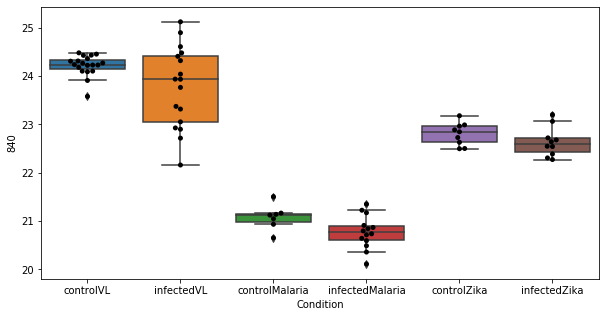

72 row m/z                185.129
row retention time     4.43511
p-val                 0.164857
adj.P.Val             0.999793
custom_id                 1228
compound_names             NaN
Name: 1228, dtype: object


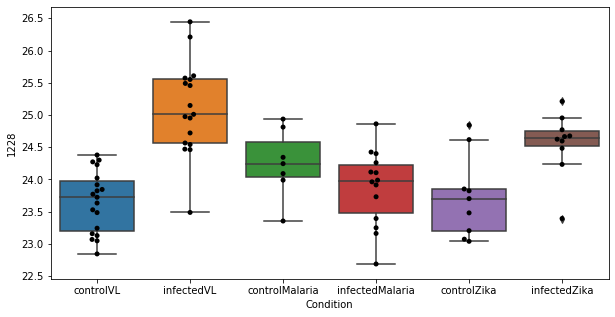

73 row m/z                497.343
row retention time     6.69023
p-val                 0.165314
adj.P.Val             0.999793
custom_id                 2770
compound_names             NaN
Name: 2770, dtype: object


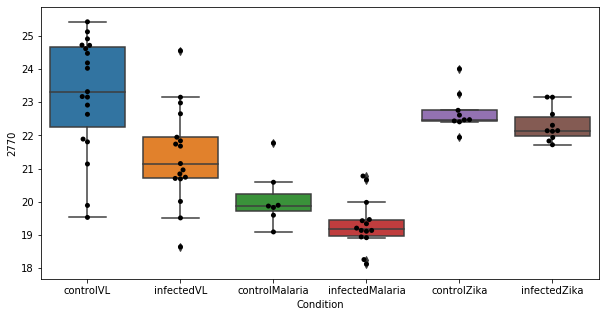

74 row m/z                797.624
row retention time     3.16025
p-val                 0.165793
adj.P.Val             0.999793
custom_id                 3047
compound_names             NaN
Name: 3047, dtype: object


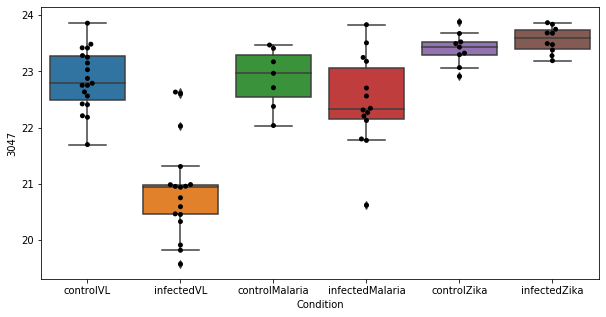

75 row m/z                155.093
row retention time     8.60588
p-val                 0.171762
adj.P.Val             0.999793
custom_id                  805
compound_names             NaN
Name: 805, dtype: object


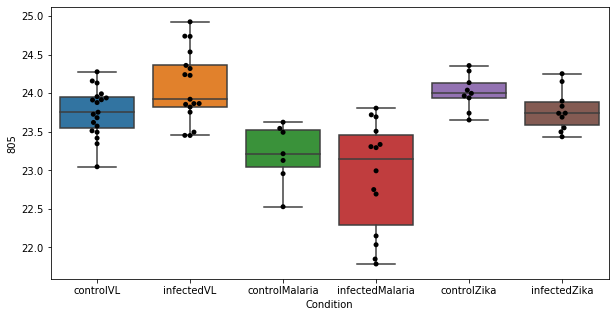

76 row m/z                176.038
row retention time     6.71438
p-val                 0.174743
adj.P.Val             0.999793
custom_id                 1116
compound_names             NaN
Name: 1116, dtype: object


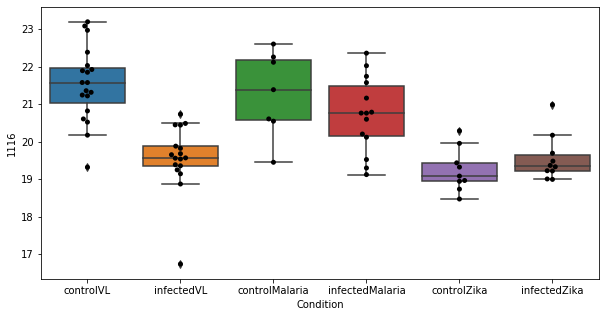

77 row m/z                159.157
row retention time     3.61379
p-val                 0.175496
adj.P.Val             0.999793
custom_id                  891
compound_names             NaN
Name: 891, dtype: object


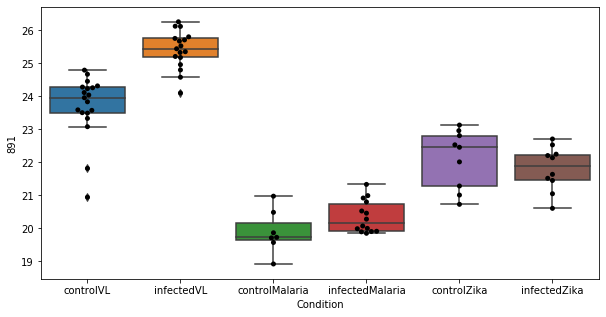

78 row m/z                                                           287.1
row retention time                                              6.72034
p-val                                                           0.17739
adj.P.Val                                                      0.999793
custom_id                                                          2299
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2299, dtype: object


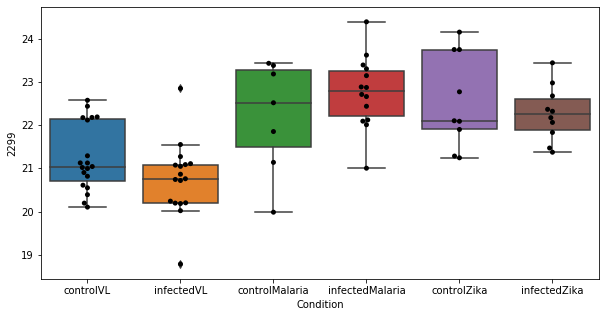

79 row m/z                 544.34
row retention time     3.71301
p-val                 0.180494
adj.P.Val             0.999793
custom_id                 2815
compound_names             NaN
Name: 2815, dtype: object


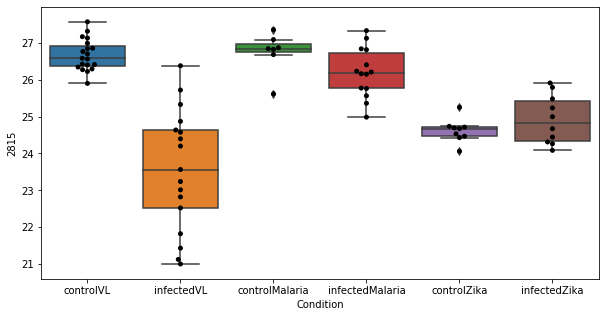

80 row m/z                                                157.097
row retention time                                      6.7351
p-val                                                 0.181982
adj.P.Val                                             0.999793
custom_id                                                  849
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 849, dtype: object


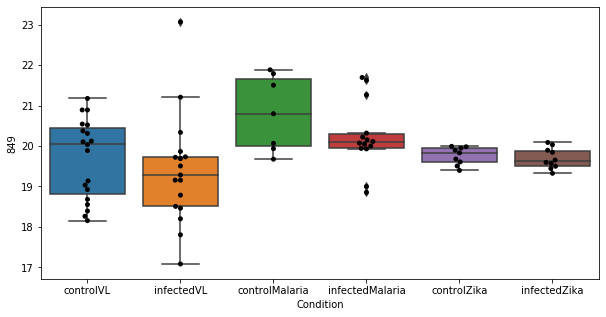

81 row m/z                788.671
row retention time     3.31523
p-val                 0.183613
adj.P.Val             0.999793
custom_id                 3031
compound_names             NaN
Name: 3031, dtype: object


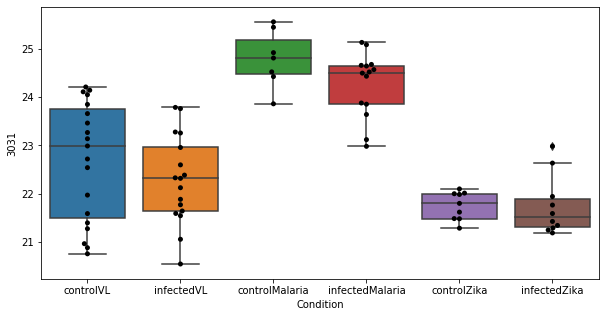

82 row m/z                                 175.002
row retention time                      9.03496
p-val                                  0.188451
adj.P.Val                              0.999793
custom_id                                  1100
compound_names        Hypoxanthine; Purine-6-ol
Name: 1100, dtype: object


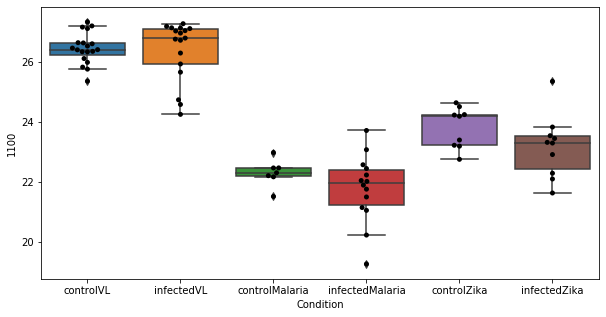

83 row m/z                203.139
row retention time     10.3352
p-val                 0.188712
adj.P.Val             0.999793
custom_id                 1465
compound_names             NaN
Name: 1465, dtype: object


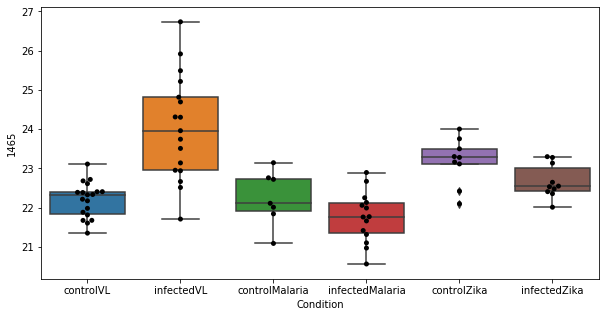

84 row m/z                200.054
row retention time     9.03912
p-val                 0.188829
adj.P.Val             0.999793
custom_id                 1417
compound_names             NaN
Name: 1417, dtype: object


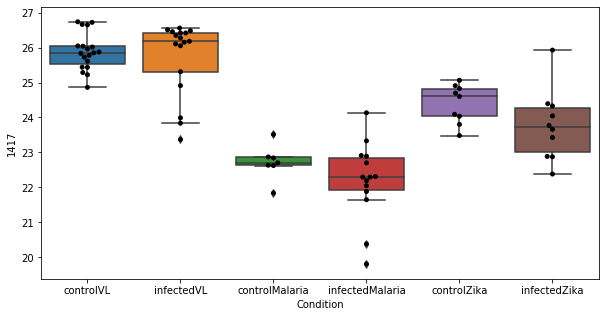

85 row m/z                610.504
row retention time     3.01402
p-val                 0.191067
adj.P.Val             0.999793
custom_id                 2866
compound_names             NaN
Name: 2866, dtype: object


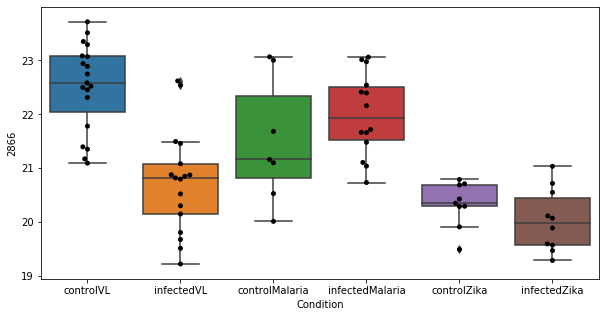

86 row m/z                              188.071
row retention time                    7.6959
p-val                               0.191605
adj.P.Val                           0.999793
custom_id                               1263
compound_names        5-Methoxyindoleacetate
Name: 1263, dtype: object


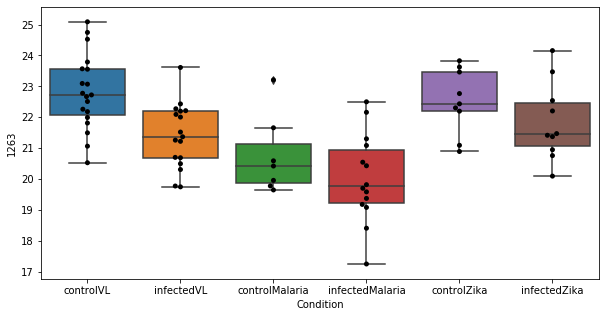

87 row m/z                171.076
row retention time     8.30023
p-val                 0.194064
adj.P.Val             0.999793
custom_id                 1046
compound_names             NaN
Name: 1046, dtype: object


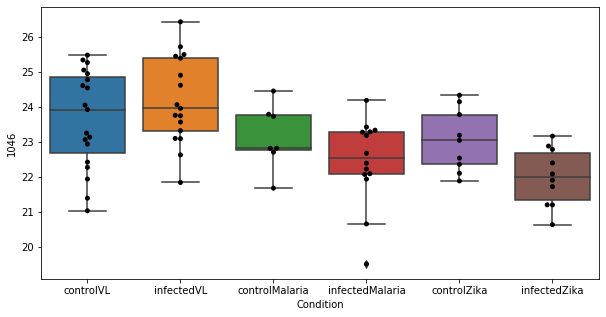

88 row m/z                                        246.124
row retention time                              9.9603
p-val                                         0.194961
adj.P.Val                                     0.999793
custom_id                                         1960
compound_names        gama-carboxyethyl-hydroxychroman
Name: 1960, dtype: object


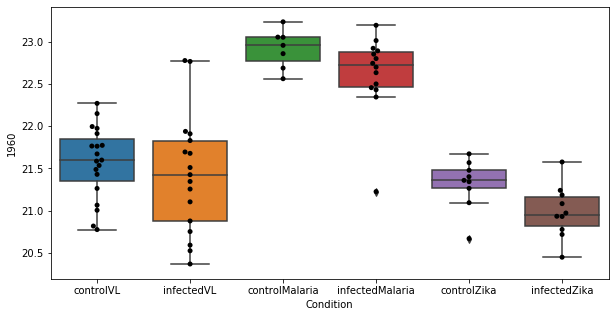

89 row m/z                837.618
row retention time     3.15077
p-val                 0.199822
adj.P.Val             0.999793
custom_id                 3119
compound_names             NaN
Name: 3119, dtype: object


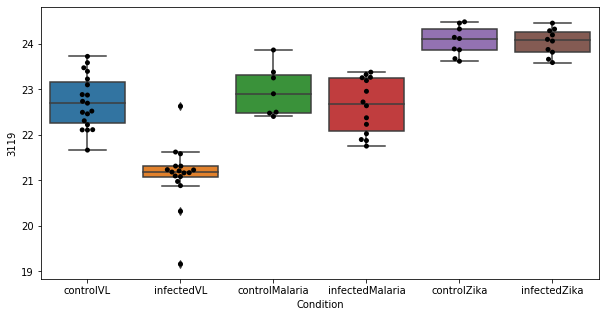

90 row m/z                195.088
row retention time     4.37565
p-val                 0.204854
adj.P.Val             0.999793
custom_id                 1362
compound_names             NaN
Name: 1362, dtype: object


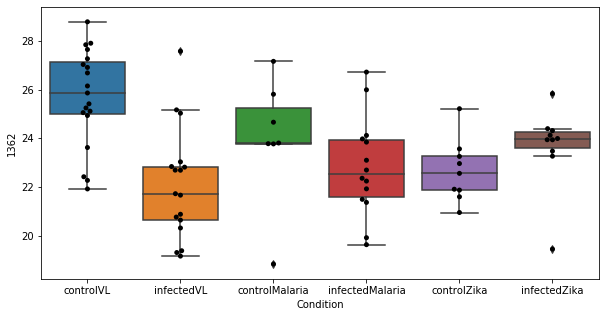

91 row m/z                792.589
row retention time     3.17424
p-val                  0.20734
adj.P.Val             0.999793
custom_id                 3038
compound_names             NaN
Name: 3038, dtype: object


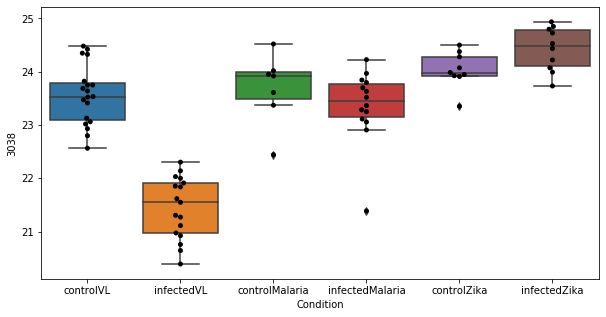

92 row m/z                199.108
row retention time     6.74436
p-val                 0.214626
adj.P.Val             0.999793
custom_id                 4868
compound_names             NaN
Name: 4868, dtype: object


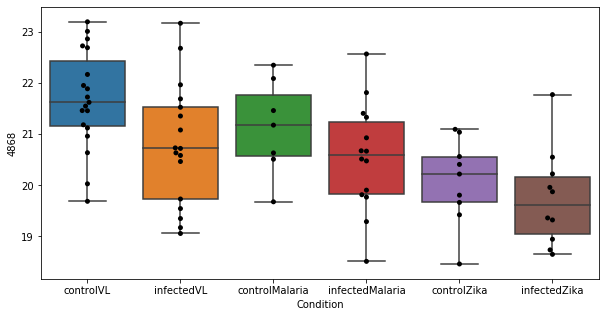

93 row m/z                                                         123.055
row retention time                                              6.71585
p-val                                                          0.214852
adj.P.Val                                                      0.999793
custom_id                                                           343
compound_names        Nicotinamide; Nicotinic acid amide; Niacinamid...
Name: 343, dtype: object


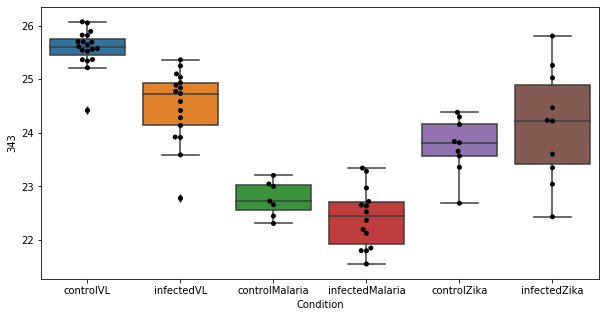

94 row m/z                230.096
row retention time      11.951
p-val                 0.216251
adj.P.Val             0.999793
custom_id                 1799
compound_names             NaN
Name: 1799, dtype: object


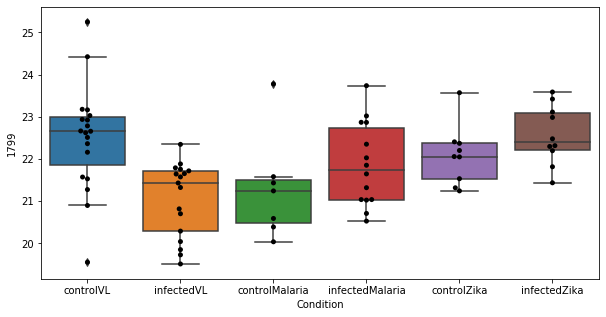

95 row m/z                202.043
row retention time     10.4068
p-val                 0.219339
adj.P.Val             0.999793
custom_id                 1442
compound_names             NaN
Name: 1442, dtype: object


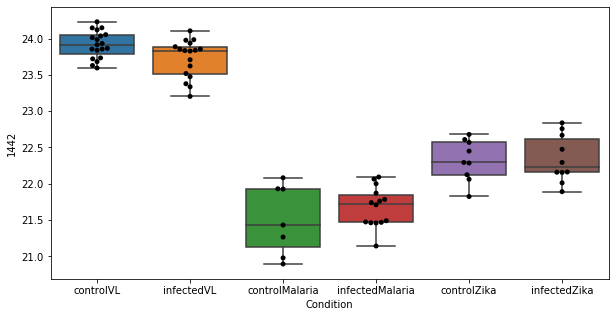

96 row m/z                142.123
row retention time     3.80346
p-val                 0.221752
adj.P.Val             0.999793
custom_id                  589
compound_names             NaN
Name: 589, dtype: object


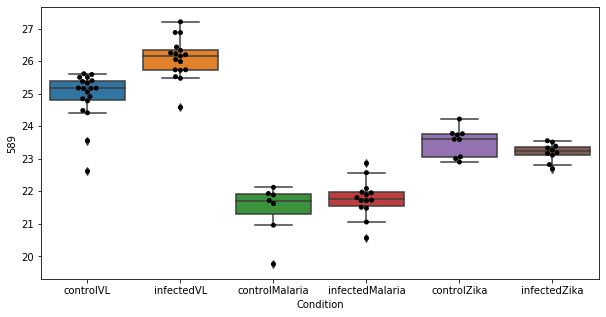

97 row m/z                                                   186.113
row retention time                                        6.71081
p-val                                                    0.224127
adj.P.Val                                                0.999793
custom_id                                                    1233
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1233, dtype: object


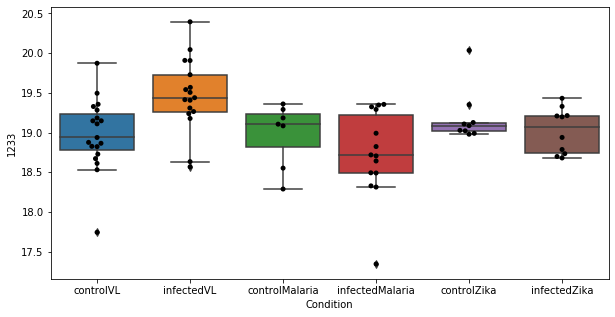

98 row m/z                188.128
row retention time     4.39418
p-val                 0.224502
adj.P.Val             0.999793
custom_id                 1268
compound_names             NaN
Name: 1268, dtype: object


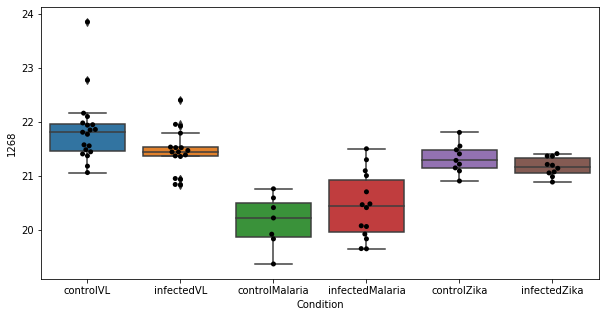

99 row m/z                                                          139.05
row retention time                                              7.04542
p-val                                                          0.225855
adj.P.Val                                                      0.999793
custom_id                                                           558
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 558, dtype: object


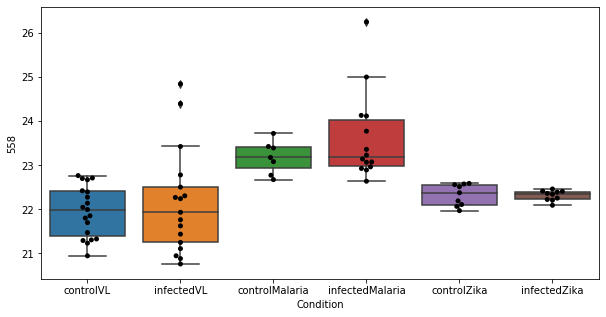

100 row m/z                302.233
row retention time     4.37099
p-val                  0.22726
adj.P.Val             0.999793
custom_id                 2391
compound_names             NaN
Name: 2391, dtype: object


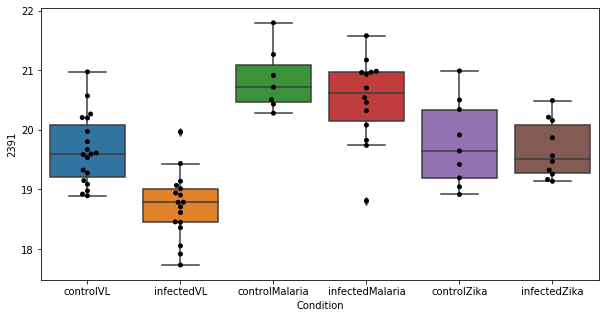

101 row m/z                120.091
row retention time     9.60833
p-val                 0.229433
adj.P.Val             0.999793
custom_id                  310
compound_names             NaN
Name: 310, dtype: object


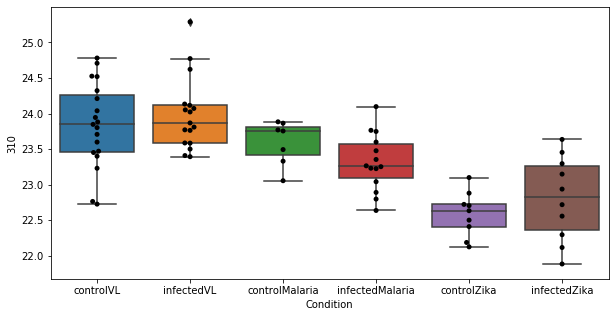

102 row m/z                176.074
row retention time     4.27691
p-val                 0.229485
adj.P.Val             0.999793
custom_id                 1119
compound_names             NaN
Name: 1119, dtype: object


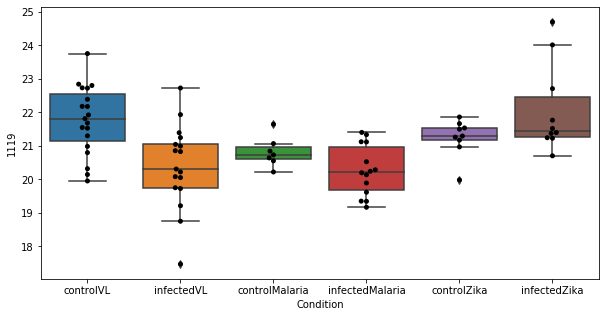

103 row m/z                                                         115.063
row retention time                                               8.6042
p-val                                                          0.229752
adj.P.Val                                                      0.999793
custom_id                                                           240
compound_names        D-Proline$acetamidopropanal$L-Proline; 2-Pyrro...
Name: 240, dtype: object


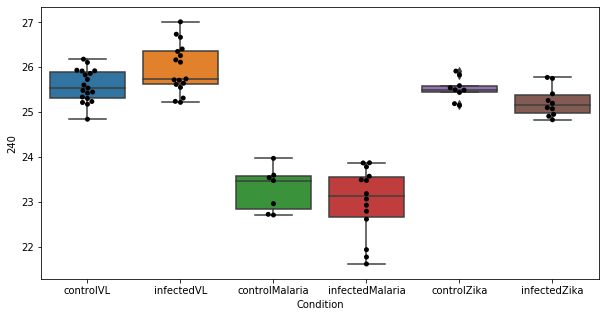

104 row m/z                                 138.049
row retention time                      9.04045
p-val                                  0.232476
adj.P.Val                              0.999793
custom_id                                   548
compound_names        Hypoxanthine; Purine-6-ol
Name: 548, dtype: object


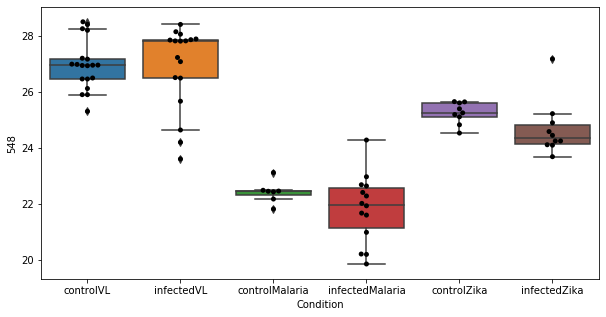

105 row m/z                343.295
row retention time     4.11481
p-val                 0.237352
adj.P.Val             0.999793
custom_id                 4179
compound_names             NaN
Name: 4179, dtype: object


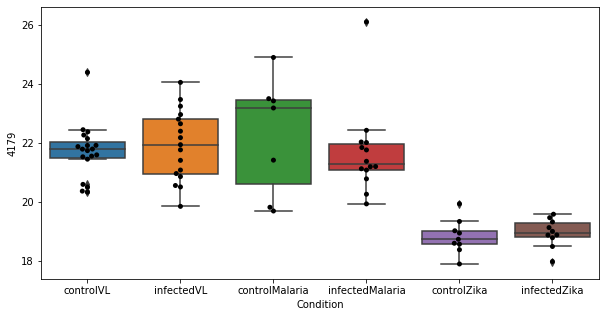

106 row m/z                835.603
row retention time     3.15813
p-val                   0.2395
adj.P.Val             0.999793
custom_id                 3117
compound_names             NaN
Name: 3117, dtype: object


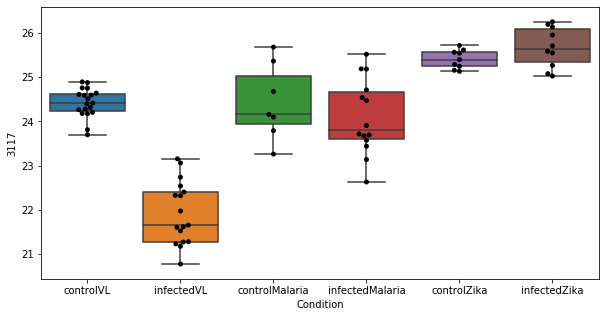

107 row m/z                120.093
row retention time     10.4045
p-val                 0.240337
adj.P.Val             0.999793
custom_id                  312
compound_names             NaN
Name: 312, dtype: object


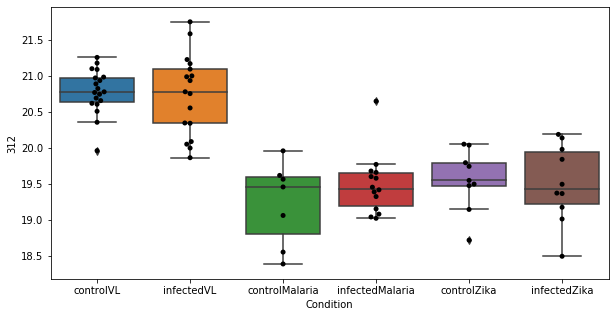

108 row m/z                                                         128.071
row retention time                                              6.71256
p-val                                                           0.24132
adj.P.Val                                                      0.999793
custom_id                                                          5798
compound_names        2,3,4,5-Tetrahydropyridine-2-carboxylate; delt...
Name: 5798, dtype: object


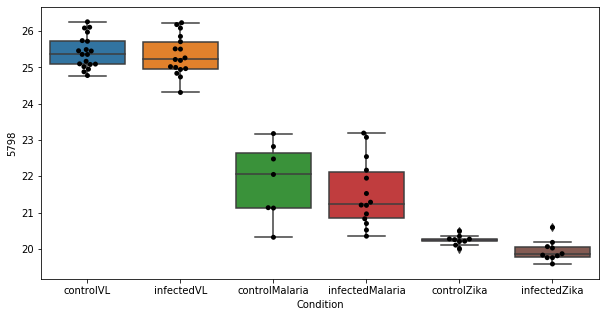

109 row m/z                178.072
row retention time     9.03938
p-val                 0.241591
adj.P.Val             0.999793
custom_id                 1142
compound_names             NaN
Name: 1142, dtype: object


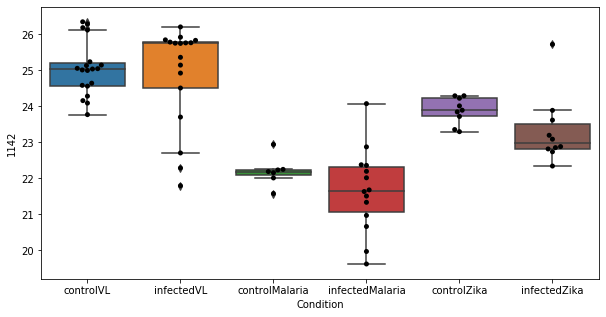

110 row m/z                193.095
row retention time     4.66242
p-val                  0.24185
adj.P.Val             0.999793
custom_id                 1325
compound_names             NaN
Name: 1325, dtype: object


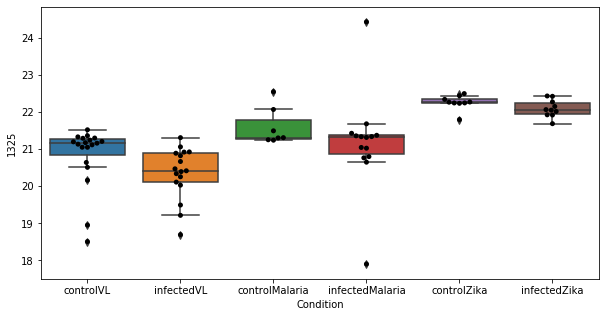

111 row m/z                                                         188.071
row retention time                                              9.95592
p-val                                                          0.242853
adj.P.Val                                                      0.999793
custom_id                                                          1262
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1262, dtype: object


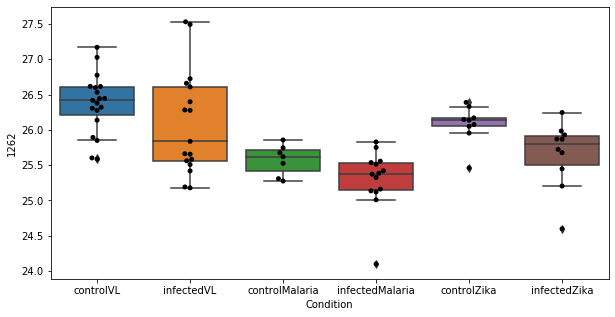

112 row m/z                592.493
row retention time     2.97532
p-val                 0.245424
adj.P.Val             0.999793
custom_id                 2852
compound_names             NaN
Name: 2852, dtype: object


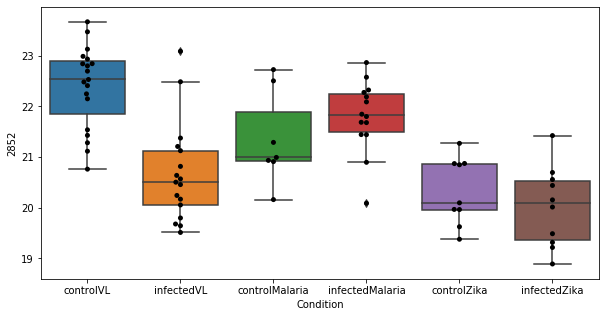

113 row m/z                199.181
row retention time       3.614
p-val                 0.246487
adj.P.Val             0.999793
custom_id                 1413
compound_names             NaN
Name: 1413, dtype: object


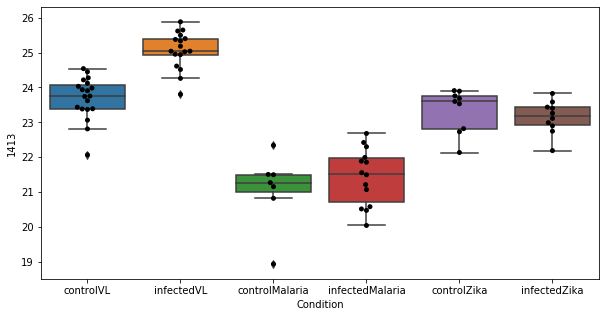

114 row m/z                                                         380.256
row retention time                                              4.24808
p-val                                                          0.250244
adj.P.Val                                                      0.999793
custom_id                                                          2626
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2626, dtype: object


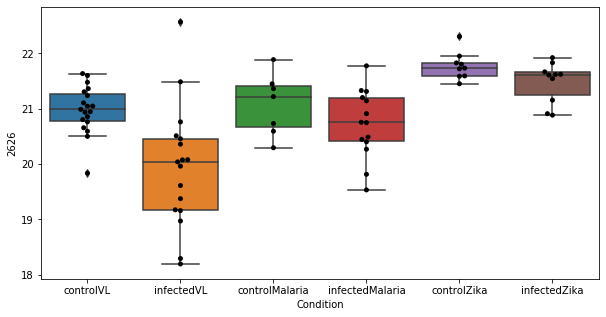

115 row m/z                127.087
row retention time      6.7179
p-val                 0.252363
adj.P.Val             0.999793
custom_id                  378
compound_names             NaN
Name: 378, dtype: object


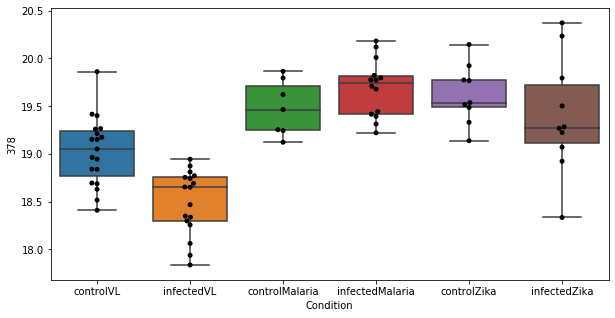

116 row m/z                189.074
row retention time     9.95318
p-val                 0.253875
adj.P.Val             0.999793
custom_id                 1276
compound_names             NaN
Name: 1276, dtype: object


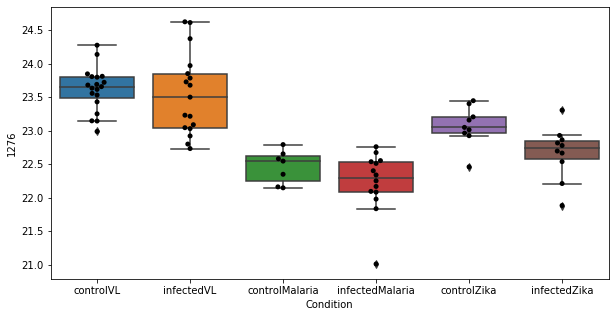

117 row m/z                                                          119.09
row retention time                                              9.60894
p-val                                                           0.25583
adj.P.Val                                                      0.999793
custom_id                                                           299
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 299, dtype: object


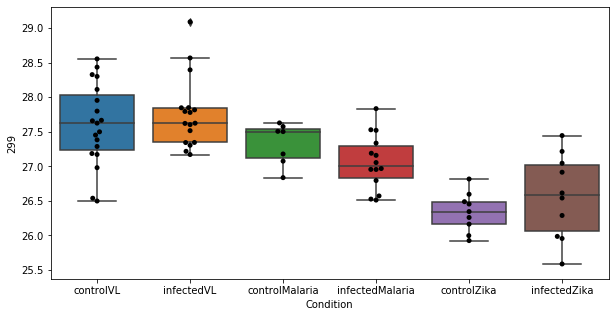

118 row m/z                                                         118.086
row retention time                                              9.60743
p-val                                                          0.258277
adj.P.Val                                                      0.999793
custom_id                                                           281
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 281, dtype: object


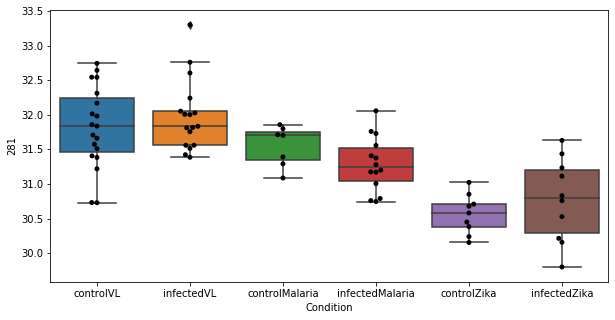

119 row m/z                120.093
row retention time       9.608
p-val                 0.259298
adj.P.Val             0.999793
custom_id                  313
compound_names             NaN
Name: 313, dtype: object


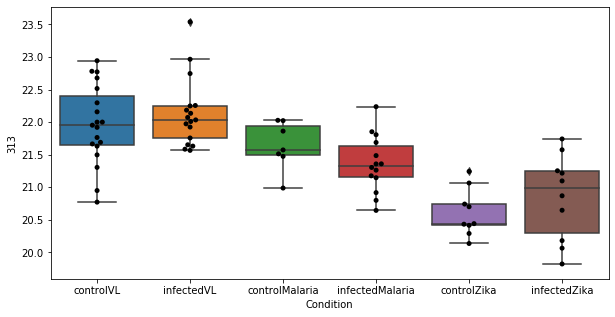

120 row m/z                664.457
row retention time     3.07828
p-val                 0.265202
adj.P.Val             0.999793
custom_id                 2898
compound_names             NaN
Name: 2898, dtype: object


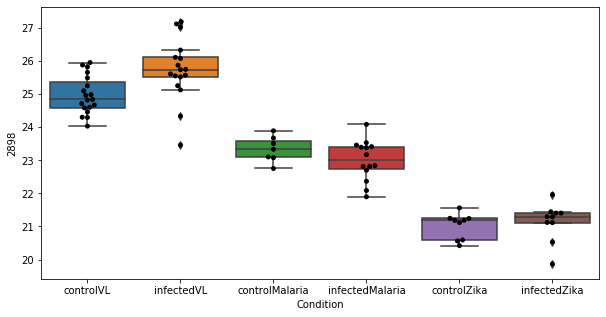

121 row m/z                 115.07
row retention time     8.60199
p-val                 0.265306
adj.P.Val             0.999793
custom_id                  241
compound_names             NaN
Name: 241, dtype: object


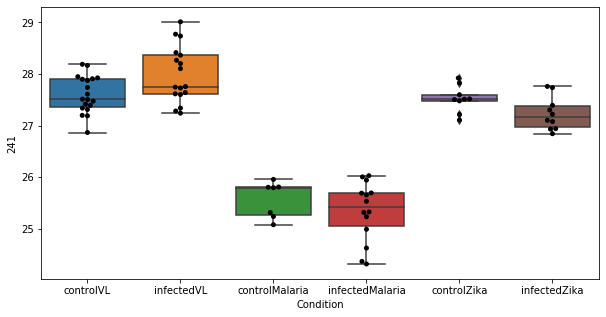

122 row m/z                134.081
row retention time      7.2337
p-val                 0.269499
adj.P.Val             0.999793
custom_id                  497
compound_names             NaN
Name: 497, dtype: object


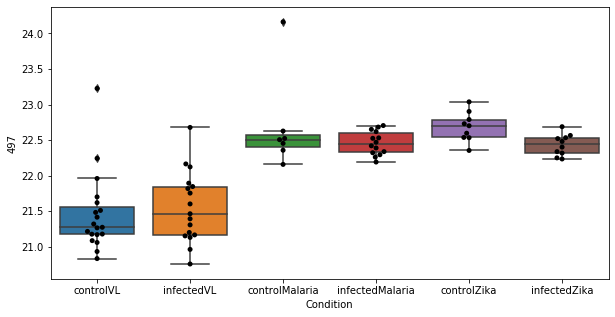

123 row m/z                                                         114.055
row retention time                                              6.71171
p-val                                                           0.26986
adj.P.Val                                                      0.999793
custom_id                                                          3282
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 3282, dtype: object


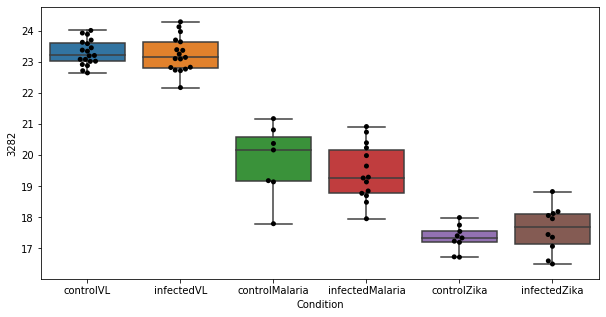

124 row m/z                 813.62
row retention time     3.16569
p-val                 0.271199
adj.P.Val             0.999793
custom_id                 3082
compound_names             NaN
Name: 3082, dtype: object


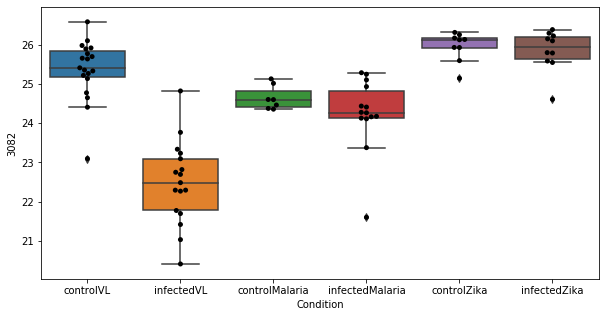

125 row m/z                214.091
row retention time     4.61405
p-val                 0.271958
adj.P.Val             0.999793
custom_id                 1596
compound_names             NaN
Name: 1596, dtype: object


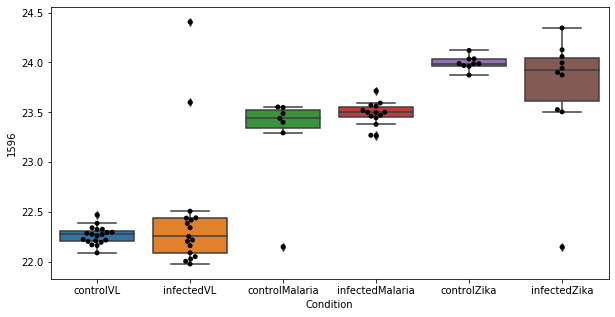

126 row m/z                746.604
row retention time     3.19127
p-val                 0.279516
adj.P.Val             0.999793
custom_id                 2959
compound_names             NaN
Name: 2959, dtype: object


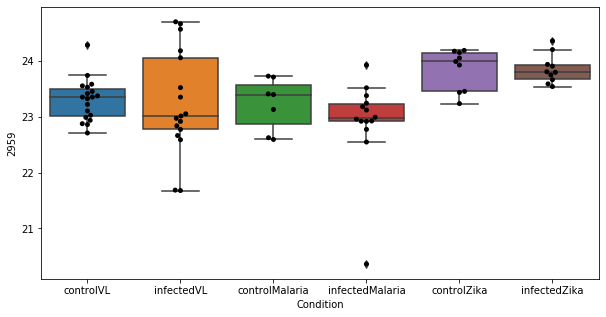

127 row m/z                 880.59
row retention time     3.00121
p-val                 0.282401
adj.P.Val             0.999793
custom_id                 3176
compound_names             NaN
Name: 3176, dtype: object


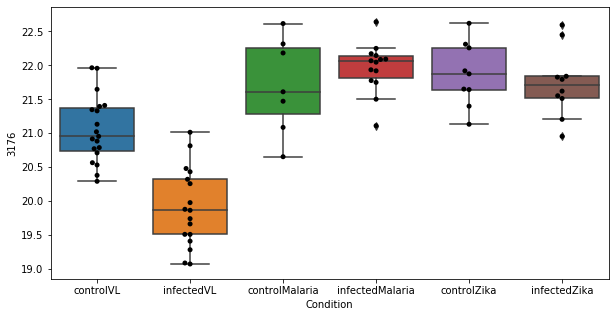

128 row m/z                                                         265.118
row retention time                                              4.43639
p-val                                                          0.283403
adj.P.Val                                                      0.999793
custom_id                                                          2141
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2141, dtype: object


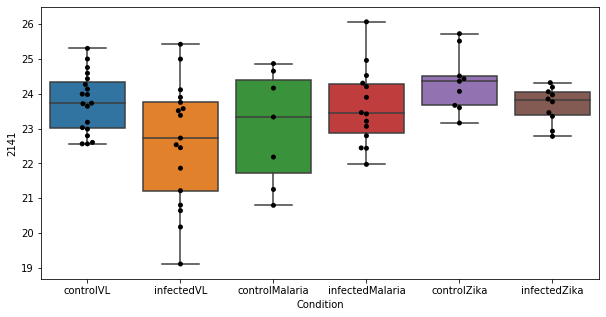

129 row m/z                           310.201
row retention time                 4.3724
p-val                            0.287009
adj.P.Val                        0.999793
custom_id                            2434
compound_names        L-Octanoylcarnitine
Name: 2434, dtype: object


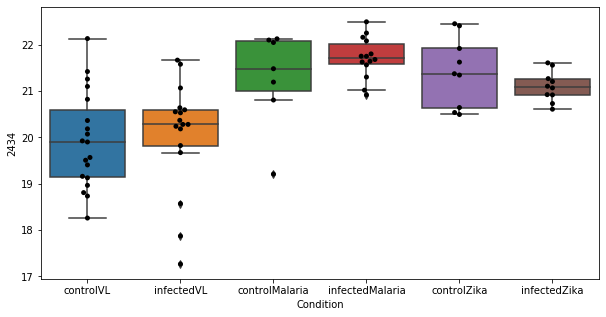

130 row m/z                                                237.052
row retention time                                     10.4106
p-val                                                 0.287772
adj.P.Val                                             0.999793
custom_id                                                 1883
compound_names        5-L-Glutamyl-taurine; 5-Glutamyl-taurine
Name: 1883, dtype: object


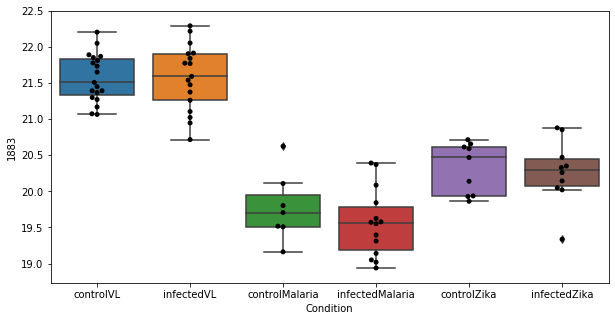

131 row m/z                730.593
row retention time     3.38229
p-val                  0.29046
adj.P.Val             0.999793
custom_id                 2934
compound_names             NaN
Name: 2934, dtype: object


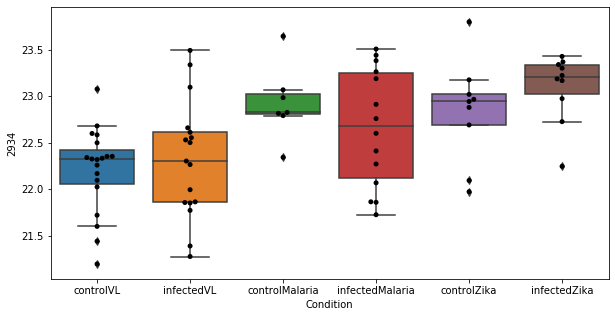

132 row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                          0.290978
adj.P.Val                                                      0.999793
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object


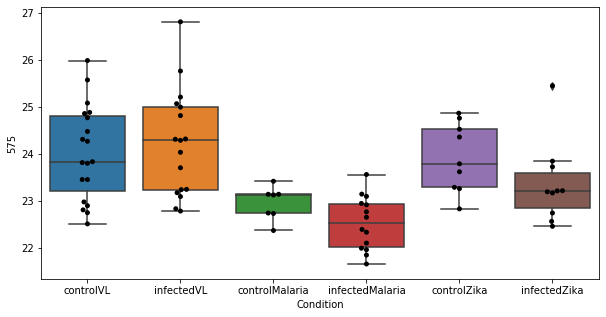

133 row m/z                                                          131.09
row retention time                                              10.3137
p-val                                                          0.291364
adj.P.Val                                                      0.999793
custom_id                                                           445
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 445, dtype: object


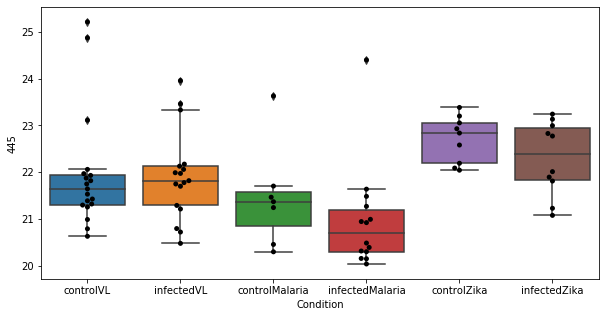

134 row m/z                681.483
row retention time     3.07408
p-val                 0.291501
adj.P.Val             0.999793
custom_id                 2908
compound_names             NaN
Name: 2908, dtype: object


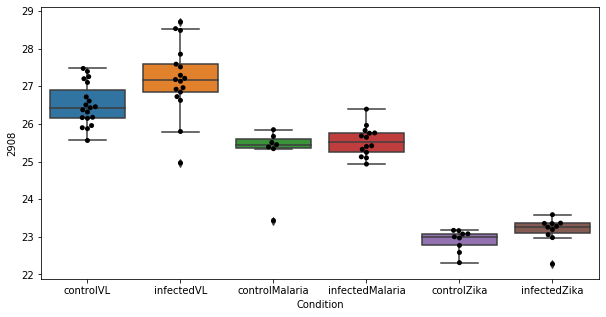

135 row m/z                                                         205.097
row retention time                                              9.95605
p-val                                                          0.292974
adj.P.Val                                                      0.999793
custom_id                                                          1502
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1502, dtype: object


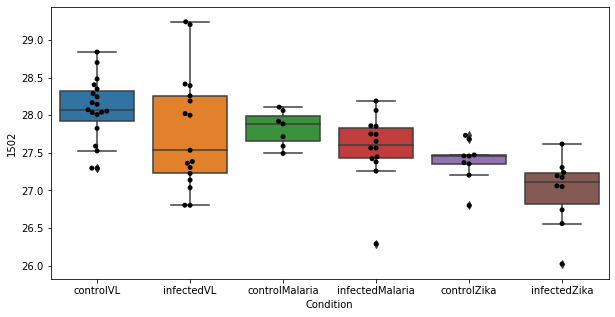

136 row m/z                 146.06
row retention time     9.95492
p-val                  0.29781
adj.P.Val             0.999793
custom_id                  664
compound_names             NaN
Name: 664, dtype: object


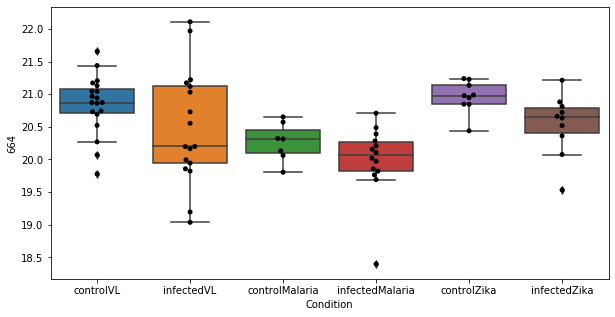

137 row m/z                                                         114.066
row retention time                                              8.59995
p-val                                                          0.301071
adj.P.Val                                                      0.999793
custom_id                                                           229
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 229, dtype: object


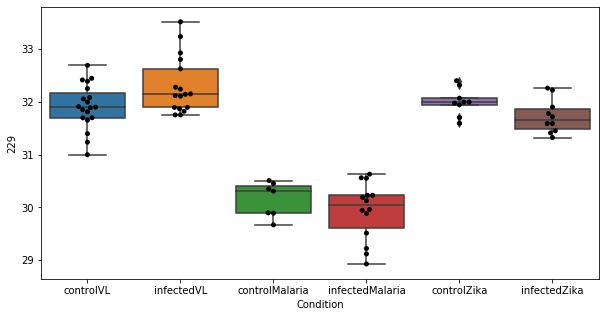

138 row m/z                247.092
row retention time     9.23847
p-val                 0.303336
adj.P.Val             0.999793
custom_id                 5039
compound_names             NaN
Name: 5039, dtype: object


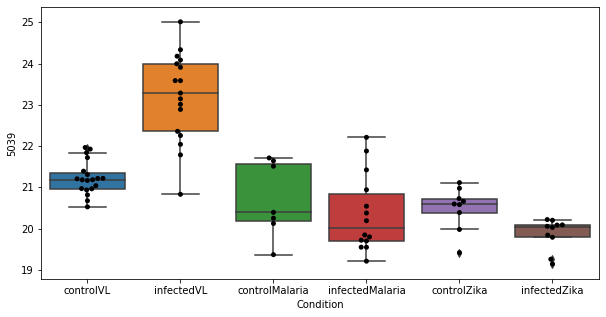

139 row m/z                161.092
row retention time     6.73059
p-val                 0.308222
adj.P.Val             0.999793
custom_id                  912
compound_names             NaN
Name: 912, dtype: object


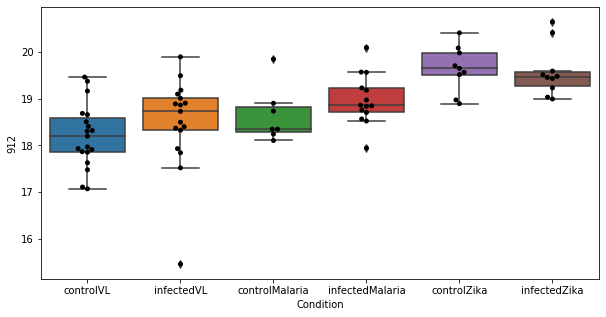

140 row m/z                                             190.05
row retention time                                 6.71104
p-val                                             0.311906
adj.P.Val                                         0.999793
custom_id                                             1289
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1289, dtype: object


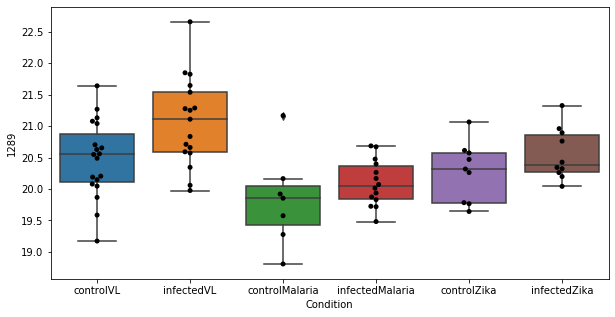

141 row m/z                                                         206.101
row retention time                                              9.95655
p-val                                                          0.313818
adj.P.Val                                                      0.999793
custom_id                                                          1506
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1506, dtype: object


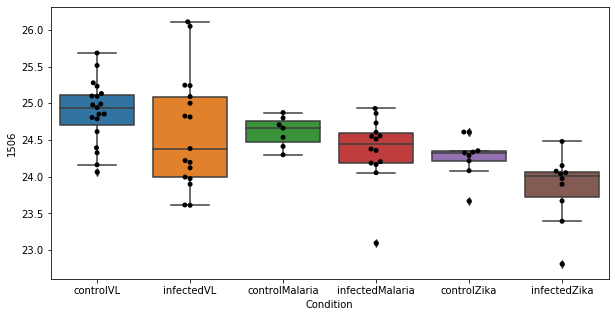

142 row m/z                334.295
row retention time     3.00561
p-val                 0.314533
adj.P.Val             0.999793
custom_id                 2517
compound_names             NaN
Name: 2517, dtype: object


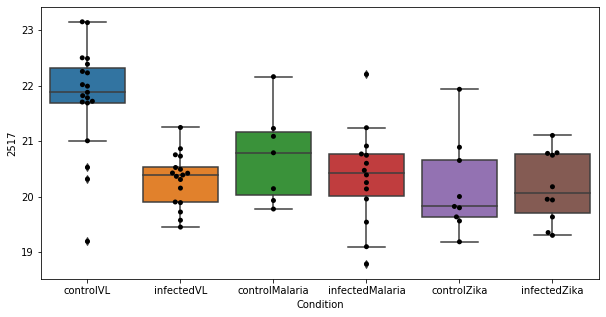

143 row m/z                                                         146.081
row retention time                                              8.32931
p-val                                                          0.317061
adj.P.Val                                                      0.999793
custom_id                                                           666
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 666, dtype: object


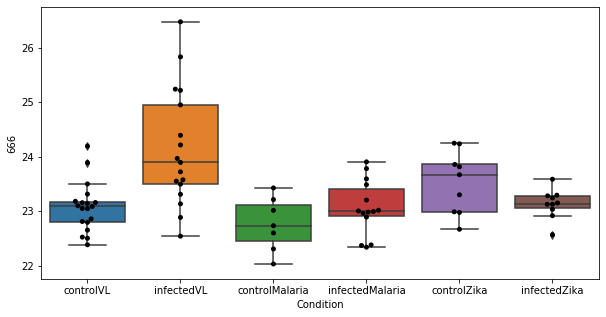

144 row m/z                                                         265.118
row retention time                                              6.71132
p-val                                                          0.318935
adj.P.Val                                                      0.999793
custom_id                                                          2140
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2140, dtype: object


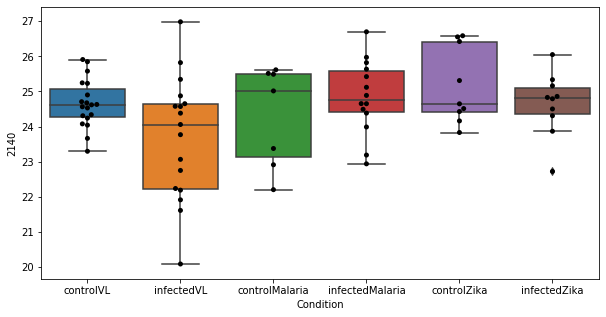

145 row m/z                155.107
row retention time     4.19565
p-val                 0.322003
adj.P.Val             0.999793
custom_id                  806
compound_names             NaN
Name: 806, dtype: object


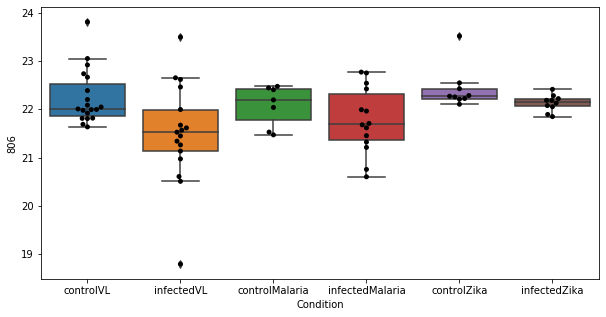

146 row m/z                                                424.342
row retention time                                     3.70254
p-val                                                 0.322718
adj.P.Val                                             0.999793
custom_id                                                 2693
compound_names        Linoleyl carnitine$Linoelaidyl carnitine
Name: 2693, dtype: object


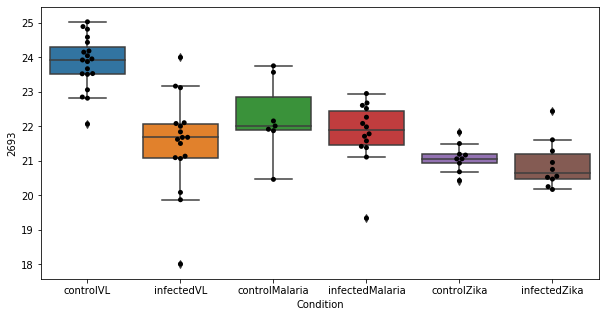

147 row m/z                139.018
row retention time     4.77225
p-val                  0.32391
adj.P.Val             0.999793
custom_id                 3389
compound_names             NaN
Name: 3389, dtype: object


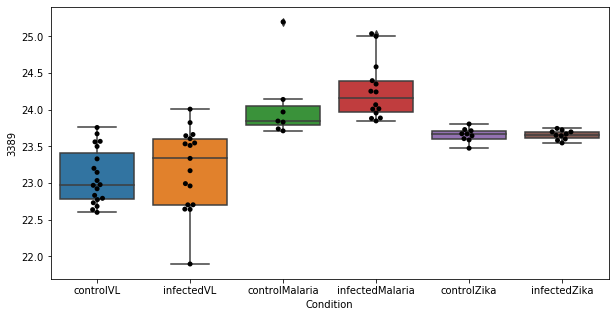

148 row m/z                119.083
row retention time     9.60849
p-val                 0.326919
adj.P.Val             0.999793
custom_id                  296
compound_names             NaN
Name: 296, dtype: object


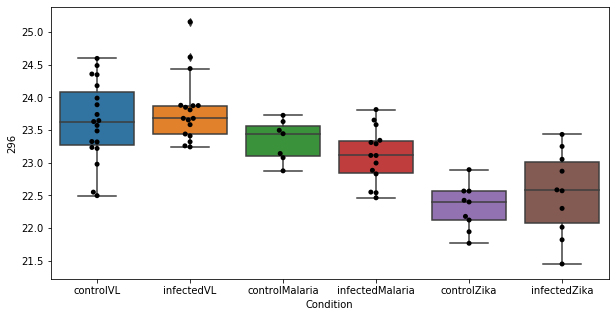

149 row m/z                                                          139.05
row retention time                                              9.67439
p-val                                                          0.327927
adj.P.Val                                                      0.999793
custom_id                                                           557
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 557, dtype: object


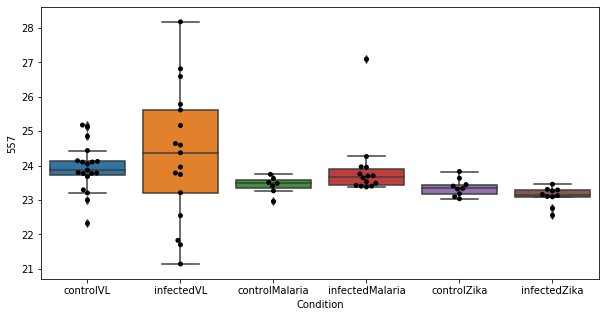

150 row m/z                                                         156.077
row retention time                                              11.7754
p-val                                                          0.332373
adj.P.Val                                                      0.999793
custom_id                                                           821
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 821, dtype: object


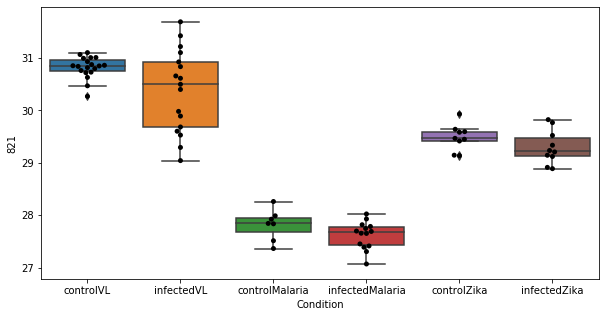

151 row m/z                                                          130.05
row retention time                                              6.71171
p-val                                                          0.333546
adj.P.Val                                                      0.999793
custom_id                                                           412
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 412, dtype: object


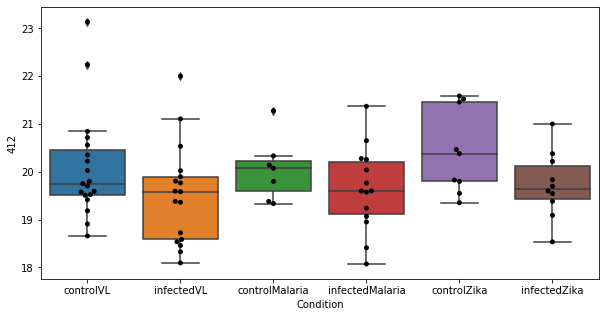

152 row m/z                239.164
row retention time     3.51225
p-val                 0.335704
adj.P.Val             0.999793
custom_id                 3915
compound_names             NaN
Name: 3915, dtype: object


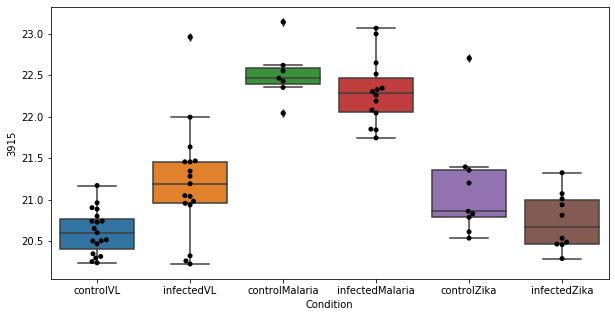

153 row m/z                                                           74.06
row retention time                                              11.6091
p-val                                                          0.340188
adj.P.Val                                                      0.999793
custom_id                                                            10
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 10, dtype: object


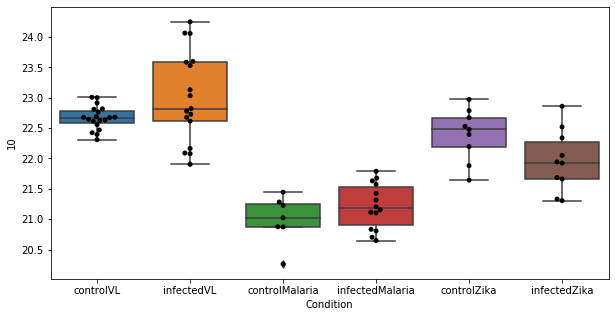

154 row m/z                280.235
row retention time     3.07719
p-val                 0.347068
adj.P.Val             0.999793
custom_id                 2250
compound_names             NaN
Name: 2250, dtype: object


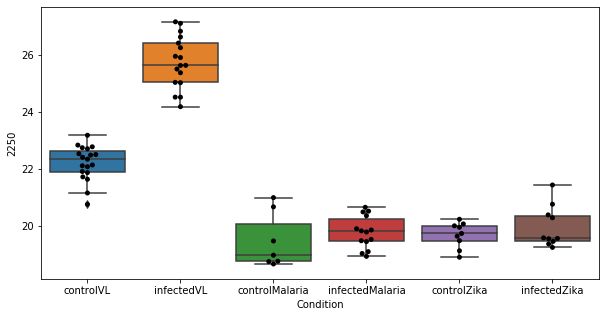

155 row m/z                 168.066
row retention time      6.71562
p-val                  0.348719
adj.P.Val              0.999793
custom_id                  3547
compound_names        Pyridoxal
Name: 3547, dtype: object


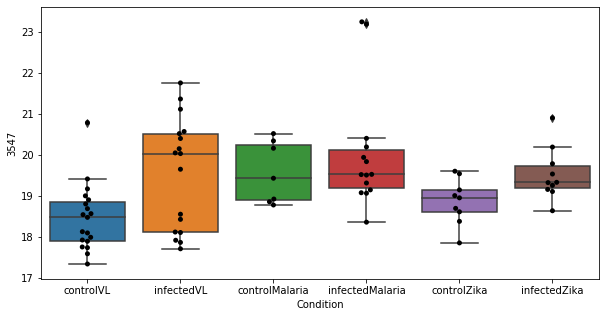

156 row m/z                                                         154.05
row retention time                                              6.7173
p-val                                                         0.354017
adj.P.Val                                                     0.999793
custom_id                                                          791
compound_names        3-Hydroxyanthranilate; 3-Hydroxyanthranilic acid
Name: 791, dtype: object


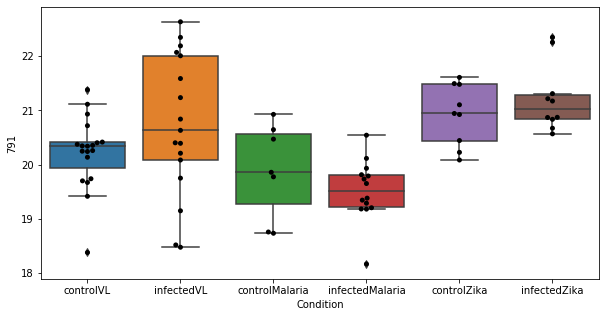

157 row m/z                772.584
row retention time     3.20902
p-val                 0.354484
adj.P.Val             0.999793
custom_id                 2995
compound_names             NaN
Name: 2995, dtype: object


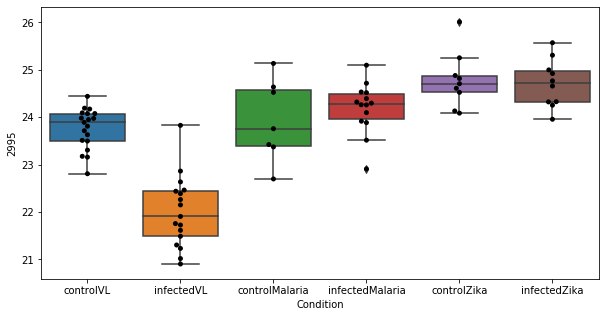

158 row m/z                454.293
row retention time     3.81597
p-val                 0.356678
adj.P.Val             0.999793
custom_id                 2723
compound_names             NaN
Name: 2723, dtype: object


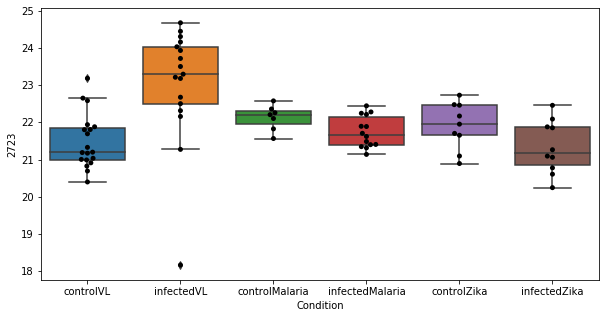

159 row m/z                229.155
row retention time     8.61265
p-val                  0.36144
adj.P.Val             0.999793
custom_id                 1790
compound_names             NaN
Name: 1790, dtype: object


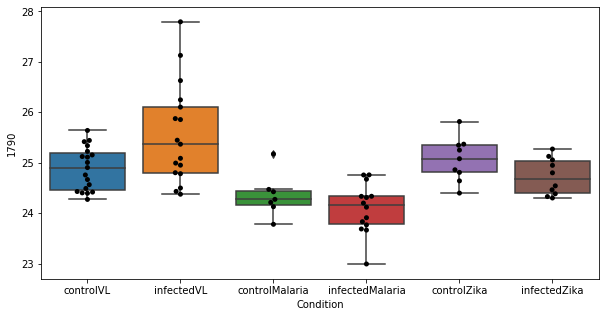

160 row m/z                      170.118
row retention time            4.3833
p-val                       0.364156
adj.P.Val                   0.999793
custom_id                       1033
compound_names        L-Metanephrine
Name: 1033, dtype: object


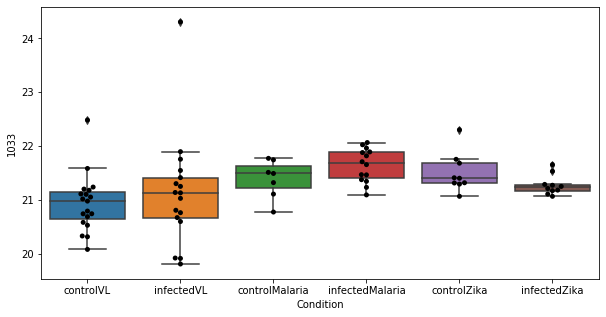

161 row m/z                158.081
row retention time      9.0109
p-val                  0.36606
adj.P.Val             0.999793
custom_id                  856
compound_names             NaN
Name: 856, dtype: object


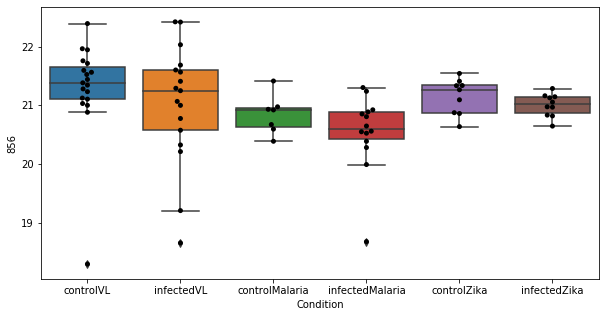

162 row m/z                232.118
row retention time     4.37089
p-val                 0.367944
adj.P.Val             0.999793
custom_id                 1822
compound_names             NaN
Name: 1822, dtype: object


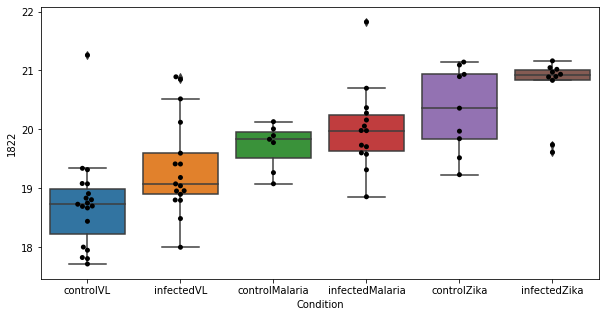

163 row m/z                             160.097
row retention time                  10.2328
p-val                              0.378932
adj.P.Val                          0.999793
custom_id                               898
compound_names        5-Acetamidopentanoate
Name: 898, dtype: object


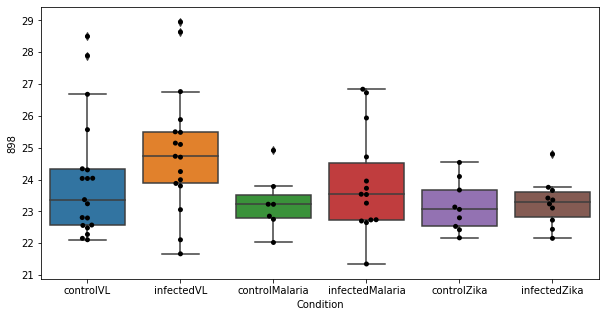

164 row m/z                143.082
row retention time     10.3312
p-val                 0.380166
adj.P.Val             0.999793
custom_id                  602
compound_names             NaN
Name: 602, dtype: object


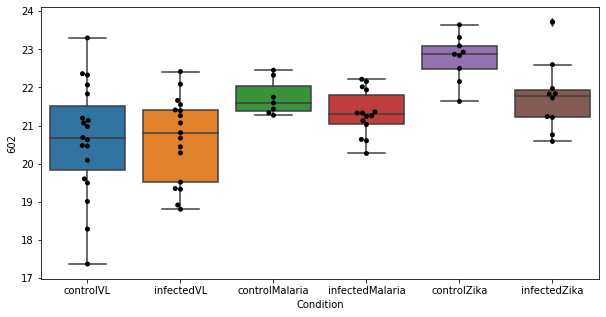

165 row m/z                                                         130.086
row retention time                                              10.3159
p-val                                                          0.380751
adj.P.Val                                                      0.999793
custom_id                                                           422
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 422, dtype: object


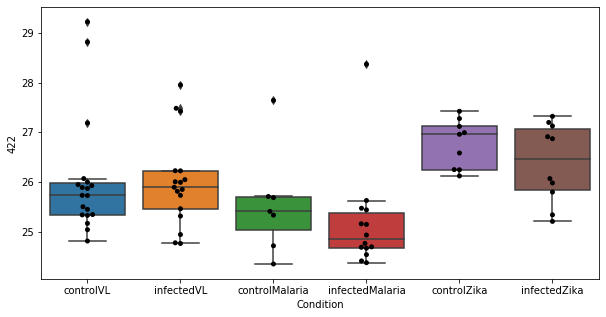

166 row m/z                239.139
row retention time     4.38046
p-val                 0.383329
adj.P.Val             0.999793
custom_id                 1898
compound_names             NaN
Name: 1898, dtype: object


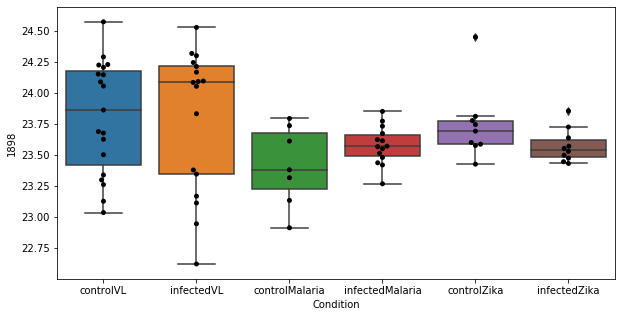

167 row m/z                            110.071
row retention time                 11.7798
p-val                             0.385312
adj.P.Val                         0.999793
custom_id                              194
compound_names        4-Guanidinobutanoate
Name: 194, dtype: object


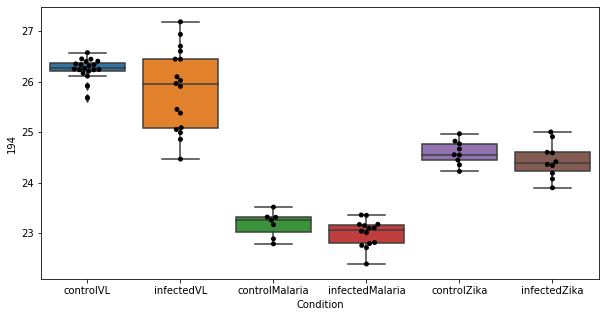

168 row m/z                                                         133.061
row retention time                                              10.3339
p-val                                                          0.385516
adj.P.Val                                                      0.999793
custom_id                                                           473
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 473, dtype: object


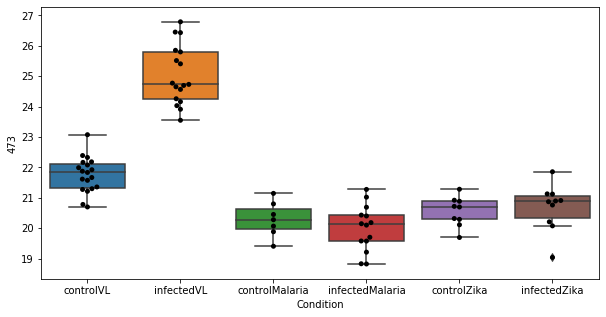

169 row m/z                216.058
row retention time     9.31753
p-val                 0.389546
adj.P.Val             0.999793
custom_id                 1626
compound_names             NaN
Name: 1626, dtype: object


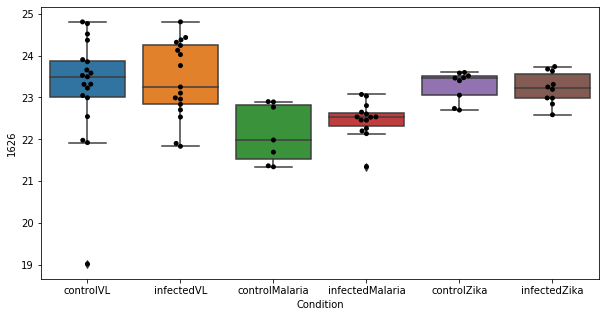

170 row m/z                161.092
row retention time     11.6037
p-val                 0.389778
adj.P.Val             0.999793
custom_id                  911
compound_names             NaN
Name: 911, dtype: object


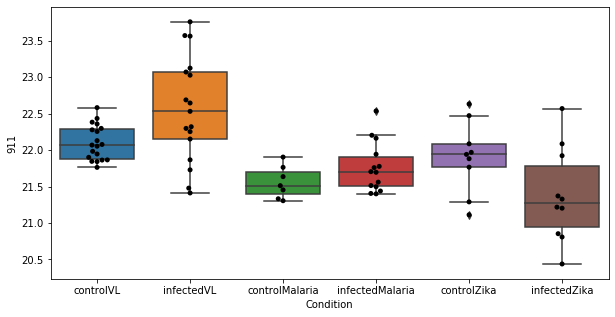

171 row m/z                153.091
row retention time       4.363
p-val                 0.392463
adj.P.Val             0.999793
custom_id                  787
compound_names             NaN
Name: 787, dtype: object


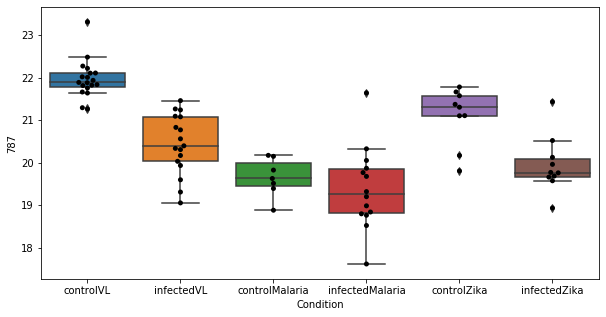

172 row m/z                 163.11
row retention time     10.7406
p-val                 0.394763
adj.P.Val             0.999793
custom_id                  931
compound_names             NaN
Name: 931, dtype: object


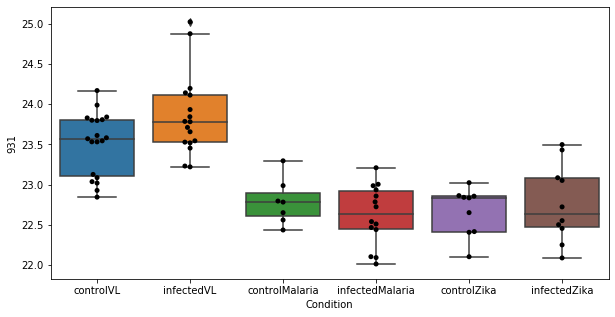

173 row m/z                204.951
row retention time     9.66439
p-val                 0.395499
adj.P.Val             0.999793
custom_id                 1495
compound_names             NaN
Name: 1495, dtype: object


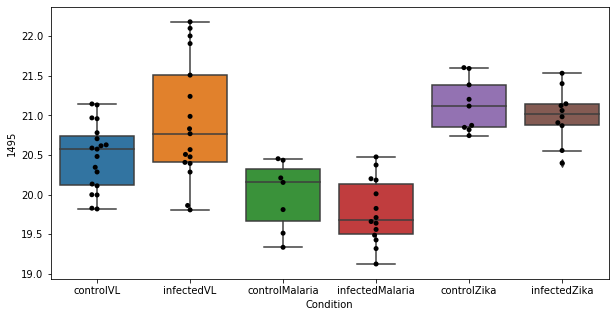

174 row m/z                                       328.248
row retention time                             4.3144
p-val                                        0.397911
adj.P.Val                                    0.999793
custom_id                                        2503
compound_names        2,6 dimethylheptanoyl carnitine
Name: 2503, dtype: object


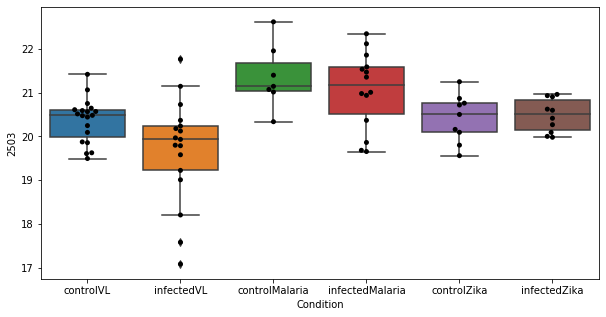

175 row m/z                814.626
row retention time      3.1529
p-val                 0.399115
adj.P.Val             0.999793
custom_id                 3086
compound_names             NaN
Name: 3086, dtype: object


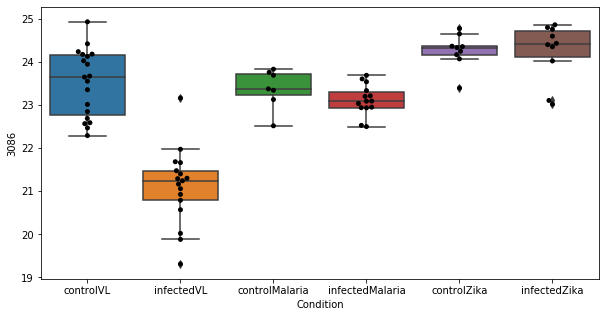

176 row m/z                789.618
row retention time     3.18516
p-val                 0.400087
adj.P.Val             0.999793
custom_id                 3033
compound_names             NaN
Name: 3033, dtype: object


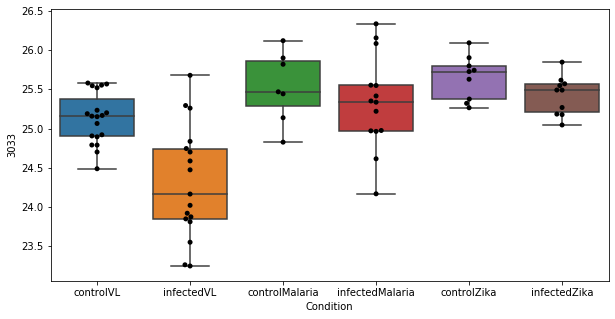

177 row m/z                202.144
row retention time     4.38168
p-val                 0.402387
adj.P.Val             0.999793
custom_id                 1449
compound_names             NaN
Name: 1449, dtype: object


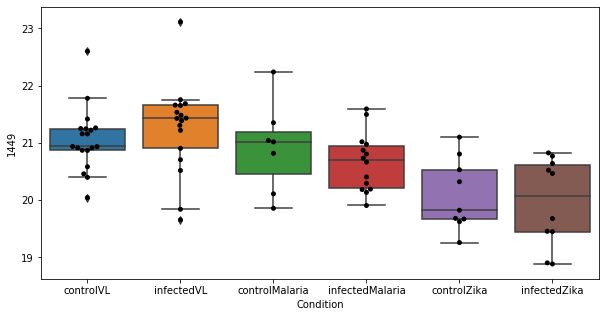

178 row m/z                613.523
row retention time     2.99142
p-val                 0.415355
adj.P.Val             0.999793
custom_id                 2871
compound_names             NaN
Name: 2871, dtype: object


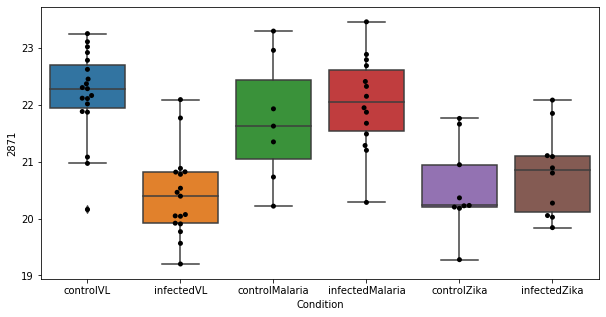

179 row m/z                223.097
row retention time     3.49122
p-val                 0.415367
adj.P.Val             0.999793
custom_id                 1715
compound_names             NaN
Name: 1715, dtype: object


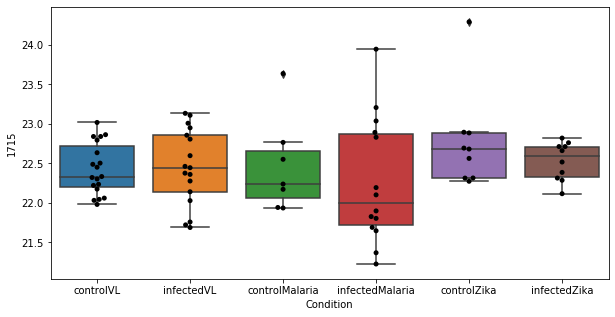

180 row m/z                                                         160.097
row retention time                                              6.71847
p-val                                                          0.417387
adj.P.Val                                                      0.999793
custom_id                                                           899
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 899, dtype: object


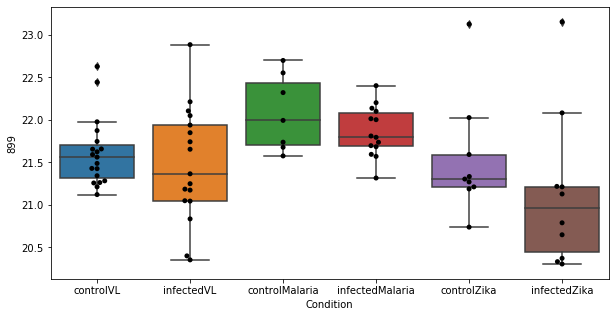

181 row m/z                                                         188.092
row retention time                                              4.43717
p-val                                                           0.41755
adj.P.Val                                                      0.999793
custom_id                                                          1265
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1265, dtype: object


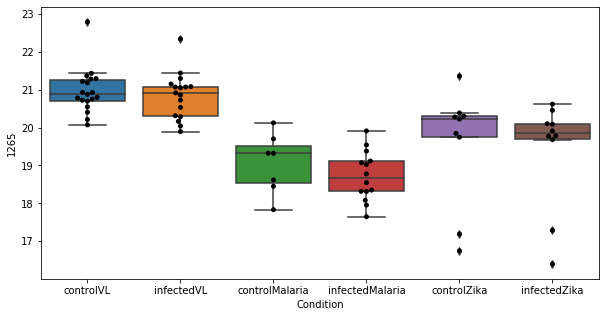

182 row m/z                                                        89.0597
row retention time                                             3.80364
p-val                                                         0.422065
adj.P.Val                                                     0.999793
custom_id                                                           75
compound_names        Butanoic acid; Butanoate; Butyrate; Butyric acid
Name: 75, dtype: object


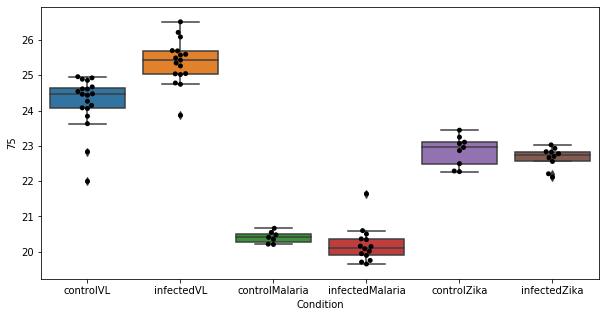

183 row m/z                773.588
row retention time     3.20318
p-val                 0.423486
adj.P.Val             0.999793
custom_id                 2997
compound_names             NaN
Name: 2997, dtype: object


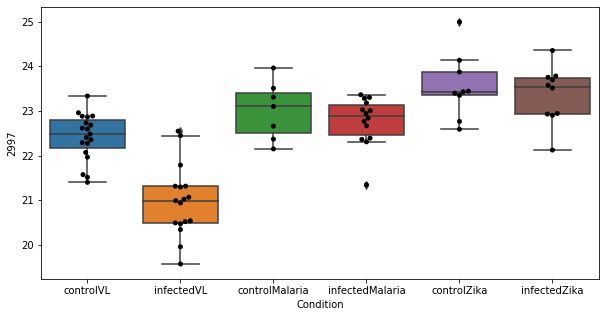

184 row m/z                142.948
row retention time     12.4757
p-val                 0.425582
adj.P.Val             0.999793
custom_id                  596
compound_names             NaN
Name: 596, dtype: object


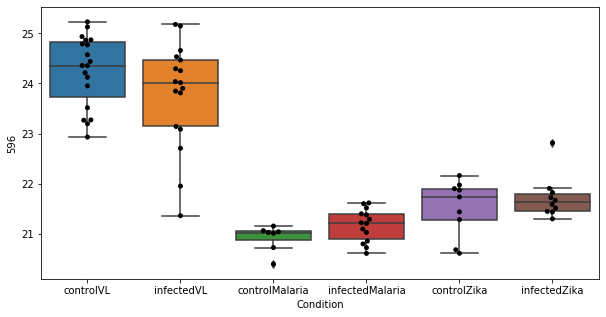

185 row m/z                512.335
row retention time     4.20079
p-val                 0.427049
adj.P.Val             0.999793
custom_id                 2782
compound_names             NaN
Name: 2782, dtype: object


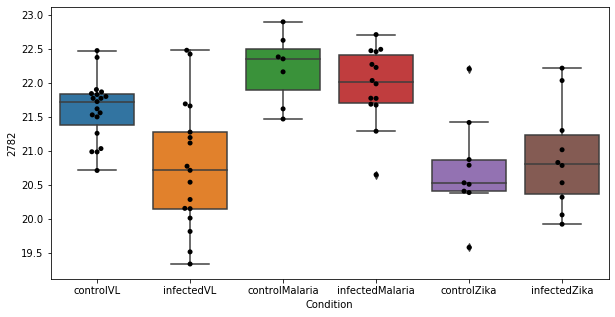

186 row m/z                811.604
row retention time     3.16645
p-val                  0.42989
adj.P.Val             0.999793
custom_id                 3075
compound_names             NaN
Name: 3075, dtype: object


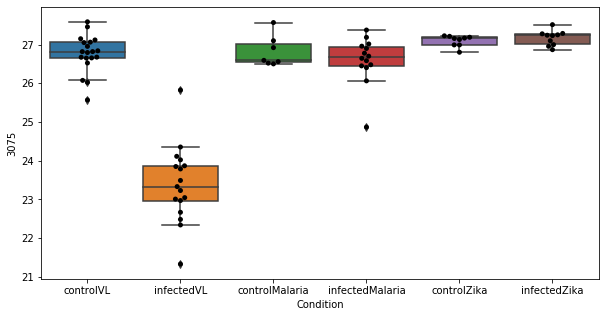

187 row m/z                239.139
row retention time     6.70223
p-val                 0.440437
adj.P.Val             0.999793
custom_id                 1897
compound_names             NaN
Name: 1897, dtype: object


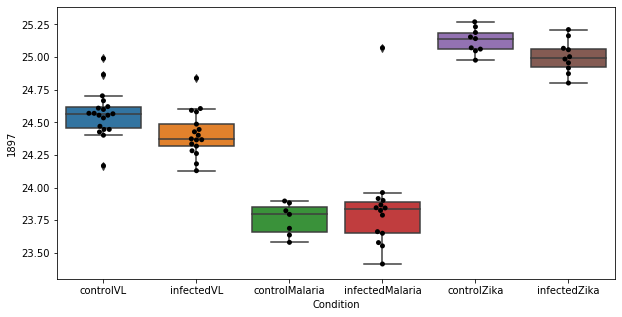

188 row m/z                124.087
row retention time     10.3561
p-val                 0.441283
adj.P.Val             0.999793
custom_id                  357
compound_names             NaN
Name: 357, dtype: object


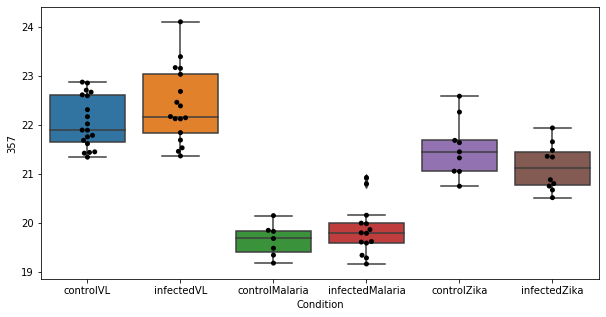

189 row m/z                87.0789
row retention time     11.7103
p-val                 0.446201
adj.P.Val             0.999793
custom_id                   65
compound_names             NaN
Name: 65, dtype: object


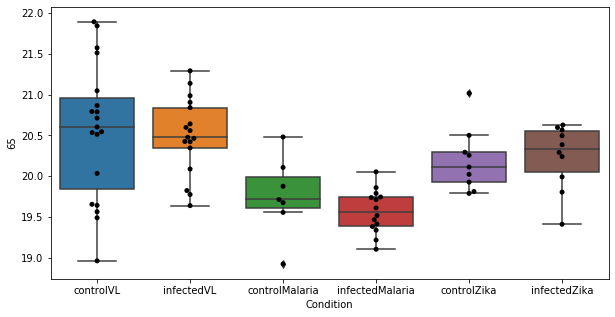

190 row m/z                 222.17
row retention time     3.48165
p-val                 0.446371
adj.P.Val             0.999793
custom_id                 1707
compound_names             NaN
Name: 1707, dtype: object


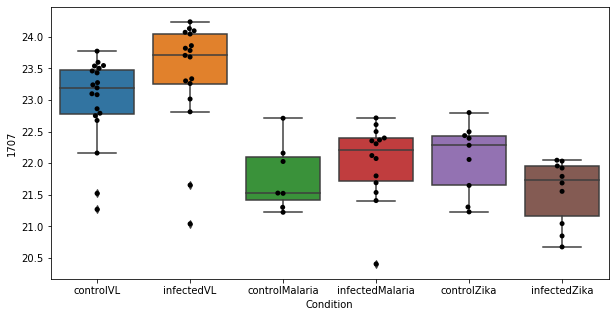

191 row m/z                                                         169.086
row retention time                                              6.70711
p-val                                                          0.456481
adj.P.Val                                                      0.999793
custom_id                                                          1012
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1012, dtype: object


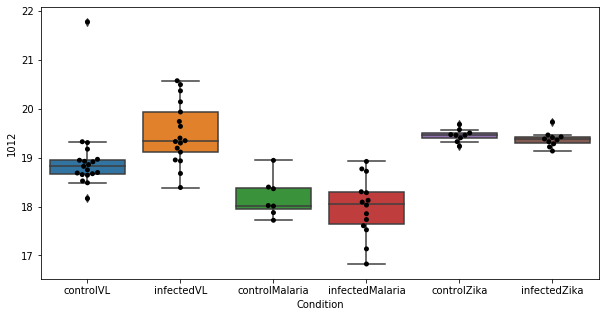

192 row m/z                615.539
row retention time     2.99217
p-val                 0.456767
adj.P.Val             0.999793
custom_id                 2874
compound_names             NaN
Name: 2874, dtype: object


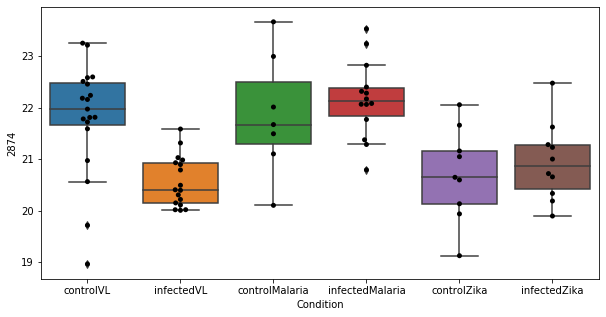

193 row m/z                595.493
row retention time     3.00049
p-val                 0.462647
adj.P.Val             0.999793
custom_id                 2855
compound_names             NaN
Name: 2855, dtype: object


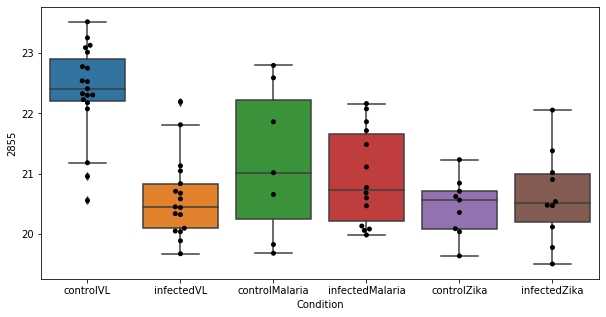

194 row m/z                                 137.046
row retention time                      9.04271
p-val                                  0.464114
adj.P.Val                              0.999793
custom_id                                   534
compound_names        Hypoxanthine; Purine-6-ol
Name: 534, dtype: object


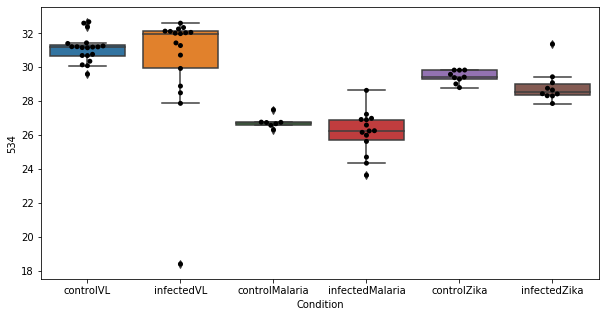

195 row m/z                228.123
row retention time     6.70606
p-val                 0.467864
adj.P.Val             0.999793
custom_id                 1769
compound_names             NaN
Name: 1769, dtype: object


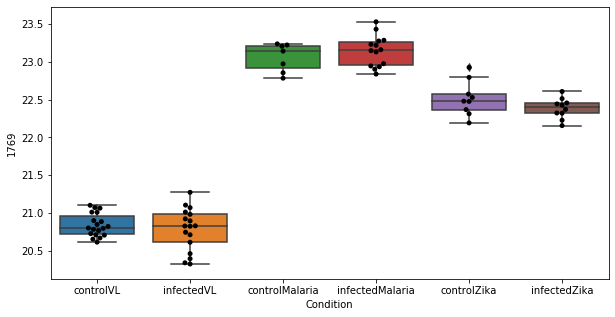

196 row m/z                232.118
row retention time     6.70933
p-val                 0.469006
adj.P.Val             0.999793
custom_id                 1821
compound_names             NaN
Name: 1821, dtype: object


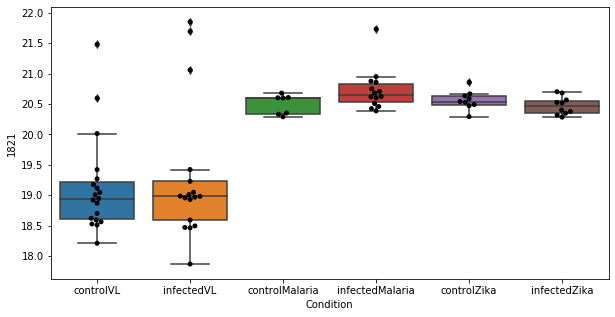

197 row m/z                785.651
row retention time     3.29657
p-val                 0.469296
adj.P.Val             0.999793
custom_id                 3017
compound_names             NaN
Name: 3017, dtype: object


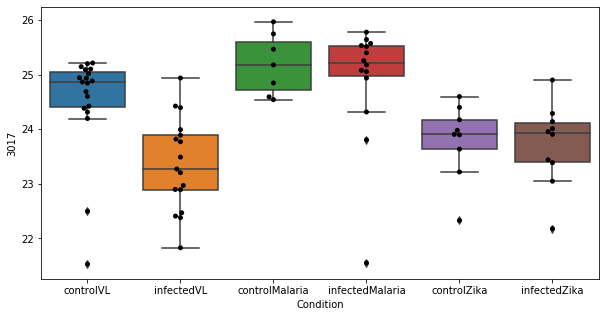

198 row m/z                                                   168.102
row retention time                                        6.71441
p-val                                                     0.47065
adj.P.Val                                                0.999793
custom_id                                                    4731
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 4731, dtype: object


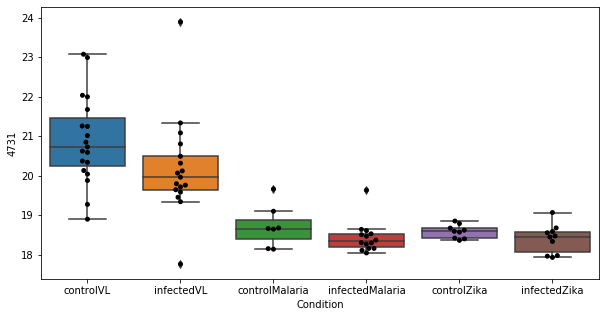

199 row m/z                                                         159.076
row retention time                                              12.4199
p-val                                                          0.471063
adj.P.Val                                                      0.999793
custom_id                                                           876
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 876, dtype: object


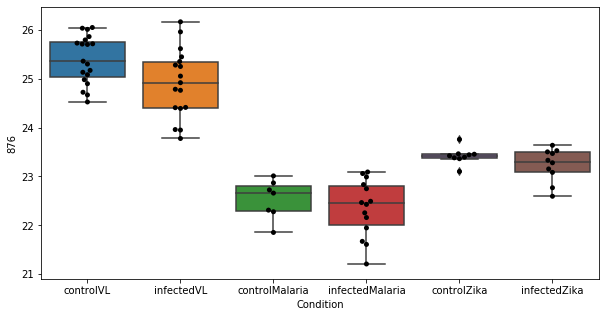

200 row m/z                                                         105.074
row retention time                                              10.2259
p-val                                                          0.484075
adj.P.Val                                                      0.999793
custom_id                                                           152
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 152, dtype: object


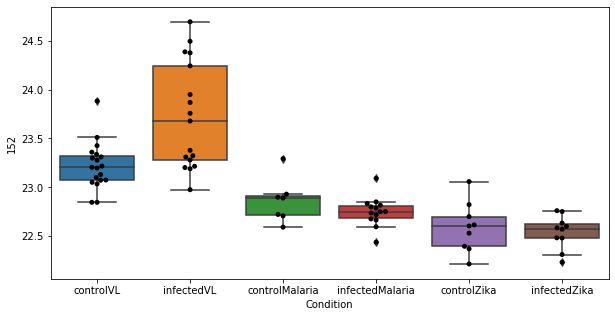

201 row m/z                                                         130.065
row retention time                                              6.72681
p-val                                                           0.48415
adj.P.Val                                                      0.999793
custom_id                                                           416
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 416, dtype: object


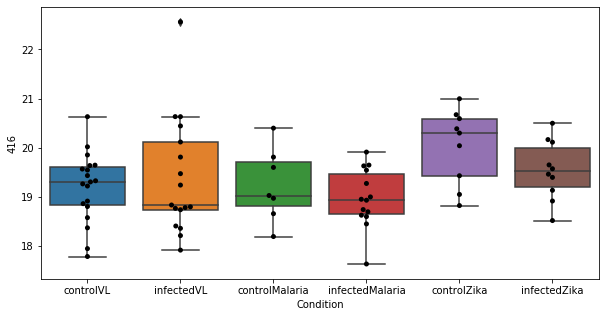

202 row m/z                134.106
row retention time     9.28237
p-val                 0.485758
adj.P.Val             0.999793
custom_id                  503
compound_names             NaN
Name: 503, dtype: object


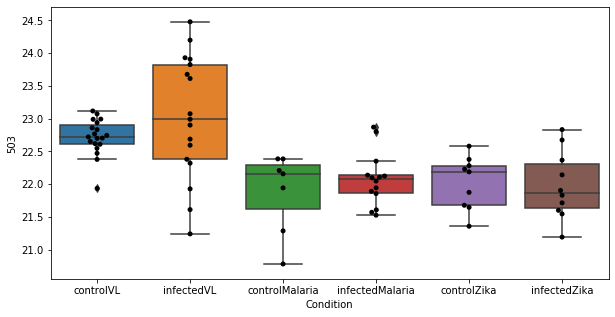

203 row m/z                733.557
row retention time      3.2348
p-val                 0.488577
adj.P.Val             0.999793
custom_id                 2944
compound_names             NaN
Name: 2944, dtype: object


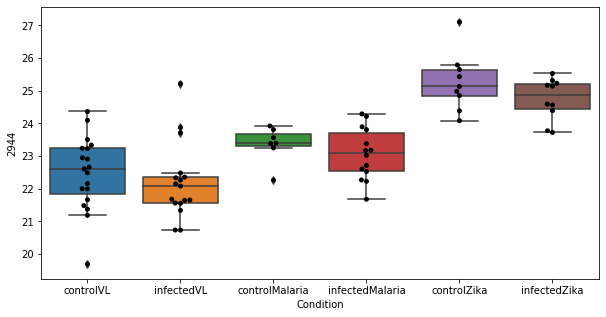

204 row m/z                  810.6
row retention time     3.17127
p-val                 0.490575
adj.P.Val             0.999793
custom_id                 3073
compound_names             NaN
Name: 3073, dtype: object


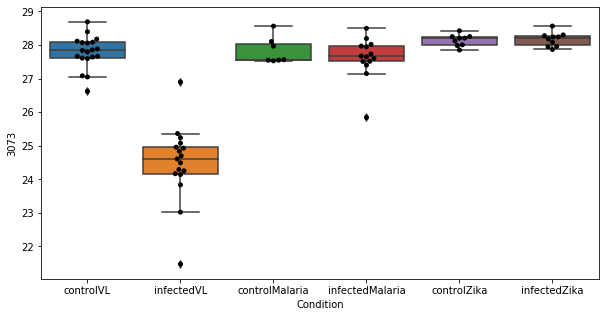

205 row m/z                832.584
row retention time     3.16211
p-val                 0.491544
adj.P.Val             0.999793
custom_id                 3114
compound_names             NaN
Name: 3114, dtype: object


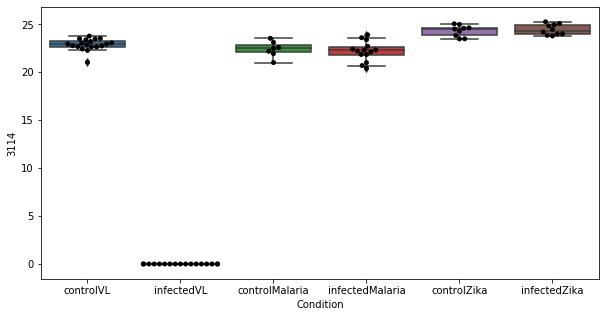

206 row m/z                                                         120.066
row retention time                                              9.57777
p-val                                                          0.493322
adj.P.Val                                                      0.999793
custom_id                                                           302
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 302, dtype: object


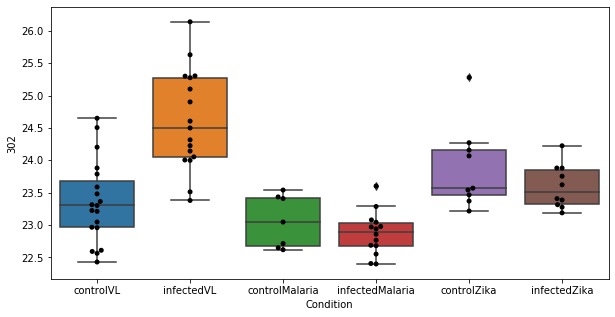

207 row m/z                                                         114.055
row retention time                                              8.43271
p-val                                                           0.49503
adj.P.Val                                                      0.999793
custom_id                                                           225
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 225, dtype: object


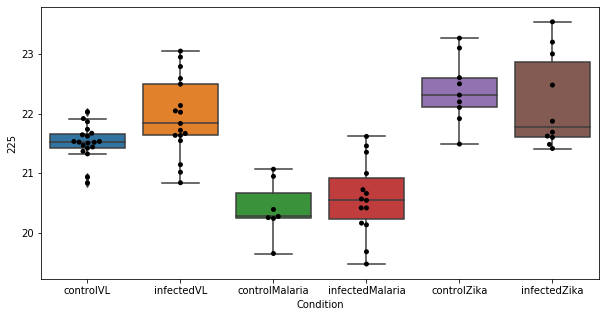

208 row m/z                                                         121.069
row retention time                                              11.6072
p-val                                                          0.495142
adj.P.Val                                                      0.999793
custom_id                                                           318
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 318, dtype: object


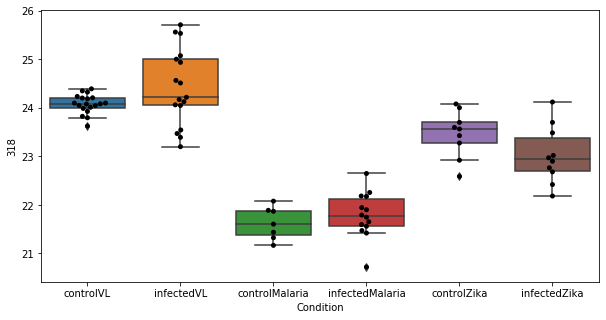

209 row m/z                  834.6
row retention time     3.15696
p-val                 0.496245
adj.P.Val             0.999793
custom_id                 3116
compound_names             NaN
Name: 3116, dtype: object


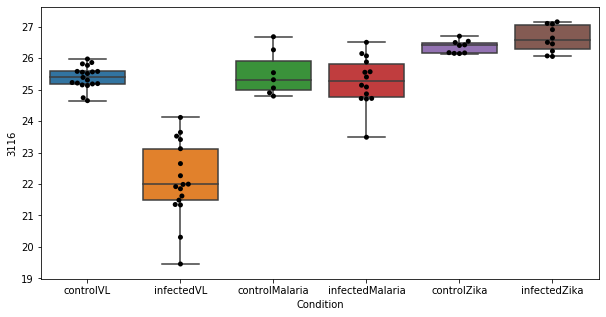

210 row m/z                905.594
row retention time     2.99894
p-val                 0.496526
adj.P.Val             0.999793
custom_id                 3200
compound_names             NaN
Name: 3200, dtype: object


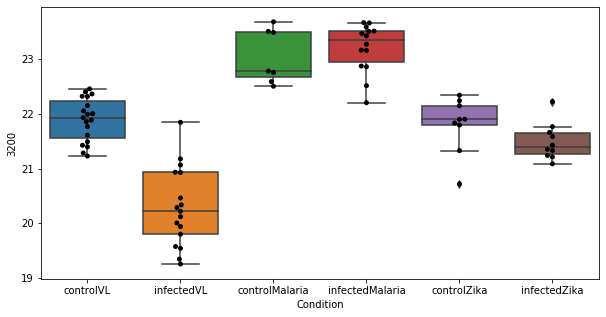

211 row m/z                288.225
row retention time     3.33908
p-val                 0.497084
adj.P.Val             0.999793
custom_id                 2310
compound_names             NaN
Name: 2310, dtype: object


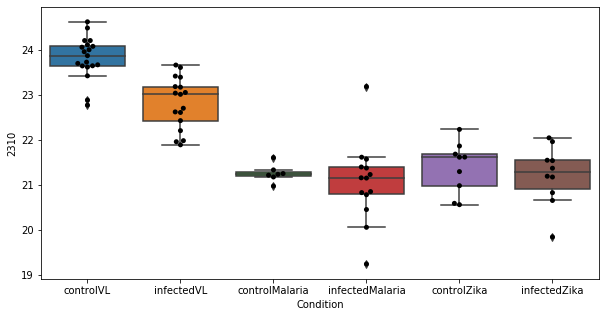

212 row m/z                676.547
row retention time     3.46451
p-val                 0.497455
adj.P.Val             0.999793
custom_id                 2905
compound_names             NaN
Name: 2905, dtype: object


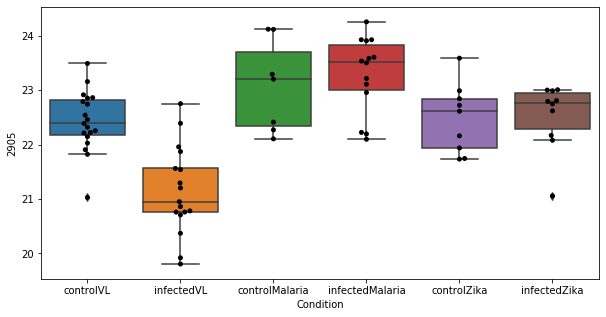

213 row m/z                214.253
row retention time     6.77671
p-val                 0.498285
adj.P.Val             0.999793
custom_id                 3803
compound_names             NaN
Name: 3803, dtype: object


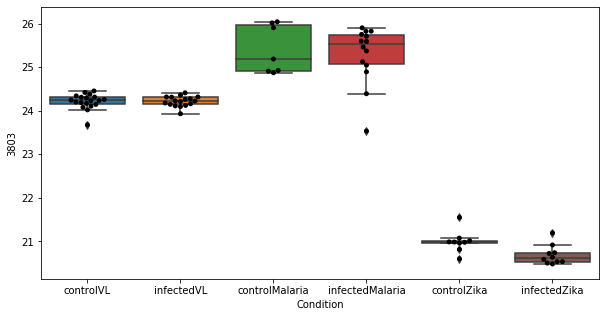

214 row m/z                289.053
row retention time     9.96725
p-val                 0.499107
adj.P.Val             0.999793
custom_id                 2319
compound_names             NaN
Name: 2319, dtype: object


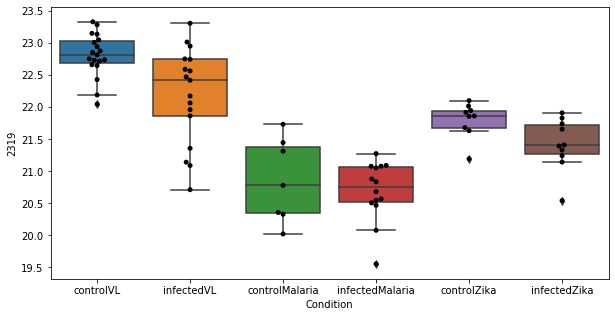

215 row m/z                                 139.05
row retention time                     9.04449
p-val                                 0.500101
adj.P.Val                             0.999793
custom_id                                 3392
compound_names        Urocanate; Urocanic acid
Name: 3392, dtype: object


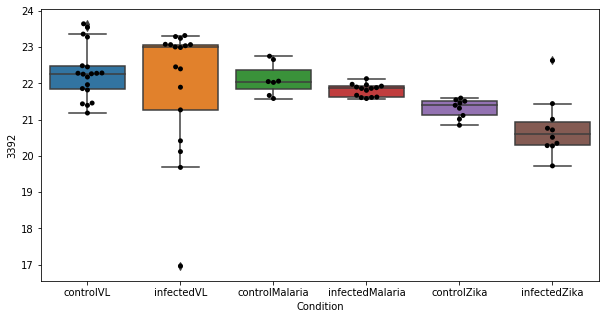

216 row m/z                807.572
row retention time     3.18235
p-val                 0.502438
adj.P.Val             0.999793
custom_id                 3065
compound_names             NaN
Name: 3065, dtype: object


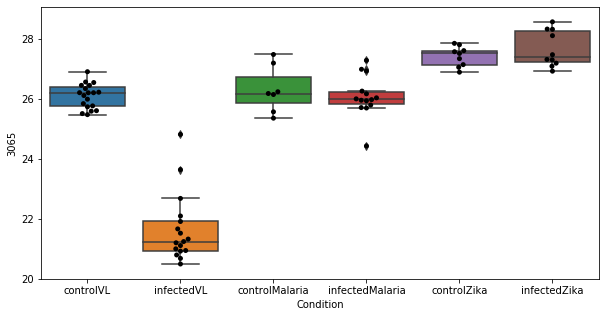

217 row m/z                191.085
row retention time     9.80185
p-val                 0.503305
adj.P.Val             0.999793
custom_id                 1299
compound_names             NaN
Name: 1299, dtype: object


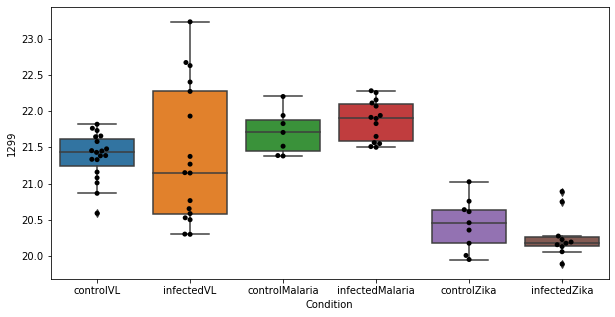

218 row m/z                143.107
row retention time     4.38606
p-val                 0.509237
adj.P.Val             0.999793
custom_id                  610
compound_names             NaN
Name: 610, dtype: object


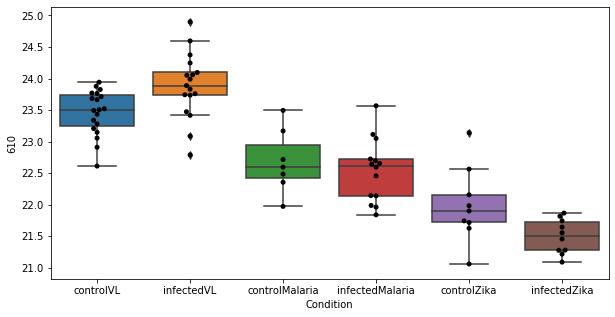

219 row m/z                163.116
row retention time     10.7419
p-val                 0.513173
adj.P.Val             0.999793
custom_id                  935
compound_names             NaN
Name: 935, dtype: object


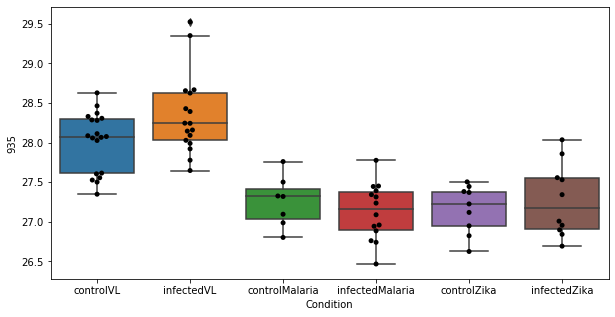

220 row m/z                      216.123
row retention time           6.72113
p-val                       0.515063
adj.P.Val                   0.999793
custom_id                       1633
compound_names        L-Metanephrine
Name: 1633, dtype: object


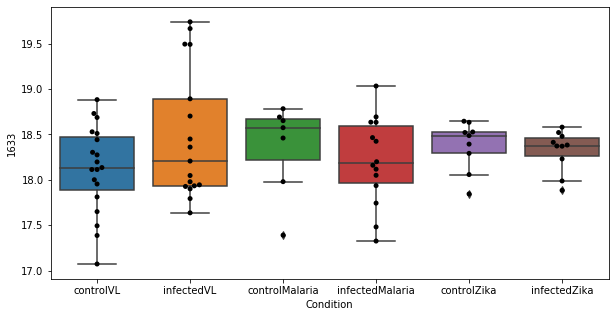

221 row m/z                                                          157.08
row retention time                                              11.7725
p-val                                                          0.519241
adj.P.Val                                                      0.999793
custom_id                                                           841
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 841, dtype: object


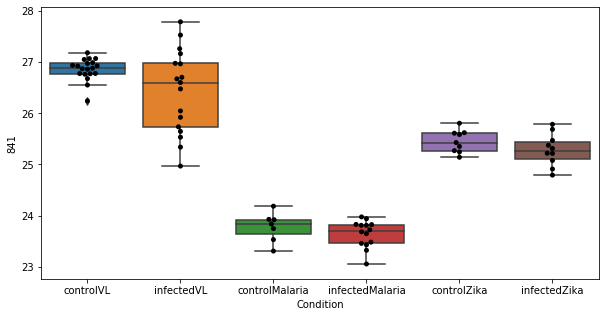

222 row m/z                575.467
row retention time     2.97972
p-val                 0.521695
adj.P.Val             0.999793
custom_id                 2836
compound_names             NaN
Name: 2836, dtype: object


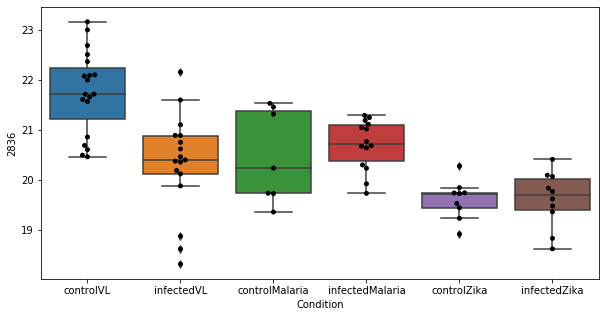

223 row m/z                76.0757
row retention time     9.35989
p-val                 0.524817
adj.P.Val             0.999793
custom_id                   19
compound_names             NaN
Name: 19, dtype: object


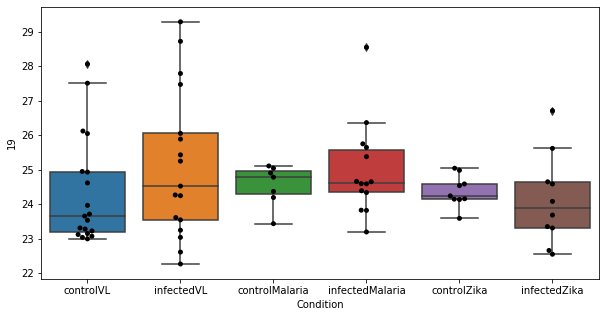

224 row m/z                229.155
row retention time     10.5569
p-val                 0.527825
adj.P.Val             0.999793
custom_id                 1791
compound_names             NaN
Name: 1791, dtype: object


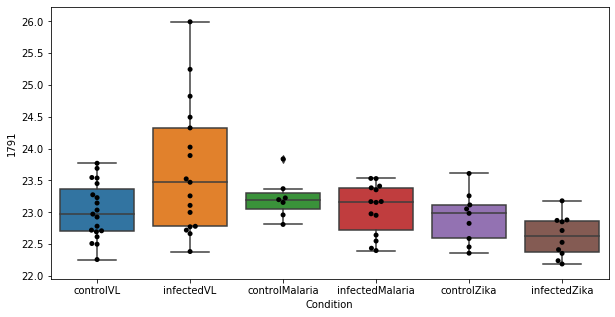

225 row m/z                247.144
row retention time     7.69256
p-val                 0.528263
adj.P.Val             0.999793
custom_id                 1973
compound_names             NaN
Name: 1973, dtype: object


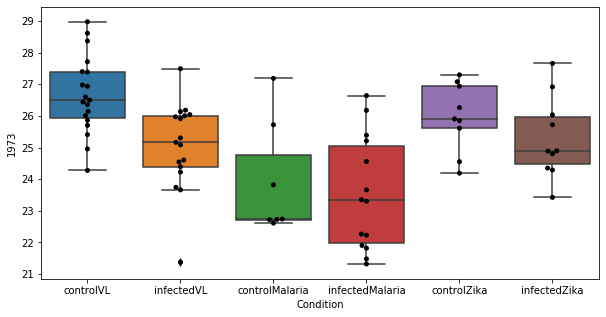

226 row m/z                                                         162.076
row retention time                                              9.36508
p-val                                                          0.529877
adj.P.Val                                                      0.999793
custom_id                                                           925
compound_names        D-Glucosamine; Chitosamine; 2-Amino-2-deoxy-D-...
Name: 925, dtype: object


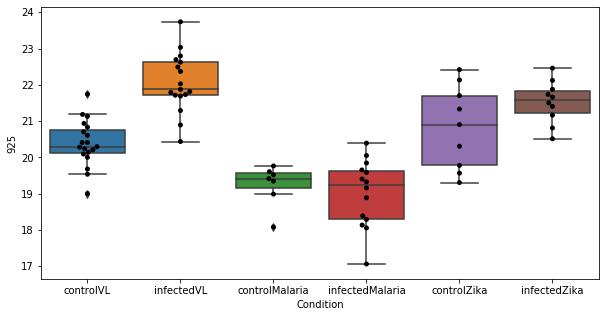

227 row m/z                                                         162.112
row retention time                                              10.7402
p-val                                                          0.529928
adj.P.Val                                                      0.999793
custom_id                                                           927
compound_names        L-Carnitine; L-gamma-Trimethyl-beta-hydroxybut...
Name: 927, dtype: object


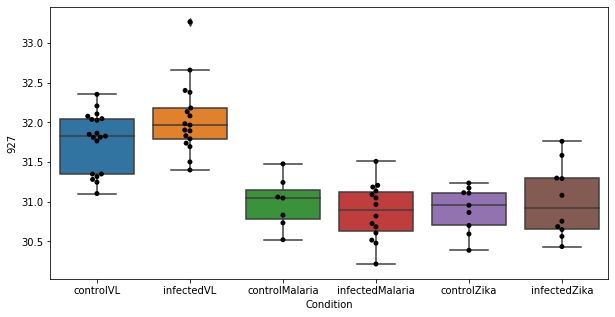

228 row m/z                244.191
row retention time     3.87308
p-val                  0.53371
adj.P.Val             0.999793
custom_id                 1944
compound_names             NaN
Name: 1944, dtype: object


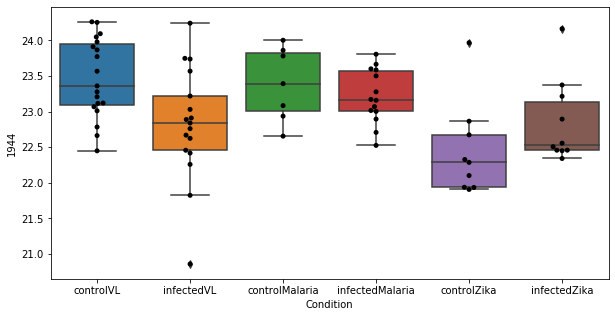

229 row m/z                 226.18
row retention time     3.89297
p-val                 0.539524
adj.P.Val             0.999793
custom_id                 1748
compound_names             NaN
Name: 1748, dtype: object


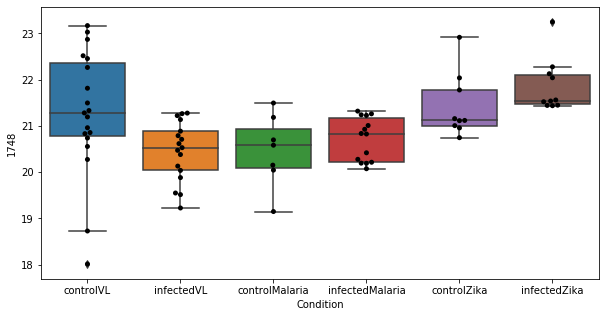

230 row m/z                132.054
row retention time     11.8975
p-val                 0.545874
adj.P.Val             0.999793
custom_id                  455
compound_names             NaN
Name: 455, dtype: object


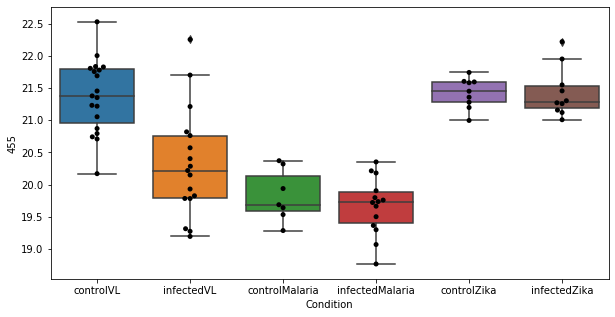

231 row m/z                174.132
row retention time      9.2893
p-val                 0.546504
adj.P.Val             0.999793
custom_id                 1096
compound_names             NaN
Name: 1096, dtype: object


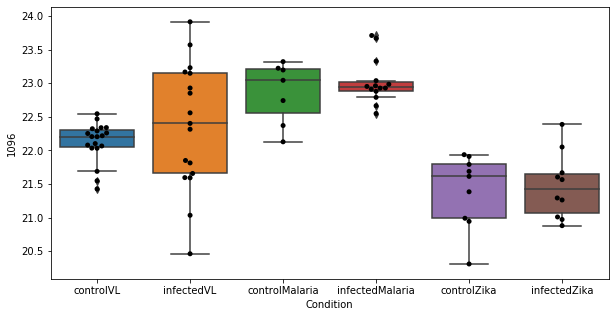

232 row m/z                             142.086
row retention time                  9.05916
p-val                              0.548533
adj.P.Val                          0.999793
custom_id                               584
compound_names        5-Acetamidopentanoate
Name: 584, dtype: object


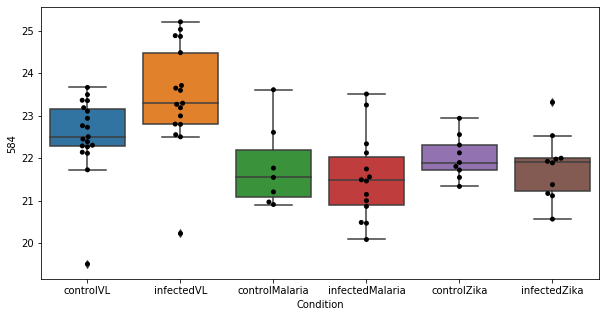

233 row m/z                812.614
row retention time     3.17385
p-val                 0.549159
adj.P.Val             0.999793
custom_id                 3079
compound_names             NaN
Name: 3079, dtype: object


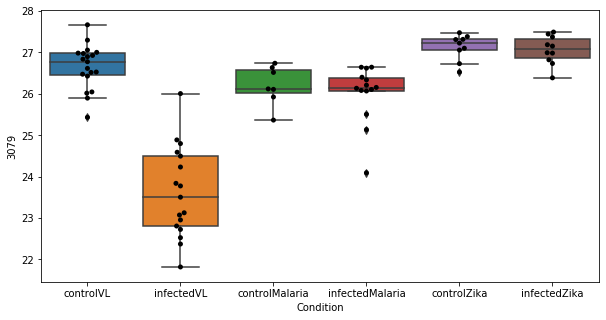

234 row m/z                183.113
row retention time     6.71641
p-val                 0.550576
adj.P.Val             0.999793
custom_id                 1197
compound_names             NaN
Name: 1197, dtype: object


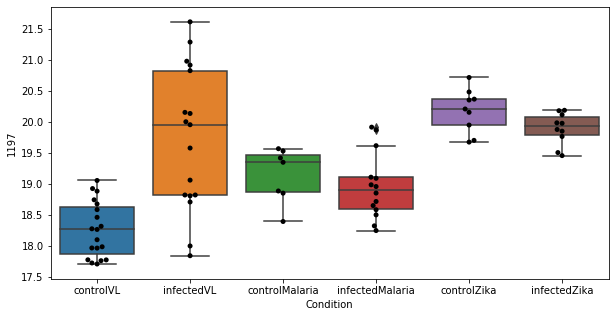

235 row m/z                            400.342
row retention time                 3.76884
p-val                             0.552457
adj.P.Val                         0.999793
custom_id                             2676
compound_names        L-Palmitoylcarnitine
Name: 2676, dtype: object


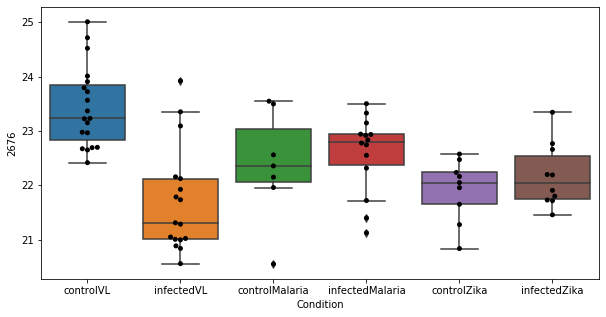

236 row m/z                164.119
row retention time     10.7393
p-val                 0.553988
adj.P.Val             0.999793
custom_id                  952
compound_names             NaN
Name: 952, dtype: object


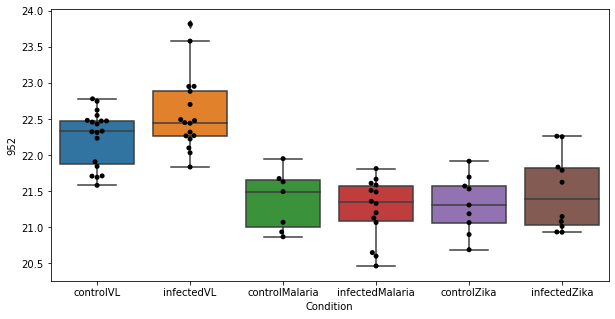

237 row m/z                158.081
row retention time     4.53391
p-val                 0.556928
adj.P.Val             0.999793
custom_id                  853
compound_names             NaN
Name: 853, dtype: object


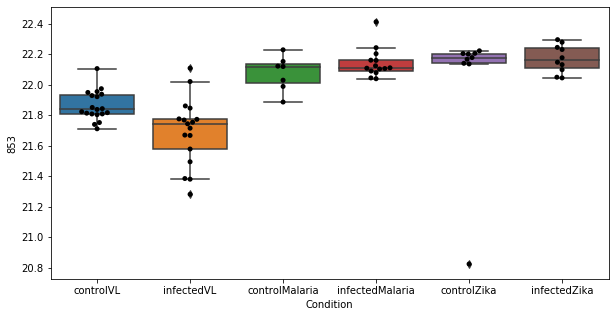

238 row m/z                770.603
row retention time     3.19827
p-val                 0.556976
adj.P.Val             0.999793
custom_id                 2992
compound_names             NaN
Name: 2992, dtype: object


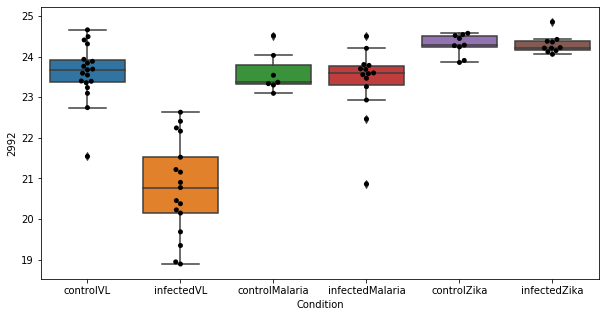

239 row m/z                                                         140.068
row retention time                                              9.59523
p-val                                                          0.557329
adj.P.Val                                                      0.999793
custom_id                                                           568
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 568, dtype: object


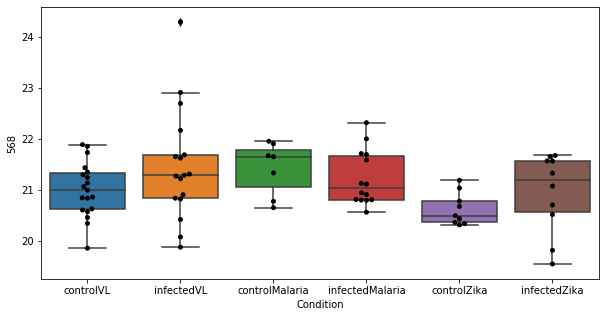

240 row m/z                806.569
row retention time     3.17983
p-val                 0.558478
adj.P.Val             0.999793
custom_id                 3063
compound_names             NaN
Name: 3063, dtype: object


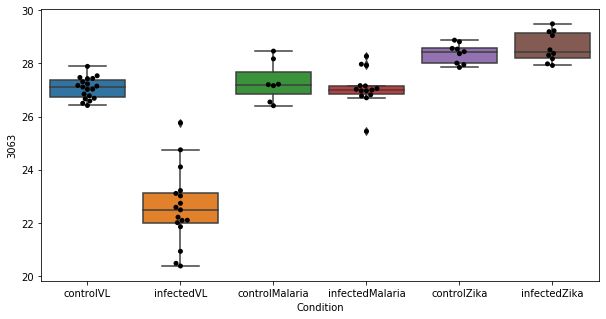

241 row m/z                                                        249.061
row retention time                                             9.95826
p-val                                                         0.559071
adj.P.Val                                                     0.999793
custom_id                                                         1987
compound_names        5-Acetylamino-6-formylamino-3-methyluracil; AFMU
Name: 1987, dtype: object


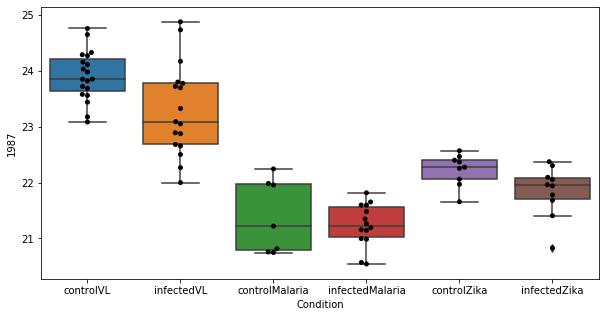

242 row m/z                329.174
row retention time     10.3999
p-val                 0.559448
adj.P.Val             0.999793
custom_id                 2506
compound_names             NaN
Name: 2506, dtype: object


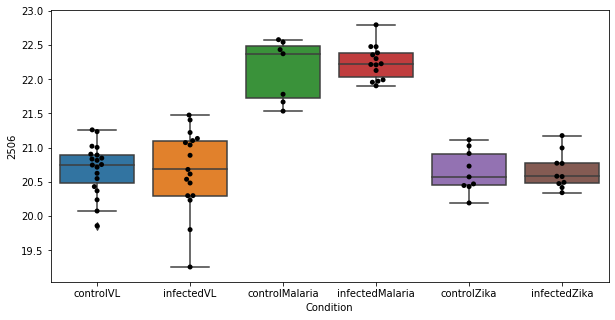

243 row m/z                790.622
row retention time     3.18252
p-val                 0.562162
adj.P.Val             0.999793
custom_id                 3036
compound_names             NaN
Name: 3036, dtype: object


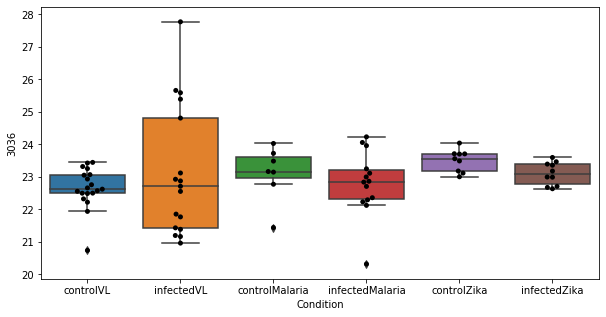

244 row m/z                            147.121
row retention time                 10.7328
p-val                             0.563068
adj.P.Val                         0.999793
custom_id                              698
compound_names        3-Dehydroxycarnitine
Name: 698, dtype: object


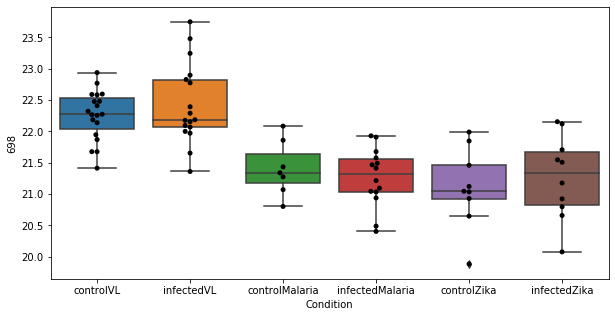

245 row m/z                154.072
row retention time     9.03698
p-val                 0.563375
adj.P.Val             0.999793
custom_id                  795
compound_names             NaN
Name: 795, dtype: object


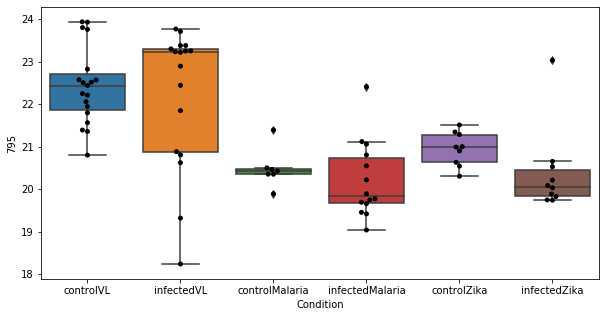

246 row m/z                                                          343.19
row retention time                                              9.29234
p-val                                                          0.565838
adj.P.Val                                                      0.999793
custom_id                                                          2544
compound_names        Cortisone; 17alpha,21-Dihydroxy-4-pregnene-3,1...
Name: 2544, dtype: object


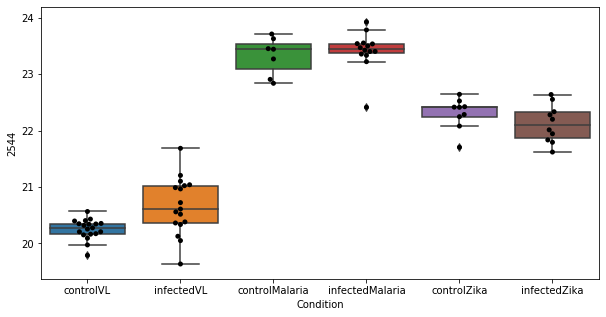

247 row m/z                735.572
row retention time     3.22431
p-val                 0.568637
adj.P.Val             0.999793
custom_id                 2946
compound_names             NaN
Name: 2946, dtype: object


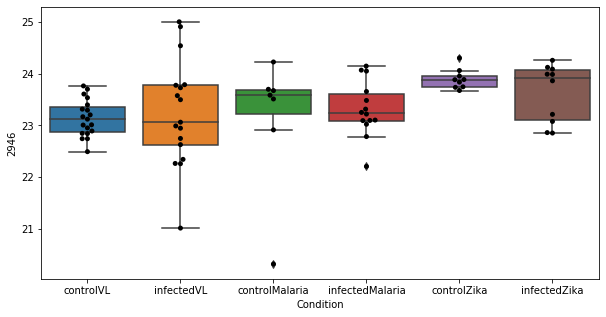

248 row m/z                164.116
row retention time     10.7397
p-val                 0.572741
adj.P.Val             0.999793
custom_id                  951
compound_names             NaN
Name: 951, dtype: object


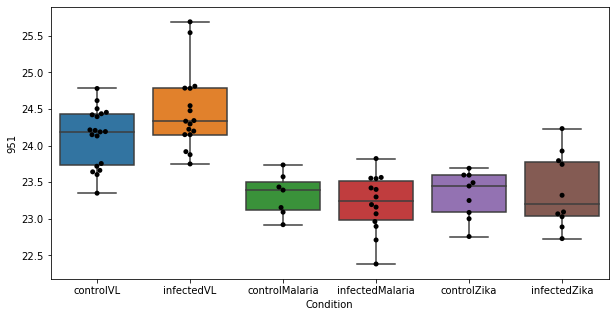

249 row m/z                 612.52
row retention time     2.99117
p-val                 0.573333
adj.P.Val             0.999793
custom_id                 2869
compound_names             NaN
Name: 2869, dtype: object


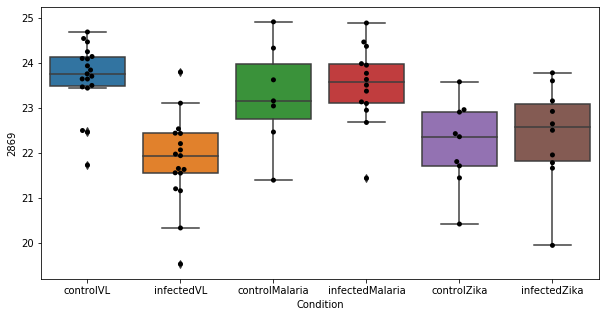

250 row m/z                                                         156.102
row retention time                                              4.37061
p-val                                                          0.573367
adj.P.Val                                                      0.999793
custom_id                                                          3479
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 3479, dtype: object


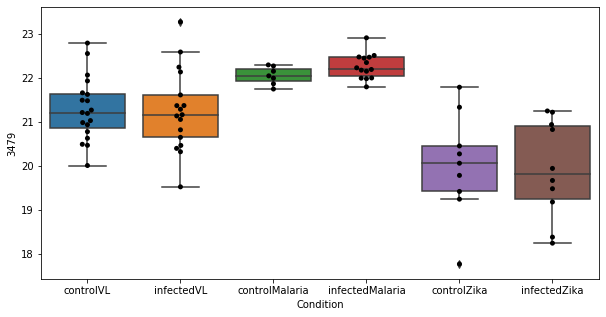

251 row m/z                211.133
row retention time     3.69812
p-val                 0.576311
adj.P.Val             0.999793
custom_id                 1563
compound_names             NaN
Name: 1563, dtype: object


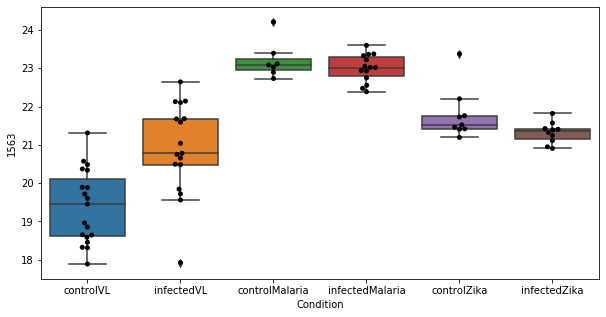

252 row m/z                173.117
row retention time     4.25529
p-val                 0.577178
adj.P.Val             0.999793
custom_id                 3578
compound_names             NaN
Name: 3578, dtype: object


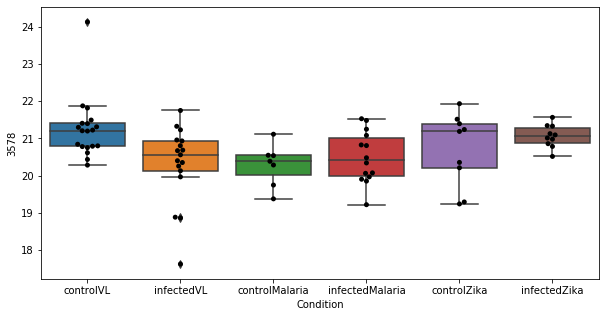

253 row m/z                                                         147.076
row retention time                                              10.1063
p-val                                                          0.577713
adj.P.Val                                                      0.999793
custom_id                                                           692
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 692, dtype: object


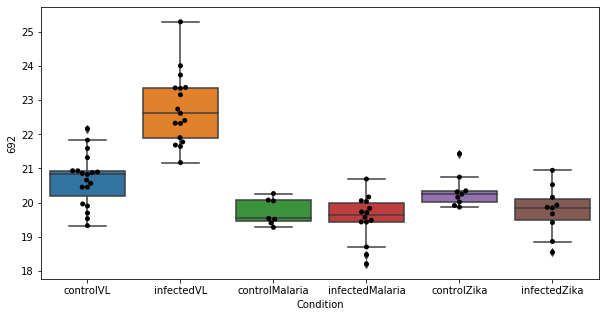

254 row m/z                786.657
row retention time     3.30119
p-val                 0.577727
adj.P.Val             0.999793
custom_id                 3023
compound_names             NaN
Name: 3023, dtype: object


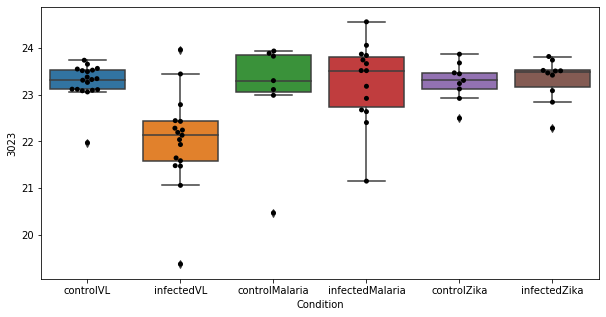

255 row m/z                                                         114.055
row retention time                                              9.62583
p-val                                                          0.580047
adj.P.Val                                                      0.999793
custom_id                                                           224
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 224, dtype: object


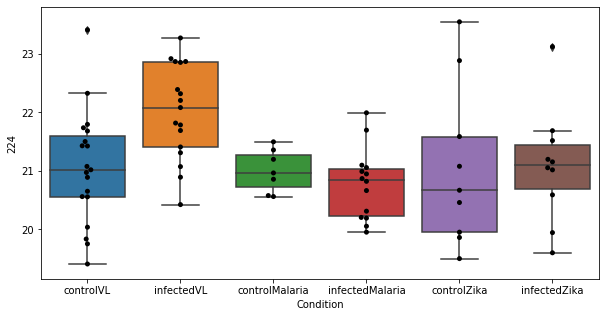

256 row m/z                150.113
row retention time     8.21405
p-val                 0.580438
adj.P.Val             0.999793
custom_id                  750
compound_names             NaN
Name: 750, dtype: object


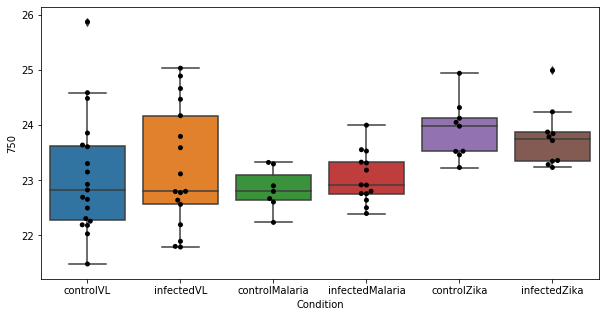

257 row m/z                756.553
row retention time     3.23797
p-val                 0.583193
adj.P.Val             0.999793
custom_id                 2967
compound_names             NaN
Name: 2967, dtype: object


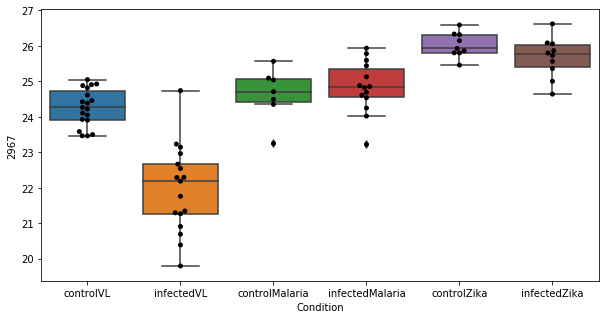

258 row m/z                782.569
row retention time     3.20424
p-val                 0.586946
adj.P.Val             0.999793
custom_id                 3009
compound_names             NaN
Name: 3009, dtype: object


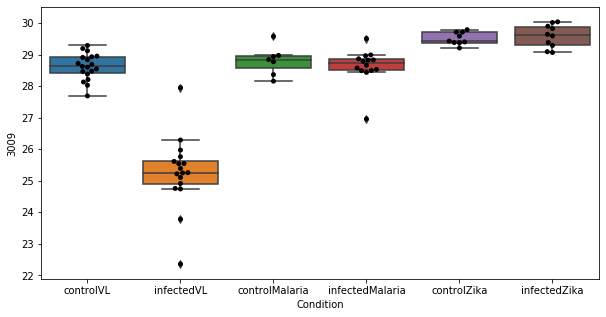

259 row m/z                809.588
row retention time     3.18517
p-val                 0.587036
adj.P.Val             0.999793
custom_id                 3070
compound_names             NaN
Name: 3070, dtype: object


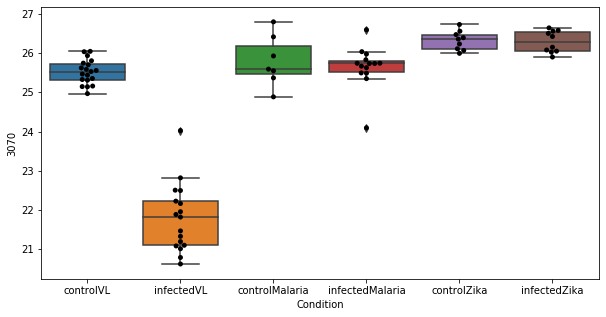

260 row m/z                182.139
row retention time     4.27109
p-val                 0.588605
adj.P.Val             0.999793
custom_id                 1185
compound_names             NaN
Name: 1185, dtype: object


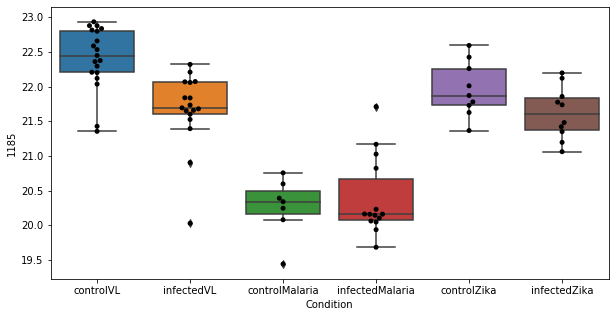

261 row m/z                546.355
row retention time     3.69144
p-val                 0.589183
adj.P.Val             0.999793
custom_id                 2817
compound_names             NaN
Name: 2817, dtype: object


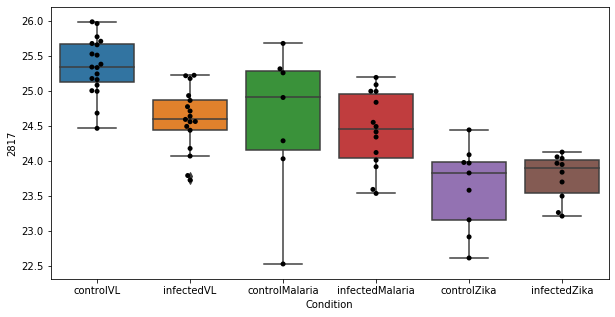

262 row m/z                119.016
row retention time     10.0976
p-val                 0.589368
adj.P.Val             0.999793
custom_id                  293
compound_names             NaN
Name: 293, dtype: object


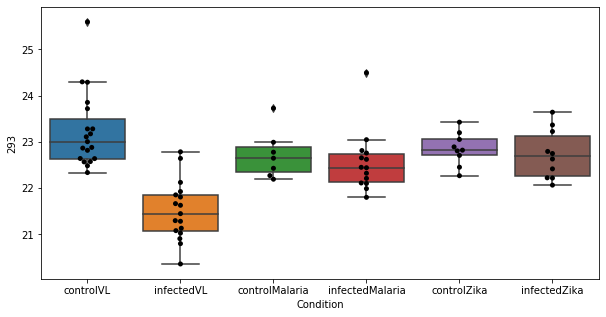

263 row m/z                 904.59
row retention time     2.99672
p-val                 0.590415
adj.P.Val             0.999793
custom_id                 3197
compound_names             NaN
Name: 3197, dtype: object


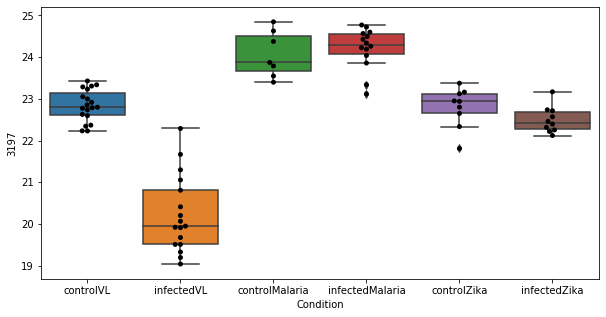

264 row m/z                200.027
row retention time     10.5774
p-val                 0.590514
adj.P.Val             0.999793
custom_id                 1416
compound_names             NaN
Name: 1416, dtype: object


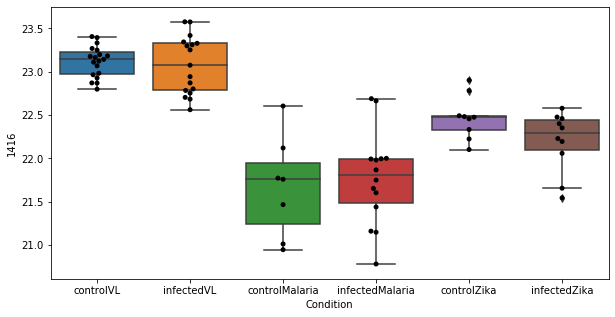

265 row m/z                316.248
row retention time     6.70854
p-val                 0.590764
adj.P.Val             0.999793
custom_id                 2465
compound_names             NaN
Name: 2465, dtype: object


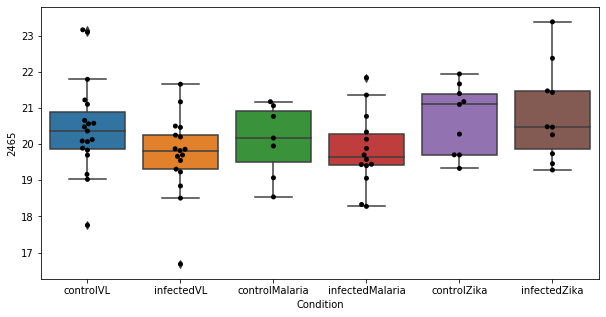

266 row m/z                                                         281.247
row retention time                                              3.01221
p-val                                                          0.591462
adj.P.Val                                                      0.999793
custom_id                                                          2259
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2259, dtype: object


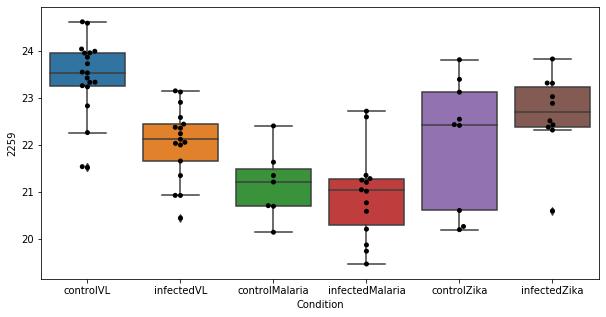

267 row m/z                781.556
row retention time     3.22257
p-val                 0.591482
adj.P.Val             0.999793
custom_id                 3007
compound_names             NaN
Name: 3007, dtype: object


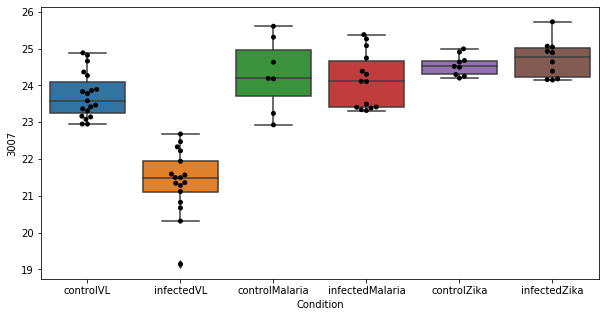

268 row m/z                239.128
row retention time     3.59802
p-val                 0.592008
adj.P.Val             0.999793
custom_id                 1894
compound_names             NaN
Name: 1894, dtype: object


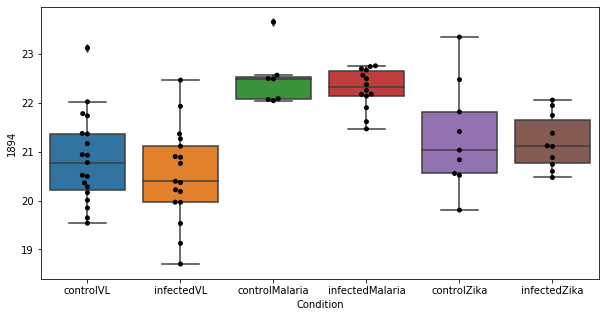

269 row m/z                                                         146.092
row retention time                                              11.9397
p-val                                                          0.593922
adj.P.Val                                                      0.999793
custom_id                                                           671
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 671, dtype: object


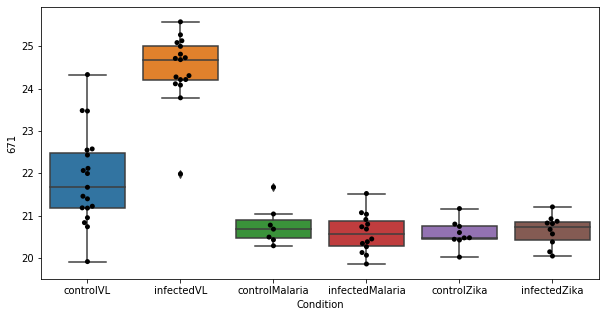

270 row m/z                156.138
row retention time     4.38882
p-val                  0.59543
adj.P.Val             0.999793
custom_id                  830
compound_names             NaN
Name: 830, dtype: object


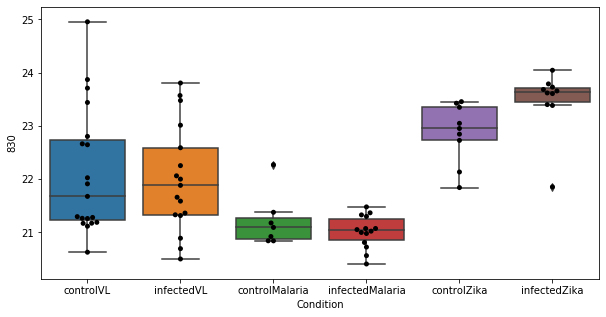

271 row m/z                332.331
row retention time     6.71606
p-val                 0.598004
adj.P.Val             0.999793
custom_id                 2515
compound_names             NaN
Name: 2515, dtype: object


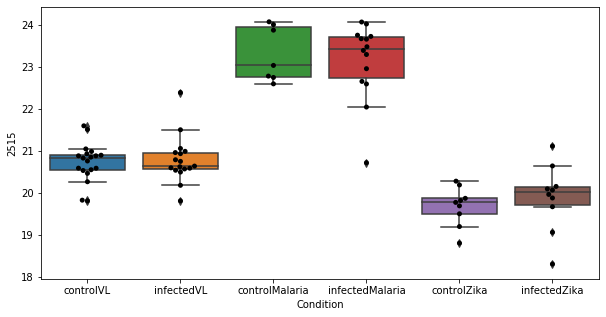

272 row m/z                185.117
row retention time     4.38696
p-val                 0.600151
adj.P.Val             0.999793
custom_id                 1224
compound_names             NaN
Name: 1224, dtype: object


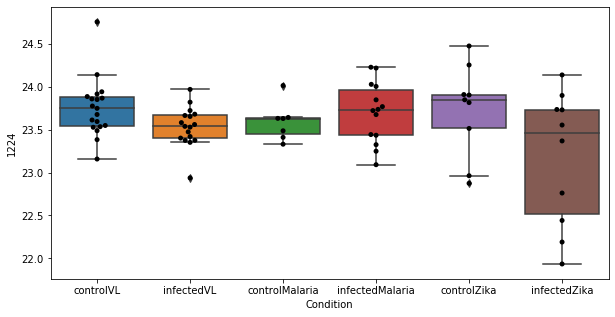

273 row m/z                246.133
row retention time     6.71118
p-val                 0.600461
adj.P.Val             0.999793
custom_id                 1961
compound_names             NaN
Name: 1961, dtype: object


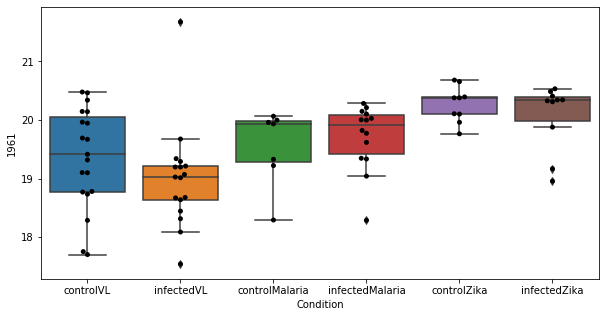

274 row m/z                242.284
row retention time     6.71102
p-val                 0.601169
adj.P.Val             0.999793
custom_id                 1921
compound_names             NaN
Name: 1921, dtype: object


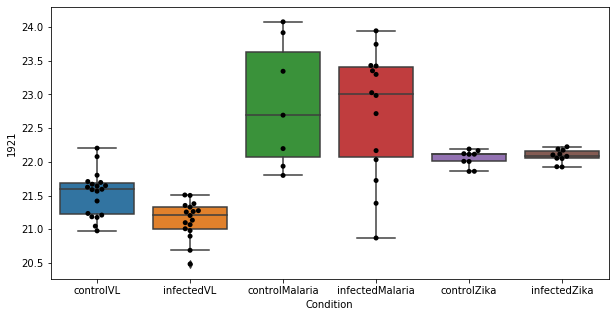

275 row m/z                                                         120.066
row retention time                                              11.6047
p-val                                                          0.603375
adj.P.Val                                                      0.999793
custom_id                                                           301
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 301, dtype: object


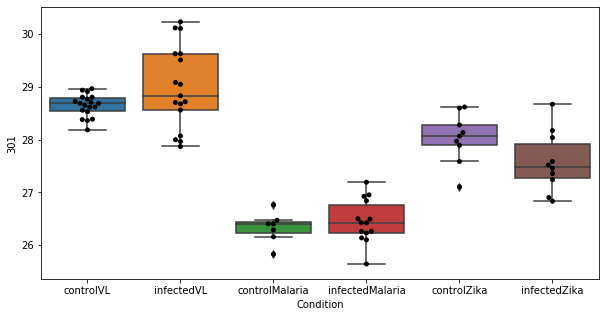

276 row m/z                                                       129.102
row retention time                                            10.1401
p-val                                                        0.603578
adj.P.Val                                                    0.999793
custom_id                                                         397
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 397, dtype: object


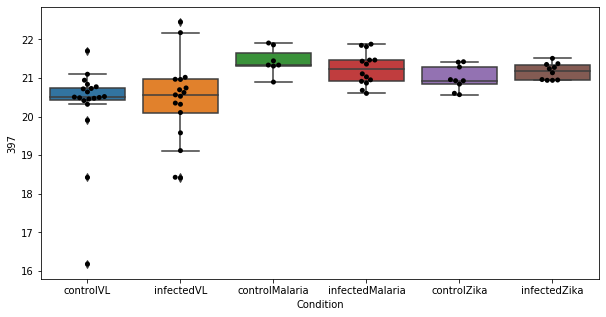

277 row m/z                                                         154.069
row retention time                                              6.76427
p-val                                                          0.604288
adj.P.Val                                                      0.999793
custom_id                                                           794
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 794, dtype: object


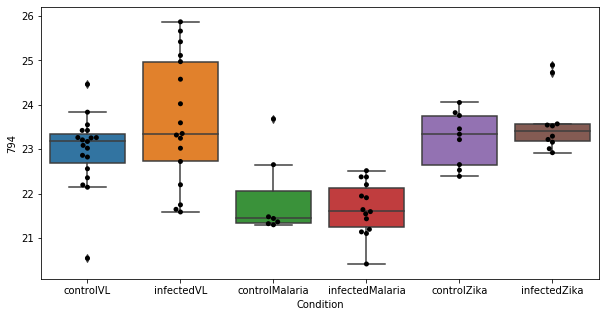

278 row m/z                836.614
row retention time     3.15613
p-val                 0.604317
adj.P.Val             0.999793
custom_id                 3118
compound_names             NaN
Name: 3118, dtype: object


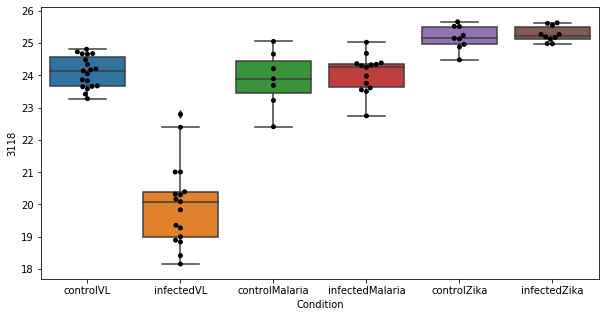

279 row m/z                272.185
row retention time     6.70999
p-val                 0.604751
adj.P.Val             0.999793
custom_id                 2186
compound_names             NaN
Name: 2186, dtype: object


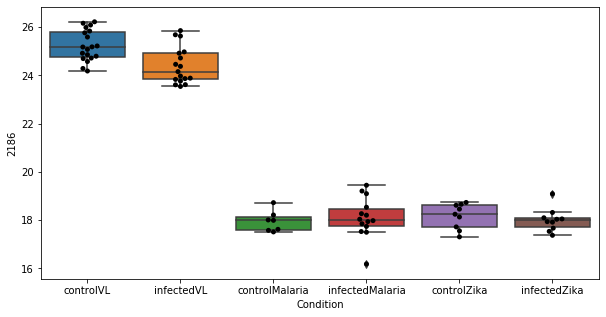

280 row m/z                114.034
row retention time     8.58987
p-val                 0.605021
adj.P.Val             0.999793
custom_id                  223
compound_names             NaN
Name: 223, dtype: object


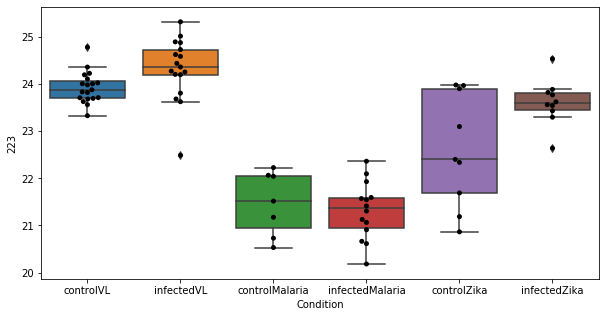

281 row m/z                      170.118
row retention time           6.71232
p-val                       0.606642
adj.P.Val                   0.999793
custom_id                       1034
compound_names        L-Metanephrine
Name: 1034, dtype: object


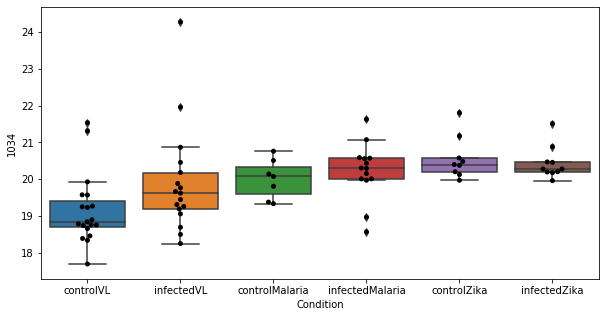

282 row m/z                158.118
row retention time     4.39119
p-val                 0.608341
adj.P.Val             0.999793
custom_id                  863
compound_names             NaN
Name: 863, dtype: object


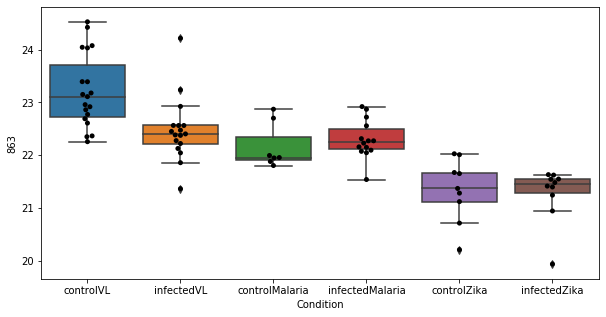

283 row m/z                                                         133.105
row retention time                                              9.28401
p-val                                                          0.609427
adj.P.Val                                                      0.999793
custom_id                                                           489
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 489, dtype: object


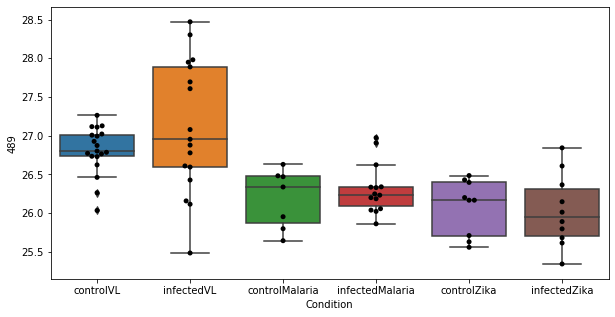

284 row m/z                125.096
row retention time     4.37678
p-val                 0.611708
adj.P.Val             0.999793
custom_id                  365
compound_names             NaN
Name: 365, dtype: object


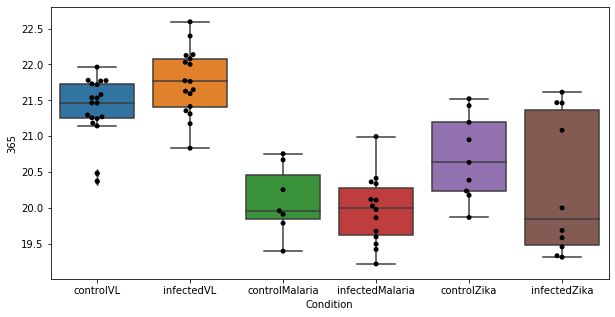

285 row m/z                                                         266.121
row retention time                                              6.71218
p-val                                                          0.612779
adj.P.Val                                                      0.999793
custom_id                                                          2144
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2144, dtype: object


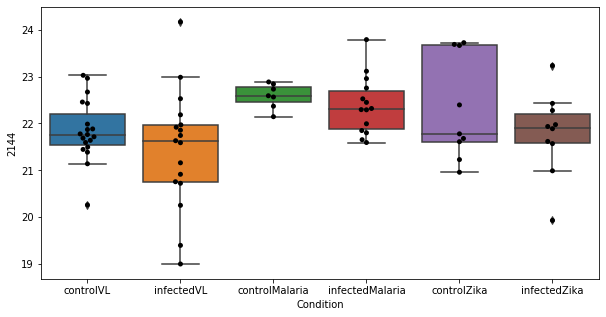

286 row m/z                                                         132.102
row retention time                                              9.28268
p-val                                                          0.615776
adj.P.Val                                                      0.999793
custom_id                                                           462
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 462, dtype: object


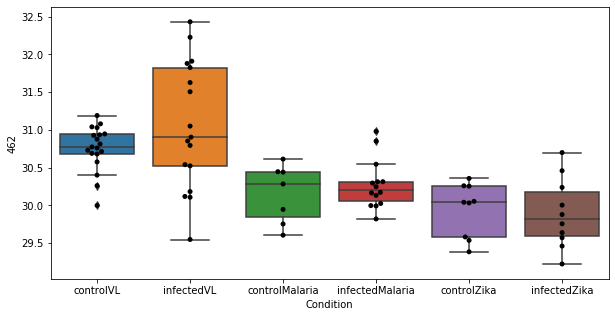

287 row m/z                                                         129.066
row retention time                                              11.7393
p-val                                                          0.616066
adj.P.Val                                                      0.999793
custom_id                                                           390
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 390, dtype: object


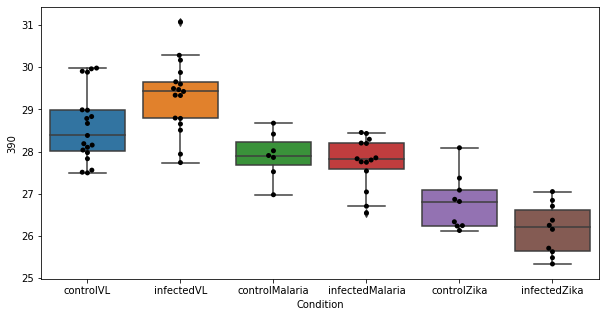

288 row m/z                                                        136.043
row retention time                                             10.0993
p-val                                                         0.617793
adj.P.Val                                                     0.999793
custom_id                                                          515
compound_names        L-Homocysteine; L-2-Amino-4-mercaptobutyric acid
Name: 515, dtype: object


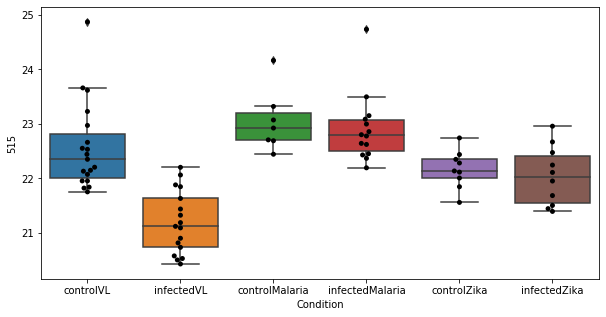

289 row m/z                742.574
row retention time     3.21016
p-val                 0.618038
adj.P.Val             0.999793
custom_id                 2951
compound_names             NaN
Name: 2951, dtype: object


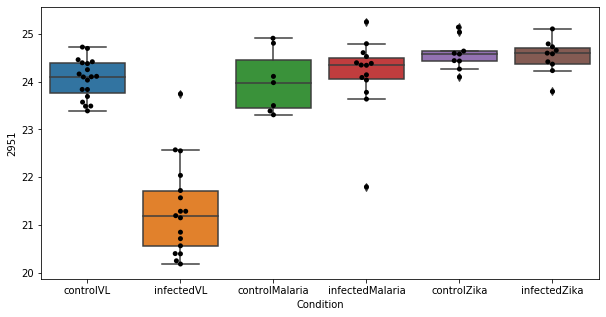

290 row m/z                758.569
row retention time     3.21358
p-val                 0.618484
adj.P.Val             0.999793
custom_id                 2970
compound_names             NaN
Name: 2970, dtype: object


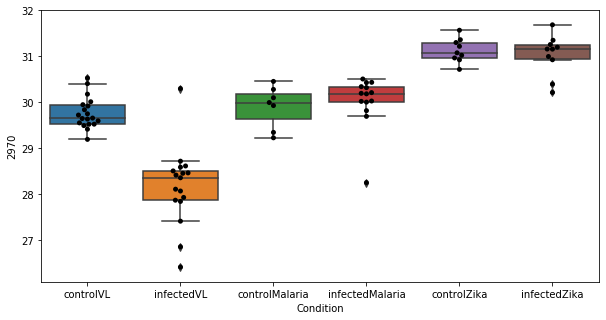

291 row m/z                191.164
row retention time     3.60632
p-val                 0.620303
adj.P.Val             0.999793
custom_id                 1311
compound_names             NaN
Name: 1311, dtype: object


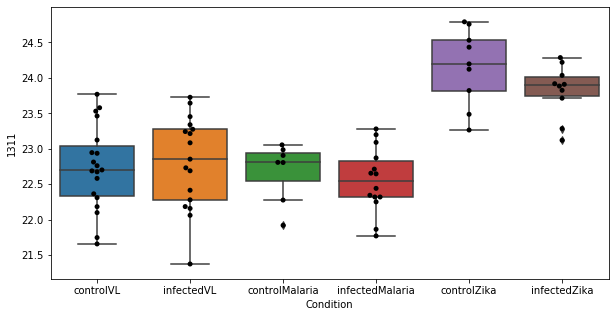

292 row m/z                627.535
row retention time     3.00661
p-val                 0.621582
adj.P.Val             0.999793
custom_id                 2879
compound_names             NaN
Name: 2879, dtype: object


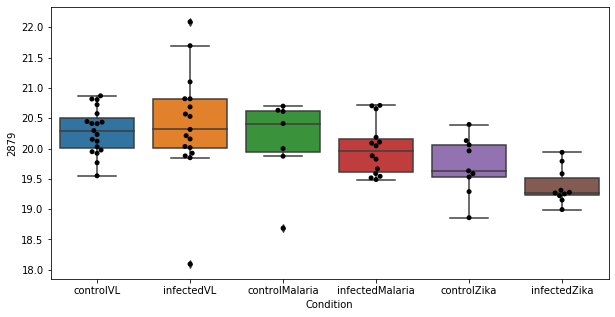

293 row m/z                734.569
row retention time     3.22582
p-val                 0.621834
adj.P.Val             0.999793
custom_id                 2945
compound_names             NaN
Name: 2945, dtype: object


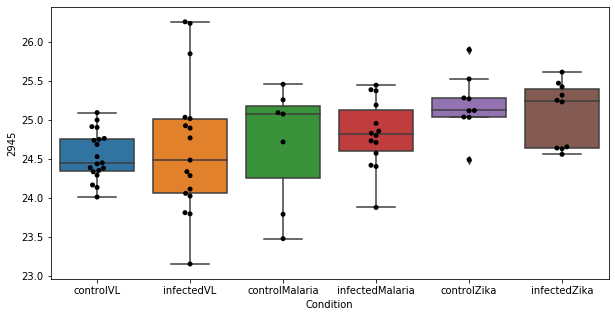

294 row m/z                594.509
row retention time     2.97821
p-val                  0.62575
adj.P.Val             0.999793
custom_id                 2854
compound_names             NaN
Name: 2854, dtype: object


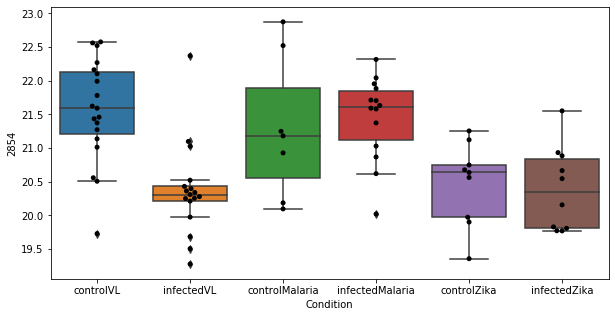

295 row m/z                           219.142
row retention time                8.41412
p-val                            0.627989
adj.P.Val                        0.999793
custom_id                            1686
compound_names        propionyl-carnitine
Name: 1686, dtype: object


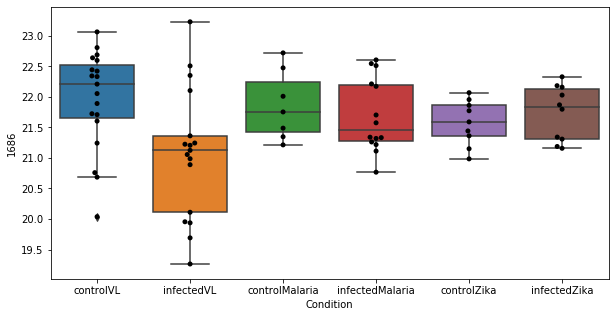

296 row m/z                 729.59
row retention time     3.38676
p-val                 0.628334
adj.P.Val             0.999793
custom_id                 2930
compound_names             NaN
Name: 2930, dtype: object


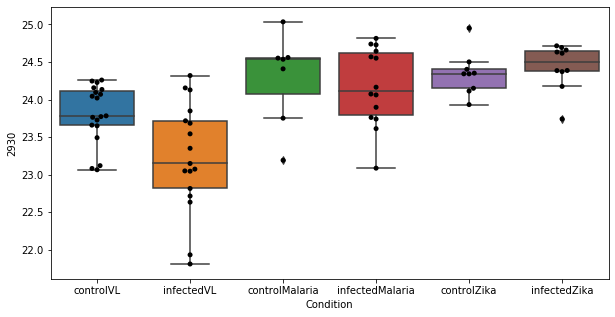

297 row m/z                218.211
row retention time     6.69938
p-val                 0.628683
adj.P.Val             0.999793
custom_id                 1669
compound_names             NaN
Name: 1669, dtype: object


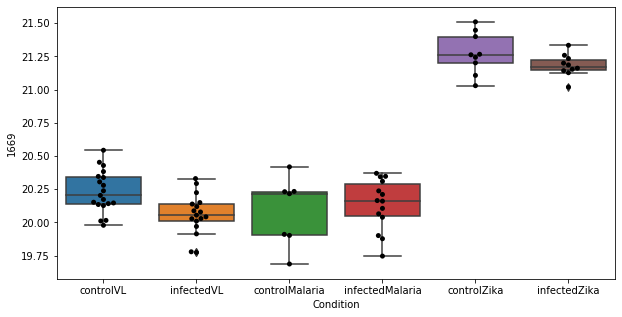

298 row m/z                                                         104.053
row retention time                                              9.80155
p-val                                                          0.630244
adj.P.Val                                                      0.999793
custom_id                                                           137
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 137, dtype: object


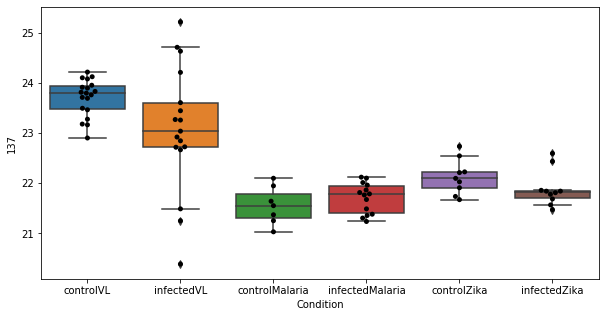

299 row m/z                 216.16
row retention time      4.3132
p-val                 0.630535
adj.P.Val             0.999793
custom_id                 1638
compound_names             NaN
Name: 1638, dtype: object


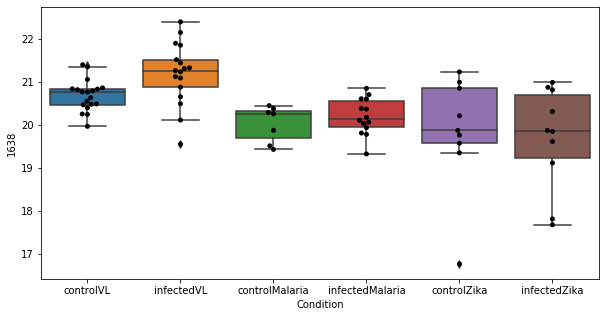

300 row m/z                181.163
row retention time     3.80665
p-val                 0.631906
adj.P.Val             0.999793
custom_id                 1177
compound_names             NaN
Name: 1177, dtype: object


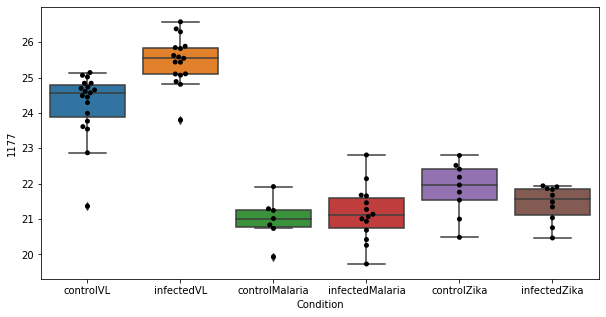

301 row m/z                743.577
row retention time     3.20198
p-val                 0.633272
adj.P.Val             0.999793
custom_id                 2952
compound_names             NaN
Name: 2952, dtype: object


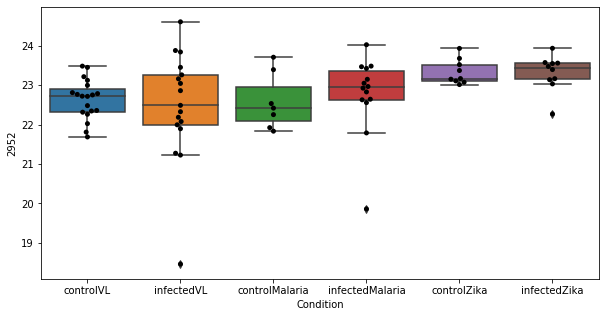

302 row m/z                808.583
row retention time     3.16917
p-val                 0.633403
adj.P.Val             0.999793
custom_id                 3068
compound_names             NaN
Name: 3068, dtype: object


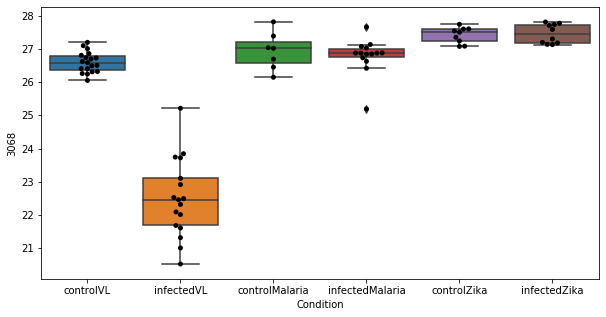

303 row m/z                521.343
row retention time     3.78543
p-val                 0.636431
adj.P.Val             0.999793
custom_id                 2791
compound_names             NaN
Name: 2791, dtype: object


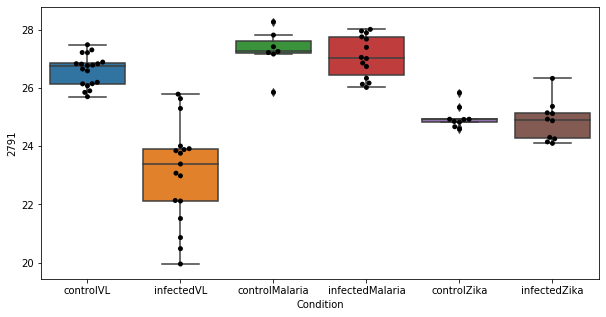

304 row m/z                558.473
row retention time     3.04166
p-val                 0.636667
adj.P.Val             0.999793
custom_id                 2826
compound_names             NaN
Name: 2826, dtype: object


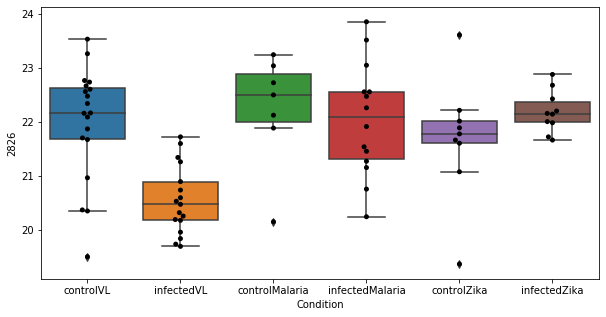

305 row m/z                783.572
row retention time     3.20447
p-val                 0.644611
adj.P.Val             0.999793
custom_id                 3010
compound_names             NaN
Name: 3010, dtype: object


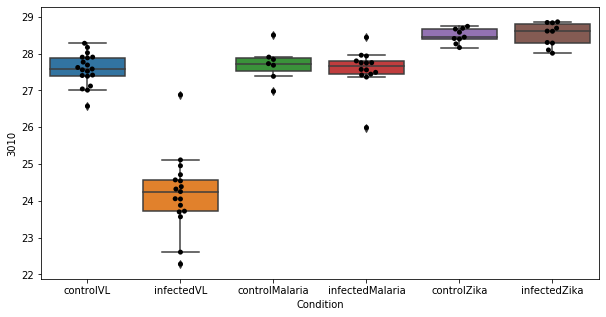

306 row m/z                                                         130.086
row retention time                                              6.71466
p-val                                                          0.645824
adj.P.Val                                                      0.999793
custom_id                                                           424
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 424, dtype: object


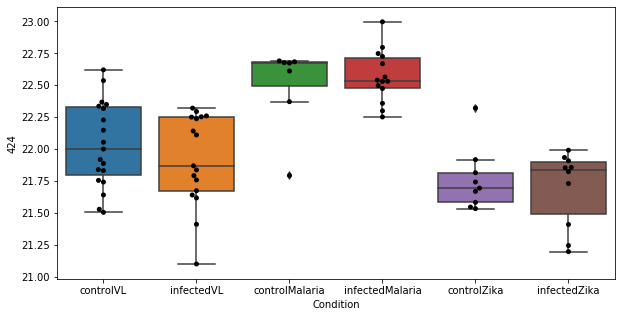

307 row m/z                469.389
row retention time     3.15979
p-val                 0.646817
adj.P.Val             0.999793
custom_id                 2744
compound_names             NaN
Name: 2744, dtype: object


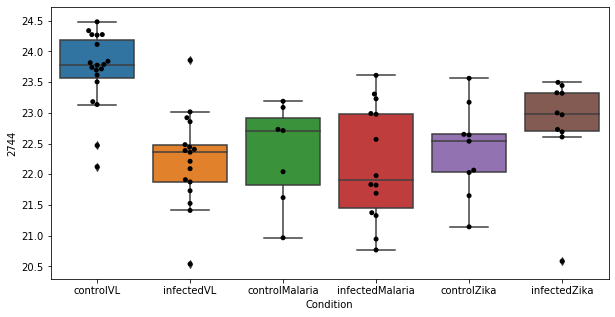

308 row m/z                                                         183.102
row retention time                                              6.70204
p-val                                                          0.649783
adj.P.Val                                                      0.999793
custom_id                                                          1192
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1192, dtype: object


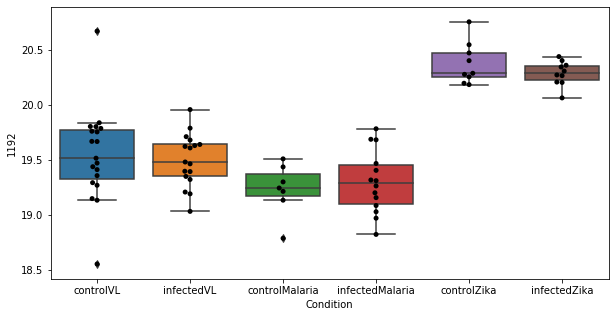

309 row m/z                796.619
row retention time     3.17773
p-val                 0.652228
adj.P.Val             0.999793
custom_id                 3045
compound_names             NaN
Name: 3045, dtype: object


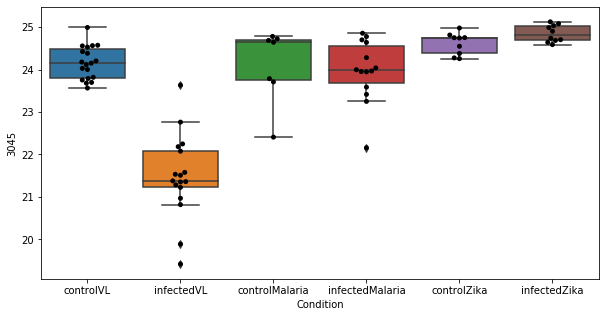

310 row m/z                 520.34
row retention time      3.7647
p-val                  0.65255
adj.P.Val             0.999793
custom_id                 2789
compound_names             NaN
Name: 2789, dtype: object


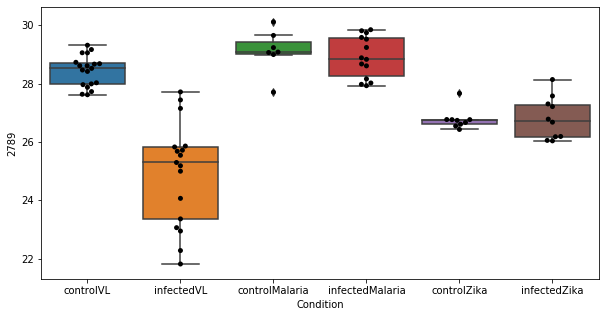

311 row m/z                194.092
row retention time     6.79009
p-val                 0.652552
adj.P.Val             0.999793
custom_id                 1351
compound_names             NaN
Name: 1351, dtype: object


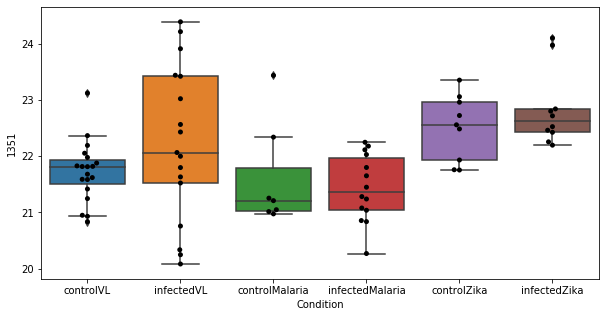

312 row m/z                766.574
row retention time     3.19285
p-val                 0.653705
adj.P.Val             0.999793
custom_id                 2983
compound_names             NaN
Name: 2983, dtype: object


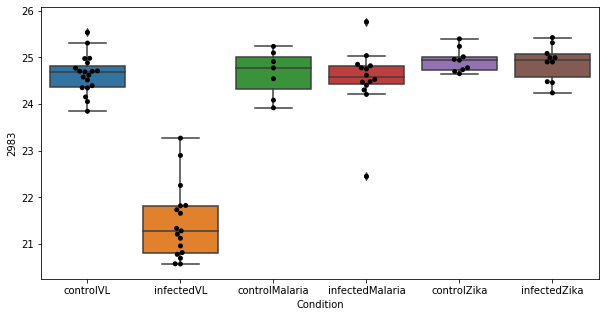

313 row m/z                102.066
row retention time     9.64807
p-val                 0.653936
adj.P.Val             0.999793
custom_id                  123
compound_names             NaN
Name: 123, dtype: object


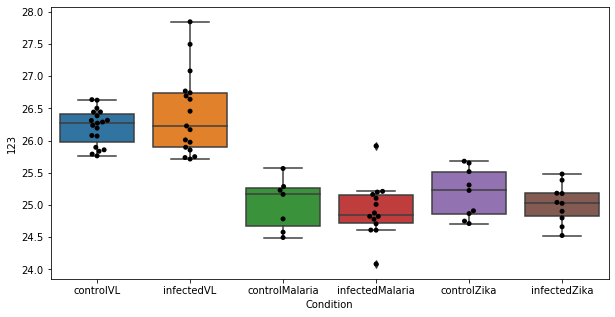

314 row m/z                                                         130.069
row retention time                                               11.738
p-val                                                          0.654603
adj.P.Val                                                      0.999793
custom_id                                                           420
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 420, dtype: object


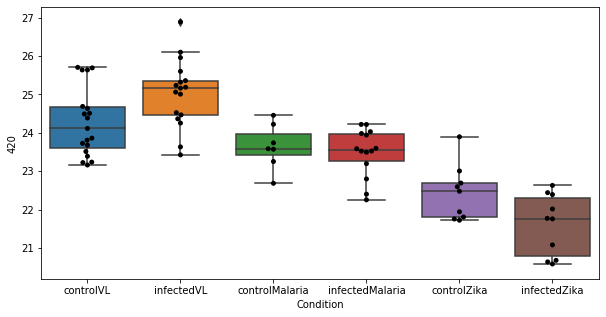

315 row m/z                788.612
row retention time     3.18832
p-val                 0.655123
adj.P.Val             0.999793
custom_id                 3028
compound_names             NaN
Name: 3028, dtype: object


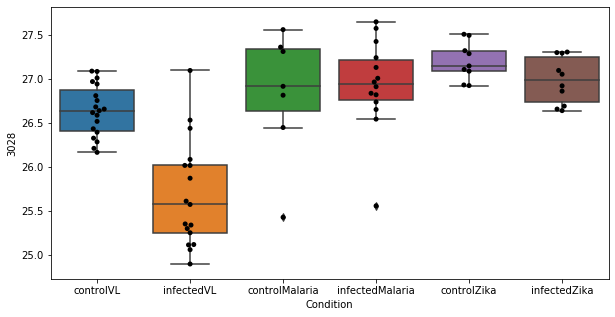

316 row m/z                                                         183.085
row retention time                                              10.8254
p-val                                                          0.657181
adj.P.Val                                                      0.999793
custom_id                                                          1190
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1190, dtype: object


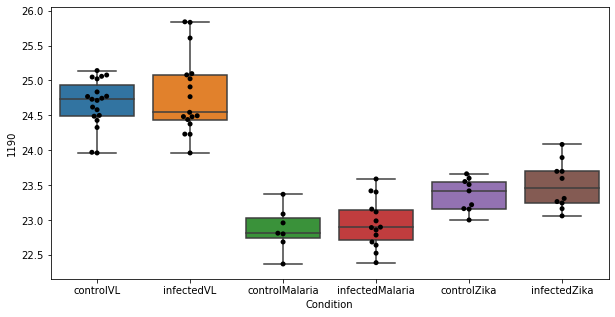

317 row m/z                144.102
row retention time     10.3128
p-val                 0.658673
adj.P.Val             0.999793
custom_id                  635
compound_names             NaN
Name: 635, dtype: object


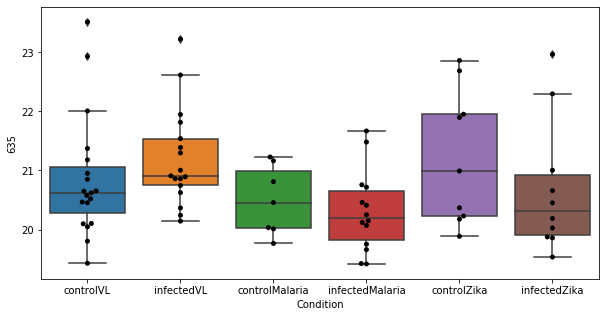

318 row m/z                                                         101.071
row retention time                                              11.9351
p-val                                                           0.66052
adj.P.Val                                                      0.999793
custom_id                                                           113
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 113, dtype: object


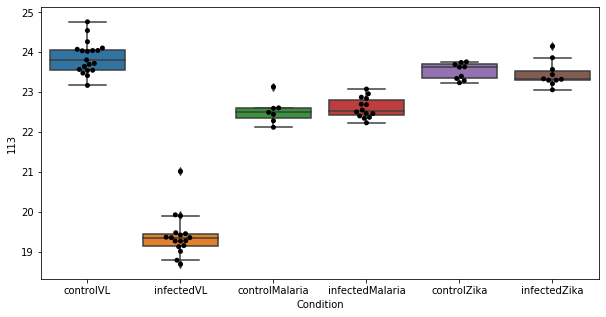

319 row m/z                542.323
row retention time     3.78322
p-val                 0.663391
adj.P.Val             0.999793
custom_id                 2814
compound_names             NaN
Name: 2814, dtype: object


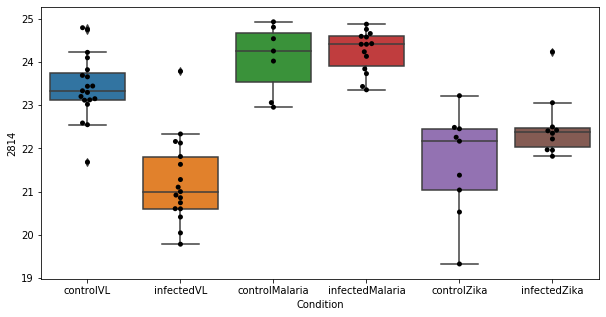

320 row m/z                 118.12
row retention time     10.4025
p-val                 0.663608
adj.P.Val             0.999793
custom_id                  286
compound_names             NaN
Name: 286, dtype: object


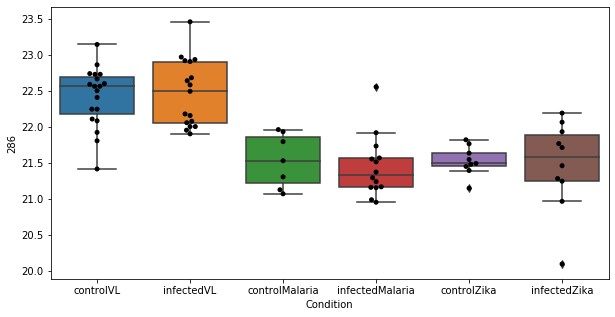

321 row m/z                                                          106.05
row retention time                                              12.4685
p-val                                                          0.664511
adj.P.Val                                                      0.999793
custom_id                                                           174
compound_names        L-Serine; L-2-Amino-3-hydroxypropionic acid; L...
Name: 174, dtype: object


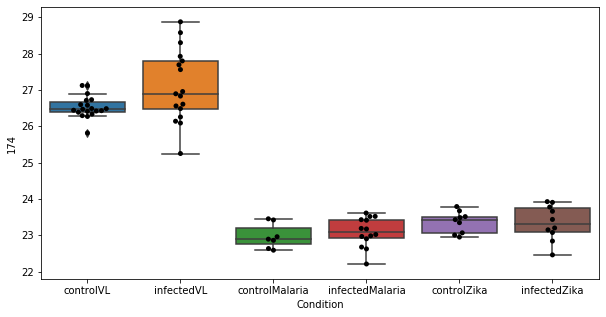

322 row m/z                759.572
row retention time     3.21587
p-val                 0.671665
adj.P.Val             0.999793
custom_id                 2971
compound_names             NaN
Name: 2971, dtype: object


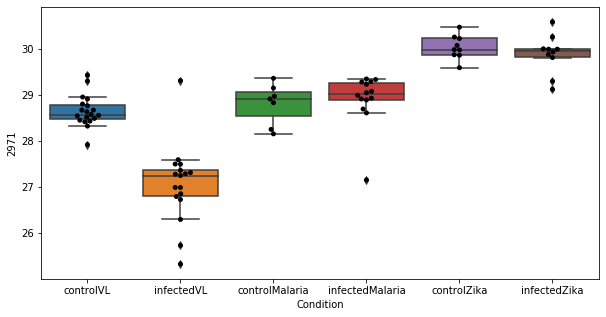

323 row m/z                      198.113
row retention time           4.38443
p-val                       0.673141
adj.P.Val                   0.999793
custom_id                       1396
compound_names        L-Metanephrine
Name: 1396, dtype: object


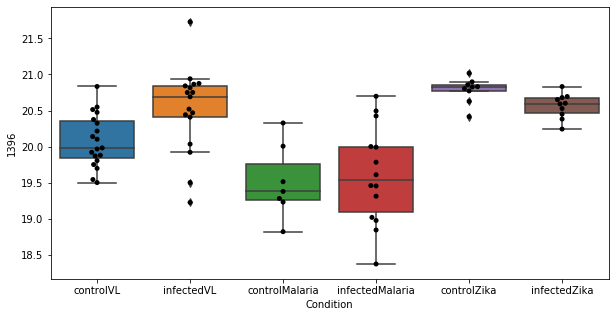

324 row m/z                213.123
row retention time      6.7136
p-val                 0.673277
adj.P.Val             0.999793
custom_id                 1592
compound_names             NaN
Name: 1592, dtype: object


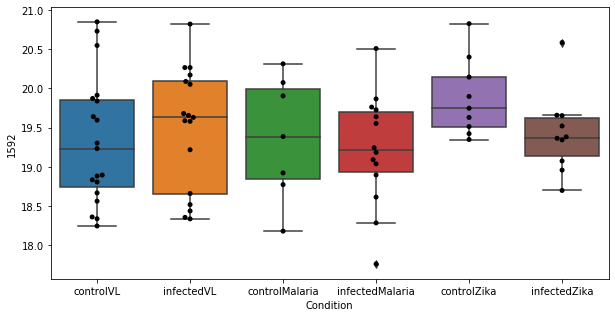

325 row m/z                168.123
row retention time     6.69643
p-val                 0.674176
adj.P.Val             0.999793
custom_id                 1005
compound_names             NaN
Name: 1005, dtype: object


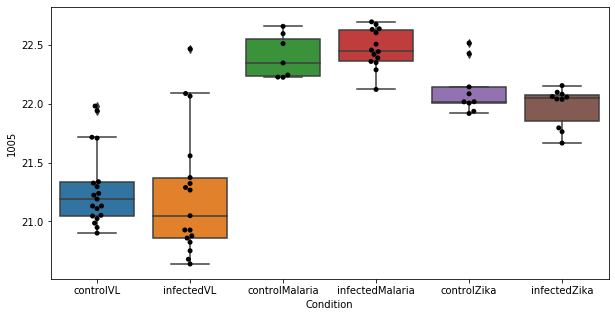

326 row m/z                                                         175.108
row retention time                                              10.8436
p-val                                                          0.675576
adj.P.Val                                                      0.999793
custom_id                                                          1108
compound_names        (+)-trans-Carveol; (4S,6R)-trans-Carveol$Peril...
Name: 1108, dtype: object


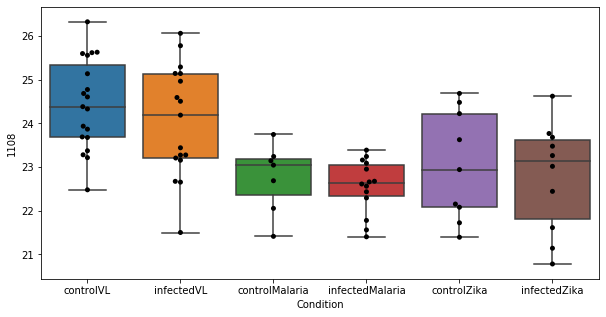

327 row m/z                272.185
row retention time     3.48876
p-val                 0.675943
adj.P.Val             0.999793
custom_id                 2185
compound_names             NaN
Name: 2185, dtype: object


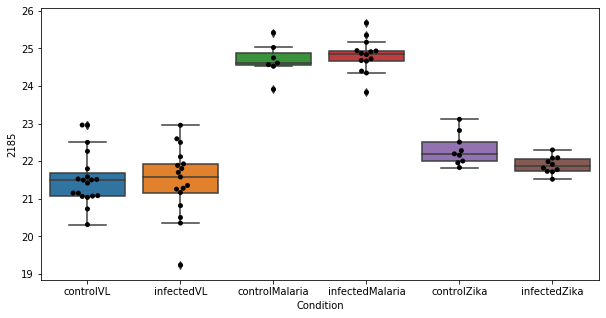

328 row m/z                243.948
row retention time     10.0775
p-val                 0.675991
adj.P.Val             0.999793
custom_id                 5027
compound_names             NaN
Name: 5027, dtype: object


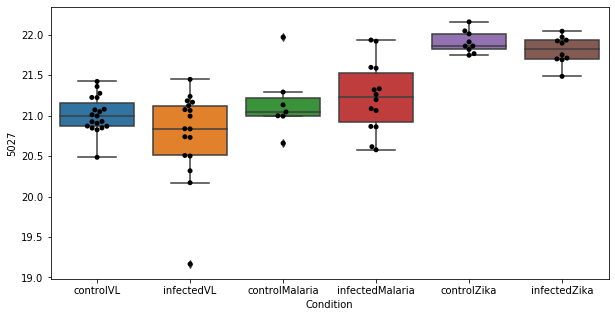

329 row m/z                                                        174.113
row retention time                                             6.71072
p-val                                                         0.676689
adj.P.Val                                                     0.999793
custom_id                                                         1090
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1090, dtype: object


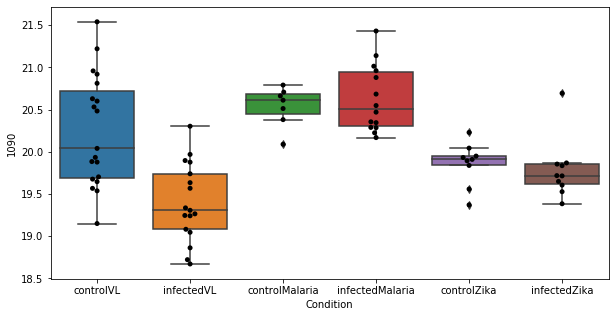

330 row m/z                173.129
row retention time     9.28048
p-val                 0.677529
adj.P.Val             0.999793
custom_id                 1080
compound_names             NaN
Name: 1080, dtype: object


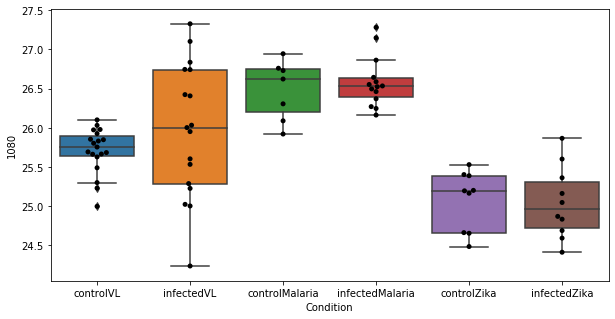

331 row m/z                689.559
row retention time      3.4459
p-val                  0.67864
adj.P.Val             0.999793
custom_id                 2910
compound_names             NaN
Name: 2910, dtype: object


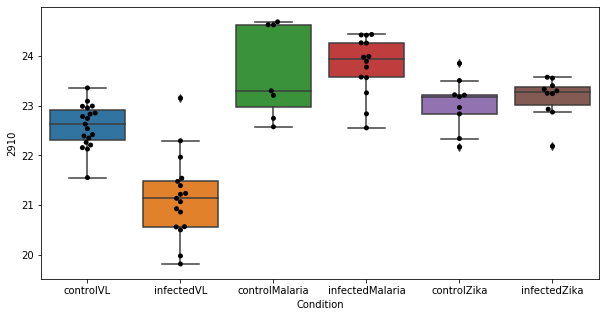

332 row m/z                619.491
row retention time     2.92792
p-val                 0.678722
adj.P.Val             0.999793
custom_id                 2876
compound_names             NaN
Name: 2876, dtype: object


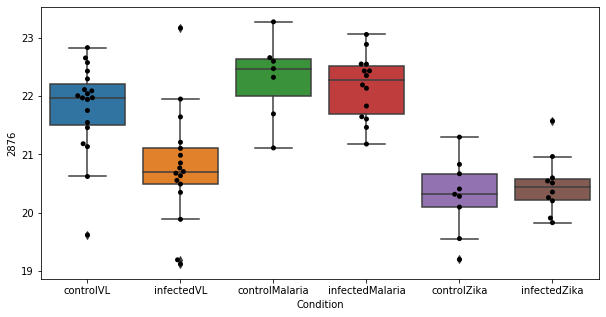

333 row m/z                                                         138.055
row retention time                                              9.88574
p-val                                                          0.681921
adj.P.Val                                                      0.999793
custom_id                                                           550
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 550, dtype: object


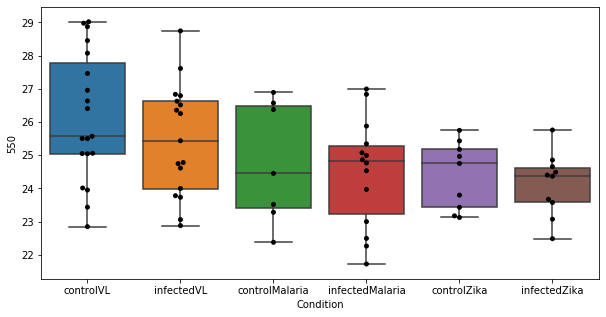

334 row m/z                217.107
row retention time     3.71855
p-val                 0.683018
adj.P.Val             0.999793
custom_id                 1648
compound_names             NaN
Name: 1648, dtype: object


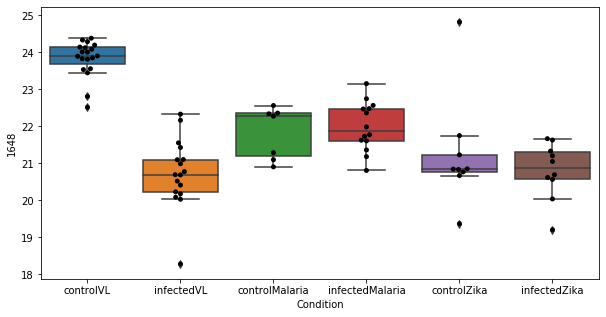

335 row m/z                261.121
row retention time     6.69969
p-val                 0.683835
adj.P.Val             0.999793
custom_id                 2108
compound_names             NaN
Name: 2108, dtype: object


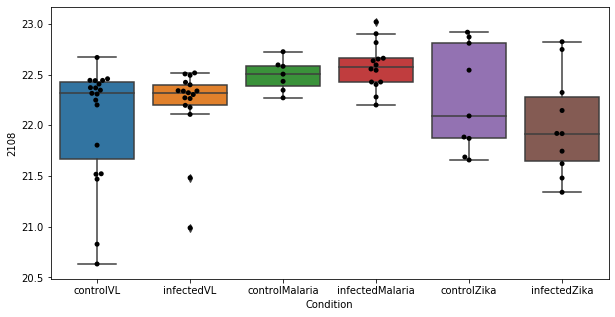

336 row m/z                148.097
row retention time     3.80394
p-val                 0.684369
adj.P.Val             0.999793
custom_id                  717
compound_names             NaN
Name: 717, dtype: object


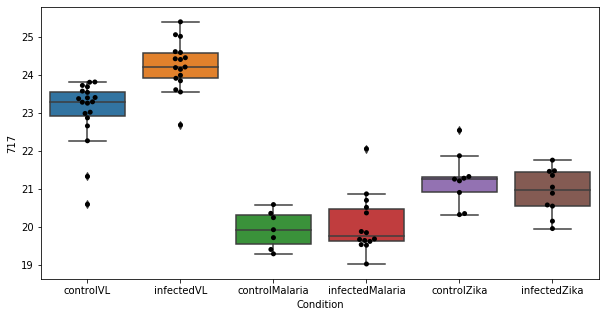

337 row m/z                794.605
row retention time     3.17332
p-val                 0.685348
adj.P.Val             0.999793
custom_id                 3040
compound_names             NaN
Name: 3040, dtype: object


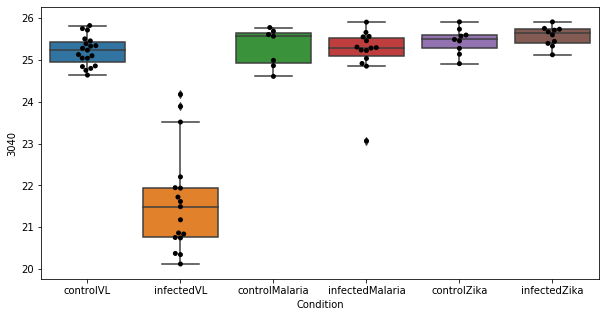

338 row m/z                                                         146.081
row retention time                                               10.355
p-val                                                          0.685444
adj.P.Val                                                      0.999793
custom_id                                                           668
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 668, dtype: object


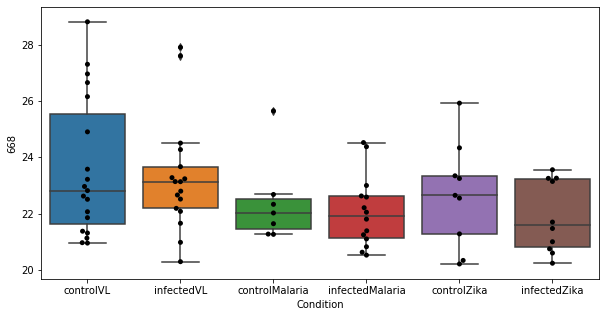

339 row m/z                                                         153.066
row retention time                                              6.75942
p-val                                                          0.687437
adj.P.Val                                                      0.999793
custom_id                                                           784
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 784, dtype: object


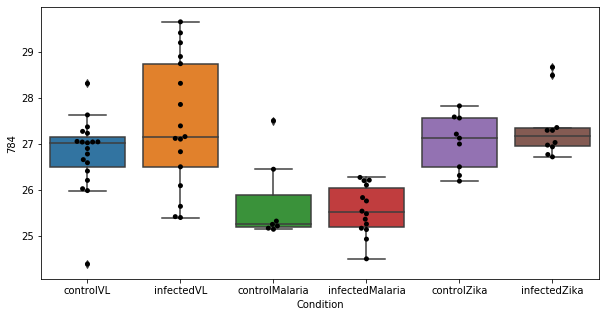

340 row m/z                                                         177.106
row retention time                                              12.4234
p-val                                                           0.68899
adj.P.Val                                                      0.999793
custom_id                                                          1134
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1134, dtype: object


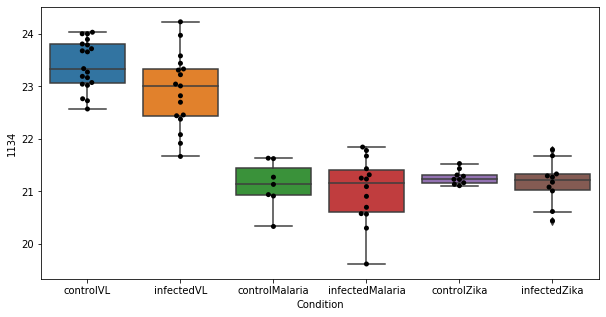

341 row m/z                                                         176.103
row retention time                                              12.4235
p-val                                                          0.690026
adj.P.Val                                                      0.999793
custom_id                                                          1122
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1122, dtype: object


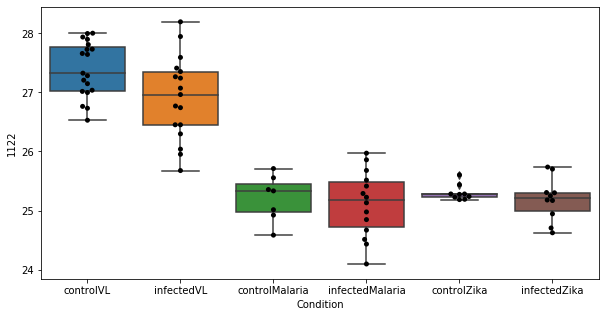

342 row m/z                                                         799.668
row retention time                                              3.29227
p-val                                                          0.691231
adj.P.Val                                                      0.999793
custom_id                                                          3052
compound_names        O-(4-Hydroxy-3,5-diidophenyl)-3,5-diiodo-L-tyr...
Name: 3052, dtype: object


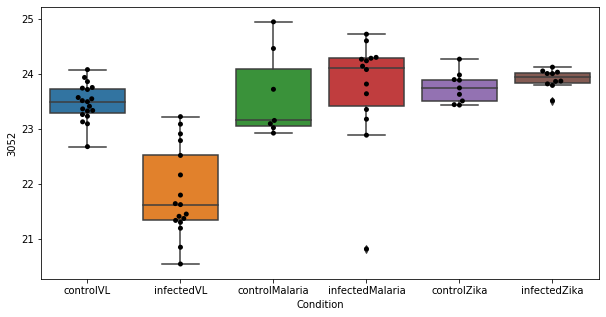

343 row m/z                                                         148.097
row retention time                                              6.83271
p-val                                                          0.691242
adj.P.Val                                                      0.999793
custom_id                                                           715
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 715, dtype: object


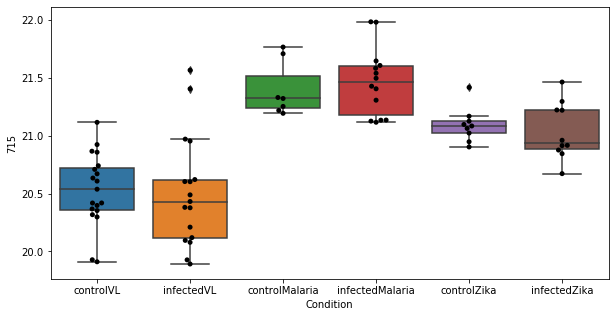

344 row m/z                                                         104.071
row retention time                                              10.2204
p-val                                                          0.692697
adj.P.Val                                                      0.999793
custom_id                                                           138
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 138, dtype: object


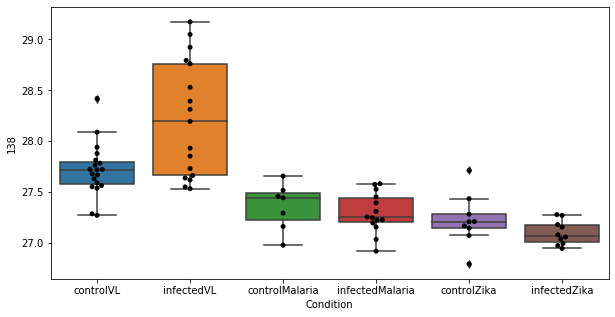

345 row m/z                                                         157.061
row retention time                                              9.81764
p-val                                                          0.696669
adj.P.Val                                                      0.999793
custom_id                                                           839
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 839, dtype: object


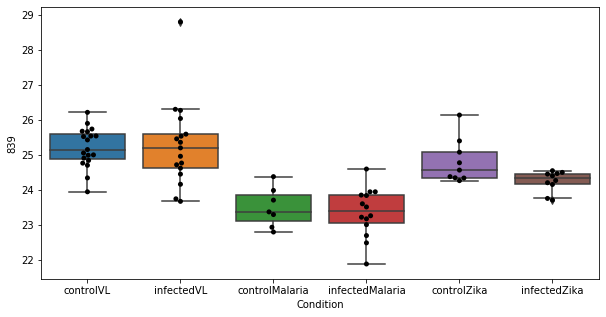

346 row m/z                                                          113.06
row retention time                                              3.46487
p-val                                                          0.696971
adj.P.Val                                                      0.999793
custom_id                                                           217
compound_names        Adipate semialdehyde; Hexan-1-one-6-carboxylat...
Name: 217, dtype: object


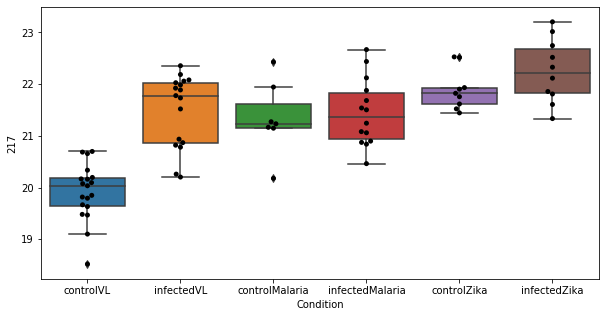

347 row m/z                                                         129.066
row retention time                                              10.9378
p-val                                                          0.697157
adj.P.Val                                                      0.999793
custom_id                                                          4517
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 4517, dtype: object


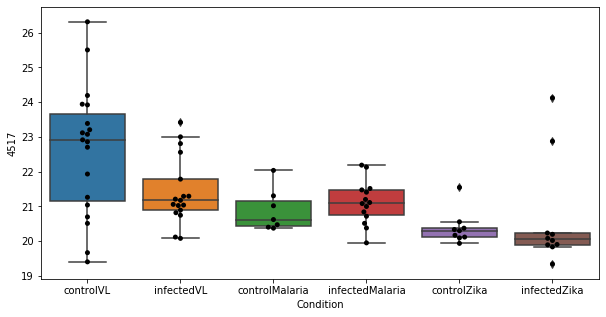

348 row m/z                170.062
row retention time     11.9025
p-val                 0.697651
adj.P.Val             0.999793
custom_id                 1029
compound_names             NaN
Name: 1029, dtype: object


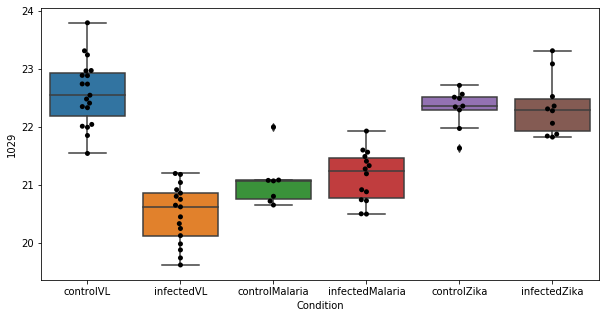

349 row m/z                                                         152.054
row retention time                                              9.80049
p-val                                                          0.701518
adj.P.Val                                                      0.999793
custom_id                                                           772
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 772, dtype: object


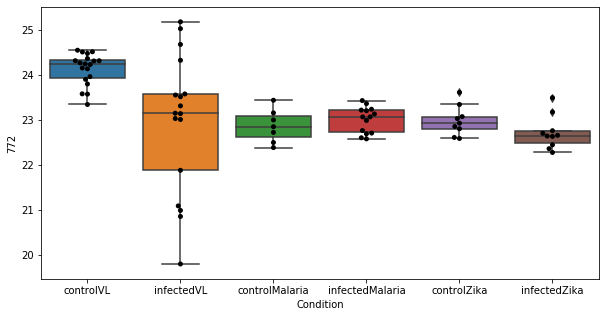

350 row m/z                176.066
row retention time     9.28789
p-val                 0.703608
adj.P.Val             0.999793
custom_id                 1117
compound_names             NaN
Name: 1117, dtype: object


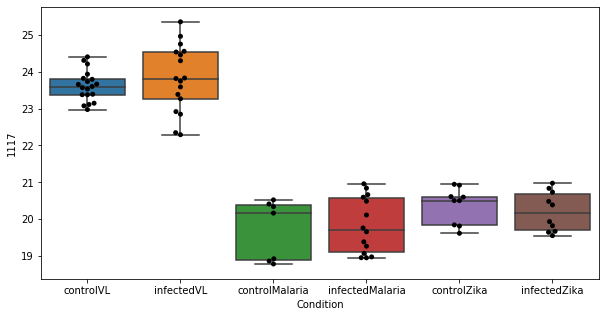

351 row m/z                                                         154.059
row retention time                                              11.7134
p-val                                                          0.704888
adj.P.Val                                                      0.999793
custom_id                                                           792
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 792, dtype: object


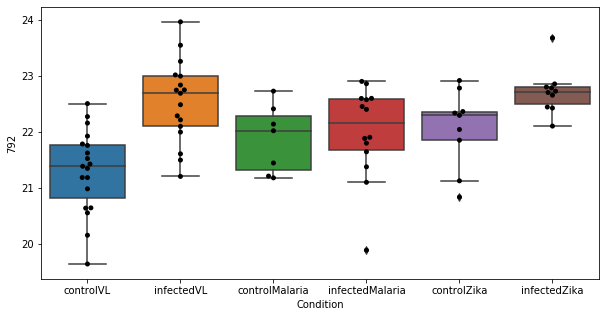

352 row m/z                            107.07
row retention time                3.80811
p-val                            0.705454
adj.P.Val                        0.999793
custom_id                             182
compound_names        1-Methylpyrrolinium
Name: 182, dtype: object


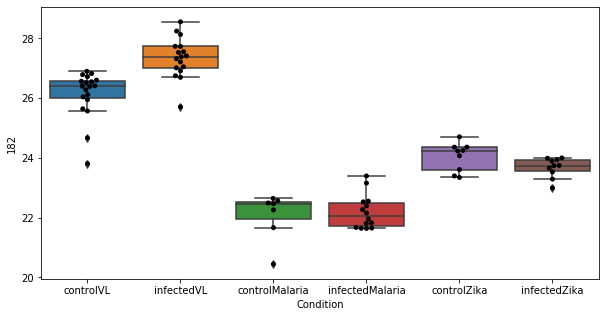

353 row m/z                                 151.062
row retention time                      9.79946
p-val                                  0.706765
adj.P.Val                              0.999793
custom_id                                   760
compound_names        aminochrome o-semiquinone
Name: 760, dtype: object


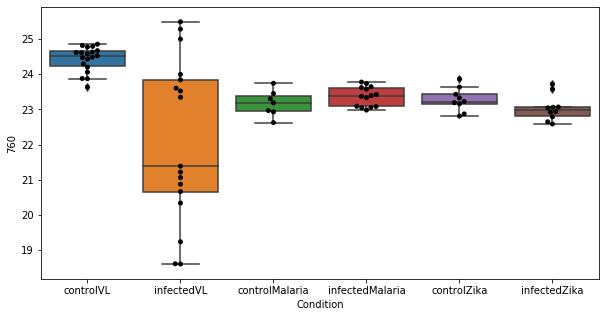

354 row m/z                194.147
row retention time      4.1319
p-val                 0.706808
adj.P.Val             0.999793
custom_id                 1355
compound_names             NaN
Name: 1355, dtype: object


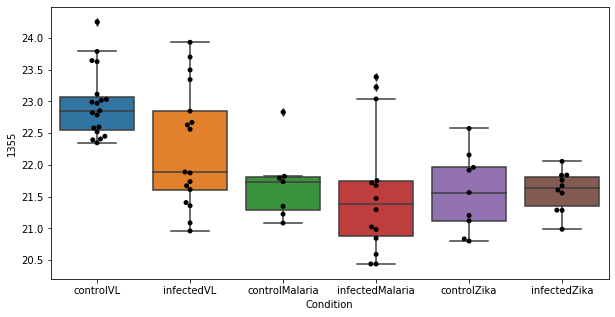

355 row m/z                                                         184.097
row retention time                                              6.71111
p-val                                                          0.709295
adj.P.Val                                                      0.999793
custom_id                                                          1205
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 1205, dtype: object


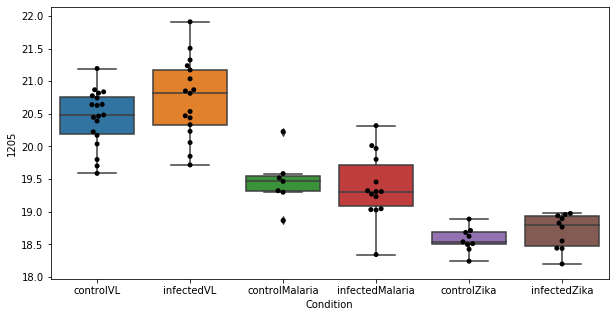

356 row m/z                117.091
row retention time     4.12309
p-val                 0.709673
adj.P.Val             0.999793
custom_id                  267
compound_names             NaN
Name: 267, dtype: object


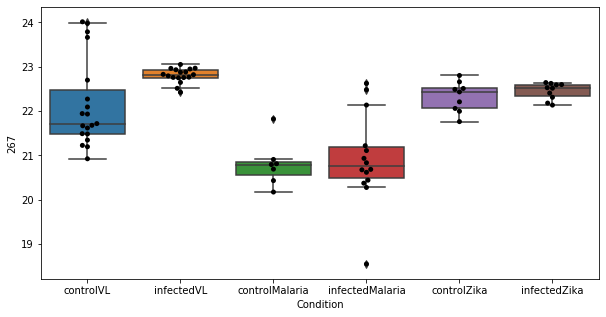

357 row m/z                140.011
row retention time     3.36234
p-val                 0.709714
adj.P.Val             0.999793
custom_id                  563
compound_names             NaN
Name: 563, dtype: object


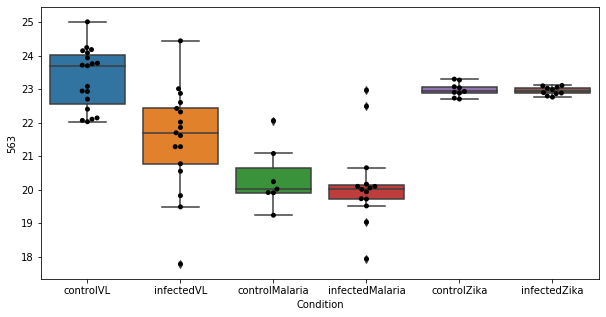

358 row m/z                205.144
row retention time     3.48202
p-val                 0.714379
adj.P.Val             0.999793
custom_id                 1504
compound_names             NaN
Name: 1504, dtype: object


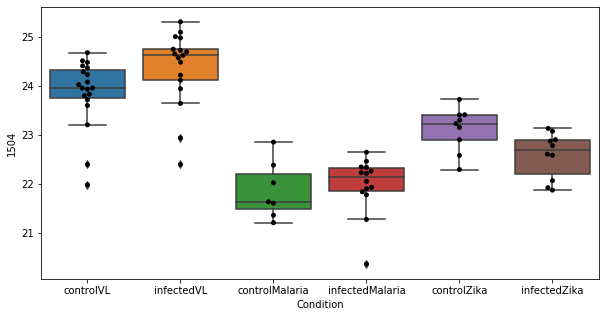

359 row m/z                236.113
row retention time     3.48747
p-val                  0.71476
adj.P.Val             0.999793
custom_id                 1875
compound_names             NaN
Name: 1875, dtype: object


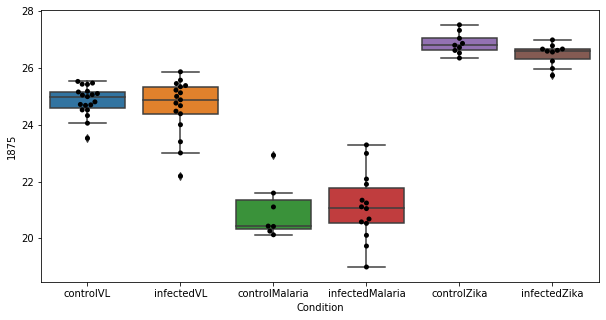

360 row m/z                           218.139
row retention time                8.41637
p-val                            0.716462
adj.P.Val                        0.999793
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object


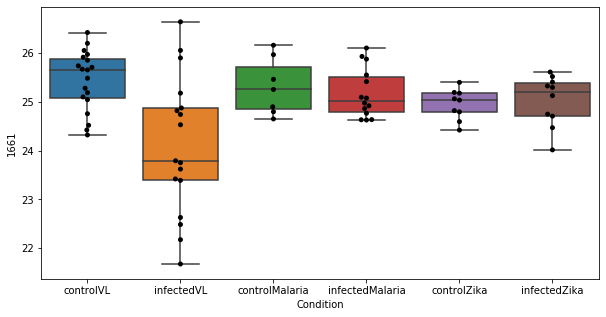

361 row m/z                                                         104.107
row retention time                                              6.57923
p-val                                                          0.718026
adj.P.Val                                                      0.999793
custom_id                                                           143
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 143, dtype: object


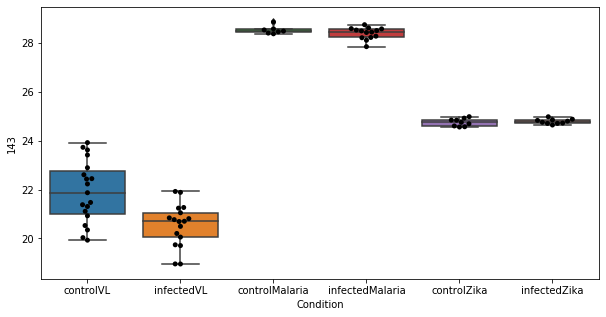

362 row m/z                106.086
row retention time     9.50445
p-val                 0.718125
adj.P.Val             0.999793
custom_id                  175
compound_names             NaN
Name: 175, dtype: object


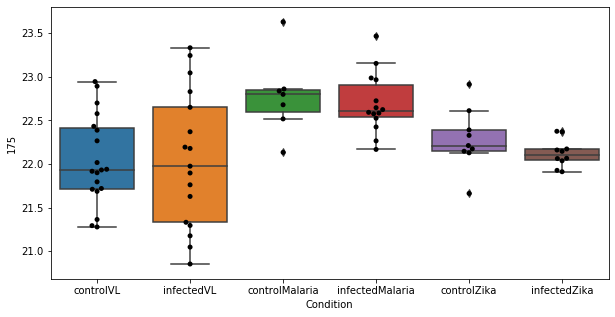

363 row m/z                                                         297.242
row retention time                                              3.21416
p-val                                                          0.718979
adj.P.Val                                                      0.999793
custom_id                                                          2360
compound_names        13(S)-HODE; (13S)-Hydroxyoctadecadienoic acid;...
Name: 2360, dtype: object


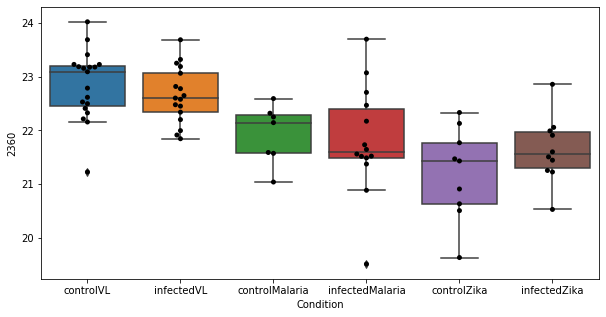

364 row m/z                 301.99
row retention time     10.4033
p-val                 0.719456
adj.P.Val             0.999793
custom_id                 2381
compound_names             NaN
Name: 2381, dtype: object


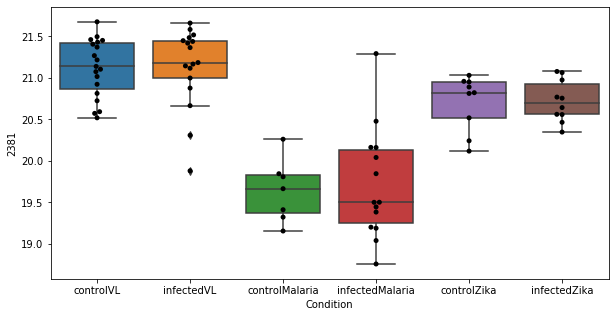

365 row m/z                744.553
row retention time       3.195
p-val                 0.722029
adj.P.Val             0.999793
custom_id                 2954
compound_names             NaN
Name: 2954, dtype: object


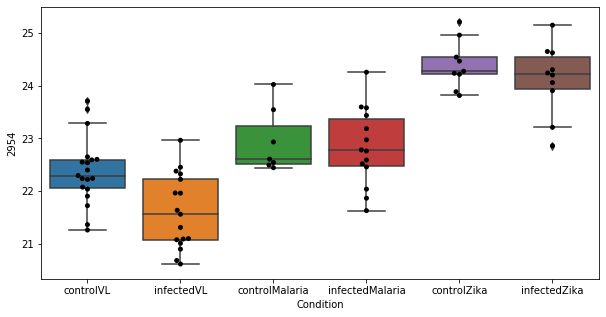

366 row m/z                787.604
row retention time     3.18287
p-val                 0.725478
adj.P.Val             0.999793
custom_id                 3024
compound_names             NaN
Name: 3024, dtype: object


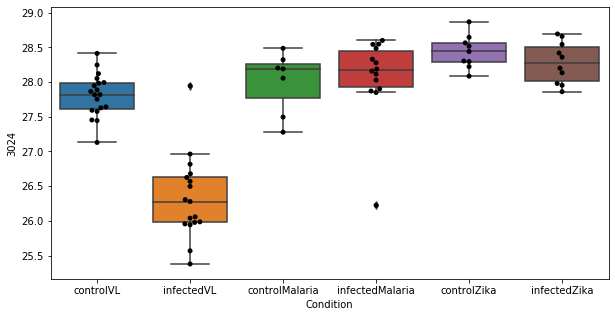

367 row m/z                                                         182.081
row retention time                                              10.8253
p-val                                                           0.72703
adj.P.Val                                                      0.999793
custom_id                                                          1179
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1179, dtype: object


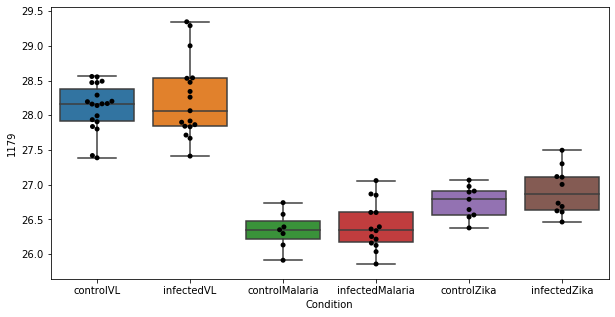

368 row m/z                757.621
row retention time     3.37542
p-val                 0.727416
adj.P.Val             0.999793
custom_id                 2969
compound_names             NaN
Name: 2969, dtype: object


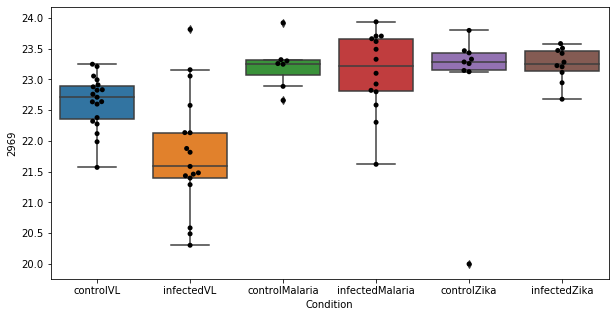

369 row m/z                703.574
row retention time     3.41257
p-val                  0.72748
adj.P.Val             0.999793
custom_id                 2918
compound_names             NaN
Name: 2918, dtype: object


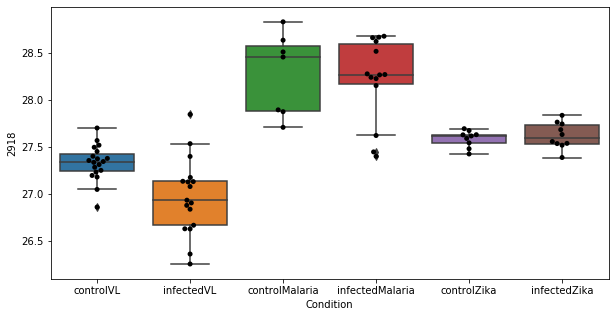

370 row m/z                 202.18
row retention time     6.86563
p-val                 0.728232
adj.P.Val             0.999793
custom_id                 1452
compound_names             NaN
Name: 1452, dtype: object


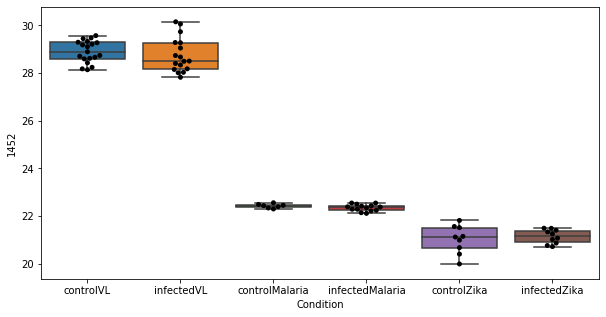

371 row m/z                                                         165.055
row retention time                                              10.8288
p-val                                                          0.732831
adj.P.Val                                                      0.999793
custom_id                                                           960
compound_names        3-Methoxy-4-hydroxyphenylglycolaldehyde$Homova...
Name: 960, dtype: object


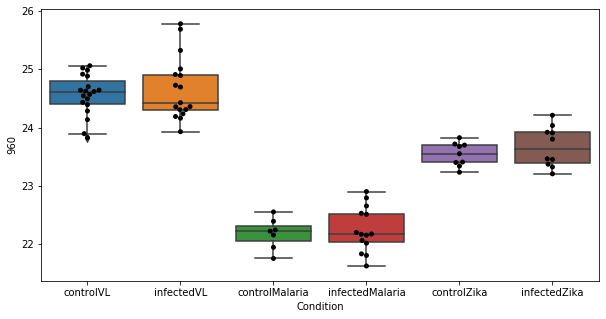

372 row m/z                344.228
row retention time      4.1966
p-val                  0.73546
adj.P.Val             0.999793
custom_id                 2548
compound_names             NaN
Name: 2548, dtype: object


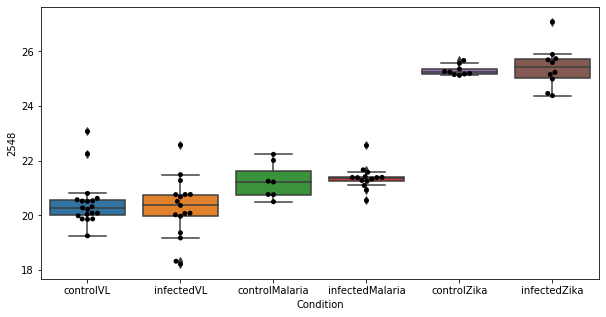

373 row m/z                257.113
row retention time     8.04659
p-val                 0.736438
adj.P.Val             0.999793
custom_id                 2068
compound_names             NaN
Name: 2068, dtype: object


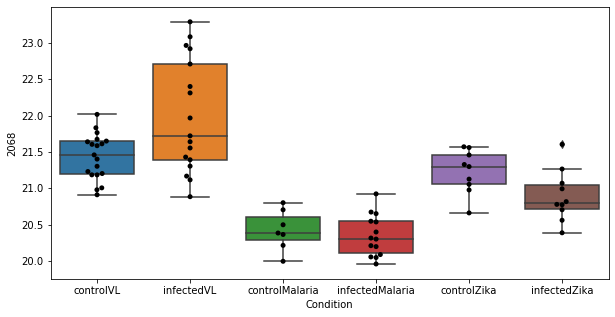

374 row m/z                148.097
row retention time     10.9468
p-val                  0.73831
adj.P.Val             0.999793
custom_id                  719
compound_names             NaN
Name: 719, dtype: object


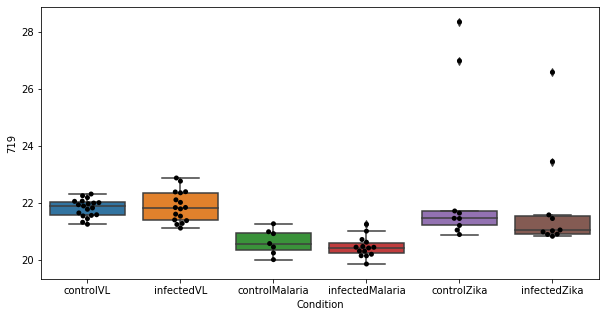

375 row m/z                                                         118.061
row retention time                                              12.5314
p-val                                                          0.738928
adj.P.Val                                                      0.999793
custom_id                                                           273
compound_names        Guanidinoacetate$Guanidinoacetate; Guanidinoac...
Name: 273, dtype: object


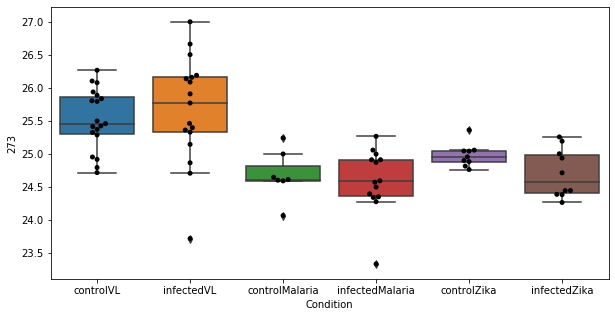

376 row m/z                745.593
row retention time     3.19691
p-val                 0.741292
adj.P.Val             0.999793
custom_id                 2957
compound_names             NaN
Name: 2957, dtype: object


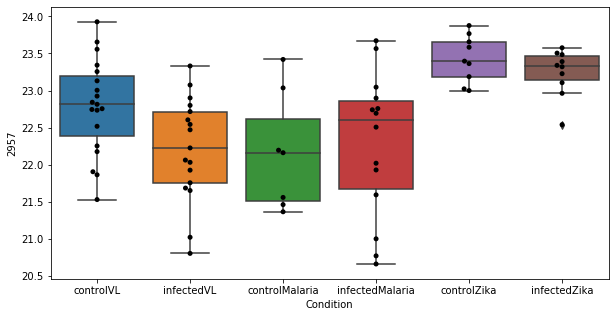

377 row m/z                256.175
row retention time     4.38253
p-val                 0.741826
adj.P.Val             0.999793
custom_id                 2057
compound_names             NaN
Name: 2057, dtype: object


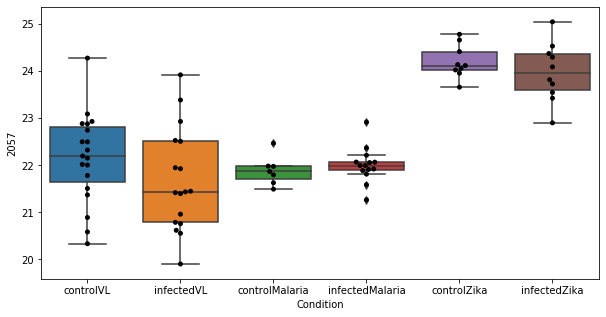

378 row m/z                                138.043
row retention time                      9.0432
p-val                                 0.742482
adj.P.Val                             0.999793
custom_id                                  547
compound_names        Urocanate; Urocanic acid
Name: 547, dtype: object


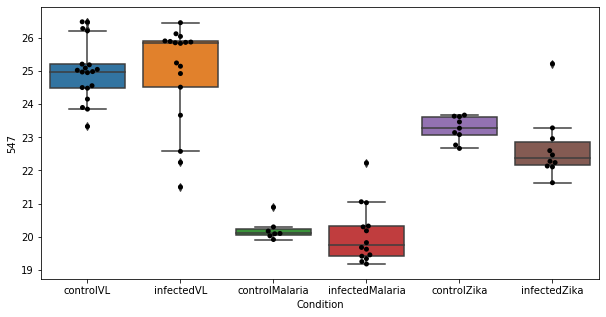

379 row m/z                236.073
row retention time     11.8556
p-val                 0.744731
adj.P.Val             0.999793
custom_id                 1869
compound_names             NaN
Name: 1869, dtype: object


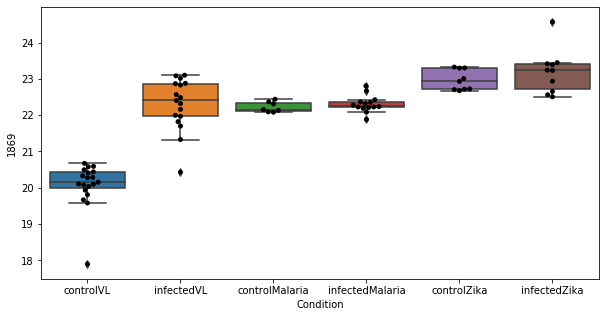

380 row m/z                105.074
row retention time       11.15
p-val                 0.747322
adj.P.Val             0.999793
custom_id                  154
compound_names             NaN
Name: 154, dtype: object


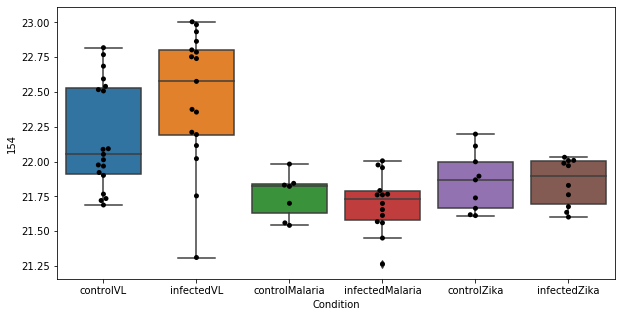

381 row m/z                702.562
row retention time     3.43509
p-val                 0.747425
adj.P.Val             0.999793
custom_id                 2917
compound_names             NaN
Name: 2917, dtype: object


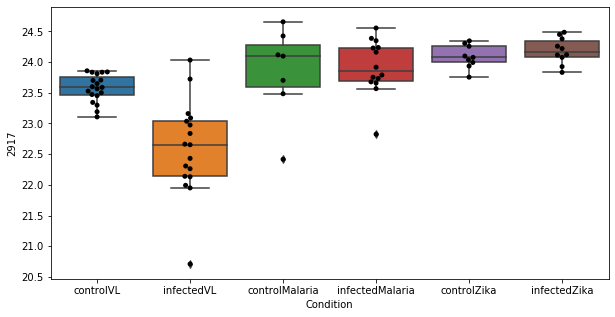

382 row m/z                221.154
row retention time      3.4093
p-val                 0.749075
adj.P.Val             0.999793
custom_id                 1702
compound_names             NaN
Name: 1702, dtype: object


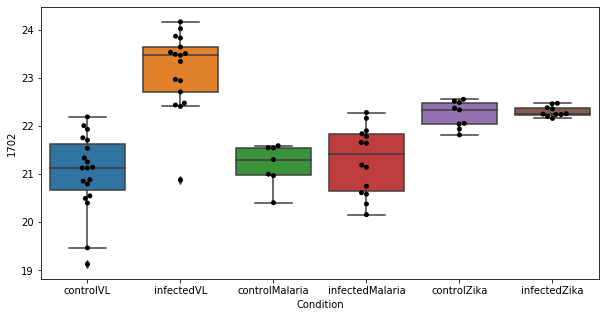

383 row m/z                  149.1
row retention time     10.1924
p-val                 0.751876
adj.P.Val             0.999793
custom_id                 4631
compound_names             NaN
Name: 4631, dtype: object


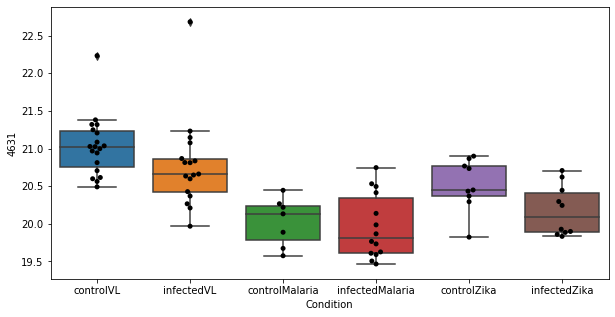

384 row m/z                732.554
row retention time     3.24734
p-val                 0.754368
adj.P.Val             0.999793
custom_id                 2938
compound_names             NaN
Name: 2938, dtype: object


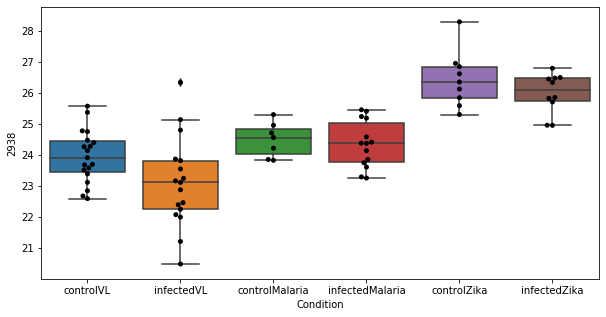

385 row m/z                304.248
row retention time     3.33835
p-val                 0.755043
adj.P.Val             0.999793
custom_id                 2398
compound_names             NaN
Name: 2398, dtype: object


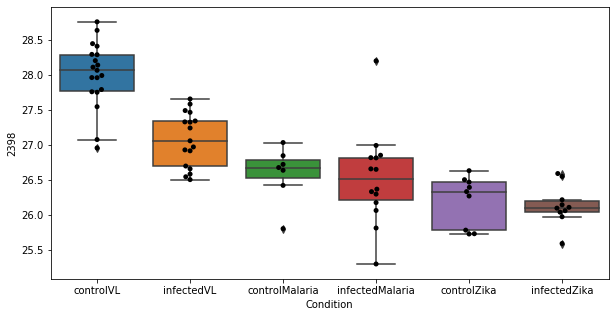

386 row m/z                198.087
row retention time     9.10321
p-val                 0.756876
adj.P.Val             0.999793
custom_id                 1394
compound_names             NaN
Name: 1394, dtype: object


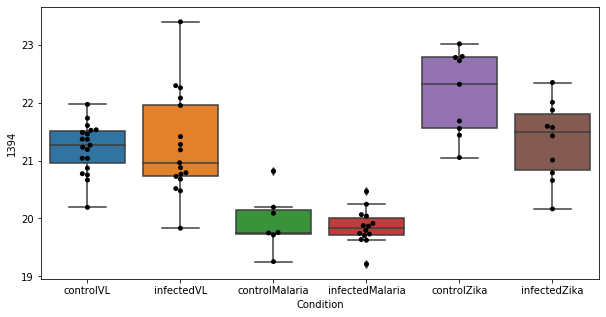

387 row m/z                172.097
row retention time     6.71038
p-val                 0.757968
adj.P.Val             0.999793
custom_id                 1062
compound_names             NaN
Name: 1062, dtype: object


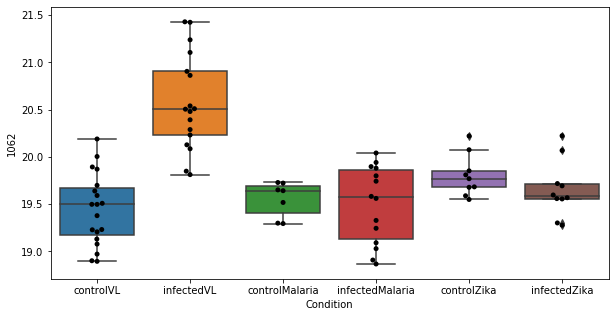

388 row m/z                761.588
row retention time     3.20233
p-val                 0.758087
adj.P.Val             0.999793
custom_id                 2976
compound_names             NaN
Name: 2976, dtype: object


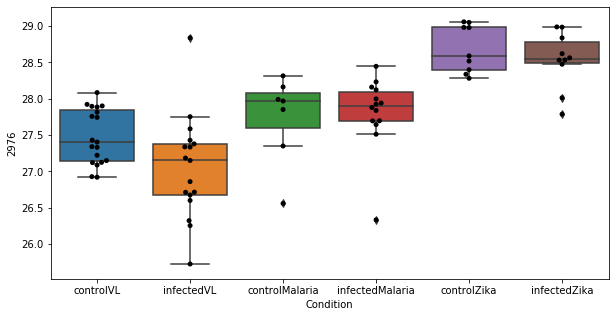

389 row m/z                228.123
row retention time     4.38993
p-val                 0.759708
adj.P.Val             0.999793
custom_id                 1770
compound_names             NaN
Name: 1770, dtype: object


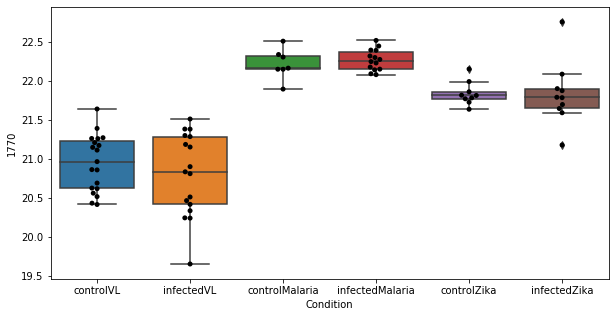

390 row m/z                204.123
row retention time     4.37371
p-val                 0.760585
adj.P.Val             0.999793
custom_id                 1486
compound_names             NaN
Name: 1486, dtype: object


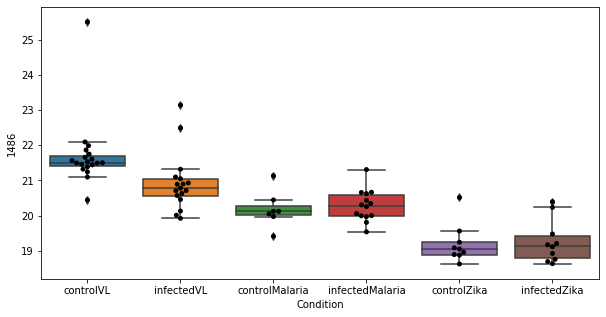

391 row m/z                                                         170.092
row retention time                                              10.5479
p-val                                                          0.761024
adj.P.Val                                                      0.999793
custom_id                                                         10774
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 10774, dtype: object


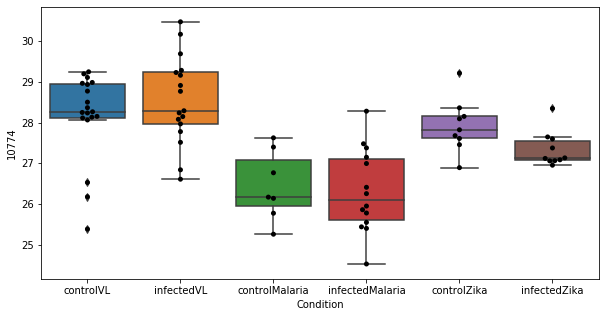

392 row m/z                                                         118.086
row retention time                                              10.4061
p-val                                                          0.761988
adj.P.Val                                                      0.999793
custom_id                                                           280
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 280, dtype: object


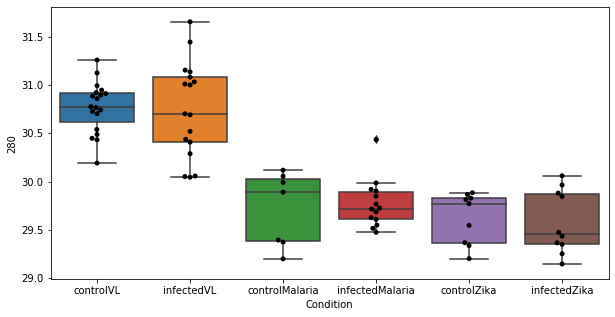

393 row m/z                316.248
row retention time     4.31512
p-val                 0.762581
adj.P.Val             0.999793
custom_id                 2464
compound_names             NaN
Name: 2464, dtype: object


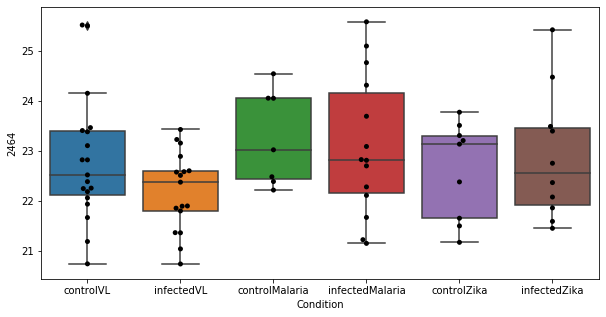

394 row m/z                199.097
row retention time     4.36912
p-val                 0.765043
adj.P.Val             0.999793
custom_id                 1409
compound_names             NaN
Name: 1409, dtype: object


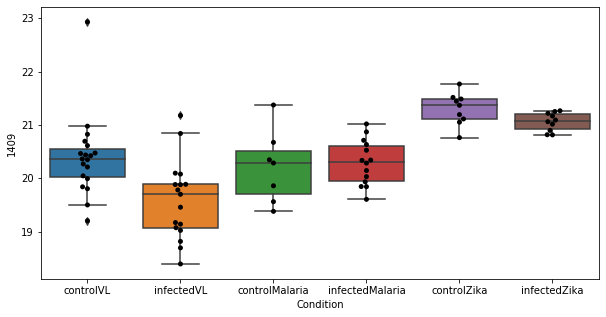

395 row m/z                177.055
row retention time     3.47783
p-val                 0.765241
adj.P.Val             0.999793
custom_id                 1125
compound_names             NaN
Name: 1125, dtype: object


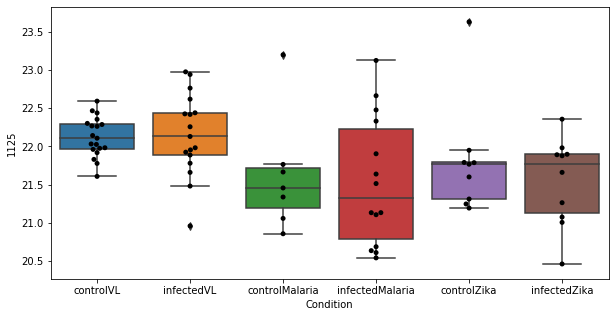

396 row m/z                780.553
row retention time     3.22229
p-val                 0.766755
adj.P.Val             0.999793
custom_id                 3004
compound_names             NaN
Name: 3004, dtype: object


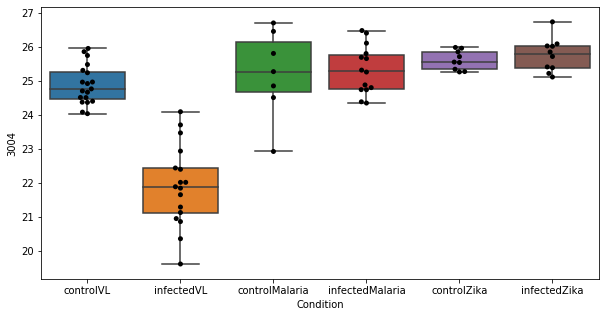

397 row m/z                                                         151.062
row retention time                                              7.64547
p-val                                                          0.767704
adj.P.Val                                                      0.999793
custom_id                                                           761
compound_names        L-Xylulose; L-threo-Pentulose; L-Lyxulose$D-Xy...
Name: 761, dtype: object


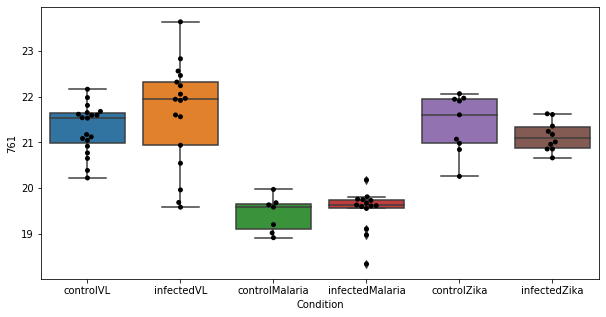

398 row m/z                300.201
row retention time     4.30861
p-val                 0.768704
adj.P.Val             0.999793
custom_id                 2369
compound_names             NaN
Name: 2369, dtype: object


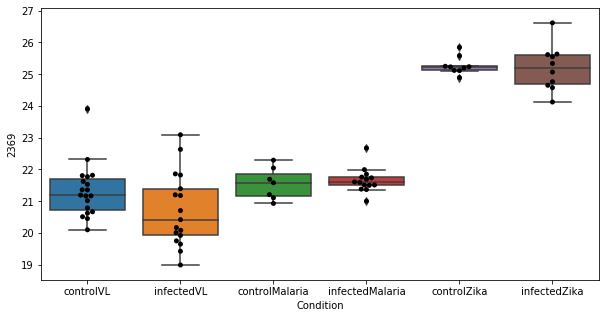

399 row m/z                 172.08
row retention time     11.8965
p-val                 0.769324
adj.P.Val             0.999793
custom_id                 1060
compound_names             NaN
Name: 1060, dtype: object


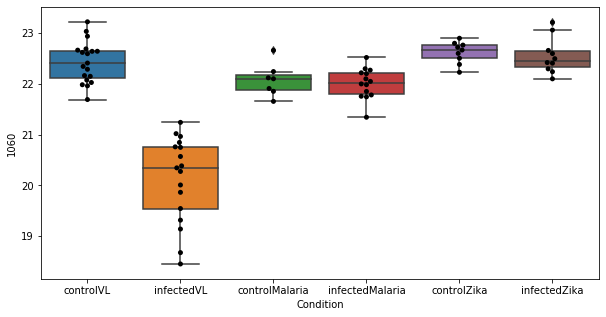

400 row m/z                           288.217
row retention time                6.71058
p-val                             0.76973
adj.P.Val                        0.999793
custom_id                            2309
compound_names        L-Octanoylcarnitine
Name: 2309, dtype: object


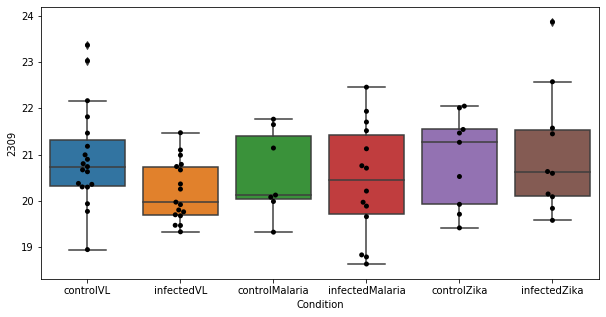

401 row m/z                232.154
row retention time     7.60698
p-val                 0.770165
adj.P.Val             0.999793
custom_id                 1825
compound_names             NaN
Name: 1825, dtype: object


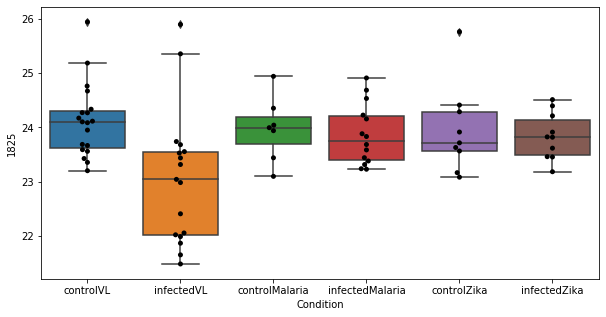

402 row m/z                200.173
row retention time     3.36251
p-val                 0.770207
adj.P.Val             0.999793
custom_id                 1424
compound_names             NaN
Name: 1424, dtype: object


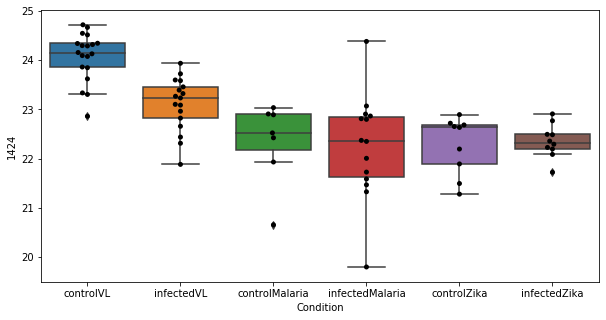

403 row m/z                268.175
row retention time     3.38427
p-val                 0.770877
adj.P.Val             0.999793
custom_id                 2156
compound_names             NaN
Name: 2156, dtype: object


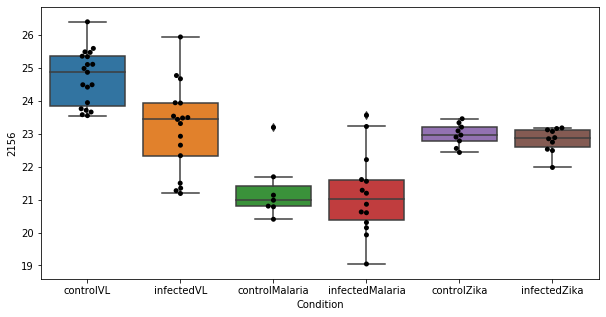

404 row m/z                                                         133.061
row retention time                                              12.1002
p-val                                                          0.772427
adj.P.Val                                                      0.999793
custom_id                                                           472
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 472, dtype: object


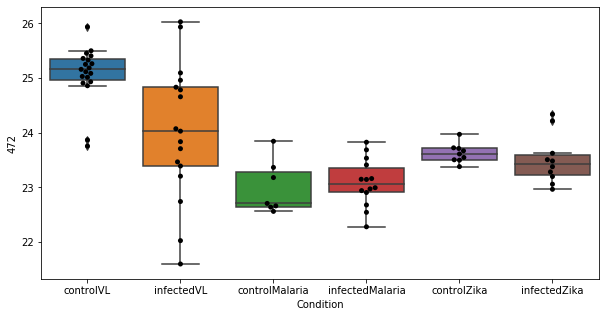

405 row m/z                212.095
row retention time     4.63104
p-val                 0.772598
adj.P.Val             0.999793
custom_id                 3780
compound_names             NaN
Name: 3780, dtype: object


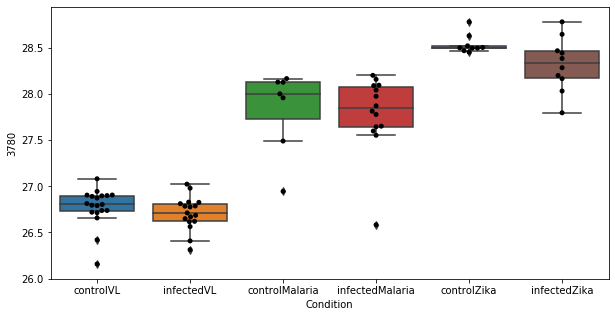

406 row m/z                144.102
row retention time     10.8185
p-val                 0.772603
adj.P.Val             0.999793
custom_id                  633
compound_names             NaN
Name: 633, dtype: object


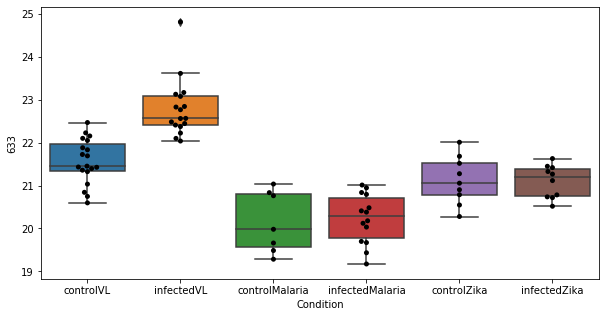

407 row m/z                  786.6
row retention time     3.18718
p-val                 0.773352
adj.P.Val             0.999793
custom_id                 3020
compound_names             NaN
Name: 3020, dtype: object


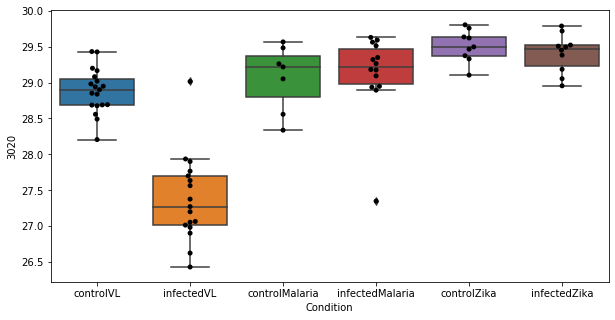

408 row m/z                                                129.102
row retention time                                     10.8821
p-val                                                  0.77393
adj.P.Val                                             0.999793
custom_id                                                 3342
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 3342, dtype: object


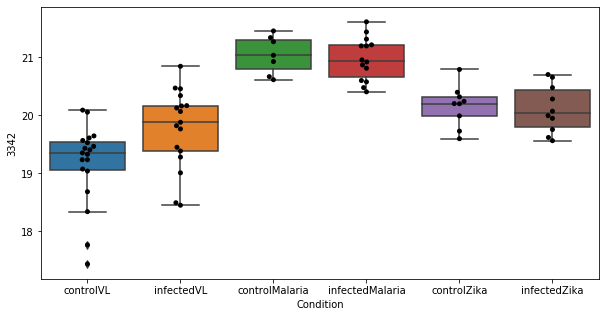

409 row m/z                248.149
row retention time     9.47753
p-val                 0.774109
adj.P.Val             0.999793
custom_id                 1985
compound_names             NaN
Name: 1985, dtype: object


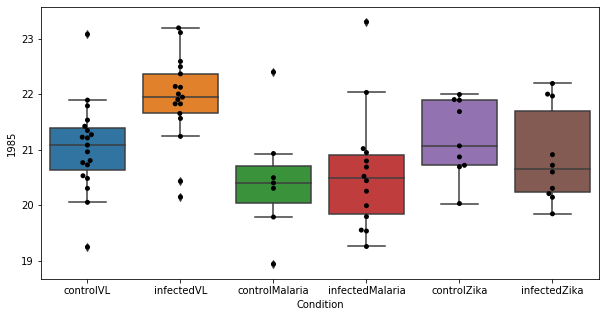

410 row m/z                267.172
row retention time     3.36788
p-val                 0.778126
adj.P.Val             0.999793
custom_id                 2151
compound_names             NaN
Name: 2151, dtype: object


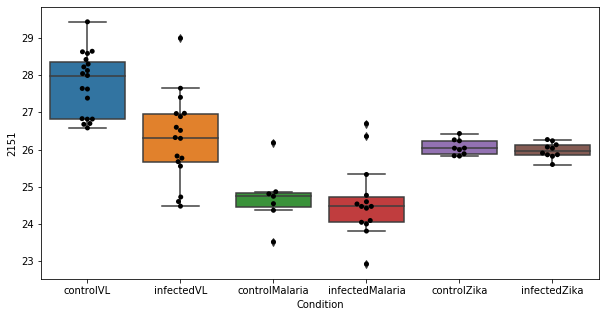

411 row m/z                199.169
row retention time     3.35541
p-val                 0.778446
adj.P.Val             0.999793
custom_id                 1412
compound_names             NaN
Name: 1412, dtype: object


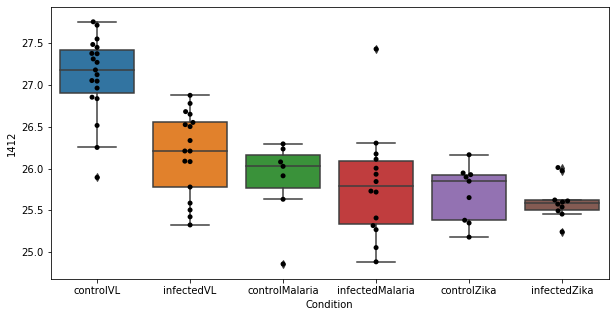

412 row m/z                                                         133.032
row retention time                                              9.80164
p-val                                                          0.781622
adj.P.Val                                                      0.999793
custom_id                                                           471
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 471, dtype: object


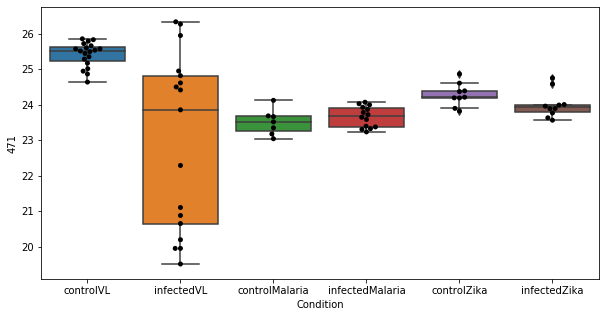

413 row m/z                127.073
row retention time     9.99674
p-val                 0.781626
adj.P.Val             0.999793
custom_id                  374
compound_names             NaN
Name: 374, dtype: object


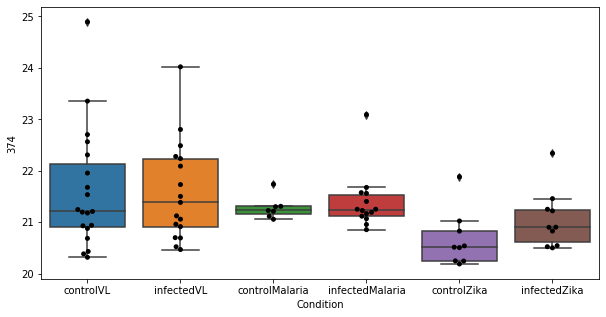

414 row m/z                614.535
row retention time      2.9848
p-val                 0.781828
adj.P.Val             0.999793
custom_id                 2873
compound_names             NaN
Name: 2873, dtype: object


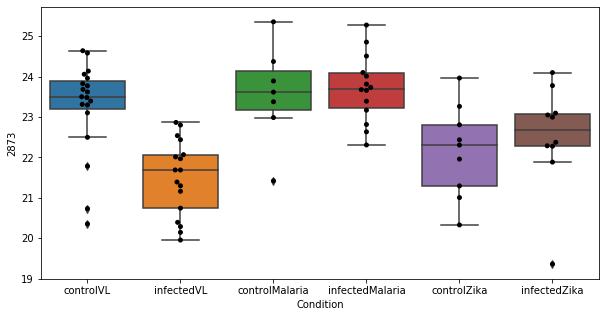

415 row m/z                682.486
row retention time     3.07538
p-val                 0.782055
adj.P.Val             0.999793
custom_id                 2909
compound_names             NaN
Name: 2909, dtype: object


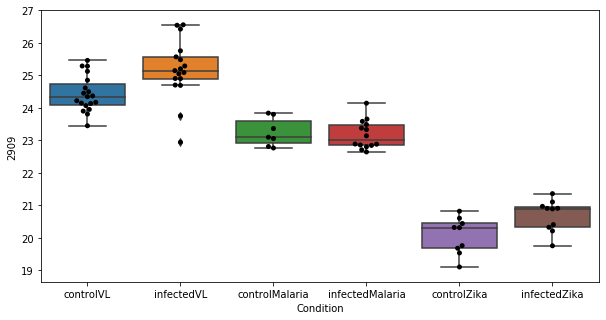

416 row m/z                            146.118
row retention time                 10.7265
p-val                             0.783786
adj.P.Val                         0.999793
custom_id                              674
compound_names        3-Dehydroxycarnitine
Name: 674, dtype: object


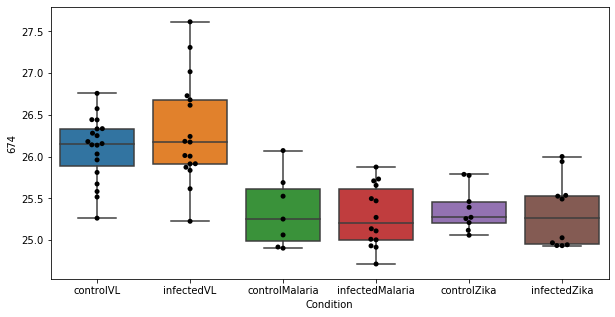

417 row m/z                                            180.066
row retention time                                 6.71078
p-val                                             0.784833
adj.P.Val                                         0.999793
custom_id                                             1159
compound_names        4-(2-Aminophenyl)-2,4-dioxobutanoate
Name: 1159, dtype: object


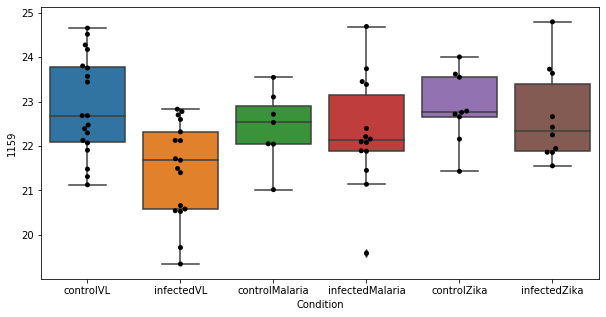

418 row m/z                284.331
row retention time     6.89412
p-val                 0.786986
adj.P.Val             0.999793
custom_id                 2280
compound_names             NaN
Name: 2280, dtype: object


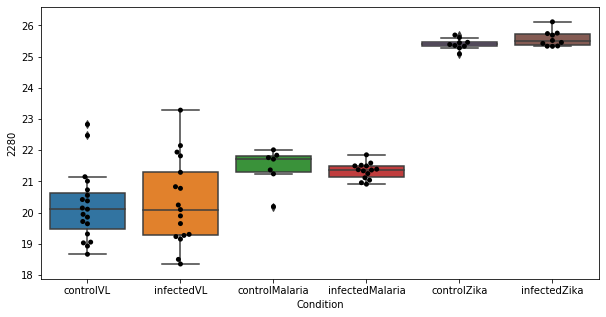

419 row m/z                114.098
row retention time     8.60432
p-val                 0.787618
adj.P.Val             0.999793
custom_id                  237
compound_names             NaN
Name: 237, dtype: object


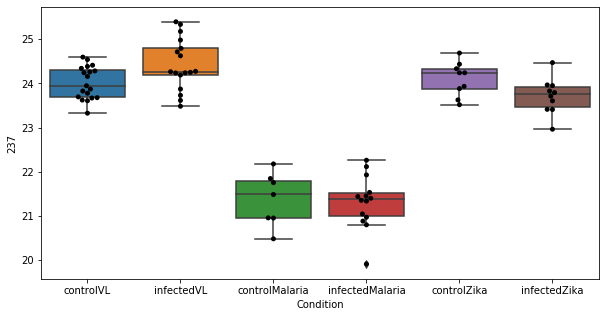

420 row m/z                236.073
row retention time     4.66101
p-val                 0.788082
adj.P.Val             0.999793
custom_id                 1871
compound_names             NaN
Name: 1871, dtype: object


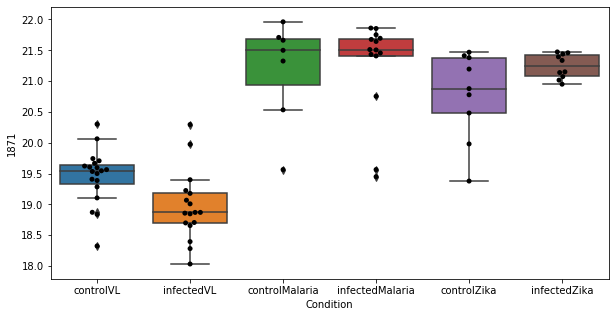

421 row m/z                249.185
row retention time     3.42338
p-val                 0.788806
adj.P.Val             0.999793
custom_id                 1989
compound_names             NaN
Name: 1989, dtype: object


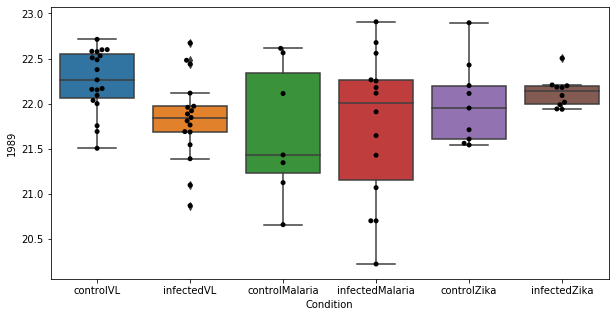

422 row m/z                279.159
row retention time      3.3597
p-val                 0.790346
adj.P.Val             0.999793
custom_id                 2230
compound_names             NaN
Name: 2230, dtype: object


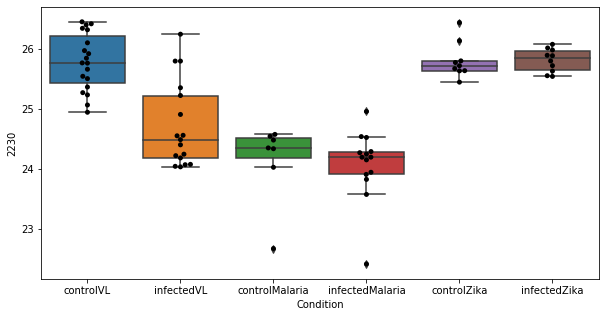

423 row m/z                157.086
row retention time     4.39371
p-val                 0.791497
adj.P.Val             0.999793
custom_id                  847
compound_names             NaN
Name: 847, dtype: object


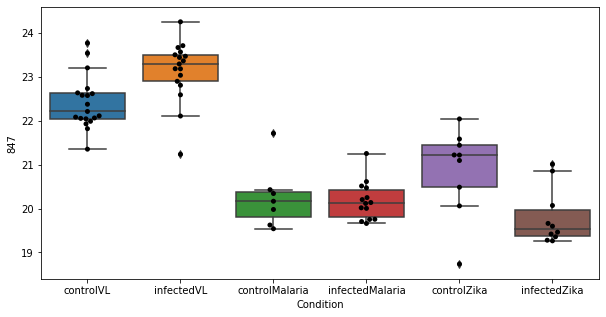

424 row m/z                760.584
row retention time     3.20659
p-val                 0.792419
adj.P.Val             0.999793
custom_id                 2975
compound_names             NaN
Name: 2975, dtype: object


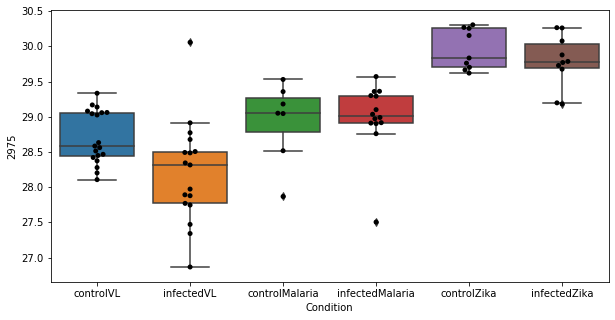

425 row m/z                234.134
row retention time     3.72693
p-val                 0.793241
adj.P.Val             0.999793
custom_id                 6920
compound_names             NaN
Name: 6920, dtype: object


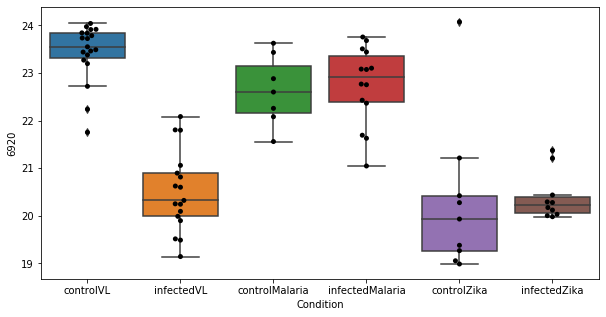

426 row m/z                134.081
row retention time     11.7055
p-val                 0.793853
adj.P.Val             0.999793
custom_id                  496
compound_names             NaN
Name: 496, dtype: object


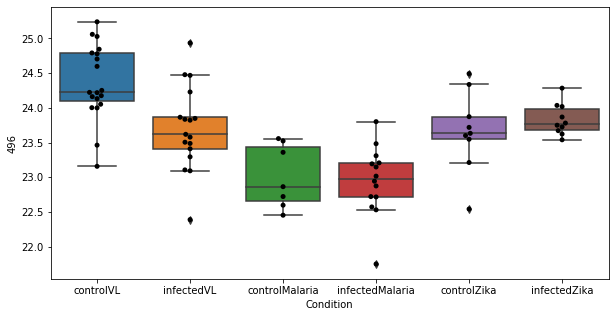

427 row m/z                                                         223.108
row retention time                                              10.8224
p-val                                                           0.79552
adj.P.Val                                                      0.999793
custom_id                                                          1720
compound_names        quinonoid dihydrobiopterin$O2'-4a-cyclic-tetra...
Name: 1720, dtype: object


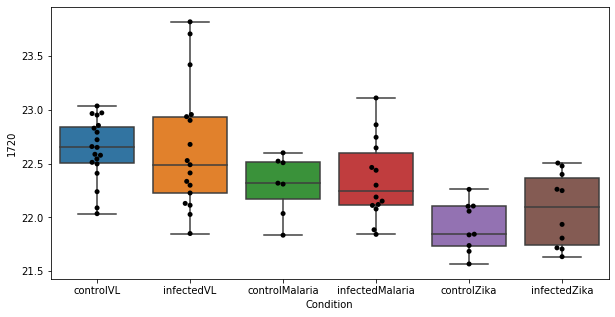

428 row m/z                119.083
row retention time     10.4069
p-val                 0.796709
adj.P.Val             0.999793
custom_id                  297
compound_names             NaN
Name: 297, dtype: object


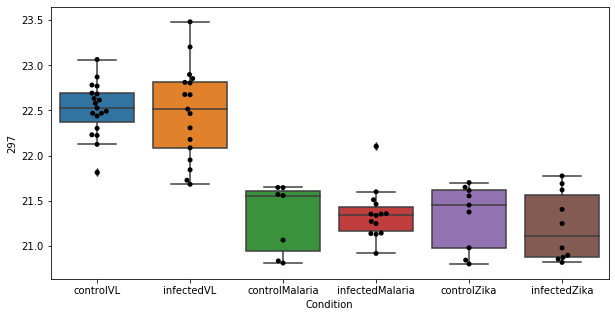

429 row m/z                              167.09
row retention time                  8.85715
p-val                               0.79676
adj.P.Val                          0.999793
custom_id                               995
compound_names        4-Guanidinobutanamide
Name: 995, dtype: object


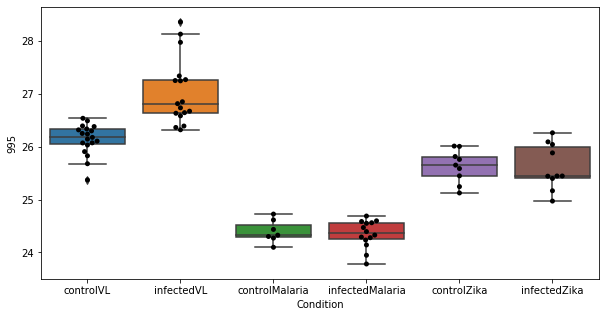

430 row m/z                                                         203.052
row retention time                                               12.051
p-val                                                          0.796885
adj.P.Val                                                      0.999793
custom_id                                                          1464
compound_names        D-Tagatose; lyxo-Hexulose$1,7-Dimethylxanthine...
Name: 1464, dtype: object


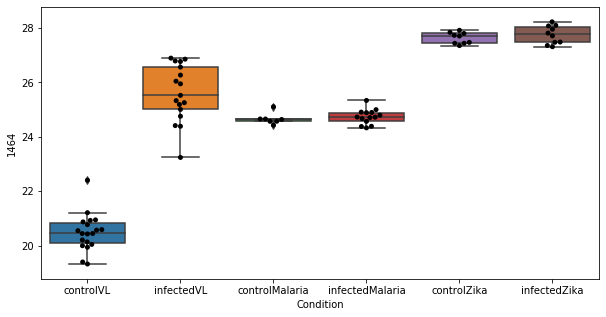

431 row m/z                228.123
row retention time     8.59395
p-val                 0.796894
adj.P.Val             0.999793
custom_id                 1771
compound_names             NaN
Name: 1771, dtype: object


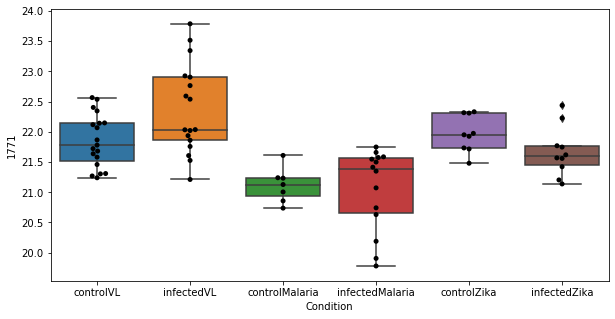

432 row m/z                                                         136.076
row retention time                                              10.8269
p-val                                                          0.797788
adj.P.Val                                                      0.999793
custom_id                                                           523
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 523, dtype: object


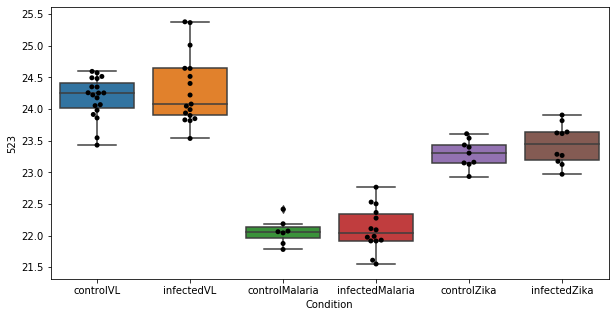

433 row m/z                814.687
row retention time     3.26715
p-val                  0.79816
adj.P.Val             0.999793
custom_id                 3087
compound_names             NaN
Name: 3087, dtype: object


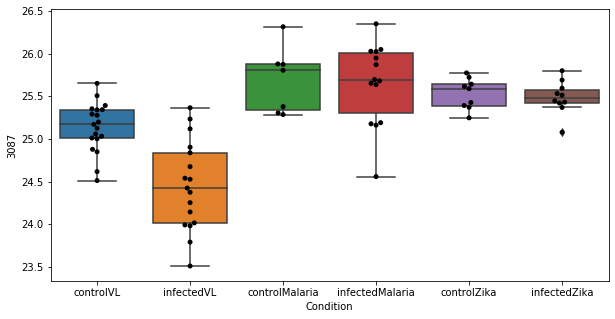

434 row m/z                                                         218.139
row retention time                                              6.70695
p-val                                                          0.798382
adj.P.Val                                                      0.999793
custom_id                                                          1664
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1664, dtype: object


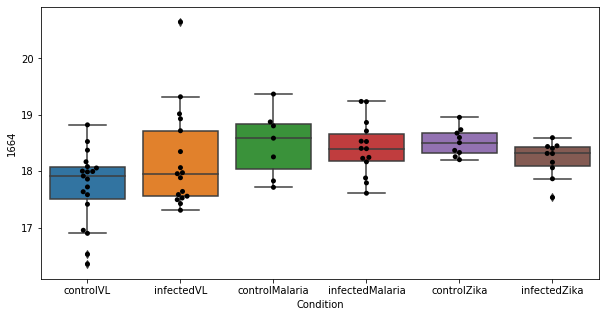

435 row m/z                317.269
row retention time     2.99278
p-val                 0.801556
adj.P.Val             0.999793
custom_id                 2470
compound_names             NaN
Name: 2470, dtype: object


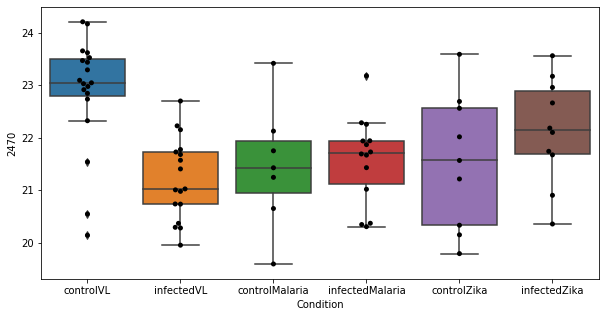

436 row m/z                704.578
row retention time     3.41484
p-val                 0.801943
adj.P.Val             0.999793
custom_id                 2919
compound_names             NaN
Name: 2919, dtype: object


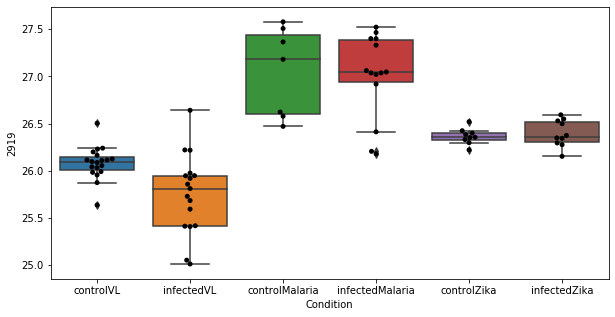

437 row m/z                 680.48
row retention time     3.07307
p-val                  0.80465
adj.P.Val             0.999793
custom_id                 2907
compound_names             NaN
Name: 2907, dtype: object


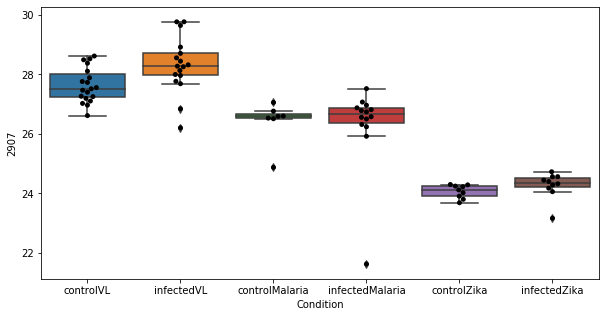

438 row m/z                                                          90.055
row retention time                                               11.795
p-val                                                          0.806409
adj.P.Val                                                      0.999793
custom_id                                                            84
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 84, dtype: object


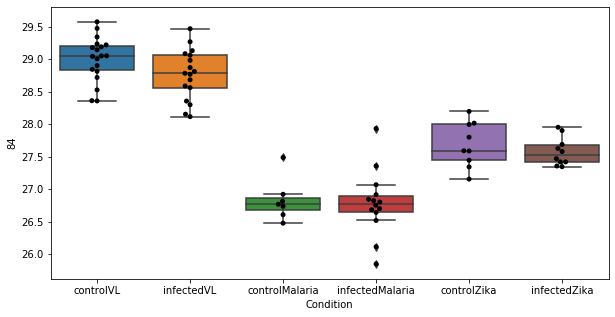

439 row m/z                795.609
row retention time     3.17042
p-val                 0.807266
adj.P.Val             0.999793
custom_id                 3043
compound_names             NaN
Name: 3043, dtype: object


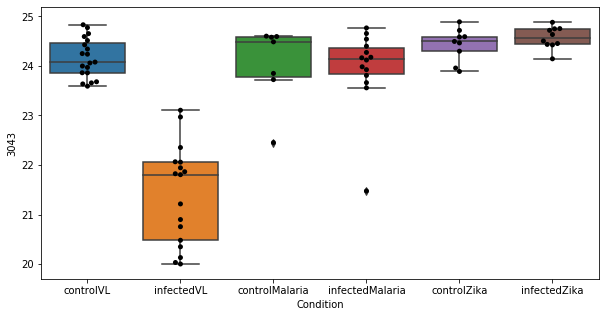

440 row m/z                         213.099
row retention time              4.63072
p-val                          0.808836
adj.P.Val                      0.999793
custom_id                          3790
compound_names        N-Methylserotonin
Name: 3790, dtype: object


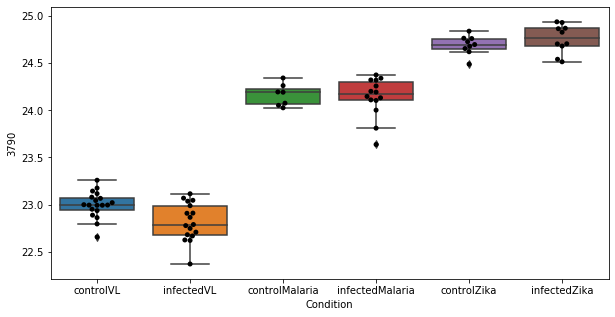

441 row m/z                120.091
row retention time     10.4043
p-val                 0.809133
adj.P.Val             0.999793
custom_id                  311
compound_names             NaN
Name: 311, dtype: object


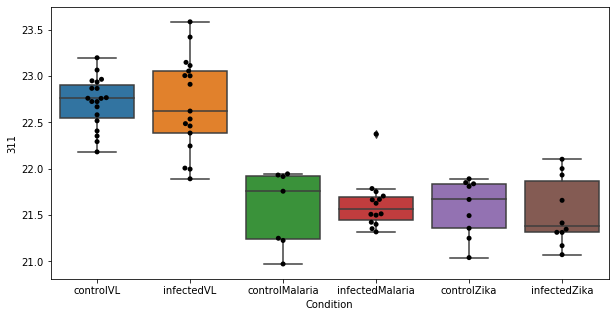

442 row m/z                                                         150.058
row retention time                                              9.80156
p-val                                                          0.812051
adj.P.Val                                                      0.999793
custom_id                                                           746
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 746, dtype: object


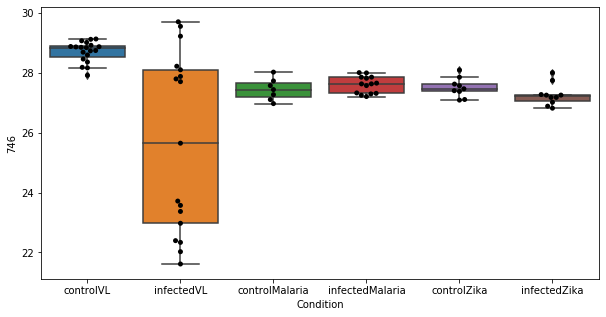

443 row m/z                                                        220.118
row retention time                                             7.99789
p-val                                                         0.816775
adj.P.Val                                                     0.999793
custom_id                                                         1692
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1692, dtype: object


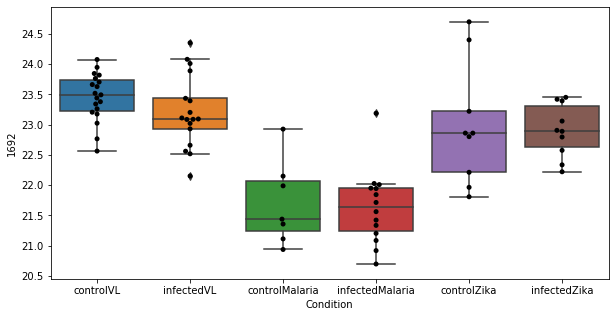

444 row m/z                                                         266.122
row retention time                                              4.45712
p-val                                                          0.817564
adj.P.Val                                                      0.999793
custom_id                                                          2145
compound_names        Thiamin; Thiamine; Vitamin B1; Aneurin; Antibe...
Name: 2145, dtype: object


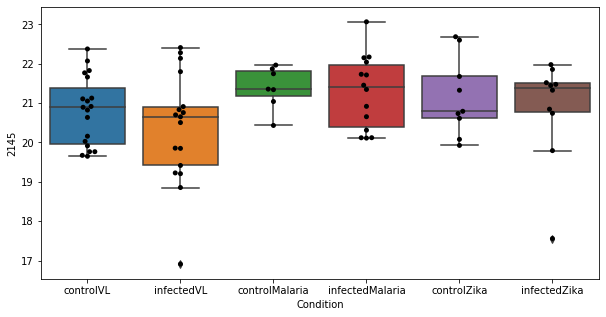

445 row m/z                111.117
row retention time     3.35659
p-val                 0.817946
adj.P.Val             0.999793
custom_id                  205
compound_names             NaN
Name: 205, dtype: object


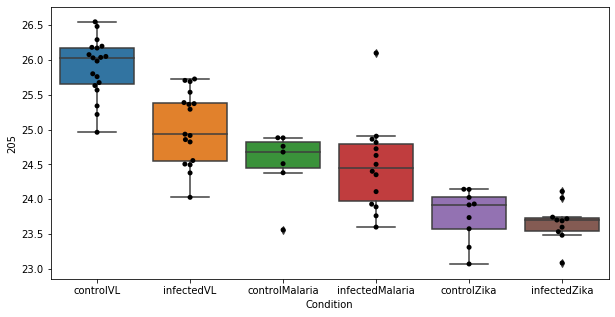

446 row m/z                                                         169.058
row retention time                                               11.897
p-val                                                          0.819258
adj.P.Val                                                      0.999793
custom_id                                                          1008
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 1008, dtype: object


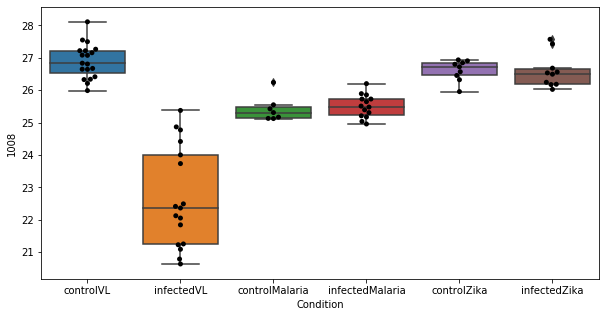

447 row m/z                                                         299.258
row retention time                                              3.05173
p-val                                                          0.819631
adj.P.Val                                                      0.999793
custom_id                                                          2366
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2366, dtype: object


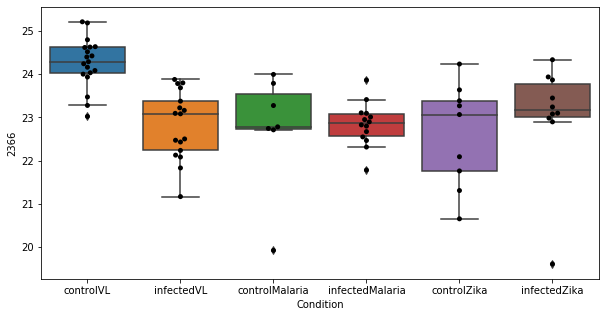

448 row m/z                338.342
row retention time     3.33679
p-val                 0.819838
adj.P.Val             0.999793
custom_id                 2522
compound_names             NaN
Name: 2522, dtype: object


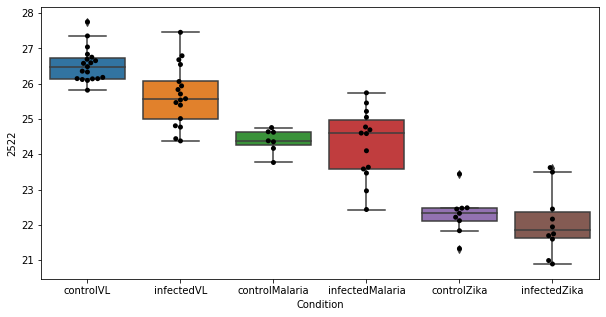

449 row m/z                757.557
row retention time     3.22221
p-val                 0.821626
adj.P.Val             0.999793
custom_id                 2968
compound_names             NaN
Name: 2968, dtype: object


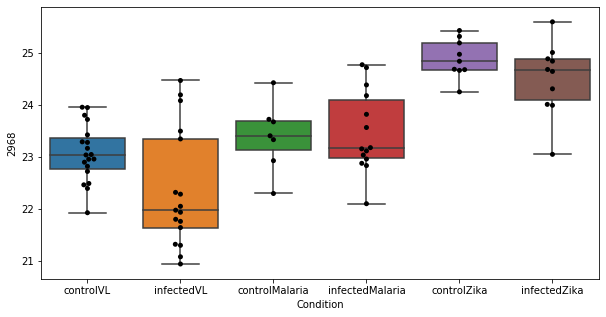

450 row m/z                326.378
row retention time     6.70674
p-val                 0.822109
adj.P.Val             0.999793
custom_id                 2492
compound_names             NaN
Name: 2492, dtype: object


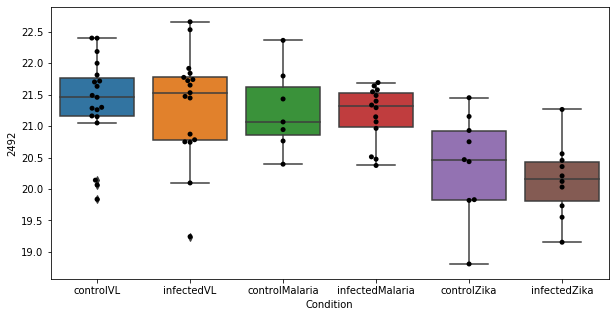

451 row m/z                283.103
row retention time     7.63894
p-val                  0.82467
adj.P.Val             0.999793
custom_id                 2265
compound_names             NaN
Name: 2265, dtype: object


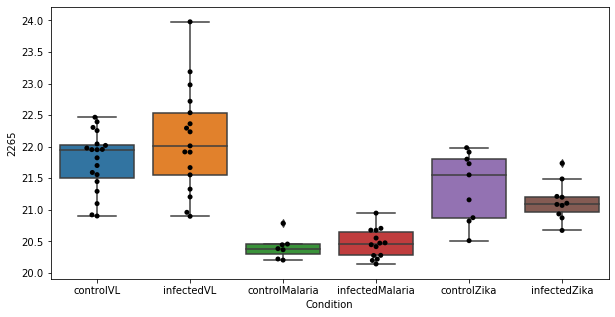

452 row m/z                                                         166.086
row retention time                                              8.85579
p-val                                                          0.825655
adj.P.Val                                                      0.999793
custom_id                                                           982
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 982, dtype: object


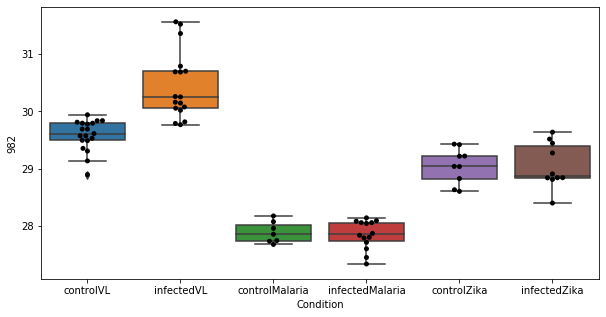

453 row m/z                705.582
row retention time     3.41385
p-val                 0.826095
adj.P.Val             0.999793
custom_id                 2920
compound_names             NaN
Name: 2920, dtype: object


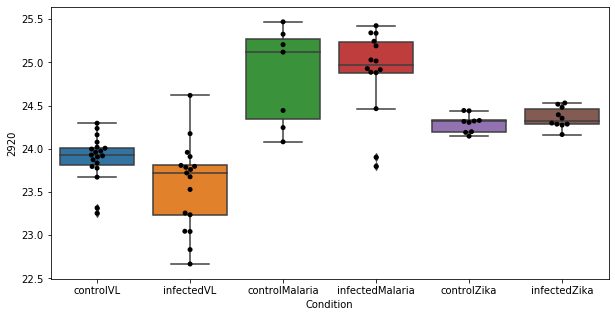

454 row m/z                           201.112
row retention time                6.70075
p-val                            0.827628
adj.P.Val                        0.999793
custom_id                            1435
compound_names        propionyl-carnitine
Name: 1435, dtype: object


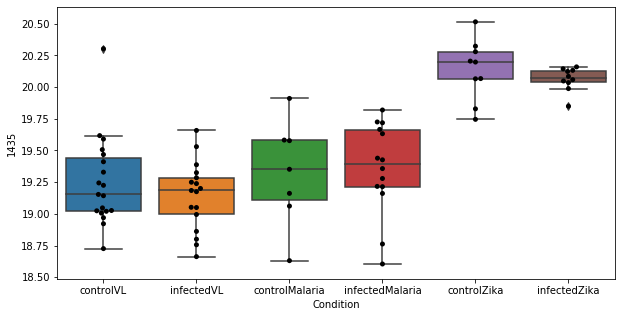

455 row m/z                159.113
row retention time      10.407
p-val                  0.82824
adj.P.Val             0.999793
custom_id                  883
compound_names             NaN
Name: 883, dtype: object


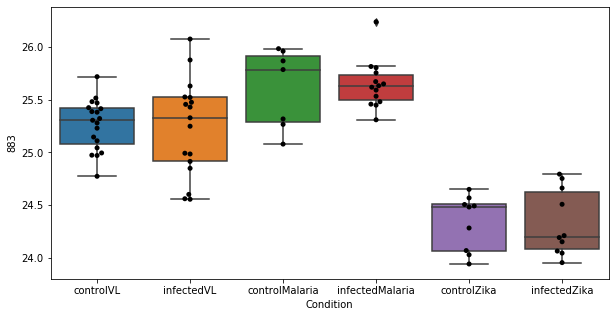

456 row m/z                                                         131.053
row retention time                                              11.8873
p-val                                                          0.830649
adj.P.Val                                                      0.999793
custom_id                                                           441
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 441, dtype: object


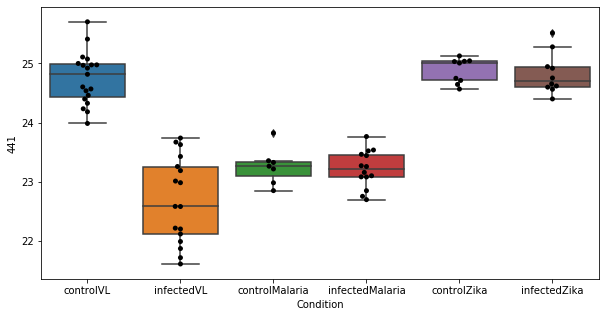

457 row m/z                   70.0651
row retention time         10.578
p-val                    0.831362
adj.P.Val                0.999793
custom_id                       1
compound_names        1-pyrroline
Name: 1, dtype: object


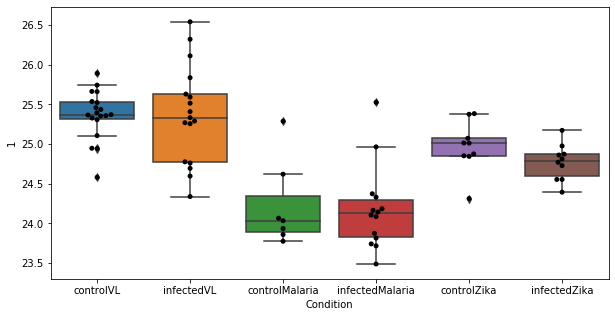

458 row m/z                762.591
row retention time     3.20571
p-val                 0.836458
adj.P.Val             0.999793
custom_id                 2977
compound_names             NaN
Name: 2977, dtype: object


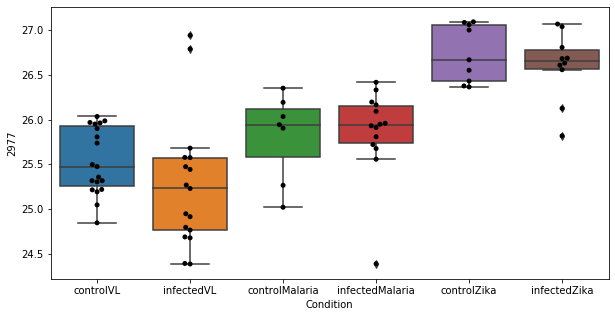

459 row m/z                206.127
row retention time      9.2812
p-val                 0.837563
adj.P.Val             0.999793
custom_id                 1507
compound_names             NaN
Name: 1507, dtype: object


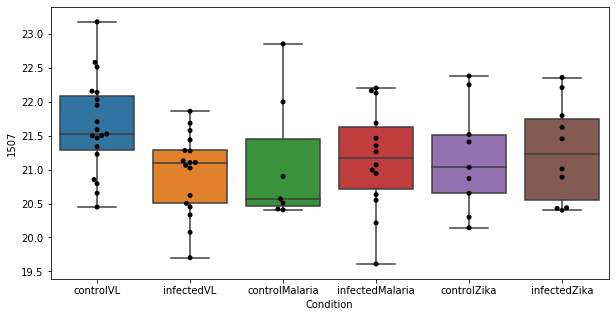

460 row m/z                                                         426.358
row retention time                                              3.68185
p-val                                                          0.841668
adj.P.Val                                                      0.999793
custom_id                                                          2699
compound_names        Elaidic carnitine$Vaccenyl carnitine$octadecen...
Name: 2699, dtype: object


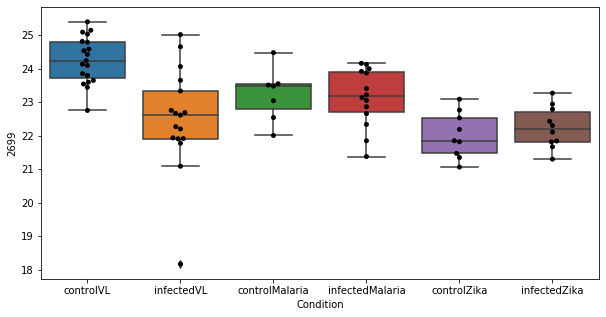

461 row m/z                132.077
row retention time     11.7119
p-val                 0.842331
adj.P.Val             0.999793
custom_id                  461
compound_names             NaN
Name: 461, dtype: object


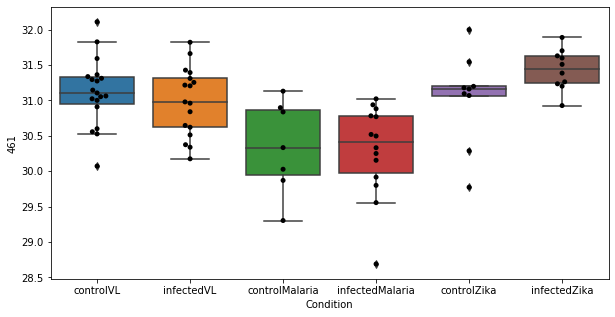

462 row m/z                                                         72.0808
row retention time                                              10.4047
p-val                                                          0.842537
adj.P.Val                                                      0.999793
custom_id                                                             6
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 6, dtype: object


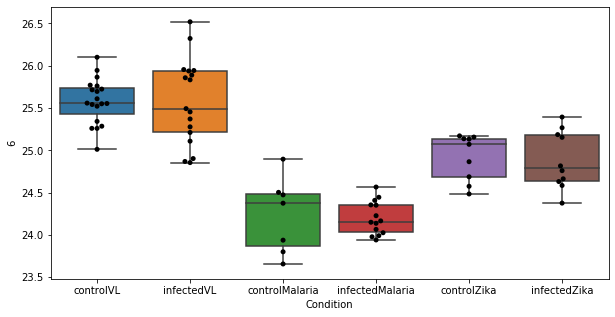

463 row m/z                231.134
row retention time     10.5776
p-val                 0.843553
adj.P.Val             0.999793
custom_id                 1813
compound_names             NaN
Name: 1813, dtype: object


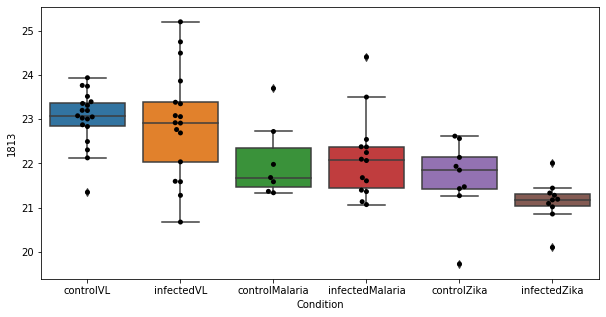

464 row m/z                                                          139.05
row retention time                                              8.15384
p-val                                                            0.8468
adj.P.Val                                                      0.999793
custom_id                                                          3390
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 3390, dtype: object


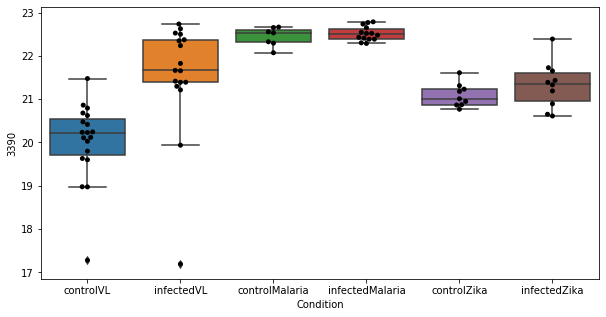

465 row m/z                239.149
row retention time     4.38228
p-val                 0.849404
adj.P.Val             0.999793
custom_id                 1902
compound_names             NaN
Name: 1902, dtype: object


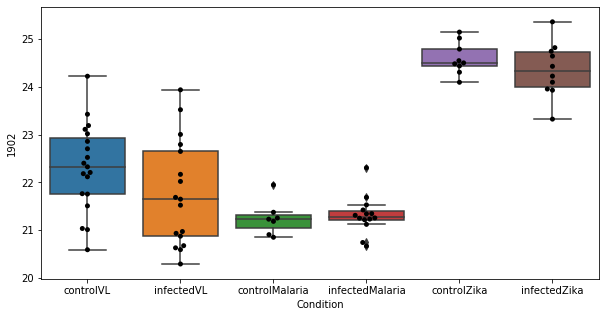

466 row m/z                           201.112
row retention time                4.34518
p-val                            0.849504
adj.P.Val                        0.999793
custom_id                            1434
compound_names        propionyl-carnitine
Name: 1434, dtype: object


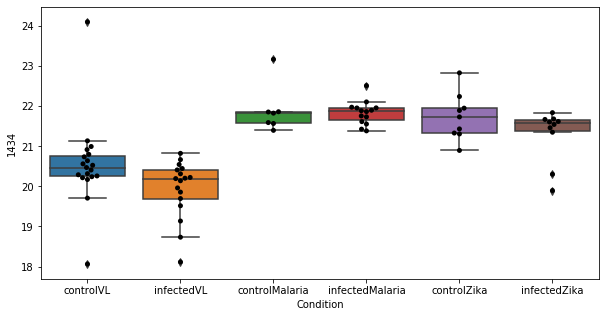

467 row m/z                                                         102.055
row retention time                                              11.6019
p-val                                                          0.850475
adj.P.Val                                                      0.999793
custom_id                                                           119
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 119, dtype: object


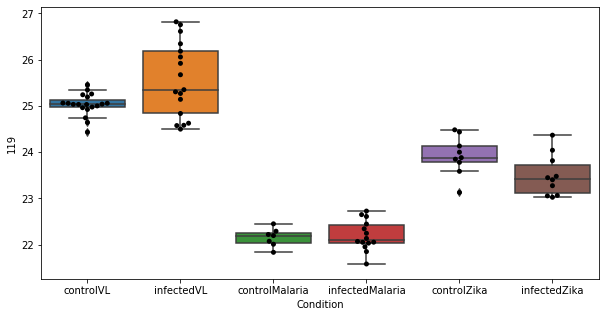

468 row m/z                204.123
row retention time     6.71267
p-val                 0.850993
adj.P.Val             0.999793
custom_id                 1481
compound_names             NaN
Name: 1481, dtype: object


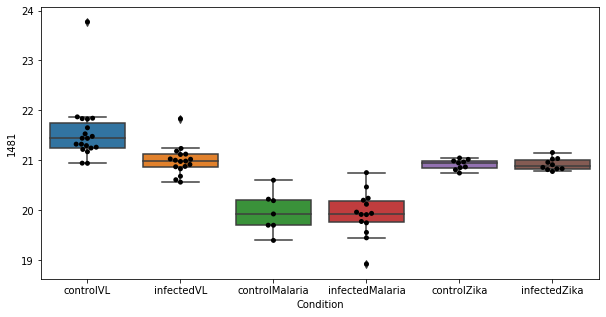

469 row m/z                158.101
row retention time     10.5739
p-val                  0.85437
adj.P.Val             0.999793
custom_id                  861
compound_names             NaN
Name: 861, dtype: object


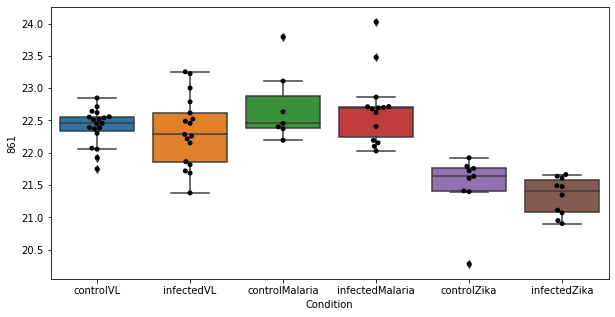

470 row m/z                202.144
row retention time     6.71119
p-val                 0.857805
adj.P.Val             0.999793
custom_id                 1450
compound_names             NaN
Name: 1450, dtype: object


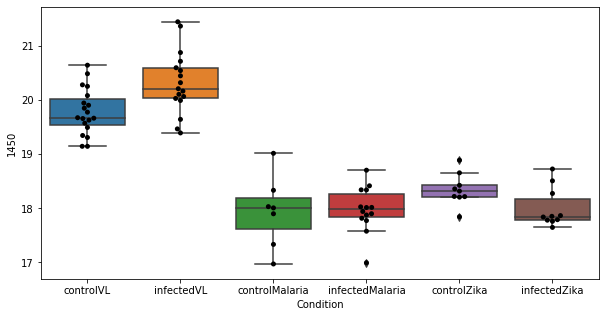

471 row m/z                151.058
row retention time     9.80728
p-val                 0.859961
adj.P.Val             0.999793
custom_id                  758
compound_names             NaN
Name: 758, dtype: object


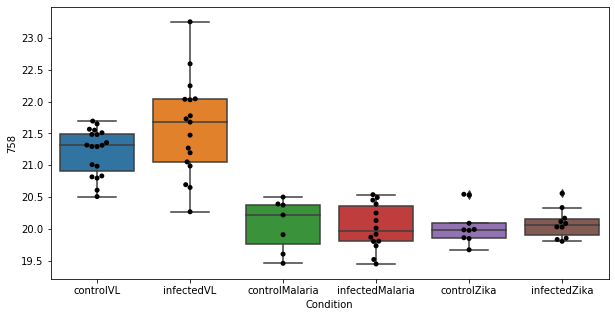

472 row m/z                                                         152.071
row retention time                                              6.71277
p-val                                                           0.86071
adj.P.Val                                                      0.999793
custom_id                                                           774
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 774, dtype: object


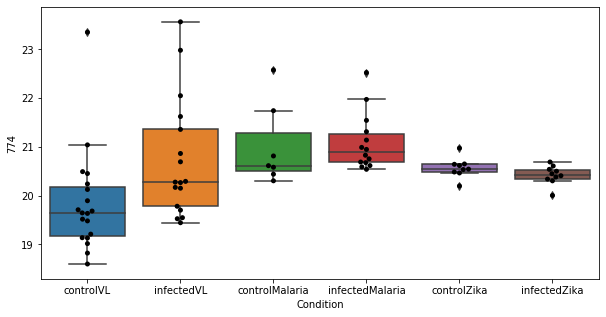

473 row m/z                179.128
row retention time     4.37518
p-val                 0.861806
adj.P.Val             0.999793
custom_id                 1154
compound_names             NaN
Name: 1154, dtype: object


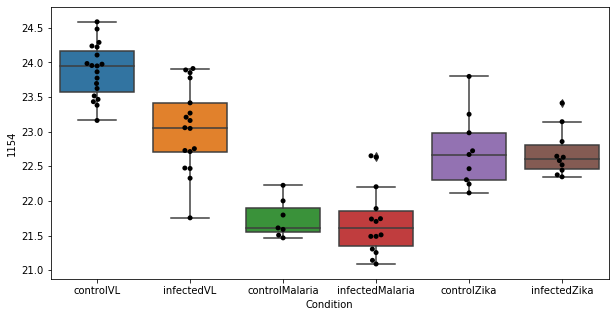

474 row m/z                160.116
row retention time     10.4075
p-val                 0.862166
adj.P.Val             0.999793
custom_id                  902
compound_names             NaN
Name: 902, dtype: object


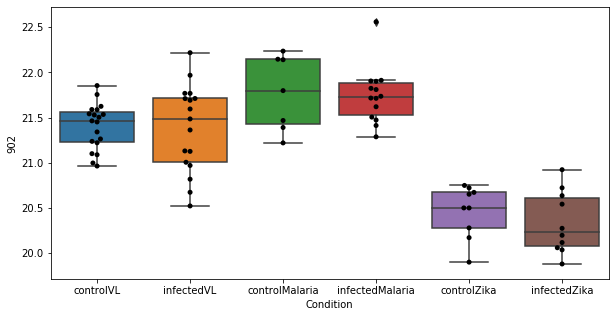

475 row m/z                768.589
row retention time      3.1957
p-val                 0.863307
adj.P.Val             0.999793
custom_id                 2988
compound_names             NaN
Name: 2988, dtype: object


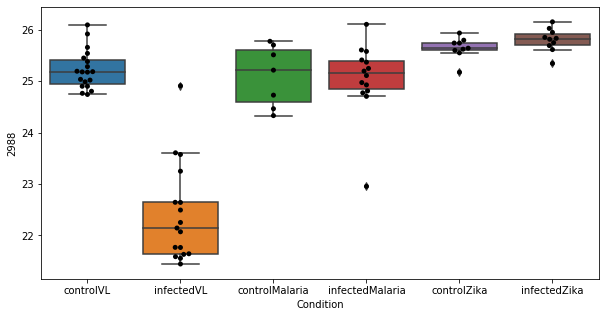

476 row m/z                                                         200.128
row retention time                                              6.73196
p-val                                                          0.863332
adj.P.Val                                                      0.999793
custom_id                                                          1420
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1420, dtype: object


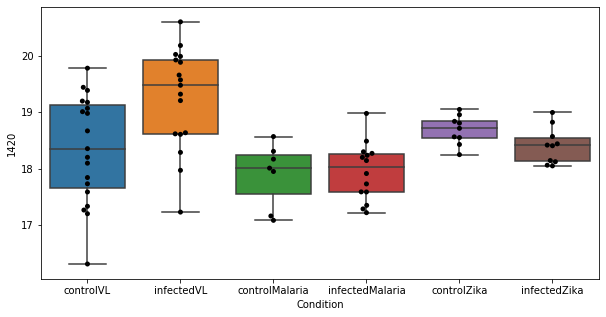

477 row m/z                                                         84.0443
row retention time                                              11.8824
p-val                                                          0.870547
adj.P.Val                                                      0.999793
custom_id                                                            44
compound_names        L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydro...
Name: 44, dtype: object


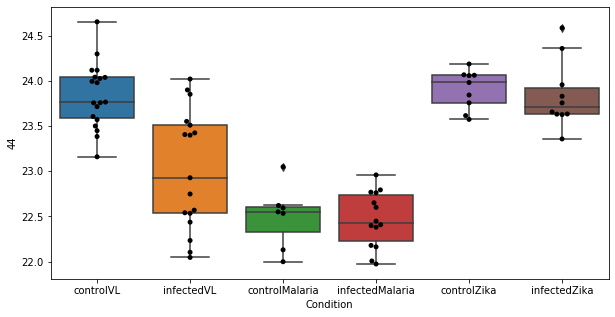

478 row m/z                151.097
row retention time      6.6976
p-val                 0.870851
adj.P.Val             0.999793
custom_id                  765
compound_names             NaN
Name: 765, dtype: object


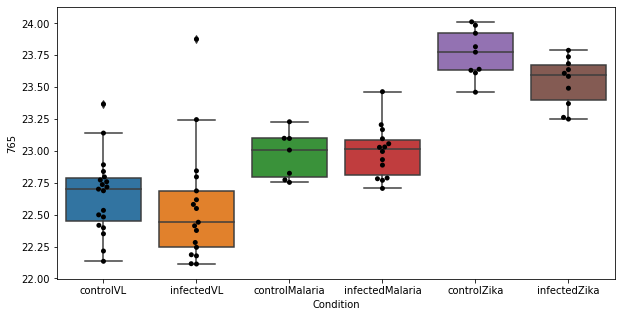

479 row m/z                160.133
row retention time     7.38486
p-val                  0.87153
adj.P.Val             0.999793
custom_id                  904
compound_names             NaN
Name: 904, dtype: object


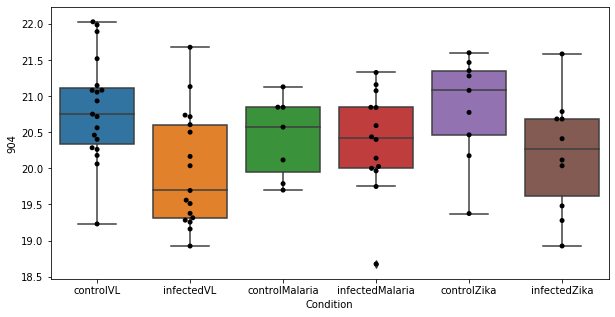

480 row m/z                287.222
row retention time     3.33673
p-val                  0.87161
adj.P.Val             0.999793
custom_id                 2304
compound_names             NaN
Name: 2304, dtype: object


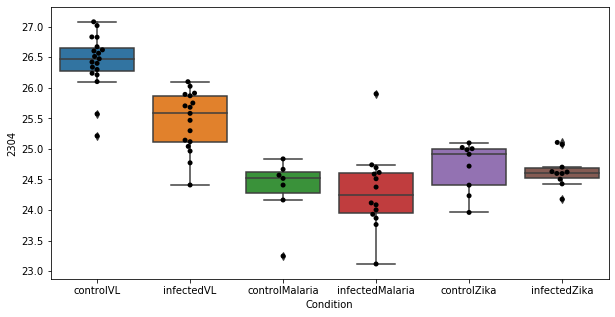

481 row m/z                                                          131.09
row retention time                                              9.51152
p-val                                                          0.872264
adj.P.Val                                                      0.999793
custom_id                                                           444
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 444, dtype: object


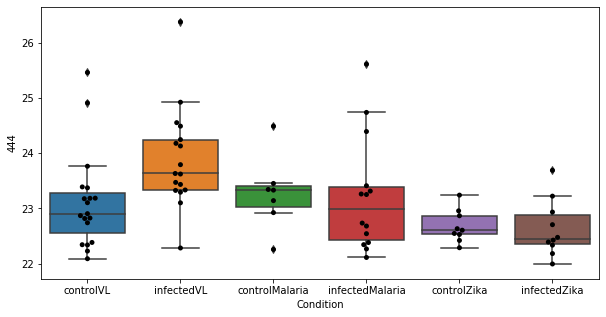

482 row m/z                                                         86.0964
row retention time                                              9.24833
p-val                                                          0.873211
adj.P.Val                                                      0.999793
custom_id                                                            60
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 60, dtype: object


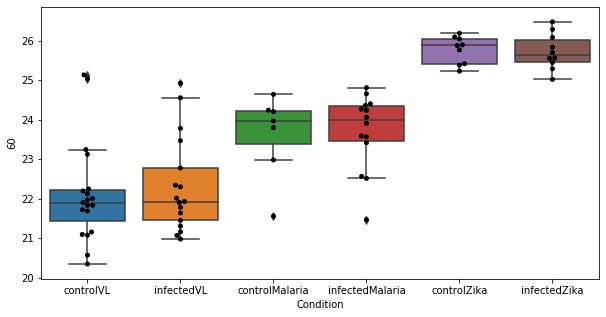

483 row m/z                                                         156.102
row retention time                                              6.71109
p-val                                                          0.873366
adj.P.Val                                                      0.999793
custom_id                                                           827
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 827, dtype: object


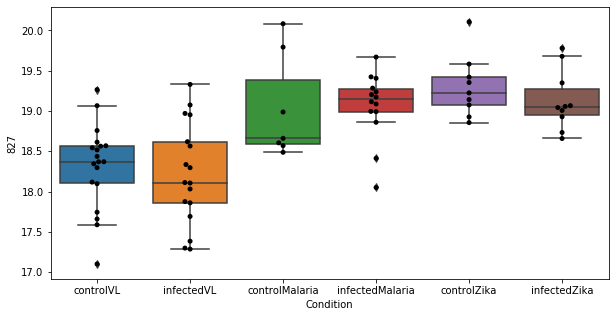

484 row m/z                                                         130.086
row retention time                                              9.51388
p-val                                                          0.873923
adj.P.Val                                                      0.999793
custom_id                                                           421
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 421, dtype: object


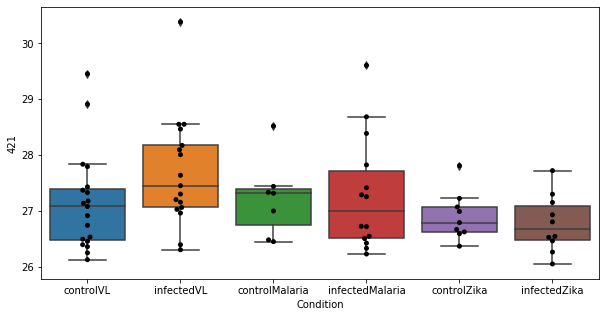

485 row m/z                166.053
row retention time     10.8401
p-val                 0.875237
adj.P.Val             0.999793
custom_id                  976
compound_names             NaN
Name: 976, dtype: object


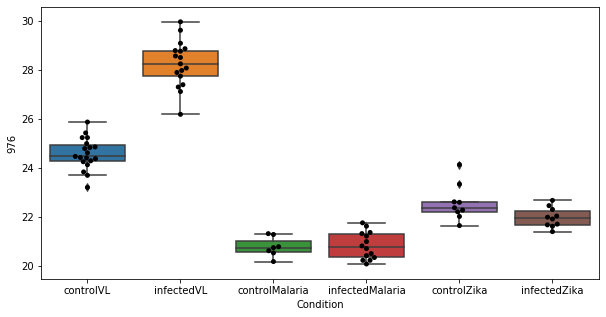

486 row m/z                187.096
row retention time     4.38444
p-val                 0.875631
adj.P.Val             0.999793
custom_id                 1251
compound_names             NaN
Name: 1251, dtype: object


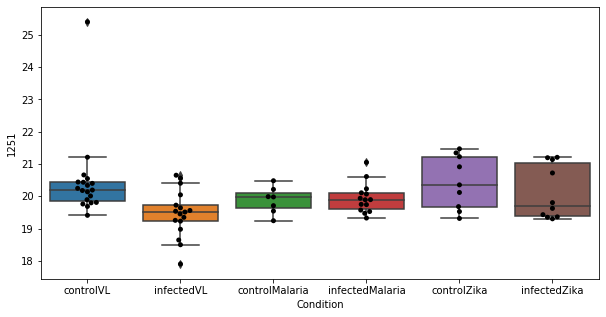

487 row m/z                                                         180.066
row retention time                                              4.60253
p-val                                                          0.877417
adj.P.Val                                                      0.999793
custom_id                                                          4782
compound_names        3,4-Dihydroxy-L-phenylalanine; L-Dopa; 3-Hydro...
Name: 4782, dtype: object


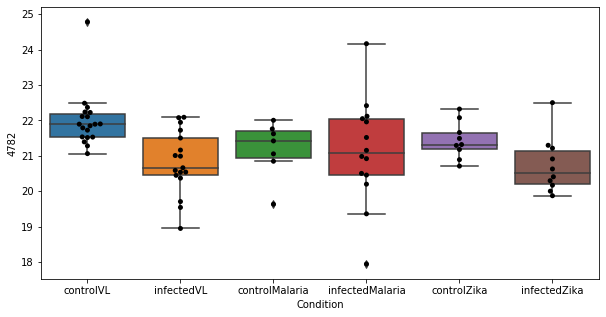

488 row m/z                171.076
row retention time     11.8928
p-val                 0.877676
adj.P.Val             0.999793
custom_id                 1044
compound_names             NaN
Name: 1044, dtype: object


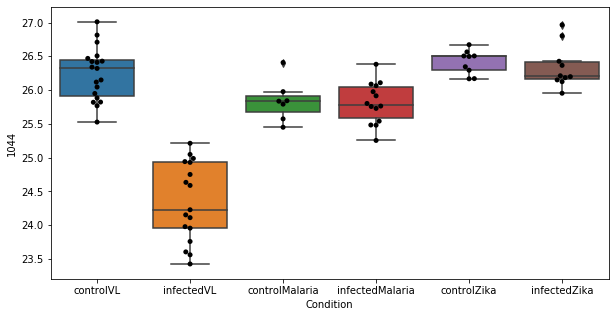

489 row m/z                118.052
row retention time     10.4173
p-val                 0.878176
adj.P.Val             0.999793
custom_id                  271
compound_names             NaN
Name: 271, dtype: object


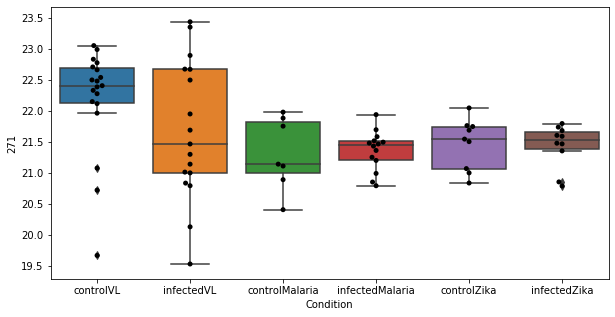

490 row m/z                196.154
row retention time      4.3551
p-val                 0.879965
adj.P.Val             0.999793
custom_id                 1383
compound_names             NaN
Name: 1383, dtype: object


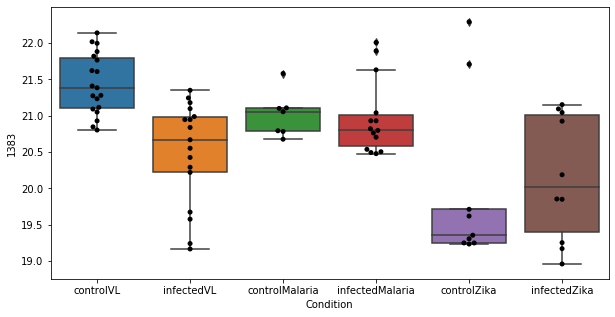

491 row m/z                784.584
row retention time     3.19568
p-val                 0.880195
adj.P.Val             0.999793
custom_id                 3012
compound_names             NaN
Name: 3012, dtype: object


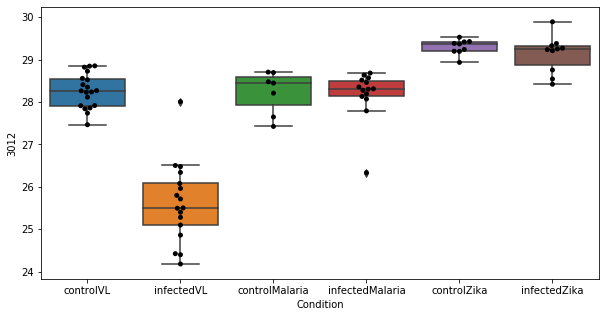

492 row m/z                                                          118.05
row retention time                                              9.11566
p-val                                                          0.880998
adj.P.Val                                                      0.999793
custom_id                                                           269
compound_names        2-Amino-3-oxobutanoate; 2-Amino-acetoacetate$L...
Name: 269, dtype: object


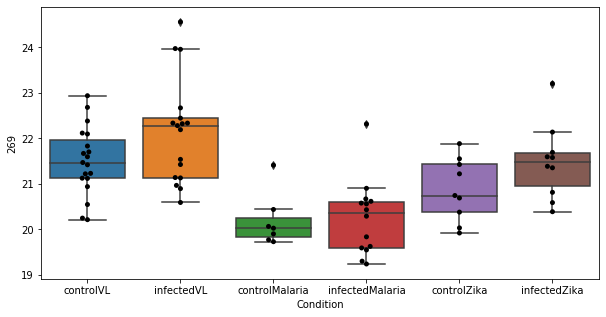

493 row m/z                186.113
row retention time     4.38939
p-val                 0.881636
adj.P.Val             0.999793
custom_id                 1232
compound_names             NaN
Name: 1232, dtype: object


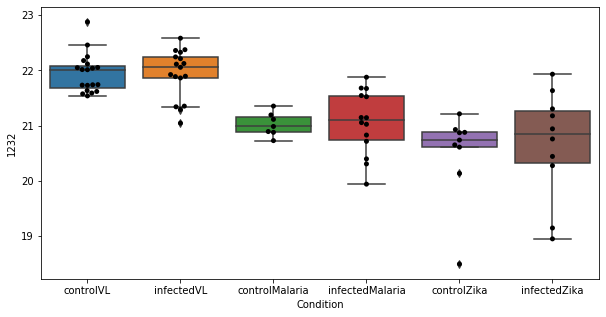

494 row m/z                 191.04
row retention time     11.9114
p-val                 0.881909
adj.P.Val             0.999793
custom_id                 1297
compound_names             NaN
Name: 1297, dtype: object


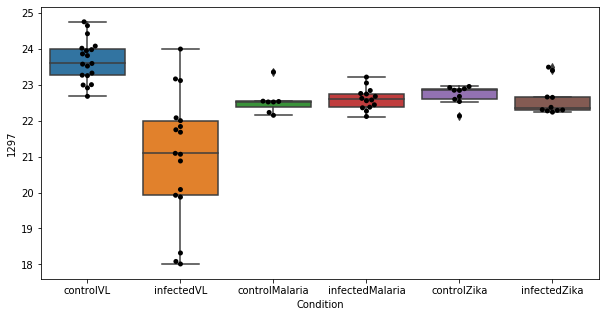

495 row m/z                                                         202.107
row retention time                                              6.71214
p-val                                                          0.882074
adj.P.Val                                                      0.999793
custom_id                                                          1443
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1443, dtype: object


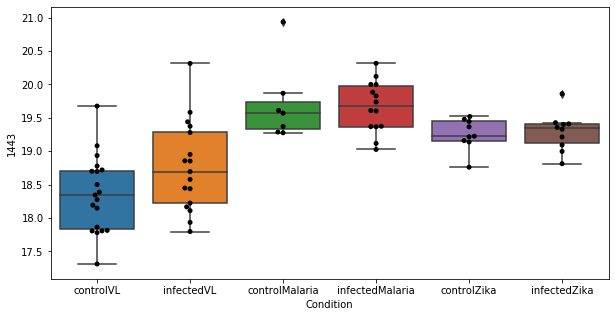

496 row m/z                                                        202.107
row retention time                                             4.37692
p-val                                                         0.883154
adj.P.Val                                                     0.999793
custom_id                                                         1447
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1447, dtype: object


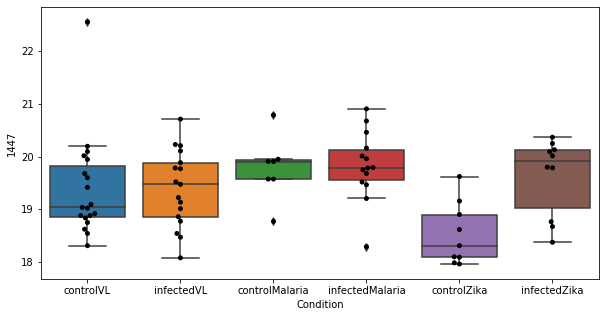

497 row m/z                260.185
row retention time     6.71453
p-val                 0.883772
adj.P.Val             0.999793
custom_id                 2101
compound_names             NaN
Name: 2101, dtype: object


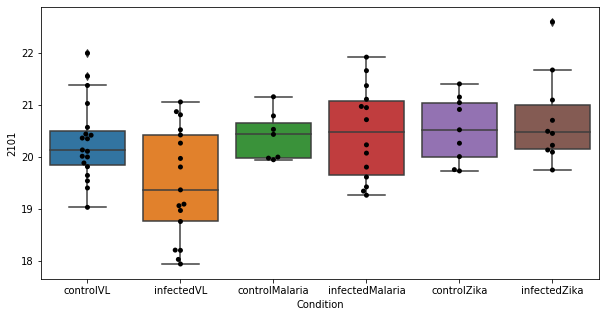

498 row m/z                                                         150.058
row retention time                                              6.72035
p-val                                                          0.884664
adj.P.Val                                                      0.999793
custom_id                                                           747
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 747, dtype: object


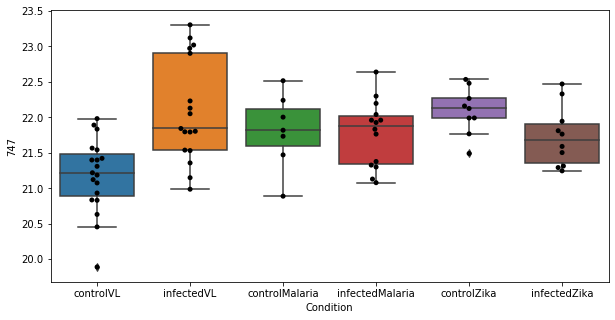

499 row m/z                118.075
row retention time     10.5768
p-val                 0.886639
adj.P.Val             0.999793
custom_id                  278
compound_names             NaN
Name: 278, dtype: object


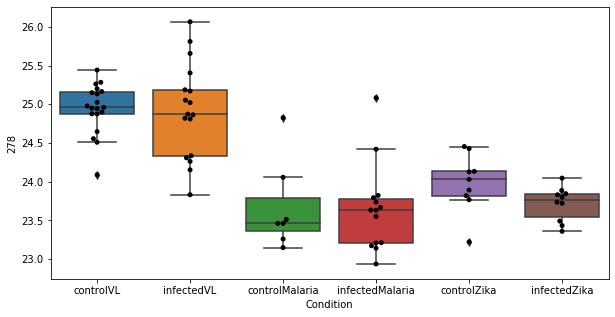

500 row m/z                145.097
row retention time     11.1439
p-val                 0.888677
adj.P.Val             0.999793
custom_id                  645
compound_names             NaN
Name: 645, dtype: object


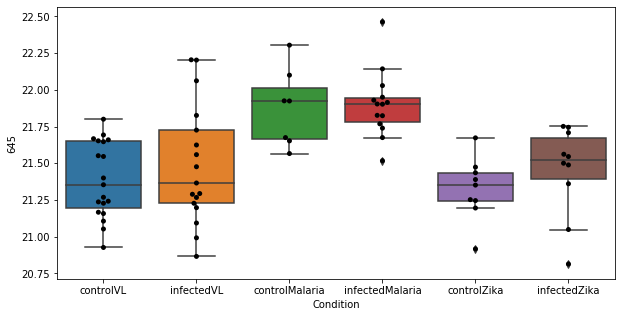

501 row m/z                314.232
row retention time     6.71001
p-val                 0.888896
adj.P.Val             0.999793
custom_id                 2452
compound_names             NaN
Name: 2452, dtype: object


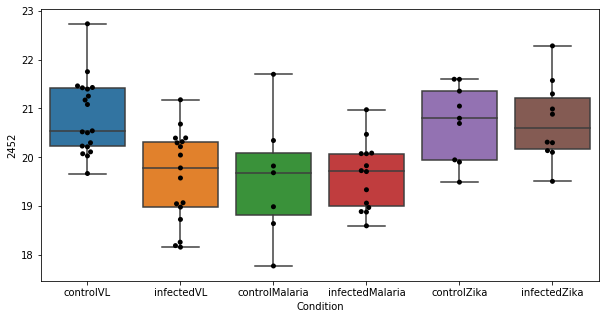

502 row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.889901
adj.P.Val                                                      0.999793
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object


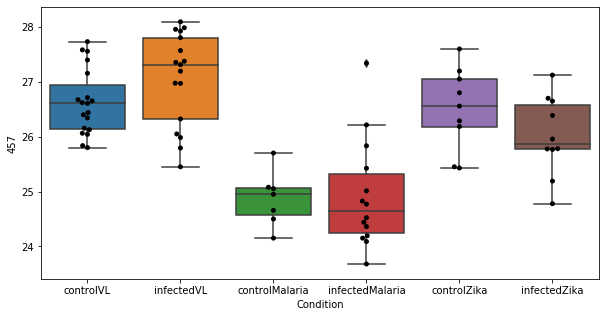

503 row m/z                180.159
row retention time     3.79938
p-val                 0.890864
adj.P.Val             0.999793
custom_id                 1165
compound_names             NaN
Name: 1165, dtype: object


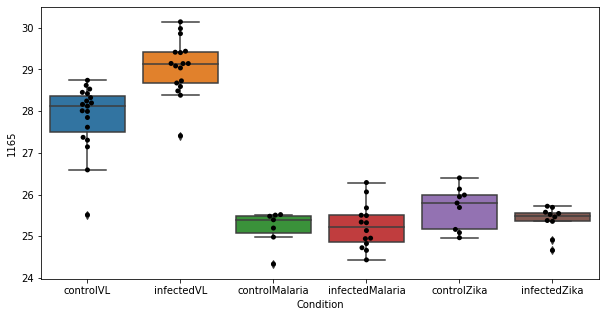

504 row m/z                148.097
row retention time     9.10577
p-val                 0.890917
adj.P.Val             0.999793
custom_id                  716
compound_names             NaN
Name: 716, dtype: object


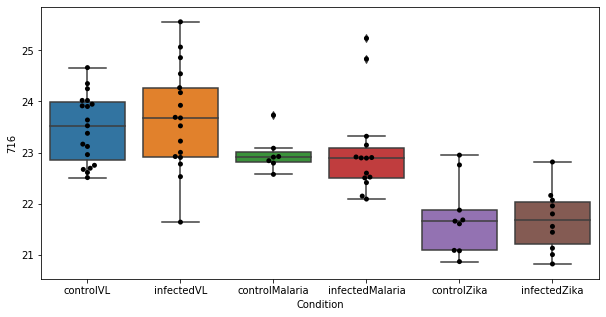

505 row m/z                133.074
row retention time     11.6911
p-val                   0.8924
adj.P.Val             0.999793
custom_id                  476
compound_names             NaN
Name: 476, dtype: object


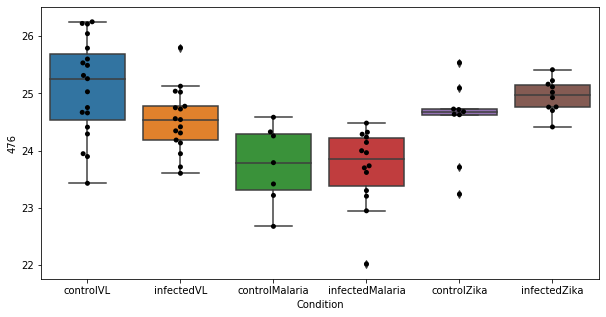

506 row m/z                275.103
row retention time     4.73098
p-val                 0.892781
adj.P.Val             0.999793
custom_id                 2207
compound_names             NaN
Name: 2207, dtype: object


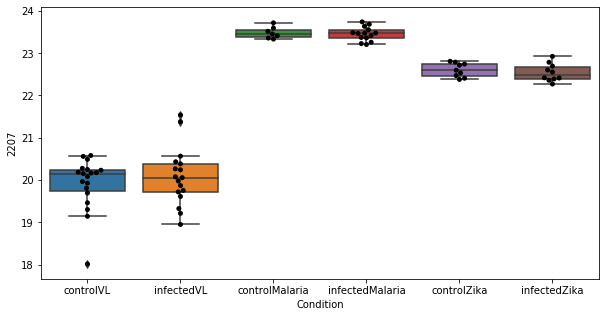

507 row m/z                 246.17
row retention time     6.86309
p-val                 0.894201
adj.P.Val             0.999793
custom_id                 1963
compound_names             NaN
Name: 1963, dtype: object


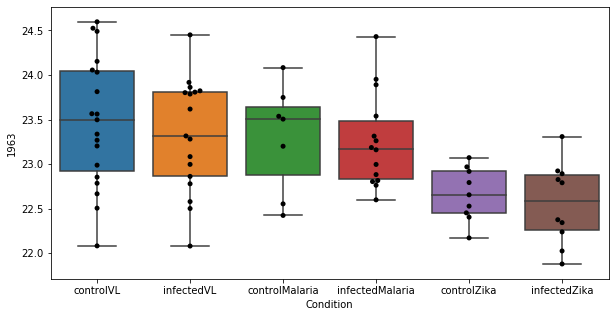

508 row m/z                149.117
row retention time     4.01666
p-val                 0.894446
adj.P.Val             0.999793
custom_id                  733
compound_names             NaN
Name: 733, dtype: object


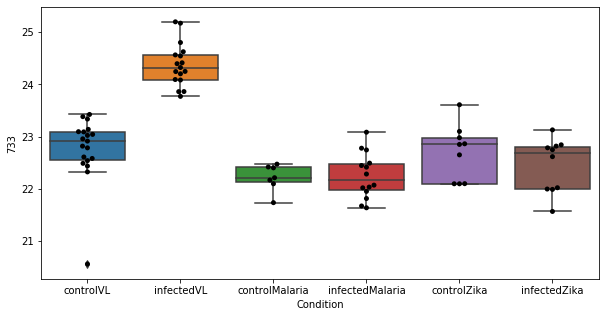

509 row m/z                                                          119.09
row retention time                                              10.4076
p-val                                                          0.894466
adj.P.Val                                                      0.999793
custom_id                                                           298
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 298, dtype: object


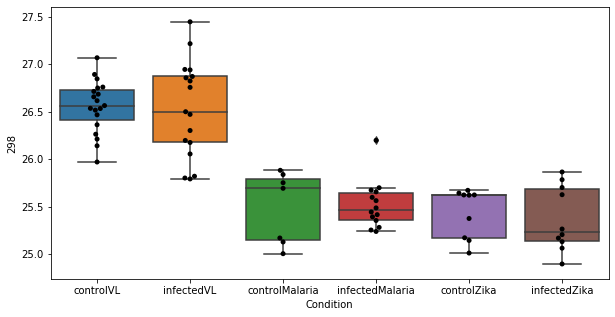

510 row m/z                342.264
row retention time     4.15032
p-val                 0.895293
adj.P.Val             0.999793
custom_id                 2542
compound_names             NaN
Name: 2542, dtype: object


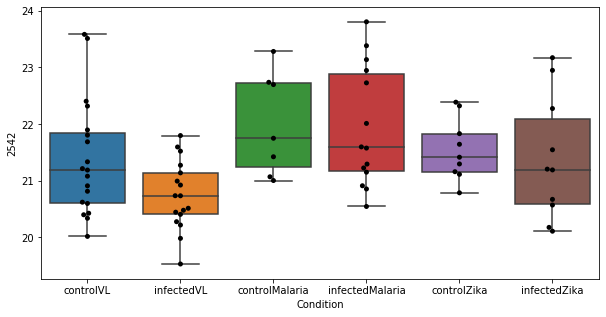

511 row m/z                 217.13
row retention time     11.6414
p-val                 0.896142
adj.P.Val             0.999793
custom_id                 1652
compound_names             NaN
Name: 1652, dtype: object


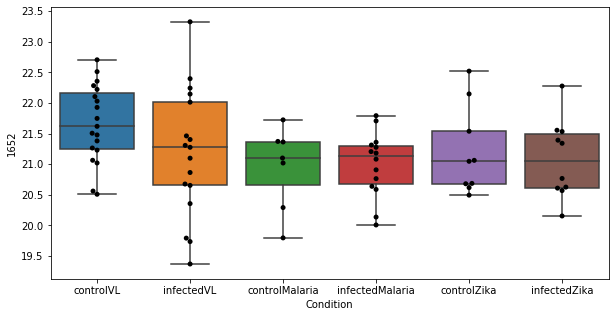

512 row m/z                                                         148.097
row retention time                                              10.1861
p-val                                                          0.897284
adj.P.Val                                                      0.999793
custom_id                                                           714
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 714, dtype: object


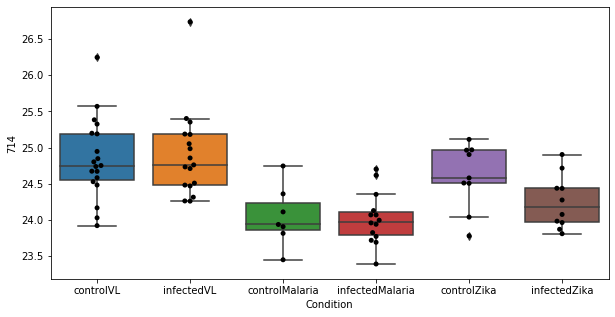

513 row m/z                186.113
row retention time     9.39741
p-val                 0.897622
adj.P.Val             0.999793
custom_id                 1234
compound_names             NaN
Name: 1234, dtype: object


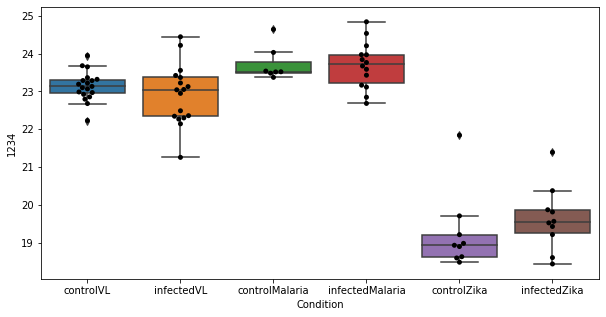

514 row m/z                 268.14
row retention time     9.21841
p-val                  0.89981
adj.P.Val             0.999793
custom_id                 2155
compound_names             NaN
Name: 2155, dtype: object


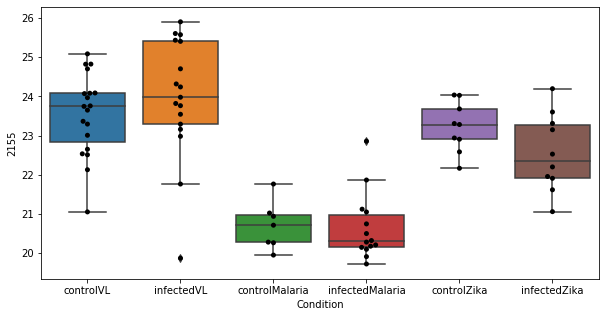

515 row m/z                314.232
row retention time     4.36989
p-val                 0.900925
adj.P.Val             0.999793
custom_id                 2451
compound_names             NaN
Name: 2451, dtype: object


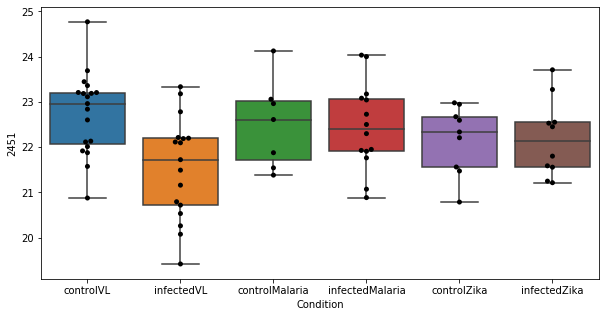

516 row m/z                                                          133.08
row retention time                                              11.6908
p-val                                                          0.903054
adj.P.Val                                                      0.999793
custom_id                                                           477
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 477, dtype: object


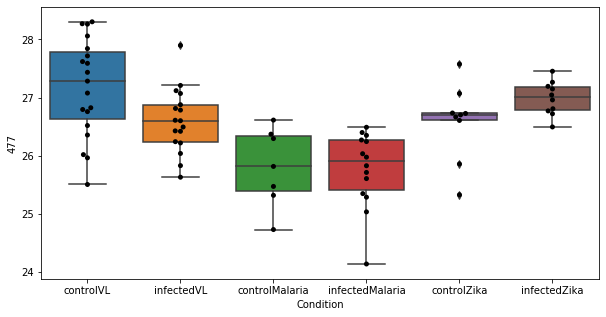

517 row m/z                131.082
row retention time     11.7969
p-val                 0.903847
adj.P.Val             0.999793
custom_id                  442
compound_names             NaN
Name: 442, dtype: object


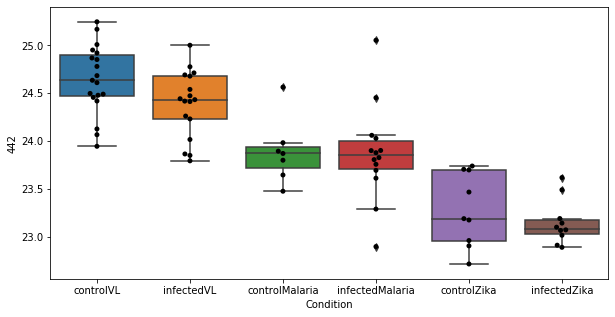

518 row m/z                164.136
row retention time     3.80014
p-val                 0.904306
adj.P.Val             0.999793
custom_id                  953
compound_names             NaN
Name: 953, dtype: object


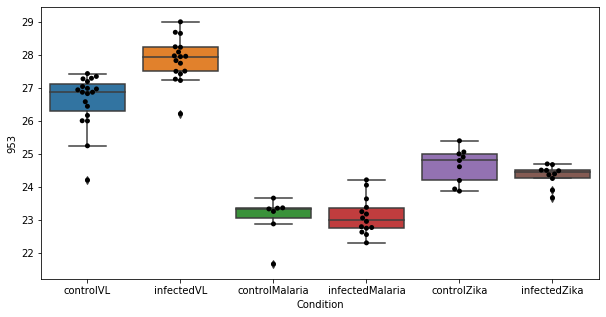

519 row m/z                                                         115.087
row retention time                                              9.18132
p-val                                                          0.905854
adj.P.Val                                                      0.999793
custom_id                                                           245
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 245, dtype: object


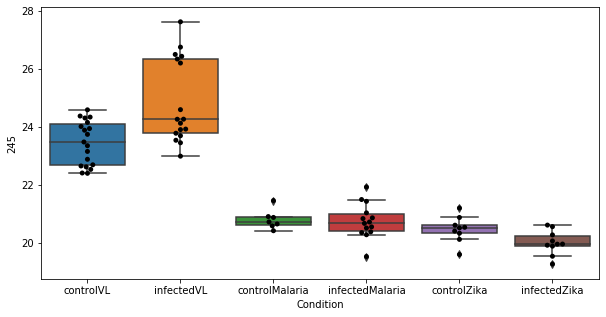

520 row m/z                327.158
row retention time     10.5766
p-val                 0.909018
adj.P.Val             0.999793
custom_id                 2495
compound_names             NaN
Name: 2495, dtype: object


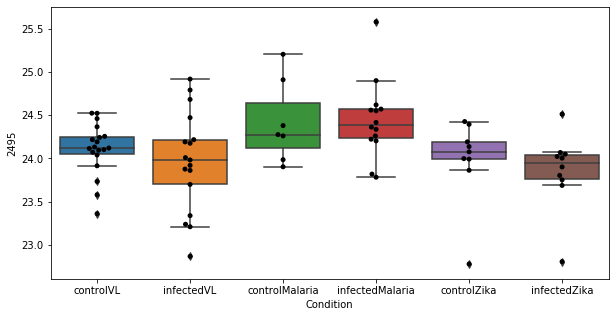

521 row m/z                195.123
row retention time     4.40422
p-val                 0.909306
adj.P.Val             0.999793
custom_id                 1372
compound_names             NaN
Name: 1372, dtype: object


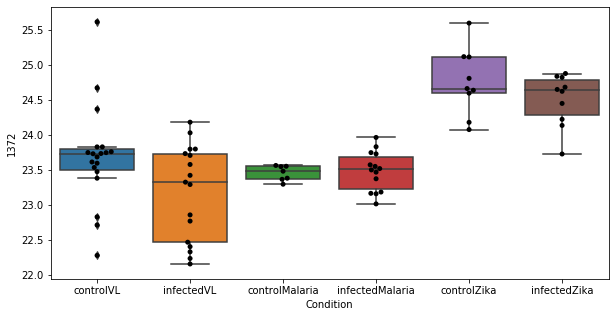

522 row m/z                305.252
row retention time     3.34847
p-val                 0.910408
adj.P.Val             0.999793
custom_id                 2402
compound_names             NaN
Name: 2402, dtype: object


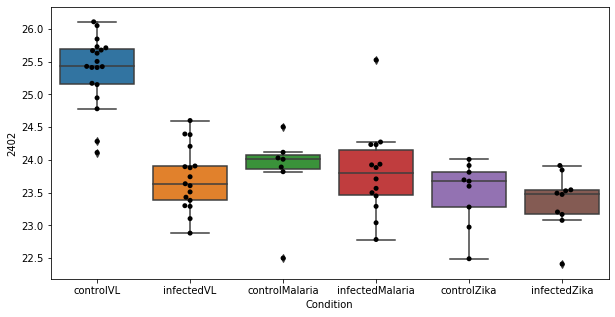

523 row m/z                117.074
row retention time     10.5785
p-val                 0.910499
adj.P.Val             0.999793
custom_id                  264
compound_names             NaN
Name: 264, dtype: object


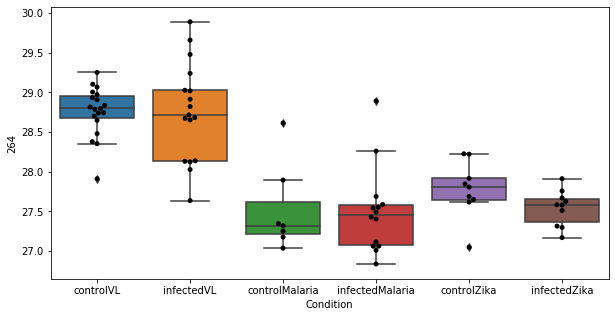

524 row m/z                183.078
row retention time     3.60118
p-val                  0.91054
adj.P.Val             0.999793
custom_id                 1187
compound_names             NaN
Name: 1187, dtype: object


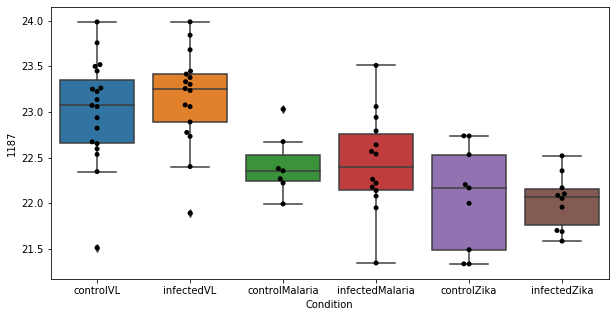

525 row m/z                663.453
row retention time     3.07059
p-val                 0.912567
adj.P.Val             0.999793
custom_id                 2896
compound_names             NaN
Name: 2896, dtype: object


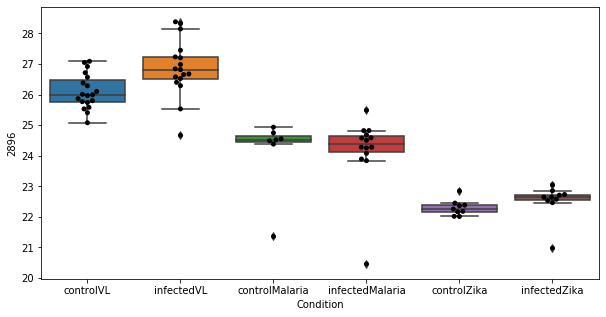

526 row m/z                251.185
row retention time     3.75476
p-val                 0.913179
adj.P.Val             0.999793
custom_id                 2017
compound_names             NaN
Name: 2017, dtype: object


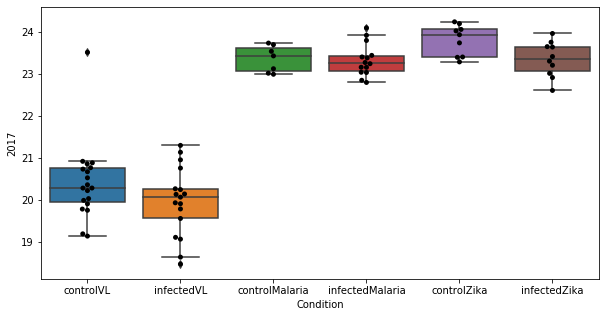

527 row m/z                286.201
row retention time     4.39654
p-val                 0.914499
adj.P.Val             0.999793
custom_id                 2296
compound_names             NaN
Name: 2296, dtype: object


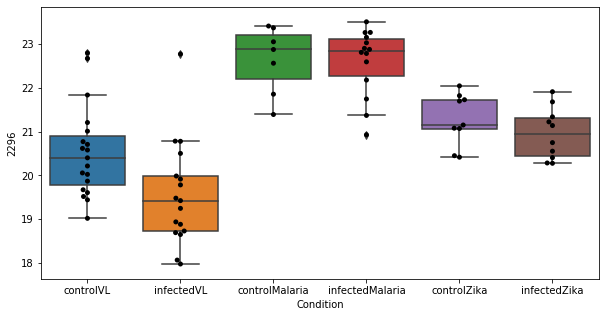

528 row m/z                                                         284.197
row retention time                                              6.69722
p-val                                                          0.914633
adj.P.Val                                                      0.999793
custom_id                                                          2275
compound_names        3(S),8(S)-dihydroxy-6E,10Z-hexadecadienoate$3(...
Name: 2275, dtype: object


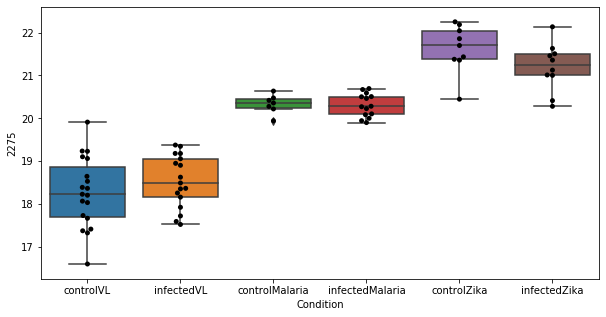

529 row m/z                                 328.162
row retention time                      10.5872
p-val                                  0.915038
adj.P.Val                              0.999793
custom_id                                  2501
compound_names        5'-carboxy-gama-chromanol
Name: 2501, dtype: object


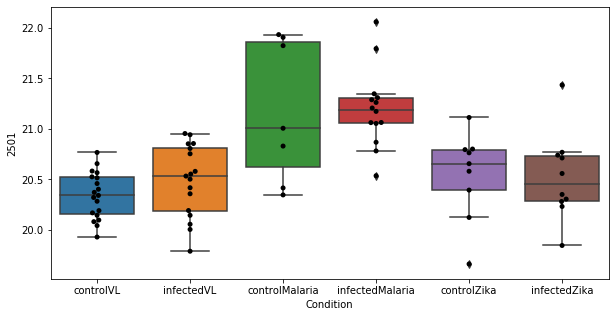

530 row m/z                675.543
row retention time     3.46379
p-val                  0.91546
adj.P.Val             0.999793
custom_id                 2904
compound_names             NaN
Name: 2904, dtype: object


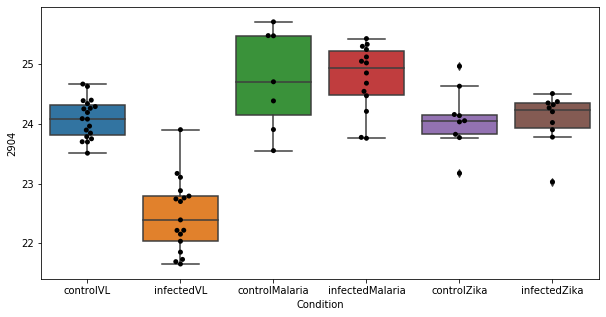

531 row m/z                731.606
row retention time     3.37124
p-val                 0.916212
adj.P.Val             0.999793
custom_id                 2936
compound_names             NaN
Name: 2936, dtype: object


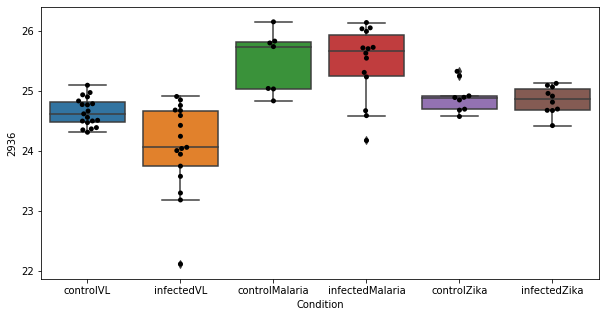

532 row m/z                      198.113
row retention time           6.71449
p-val                       0.918649
adj.P.Val                   0.999793
custom_id                       1397
compound_names        L-Metanephrine
Name: 1397, dtype: object


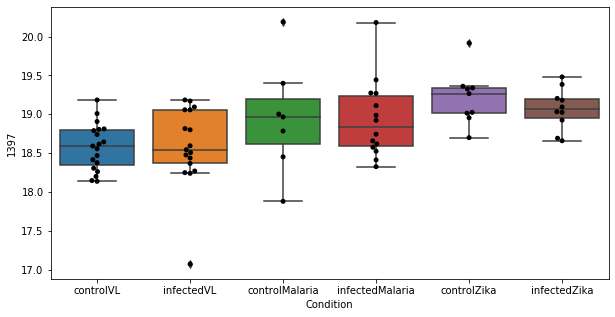

533 row m/z                                                         181.072
row retention time                                              6.70373
p-val                                                          0.918813
adj.P.Val                                                      0.999793
custom_id                                                          1174
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1174, dtype: object


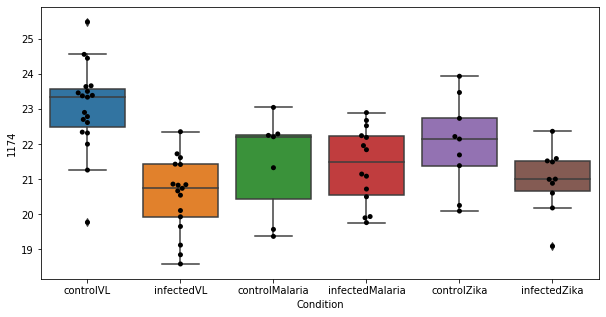

534 row m/z                                                         133.069
row retention time                                              11.5737
p-val                                                           0.92127
adj.P.Val                                                      0.999793
custom_id                                                           475
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 475, dtype: object


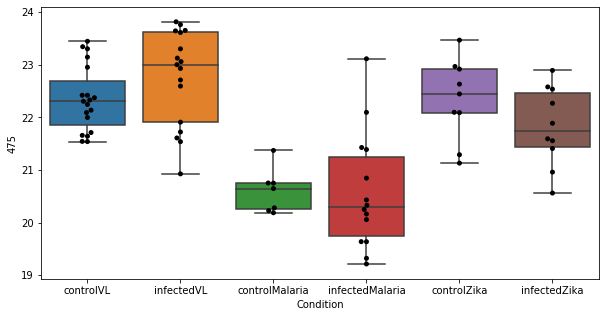

535 row m/z                597.509
row retention time     3.00226
p-val                 0.924278
adj.P.Val             0.999793
custom_id                 2857
compound_names             NaN
Name: 2857, dtype: object


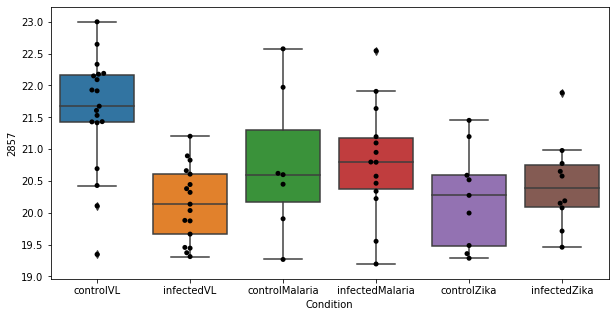

536 row m/z                          189.123
row retention time               10.4352
p-val                           0.925348
adj.P.Val                       0.999793
custom_id                           1281
compound_names        N6-Acetyl-L-lysine
Name: 1281, dtype: object


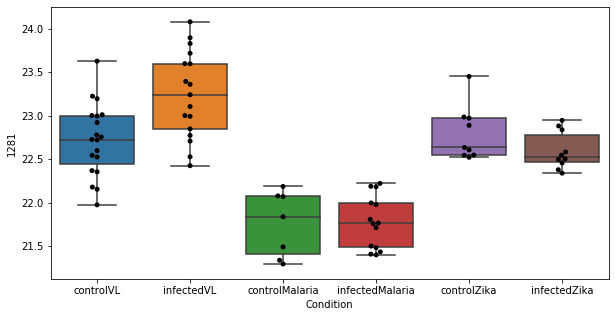

537 row m/z                           288.217
row retention time                4.38402
p-val                            0.925818
adj.P.Val                        0.999793
custom_id                            2308
compound_names        L-Octanoylcarnitine
Name: 2308, dtype: object


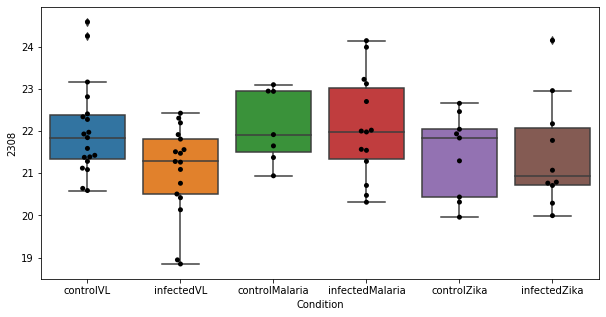

538 row m/z                                                         132.066
row retention time                                              8.34178
p-val                                                          0.925882
adj.P.Val                                                      0.999793
custom_id                                                           458
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 458, dtype: object


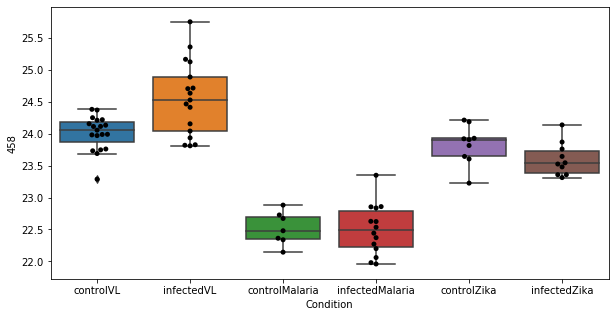

539 row m/z                163.133
row retention time     3.79947
p-val                 0.926674
adj.P.Val             0.999793
custom_id                  938
compound_names             NaN
Name: 938, dtype: object


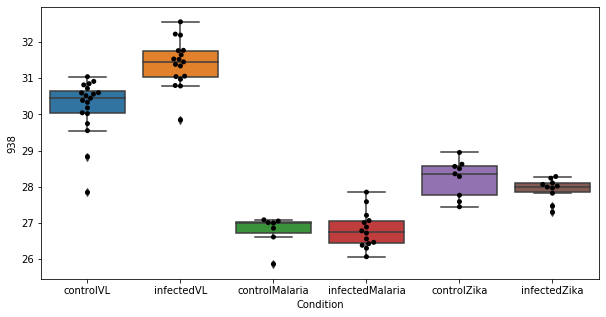

540 row m/z                164.029
row retention time        11.6
p-val                 0.928701
adj.P.Val             0.999793
custom_id                  945
compound_names             NaN
Name: 945, dtype: object


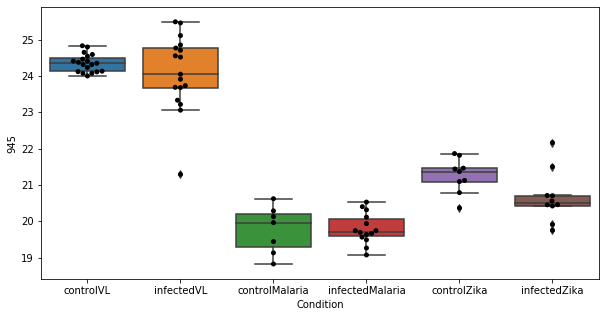

541 row m/z                275.103
row retention time     11.8913
p-val                 0.929171
adj.P.Val             0.999793
custom_id                 2205
compound_names             NaN
Name: 2205, dtype: object


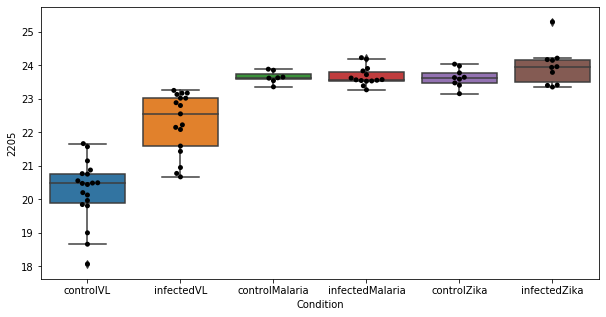

542 row m/z                                                         144.102
row retention time                                              6.70776
p-val                                                          0.929258
adj.P.Val                                                      0.999793
custom_id                                                           634
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 634, dtype: object


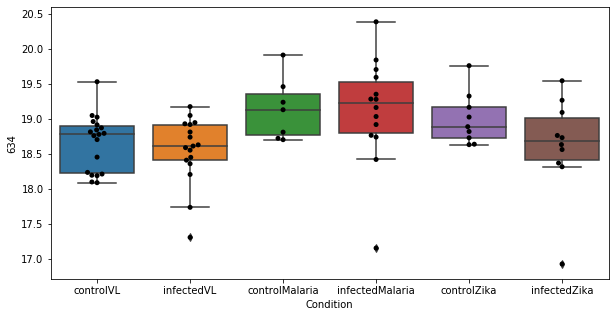

543 row m/z                                                         126.022
row retention time                                              12.2095
p-val                                                          0.929996
adj.P.Val                                                      0.999793
custom_id                                                           371
compound_names        Taurine; 2-Aminoethanesulfonic acid; Aminoethy...
Name: 371, dtype: object


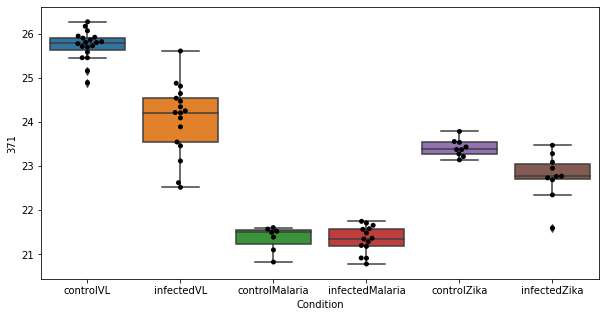

544 row m/z                                      76.0393
row retention time                           12.3886
p-val                                       0.932687
adj.P.Val                                   0.999793
custom_id                                         17
compound_names        Glycine; Aminoacetic acid; Gly
Name: 17, dtype: object


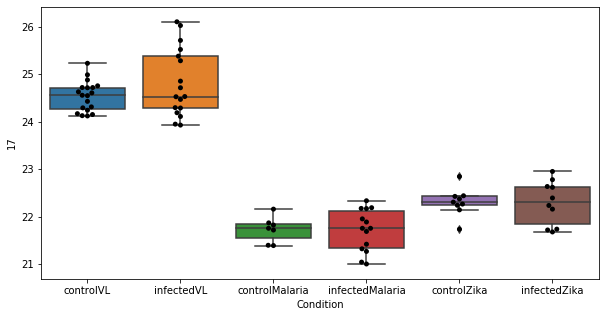

545 row m/z                160.133
row retention time     10.6993
p-val                 0.933814
adj.P.Val             0.999793
custom_id                  903
compound_names             NaN
Name: 903, dtype: object


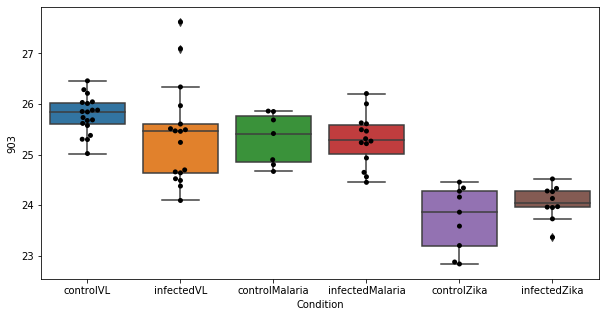

546 row m/z                117.068
row retention time     10.5804
p-val                 0.934244
adj.P.Val             0.999793
custom_id                  263
compound_names             NaN
Name: 263, dtype: object


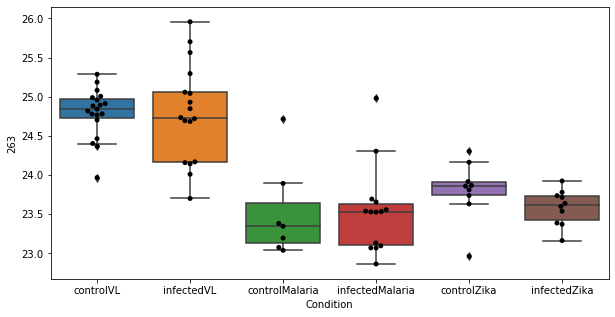

547 row m/z                785.588
row retention time     3.20243
p-val                 0.934572
adj.P.Val             0.999793
custom_id                 3013
compound_names             NaN
Name: 3013, dtype: object


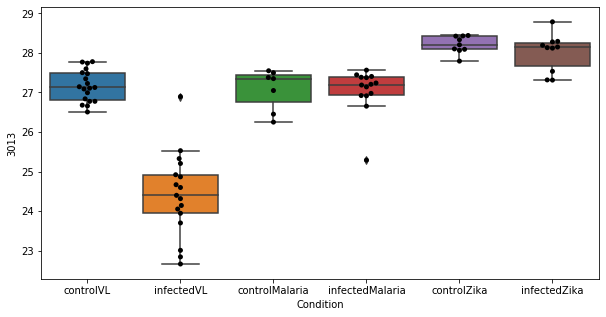

548 row m/z                188.128
row retention time     6.71156
p-val                 0.935817
adj.P.Val             0.999793
custom_id                 1269
compound_names             NaN
Name: 1269, dtype: object


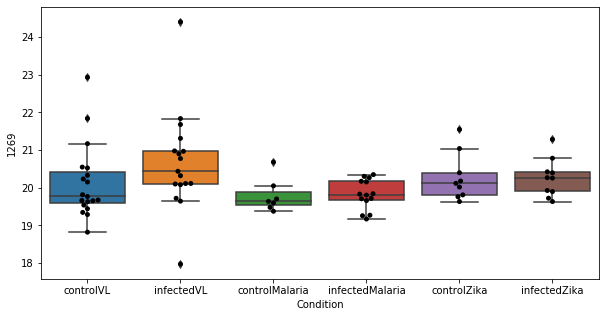

549 row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object


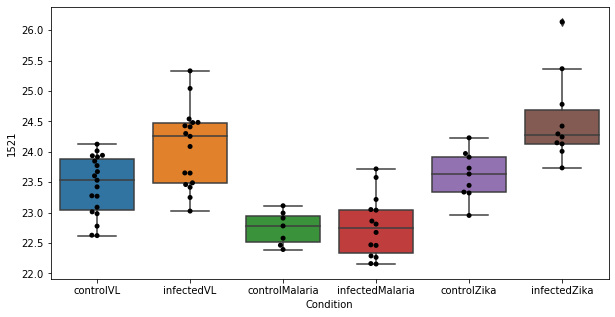

550 row m/z                701.559
row retention time     3.42053
p-val                 0.936575
adj.P.Val             0.999793
custom_id                 2916
compound_names             NaN
Name: 2916, dtype: object


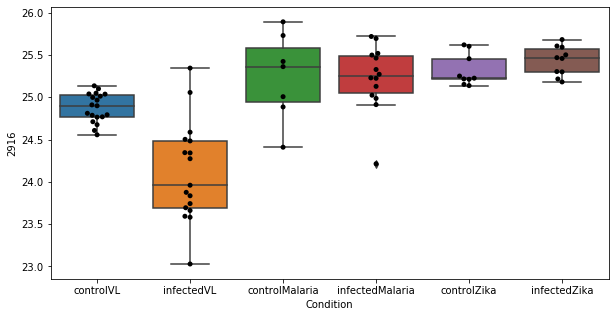

551 row m/z                158.154
row retention time     3.61479
p-val                 0.937181
adj.P.Val             0.999793
custom_id                  868
compound_names             NaN
Name: 868, dtype: object


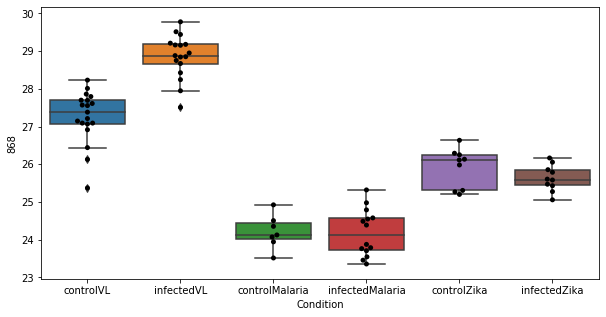

552 row m/z                                                         166.086
row retention time                                              6.71471
p-val                                                          0.938878
adj.P.Val                                                      0.999793
custom_id                                                           984
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 984, dtype: object


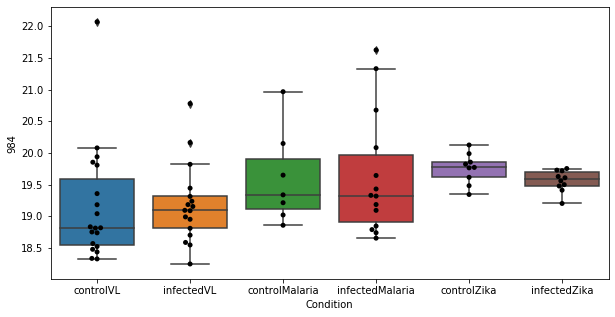

553 row m/z                207.113
row retention time     8.85047
p-val                 0.939069
adj.P.Val             0.999793
custom_id                 1508
compound_names             NaN
Name: 1508, dtype: object


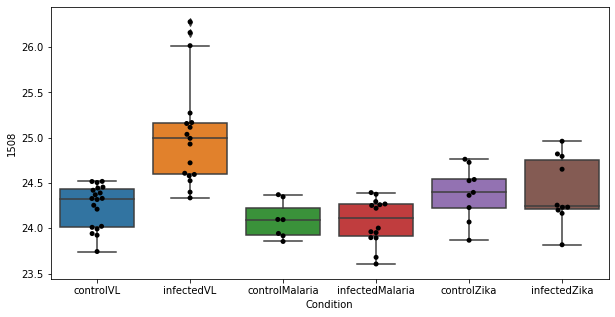

554 row m/z                 217.18
row retention time     3.49689
p-val                 0.939111
adj.P.Val             0.999793
custom_id                 1653
compound_names             NaN
Name: 1653, dtype: object


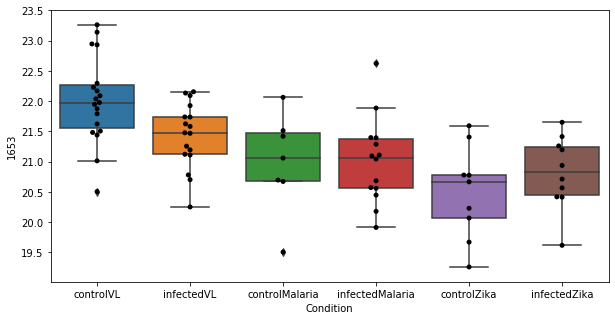

555 row m/z                212.149
row retention time     4.40798
p-val                 0.939479
adj.P.Val             0.999793
custom_id                 1575
compound_names             NaN
Name: 1575, dtype: object


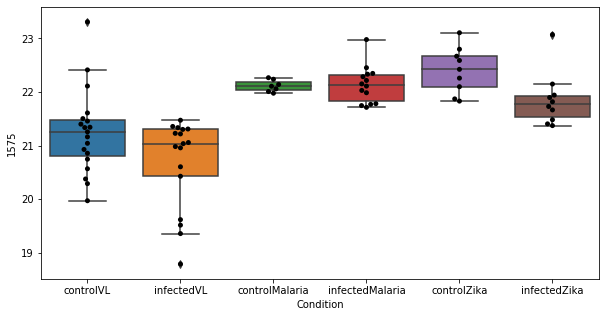

556 row m/z                                                         91.0583
row retention time                                               11.794
p-val                                                          0.939794
adj.P.Val                                                      0.999793
custom_id                                                            88
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 88, dtype: object


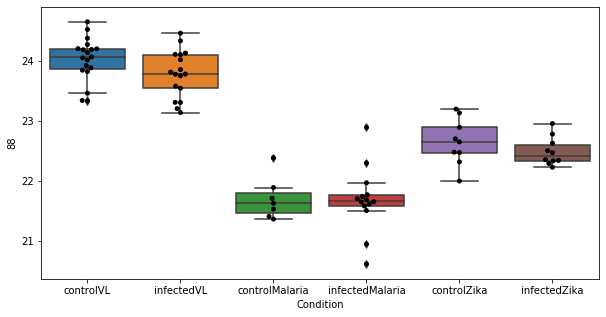

557 row m/z                225.149
row retention time     3.59688
p-val                 0.941103
adj.P.Val             0.999793
custom_id                 1734
compound_names             NaN
Name: 1734, dtype: object


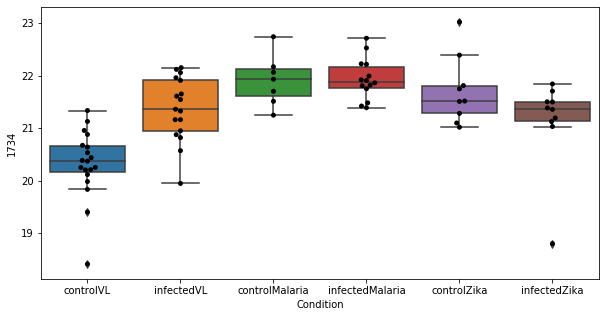

558 row m/z                262.144
row retention time     6.68582
p-val                 0.943313
adj.P.Val             0.999793
custom_id                 2117
compound_names             NaN
Name: 2117, dtype: object


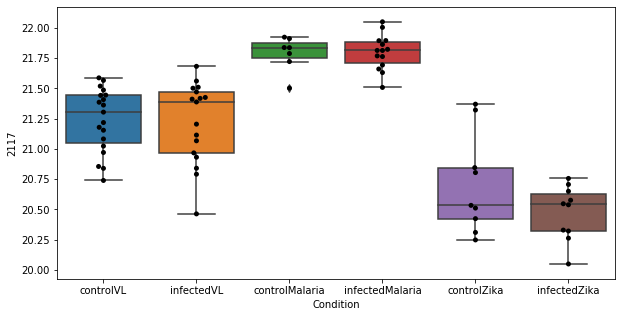

559 row m/z                                                         187.097
row retention time                                              6.70945
p-val                                                          0.945186
adj.P.Val                                                      0.999793
custom_id                                                          1252
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1252, dtype: object


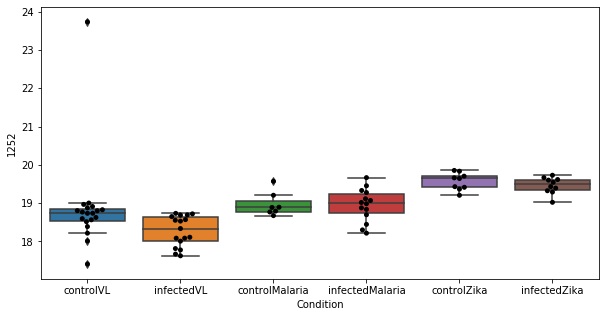

560 row m/z                                              213
row retention time                               10.8052
p-val                                           0.945347
adj.P.Val                                       0.999793
custom_id                                           1583
compound_names        Oxalosuccinate; Oxalosuccinic acid
Name: 1583, dtype: object


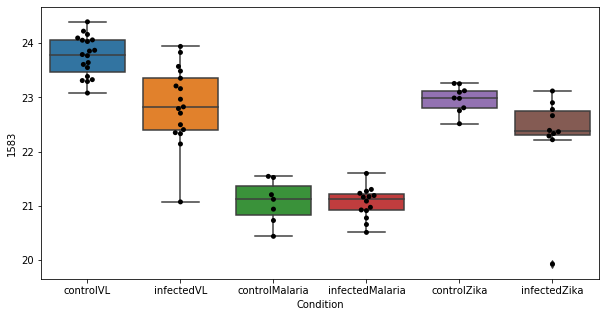

561 row m/z                129.127
row retention time     3.49848
p-val                 0.946198
adj.P.Val             0.999793
custom_id                  401
compound_names             NaN
Name: 401, dtype: object


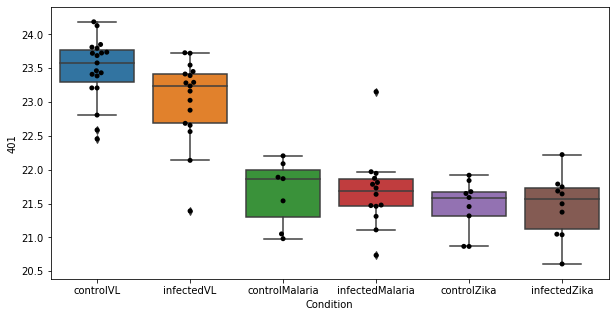

562 row m/z                                                157.097
row retention time                                     10.5789
p-val                                                  0.94756
adj.P.Val                                             0.999793
custom_id                                                  848
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 848, dtype: object


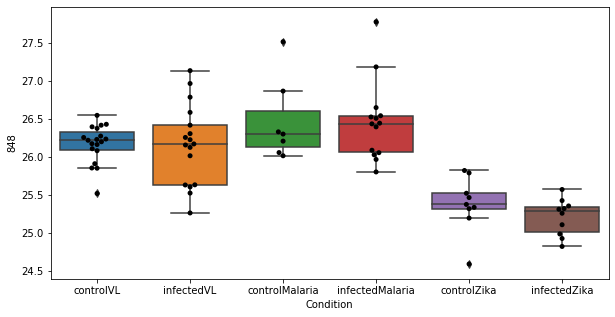

563 row m/z                                                         171.096
row retention time                                              10.5261
p-val                                                          0.948921
adj.P.Val                                                      0.999793
custom_id                                                          1048
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 1048, dtype: object


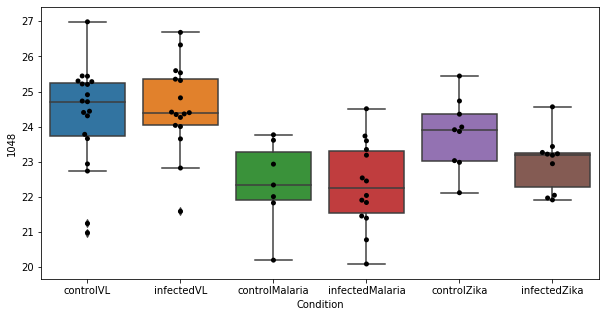

564 row m/z                145.105
row retention time      9.1985
p-val                  0.95241
adj.P.Val             0.999793
custom_id                  650
compound_names             NaN
Name: 650, dtype: object


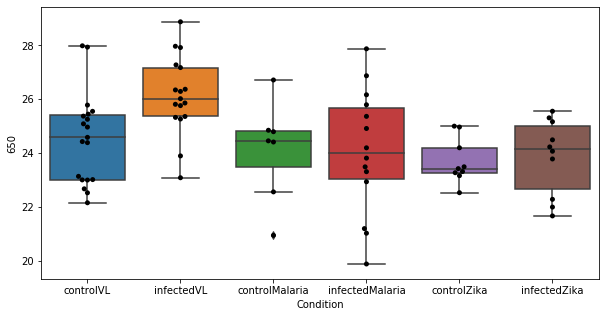

565 row m/z                                                         198.085
row retention time                                              12.4151
p-val                                                          0.952694
adj.P.Val                                                      0.999793
custom_id                                                          1393
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1393, dtype: object


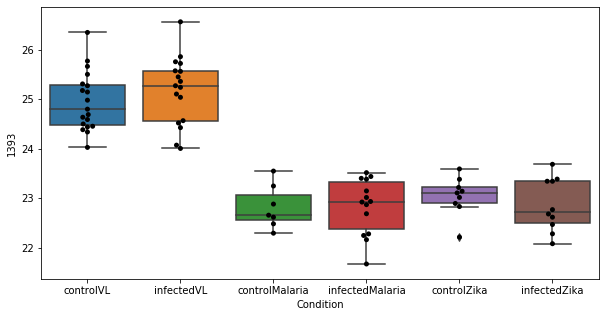

566 row m/z                763.595
row retention time     3.20319
p-val                 0.953824
adj.P.Val             0.999793
custom_id                 2979
compound_names             NaN
Name: 2979, dtype: object


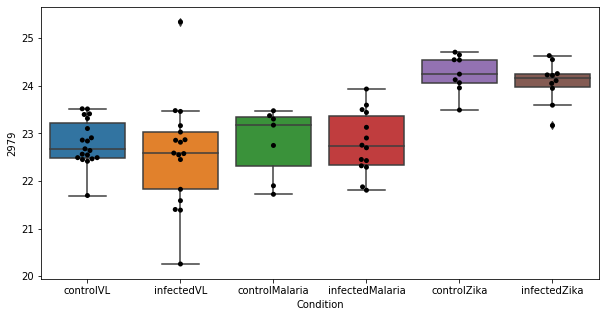

567 row m/z                                                   174.087
row retention time                                         11.518
p-val                                                    0.954064
adj.P.Val                                                0.999793
custom_id                                                    1087
compound_names        N-Methyltyramine$N-Methylphenylethanolamine
Name: 1087, dtype: object


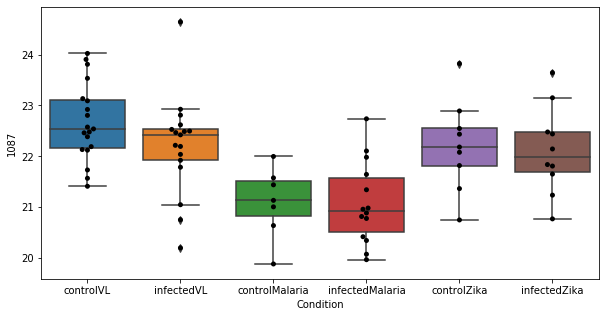

568 row m/z                165.112
row retention time     4.26748
p-val                 0.959929
adj.P.Val             0.999793
custom_id                  963
compound_names             NaN
Name: 963, dtype: object


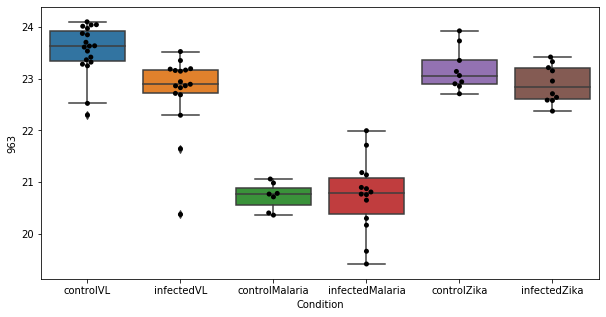

569 row m/z                                                   273.186
row retention time                                        3.45163
p-val                                                    0.960163
adj.P.Val                                                0.999793
custom_id                                                    2187
compound_names        Estradiol-17beta; beta-Estradiol; Estradiol
Name: 2187, dtype: object


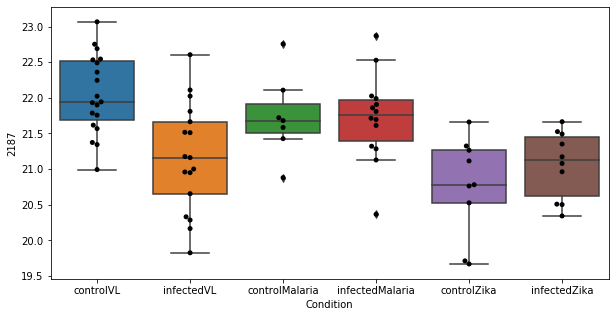

570 row m/z                                                         149.081
row retention time                                              11.9079
p-val                                                          0.961923
adj.P.Val                                                      0.999793
custom_id                                                           731
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 731, dtype: object


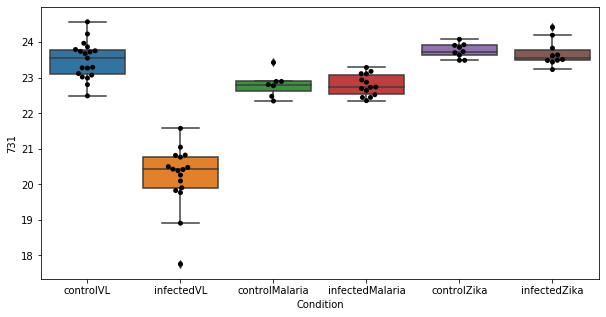

571 row m/z                236.073
row retention time     10.8693
p-val                 0.962319
adj.P.Val             0.999793
custom_id                 5002
compound_names             NaN
Name: 5002, dtype: object


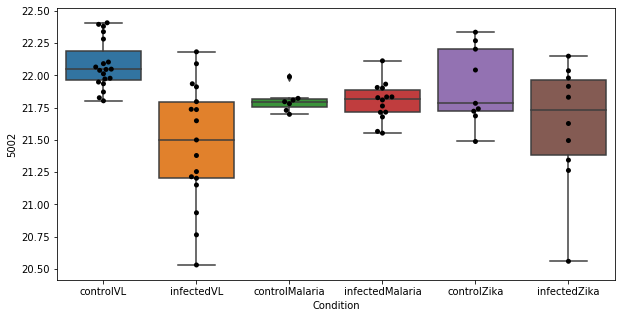

572 row m/z                                                         256.165
row retention time                                              6.70207
p-val                                                          0.963237
adj.P.Val                                                      0.999793
custom_id                                                          2053
compound_names        3-oxo-6(R)-hydroxy-tetradec-8-cis-enoate$3-oxo...
Name: 2053, dtype: object


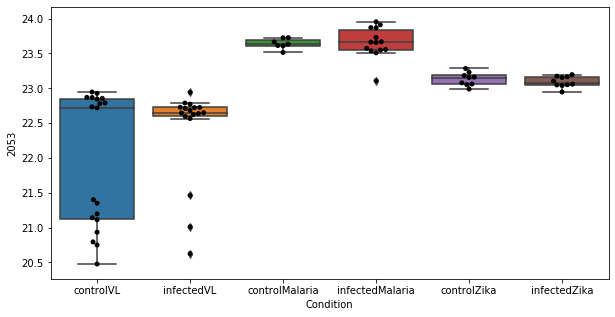

573 row m/z                           218.138
row retention time                 4.2172
p-val                             0.96384
adj.P.Val                        0.999793
custom_id                            1662
compound_names        propionyl-carnitine
Name: 1662, dtype: object


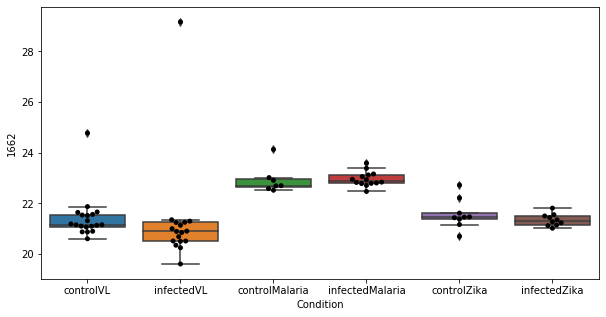

574 row m/z                                                          148.08
row retention time                                              11.9036
p-val                                                          0.967016
adj.P.Val                                                      0.999793
custom_id                                                           713
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 713, dtype: object


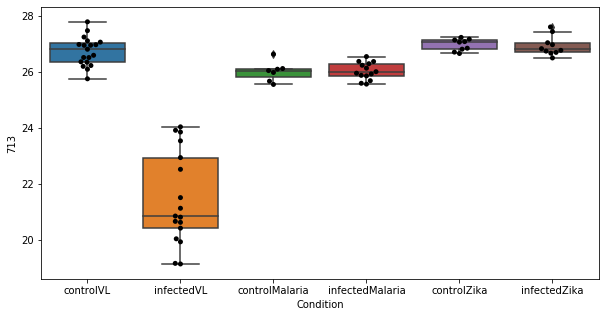

575 row m/z                                                         132.102
row retention time                                              6.70334
p-val                                                          0.967488
adj.P.Val                                                      0.999793
custom_id                                                           463
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 463, dtype: object


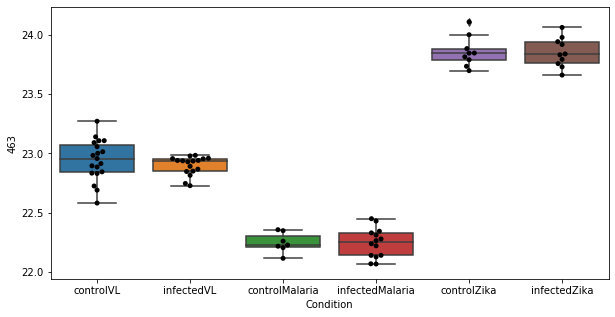

576 row m/z                204.123
row retention time     9.29506
p-val                 0.967848
adj.P.Val             0.999793
custom_id                 1480
compound_names             NaN
Name: 1480, dtype: object


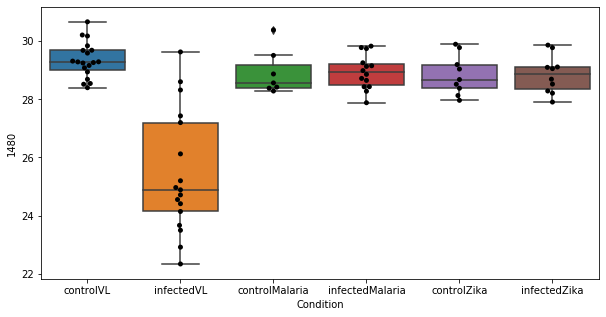

577 row m/z                246.243
row retention time     6.66364
p-val                 0.970096
adj.P.Val             0.999793
custom_id                 1969
compound_names             NaN
Name: 1969, dtype: object


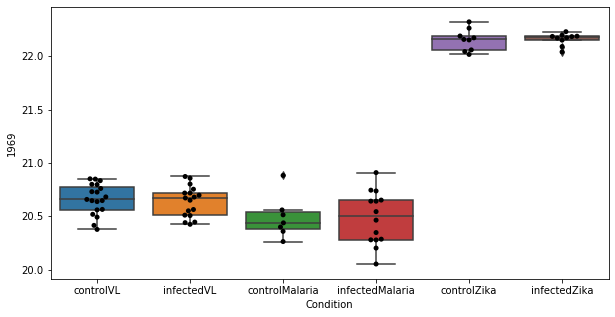

578 row m/z                                                          127.05
row retention time                                              10.0612
p-val                                                          0.970497
adj.P.Val                                                      0.999793
custom_id                                                           372
compound_names        Thymine; 5-Methyluracil$Imidazole-4-acetate; I...
Name: 372, dtype: object


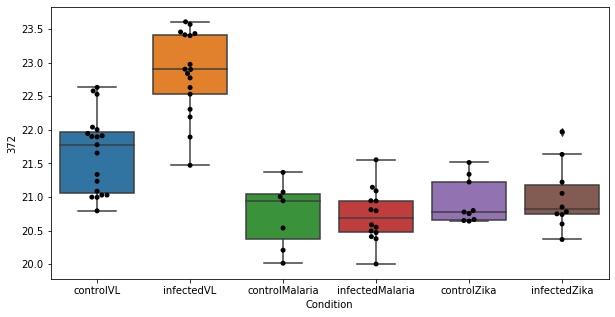

579 row m/z                219.019
row retention time     10.5758
p-val                 0.971113
adj.P.Val             0.999793
custom_id                 1680
compound_names             NaN
Name: 1680, dtype: object


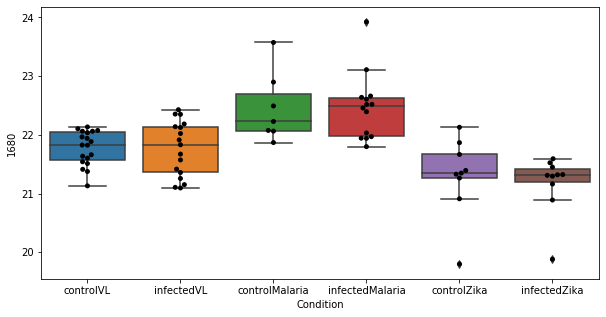

580 row m/z                                                          130.05
row retention time                                              11.8903
p-val                                                          0.971117
adj.P.Val                                                      0.999793
custom_id                                                           410
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 410, dtype: object


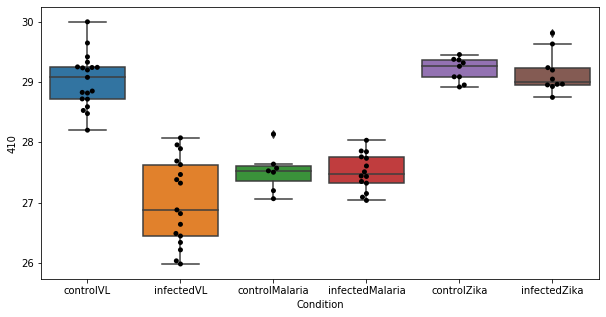

581 row m/z                230.158
row retention time      10.551
p-val                 0.971943
adj.P.Val             0.999793
custom_id                 3874
compound_names             NaN
Name: 3874, dtype: object


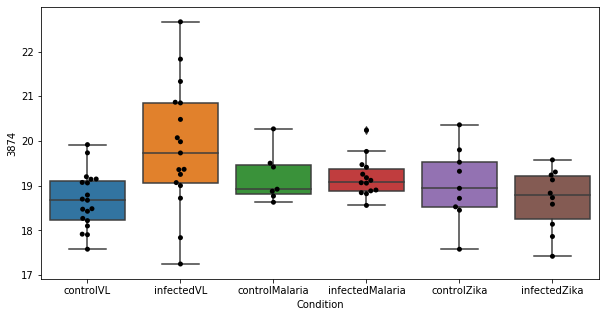

582 row m/z                769.593
row retention time      3.1881
p-val                 0.972295
adj.P.Val             0.999793
custom_id                 2989
compound_names             NaN
Name: 2989, dtype: object


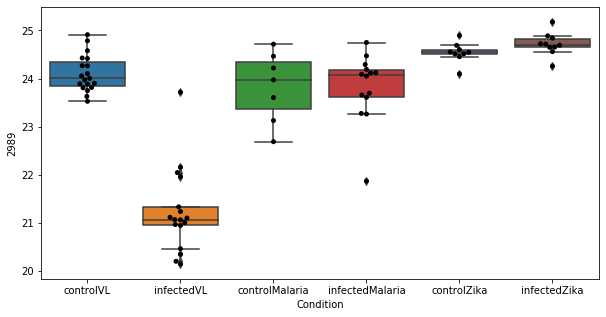

583 row m/z                254.026
row retention time     10.7961
p-val                  0.97278
adj.P.Val             0.999793
custom_id                 2044
compound_names             NaN
Name: 2044, dtype: object


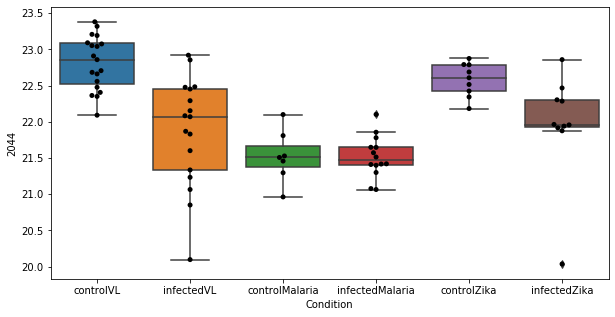

584 row m/z                                                         147.076
row retention time                                              11.9052
p-val                                                          0.974901
adj.P.Val                                                      0.999793
custom_id                                                           689
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 689, dtype: object


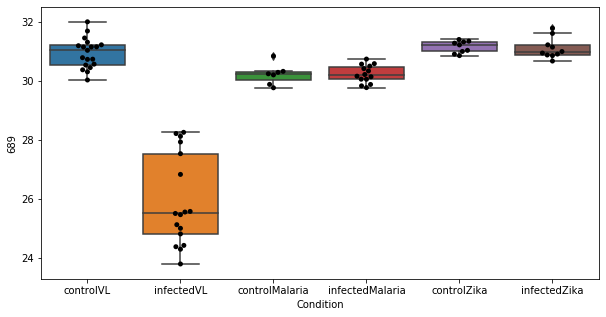

585 row m/z                144.102
row retention time     9.19626
p-val                 0.975215
adj.P.Val             0.999793
custom_id                  631
compound_names             NaN
Name: 631, dtype: object


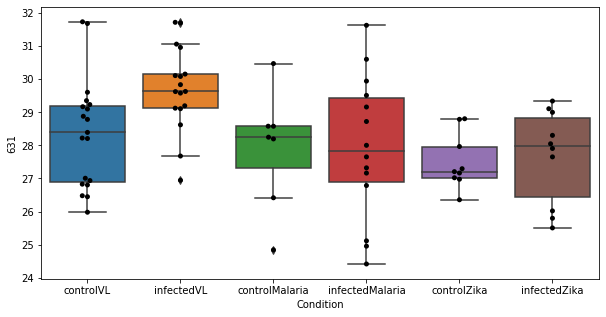

586 row m/z                 264.18
row retention time      3.4916
p-val                 0.976238
adj.P.Val             0.999793
custom_id                 2136
compound_names             NaN
Name: 2136, dtype: object


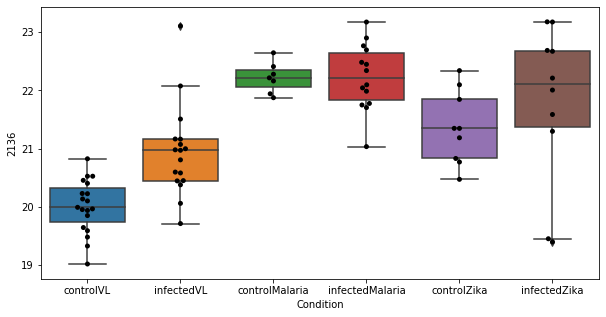

587 row m/z                744.589
row retention time     3.20892
p-val                 0.978092
adj.P.Val             0.999793
custom_id                 2955
compound_names             NaN
Name: 2955, dtype: object


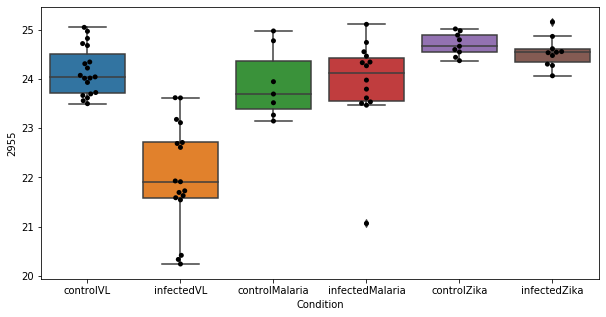

588 row m/z                213.022
row retention time     11.9045
p-val                 0.978099
adj.P.Val             0.999793
custom_id                 1584
compound_names             NaN
Name: 1584, dtype: object


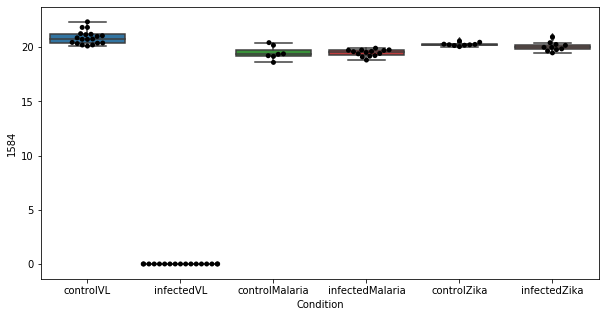

589 row m/z                209.154
row retention time     3.60987
p-val                 0.979855
adj.P.Val             0.999793
custom_id                 1531
compound_names             NaN
Name: 1531, dtype: object


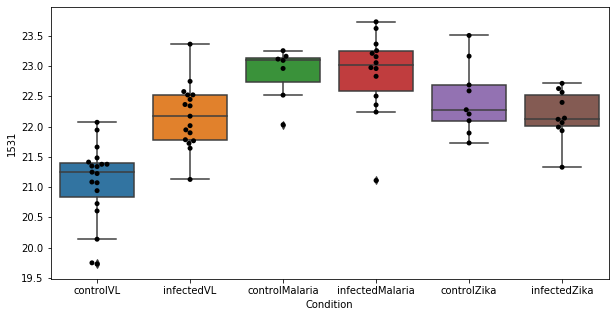

590 row m/z                767.577
row retention time     3.19097
p-val                 0.983457
adj.P.Val             0.999793
custom_id                 2985
compound_names             NaN
Name: 2985, dtype: object


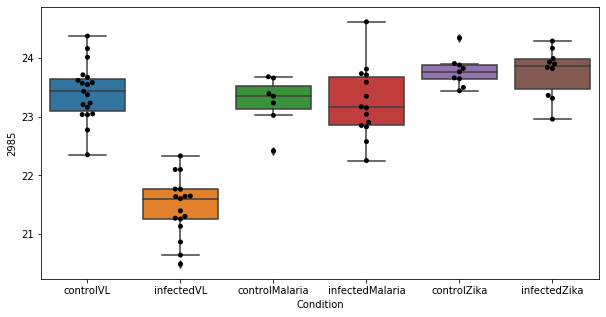

591 row m/z                                                         148.073
row retention time                                              11.9154
p-val                                                          0.985053
adj.P.Val                                                      0.999793
custom_id                                                           712
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 712, dtype: object


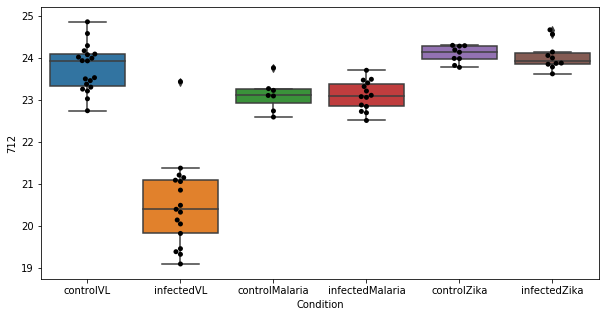

592 row m/z                                                          235.08
row retention time                                              11.8551
p-val                                                          0.986255
adj.P.Val                                                      0.999793
custom_id                                                          1854
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1854, dtype: object


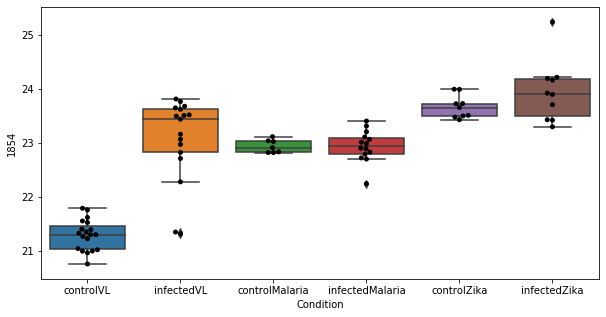

593 row m/z                 344.28
row retention time     4.10462
p-val                 0.986814
adj.P.Val             0.999793
custom_id                 2550
compound_names             NaN
Name: 2550, dtype: object


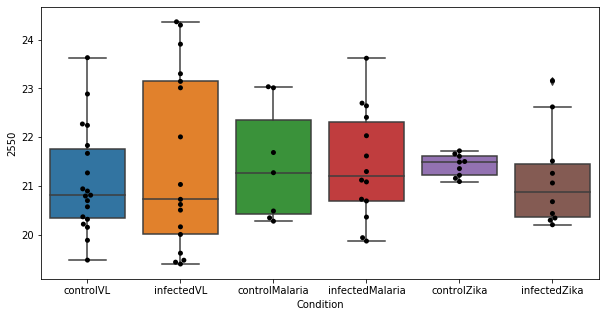

594 row m/z                235.119
row retention time      6.7165
p-val                 0.987362
adj.P.Val             0.999793
custom_id                 1858
compound_names             NaN
Name: 1858, dtype: object


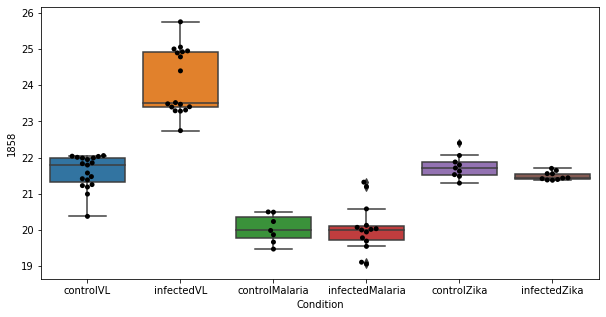

595 row m/z                118.077
row retention time      10.578
p-val                 0.988685
adj.P.Val             0.999793
custom_id                  279
compound_names             NaN
Name: 279, dtype: object


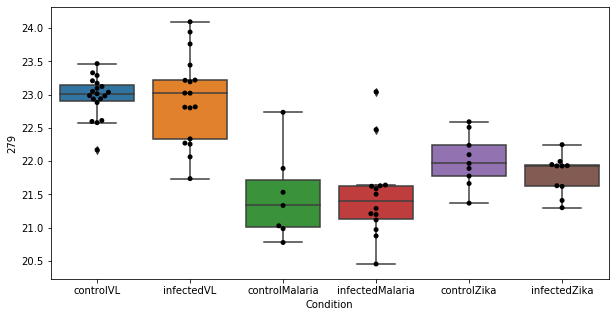

596 row m/z                                                         151.048
row retention time                                              11.8722
p-val                                                          0.988694
adj.P.Val                                                      0.999793
custom_id                                                           757
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 757, dtype: object


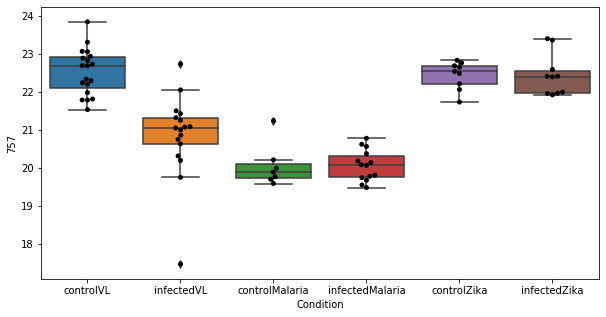

597 row m/z                304.212
row retention time     6.72258
p-val                 0.993405
adj.P.Val             0.999793
custom_id                 2396
compound_names             NaN
Name: 2396, dtype: object


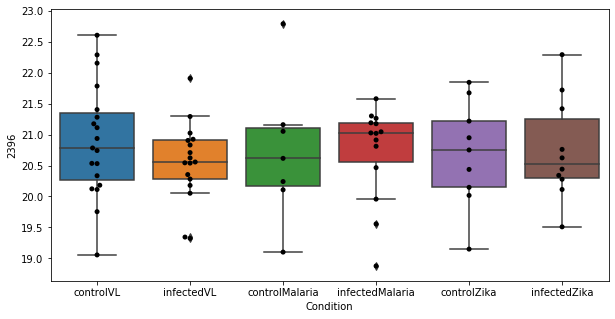

598 row m/z                205.126
row retention time      9.2928
p-val                 0.994335
adj.P.Val             0.999793
custom_id                 1503
compound_names             NaN
Name: 1503, dtype: object


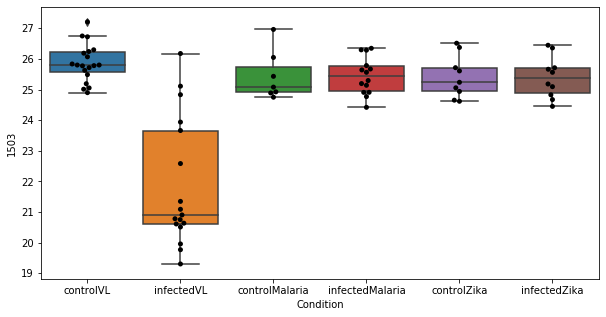

599 row m/z                114.066
row retention time     11.6879
p-val                 0.994362
adj.P.Val             0.999793
custom_id                  230
compound_names             NaN
Name: 230, dtype: object


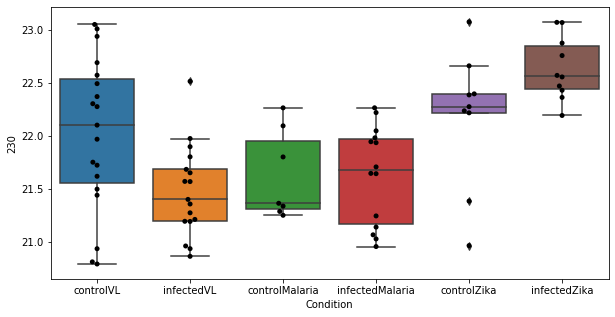

600 row m/z                248.147
row retention time     7.69265
p-val                  0.99583
adj.P.Val             0.999793
custom_id                 1984
compound_names             NaN
Name: 1984, dtype: object


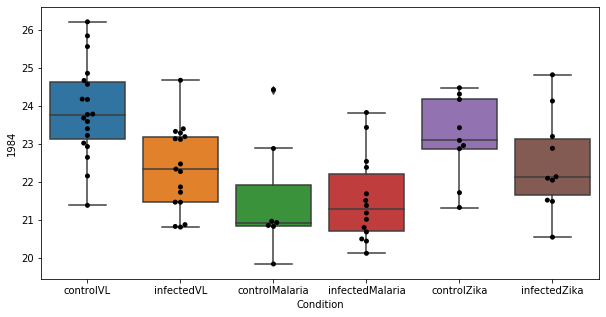

601 row m/z                                                         120.081
row retention time                                               8.8545
p-val                                                          0.996745
adj.P.Val                                                      0.999793
custom_id                                                           305
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 305, dtype: object


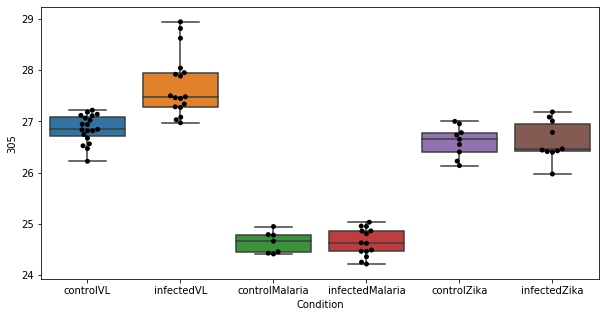

602 row m/z                                                         176.071
row retention time                                              8.29619
p-val                                                            0.9974
adj.P.Val                                                      0.999793
custom_id                                                          1118
compound_names        4-Hydroxy-5-phenyltetrahydro-1,3-oxazin-2-one$...
Name: 1118, dtype: object


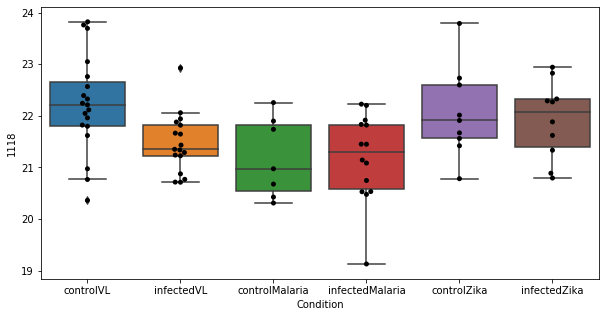

603 row m/z                801.683
row retention time     3.29424
p-val                 0.999607
adj.P.Val             0.999793
custom_id                 3056
compound_names             NaN
Name: 3056, dtype: object


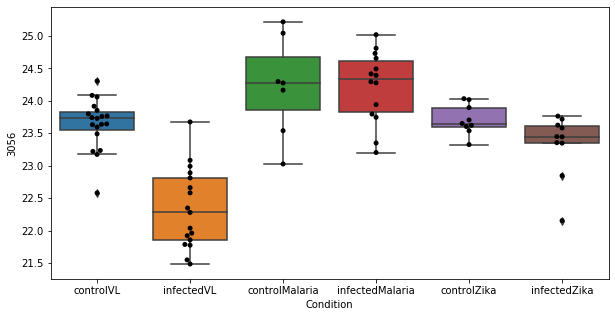

604 row m/z                286.201
row retention time     6.71285
p-val                 0.999793
adj.P.Val             0.999793
custom_id                 2295
compound_names             NaN
Name: 2295, dtype: object


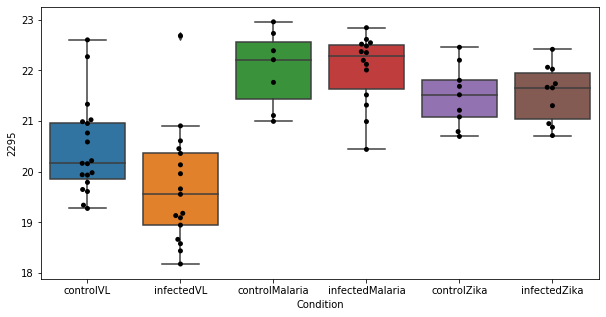

KeyError: 'Condition'

In [264]:
limma_topfeatures = all_samples_log_filled.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [50]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

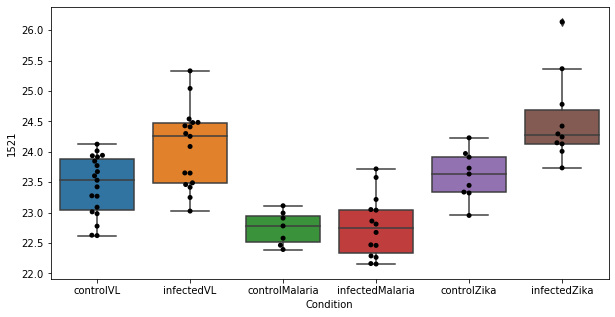

In [49]:
plot_boxplots(limma_topfeatures,1521, (20,24), False)

## Comparison between results from modified data and unmodified data

In [28]:
with_mod = pd.read_csv('/Users/anamaria/Desktop/mzmine/221119/topfeatures50_filled.txt', sep = '\t')
without_mod = pd.read_csv('/Users/anamaria/Desktop/mzmine/210120/topfeatures50_filled.txt', sep = '\t')

In [76]:
nomod = {}
mod = {}

mod_rt = []
nomod_rt = []

for _,row in without_mod.iterrows():
    mz = row["row m/z"]
    rt = row["row retention time"]
    idc = np.int(row["custom_id"])
    nomod[round(mz,2)] = idc
    nomod_rt.append(rt)
    
for _,row in with_mod.iterrows():
    mz = row["row m/z"]
    rt = row["row retention time"]
    idc = np.int(row["custom_id"])
    mod[round(mz,2)] = idc
    mod_rt.append(rt)

In [30]:
def intersection(lst1, lst2): 
    return set(lst1).intersection(lst2) 
      
inters  = intersection(mod.keys(),  nomod.keys())

In [33]:
found = []
notfound = []
for i in mod:
    if i in list(inters):
        found.append(mod[i])
    else:
        notfound.append(mod[i])


In [68]:
names_notfound = []
index = 0
for i in notfound:
    name  = str(data.loc[i][5]).strip()
    if name != "NaN":
        if name != "nan":
            index+=1
            print("========",index,"=======")
            print(name)
            names_notfound.append(name)
            print("")

======== 1 =======
L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-dithiolactic acid

======== 2 =======
Perillyl aldehyde; Perillaldehyde

======== 3 =======
D-Proline$acetamidopropanal$L-Proline; 2-Pyrrolidinecarboxylic acid

======== 4 =======
L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydroxy-L-1-pyrroline-5-carboxylate; (3R,5S)-1-Pyrroline-3-hydroxy-5-carboxylate$1-Pyrroline-4-hydroxy-2-carboxylate$5-Oxoproline; Pyroglutamic acid; 5-Pyrrolidone-2-carboxylic acid; Pyroglutamate; 5-Oxo-L-proline; L-Pyroglutamic acid; L-5-Pyrrolidone-2-carboxylic acid

======== 5 =======
N(pi)-Methyl-L-histidine; 1-Methylhistidine; N-pros-Methyl-L-histidine

======== 6 =======
L-4-Hydroxyglutamate semialdehyde$D-Glutamate; D-Glutamic acid; D-Glutaminic acid; D-2-Aminoglutaric acid$L-Glutamate; L-Glutamic acid; L-Glutaminic acid; Glutamate

======== 7 =======
Anthranilate; Anthranilic acid; o-Aminobenzoic acid; Vitamin L1; 2-Aminobenzoate

======== 8 =======
4-Imidazolone-5-propanoate; 4-Imidazolone-5-pro

In [66]:
names_found = []
index = 0
for i in found:
    name  = str(data.loc[i][5]).strip()
    if name != "NaN":
        if name != "nan":
            index+=1
            print("========",index,"=======")
            print(name)
            names_found.append(name)
            print("")

======== 1 =======
tetracosapentaenoyl carnitine$tetracosapentaenoyl carnitine

======== 2 =======
1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-glycerol-3-phosphocholine; alpha-Acylglycerophosphocholine; 2-Lysolecithin; 2-Lysophosphatidylcholine; 1-Acylglycerophosphocholine

======== 3 =======
docosa-4,7,10,13,16-pentaenoyl carnitine$clupanodonyl carnitine

======== 4 =======
2,3,4,5-Tetrahydropyridine-2-carboxylate; delta1-Piperideine-6-L-carboxylate$delta1-Piperideine-2-carboxylate; 1,2-Didehydropiperidine-2-carboxylate

======== 5 =======
D-Glutamine; D-2-Aminoglutaramic acid$L-Glutamine; L-2-Aminoglutaramic acid$3-Ureidoisobutyrate

======== 6 =======
Pantothenate; Pantothenic acid; (R)-Pantothenate

======== 7 =======
Timnodonyl carnitine

======== 8 =======
histidyl-prolinamide

======== 9 =======
cervonyl carnitine

======== 10 =======
D-Glutamine; D-2-Aminoglutaramic acid$L-Glutamine; L-2-Aminoglutaramic acid$3-Ureidoisobutyrate

======== 11 =======
6-Acetamido-2-oxohexanoate;

In [73]:
for i in (list(intersection(names_notfound, names_found))):
    print("=============")
    print(i)

L-Isoleucine; 2-Amino-3-methylvaleric acid$L-Leucine; 2-Amino-4-methylvaleric acid; (2S)-alpha-2-Amino-4-methylvaleric acid; (2S)-alpha-Leucine
Pantothenate; Pantothenic acid; (R)-Pantothenate
N4-Acetylaminobutanal$L-Pipecolate; Pipecolinic acid; Pipecolic acid; 2-Piperidinecarboxylic acid
L-Allothreonine; L-allo-Threonine$L-Threonine; 2-Amino-3-hydroxybutyric acid
L-Phenylalanine; (S)-alpha-Amino-beta-phenylpropionic acid$
6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidocaproate
D-Glutamine; D-2-Aminoglutaramic acid$L-Glutamine; L-2-Aminoglutaramic acid$3-Ureidoisobutyrate
Hypoxanthine; Purine-6-ol
4-Imidazolone-5-propanoate; 4-Imidazolone-5-propionic acid; 4,5-Dihydro-4-oxo-5-imidazolepropanoate
N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-2-pyridone-5-carboxamide; 1-Methyl-5-carboxylamide-2-pyridone$N1-Methyl-4-pyridone-5-carboxamide; N'-Methyl-4-pyridone-5-carboxamide; 1-Methyl-4-pyridone-3-carboximide
N-Acetylornithine; N2-Acetyl-L-ornithine
6-Amino-2-oxohexanoate; 2-Oxo-6-aminocapr

In [90]:
for i in names_notfound:
    if i not in (list(intersection(names_notfound, names_found))):
        print("=============")
        print(i)

L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-dithiolactic acid
Perillyl aldehyde; Perillaldehyde
D-Proline$acetamidopropanal$L-Proline; 2-Pyrrolidinecarboxylic acid
L-1-Pyrroline-3-hydroxy-5-carboxylate; 3-Hydroxy-L-1-pyrroline-5-carboxylate; (3R,5S)-1-Pyrroline-3-hydroxy-5-carboxylate$1-Pyrroline-4-hydroxy-2-carboxylate$5-Oxoproline; Pyroglutamic acid; 5-Pyrrolidone-2-carboxylic acid; Pyroglutamate; 5-Oxo-L-proline; L-Pyroglutamic acid; L-5-Pyrrolidone-2-carboxylic acid
N(pi)-Methyl-L-histidine; 1-Methylhistidine; N-pros-Methyl-L-histidine
L-4-Hydroxyglutamate semialdehyde$D-Glutamate; D-Glutamic acid; D-Glutaminic acid; D-2-Aminoglutaric acid$L-Glutamate; L-Glutamic acid; L-Glutaminic acid; Glutamate
Anthranilate; Anthranilic acid; o-Aminobenzoic acid; Vitamin L1; 2-Aminobenzoate
Cytosine (in DNA)$Cytosine
3-methylcrotonoylglycine
L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta-(3-indolyl)-propionic acid$D-Tryptophan
gama-carboxyethyl-hydroxychroman
D-Proline$acetamidopropanal$L-Prol

### Check retention times

(array([166.,  68.,  76.,   2.,   5.,   7.,  14.,   3.,   0.,   2.]),
 array([ 3.12606846,  4.45683219,  5.78759593,  7.11835966,  8.44912339,
         9.77988712, 11.11065086, 12.44141459, 13.77217832, 15.10294205,
        16.43370579]),
 <a list of 10 Patch objects>)

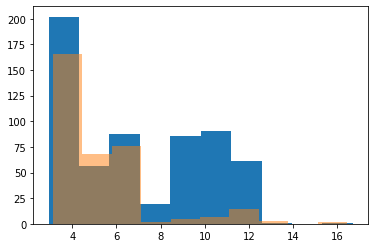

In [86]:
plt.hist(mod_rt)
plt.hist(nomod_rt, alpha = 0.5)



unpreprocessed data: Most of the peaks which align are found in the interval [3,7] and very few in [8,14]



preprocessed data: More peaks align in the interval [8,14]

So the modelling mainly influences the metabolites eluted after 8 min.

### Align ms2 data


In [263]:
sys.path.append(MNET_PATH)
import mnet_utilities

In [264]:
zik_mgf_spectra = mnet_utilities.load_mgf('/Users/anamaria/Desktop/mzmine/210120/mzmine_frag/zik/gnps2.mgf')

Loaded 100 spectra
Loaded 200 spectra
Loaded 300 spectra


In [265]:
from alignment import JoinAligner
aligner = JoinAligner(mz_tolerance_absolute = 0.001,mz_tolerance_ppm = 3,rt_tolerance = 0.5)

In [266]:
#add the csv file from gnps
aligner.add_file('/Users/anamaria/Desktop/mzmine/210120/mzmine_frag/zik/gnps2_quant.csv')
#add ms2 information
for i in aligner.peaksets:
    ms2id = i.peaks[0].source_id
    if ms2id in zik.spectra:
        i.peaks[0].add_ms2_spectrum(zik.spectra[ms2id])

In [268]:
#add the previosuly aligned peaksets
aligner.add_file('/Users/anamaria/Desktop/mzmine/221119/zik/pp_aligned.csv')

gnps2 (10): 74.0795669555664,15.288166666666665
gnps2 (11): 74.09639739990234,17.618666666666666
gnps2 (18): 77.07898712158203,9.667483333333333
gnps2 (29): 83.06034851074219,3.736883333333333
gnps2 (33): 84.0807876586914,17.795
gnps2 (41): 86.09637451171875,6.903816666666667
gnps2 (44): 87.09169006347656,18.627666666666666
gnps2 (45): 88.07567596435547,23.794
gnps2 (54): 90.09136199951172,14.49295
gnps2 (58): 95.06034088134766,6.873066666666667
gnps2 (63): 96.08076477050781,23.0295
gnps2 (65): 97.03968811035156,5.5423
gnps2 (68): 97.99125671386719,21.865833333333335
gnps2 (74): 100.0756607055664,6.346516666666667
gnps2 (75): 100.112060546875,17.205166666666667
gnps2 (82): 102.12773132324219,15.442133333333334
gnps2 (89): 104.0705795288086,10.6
gnps2 (90): 104.10693359375,7.0140666666666664
gnps2 (93): 105.03319549560547,3.6795166666666663
gnps2 (94): 105.04235076904297,12.994283333333334
gnps2 (96): 105.06983184814453,3.7933833333333333
gnps2 (102): 106.04988098144531,12.8692333333333